In [1]:
import numpy as np

from gwbench import network

import scipy.stats as stats
from scipy import integrate


import bilby

In [44]:
import matplotlib as mpl
import matplotlib.pyplot as plt

plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.size": 18
})


%config InlineBackend.figure_format='retina' # very useful command for high-res images

In [3]:
def inner_prod_simps_normed(h1, h2, Sn, f, h1_norm = None, h2_norm=None):
    if h1_norm is None:
        h1_norm = 4*np.real(integrate.simpson(y= h1*np.conjugate(h1) / Sn, x=f))
    if h2_norm is None:
        h2_norm = 4*np.real(integrate.simpson(y= h2*np.conjugate(h2) / Sn, x=f))
    return  2*np.real(integrate.simpson(y= (h1*np.conjugate(h2) + h2*np.conjugate(h1)) / Sn, x=f)) / (np.sqrt(h1_norm * h2_norm))

def inner_prod_simps(h1, h2, Sn, f):
    return  2*np.real(integrate.simpson(y= (h1*np.conjugate(h2) + h2*np.conjugate(h1)) / Sn, x=f))

def cutler_vallisneri_overlap_vec(del_hf, delta_hf, psd, freqs):
    return np.array([ inner_prod_simps(del_hf[deriv], delta_hf, psd, freqs) for deriv in del_hf ])

In [4]:
input_file = 'smooth_powerlaw_pop.npz'
with np.load(input_file, mmap_mode='r') as binaries:
    Mcs = np.array(binaries['Mcs'])
    etas = np.array(binaries['etas'])
    chi1z = np.array(binaries['chi1z'])
    chi2z = np.array(binaries['chi2z'])
    DLs = np.array(binaries['DLs'])
    iotas = np.array(binaries['iotas'])
    ras = np.array(binaries['ras'])
    decs = np.array(binaries['decs'])
    psis = np.array(binaries['psis'])

In [5]:
index_golden = 54837
index_typical = 21985
index_optimistic = 78736
index_pessimistic = 47519

index_mass_gap = 73505

# Fiducial Example

In [35]:
i = index_typical

network_spec = ['CE-40_C', 'CE-20_S', 'ET_ET1', 'ET_ET2', 'ET_ET3']

approx1 = 'IMRPhenomXAS'
approx2 = 'IMRPhenomD'

inj_params = {
    'Mc':    Mcs[i],
    'eta':   etas[i],
    'chi1x': 0.,
    'chi2x': 0.,
    'chi1y': 0.,
    'chi2y': 0.,
    'chi1z': chi1z[i],
    'chi2z': chi2z[i],
    'DL':    DLs[i],
    'tc':    0.,
    'phic':  0.,
    'iota':  iotas[i],
    'ra':    ras[i],
    'dec':   decs[i],
    'psi':   psis[i],
    # 'gmst0': bilby.gw.utils.greenwich_mean_sidereal_time(0.),
    'gmst0': 0.
} 

d_f = 2**-4
f_low = 5.
f_high = 2048.
f = np.arange(f_low, f_high, d_f)
 
deriv_symbs_string = 'Mc eta DL chi1z chi2z tc phic iota ra dec psi'
deriv_variables = ['Mc', 'eta', 'DL', 'chi1z', 'chi2z', 'tc', 'phic', 'iota', 'ra', 'dec', 'psi']

In [36]:
net_ap = network.Network(network_spec=network_spec)

approximant = 'IMRPhenomD'
wf_model_name = 'lal_bbh'
# pass the chosen waveform to the network for initialization
net_ap.set_wf_vars(wf_model_name=wf_model_name, wf_other_var_dic = {'approximant': approximant})


use_rot = 0

net_ap.set_net_vars(
    f=f, inj_params=inj_params,
    deriv_symbs_string=deriv_symbs_string,
    use_rot=use_rot
    )
net_ap.calc_wf_polarizations()
net_ap.calc_wf_polarizations_derivs_num(step=1e-9, method='central', order=2, n=1)
net_ap.setup_ant_pat_lpf_psds()
net_ap.calc_det_responses()
net_ap.calc_det_responses_derivs_num(step=1e-9, method='central', order=2, n=1)
net_ap.calc_snrs()
net_ap.calc_errors()


net_tr = network.Network(network_spec=network_spec)

approximant = 'IMRPhenomXAS'
wf_model_name = 'lal_bbh'
# pass the chosen waveform to the network for initialization
net_tr.set_wf_vars(wf_model_name=wf_model_name, wf_other_var_dic = {'approximant': approximant})

net_tr.set_net_vars(
    f=f, inj_params=inj_params,
    deriv_symbs_string=deriv_symbs_string,
    use_rot=use_rot
    )
net_tr.calc_wf_polarizations()
net_tr.setup_ant_pat_lpf_psds()
net_tr.calc_det_responses()
net_tr.calc_snrs()

2024-01-15 14:12:54,650 - Network - INFO : Polarizations calculated.
2024-01-15 14:12:54,651 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 14:12:54,658 - Network - INFO : Polarizations calculated.
2024-01-15 14:13:00,145 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 14:13:00,275 - Network - INFO : PSDs loaded.
2024-01-15 14:13:00,281 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:13:00,305 - Network - INFO : Detector responses calculated.
2024-01-15 14:13:00,306 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 14:13:00,307 - Network - INFO :    CE-40_C
2024-01-15 14:13:03,983 - Network - INFO :    CE-20_S
2024-01-15 14:13:07,615 - Network - INFO :    ET_ET1
2024-01-15 14:13:11,246 - Network - INFO :    ET_ET2
2024-01-15 14:13:14,918 - Network - INFO :    ET_ET3
2024-01-15 14:13:20,407 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

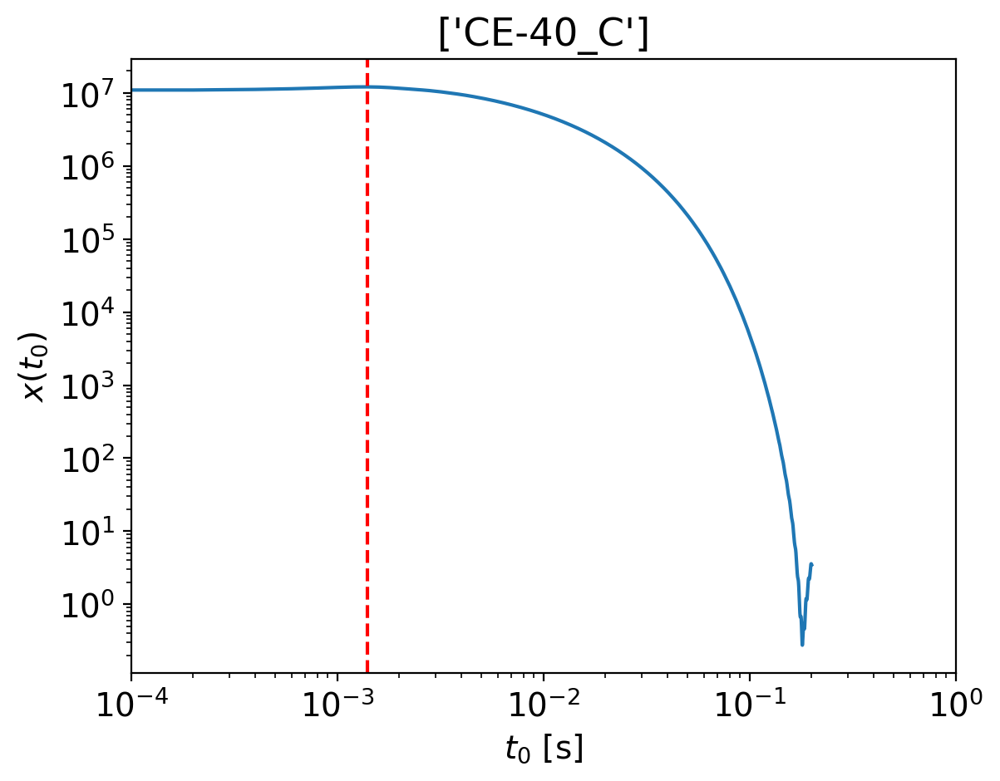

2024-01-15 14:13:25,927 - Network - INFO : Polarizations calculated.
2024-01-15 14:13:25,935 - Network - INFO : PSDs loaded.
2024-01-15 14:13:25,937 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:13:25,945 - Network - INFO : Detector responses calculated.
2024-01-15 14:13:25,952 - Network - INFO : Polarizations calculated.


time shift: 0.0014
phase shift: -2.3245818460972543
Inner product:
0.9997999279932599


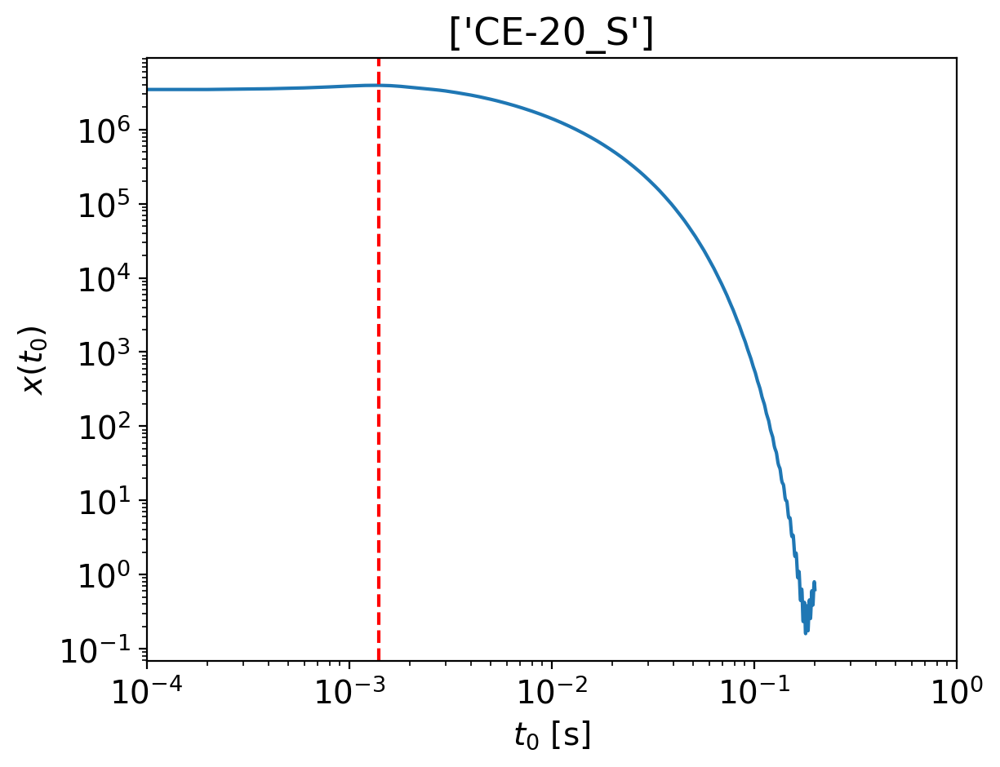

2024-01-15 14:13:29,283 - Network - INFO : Polarizations calculated.
2024-01-15 14:13:29,292 - Network - INFO : PSDs loaded.
2024-01-15 14:13:29,294 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:13:29,301 - Network - INFO : Detector responses calculated.
2024-01-15 14:13:29,310 - Network - INFO : Polarizations calculated.


time shift: 0.0014
phase shift: -2.3236821975769755
Inner product:
0.9997026536192645


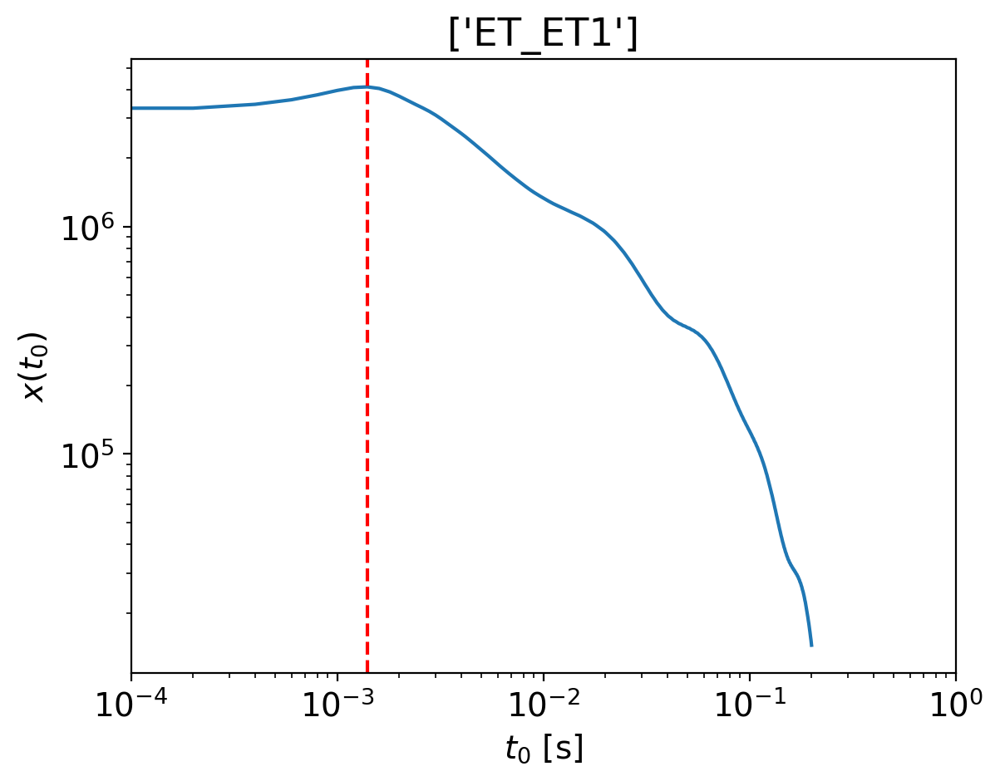

2024-01-15 14:13:31,921 - Network - INFO : Polarizations calculated.
2024-01-15 14:13:31,935 - Network - INFO : PSDs loaded.
2024-01-15 14:13:31,937 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:13:31,944 - Network - INFO : Detector responses calculated.
2024-01-15 14:13:31,951 - Network - INFO : Polarizations calculated.


time shift: 0.0014
phase shift: -2.3184088735576287
Inner product:
0.9995864631648786


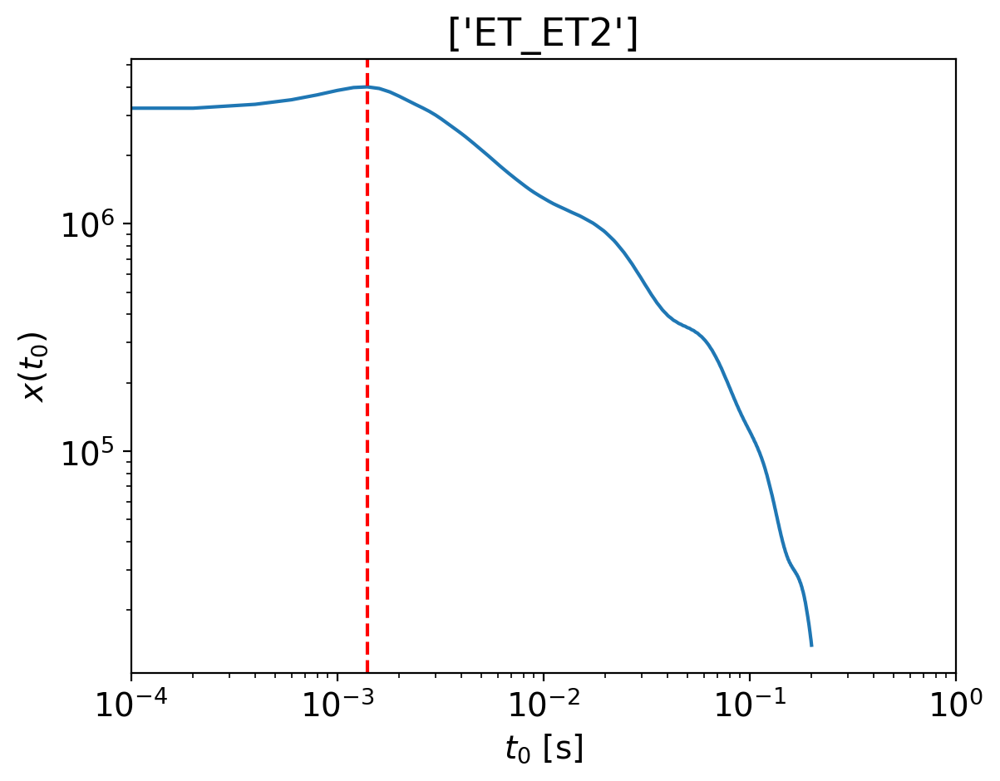

2024-01-15 14:13:35,042 - Network - INFO : Polarizations calculated.
2024-01-15 14:13:35,057 - Network - INFO : PSDs loaded.
2024-01-15 14:13:35,059 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:13:35,066 - Network - INFO : Detector responses calculated.
2024-01-15 14:13:35,073 - Network - INFO : Polarizations calculated.


time shift: 0.0014
phase shift: -2.318408873557629
Inner product:
0.9995864631648785


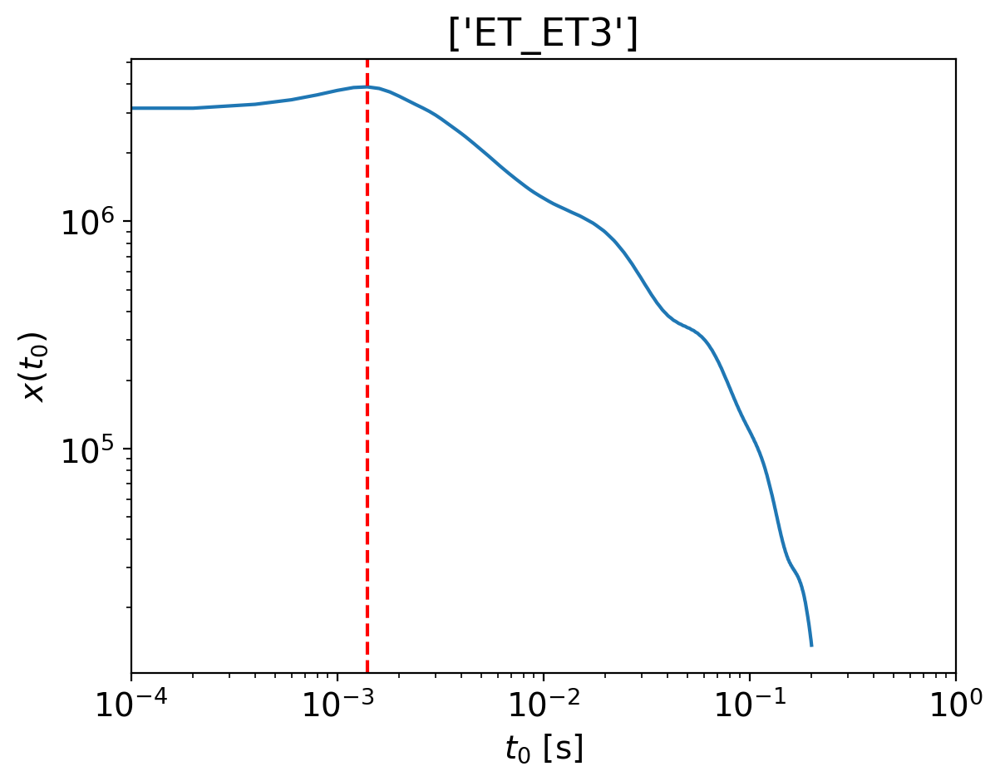

2024-01-15 14:13:37,673 - Network - INFO : Polarizations calculated.
2024-01-15 14:13:37,688 - Network - INFO : PSDs loaded.
2024-01-15 14:13:37,690 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:13:37,697 - Network - INFO : Detector responses calculated.
2024-01-15 14:13:37,704 - Network - INFO : Polarizations calculated.


time shift: 0.0014
phase shift: -2.3184088735576287
Inner product:
0.9995864631648788


In [37]:
overlap_vecs_network = np.zeros((len(net_ap.detectors), len(net_ap.deriv_variables)))

time_arr_d = np.linspace(0.0, 0.2, 1001)

for d in range(len(net_ap.detectors)):

    ## set up initial waveforms
    h1 = net_tr.detectors[d].hf
    h2 = net_ap.detectors[d].hf
    f = net_ap.detectors[d].f
    Sn = net_ap.detectors[d].psd
    network_spec_d = [net_ap.detectors[d].det_key]

    x_t0_re_d = np.zeros(len(time_arr_d))
    x_t0_im_d = np.zeros(len(time_arr_d))

    for i in range(len(time_arr_d)):
        t0 = time_arr_d[i]
        x_t0_d = 4*(integrate.simpson(h1 * np.conjugate(h2) * np.exp(2*np.pi*1j*f*t0)/ Sn, x=f))
        x_t0_re_d[i] = np.real(x_t0_d)
        x_t0_im_d[i] = np.imag(x_t0_d)

    max_idx = np.argmax(x_t0_re_d**2 + x_t0_im_d**2)
    time_shift_d = time_arr_d[max_idx]
    phase_shift_d = (np.angle(x_t0_re_d + 1j*x_t0_im_d))[max_idx]

    plt.title(network_spec_d)
    plt.plot(time_arr_d, x_t0_re_d**2 + x_t0_im_d**2)
    plt.axvline(x=time_shift_d, ls='--', c='r')
    plt.xlabel('$t_0$ [s]')
    plt.ylabel("$x(t_0)$")
    plt.loglog()
    plt.xlim(1e-4, 1e0)
    plt.show()
    print("time shift:", time_shift_d)
    print("phase shift:", phase_shift_d)

    inj_params_opt_d = inj_params.copy()
    inj_params_opt_d['tc'] = time_shift_d # should be positive when shifting XAS to maximize overlap
    inj_params_opt_d['phic'] = phase_shift_d  # should be positive when shifting XAS to maximize overlap
 

    net_tr_opt_d = network.Network(network_spec=network_spec_d)
    net_tr_opt_d.set_wf_vars(wf_model_name='lal_bbh', wf_other_var_dic = {'approximant': 'IMRPhenomXAS'})
    net_tr_opt_d.set_net_vars(
        f=f, inj_params=inj_params_opt_d,
        deriv_symbs_string=deriv_symbs_string,
        use_rot=use_rot
        )
    net_tr_opt_d.calc_wf_polarizations()
    net_tr_opt_d.setup_ant_pat_lpf_psds()
    net_tr_opt_d.calc_det_responses()
    net_tr_opt_d.calc_wf_polarizations()

    print("Inner product:")
    print(inner_prod_simps_normed(net_ap.detectors[d].hf, net_tr_opt_d.detectors[0].hf, net_ap.detectors[d].psd, net_ap.detectors[d].f))


    ## Compute CV overlap vector for this detector
    delta_hf = net_tr_opt_d.detectors[0].hf - net_ap.detectors[d].hf
    overlap_vecs_network[d] = cutler_vallisneri_overlap_vec(net_ap.detectors[d].del_hf, delta_hf, net_ap.detectors[d].psd, net_ap.detectors[d].f)

cv_bias_opt_fiducial = np.matmul(net_ap.cov, np.sum(overlap_vecs_network, axis=0))
cv_bias_opt_fiducial = np.array(cv_bias_opt_fiducial.tolist()[0])


In [38]:
cv_bias_opt_dict_fiducial = {}

for i, param in enumerate(net_ap.deriv_variables):
    cv_bias_opt_dict_fiducial[param] = cv_bias_opt_fiducial[i]

cv_bias_opt_dict_fiducial

{'Mc': 0.00021819755307994626,
 'eta': -0.0023277259477652024,
 'DL': -10.800257483489986,
 'chi1z': 0.29346016418094223,
 'chi2z': -0.30566669440122496,
 'tc': -7.698369934594496e-05,
 'phic': 0.003455561589902345,
 'iota': 0.005455281576604243,
 'ra': 0.0003503517349117691,
 'dec': 0.0004699345050331316,
 'psi': 0.007958130632905736}

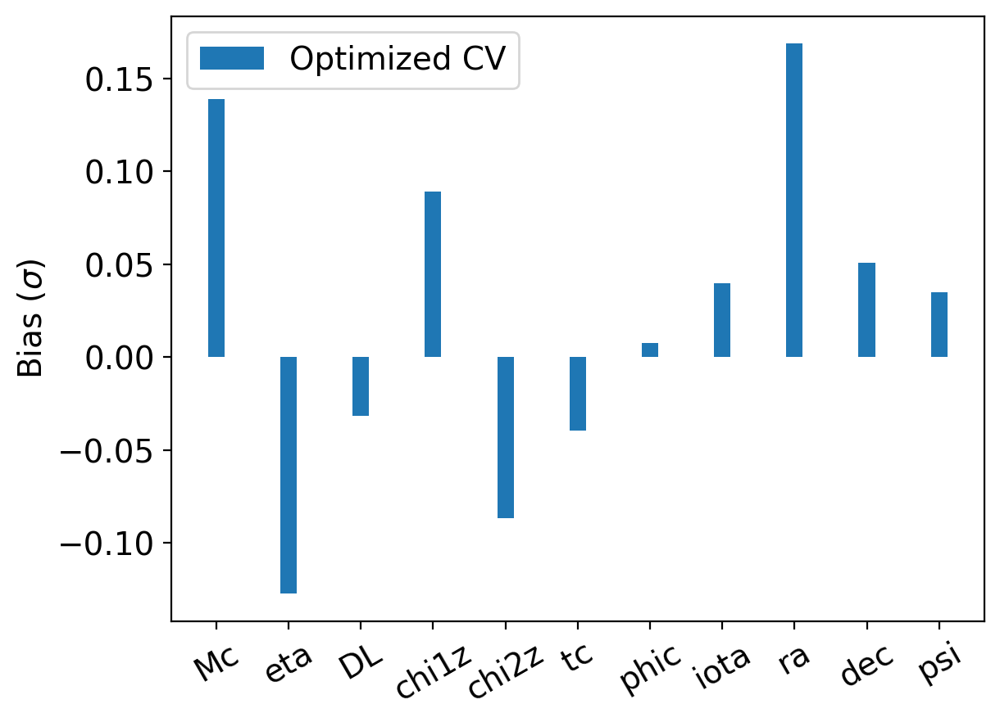

Mc, 1: 0.139 sigma

eta, 1: -0.127 sigma

DL, 1: -0.032 sigma

chi1z, 1: 0.089 sigma

chi2z, 1: -0.087 sigma

tc, 1: -0.040 sigma

phic, 1: 0.007 sigma

iota, 1: 0.040 sigma

ra, 1: 0.169 sigma

dec, 1: 0.051 sigma

psi, 1: 0.035 sigma



In [39]:
cv_bias_opt_sigma_fiducial = np.zeros(len(cv_bias_opt_fiducial))

for i, param in enumerate(net_ap.deriv_variables):
    # cv_bias_opt_sigma[i] = cv_bias_opt_dict[param]/net_ap.errs[param]
    cv_bias_opt_sigma_fiducial[i] = cv_bias_opt_dict_fiducial[param]/net_ap.errs[param]


bias1 = cv_bias_opt_sigma_fiducial
# bias2 = pe_bias

x = np.linspace(0, len(bias1), len(bias1))

width = 0.25
plt.bar(x, bias1, width=width, label='Optimized CV')
# plt.bar(x+width, bias2, width=width, label="PE")

plt.xticks(x, deriv_variables, rotation=30)
plt.ylabel('Bias ($\sigma$)')
plt.legend()
plt.show()

for i, param in enumerate(deriv_variables):
    print(f"{param}, 1: {bias1[i]:.3f} sigma")
    # print(f"{param}, 2: {bias2[i]:.3f} sigma")
    print()

# Dependence on fRef

2024-01-15 14:59:33,769 - Network - INFO : Polarizations calculated.
2024-01-15 14:59:33,770 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 14:59:33,777 - Network - INFO : Polarizations calculated.
2024-01-15 14:59:39,953 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 14:59:40,007 - Network - INFO : PSDs loaded.
2024-01-15 14:59:40,013 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 14:59:40,037 - Network - INFO : Detector responses calculated.
2024-01-15 14:59:40,038 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 14:59:40,039 - Network - INFO :    CE-40_C
2024-01-15 14:59:43,887 - Network - INFO :    CE-20_S
2024-01-15 14:59:47,531 - Network - INFO :    ET_ET1
2024-01-15 14:59:51,174 - Network - INFO :    ET_ET2
2024-01-15 14:59:54,798 - Network - INFO :    ET_ET3
2024-01-15 14:59:58,424 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

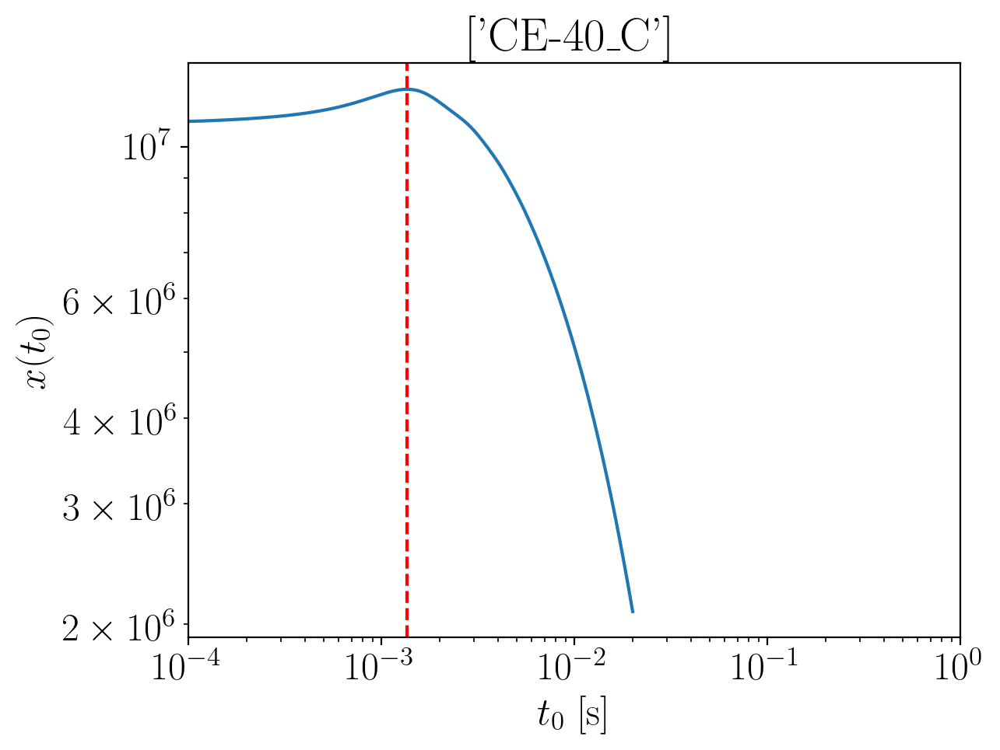

2024-01-15 15:00:04,734 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:04,747 - Network - INFO : PSDs loaded.
2024-01-15 15:00:04,751 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:04,760 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:04,773 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3344674173737445
Inner product:
0.9999404774208269


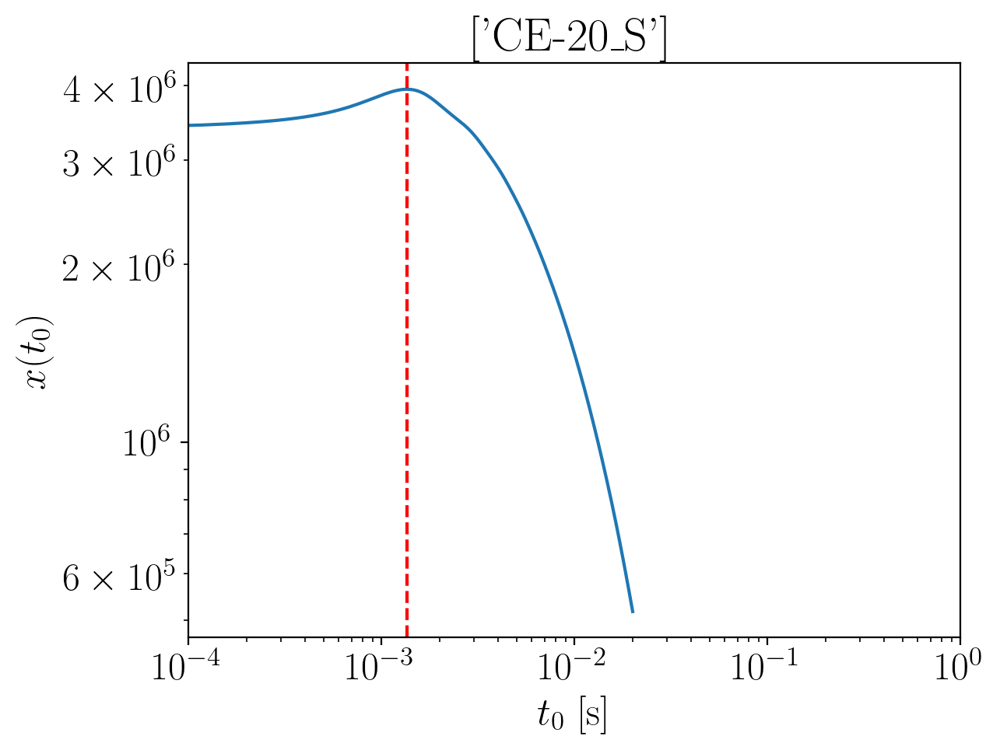

2024-01-15 15:00:07,147 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:07,157 - Network - INFO : PSDs loaded.
2024-01-15 15:00:07,160 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:07,168 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:07,175 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.335231038127119
Inner product:
0.9999211440514333


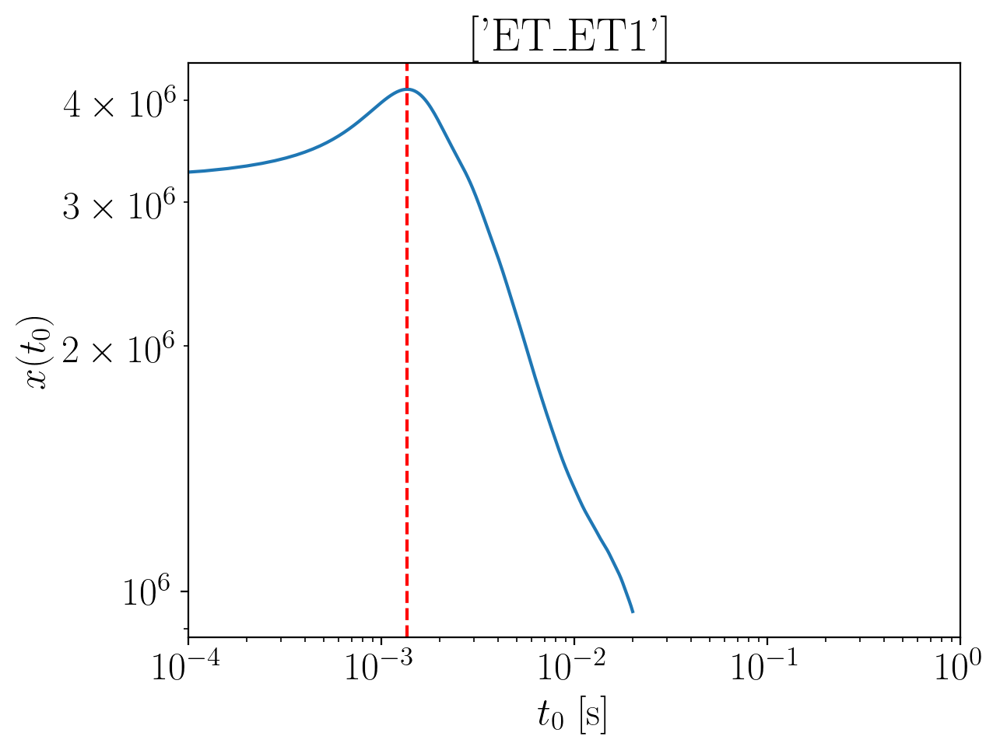

2024-01-15 15:00:09,231 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:09,247 - Network - INFO : PSDs loaded.
2024-01-15 15:00:09,249 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:09,257 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:09,265 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.330691194242134
Inner product:
0.9998645672835351


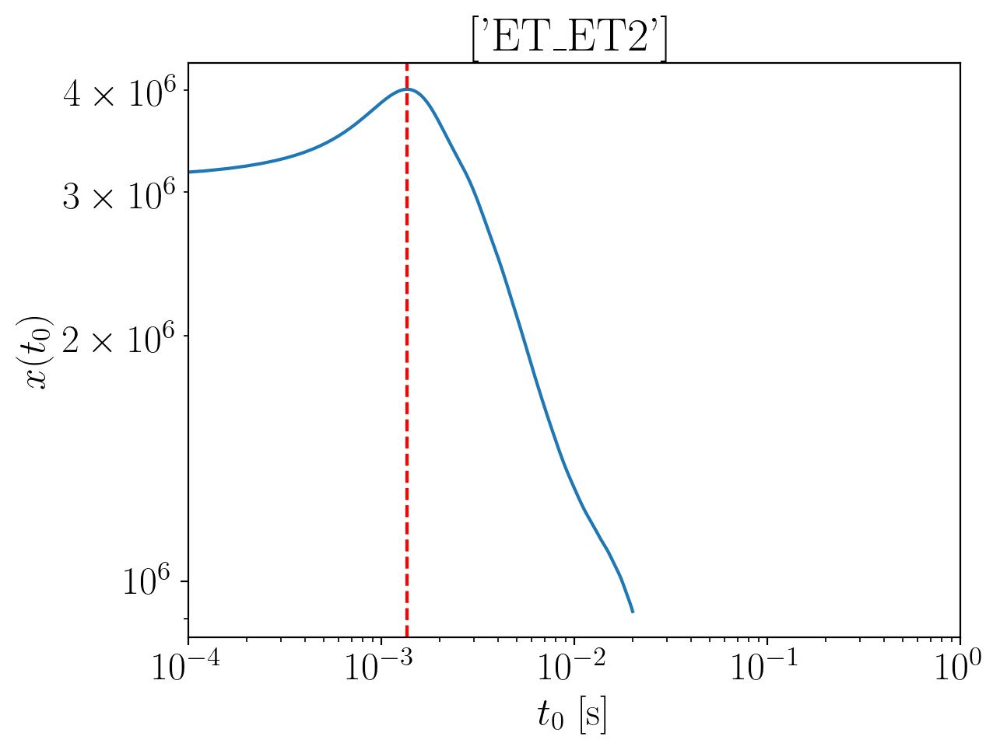

2024-01-15 15:00:11,176 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:11,193 - Network - INFO : PSDs loaded.
2024-01-15 15:00:11,196 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:11,206 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:11,214 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.330691194242134
Inner product:
0.9998645672835353


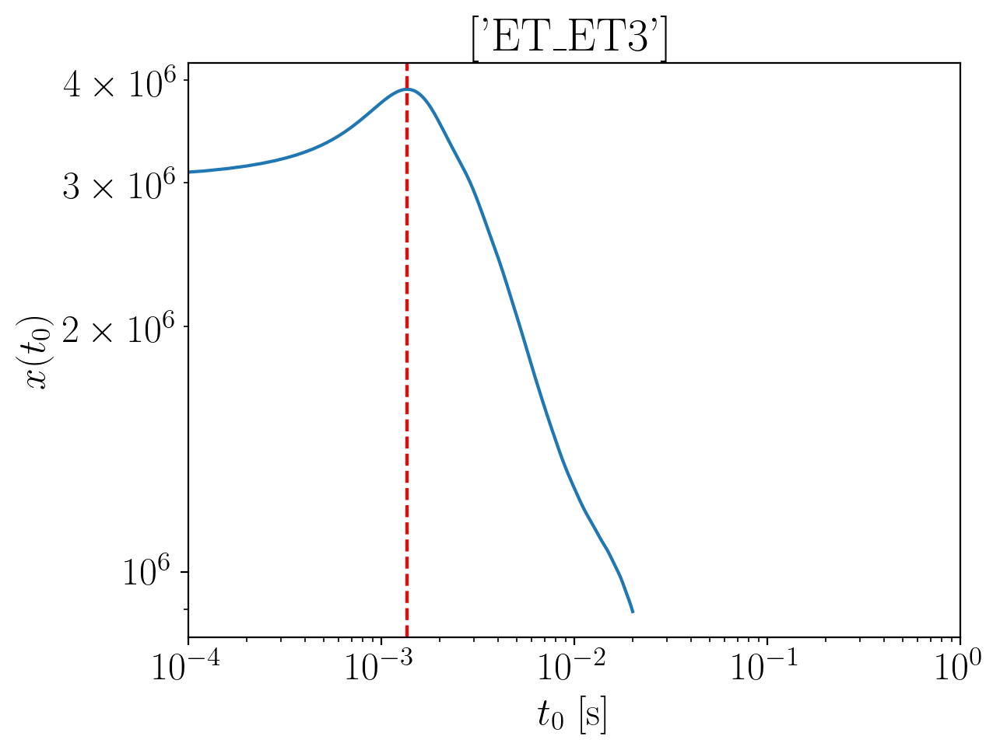

2024-01-15 15:00:13,130 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:13,147 - Network - INFO : PSDs loaded.
2024-01-15 15:00:13,149 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:13,157 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:13,165 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:13,192 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:13,192 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:00:13,198 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3306911942421342
Inner product:
0.9998645672835353


2024-01-15 15:00:18,640 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:00:18,684 - Network - INFO : PSDs loaded.
2024-01-15 15:00:18,690 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:18,714 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:18,714 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:00:18,715 - Network - INFO :    CE-40_C
2024-01-15 15:00:22,360 - Network - INFO :    CE-20_S
2024-01-15 15:00:26,011 - Network - INFO :    ET_ET1
2024-01-15 15:00:29,650 - Network - INFO :    ET_ET2
2024-01-15 15:00:33,350 - Network - INFO :    ET_ET3
2024-01-15 15:00:37,141 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:00:37,149 - Network - INFO : SNRs calculated.
2024-01-15 15:00:37,150 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:00:37,150 - Network - INFO :    CE-40_C
2024-01-15 15:00:37,246 - Network - INFO :

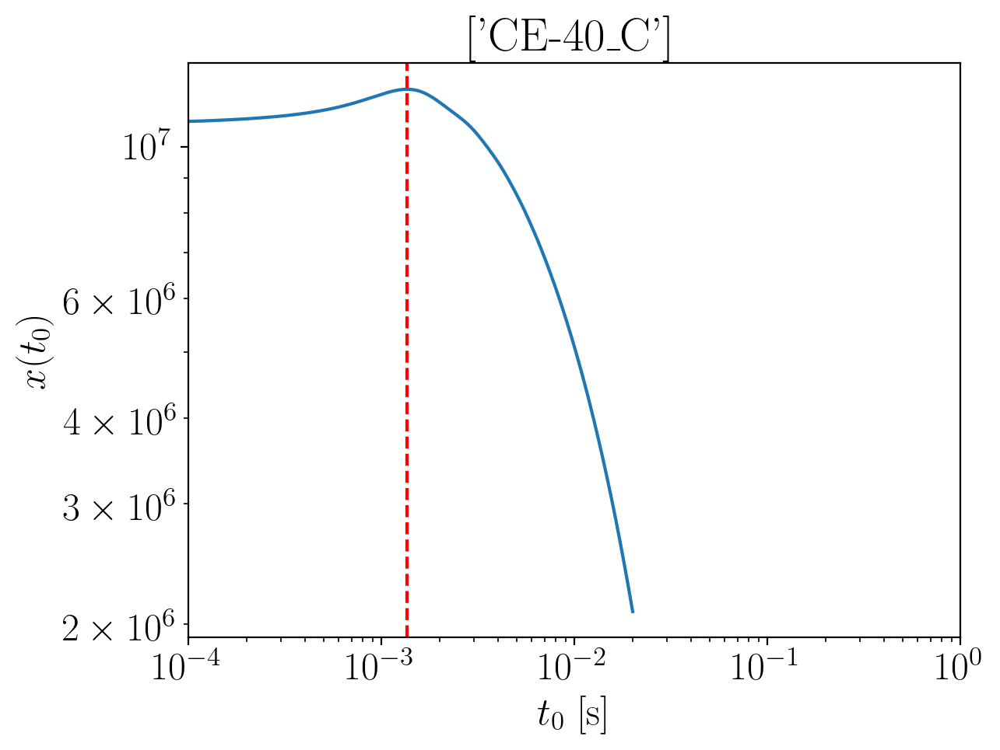

2024-01-15 15:00:39,147 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:39,155 - Network - INFO : PSDs loaded.
2024-01-15 15:00:39,157 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:39,164 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:39,171 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3838868636791504
Inner product:
0.9999404774208275


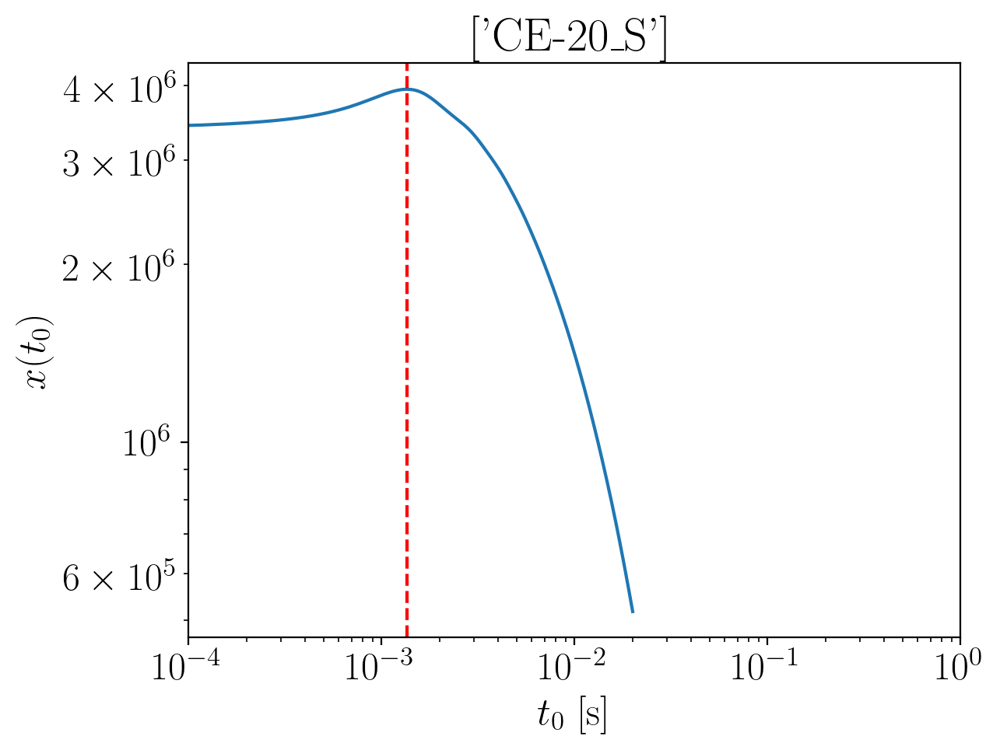

2024-01-15 15:00:40,573 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:40,582 - Network - INFO : PSDs loaded.
2024-01-15 15:00:40,585 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:40,594 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:40,604 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3846504844325067
Inner product:
0.9999211440514337


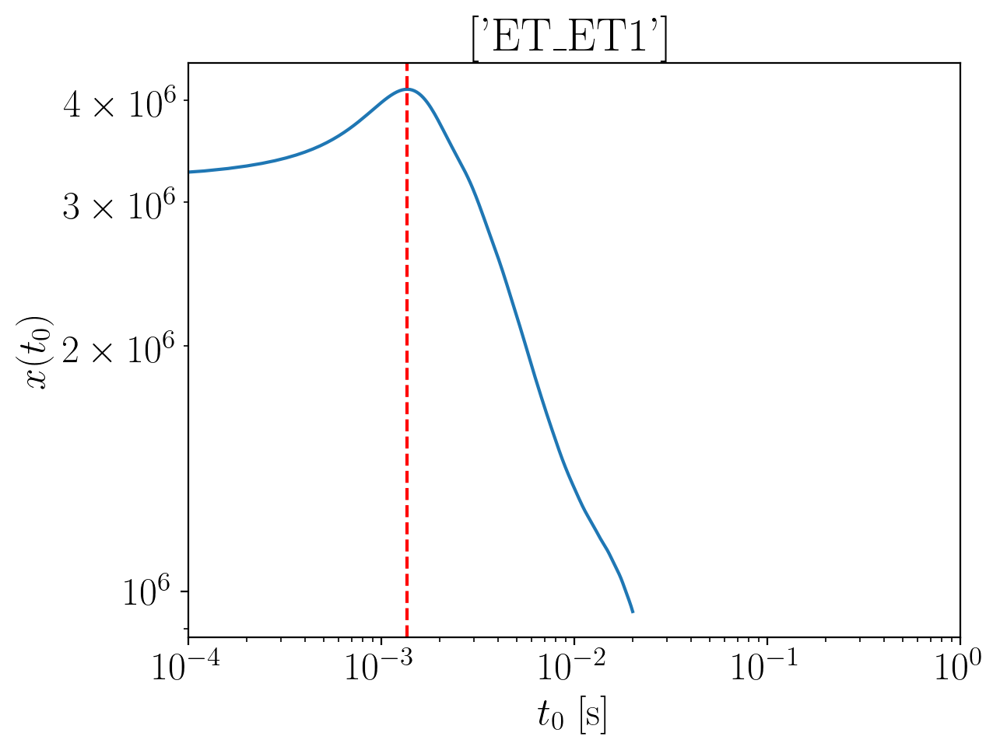

2024-01-15 15:00:42,840 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:42,864 - Network - INFO : PSDs loaded.
2024-01-15 15:00:42,867 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:42,883 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:42,911 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3794035477784825
Inner product:
0.9998645672835348


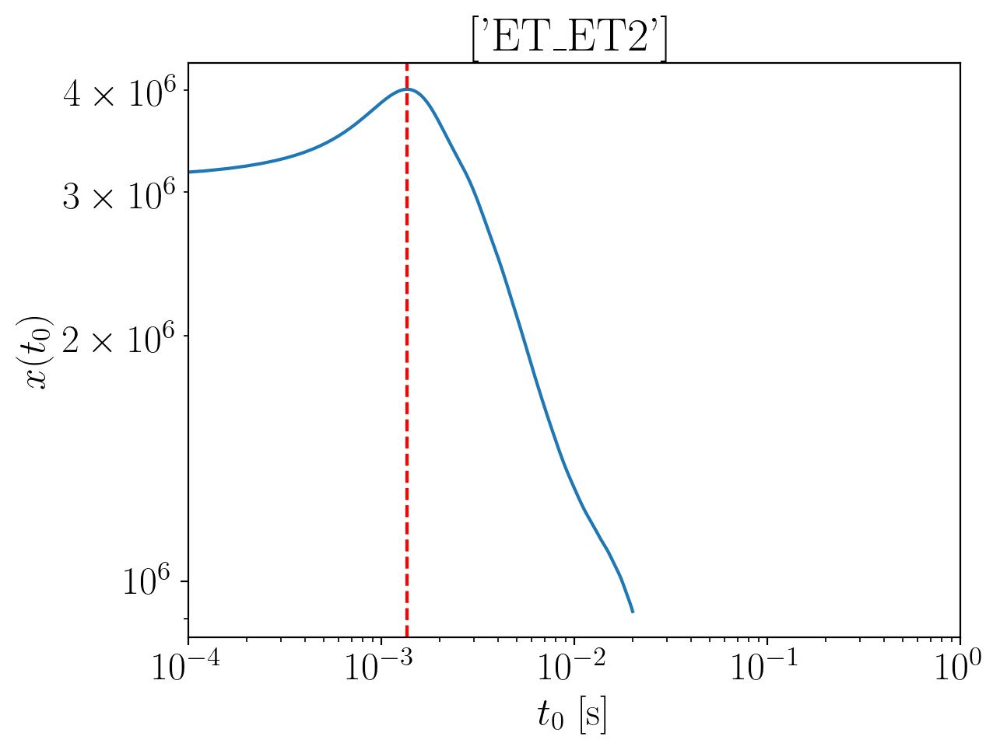

2024-01-15 15:00:44,604 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:44,617 - Network - INFO : PSDs loaded.
2024-01-15 15:00:44,619 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:44,626 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:44,633 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3794035477784825
Inner product:
0.9998645672835348


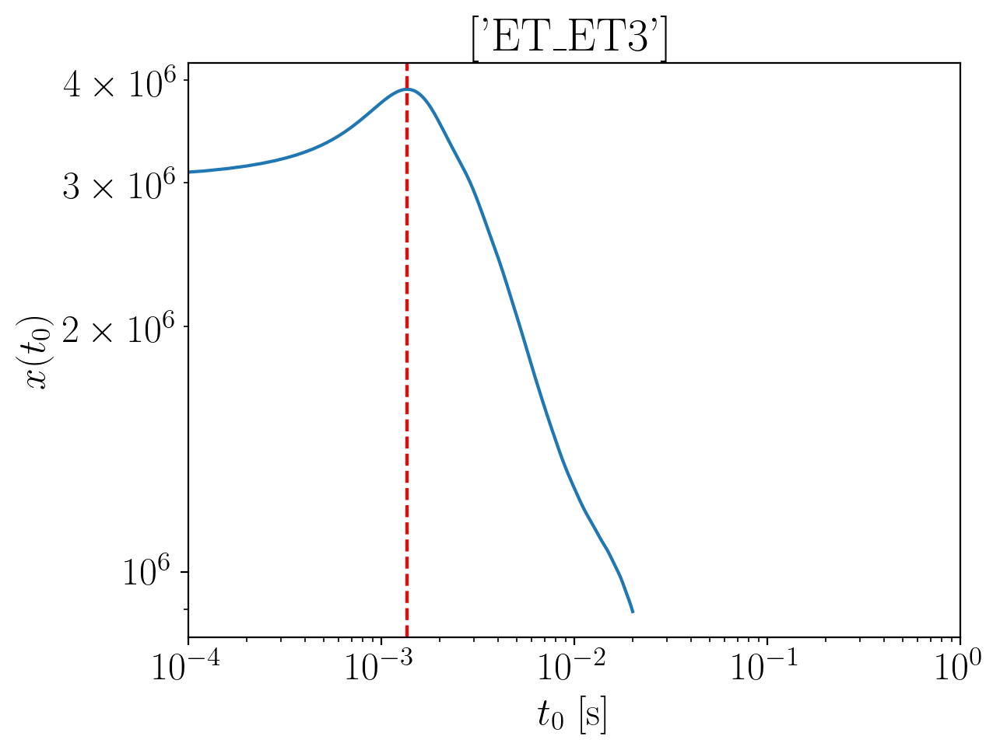

2024-01-15 15:00:46,535 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:46,568 - Network - INFO : PSDs loaded.
2024-01-15 15:00:46,573 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:46,593 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:46,622 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:46,674 - Network - INFO : Polarizations calculated.
2024-01-15 15:00:46,675 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:00:46,689 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3794035477784825
Inner product:
0.9998645672835349


2024-01-15 15:00:53,246 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:00:53,290 - Network - INFO : PSDs loaded.
2024-01-15 15:00:53,296 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:00:53,317 - Network - INFO : Detector responses calculated.
2024-01-15 15:00:53,318 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:00:53,319 - Network - INFO :    CE-40_C
2024-01-15 15:00:57,479 - Network - INFO :    CE-20_S
2024-01-15 15:01:01,211 - Network - INFO :    ET_ET1
2024-01-15 15:01:05,002 - Network - INFO :    ET_ET2
2024-01-15 15:01:08,893 - Network - INFO :    ET_ET3
2024-01-15 15:01:12,618 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:01:12,627 - Network - INFO : SNRs calculated.
2024-01-15 15:01:12,627 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:01:12,628 - Network - INFO :    CE-40_C
2024-01-15 15:01:12,721 - Network - INFO :

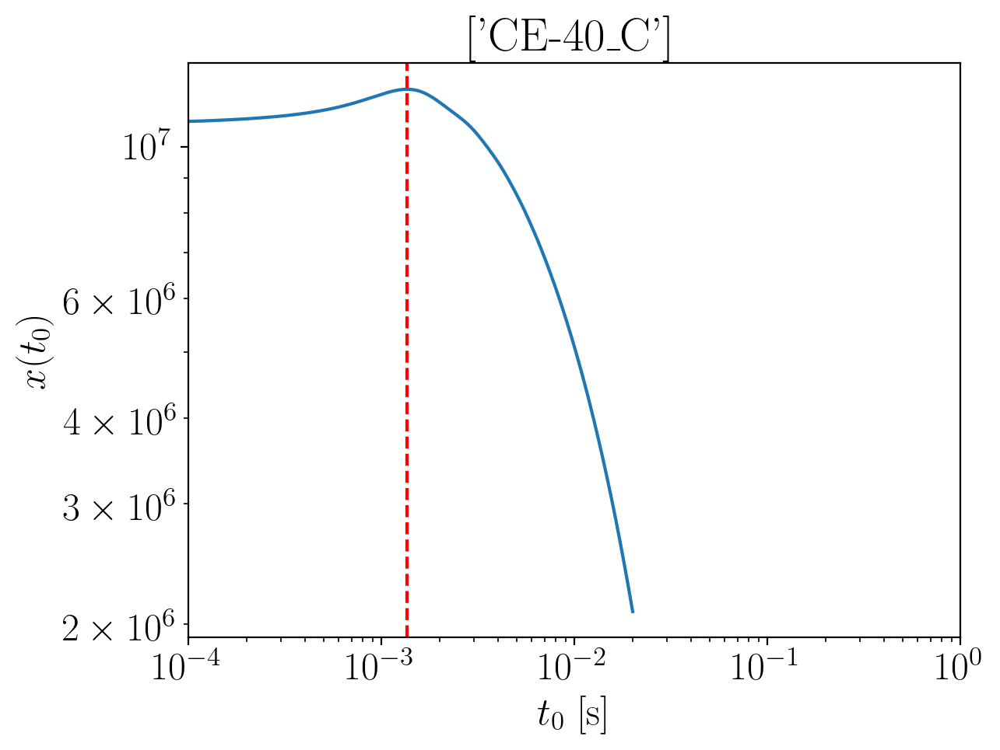

2024-01-15 15:01:14,508 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:14,516 - Network - INFO : PSDs loaded.
2024-01-15 15:01:14,517 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:14,524 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:14,531 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3708970937251954
Inner product:
0.9999404774208264


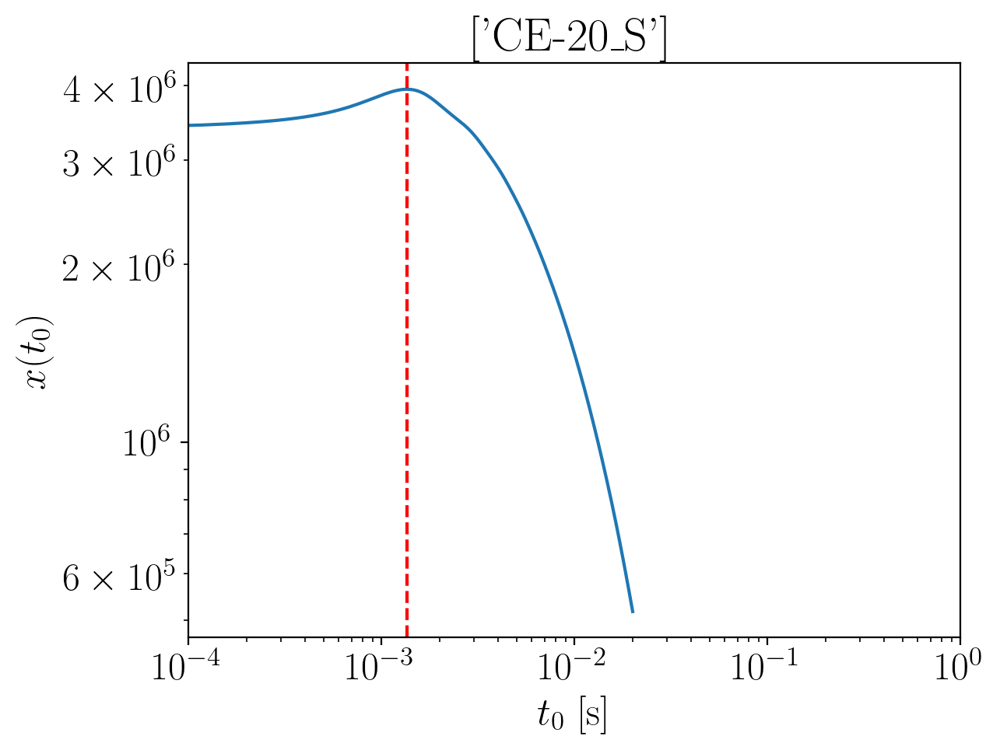

2024-01-15 15:01:15,720 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:15,727 - Network - INFO : PSDs loaded.
2024-01-15 15:01:15,730 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:15,740 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:15,748 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.371660714478572
Inner product:
0.999921144051433


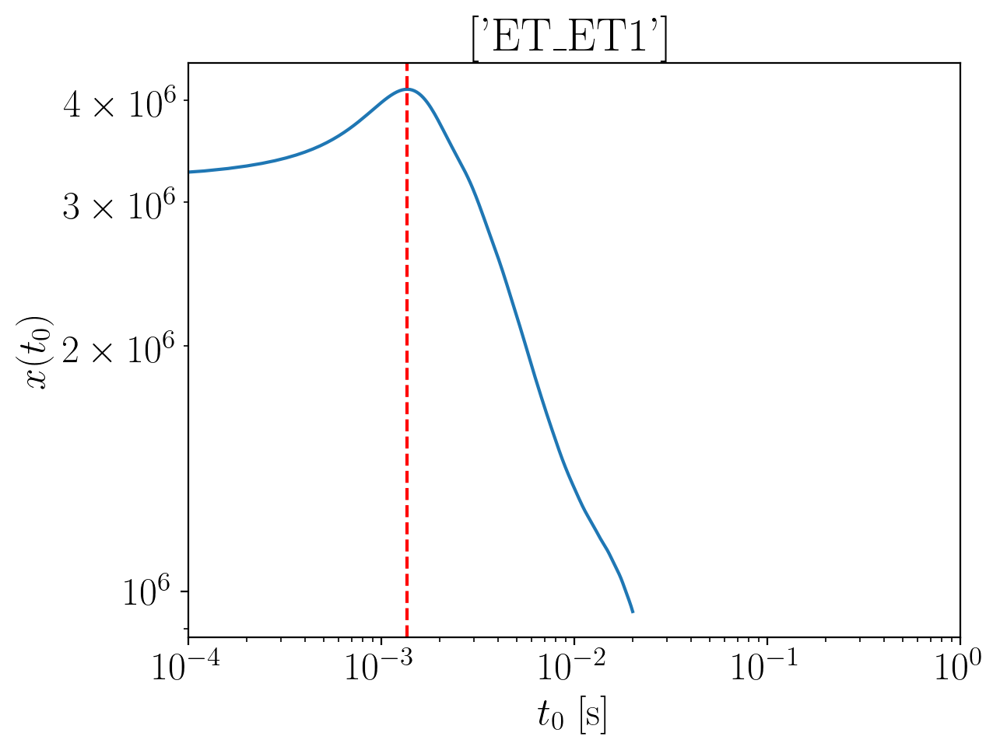

2024-01-15 15:01:17,362 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:17,380 - Network - INFO : PSDs loaded.
2024-01-15 15:01:17,382 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:17,392 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:17,402 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.366413777824511
Inner product:
0.9998645672835342


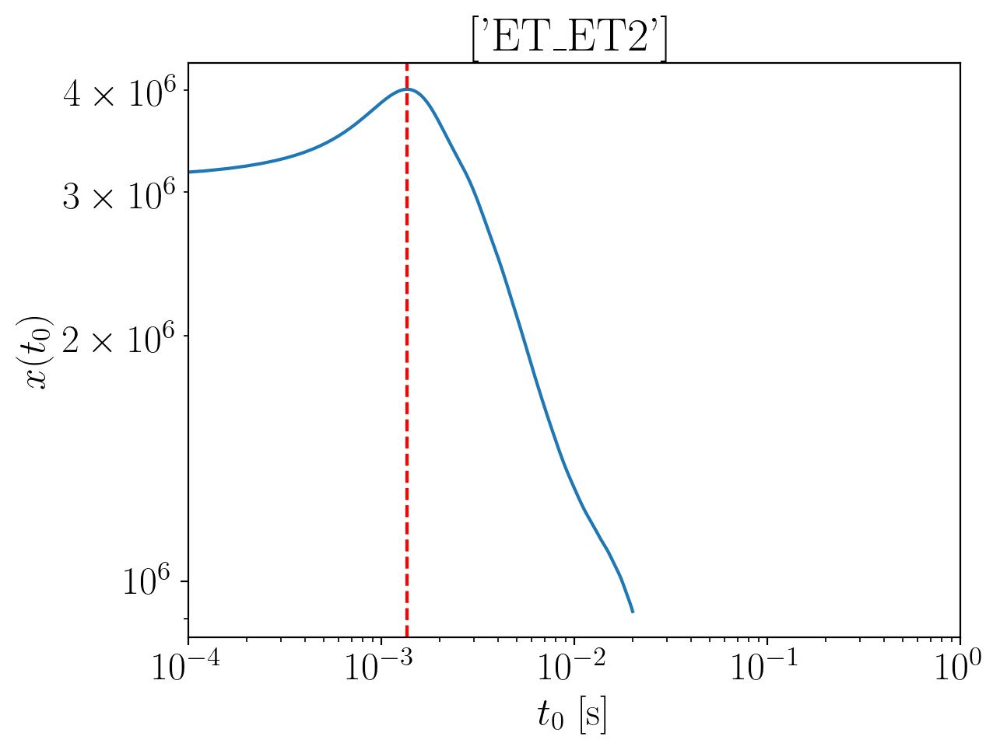

2024-01-15 15:01:19,244 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:19,257 - Network - INFO : PSDs loaded.
2024-01-15 15:01:19,259 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:19,266 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:19,273 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.366413777824511
Inner product:
0.9998645672835342


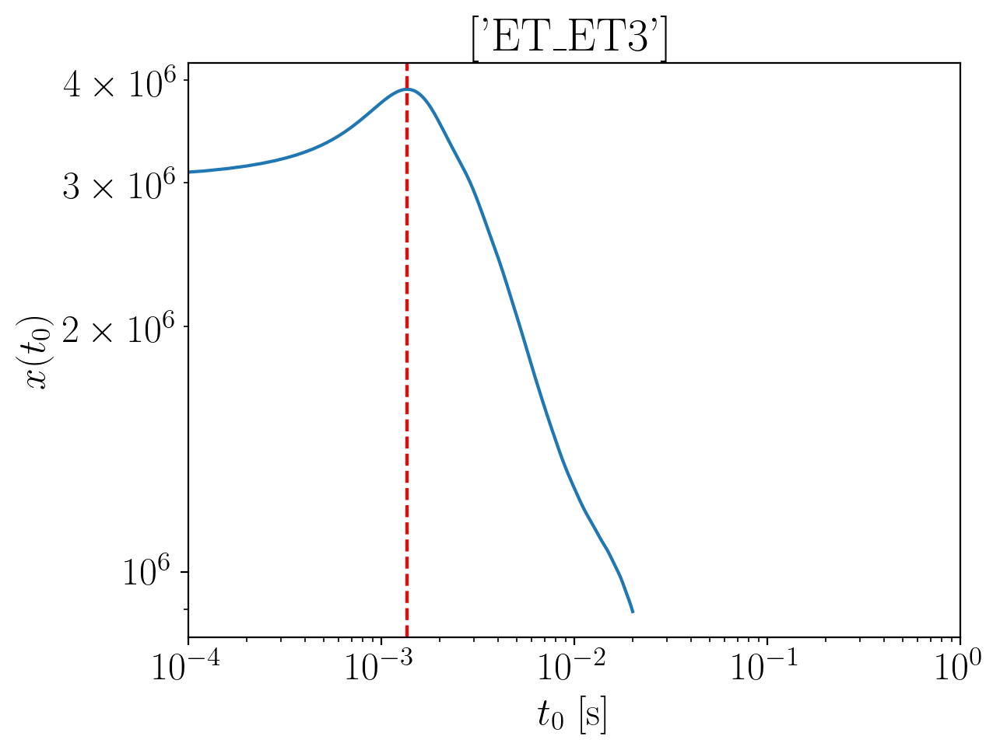

2024-01-15 15:01:20,752 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:20,766 - Network - INFO : PSDs loaded.
2024-01-15 15:01:20,768 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:20,775 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:20,782 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:20,806 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:20,806 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:01:20,812 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.366413777824511
Inner product:
0.9998645672835342


2024-01-15 15:01:26,304 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:01:26,349 - Network - INFO : PSDs loaded.
2024-01-15 15:01:26,355 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:26,377 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:26,378 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:01:26,379 - Network - INFO :    CE-40_C
2024-01-15 15:01:30,242 - Network - INFO :    CE-20_S
2024-01-15 15:01:34,291 - Network - INFO :    ET_ET1
2024-01-15 15:01:38,356 - Network - INFO :    ET_ET2
2024-01-15 15:01:42,044 - Network - INFO :    ET_ET3
2024-01-15 15:01:45,749 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:01:45,757 - Network - INFO : SNRs calculated.
2024-01-15 15:01:45,758 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:01:45,758 - Network - INFO :    CE-40_C
2024-01-15 15:01:45,853 - Network - INFO :

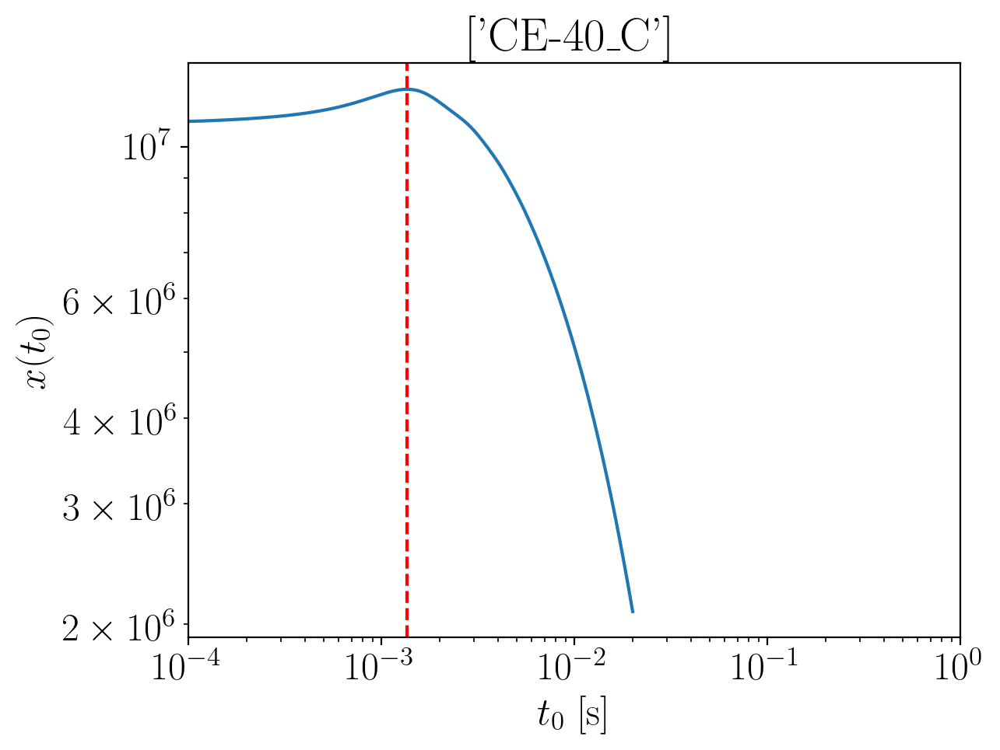

2024-01-15 15:01:47,682 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:47,692 - Network - INFO : PSDs loaded.
2024-01-15 15:01:47,710 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:47,722 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:47,732 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3585407799515026
Inner product:
0.9999404774208267


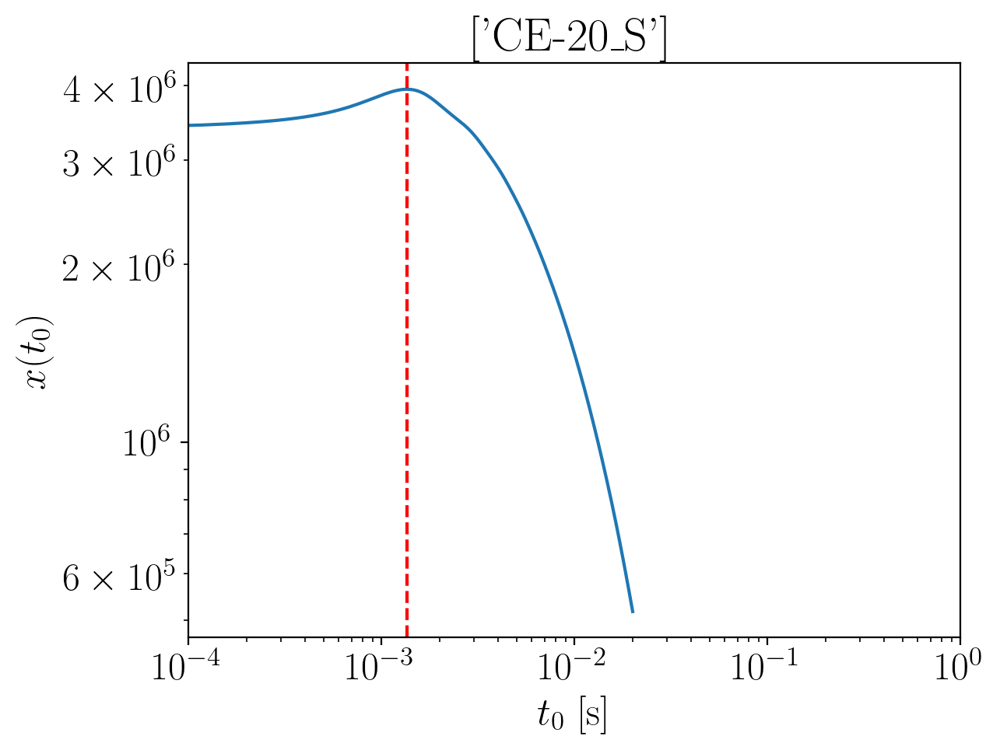

2024-01-15 15:01:49,057 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:49,068 - Network - INFO : PSDs loaded.
2024-01-15 15:01:49,070 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:49,087 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:49,095 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.359304400704883
Inner product:
0.999921144051433


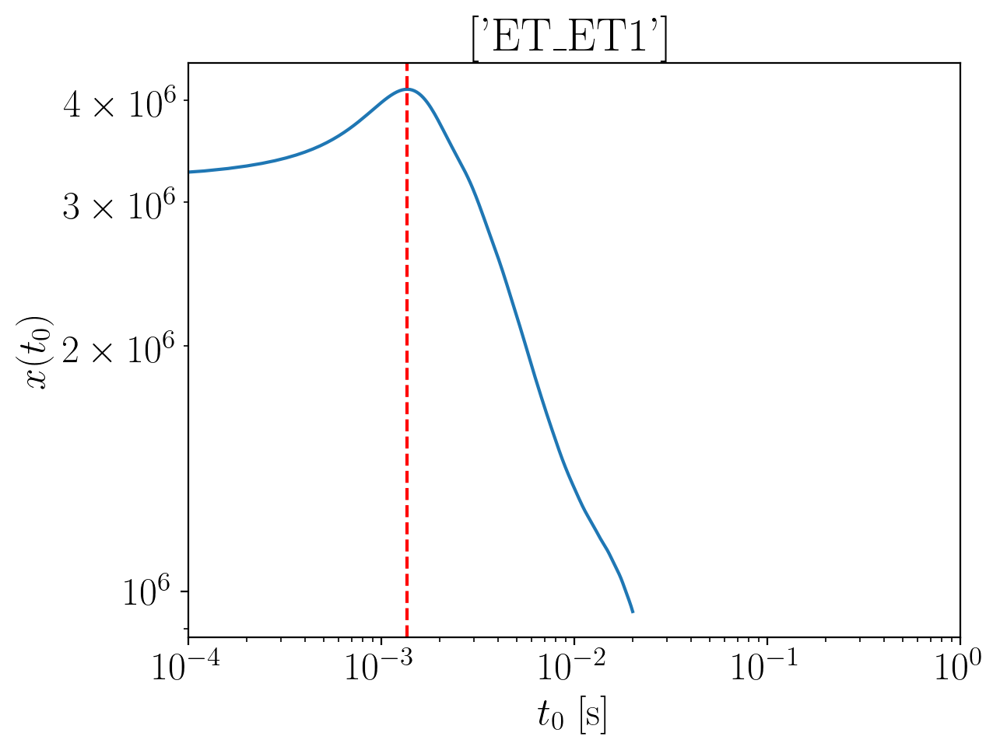

2024-01-15 15:01:50,664 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:50,678 - Network - INFO : PSDs loaded.
2024-01-15 15:01:50,681 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:50,689 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:50,698 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3540574640509413
Inner product:
0.9998645672835353


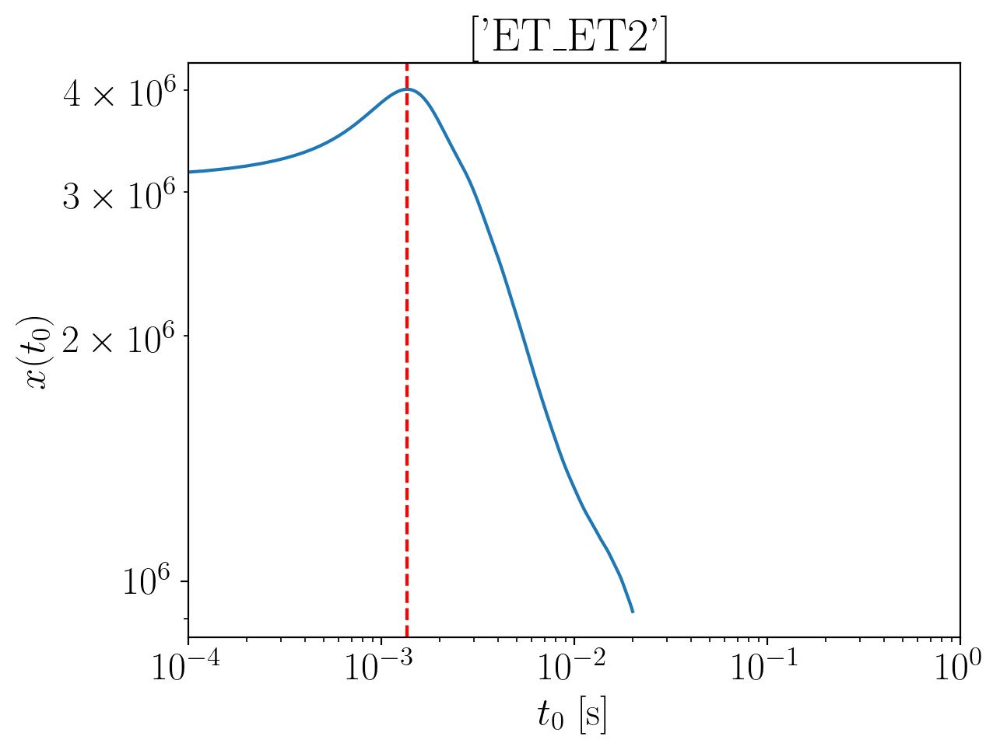

2024-01-15 15:01:52,687 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:52,705 - Network - INFO : PSDs loaded.
2024-01-15 15:01:52,708 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:52,718 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:52,728 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.354057464050941
Inner product:
0.9998645672835352


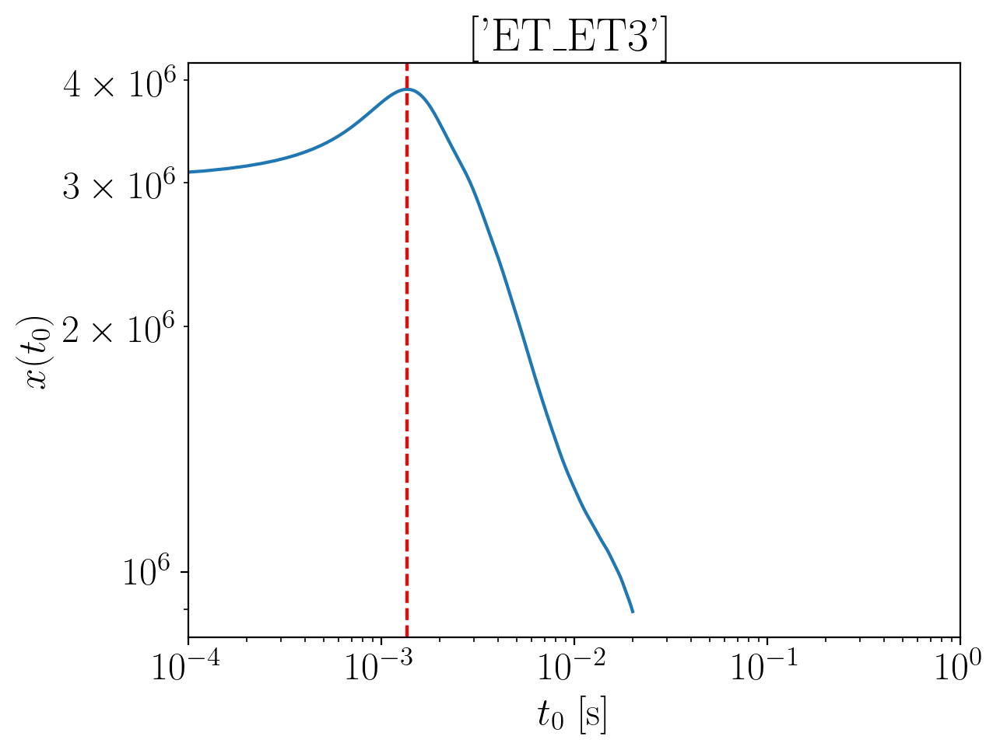

2024-01-15 15:01:54,854 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:54,868 - Network - INFO : PSDs loaded.
2024-01-15 15:01:54,870 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:01:54,878 - Network - INFO : Detector responses calculated.
2024-01-15 15:01:54,886 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:54,910 - Network - INFO : Polarizations calculated.
2024-01-15 15:01:54,911 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:01:54,916 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3540574640509413
Inner product:
0.9998645672835352


2024-01-15 15:02:00,858 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:02:00,904 - Network - INFO : PSDs loaded.
2024-01-15 15:02:00,910 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:00,933 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:00,934 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:02:00,934 - Network - INFO :    CE-40_C
2024-01-15 15:02:04,581 - Network - INFO :    CE-20_S
2024-01-15 15:02:08,213 - Network - INFO :    ET_ET1
2024-01-15 15:02:11,841 - Network - INFO :    ET_ET2
2024-01-15 15:02:15,450 - Network - INFO :    ET_ET3
2024-01-15 15:02:19,075 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:02:19,084 - Network - INFO : SNRs calculated.
2024-01-15 15:02:19,084 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:02:19,085 - Network - INFO :    CE-40_C
2024-01-15 15:02:19,178 - Network - INFO :

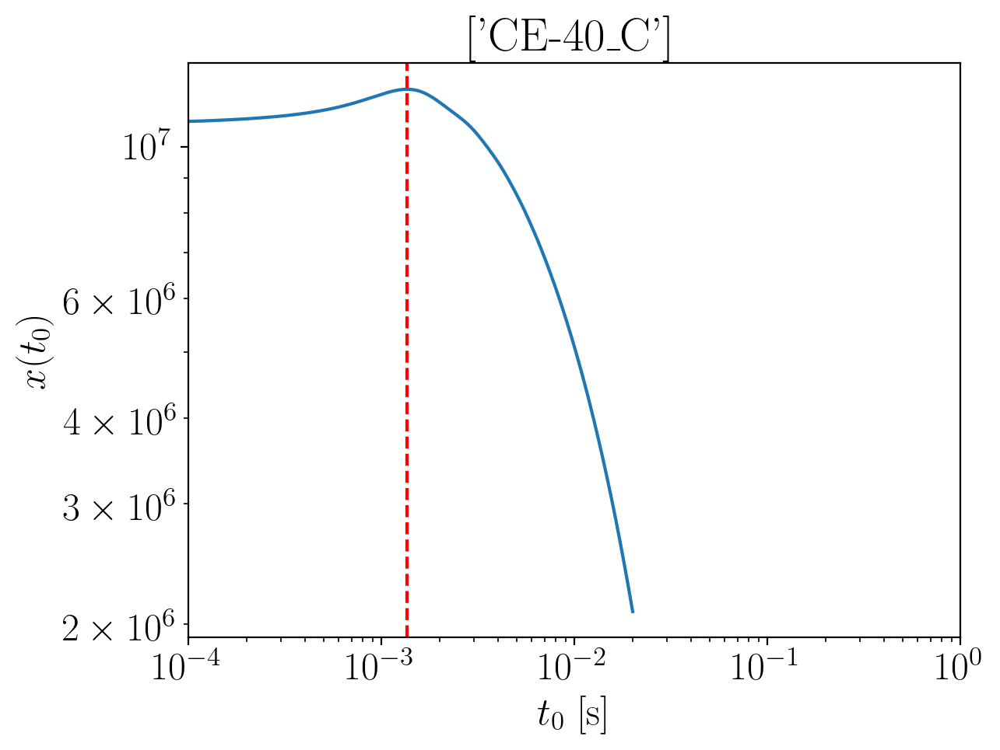

2024-01-15 15:02:20,938 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:20,946 - Network - INFO : PSDs loaded.
2024-01-15 15:02:20,948 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:20,956 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:20,963 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3466656706723845
Inner product:
0.9999404774208267


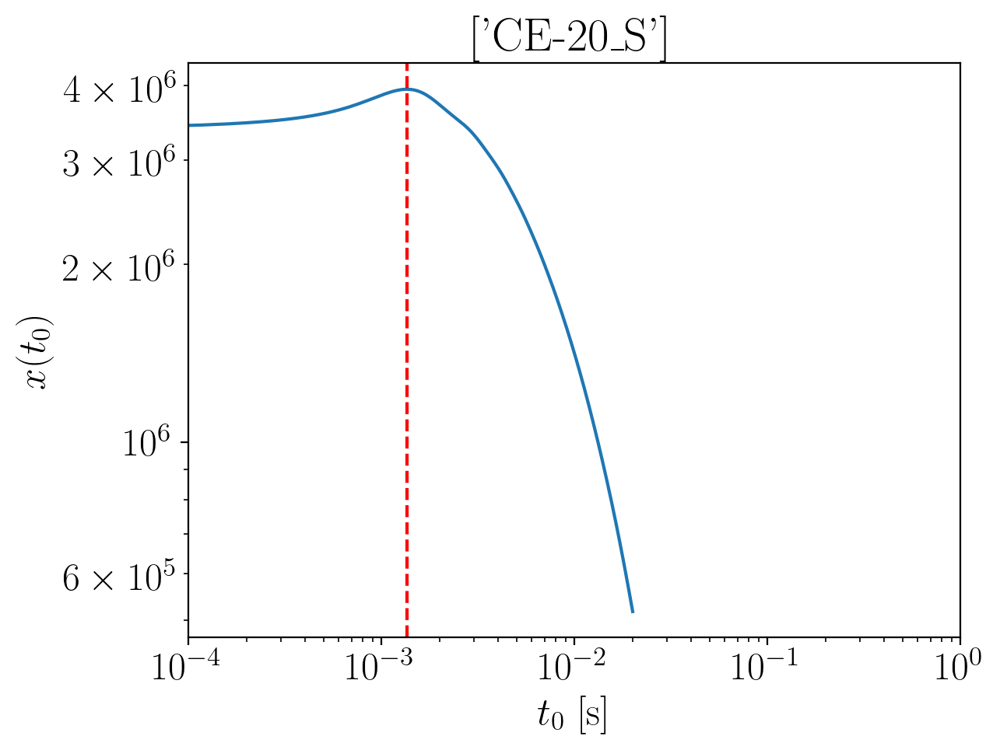

2024-01-15 15:02:22,124 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:22,130 - Network - INFO : PSDs loaded.
2024-01-15 15:02:22,132 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:22,139 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:22,149 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.347429291425764
Inner product:
0.999921144051433


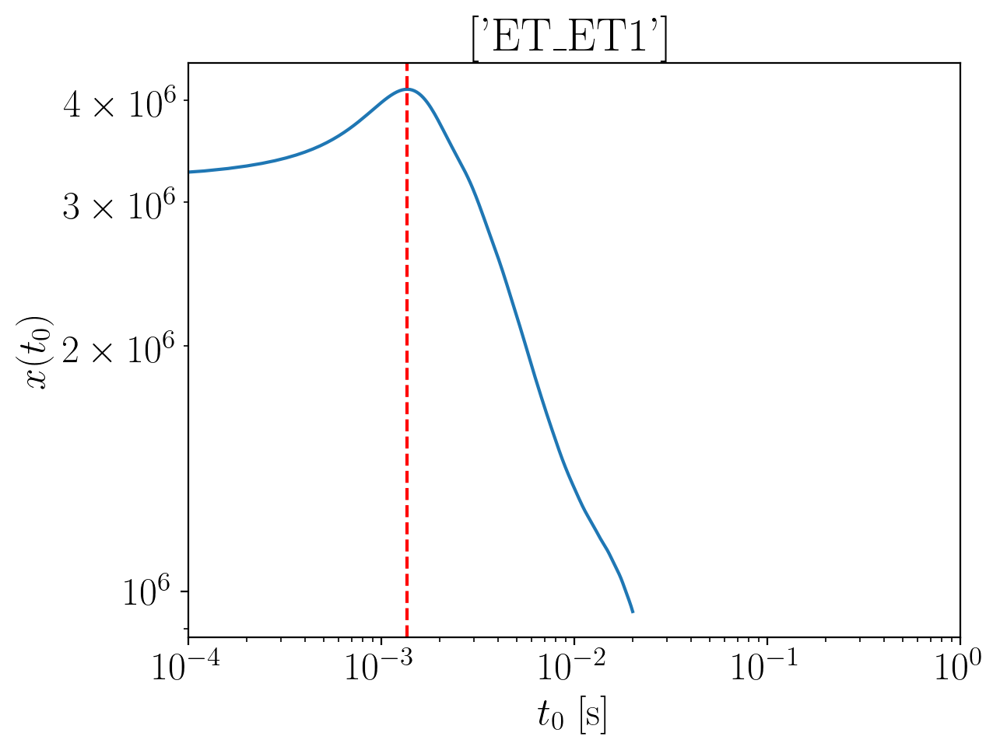

2024-01-15 15:02:23,530 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:23,542 - Network - INFO : PSDs loaded.
2024-01-15 15:02:23,544 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:23,551 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:23,558 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.342182354771805
Inner product:
0.9998645672835351


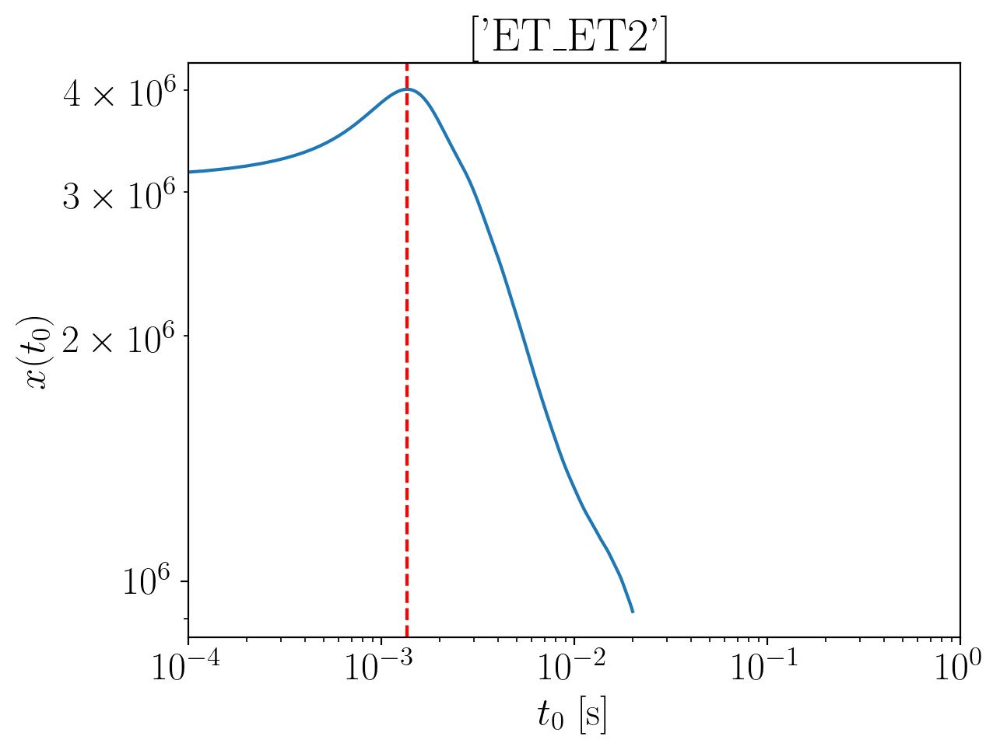

2024-01-15 15:02:25,036 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:25,049 - Network - INFO : PSDs loaded.
2024-01-15 15:02:25,051 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:25,058 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:25,065 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3421823547718046
Inner product:
0.9998645672835353


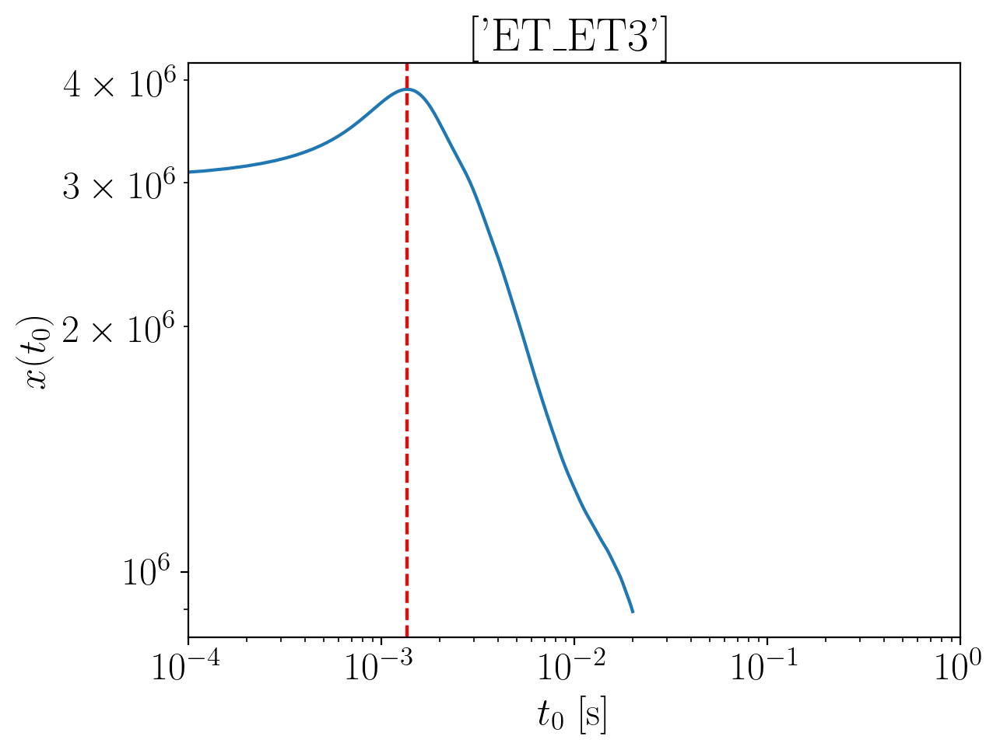

2024-01-15 15:02:26,449 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:26,463 - Network - INFO : PSDs loaded.
2024-01-15 15:02:26,465 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:26,472 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:26,479 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:26,504 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:26,505 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:02:26,511 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.342182354771805
Inner product:
0.9998645672835353


2024-01-15 15:02:31,928 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:02:31,975 - Network - INFO : PSDs loaded.
2024-01-15 15:02:31,981 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:32,003 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:32,004 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:02:32,005 - Network - INFO :    CE-40_C
2024-01-15 15:02:35,671 - Network - INFO :    CE-20_S
2024-01-15 15:02:39,306 - Network - INFO :    ET_ET1
2024-01-15 15:02:42,955 - Network - INFO :    ET_ET2
2024-01-15 15:02:46,709 - Network - INFO :    ET_ET3
2024-01-15 15:02:50,344 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:02:50,352 - Network - INFO : SNRs calculated.
2024-01-15 15:02:50,352 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:02:50,353 - Network - INFO :    CE-40_C
2024-01-15 15:02:50,446 - Network - INFO :

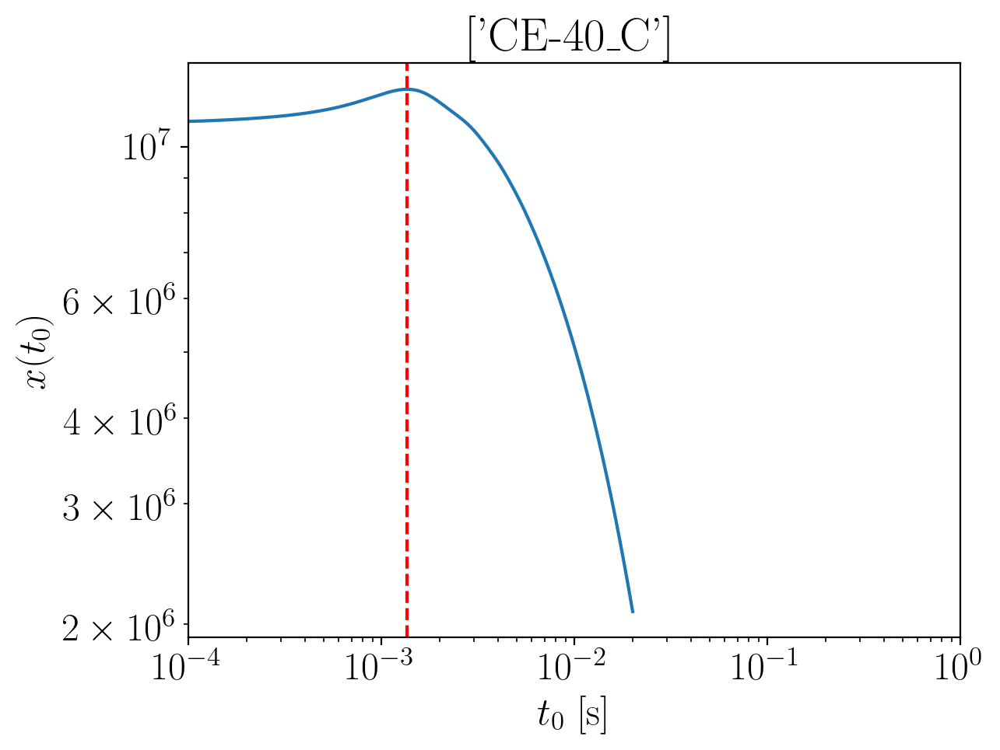

2024-01-15 15:02:52,206 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:52,213 - Network - INFO : PSDs loaded.
2024-01-15 15:02:52,215 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:52,222 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:52,229 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3351745101427133
Inner product:
0.9999404774208267


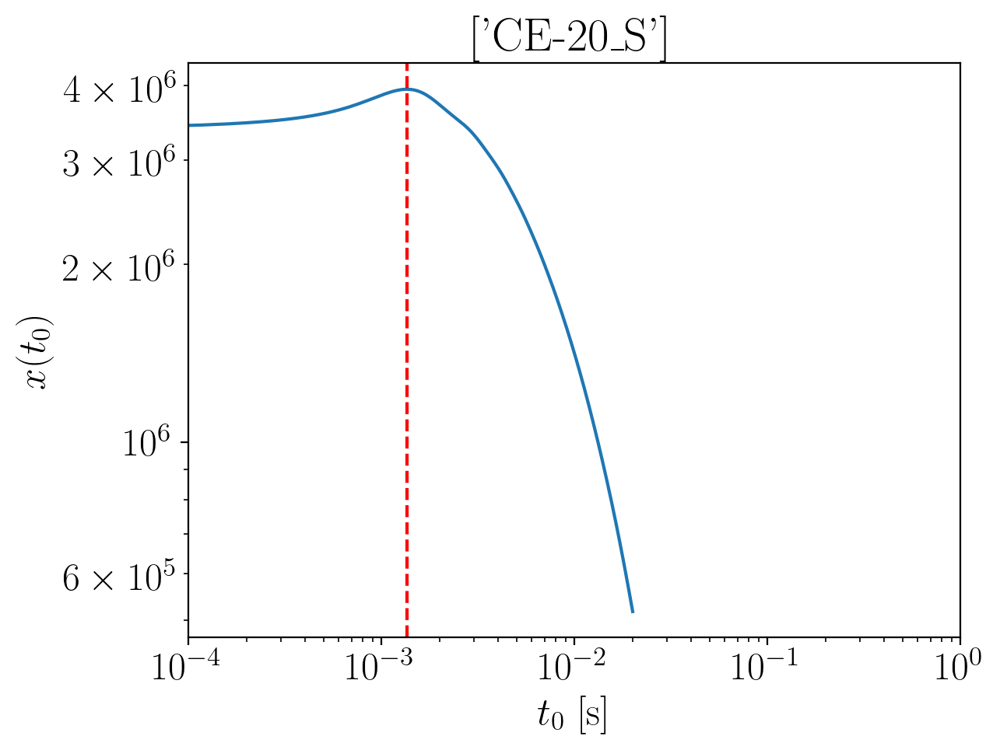

2024-01-15 15:02:53,385 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:53,392 - Network - INFO : PSDs loaded.
2024-01-15 15:02:53,394 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:53,404 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:53,413 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3359381308960905
Inner product:
0.9999211440514331


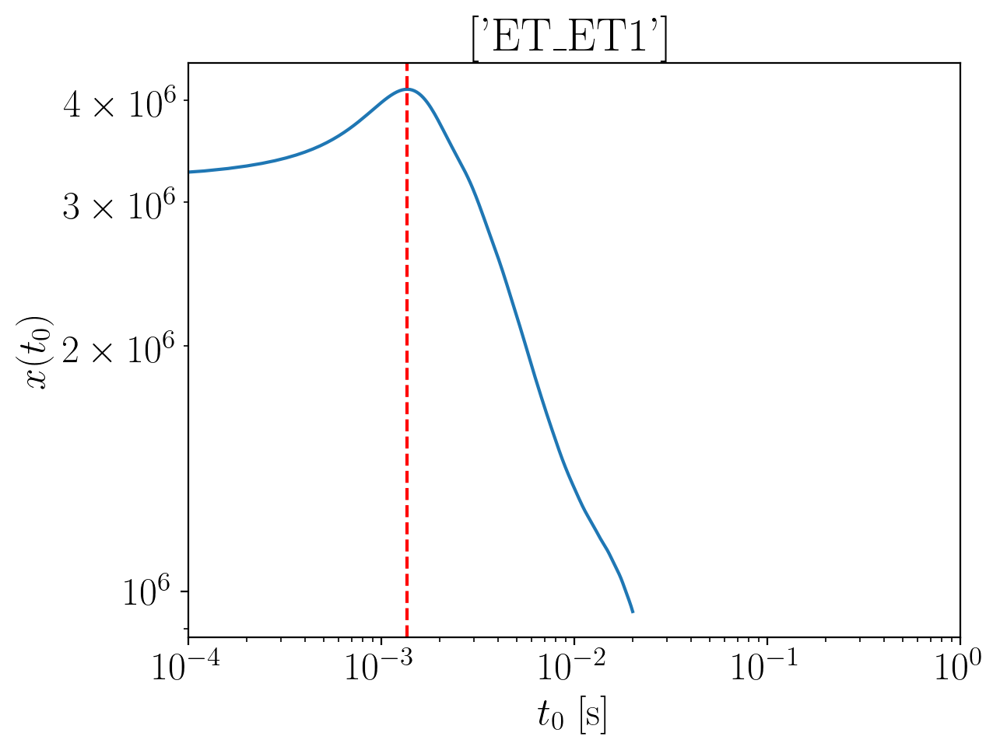

2024-01-15 15:02:54,789 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:54,802 - Network - INFO : PSDs loaded.
2024-01-15 15:02:54,803 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:54,810 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:54,817 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.330691194242134
Inner product:
0.9998645672835351


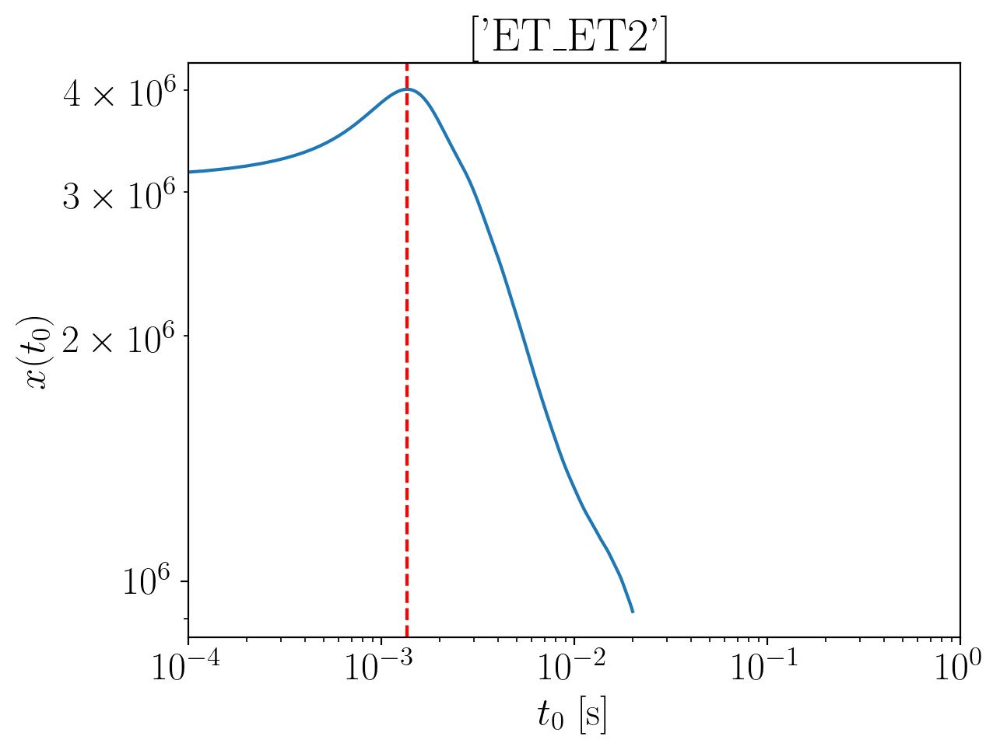

2024-01-15 15:02:56,297 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:56,311 - Network - INFO : PSDs loaded.
2024-01-15 15:02:56,313 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:56,320 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:56,327 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.330691194242134
Inner product:
0.9998645672835353


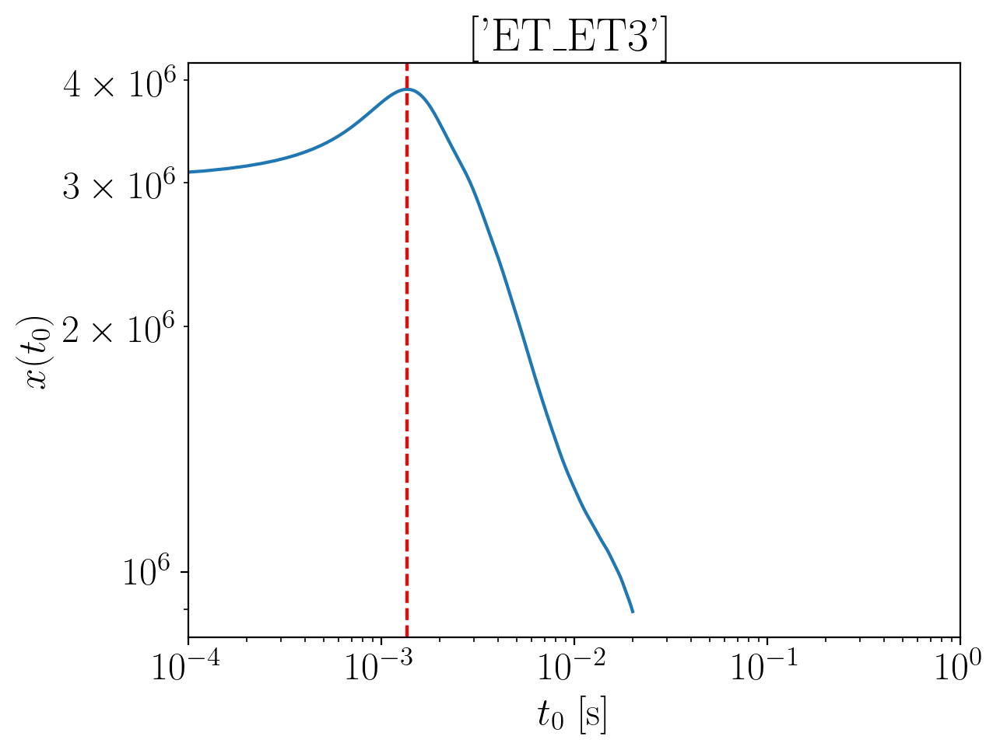

2024-01-15 15:02:57,723 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:57,739 - Network - INFO : PSDs loaded.
2024-01-15 15:02:57,745 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:02:57,756 - Network - INFO : Detector responses calculated.
2024-01-15 15:02:57,768 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:57,793 - Network - INFO : Polarizations calculated.
2024-01-15 15:02:57,794 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:02:57,800 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3306911942421342
Inner product:
0.9998645672835353


2024-01-15 15:03:03,203 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:03:03,247 - Network - INFO : PSDs loaded.
2024-01-15 15:03:03,253 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:03,276 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:03,276 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:03:03,277 - Network - INFO :    CE-40_C
2024-01-15 15:03:06,921 - Network - INFO :    CE-20_S
2024-01-15 15:03:10,567 - Network - INFO :    ET_ET1
2024-01-15 15:03:14,219 - Network - INFO :    ET_ET2
2024-01-15 15:03:17,883 - Network - INFO :    ET_ET3
2024-01-15 15:03:21,521 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:03:21,530 - Network - INFO : SNRs calculated.
2024-01-15 15:03:21,530 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:03:21,530 - Network - INFO :    CE-40_C
2024-01-15 15:03:21,624 - Network - INFO :

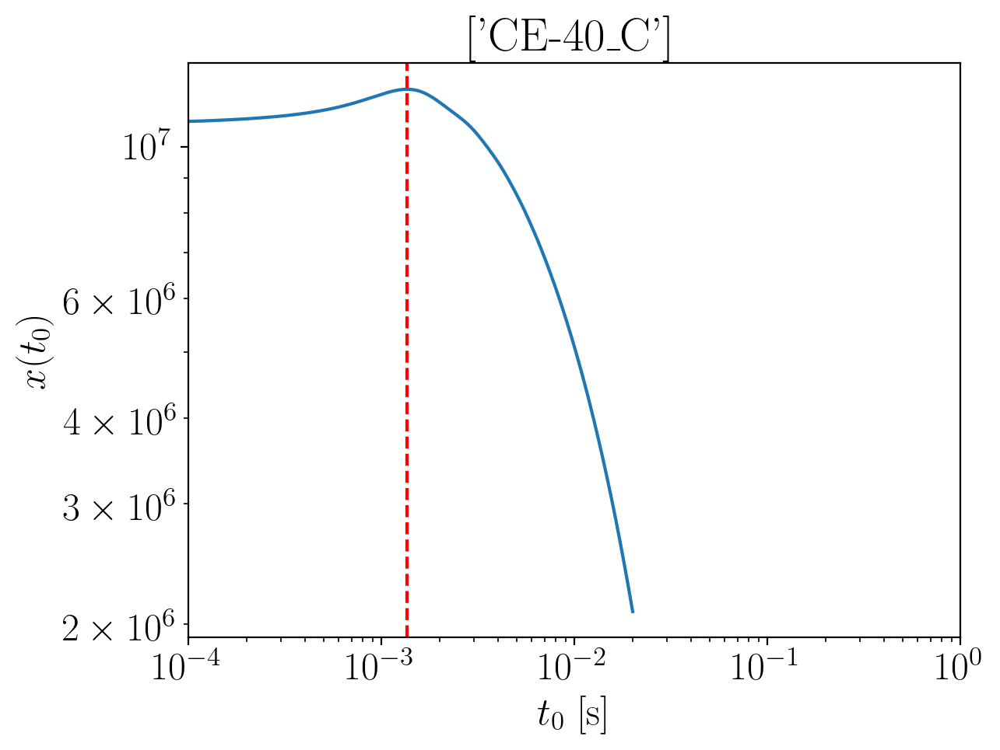

2024-01-15 15:03:23,379 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:23,387 - Network - INFO : PSDs loaded.
2024-01-15 15:03:23,389 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:23,396 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:23,403 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.324000271807134
Inner product:
0.9999404774208267


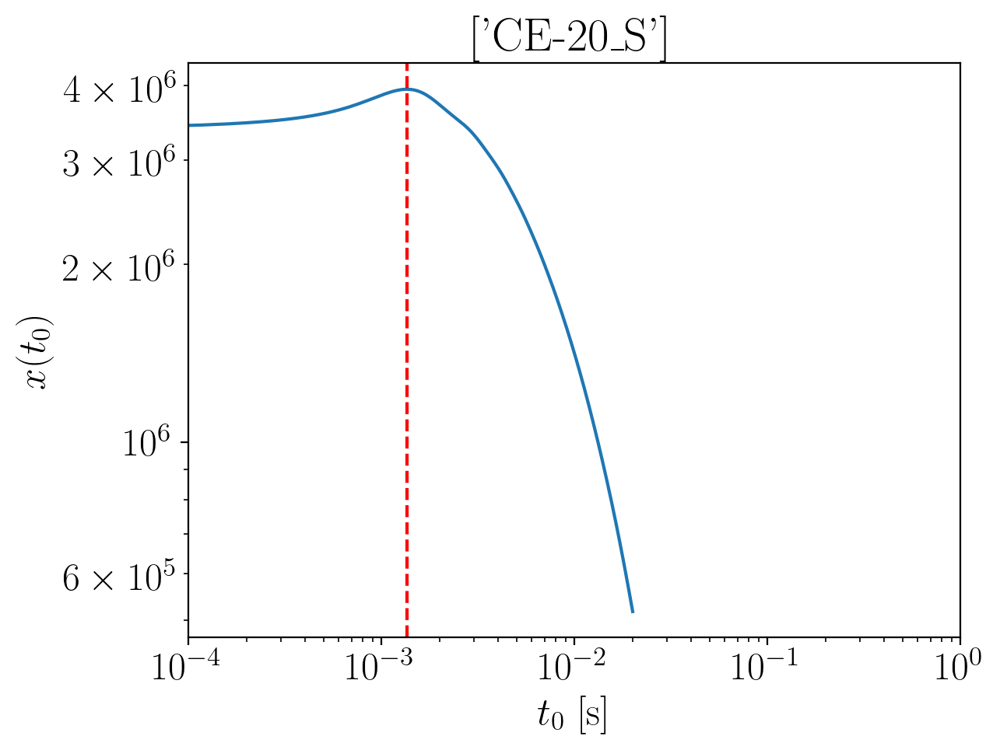

2024-01-15 15:03:24,562 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:24,568 - Network - INFO : PSDs loaded.
2024-01-15 15:03:24,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:24,577 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:24,585 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3247638925605094
Inner product:
0.9999211440514332


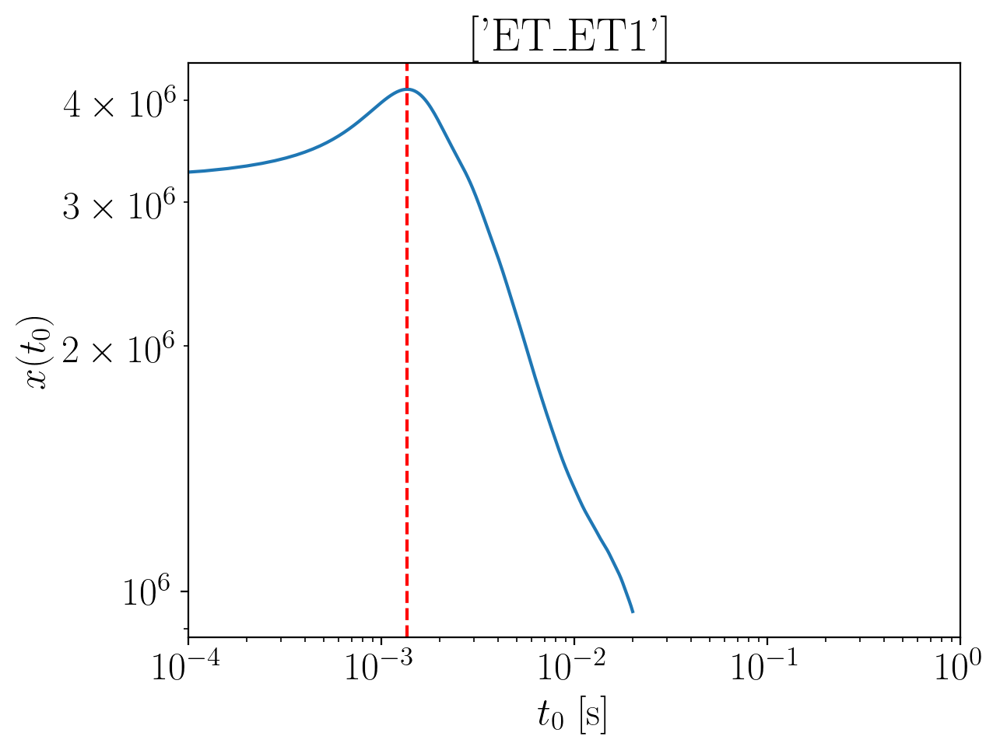

2024-01-15 15:03:25,984 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:25,997 - Network - INFO : PSDs loaded.
2024-01-15 15:03:25,998 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:26,005 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:26,012 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3195169559065527
Inner product:
0.9998645672835351


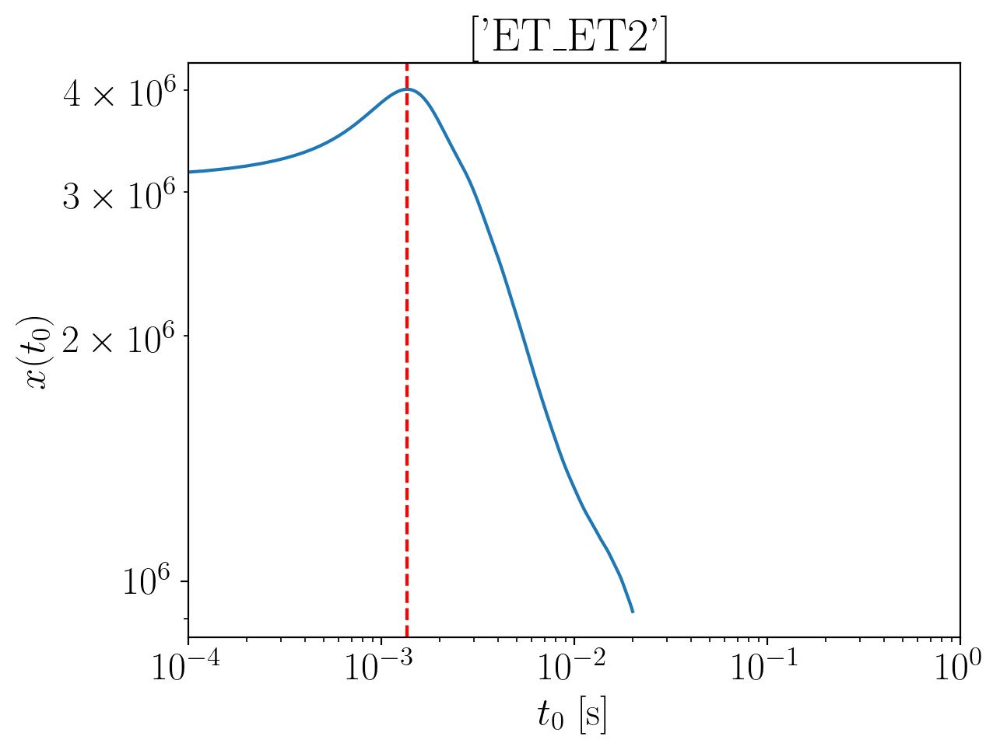

2024-01-15 15:03:27,473 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:27,487 - Network - INFO : PSDs loaded.
2024-01-15 15:03:27,489 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:27,496 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:27,503 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3195169559065527
Inner product:
0.9998645672835353


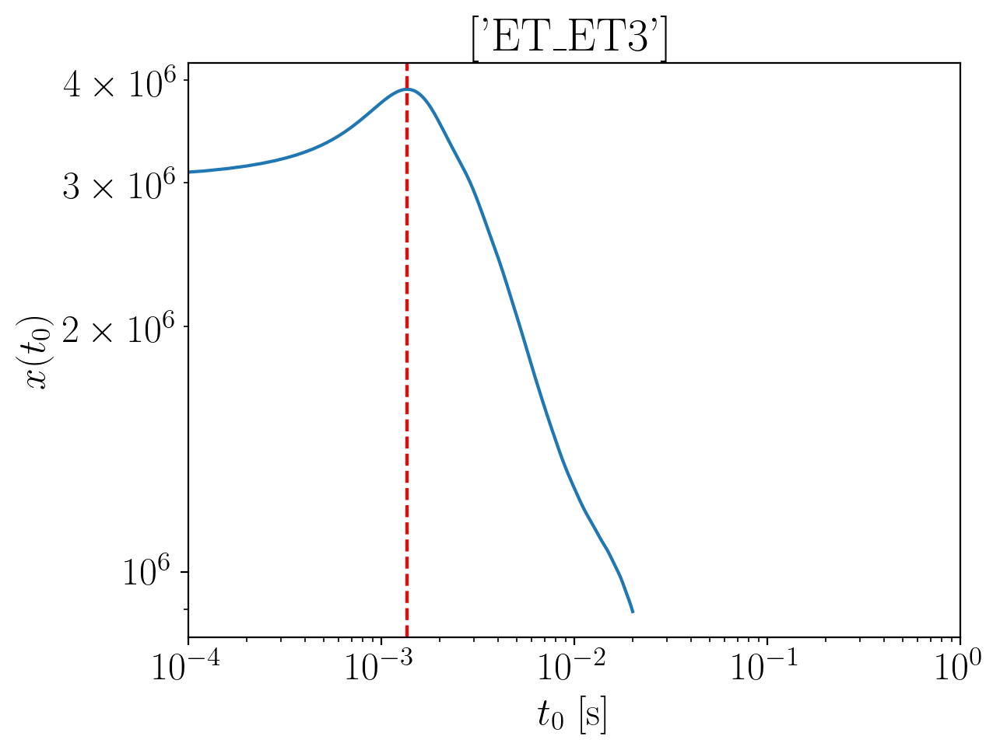

2024-01-15 15:03:28,901 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:28,915 - Network - INFO : PSDs loaded.
2024-01-15 15:03:28,917 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:28,923 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:28,930 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:28,955 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:28,956 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:03:28,962 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3195169559065527
Inner product:
0.9998645672835353


2024-01-15 15:03:34,358 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:03:34,402 - Network - INFO : PSDs loaded.
2024-01-15 15:03:34,408 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:34,428 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:34,429 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:03:34,430 - Network - INFO :    CE-40_C
2024-01-15 15:03:38,169 - Network - INFO :    CE-20_S
2024-01-15 15:03:41,799 - Network - INFO :    ET_ET1
2024-01-15 15:03:45,438 - Network - INFO :    ET_ET2
2024-01-15 15:03:49,089 - Network - INFO :    ET_ET3
2024-01-15 15:03:52,711 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:03:52,719 - Network - INFO : SNRs calculated.
2024-01-15 15:03:52,720 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:03:52,720 - Network - INFO :    CE-40_C
2024-01-15 15:03:52,814 - Network - INFO :

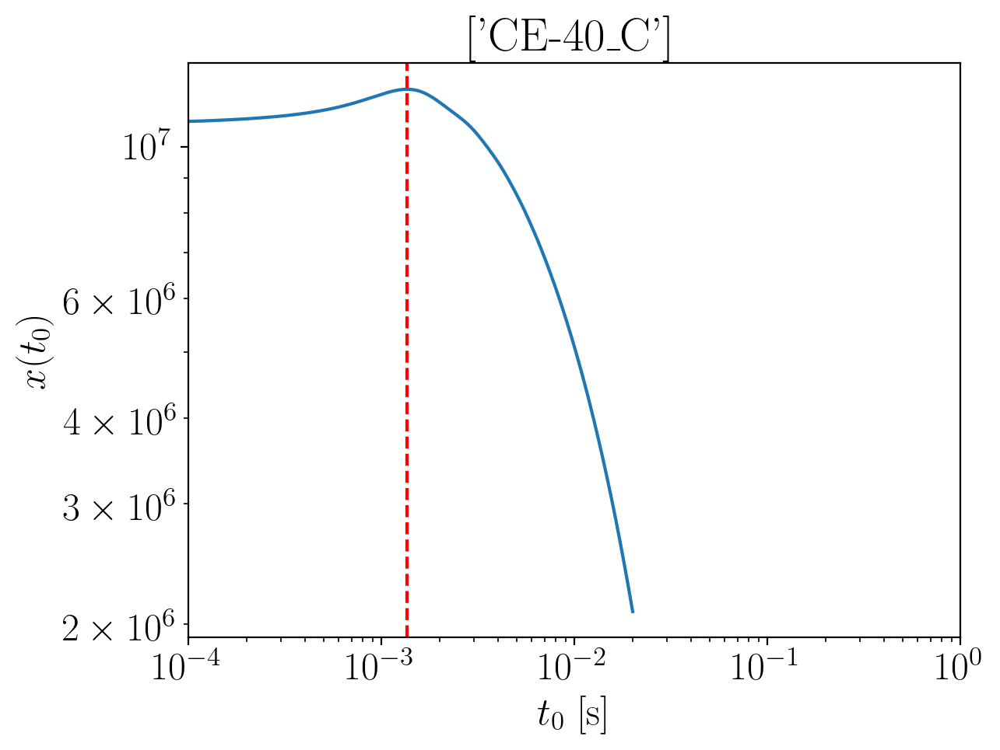

2024-01-15 15:03:54,593 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:54,600 - Network - INFO : PSDs loaded.
2024-01-15 15:03:54,602 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:54,609 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:54,616 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.313093917298384
Inner product:
0.9999404774208267


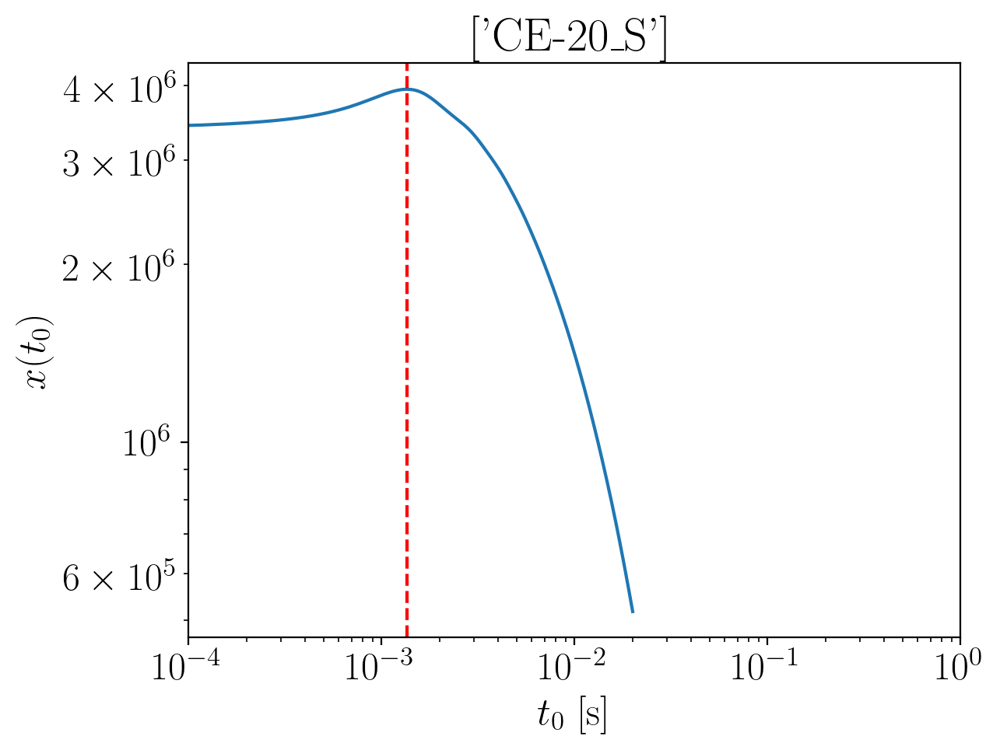

2024-01-15 15:03:55,772 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:55,779 - Network - INFO : PSDs loaded.
2024-01-15 15:03:55,781 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:55,788 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:55,795 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.31385753805176
Inner product:
0.9999211440514332


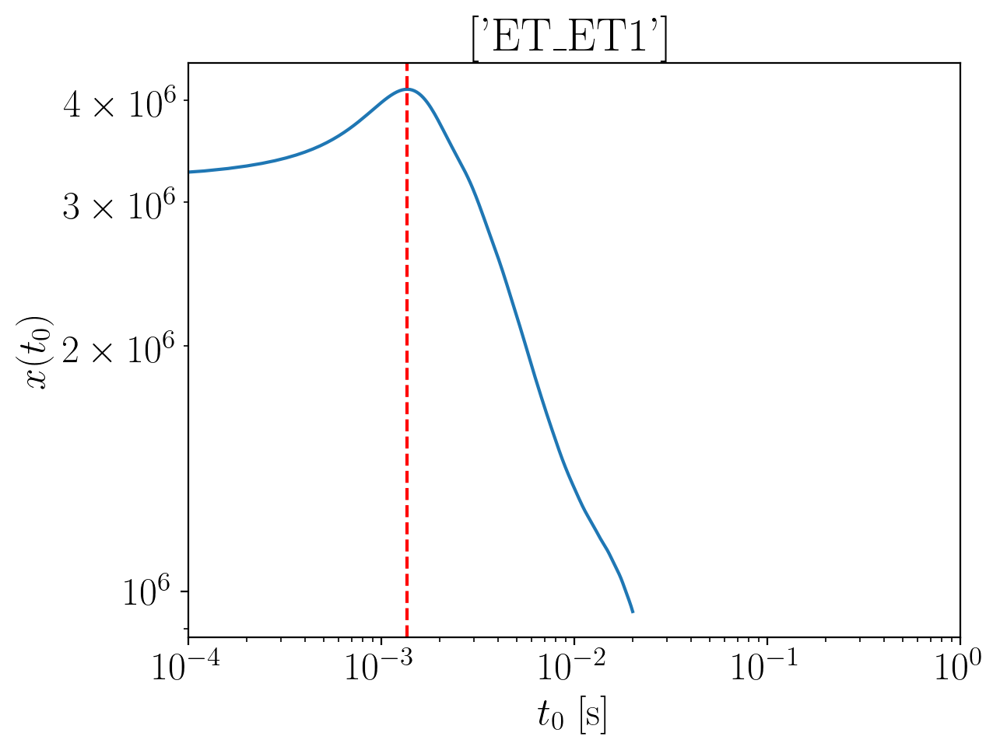

2024-01-15 15:03:57,198 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:57,211 - Network - INFO : PSDs loaded.
2024-01-15 15:03:57,214 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:57,222 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:57,228 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3086106013978016
Inner product:
0.9998645672835352


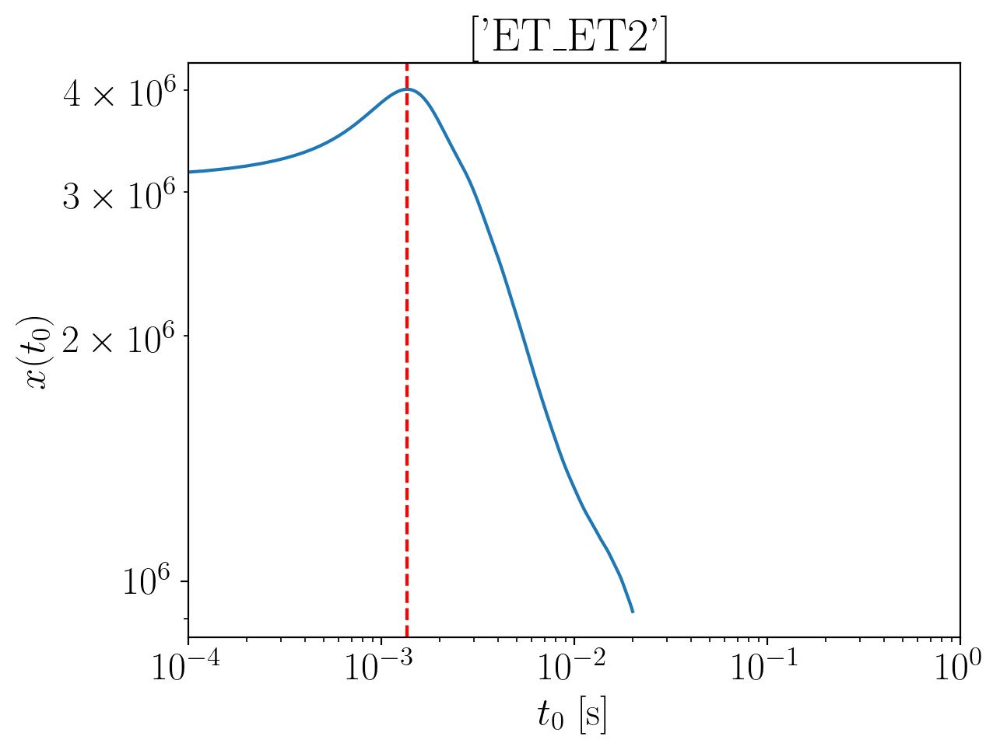

2024-01-15 15:03:58,711 - Network - INFO : Polarizations calculated.
2024-01-15 15:03:58,725 - Network - INFO : PSDs loaded.
2024-01-15 15:03:58,727 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:03:58,734 - Network - INFO : Detector responses calculated.
2024-01-15 15:03:58,740 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3086106013978016
Inner product:
0.9998645672835353


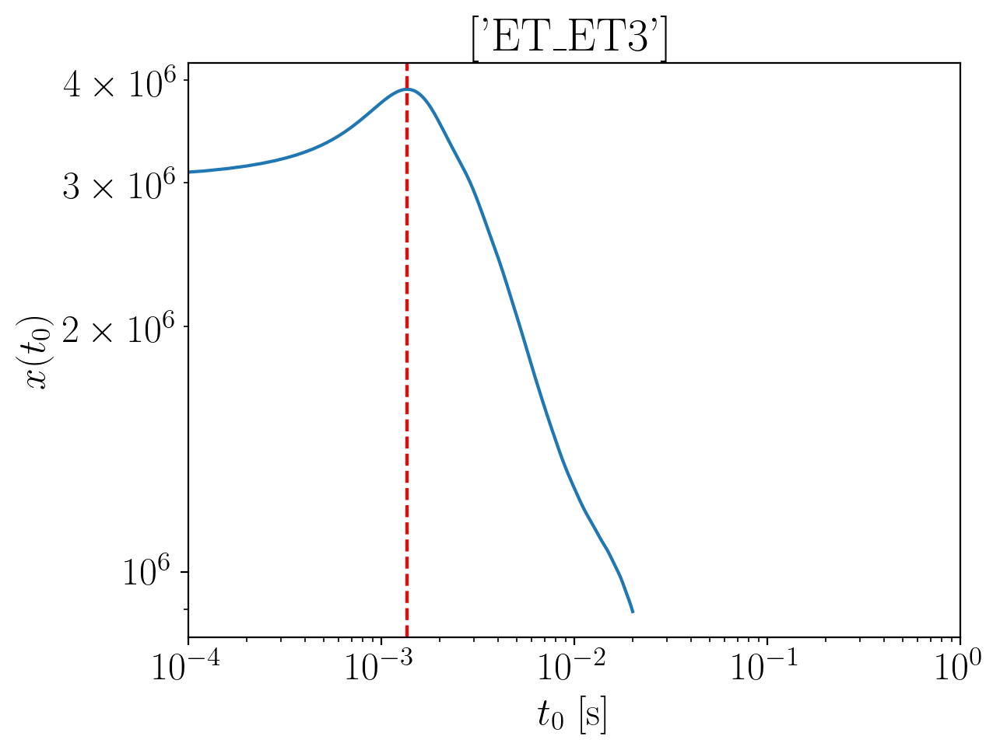

2024-01-15 15:04:00,140 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:00,154 - Network - INFO : PSDs loaded.
2024-01-15 15:04:00,156 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:00,162 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:00,169 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:00,193 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:00,194 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:04:00,199 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.308610601397802
Inner product:
0.9998645672835355


2024-01-15 15:04:05,611 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:04:05,655 - Network - INFO : PSDs loaded.
2024-01-15 15:04:05,660 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:05,681 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:05,682 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:04:05,683 - Network - INFO :    CE-40_C
2024-01-15 15:04:09,331 - Network - INFO :    CE-20_S
2024-01-15 15:04:12,971 - Network - INFO :    ET_ET1
2024-01-15 15:04:16,587 - Network - INFO :    ET_ET2
2024-01-15 15:04:20,220 - Network - INFO :    ET_ET3
2024-01-15 15:04:23,958 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:04:23,966 - Network - INFO : SNRs calculated.
2024-01-15 15:04:23,967 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:04:23,967 - Network - INFO :    CE-40_C
2024-01-15 15:04:24,061 - Network - INFO :

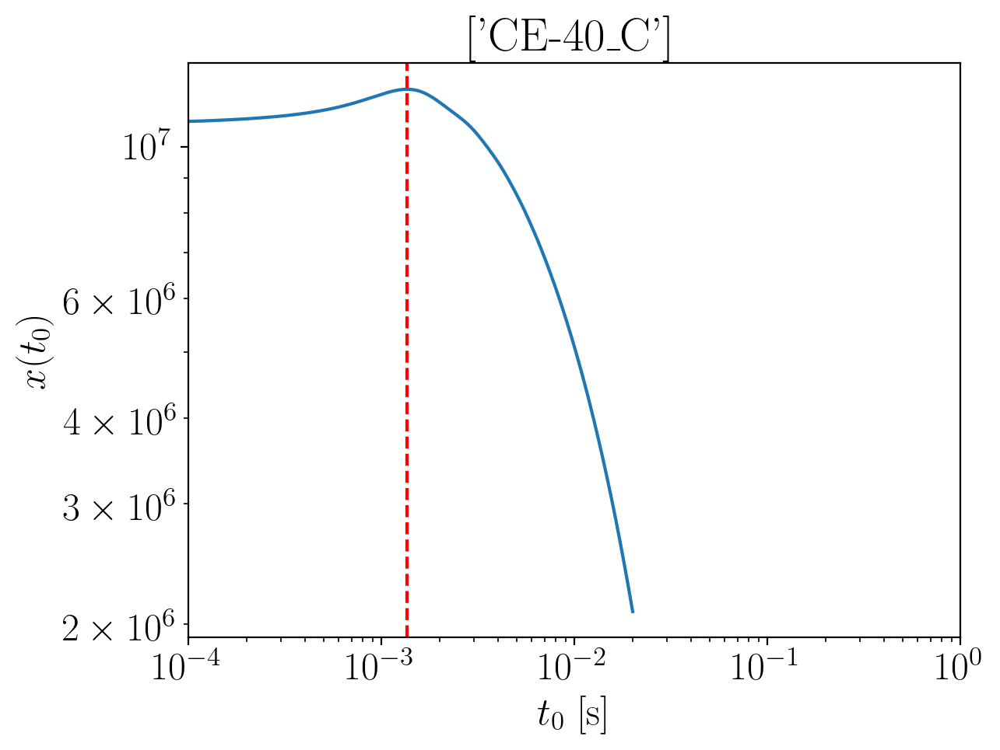

2024-01-15 15:04:25,841 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:25,849 - Network - INFO : PSDs loaded.
2024-01-15 15:04:25,851 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:25,858 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:25,866 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.3024179764788646
Inner product:
0.9999404774208267


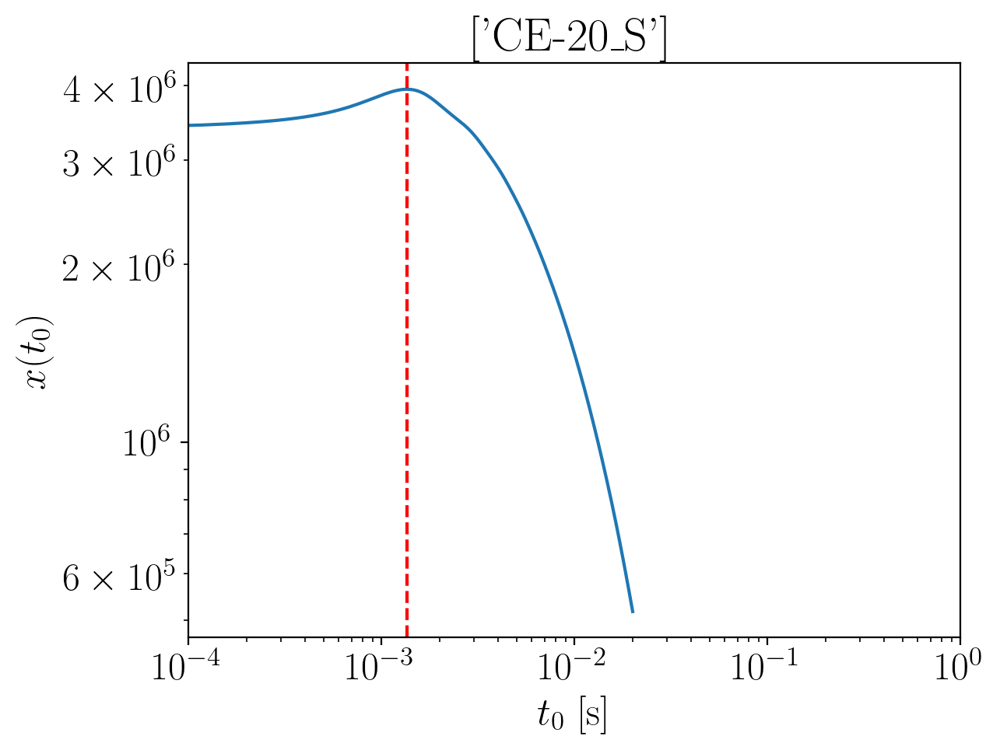

2024-01-15 15:04:27,030 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:27,037 - Network - INFO : PSDs loaded.
2024-01-15 15:04:27,039 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:27,046 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:27,053 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.303181597232241
Inner product:
0.9999211440514332


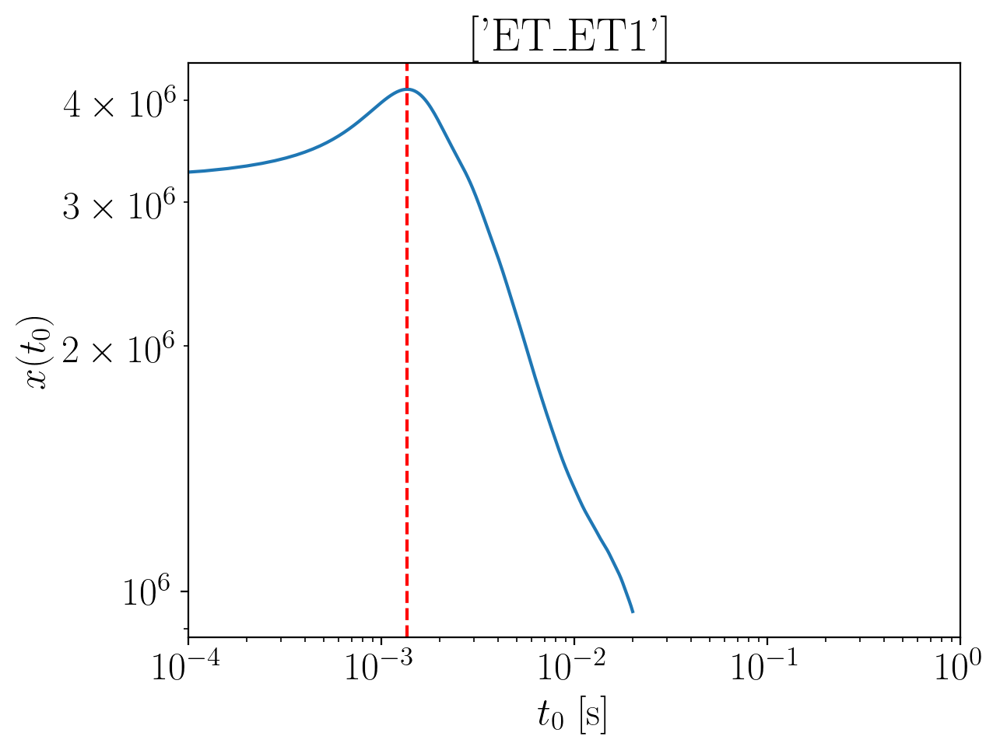

2024-01-15 15:04:28,462 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:28,475 - Network - INFO : PSDs loaded.
2024-01-15 15:04:28,477 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:28,484 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:28,491 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.2979346605782776
Inner product:
0.9998645672835351


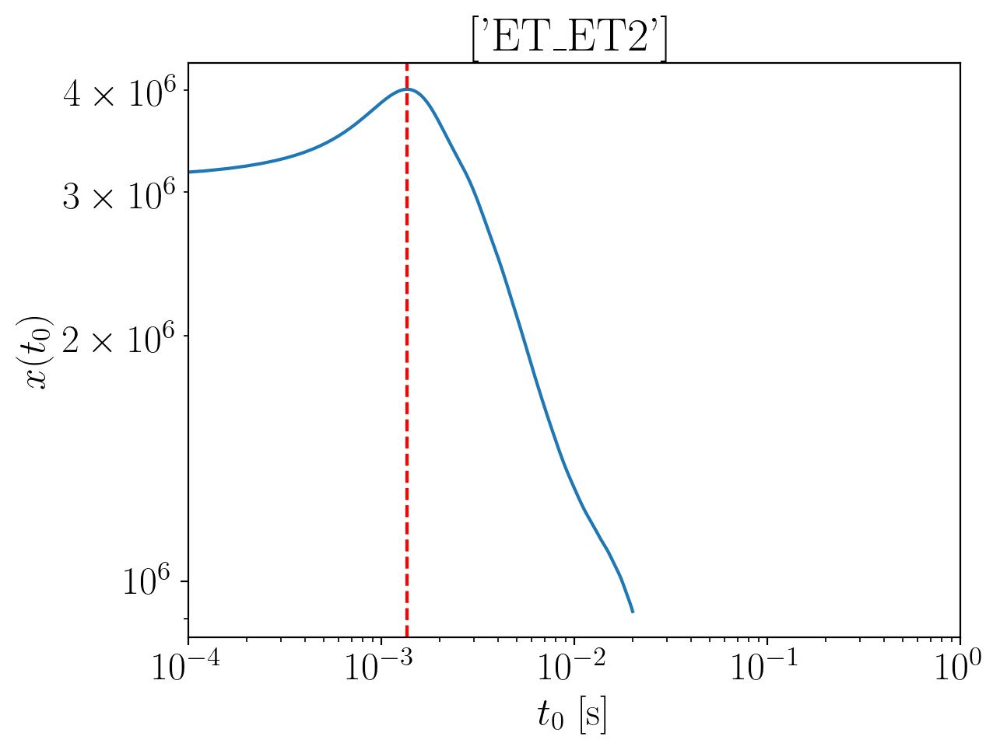

2024-01-15 15:04:29,971 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:29,985 - Network - INFO : PSDs loaded.
2024-01-15 15:04:29,987 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:29,994 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:30,001 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.297934660578277
Inner product:
0.9998645672835355


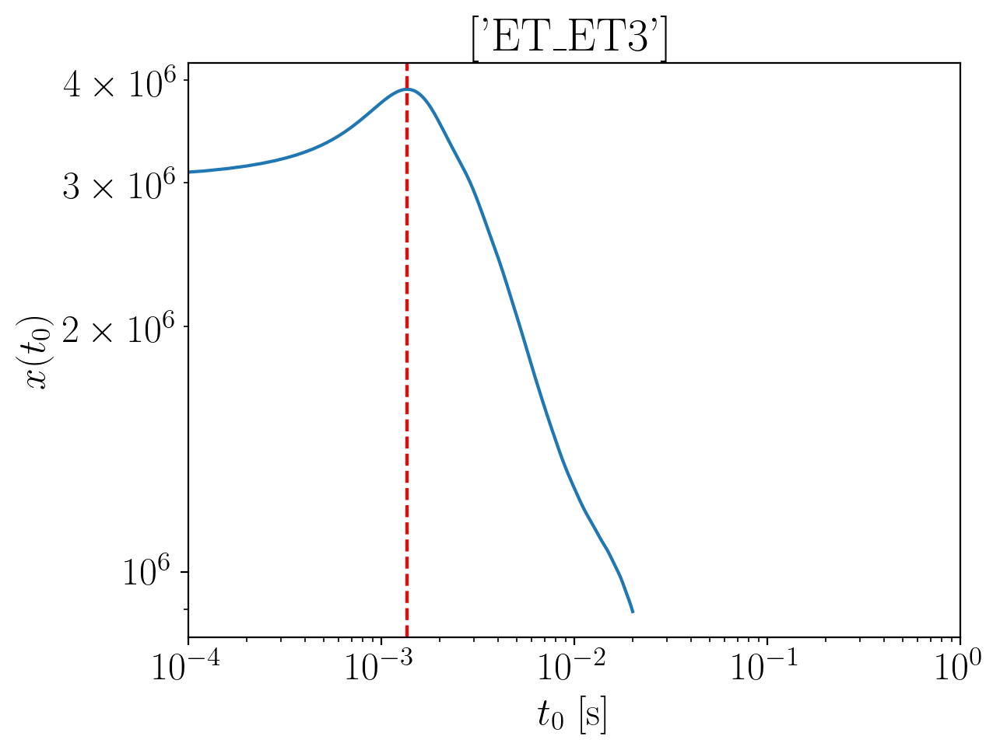

2024-01-15 15:04:31,407 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:31,421 - Network - INFO : PSDs loaded.
2024-01-15 15:04:31,424 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:31,431 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:31,437 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:31,462 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:31,463 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:04:31,468 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.297934660578277
Inner product:
0.9998645672835353


2024-01-15 15:04:36,890 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:04:36,934 - Network - INFO : PSDs loaded.
2024-01-15 15:04:36,939 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:36,962 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:36,963 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:04:36,963 - Network - INFO :    CE-40_C
2024-01-15 15:04:40,619 - Network - INFO :    CE-20_S
2024-01-15 15:04:44,243 - Network - INFO :    ET_ET1
2024-01-15 15:04:47,875 - Network - INFO :    ET_ET2
2024-01-15 15:04:51,502 - Network - INFO :    ET_ET3
2024-01-15 15:04:55,161 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:04:55,169 - Network - INFO : SNRs calculated.
2024-01-15 15:04:55,170 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:04:55,170 - Network - INFO :    CE-40_C
2024-01-15 15:04:55,264 - Network - INFO :

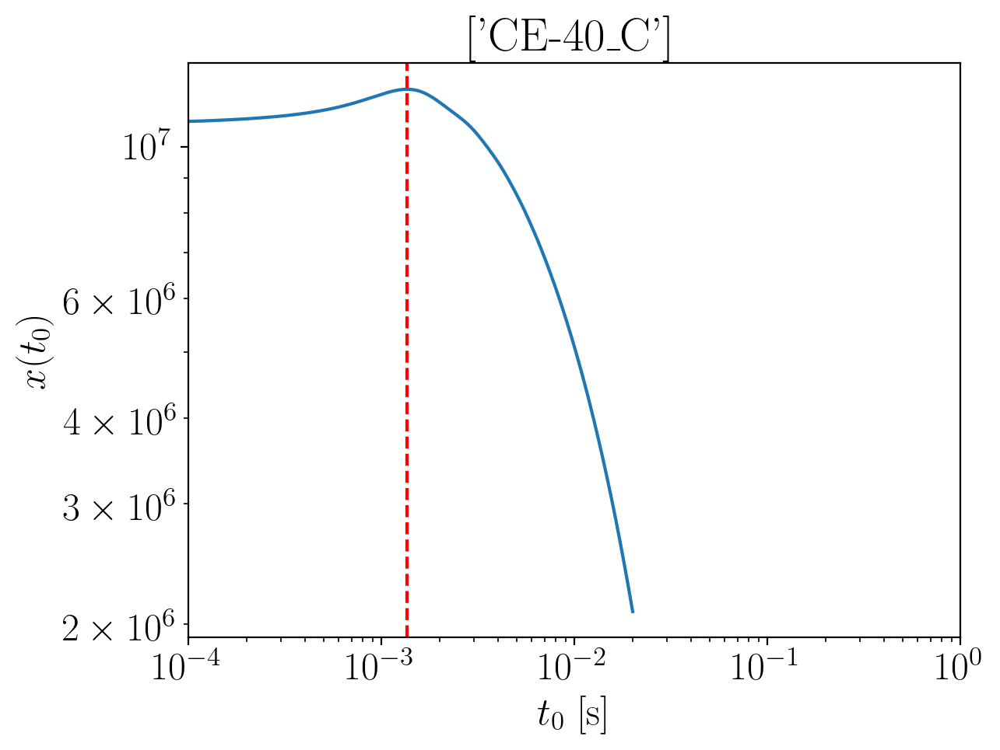

2024-01-15 15:04:57,034 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:57,042 - Network - INFO : PSDs loaded.
2024-01-15 15:04:57,044 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:57,051 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:57,058 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.2919428732122746
Inner product:
0.9999404774208267


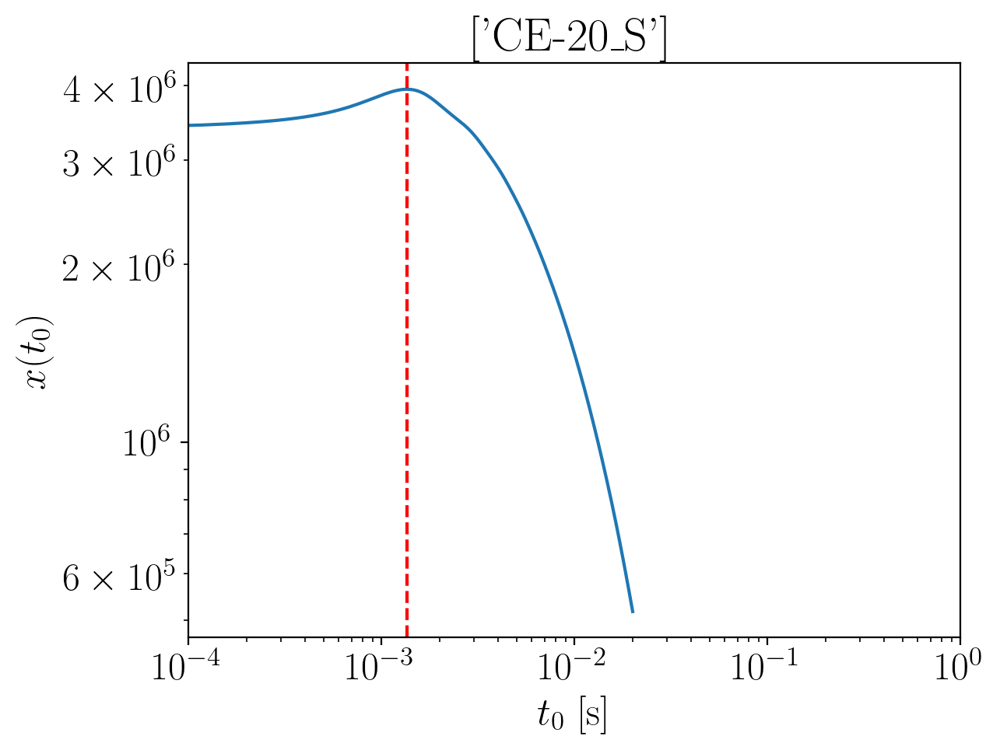

2024-01-15 15:04:58,222 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:58,229 - Network - INFO : PSDs loaded.
2024-01-15 15:04:58,231 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:58,238 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:58,245 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.2927064939656514
Inner product:
0.999921144051433


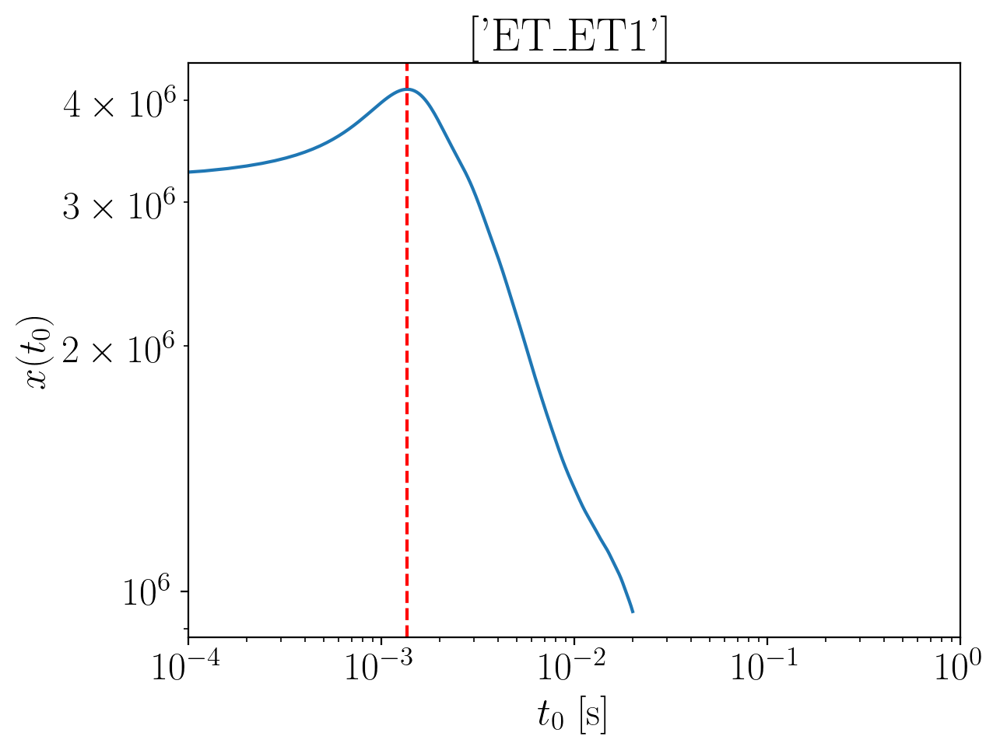

2024-01-15 15:04:59,653 - Network - INFO : Polarizations calculated.
2024-01-15 15:04:59,666 - Network - INFO : PSDs loaded.
2024-01-15 15:04:59,668 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:04:59,675 - Network - INFO : Detector responses calculated.
2024-01-15 15:04:59,682 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.287459557311687
Inner product:
0.999864567283535


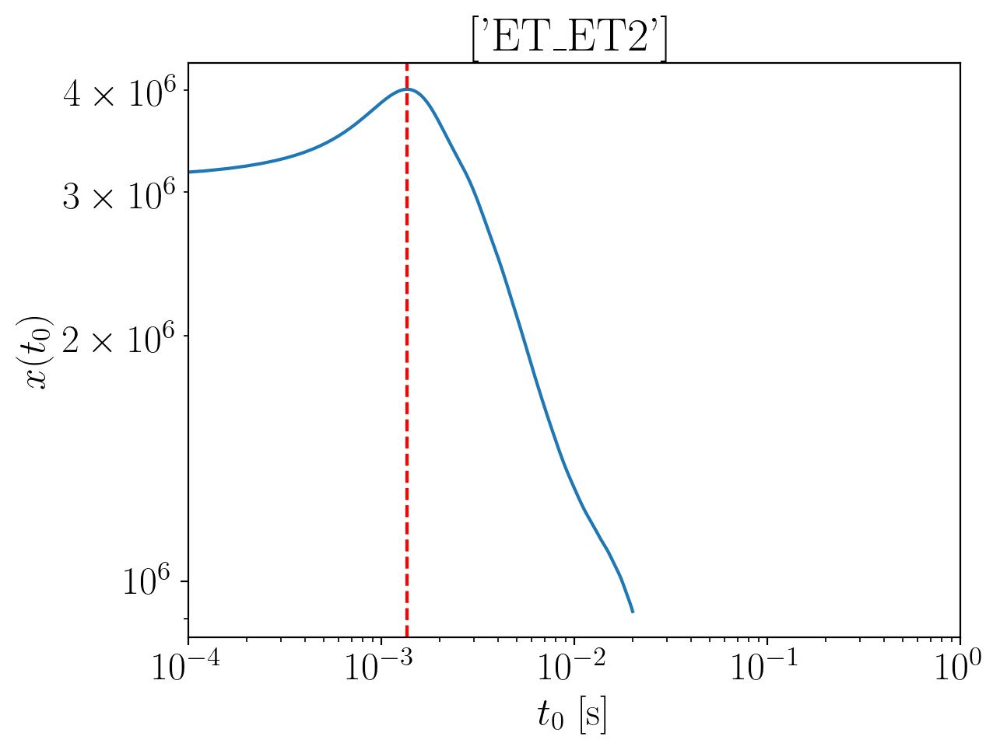

2024-01-15 15:05:01,166 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:01,179 - Network - INFO : PSDs loaded.
2024-01-15 15:05:01,181 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:01,188 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:01,195 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.287459557311687
Inner product:
0.9998645672835355


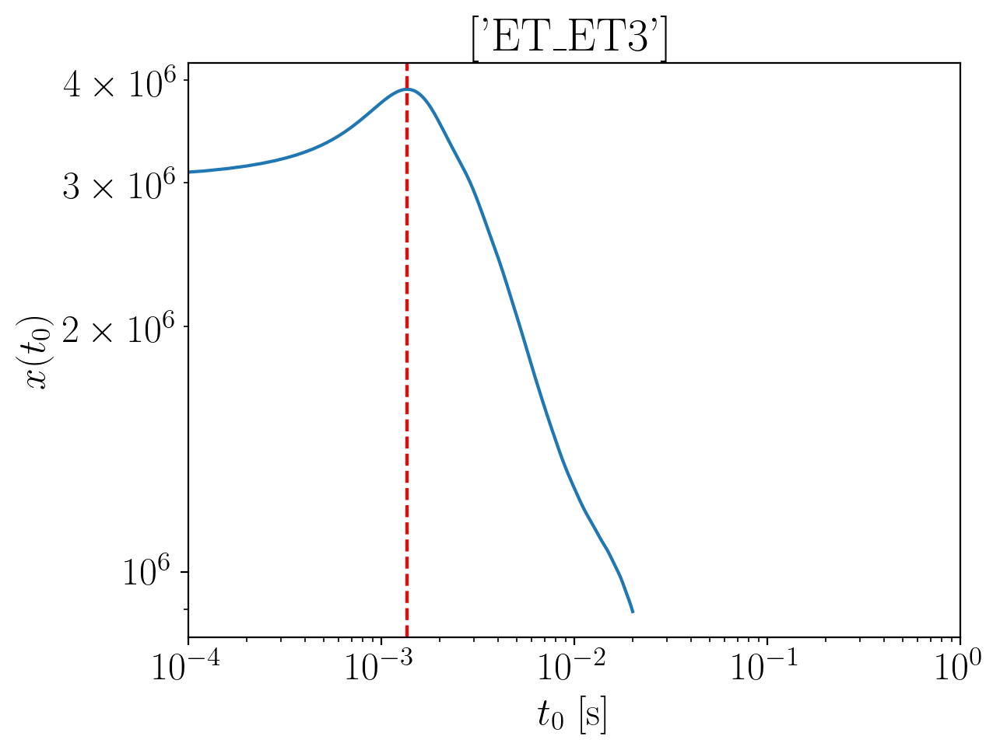

2024-01-15 15:05:02,607 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:02,621 - Network - INFO : PSDs loaded.
2024-01-15 15:05:02,623 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:02,630 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:02,637 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:02,661 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:02,661 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:05:02,666 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.2874595573116867
Inner product:
0.9998645672835353


2024-01-15 15:05:08,052 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:05:08,097 - Network - INFO : PSDs loaded.
2024-01-15 15:05:08,103 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:08,125 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:08,126 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:05:08,127 - Network - INFO :    CE-40_C
2024-01-15 15:05:11,759 - Network - INFO :    CE-20_S
2024-01-15 15:05:15,402 - Network - INFO :    ET_ET1
2024-01-15 15:05:19,057 - Network - INFO :    ET_ET2
2024-01-15 15:05:22,701 - Network - INFO :    ET_ET3
2024-01-15 15:05:26,323 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:05:26,331 - Network - INFO : SNRs calculated.
2024-01-15 15:05:26,332 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:05:26,332 - Network - INFO :    CE-40_C
2024-01-15 15:05:26,427 - Network - INFO :

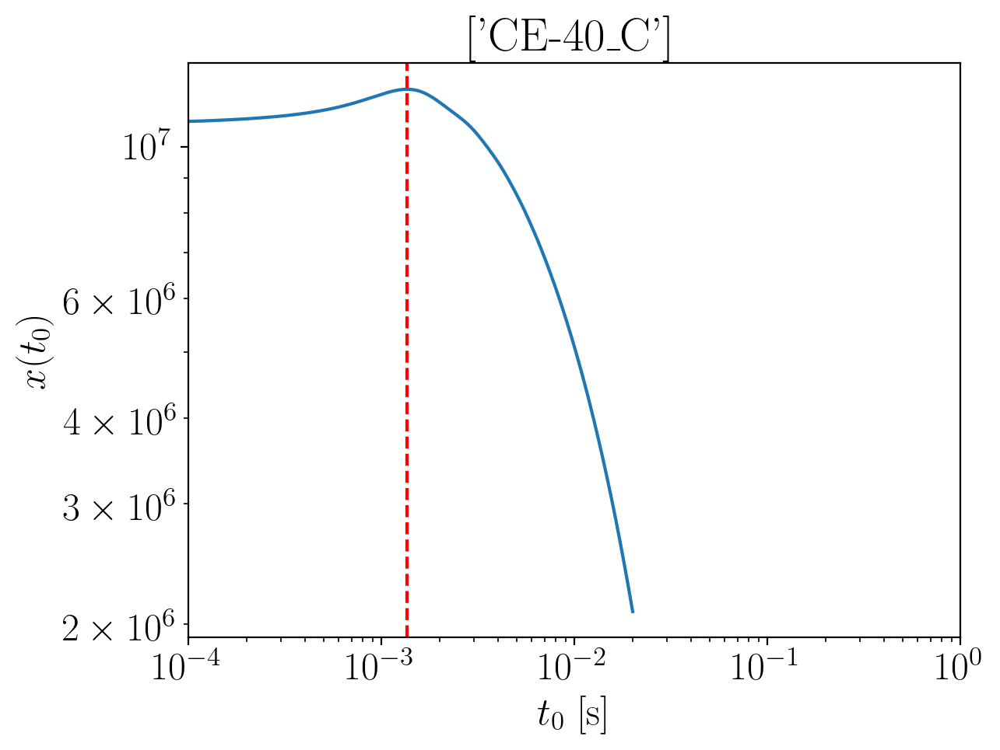

2024-01-15 15:05:28,210 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:28,218 - Network - INFO : PSDs loaded.
2024-01-15 15:05:28,220 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:28,227 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:28,233 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.281644668667436
Inner product:
0.9999404774208267


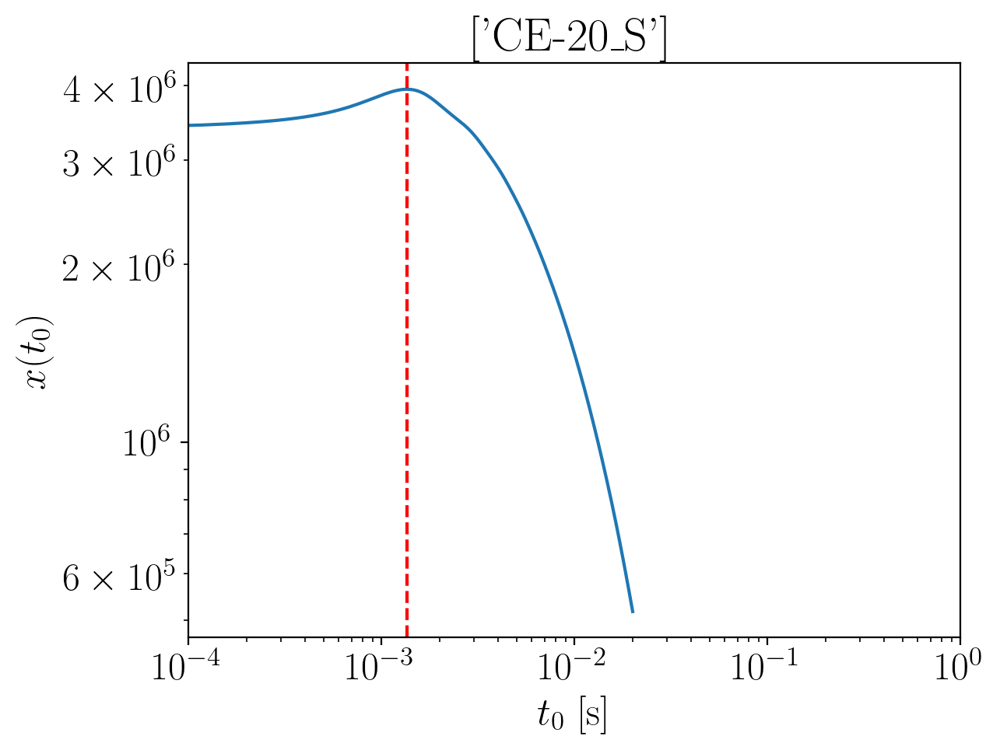

2024-01-15 15:05:29,391 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:29,398 - Network - INFO : PSDs loaded.
2024-01-15 15:05:29,400 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:29,407 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:29,417 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.282408289420813
Inner product:
0.999921144051433


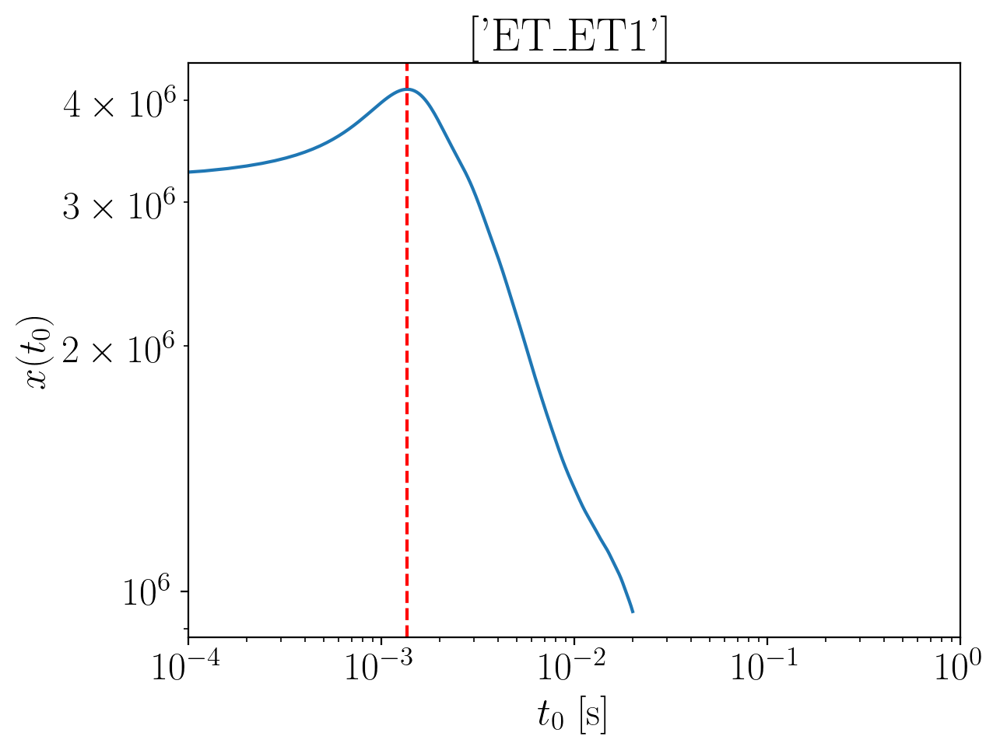

2024-01-15 15:05:30,830 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:30,843 - Network - INFO : PSDs loaded.
2024-01-15 15:05:30,845 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:30,852 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:30,859 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.277161352766848
Inner product:
0.999864567283535


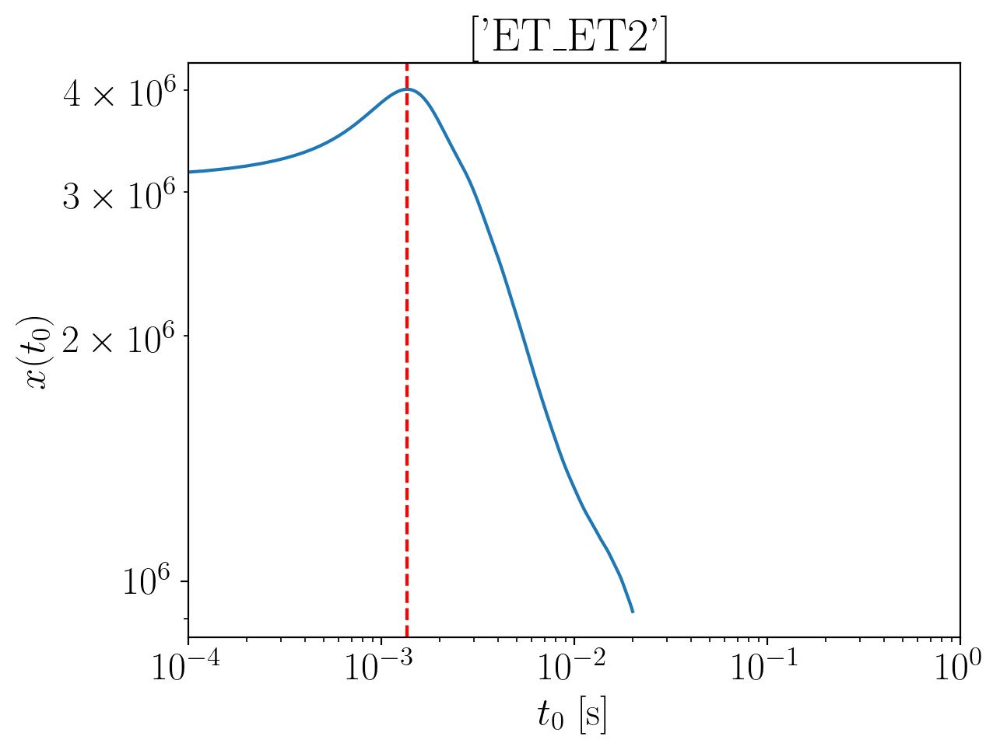

2024-01-15 15:05:32,355 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:32,369 - Network - INFO : PSDs loaded.
2024-01-15 15:05:32,371 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:32,378 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:32,386 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.277161352766848
Inner product:
0.9998645672835355


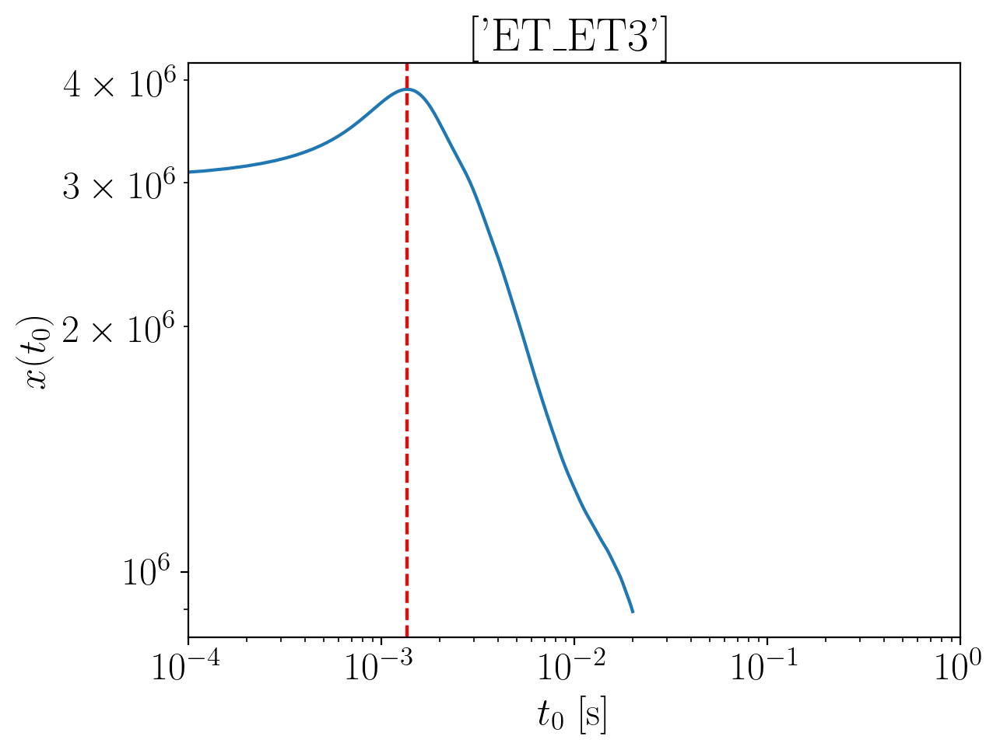

2024-01-15 15:05:33,796 - Network - INFO : Polarizations calculated.
2024-01-15 15:05:33,810 - Network - INFO : PSDs loaded.
2024-01-15 15:05:33,812 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:05:33,819 - Network - INFO : Detector responses calculated.
2024-01-15 15:05:33,825 - Network - INFO : Polarizations calculated.


time shift: 0.00136
phase shift: -2.277161352766848
Inner product:
0.9998645672835353


In [46]:
fRef_range = np.linspace(0., 10.0, 11)

cv_bias_dicts = []
err_dicts = []
h_ap_list = []
h_tr_list = []

for fRef in fRef_range:
    inj_params_fRef = inj_params.copy()
    inj_params_fRef['fRef'] = fRef
    
    net_ap = network.Network(network_spec=network_spec)

    approximant = 'IMRPhenomD'
    wf_model_name = 'lal_bbh'
    # pass the chosen waveform to the network for initialization
    net_ap.set_wf_vars(wf_model_name=wf_model_name, wf_other_var_dic = {'approximant': approximant, 'fRef':fRef})


    use_rot = 0

    net_ap.set_net_vars(
        f=f, inj_params=inj_params_fRef,
        deriv_symbs_string=deriv_symbs_string,
        use_rot=use_rot
        )
    net_ap.calc_wf_polarizations()
    net_ap.calc_wf_polarizations_derivs_num(step=1e-9, method='central', order=2, n=1)
    net_ap.setup_ant_pat_lpf_psds()
    net_ap.calc_det_responses()
    net_ap.calc_det_responses_derivs_num(step=1e-9, method='central', order=2, n=1)
    net_ap.calc_snrs()
    net_ap.calc_errors()


    net_tr = network.Network(network_spec=network_spec)

    approximant = 'IMRPhenomXAS'
    wf_model_name = 'lal_bbh'
    # pass the chosen waveform to the network for initialization
    net_tr.set_wf_vars(wf_model_name=wf_model_name, wf_other_var_dic = {'approximant': approximant, 'fRef':fRef})

    net_tr.set_net_vars(
        f=f, inj_params=inj_params_fRef,
        deriv_symbs_string=deriv_symbs_string,
        use_rot=use_rot
        )
    net_tr.calc_wf_polarizations()
    net_tr.setup_ant_pat_lpf_psds()
    net_tr.calc_det_responses()
    net_tr.calc_snrs()


    overlap_vecs_network = np.zeros((len(net_ap.detectors), len(net_ap.deriv_variables)))

    time_arr_d = np.linspace(0.0, 0.02, 501)

    for d in range(len(net_ap.detectors)):

        ## set up initial waveforms
        h1 = net_tr.detectors[d].hf
        h2 = net_ap.detectors[d].hf
        f = net_ap.detectors[d].f
        Sn = net_ap.detectors[d].psd
        network_spec_d = [net_ap.detectors[d].det_key]

        x_t0_re_d = np.zeros(len(time_arr_d))
        x_t0_im_d = np.zeros(len(time_arr_d))

        for i in range(len(time_arr_d)):
            t0 = time_arr_d[i]
            x_t0_d = 4*(integrate.simpson(h1 * np.conjugate(h2) * np.exp(2*np.pi*1j*f*t0)/ Sn, x=f))
            x_t0_re_d[i] = np.real(x_t0_d)
            x_t0_im_d[i] = np.imag(x_t0_d)

        max_idx = np.argmax(x_t0_re_d**2 + x_t0_im_d**2)
        time_shift_d = time_arr_d[max_idx]
        phase_shift_d = (np.angle(x_t0_re_d + 1j*x_t0_im_d))[max_idx]

 
        inj_params_opt_d = inj_params_fRef.copy()
        inj_params_opt_d['tc'] = time_shift_d # should be positive when shifting XAS to maximize overlap
        inj_params_opt_d['phic'] = phase_shift_d  # should be positive when shifting XAS to maximize overlap

        plt.title(network_spec_d)
        plt.plot(time_arr_d, x_t0_re_d**2 + x_t0_im_d**2)
        plt.axvline(x=time_shift_d, ls='--', c='r')
        plt.xlabel('$t_0$ [s]')
        plt.ylabel("$x(t_0)$")
        plt.loglog()
        plt.xlim(1e-4, 1e0)
        plt.show()
        print("time shift:", time_shift_d)
        print("phase shift:", phase_shift_d)

        net_tr_opt_d = network.Network(network_spec=network_spec_d)
        net_tr_opt_d.set_wf_vars(wf_model_name='lal_bbh', wf_other_var_dic = {'approximant': 'IMRPhenomXAS', 'fRef':fRef})
        net_tr_opt_d.set_net_vars(
            f=f, inj_params=inj_params_opt_d,
            deriv_symbs_string=deriv_symbs_string,
            use_rot=use_rot
            )
        net_tr_opt_d.calc_wf_polarizations()
        net_tr_opt_d.setup_ant_pat_lpf_psds()
        net_tr_opt_d.calc_det_responses()
        net_tr_opt_d.calc_wf_polarizations()

        if d==0:
            h_ap_list.append(net_ap.detectors[d].hf)
            h_tr_list.append(net_tr_opt_d.detectors[0].hf)

        print("Inner product:")
        print(inner_prod_simps_normed(net_ap.detectors[d].hf, net_tr_opt_d.detectors[0].hf, net_ap.detectors[d].psd, net_ap.detectors[d].f))
    
        ## Compute CV overlap vector for this detector
        delta_hf = net_tr_opt_d.detectors[0].hf - net_ap.detectors[d].hf
        overlap_vecs_network[d] = cutler_vallisneri_overlap_vec(net_ap.detectors[d].del_hf, delta_hf, net_ap.detectors[d].psd, net_ap.detectors[d].f)

    cv_bias_opt = np.matmul(net_ap.cov, np.sum(overlap_vecs_network, axis=0))
    cv_bias_opt = np.array(cv_bias_opt.tolist()[0])

    cv_bias_opt_dict = {}

    for i, param in enumerate(net_ap.deriv_variables):
        cv_bias_opt_dict[param] = cv_bias_opt[i]

    cv_bias_dicts.append(cv_bias_opt_dict)
    err_dicts.append(net_ap.errs)


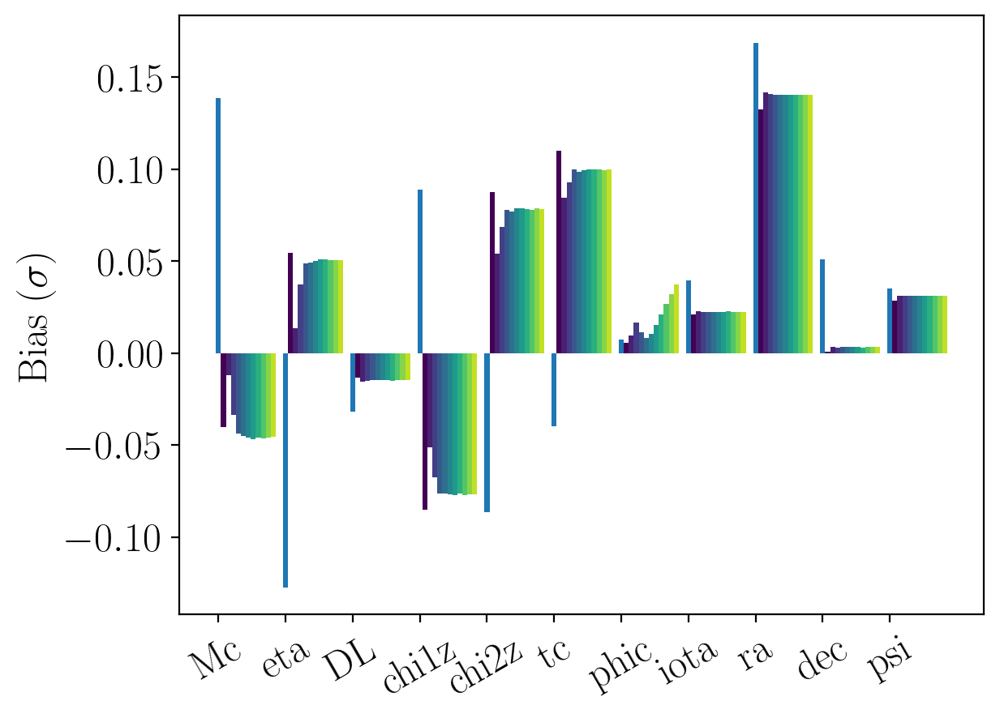

Mc, 1: 0.139 sigma

eta, 1: -0.127 sigma

DL, 1: -0.032 sigma

chi1z, 1: 0.089 sigma

chi2z, 1: -0.087 sigma

tc, 1: -0.040 sigma

phic, 1: 0.007 sigma

iota, 1: 0.040 sigma

ra, 1: 0.169 sigma

dec, 1: 0.051 sigma

psi, 1: 0.035 sigma



In [47]:
x = np.linspace(0, len(cv_bias_opt_sigma_fiducial), len(cv_bias_opt_sigma_fiducial))

width = 0.9/len(fRef_range)
plt.bar(x, cv_bias_opt_sigma_fiducial, width=width, label='Fiducial')

for k in range(len(cv_bias_dicts)):
    cv_bias_dict = cv_bias_dicts[k]
    err_dict = err_dicts[k]

    cv_bias_opt_sigma = np.zeros(len(net_ap.deriv_variables))
    for i, param in enumerate(net_ap.deriv_variables):
        cv_bias_opt_sigma[i] = cv_bias_dict[param]/err_dict[param]


    plt.bar(x+ (k+1)*width, cv_bias_opt_sigma, width=width, label=f'fRef={fRef_range[k]}', color=mpl.colormaps['viridis'](k/len(cv_bias_dicts)))


plt.xticks(x, deriv_variables, rotation=30)
plt.ylabel('Bias ($\sigma$)')
# plt.legend()
plt.show()

for i, param in enumerate(deriv_variables):
    print(f"{param}, 1: {cv_bias_opt_sigma_fiducial[i]:.3f} sigma")
    print()

In [49]:
f_low_index = np.where(fRef_range==f_low)[0][0]
bias_f_low = cv_bias_dicts[f_low_index]

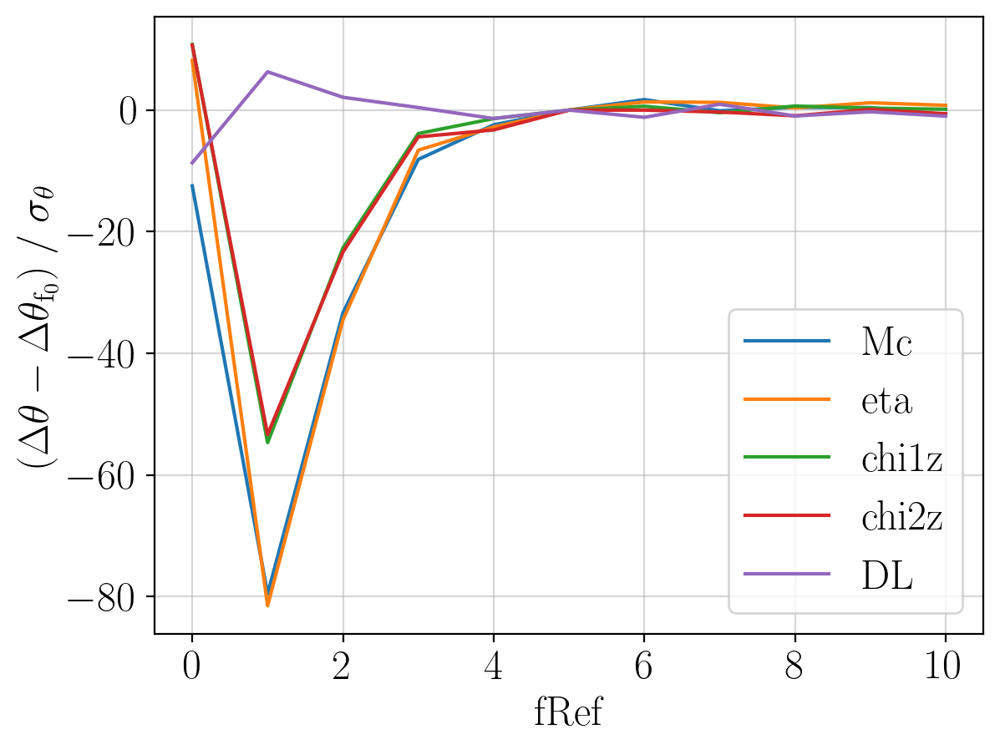

In [52]:
params = ['Mc', 'eta', 'chi1z', 'chi2z', 'DL']

for param in params:
    param_biases = np.zeros(len(fRef_range))
    cv_bias_perc = np.zeros(len(fRef_range))

    for k in range(len(fRef_range)):
        cv_bias = cv_bias_dicts[k][param] - bias_f_low[param]
        cv_bias_perc[k] = 100* (cv_bias_dicts[k][param] - bias_f_low[param])/ bias_f_low[param]
        
        err = err_dicts[k][param]
        param_biases[k] = cv_bias/err
    # plt.plot(fRef_range, param_biases, label=param)
    plt.plot(fRef_range, cv_bias_perc, label=param)

plt.grid(alpha=0.5)
plt.xlabel('fRef')
plt.ylabel('$(\Delta \\theta  - \Delta \\theta_{\\rm f_0} )\; / \;\sigma_\\theta$')
plt.legend()
plt.show()


/opt/anaconda3/envs/gwbench_dev/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1335: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)
2024-01-15 14:11:46,081 - matplotlib.legend - WARNING : No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


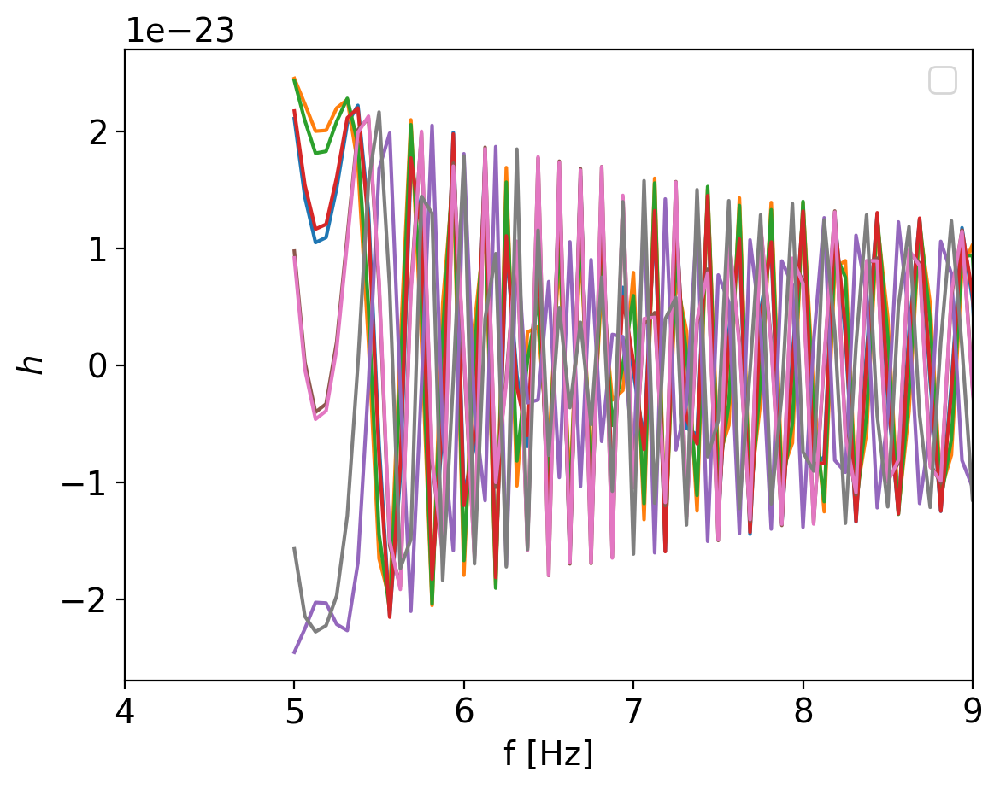

In [34]:

for i in range(len(h_ap_list)):
    plt.plot(f[:-1], h_ap_list[i])

plt.xlabel('f [Hz]')
plt.ylabel('$h$')
plt.legend()
plt.xlim(4.0, 9.0)
plt.show()

# Aggregate differences in bias with choice of fRef

2024-01-15 15:41:40,366 - Network - INFO : Polarizations calculated.
2024-01-15 15:41:40,367 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:41:40,374 - Network - INFO : Polarizations calculated.


[52 93 15 72 61 21 83 87 75 75]


2024-01-15 15:41:45,809 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:41:45,859 - Network - INFO : PSDs loaded.
2024-01-15 15:41:45,865 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:41:45,882 - Network - INFO : Detector responses calculated.
2024-01-15 15:41:45,882 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:41:45,883 - Network - INFO :    CE-40_C
2024-01-15 15:41:49,555 - Network - INFO :    CE-20_S
2024-01-15 15:41:53,209 - Network - INFO :    ET_ET1
2024-01-15 15:41:56,818 - Network - INFO :    ET_ET2
2024-01-15 15:42:00,449 - Network - INFO :    ET_ET3
2024-01-15 15:42:04,007 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:42:04,014 - Network - INFO : SNRs calculated.
2024-01-15 15:42:04,014 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:42:04,015 - Network - INFO :    CE-40_C
2024-01-15 15:42:04,113 - Network - INFO :

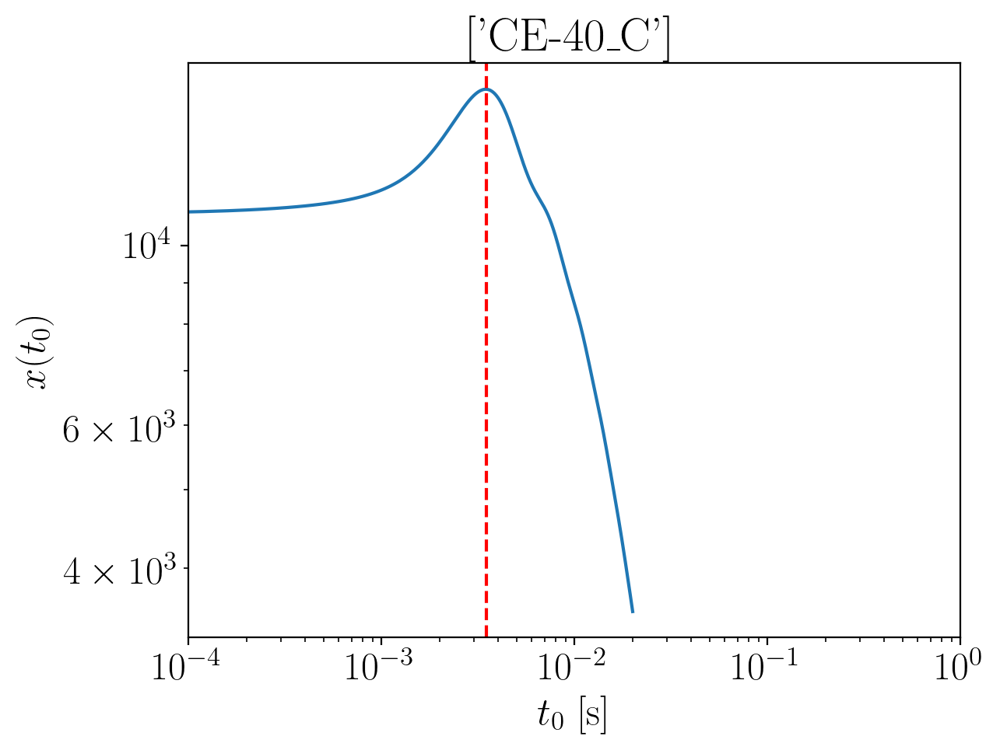

2024-01-15 15:42:05,997 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:06,004 - Network - INFO : PSDs loaded.
2024-01-15 15:42:06,007 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:06,016 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:06,023 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.2527730711974563
Inner product:
0.9998526214640118


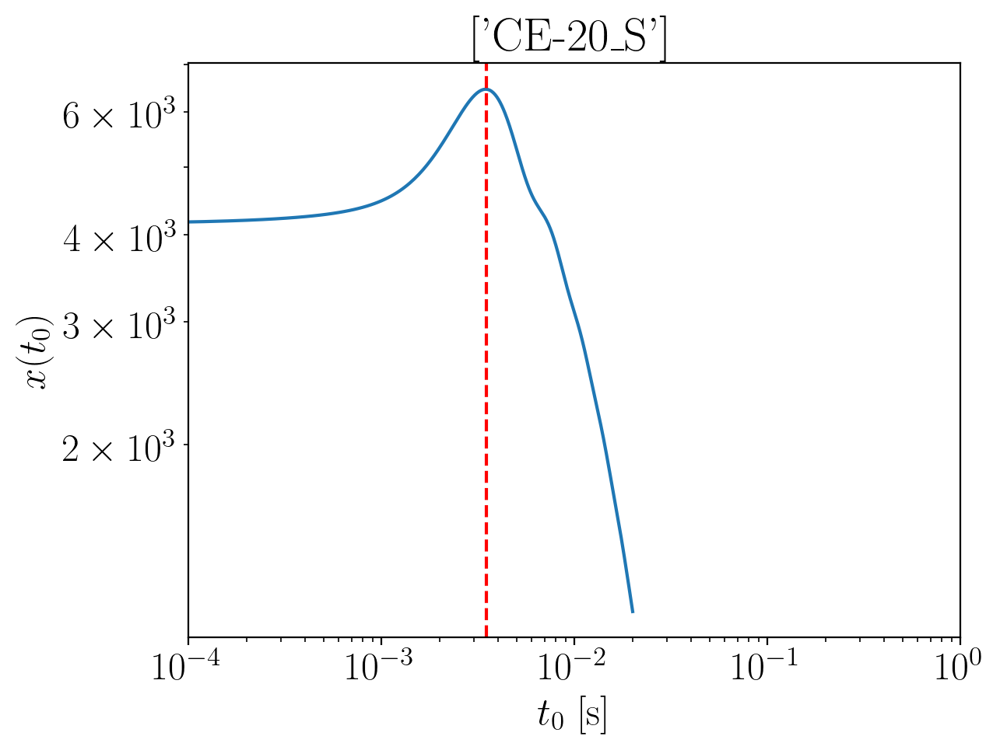

2024-01-15 15:42:07,319 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:07,326 - Network - INFO : PSDs loaded.
2024-01-15 15:42:07,336 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:07,344 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:07,350 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.253230710867726
Inner product:
0.999804794399151


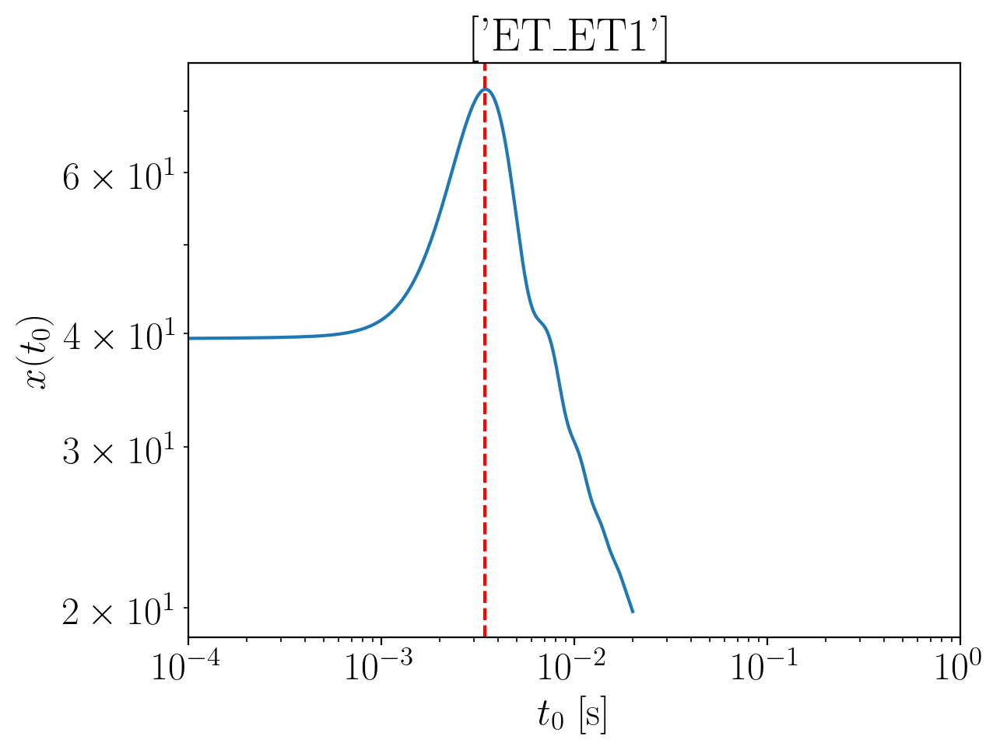

2024-01-15 15:42:08,848 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:08,864 - Network - INFO : PSDs loaded.
2024-01-15 15:42:08,866 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:08,872 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:08,878 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2634708621273187
Inner product:
0.9997116571025946


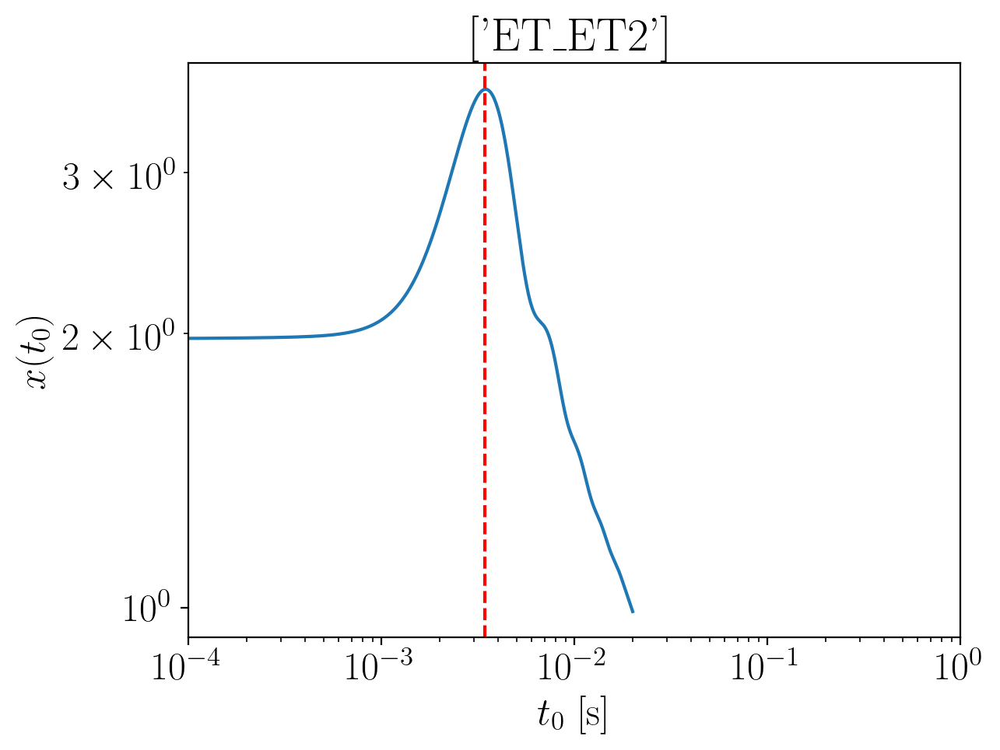

2024-01-15 15:42:10,574 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:10,589 - Network - INFO : PSDs loaded.
2024-01-15 15:42:10,592 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:10,599 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:10,604 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2634708621273187
Inner product:
0.9997116571025949


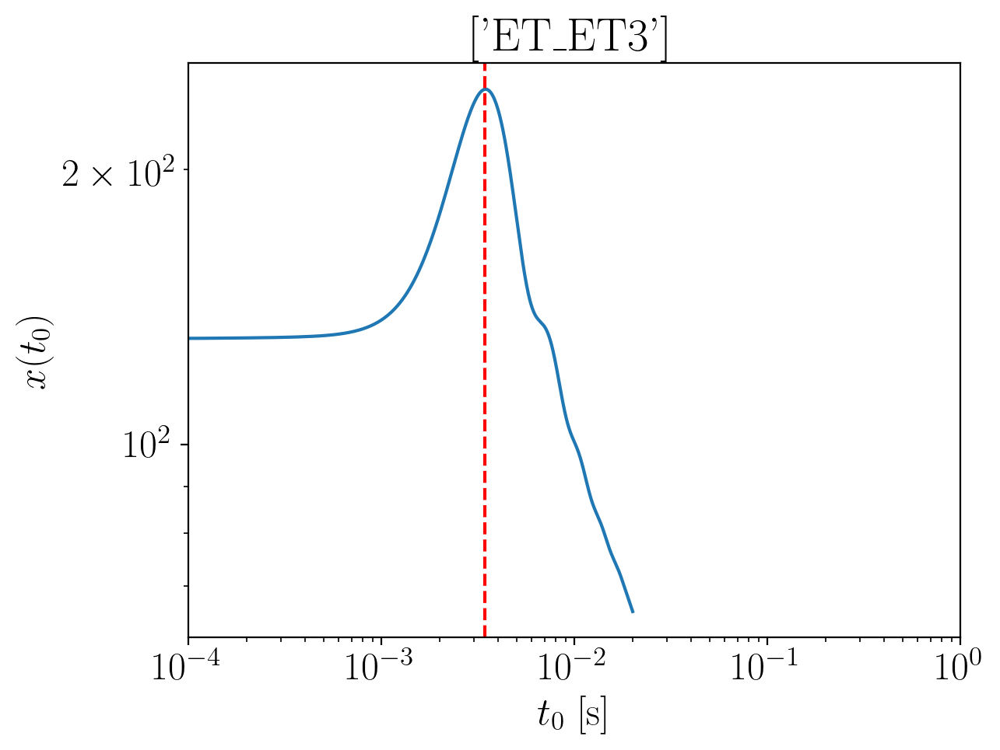

2024-01-15 15:42:12,120 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:12,133 - Network - INFO : PSDs loaded.
2024-01-15 15:42:12,135 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:12,142 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:12,147 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:12,175 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:12,176 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:42:12,182 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2634708621273187
Inner product:
0.9997116571025947


2024-01-15 15:42:17,924 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:42:17,976 - Network - INFO : PSDs loaded.
2024-01-15 15:42:17,983 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:18,005 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:18,005 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:42:18,006 - Network - INFO :    CE-40_C
2024-01-15 15:42:21,848 - Network - INFO :    CE-20_S
2024-01-15 15:42:25,482 - Network - INFO :    ET_ET1
2024-01-15 15:42:29,110 - Network - INFO :    ET_ET2
2024-01-15 15:42:32,734 - Network - INFO :    ET_ET3
2024-01-15 15:42:36,371 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:42:36,378 - Network - INFO : SNRs calculated.
2024-01-15 15:42:36,378 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:42:36,379 - Network - INFO :    CE-40_C
2024-01-15 15:42:36,474 - Network - INFO :

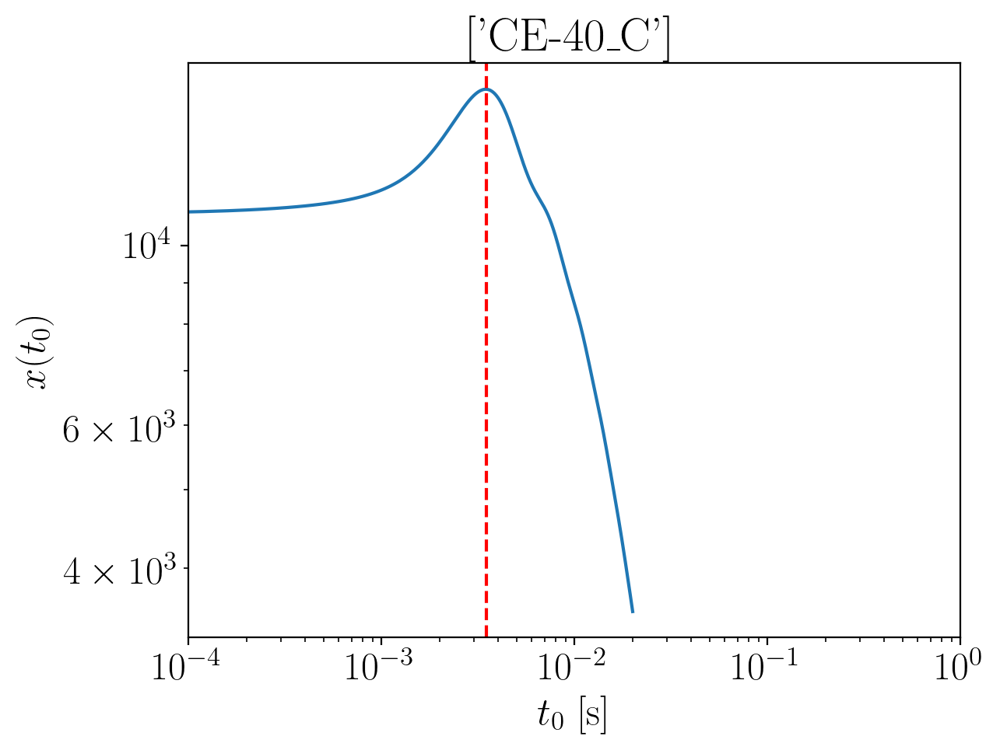

2024-01-15 15:42:38,241 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:38,263 - Network - INFO : PSDs loaded.
2024-01-15 15:42:38,271 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:38,284 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:38,297 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.3442066876685126
Inner product:
0.9998526214640117


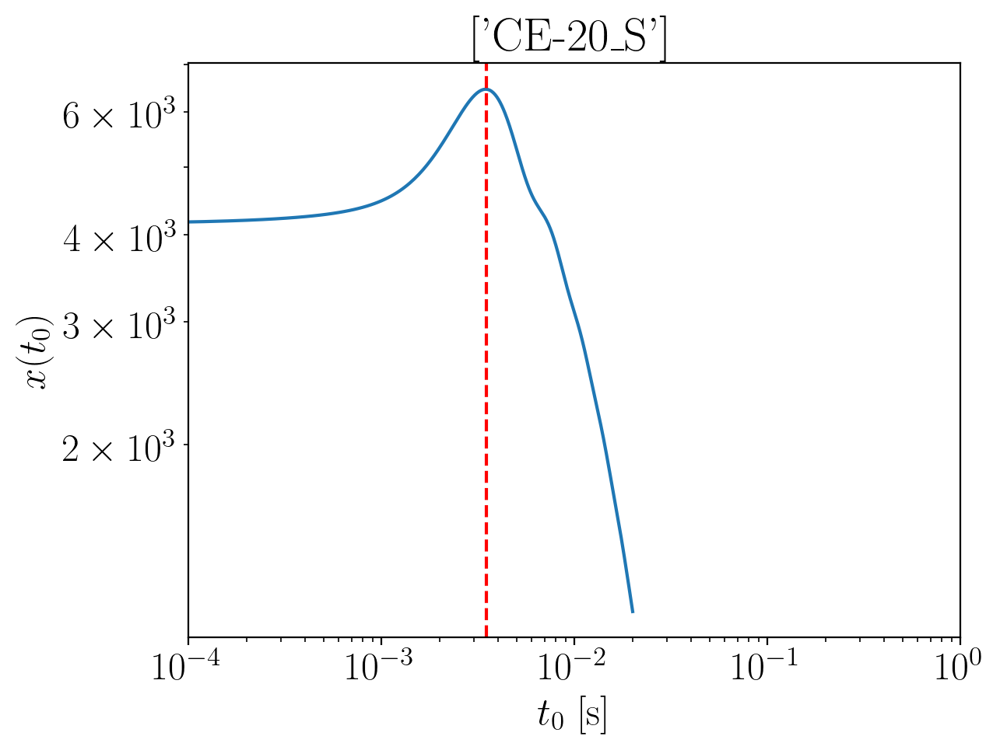

2024-01-15 15:42:39,461 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:39,468 - Network - INFO : PSDs loaded.
2024-01-15 15:42:39,470 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:39,477 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:39,483 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.344664327338781
Inner product:
0.9998047943991513


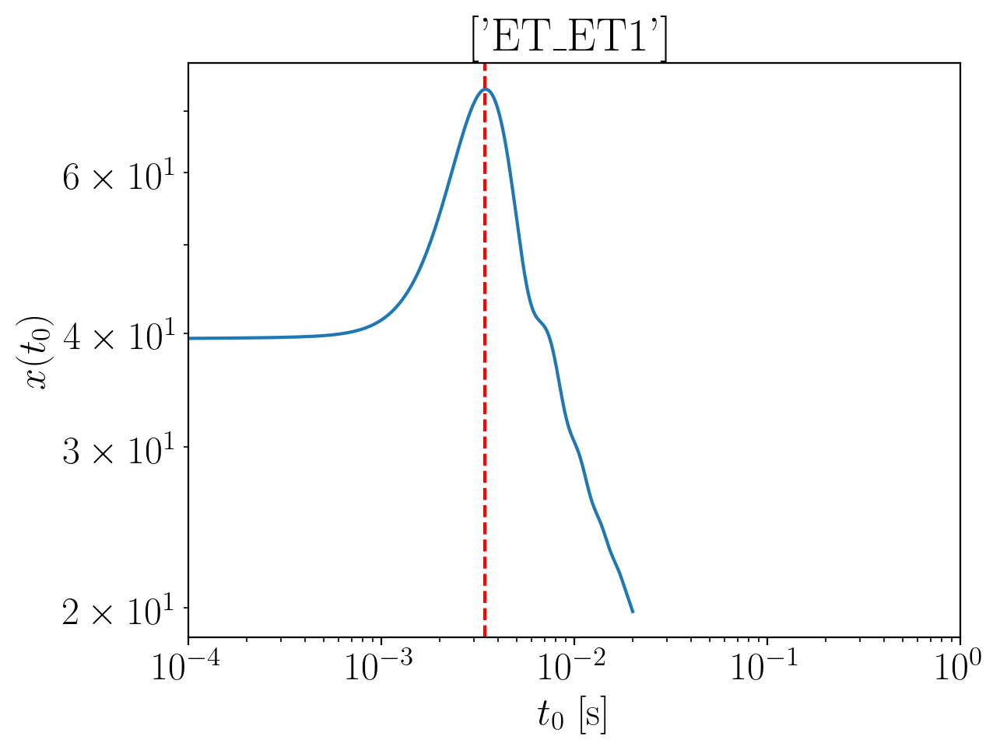

2024-01-15 15:42:40,926 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:40,939 - Network - INFO : PSDs loaded.
2024-01-15 15:42:40,941 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:40,947 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:40,952 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.353487767648796
Inner product:
0.9997116571025946


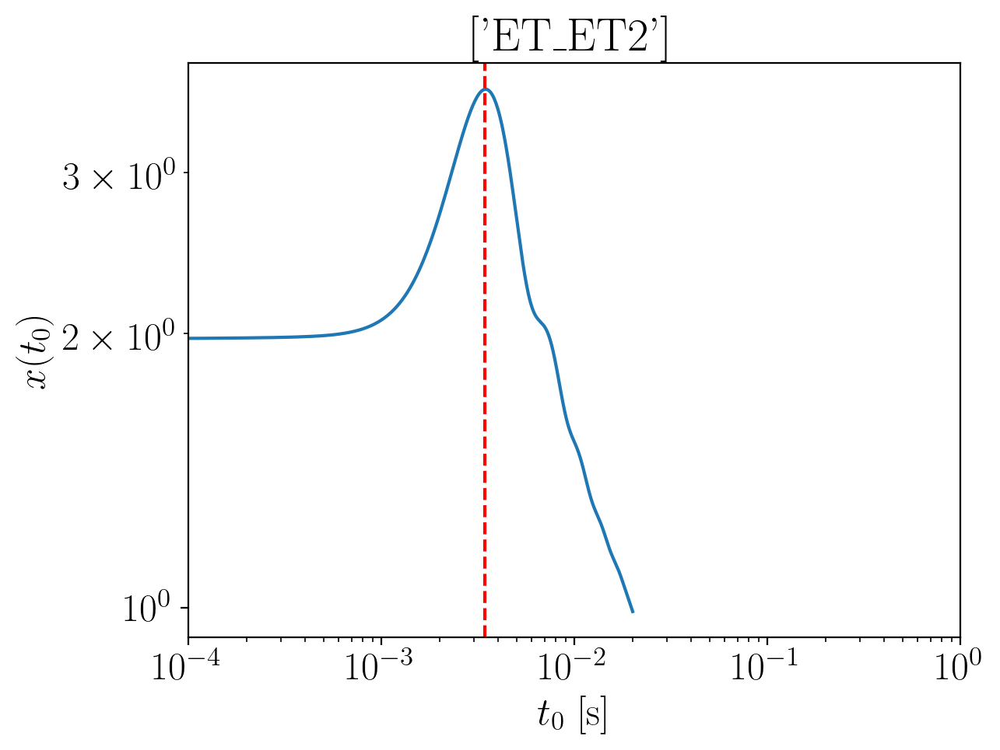

2024-01-15 15:42:42,362 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:42,376 - Network - INFO : PSDs loaded.
2024-01-15 15:42:42,378 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:42,383 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:42,389 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.353487767648796
Inner product:
0.9997116571025947


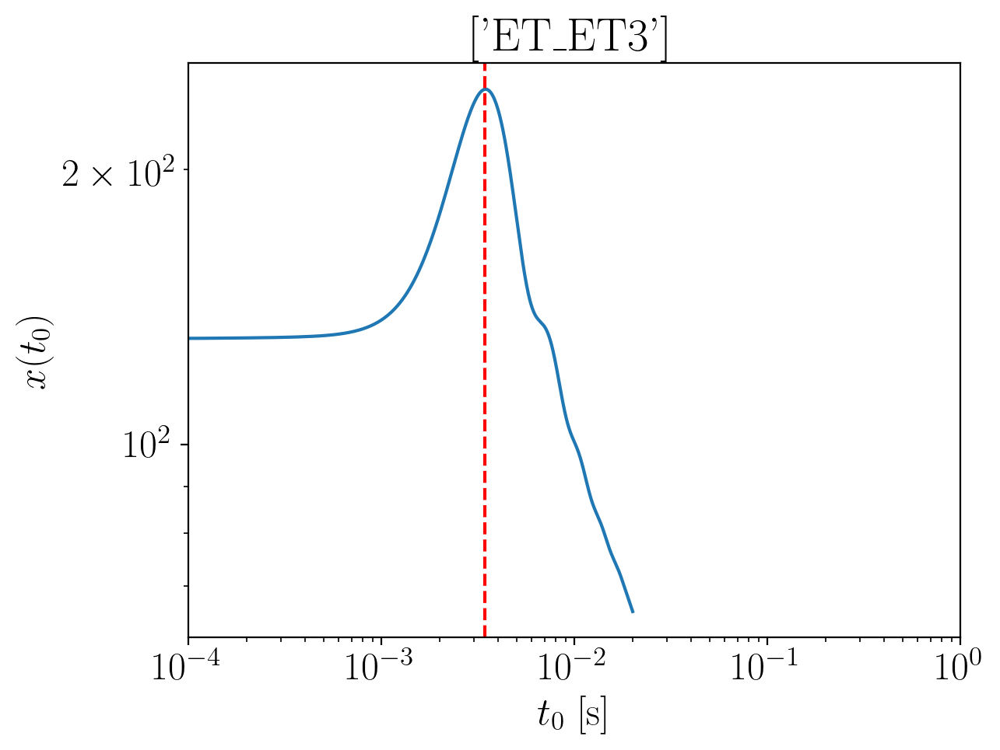

2024-01-15 15:42:43,791 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:43,805 - Network - INFO : PSDs loaded.
2024-01-15 15:42:43,807 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:43,812 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:43,818 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:43,840 - Network - INFO : Polarizations calculated.
2024-01-15 15:42:43,840 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:42:43,845 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.353487767648796
Inner product:
0.9997116571025947


2024-01-15 15:42:49,244 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:42:49,417 - Network - INFO : PSDs loaded.
2024-01-15 15:42:49,423 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:42:49,441 - Network - INFO : Detector responses calculated.
2024-01-15 15:42:49,442 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:42:49,442 - Network - INFO :    CE-40_C
2024-01-15 15:42:53,070 - Network - INFO :    CE-20_S
2024-01-15 15:42:56,677 - Network - INFO :    ET_ET1
2024-01-15 15:43:00,252 - Network - INFO :    ET_ET2
2024-01-15 15:43:03,820 - Network - INFO :    ET_ET3
2024-01-15 15:43:07,481 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:43:07,488 - Network - INFO : SNRs calculated.
2024-01-15 15:43:07,488 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:43:07,489 - Network - INFO :    CE-40_C
2024-01-15 15:43:07,582 - Network - INFO :

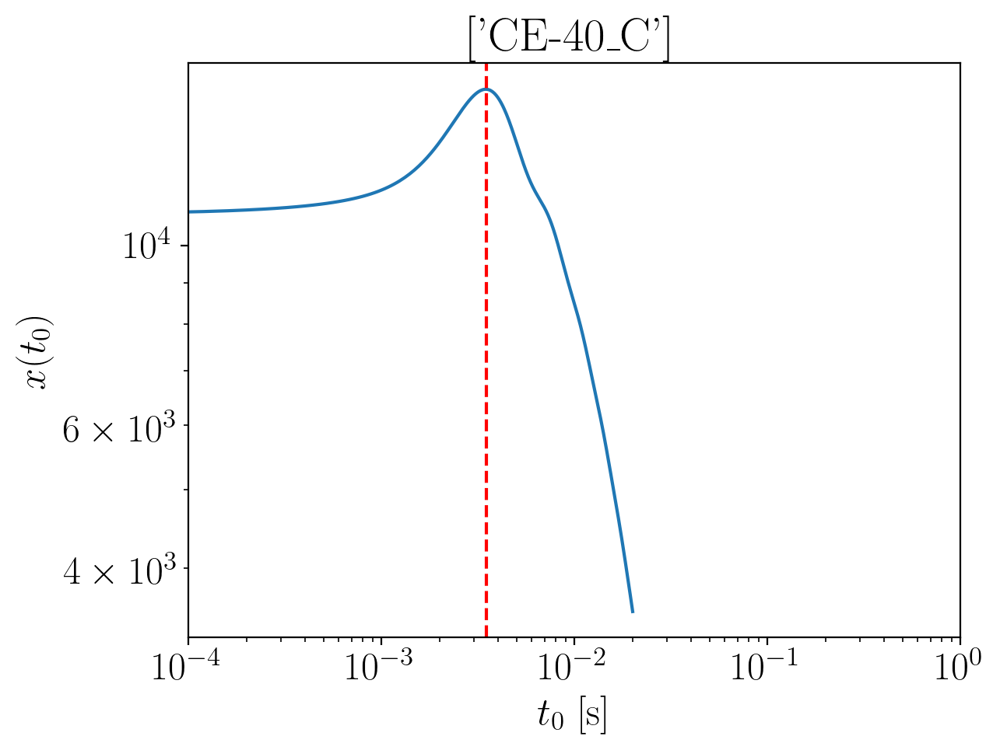

2024-01-15 15:43:09,350 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:09,357 - Network - INFO : PSDs loaded.
2024-01-15 15:43:09,359 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:09,365 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:09,370 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.3222048835268345
Inner product:
0.9998526214640118


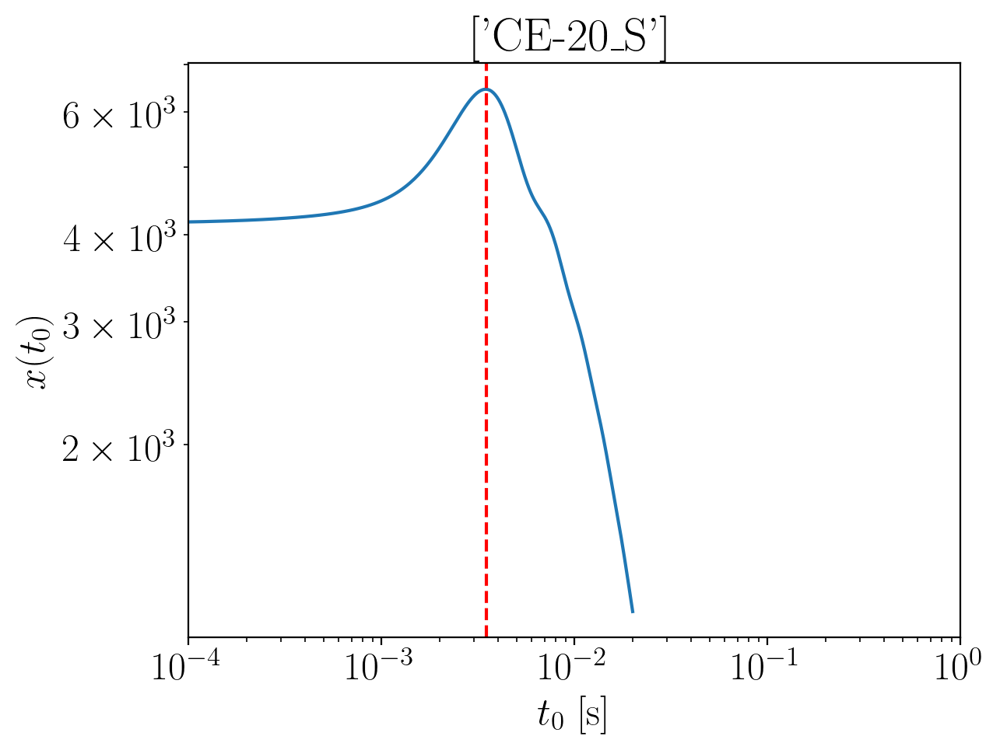

2024-01-15 15:43:10,496 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:10,502 - Network - INFO : PSDs loaded.
2024-01-15 15:43:10,504 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:10,510 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:10,515 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.322662523197106
Inner product:
0.9998047943991513


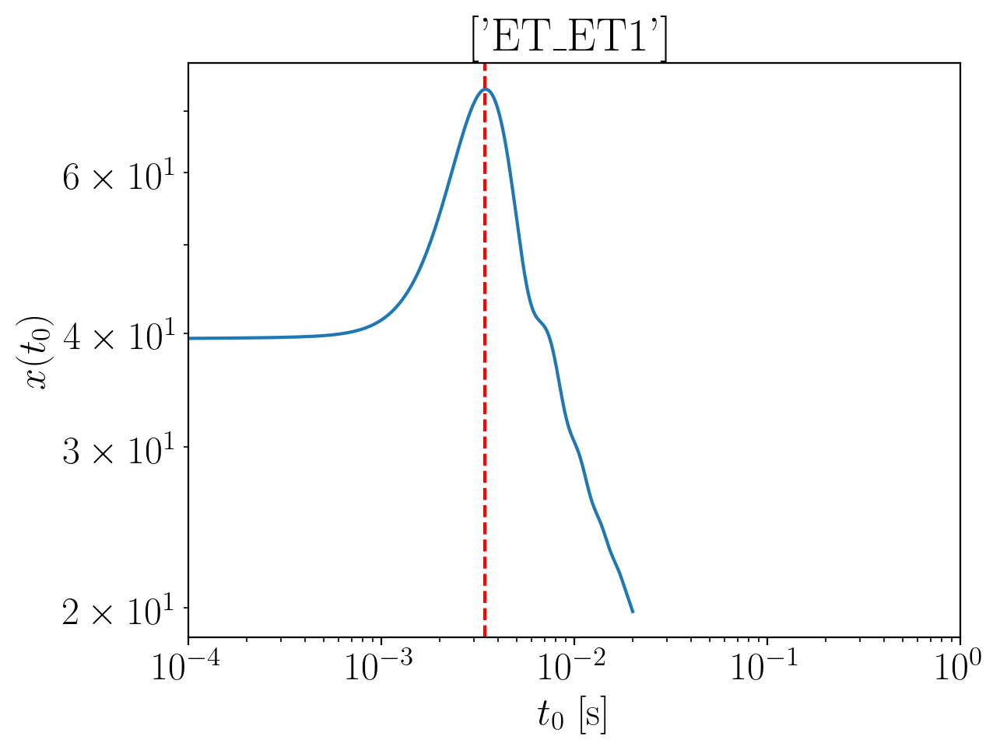

2024-01-15 15:43:11,926 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:11,939 - Network - INFO : PSDs loaded.
2024-01-15 15:43:11,941 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:11,947 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:11,953 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.33148596350714
Inner product:
0.9997116571025946


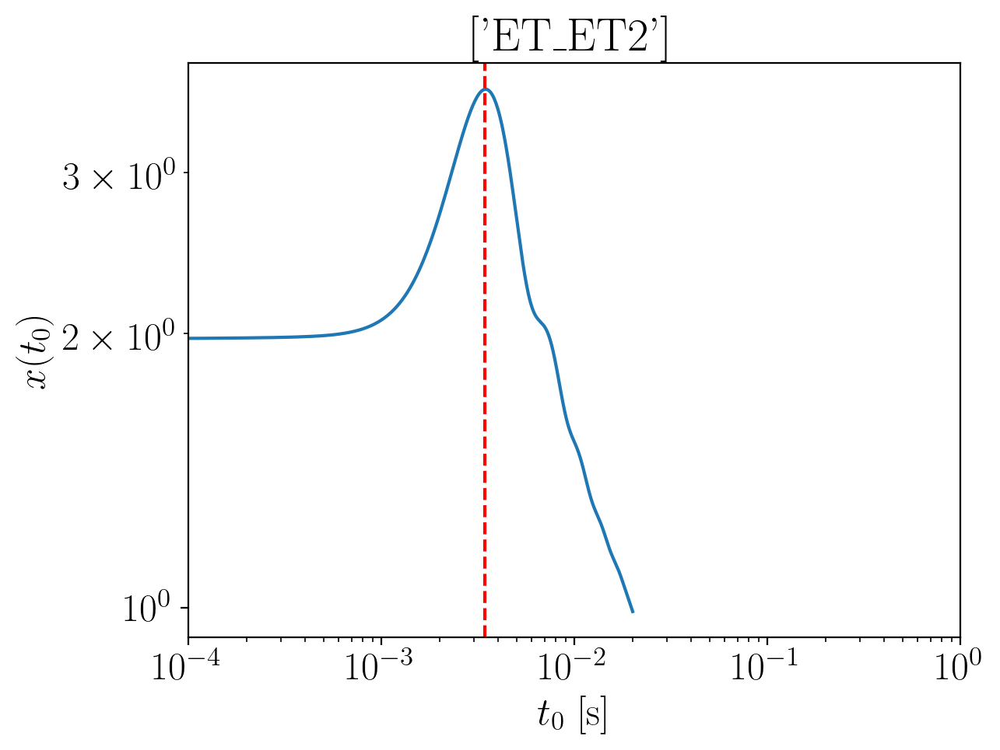

2024-01-15 15:43:13,363 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:13,375 - Network - INFO : PSDs loaded.
2024-01-15 15:43:13,378 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:13,383 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:13,389 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.33148596350714
Inner product:
0.9997116571025945


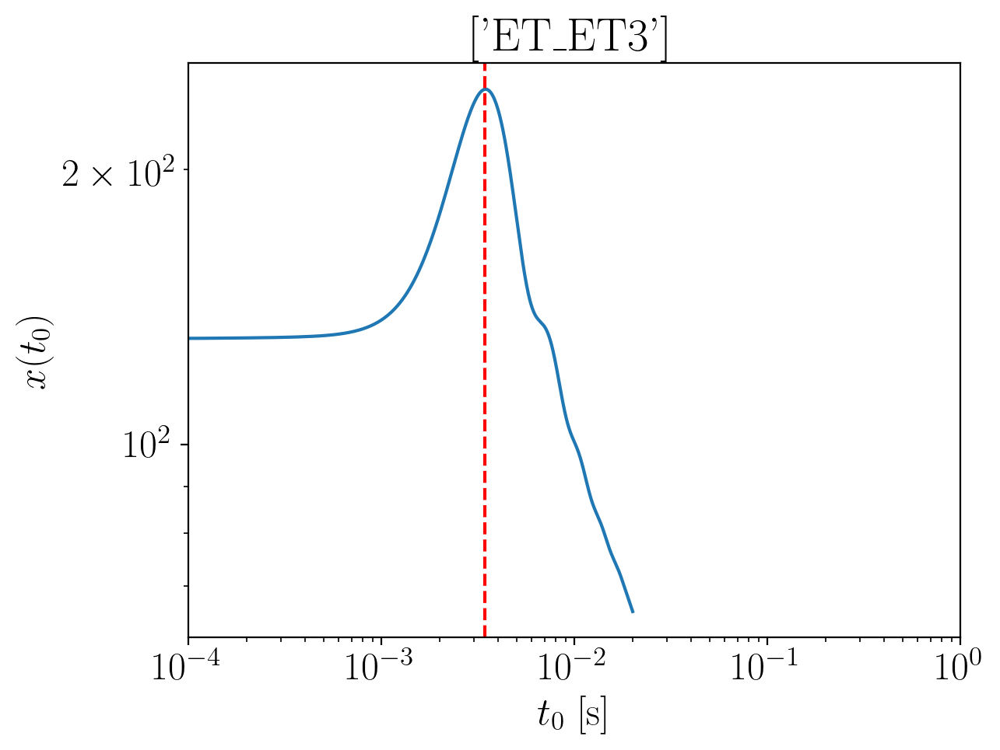

2024-01-15 15:43:14,795 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:14,808 - Network - INFO : PSDs loaded.
2024-01-15 15:43:14,810 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:14,816 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:14,822 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:14,853 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:14,854 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:43:14,875 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.33148596350714
Inner product:
0.9997116571025945


2024-01-15 15:43:20,394 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:43:20,441 - Network - INFO : PSDs loaded.
2024-01-15 15:43:20,448 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:20,469 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:20,470 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:43:20,472 - Network - INFO :    CE-40_C
2024-01-15 15:43:24,082 - Network - INFO :    CE-20_S
2024-01-15 15:43:27,677 - Network - INFO :    ET_ET1
2024-01-15 15:43:31,265 - Network - INFO :    ET_ET2
2024-01-15 15:43:34,843 - Network - INFO :    ET_ET3
2024-01-15 15:43:38,451 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:43:38,458 - Network - INFO : SNRs calculated.
2024-01-15 15:43:38,459 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:43:38,459 - Network - INFO :    CE-40_C
2024-01-15 15:43:38,553 - Network - INFO :

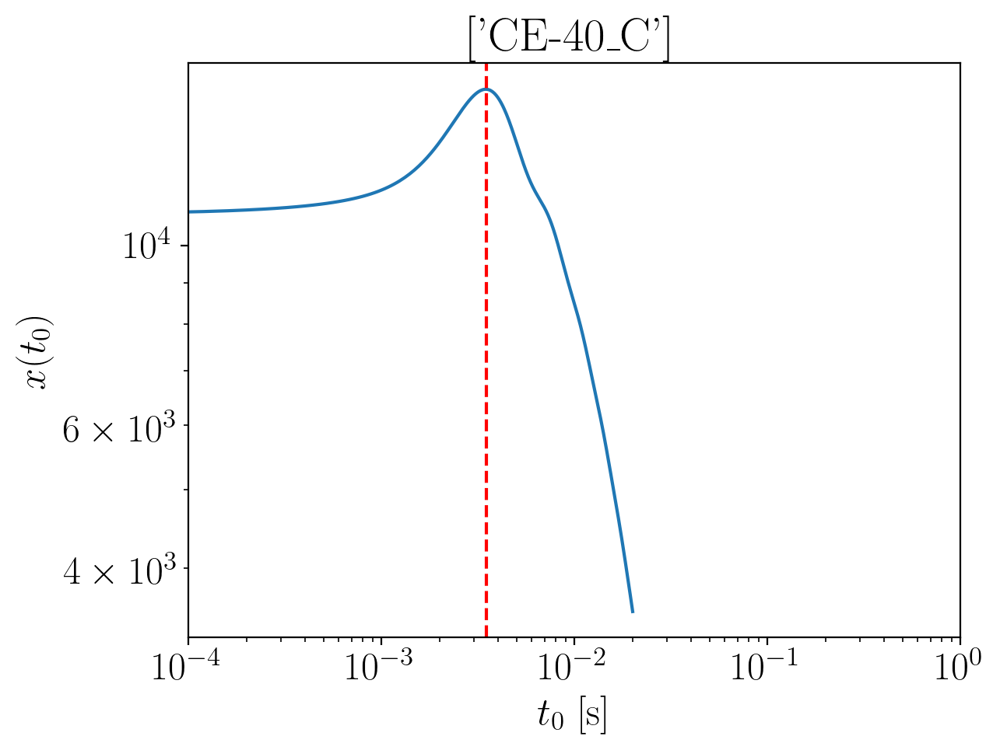

2024-01-15 15:43:40,344 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:40,351 - Network - INFO : PSDs loaded.
2024-01-15 15:43:40,354 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:40,359 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:40,365 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.2996078175940053
Inner product:
0.9998526214640118


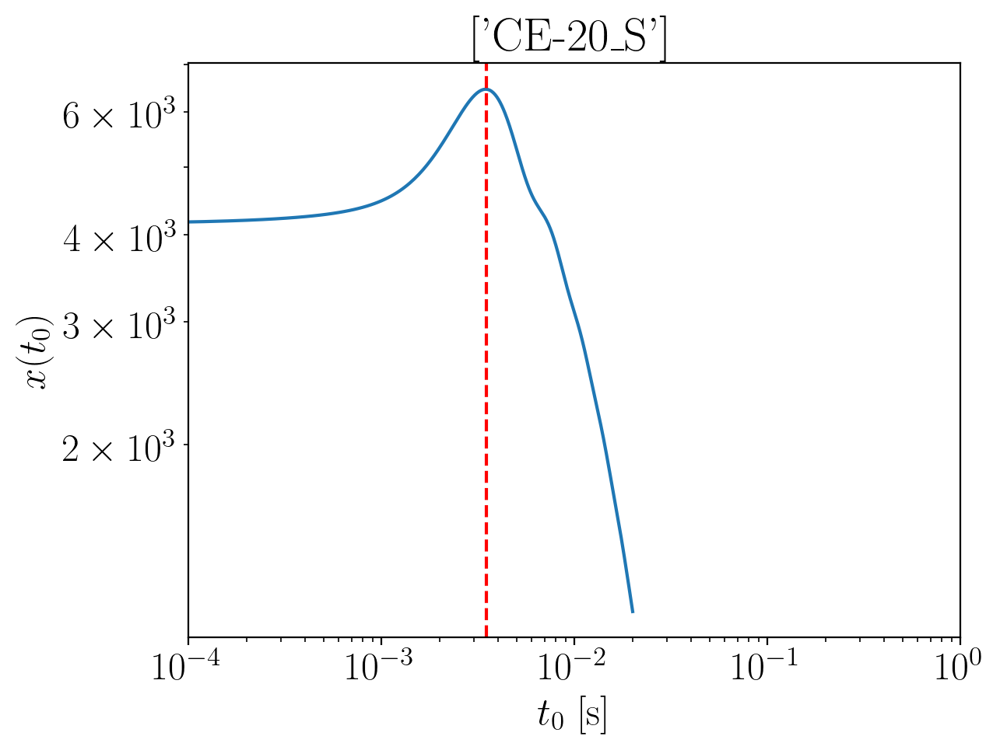

2024-01-15 15:43:41,681 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:41,699 - Network - INFO : PSDs loaded.
2024-01-15 15:43:41,701 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:41,707 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:41,713 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.3000654572642745
Inner product:
0.9998047943991513


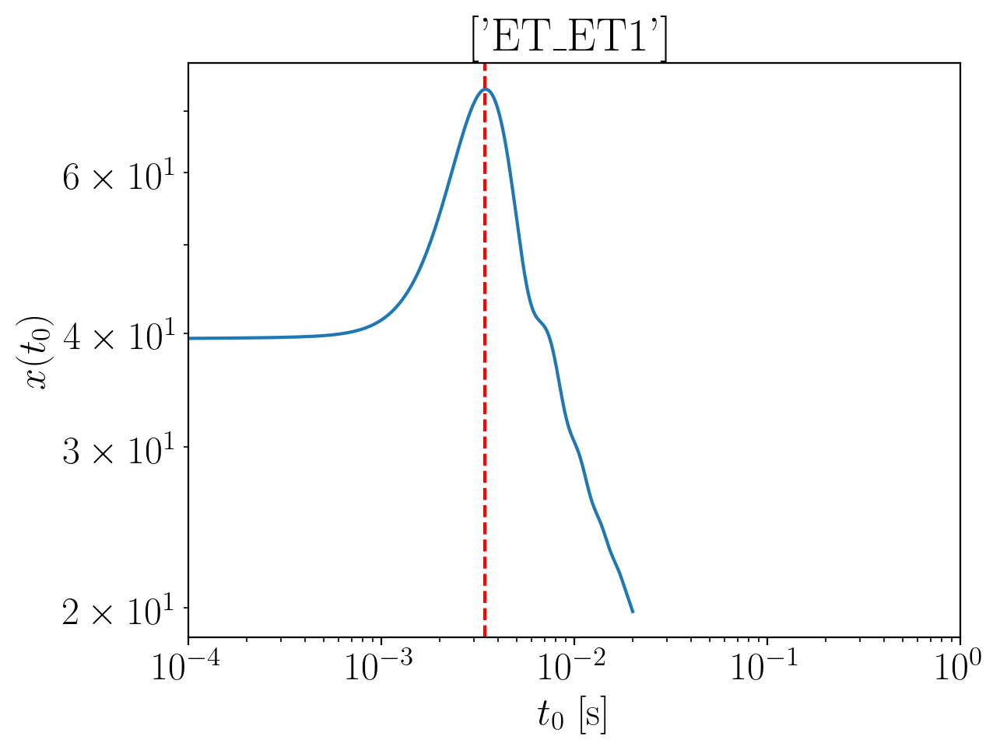

2024-01-15 15:43:43,137 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:43,150 - Network - INFO : PSDs loaded.
2024-01-15 15:43:43,152 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:43,158 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:43,164 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.3088888975743096
Inner product:
0.9997116571025946


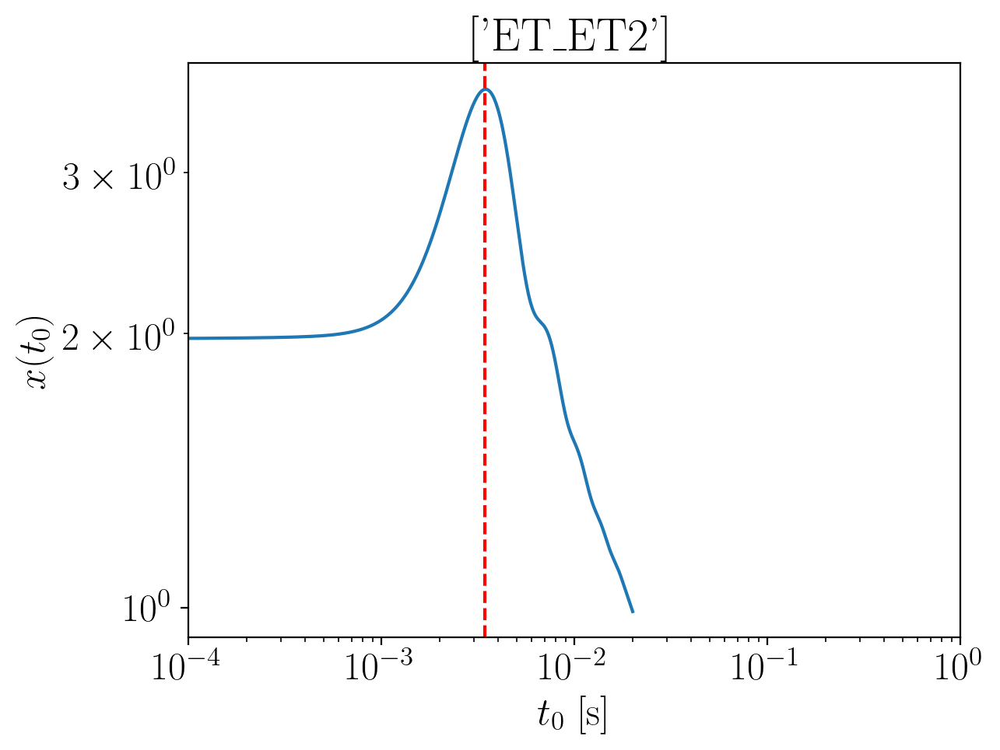

2024-01-15 15:43:44,575 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:44,589 - Network - INFO : PSDs loaded.
2024-01-15 15:43:44,591 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:44,597 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:44,603 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.3088888975743096
Inner product:
0.9997116571025949


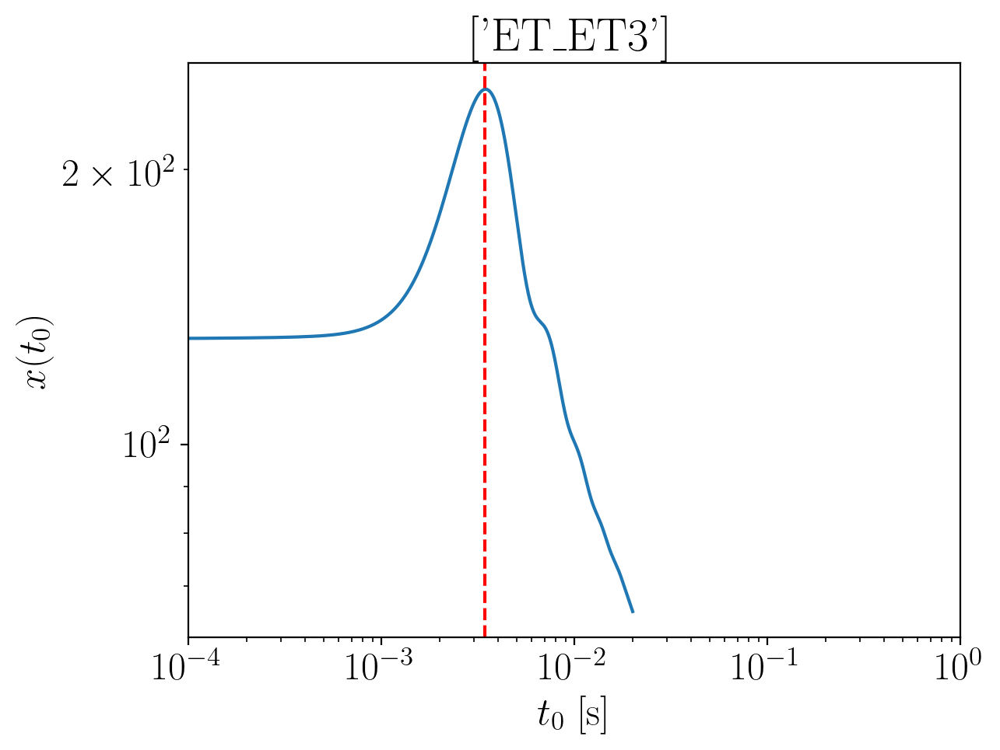

2024-01-15 15:43:46,051 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:46,066 - Network - INFO : PSDs loaded.
2024-01-15 15:43:46,068 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:46,074 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:46,080 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:46,104 - Network - INFO : Polarizations calculated.
2024-01-15 15:43:46,105 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:43:46,109 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.3088888975743096
Inner product:
0.9997116571025947


2024-01-15 15:43:51,628 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:43:51,671 - Network - INFO : PSDs loaded.
2024-01-15 15:43:51,676 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:43:51,694 - Network - INFO : Detector responses calculated.
2024-01-15 15:43:51,694 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:43:51,695 - Network - INFO :    CE-40_C
2024-01-15 15:43:55,330 - Network - INFO :    CE-20_S
2024-01-15 15:43:58,956 - Network - INFO :    ET_ET1
2024-01-15 15:44:02,556 - Network - INFO :    ET_ET2
2024-01-15 15:44:06,178 - Network - INFO :    ET_ET3
2024-01-15 15:44:09,797 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:44:09,804 - Network - INFO : SNRs calculated.
2024-01-15 15:44:09,804 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:44:09,805 - Network - INFO :    CE-40_C
2024-01-15 15:44:09,898 - Network - INFO :

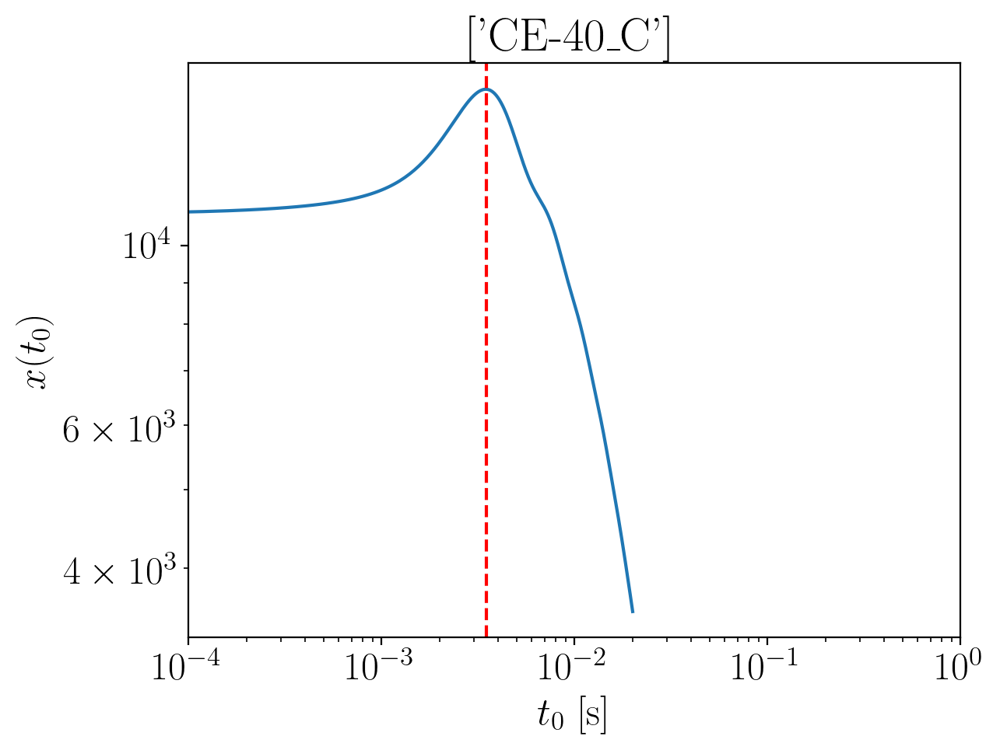

2024-01-15 15:44:11,937 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:11,943 - Network - INFO : PSDs loaded.
2024-01-15 15:44:11,945 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:11,951 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:11,956 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.276889102186177
Inner product:
0.9998526214640118


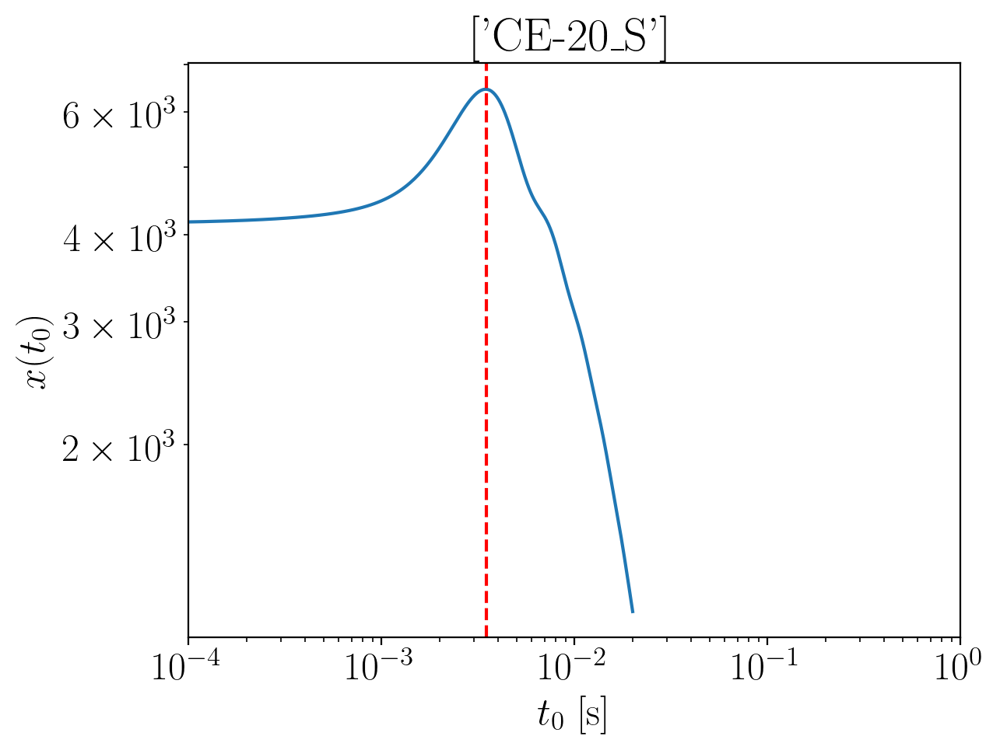

2024-01-15 15:44:13,251 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:13,277 - Network - INFO : PSDs loaded.
2024-01-15 15:44:13,280 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:13,290 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:13,309 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.277346741856447
Inner product:
0.999804794399151


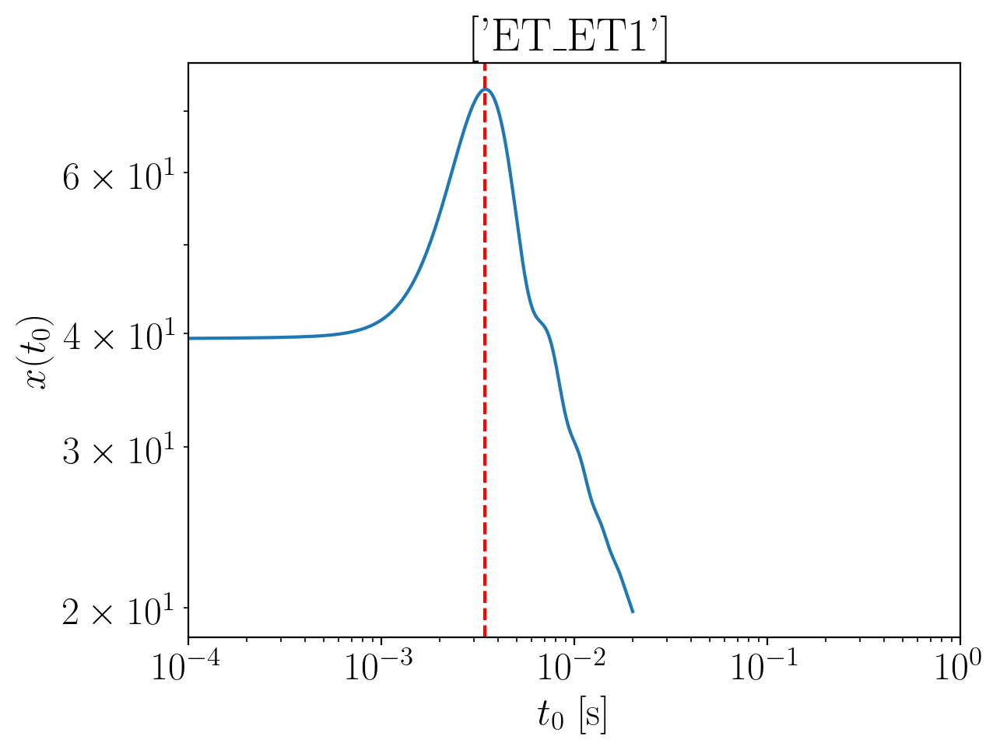

2024-01-15 15:44:14,862 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:14,999 - Network - INFO : PSDs loaded.
2024-01-15 15:44:15,001 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:15,007 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:15,013 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.286170182166482
Inner product:
0.9997116571025946


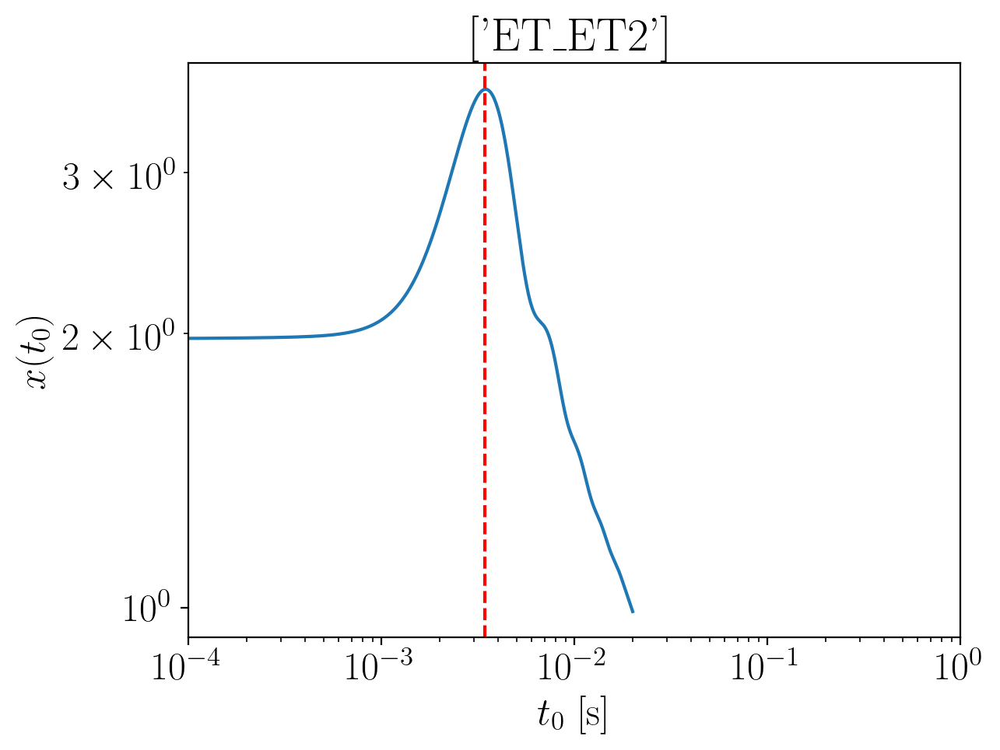

2024-01-15 15:44:16,510 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:16,523 - Network - INFO : PSDs loaded.
2024-01-15 15:44:16,525 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:16,531 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:16,537 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.286170182166482
Inner product:
0.9997116571025949


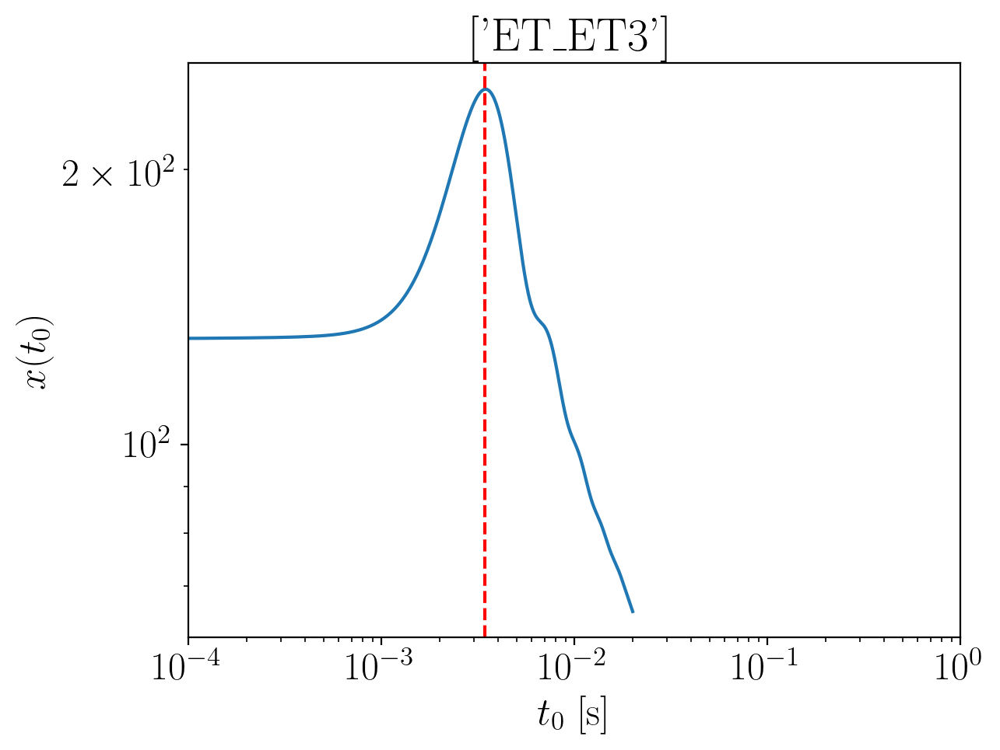

2024-01-15 15:44:17,955 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:17,969 - Network - INFO : PSDs loaded.
2024-01-15 15:44:17,971 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:17,979 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:17,985 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:18,009 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:18,009 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:44:18,014 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.286170182166482
Inner product:
0.9997116571025947


2024-01-15 15:44:23,378 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:44:23,421 - Network - INFO : PSDs loaded.
2024-01-15 15:44:23,427 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:23,444 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:23,444 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:44:23,445 - Network - INFO :    CE-40_C
2024-01-15 15:44:27,017 - Network - INFO :    CE-20_S
2024-01-15 15:44:30,579 - Network - INFO :    ET_ET1
2024-01-15 15:44:34,237 - Network - INFO :    ET_ET2
2024-01-15 15:44:37,821 - Network - INFO :    ET_ET3
2024-01-15 15:44:41,467 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:44:41,474 - Network - INFO : SNRs calculated.
2024-01-15 15:44:41,475 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:44:41,475 - Network - INFO :    CE-40_C
2024-01-15 15:44:41,568 - Network - INFO :

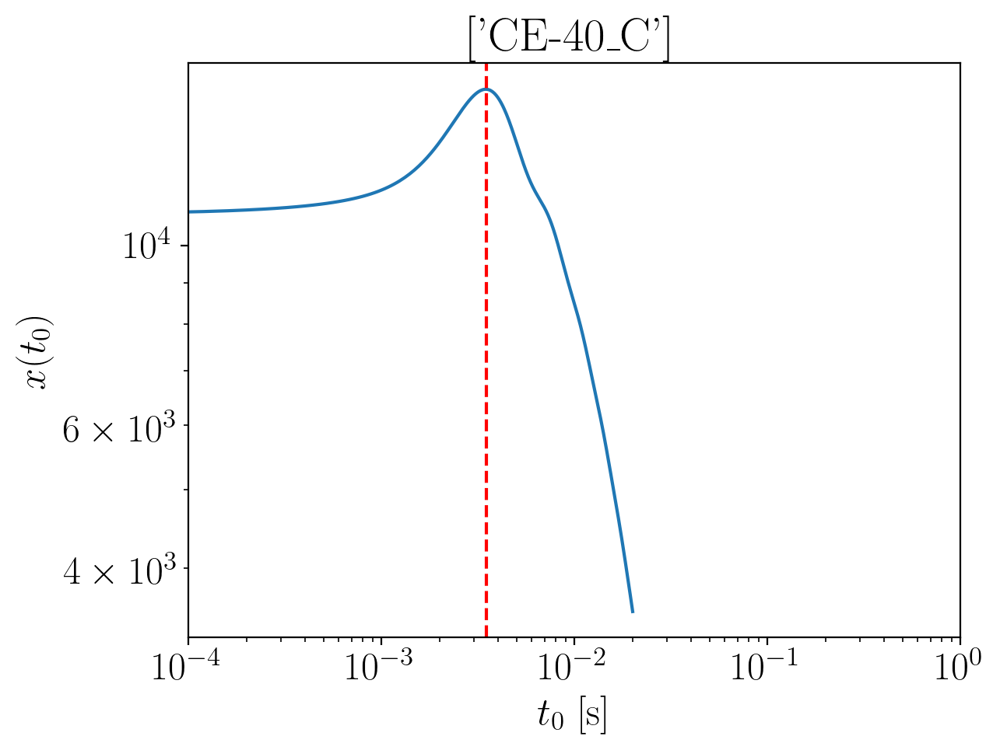

2024-01-15 15:44:43,302 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:43,309 - Network - INFO : PSDs loaded.
2024-01-15 15:44:43,311 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:43,317 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:43,322 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.254189782147017
Inner product:
0.9998526214640118


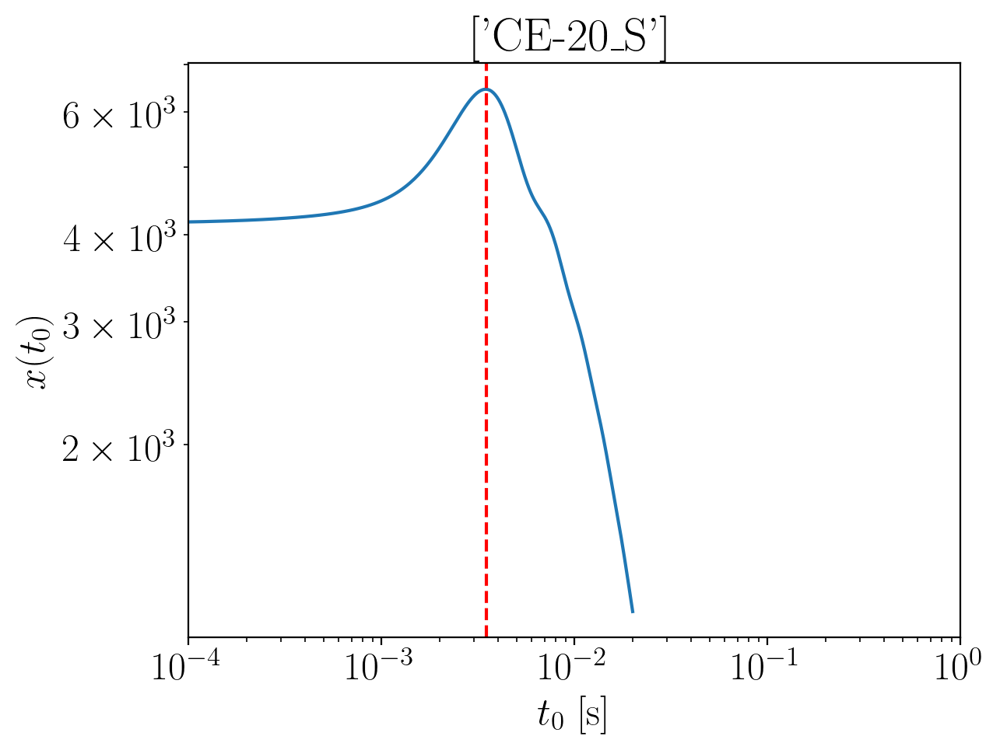

2024-01-15 15:44:44,455 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:44,462 - Network - INFO : PSDs loaded.
2024-01-15 15:44:44,463 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:44,469 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:44,475 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.2546474218172863
Inner product:
0.999804794399151


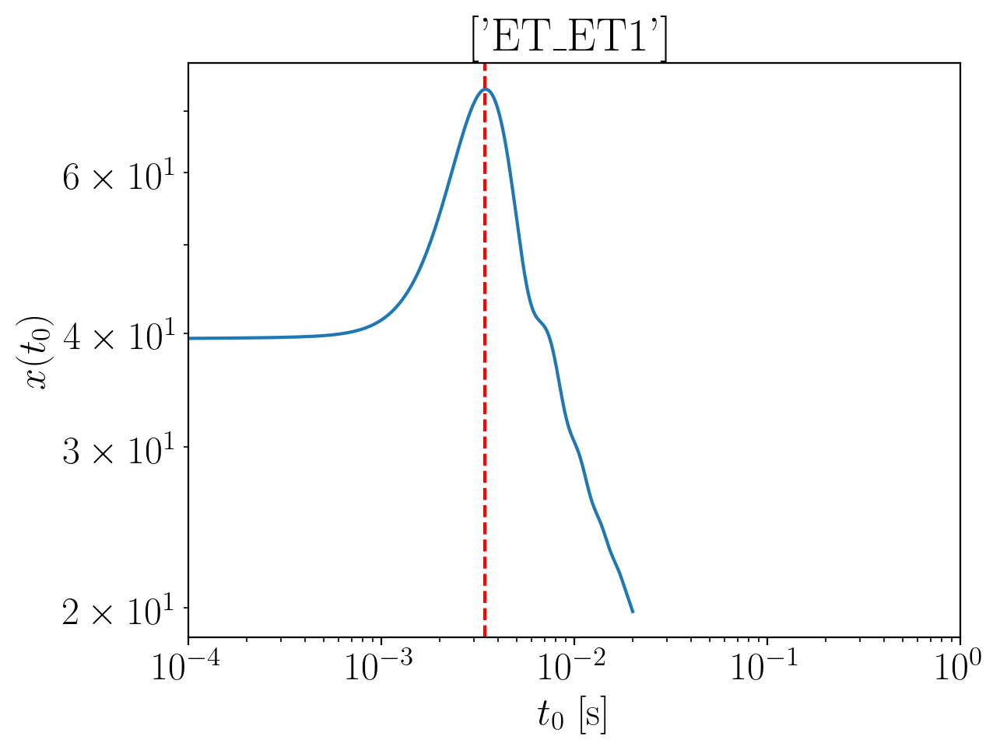

2024-01-15 15:44:45,872 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:45,884 - Network - INFO : PSDs loaded.
2024-01-15 15:44:45,886 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:45,892 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:45,898 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2634708621273187
Inner product:
0.9997116571025946


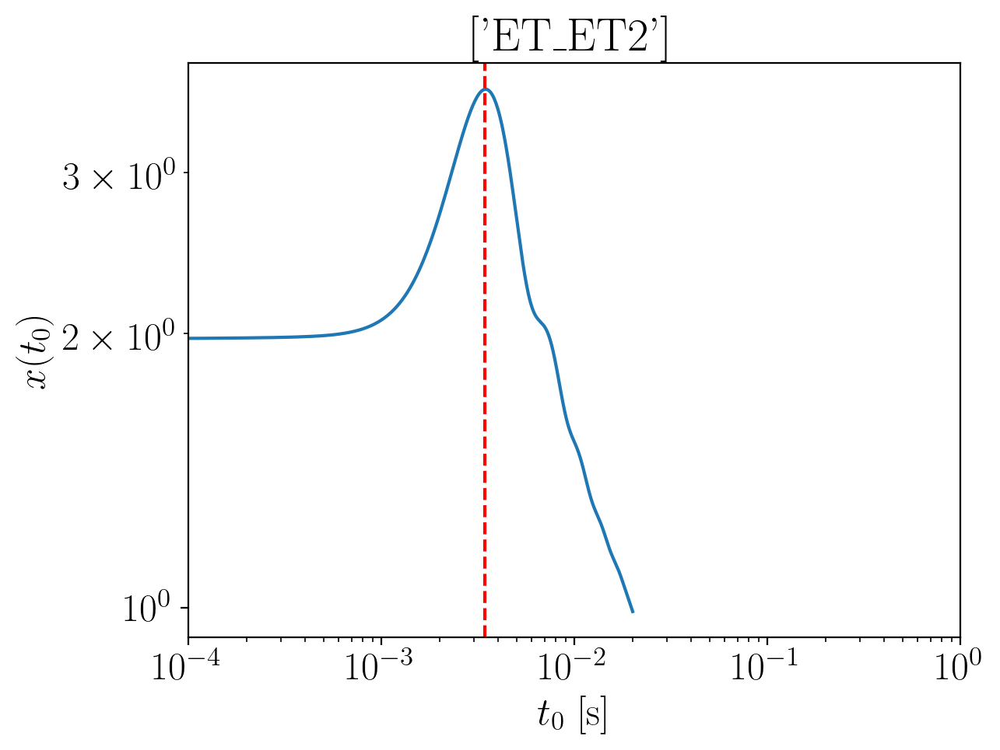

2024-01-15 15:44:47,320 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:47,334 - Network - INFO : PSDs loaded.
2024-01-15 15:44:47,336 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:47,342 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:47,348 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2634708621273187
Inner product:
0.9997116571025949


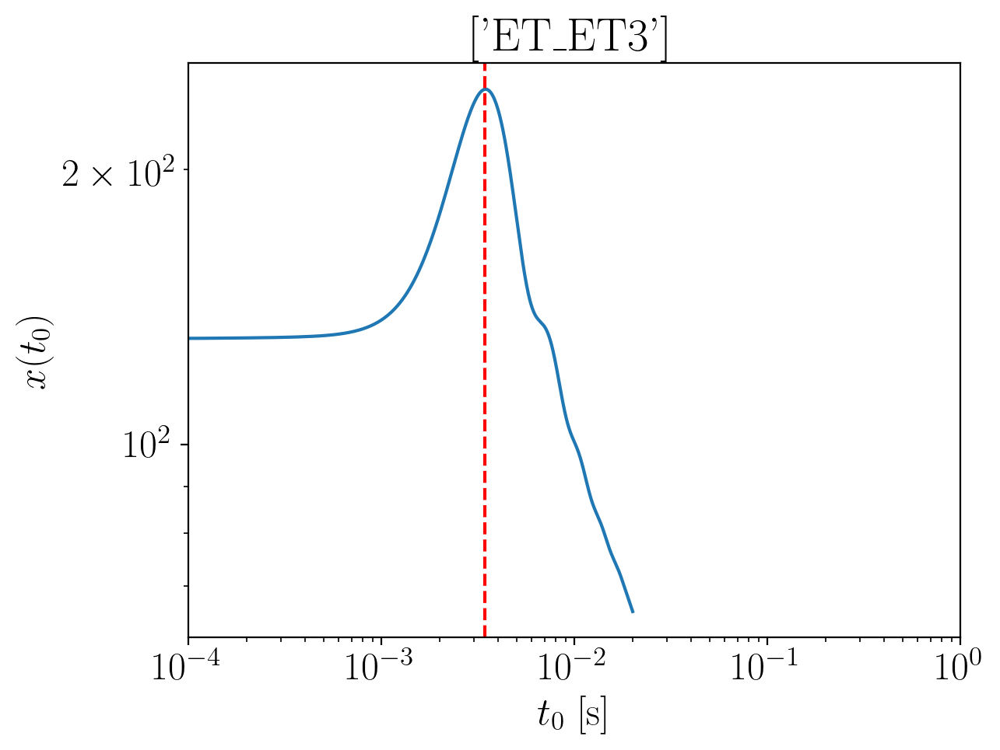

2024-01-15 15:44:48,791 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:48,943 - Network - INFO : PSDs loaded.
2024-01-15 15:44:48,945 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:48,951 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:48,957 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:48,979 - Network - INFO : Polarizations calculated.
2024-01-15 15:44:48,980 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:44:48,984 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2634708621273187
Inner product:
0.9997116571025947


2024-01-15 15:44:54,288 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:44:54,331 - Network - INFO : PSDs loaded.
2024-01-15 15:44:54,337 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:44:54,353 - Network - INFO : Detector responses calculated.
2024-01-15 15:44:54,354 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:44:54,354 - Network - INFO :    CE-40_C
2024-01-15 15:44:57,936 - Network - INFO :    CE-20_S
2024-01-15 15:45:01,581 - Network - INFO :    ET_ET1
2024-01-15 15:45:05,230 - Network - INFO :    ET_ET2
2024-01-15 15:45:08,846 - Network - INFO :    ET_ET3
2024-01-15 15:45:12,448 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:45:12,455 - Network - INFO : SNRs calculated.
2024-01-15 15:45:12,455 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:45:12,455 - Network - INFO :    CE-40_C
2024-01-15 15:45:12,548 - Network - INFO :

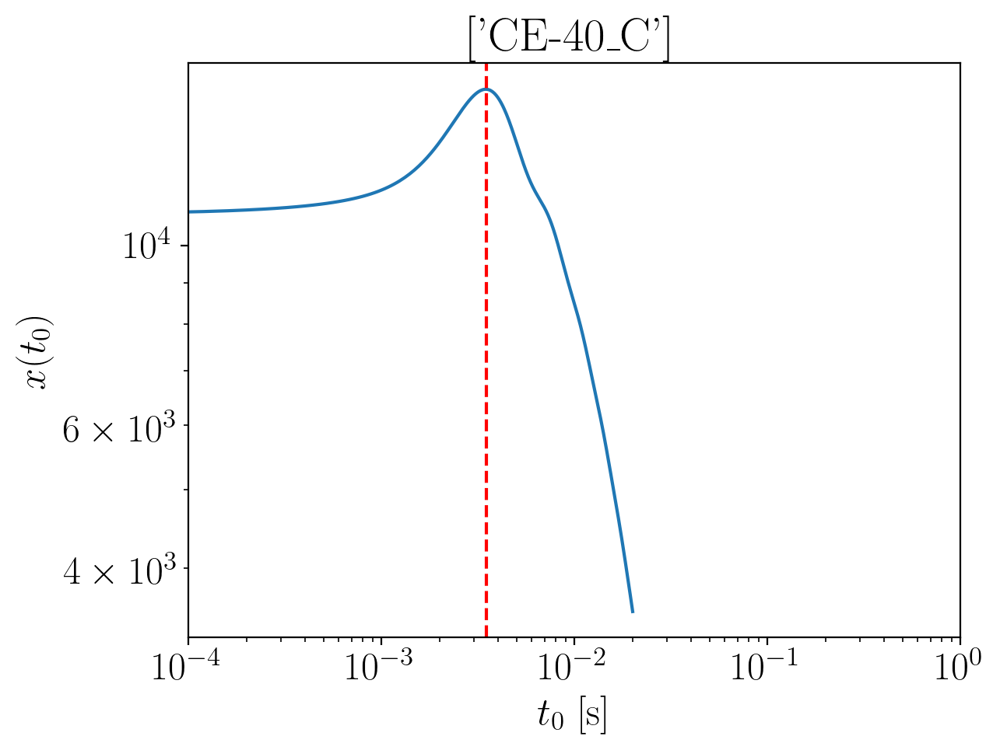

2024-01-15 15:45:14,289 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:14,296 - Network - INFO : PSDs loaded.
2024-01-15 15:45:14,298 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:14,306 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:14,317 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.2315585777828506
Inner product:
0.9998526214640117


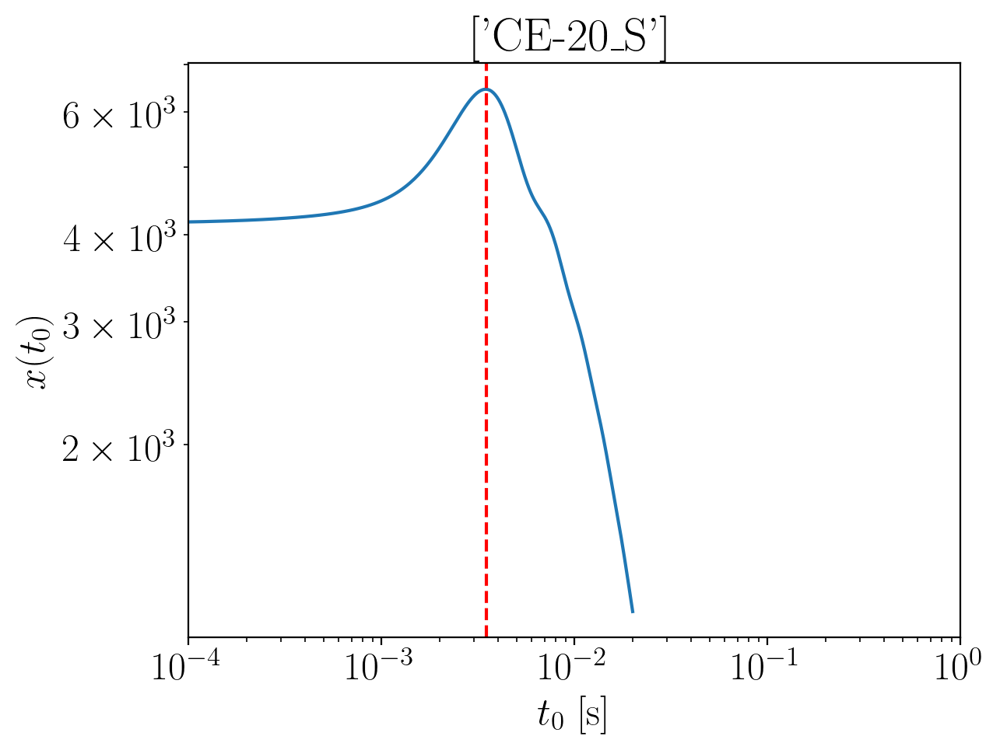

2024-01-15 15:45:15,491 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:15,498 - Network - INFO : PSDs loaded.
2024-01-15 15:45:15,500 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:15,506 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:15,512 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.2320162174531197
Inner product:
0.9998047943991513


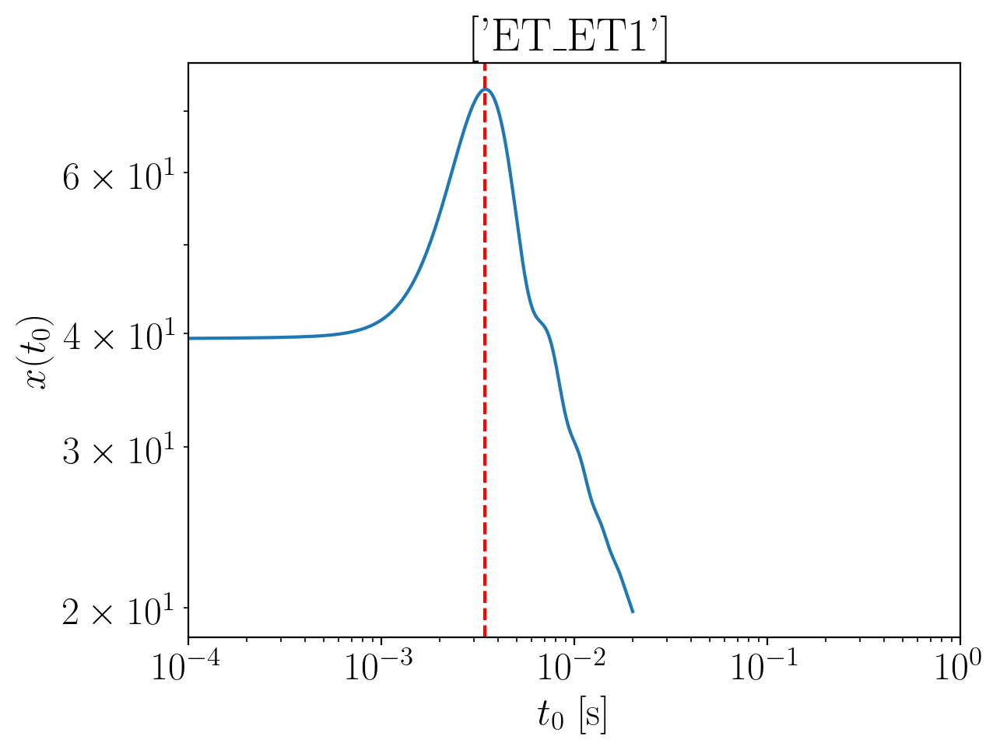

2024-01-15 15:45:16,912 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:16,926 - Network - INFO : PSDs loaded.
2024-01-15 15:45:16,928 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:16,934 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:16,939 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.240839657763155
Inner product:
0.9997116571025948


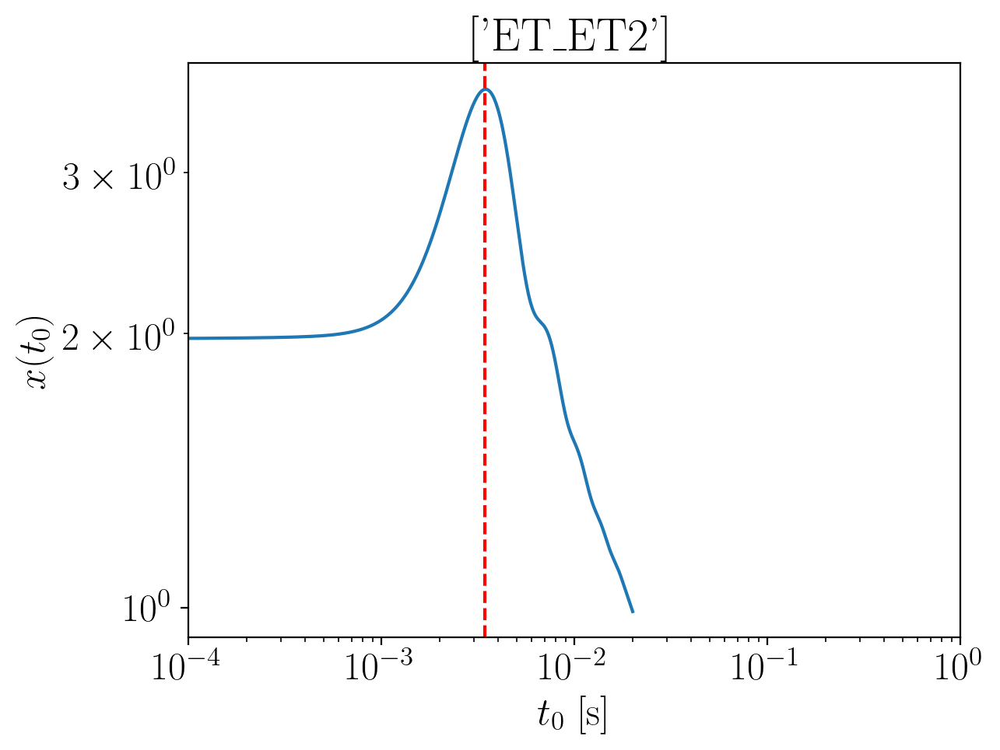

2024-01-15 15:45:18,373 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:18,387 - Network - INFO : PSDs loaded.
2024-01-15 15:45:18,389 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:18,395 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:18,401 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.240839657763155
Inner product:
0.9997116571025949


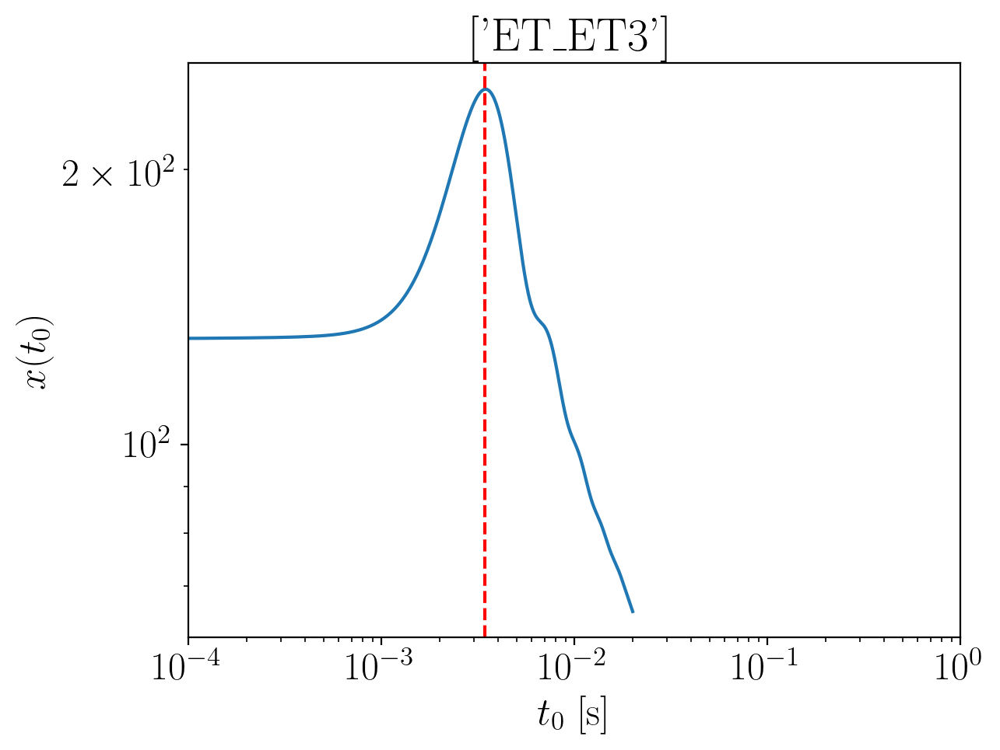

2024-01-15 15:45:19,848 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:19,861 - Network - INFO : PSDs loaded.
2024-01-15 15:45:19,863 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:19,869 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:19,875 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:19,898 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:19,899 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:45:19,903 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.240839657763155
Inner product:
0.9997116571025947


2024-01-15 15:45:25,237 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:45:25,280 - Network - INFO : PSDs loaded.
2024-01-15 15:45:25,286 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:25,303 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:25,304 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:45:25,304 - Network - INFO :    CE-40_C
2024-01-15 15:45:28,887 - Network - INFO :    CE-20_S
2024-01-15 15:45:32,526 - Network - INFO :    ET_ET1
2024-01-15 15:45:36,152 - Network - INFO :    ET_ET2
2024-01-15 15:45:39,808 - Network - INFO :    ET_ET3
2024-01-15 15:45:43,453 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:45:43,460 - Network - INFO : SNRs calculated.
2024-01-15 15:45:43,460 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:45:43,461 - Network - INFO :    CE-40_C
2024-01-15 15:45:43,553 - Network - INFO :

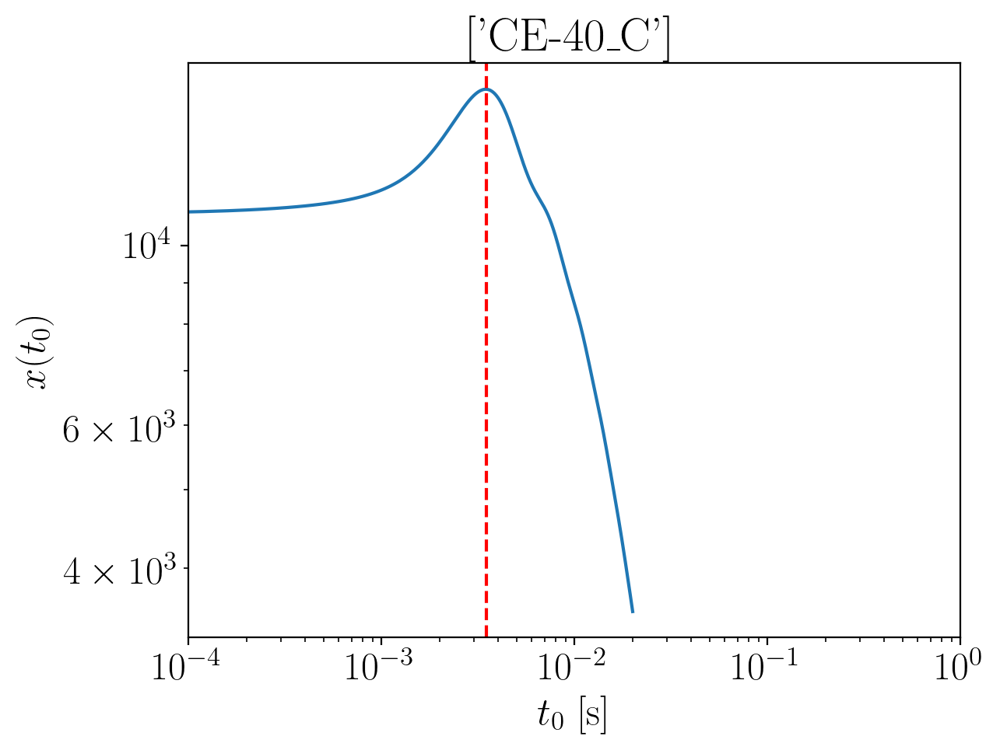

2024-01-15 15:45:45,282 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:45,289 - Network - INFO : PSDs loaded.
2024-01-15 15:45:45,291 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:45,296 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:45,302 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.209010610716554
Inner product:
0.9998526214640118


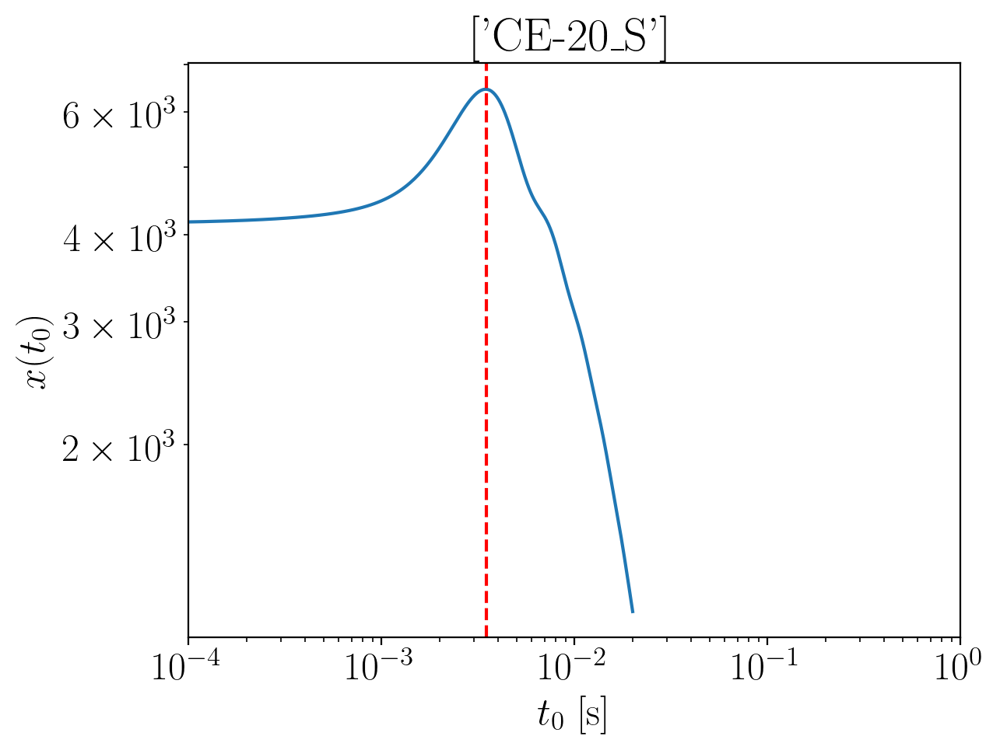

2024-01-15 15:45:46,615 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:46,625 - Network - INFO : PSDs loaded.
2024-01-15 15:45:46,628 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:46,638 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:46,659 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.209468250386823
Inner product:
0.999804794399151


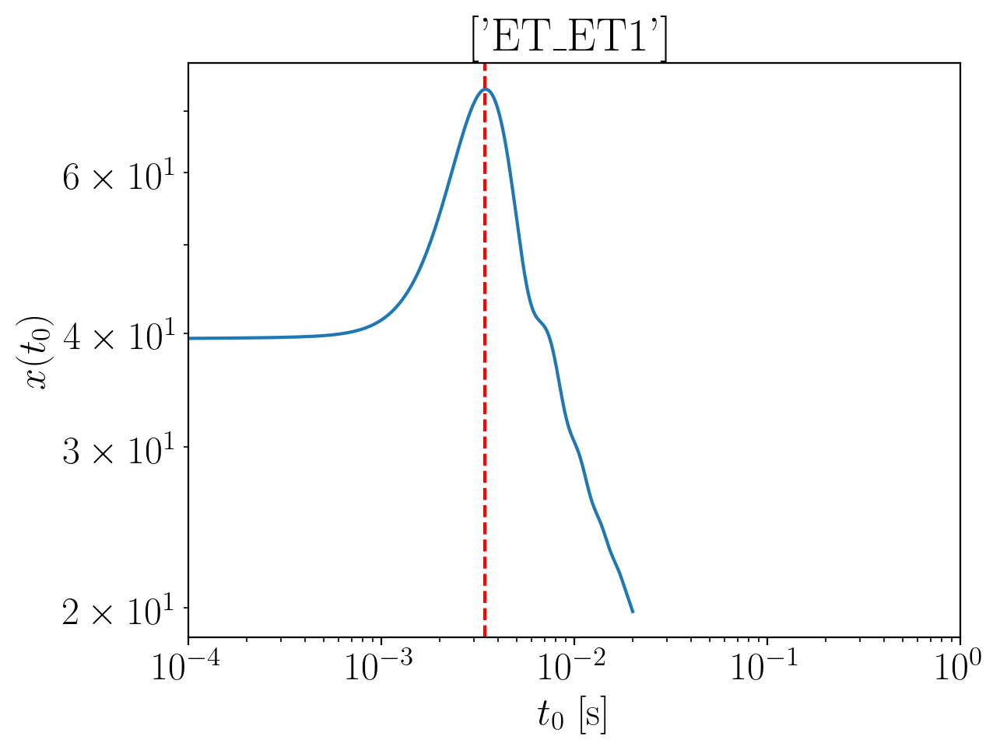

2024-01-15 15:45:48,080 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:48,093 - Network - INFO : PSDs loaded.
2024-01-15 15:45:48,096 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:48,101 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:48,106 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2182916906968586
Inner product:
0.9997116571025946


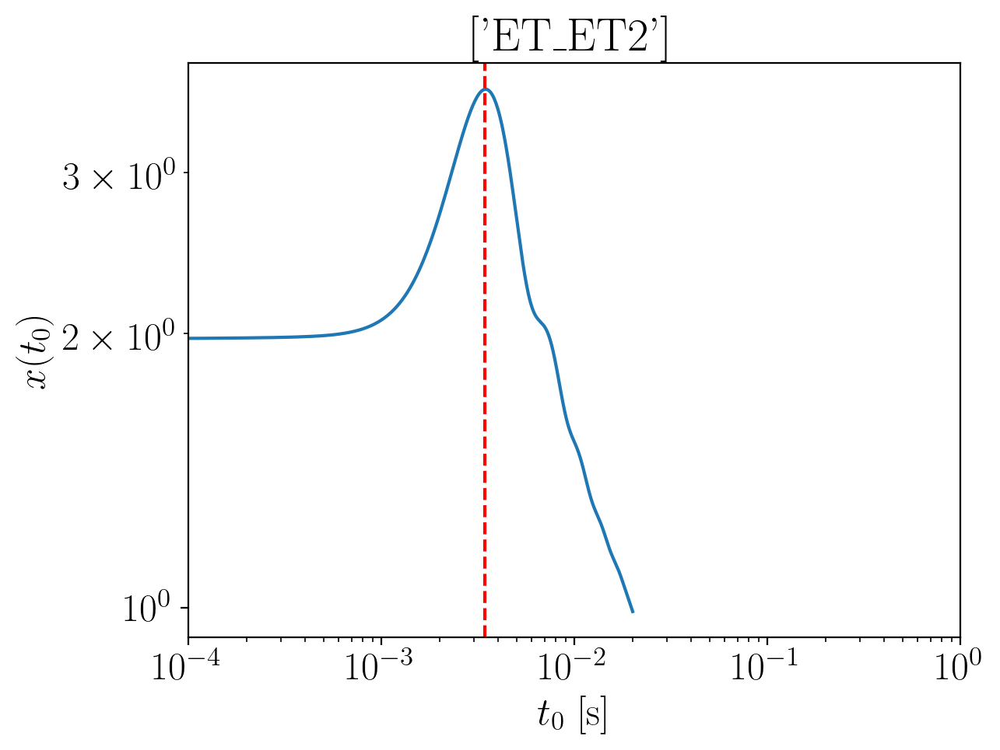

2024-01-15 15:45:49,513 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:49,529 - Network - INFO : PSDs loaded.
2024-01-15 15:45:49,532 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:49,539 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:49,546 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.2182916906968586
Inner product:
0.9997116571025949


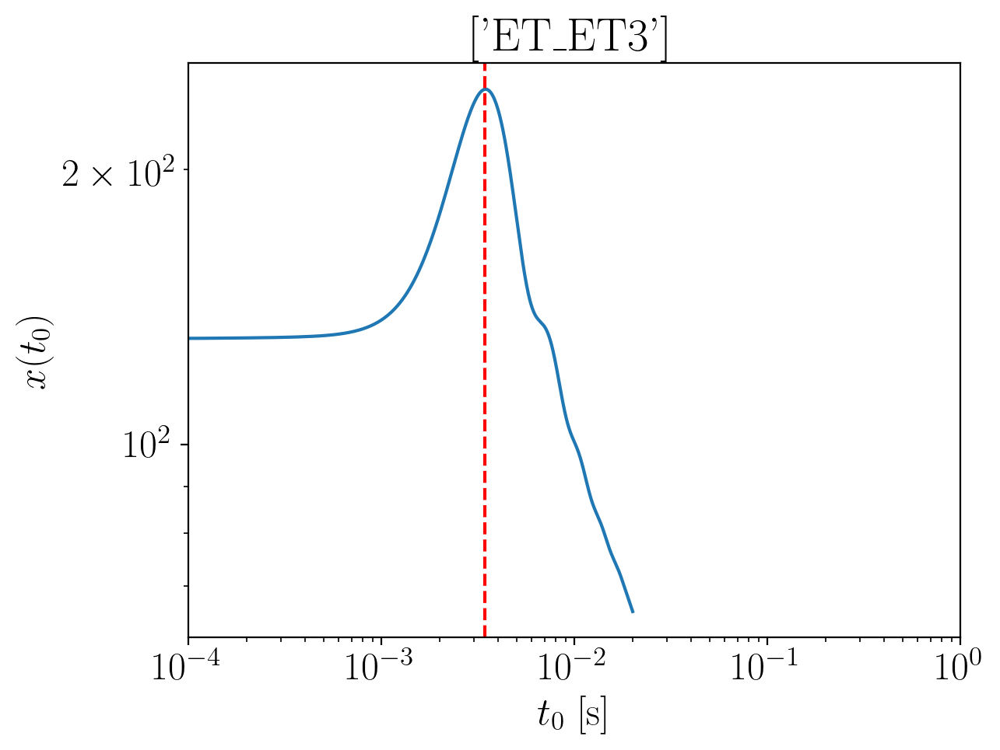

2024-01-15 15:45:50,967 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:50,980 - Network - INFO : PSDs loaded.
2024-01-15 15:45:50,982 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:50,987 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:50,993 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:51,015 - Network - INFO : Polarizations calculated.
2024-01-15 15:45:51,016 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:45:51,021 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.218291690696858
Inner product:
0.9997116571025947


2024-01-15 15:45:56,384 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:45:56,431 - Network - INFO : PSDs loaded.
2024-01-15 15:45:56,437 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:45:56,455 - Network - INFO : Detector responses calculated.
2024-01-15 15:45:56,456 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:45:56,456 - Network - INFO :    CE-40_C
2024-01-15 15:46:00,062 - Network - INFO :    CE-20_S
2024-01-15 15:46:03,685 - Network - INFO :    ET_ET1
2024-01-15 15:46:07,311 - Network - INFO :    ET_ET2
2024-01-15 15:46:10,973 - Network - INFO :    ET_ET3
2024-01-15 15:46:14,552 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:46:14,559 - Network - INFO : SNRs calculated.
2024-01-15 15:46:14,559 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:46:14,560 - Network - INFO :    CE-40_C
2024-01-15 15:46:14,653 - Network - INFO :

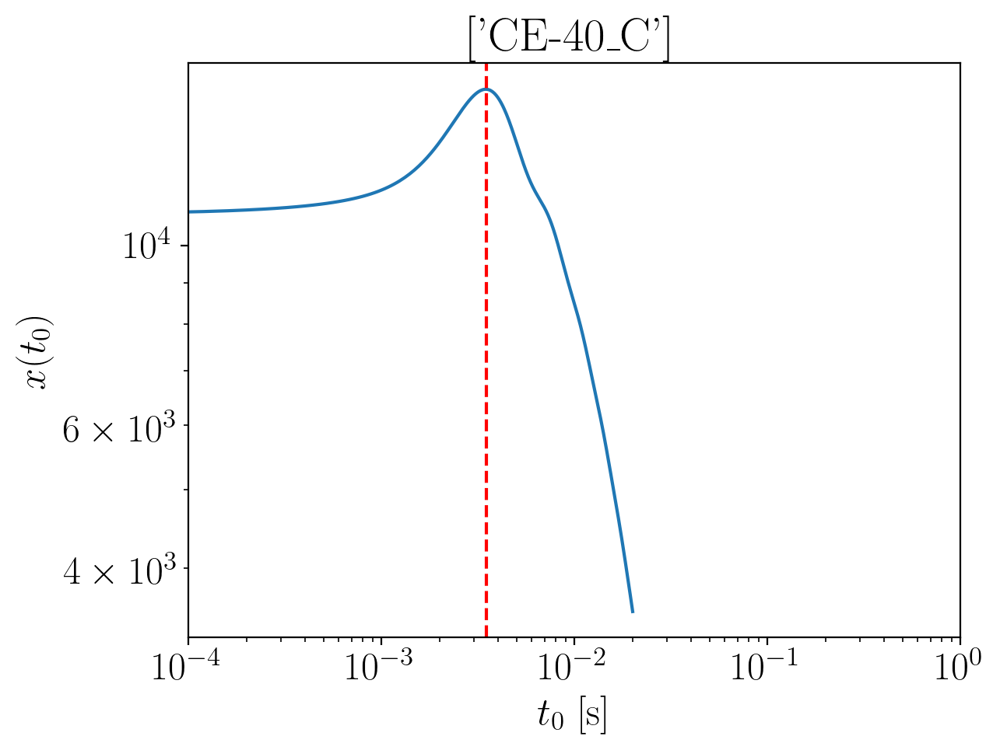

2024-01-15 15:46:16,412 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:16,419 - Network - INFO : PSDs loaded.
2024-01-15 15:46:16,421 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:16,427 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:16,435 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.186547148695978
Inner product:
0.9998526214640118


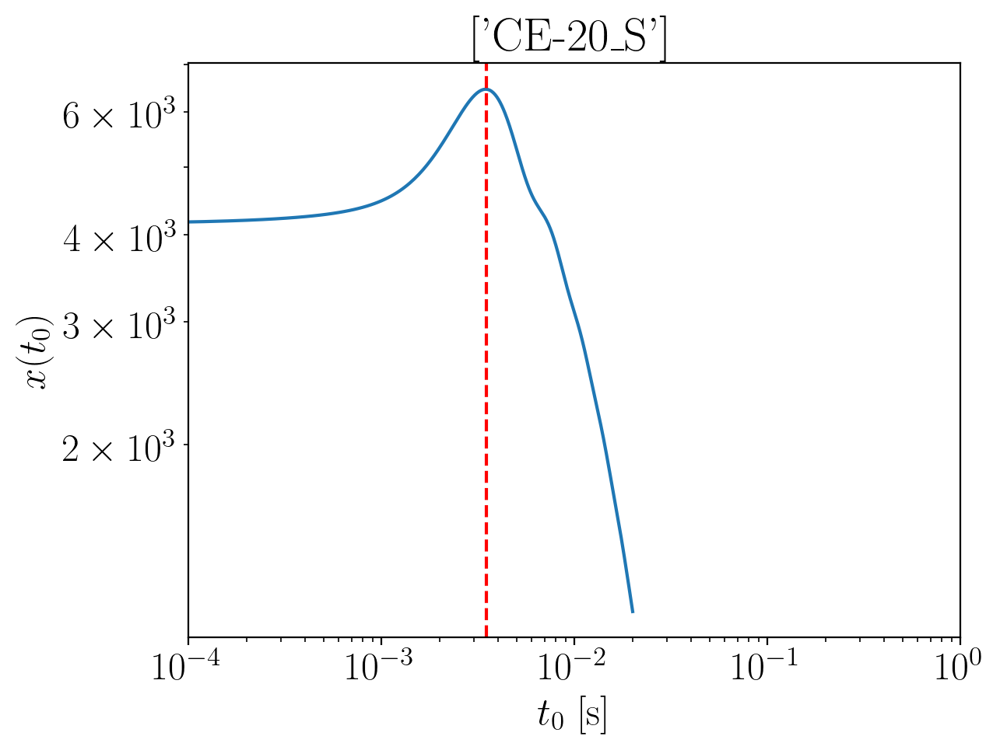

2024-01-15 15:46:17,592 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:17,599 - Network - INFO : PSDs loaded.
2024-01-15 15:46:17,601 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:17,607 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:17,613 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.187004788366248
Inner product:
0.9998047943991513


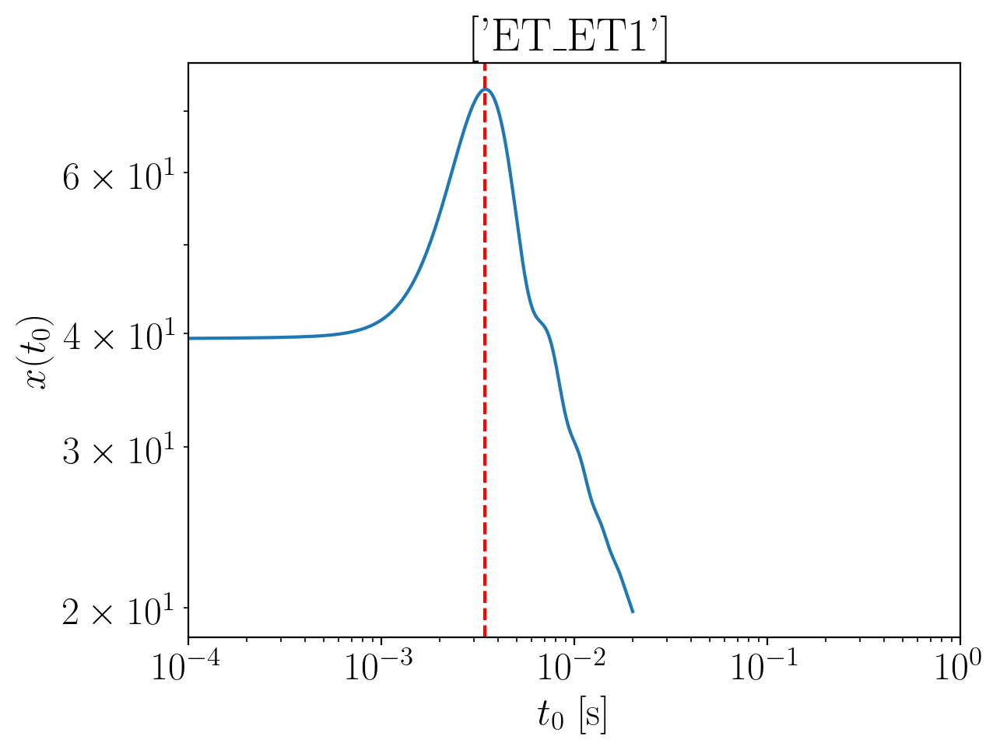

2024-01-15 15:46:19,057 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:19,070 - Network - INFO : PSDs loaded.
2024-01-15 15:46:19,072 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:19,079 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:19,085 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.195828228676283
Inner product:
0.9997116571025946


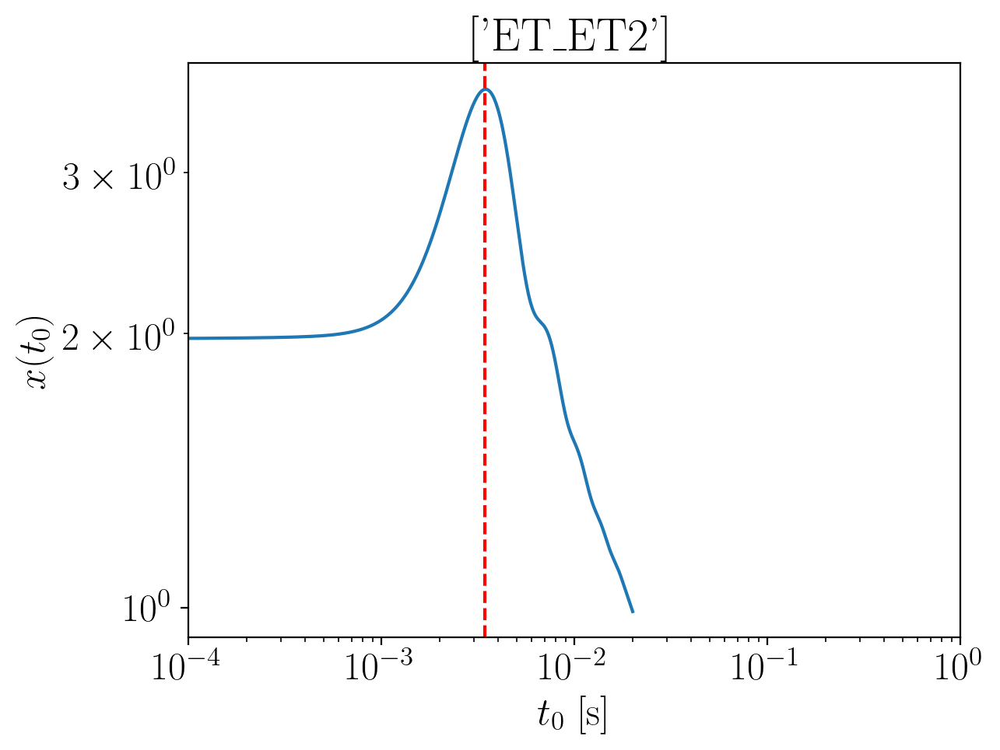

2024-01-15 15:46:20,666 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:20,681 - Network - INFO : PSDs loaded.
2024-01-15 15:46:20,683 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:20,689 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:20,696 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.195828228676283
Inner product:
0.9997116571025949


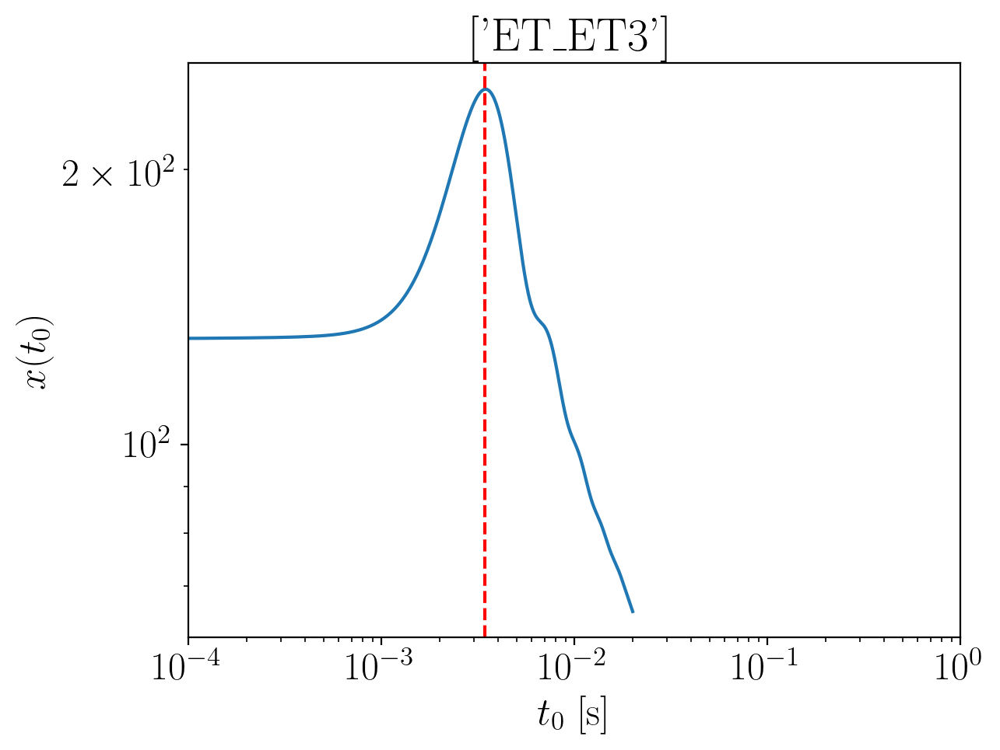

2024-01-15 15:46:22,156 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:22,170 - Network - INFO : PSDs loaded.
2024-01-15 15:46:22,172 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:22,178 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:22,184 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:22,206 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:22,207 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:46:22,211 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.195828228676283
Inner product:
0.9997116571025947


2024-01-15 15:46:27,637 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:46:27,683 - Network - INFO : PSDs loaded.
2024-01-15 15:46:27,688 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:27,706 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:27,707 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:46:27,707 - Network - INFO :    CE-40_C
2024-01-15 15:46:31,360 - Network - INFO :    CE-20_S
2024-01-15 15:46:34,982 - Network - INFO :    ET_ET1
2024-01-15 15:46:38,573 - Network - INFO :    ET_ET2
2024-01-15 15:46:42,152 - Network - INFO :    ET_ET3
2024-01-15 15:46:45,730 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:46:45,737 - Network - INFO : SNRs calculated.
2024-01-15 15:46:45,737 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:46:45,737 - Network - INFO :    CE-40_C
2024-01-15 15:46:45,832 - Network - INFO :

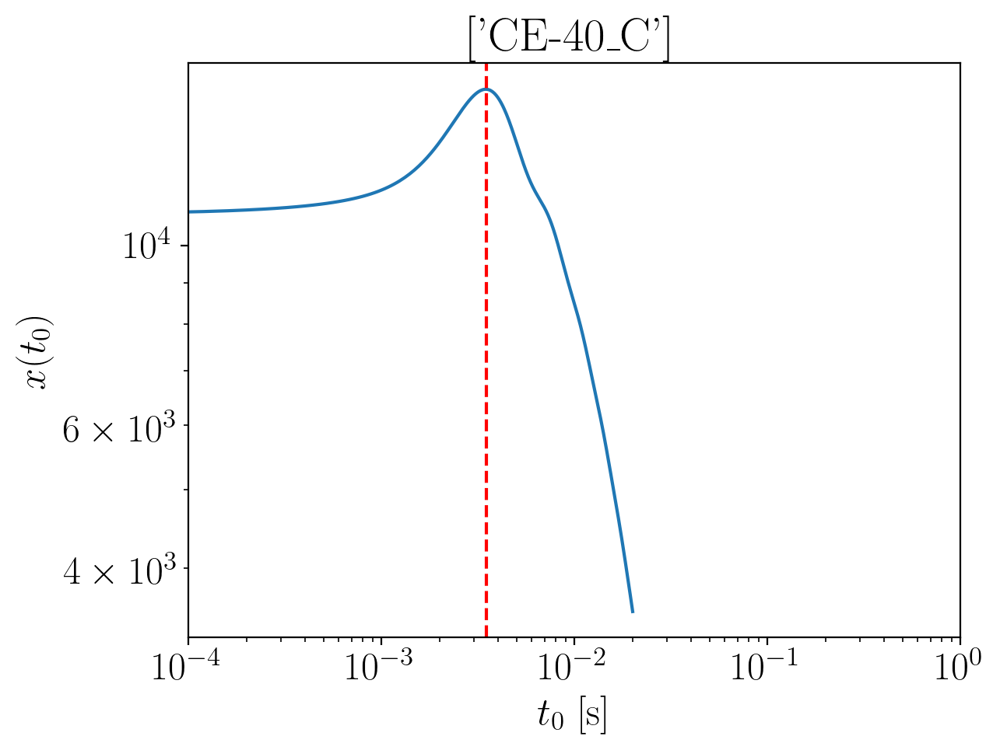

2024-01-15 15:46:47,589 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:47,596 - Network - INFO : PSDs loaded.
2024-01-15 15:46:47,598 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:47,604 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:47,610 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.164163480667347
Inner product:
0.9998526214640118


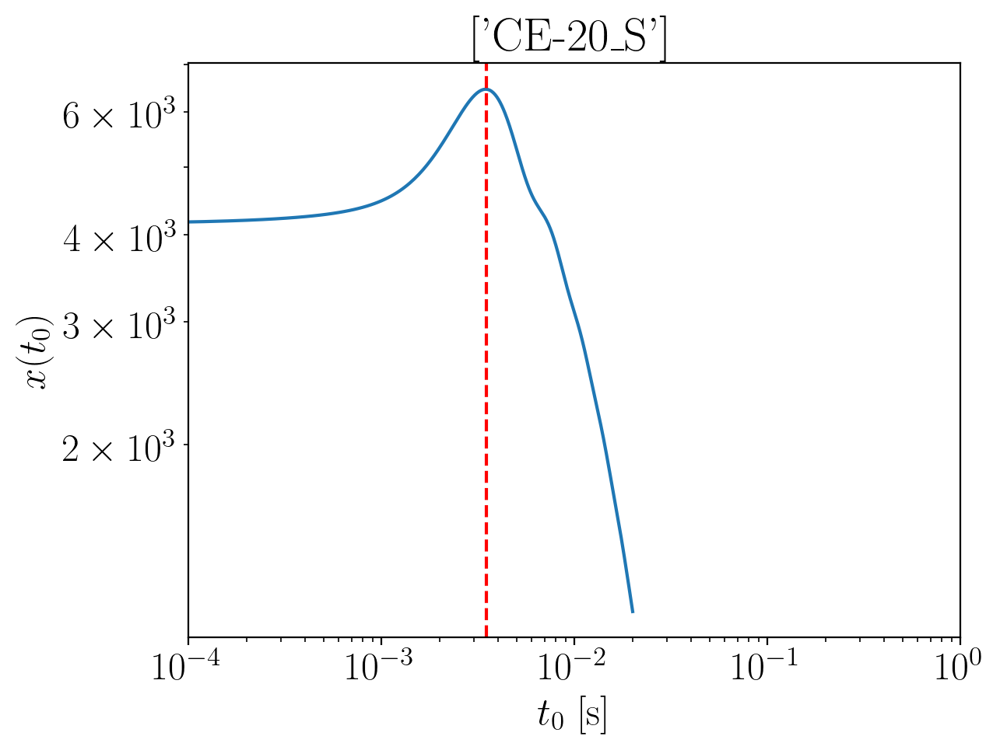

2024-01-15 15:46:48,745 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:48,751 - Network - INFO : PSDs loaded.
2024-01-15 15:46:48,753 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:48,759 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:48,765 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.1646211203376162
Inner product:
0.999804794399151


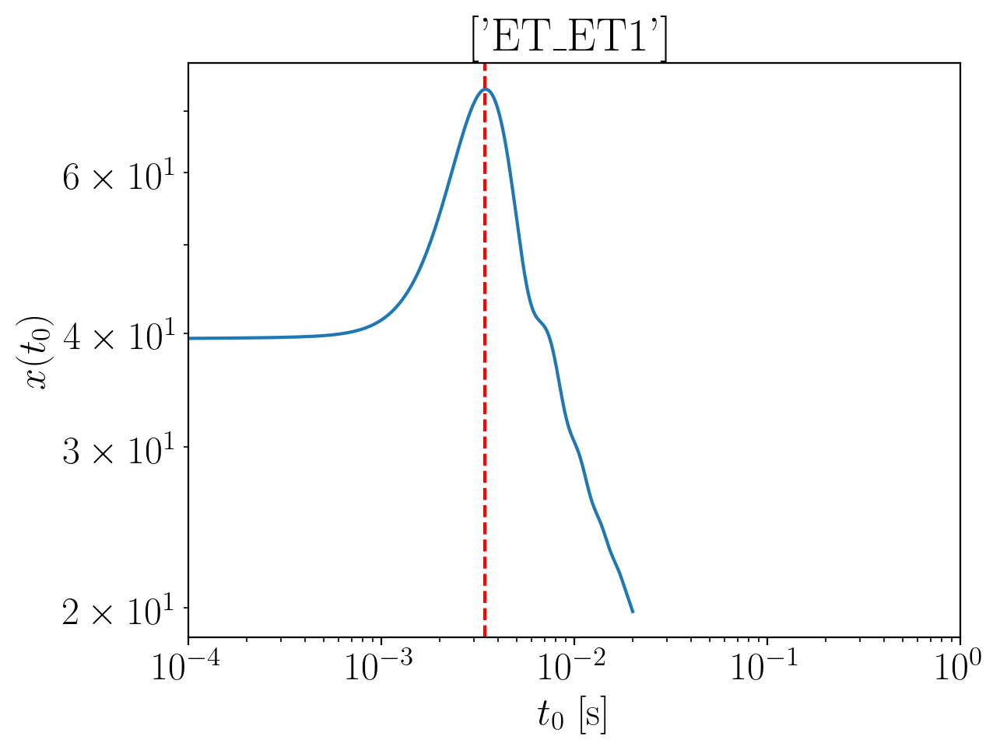

2024-01-15 15:46:50,158 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:50,172 - Network - INFO : PSDs loaded.
2024-01-15 15:46:50,174 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:50,180 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:50,186 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.1734445606476513
Inner product:
0.9997116571025946


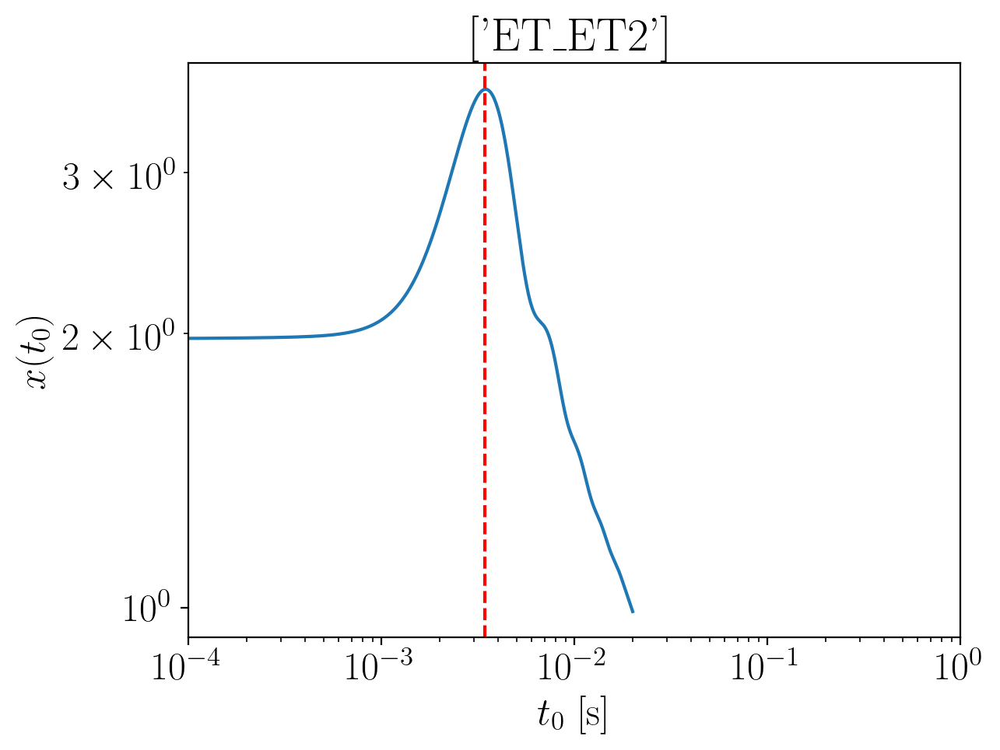

2024-01-15 15:46:51,603 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:51,618 - Network - INFO : PSDs loaded.
2024-01-15 15:46:51,621 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:51,630 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:51,639 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.173444560647651
Inner product:
0.9997116571025949


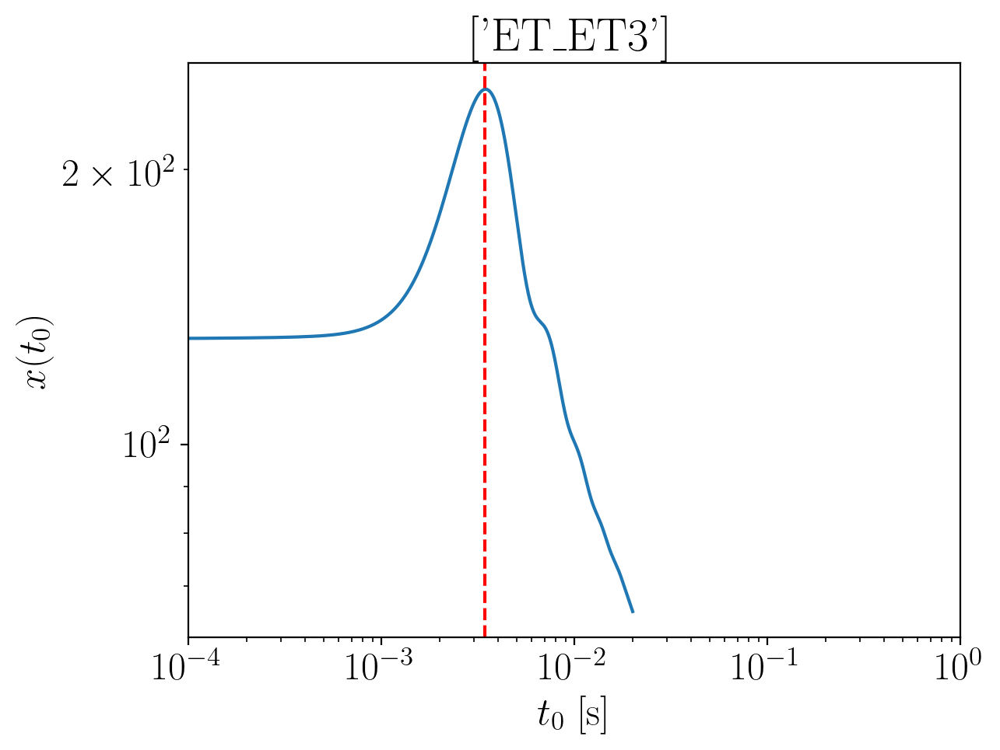

2024-01-15 15:46:53,088 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:53,102 - Network - INFO : PSDs loaded.
2024-01-15 15:46:53,104 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:53,110 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:53,117 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:53,139 - Network - INFO : Polarizations calculated.
2024-01-15 15:46:53,139 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:46:53,144 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.1734445606476513
Inner product:
0.9997116571025948


2024-01-15 15:46:58,533 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:46:58,578 - Network - INFO : PSDs loaded.
2024-01-15 15:46:58,584 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:46:58,602 - Network - INFO : Detector responses calculated.
2024-01-15 15:46:58,603 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:46:58,604 - Network - INFO :    CE-40_C
2024-01-15 15:47:02,222 - Network - INFO :    CE-20_S
2024-01-15 15:47:05,925 - Network - INFO :    ET_ET1
2024-01-15 15:47:09,559 - Network - INFO :    ET_ET2
2024-01-15 15:47:13,142 - Network - INFO :    ET_ET3
2024-01-15 15:47:16,766 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:47:16,773 - Network - INFO : SNRs calculated.
2024-01-15 15:47:16,774 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:47:16,774 - Network - INFO :    CE-40_C
2024-01-15 15:47:16,869 - Network - INFO :

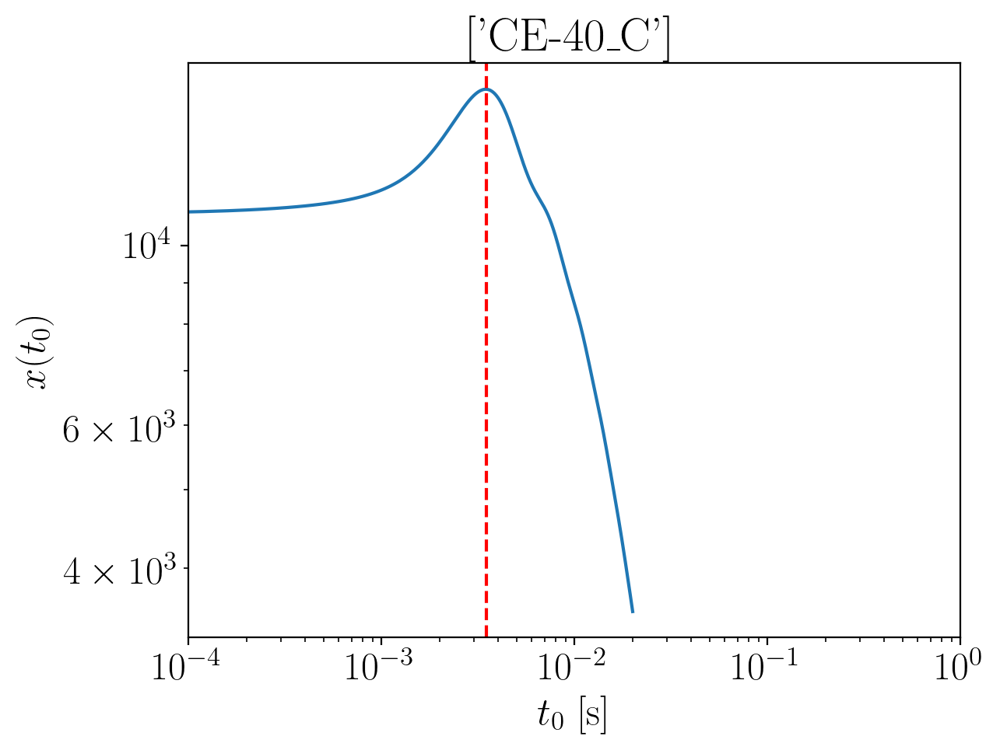

2024-01-15 15:47:18,790 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:18,797 - Network - INFO : PSDs loaded.
2024-01-15 15:47:18,799 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:18,805 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:18,811 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.1418523992495704
Inner product:
0.9998526214640118


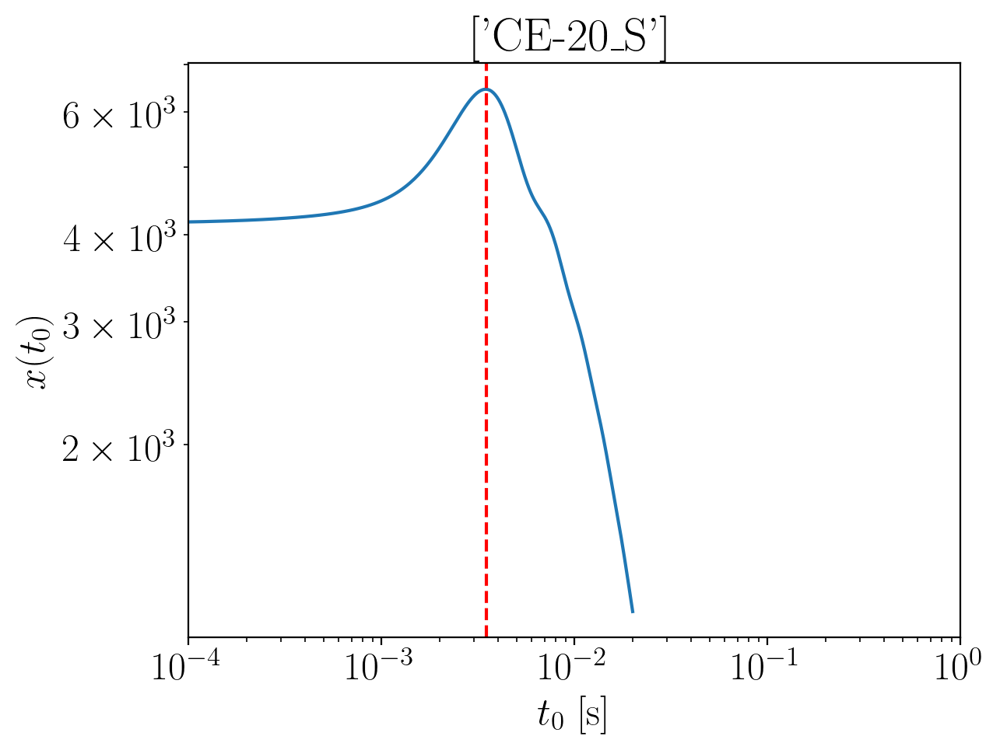

2024-01-15 15:47:19,948 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:19,955 - Network - INFO : PSDs loaded.
2024-01-15 15:47:19,957 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:19,963 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:19,969 - Network - INFO : Polarizations calculated.


time shift: 0.0034800000000000005
phase shift: -2.14231003891984
Inner product:
0.999804794399151


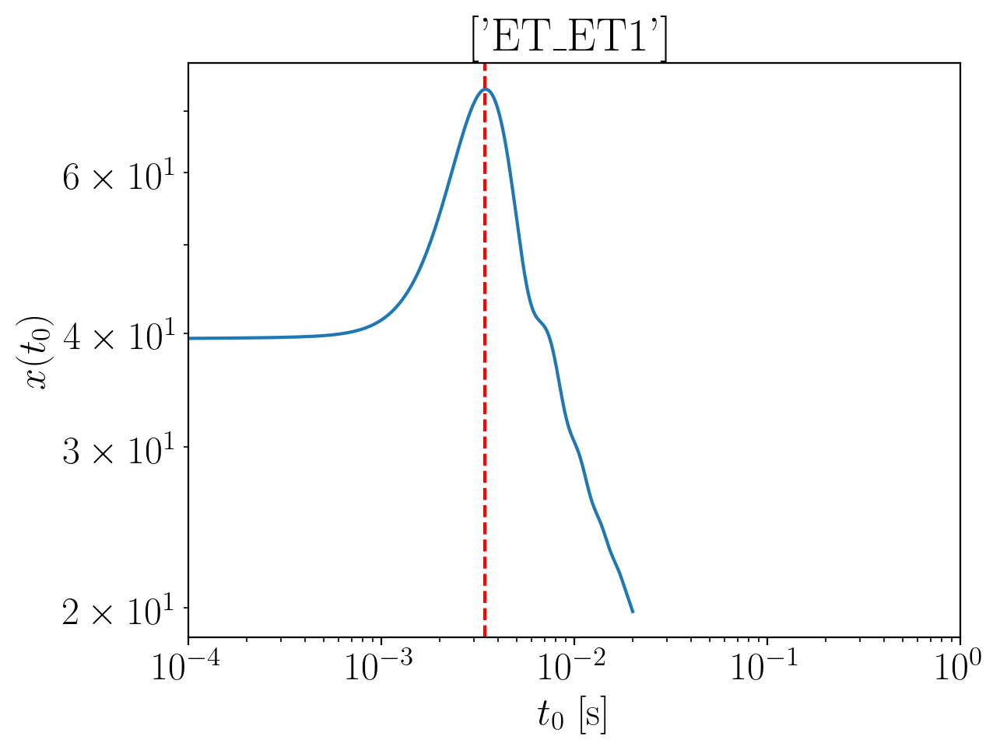

2024-01-15 15:47:21,400 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:21,417 - Network - INFO : PSDs loaded.
2024-01-15 15:47:21,419 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:21,426 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:21,433 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.1511334792298755
Inner product:
0.9997116571025946


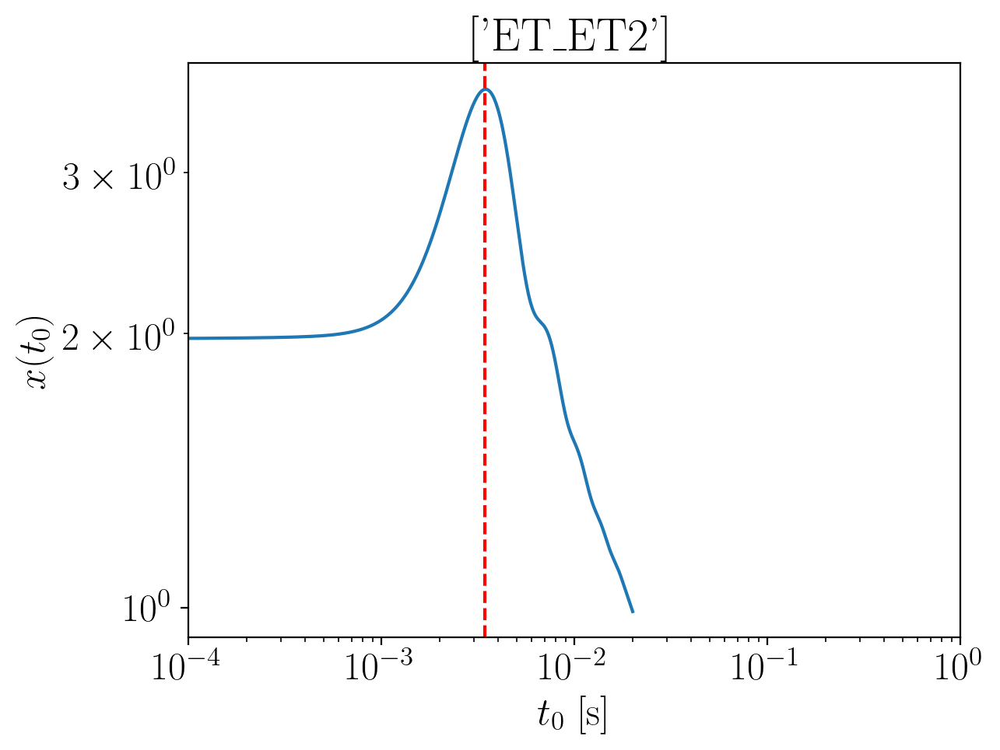

2024-01-15 15:47:22,883 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:22,898 - Network - INFO : PSDs loaded.
2024-01-15 15:47:22,900 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:22,906 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:22,913 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.151133479229875
Inner product:
0.9997116571025949


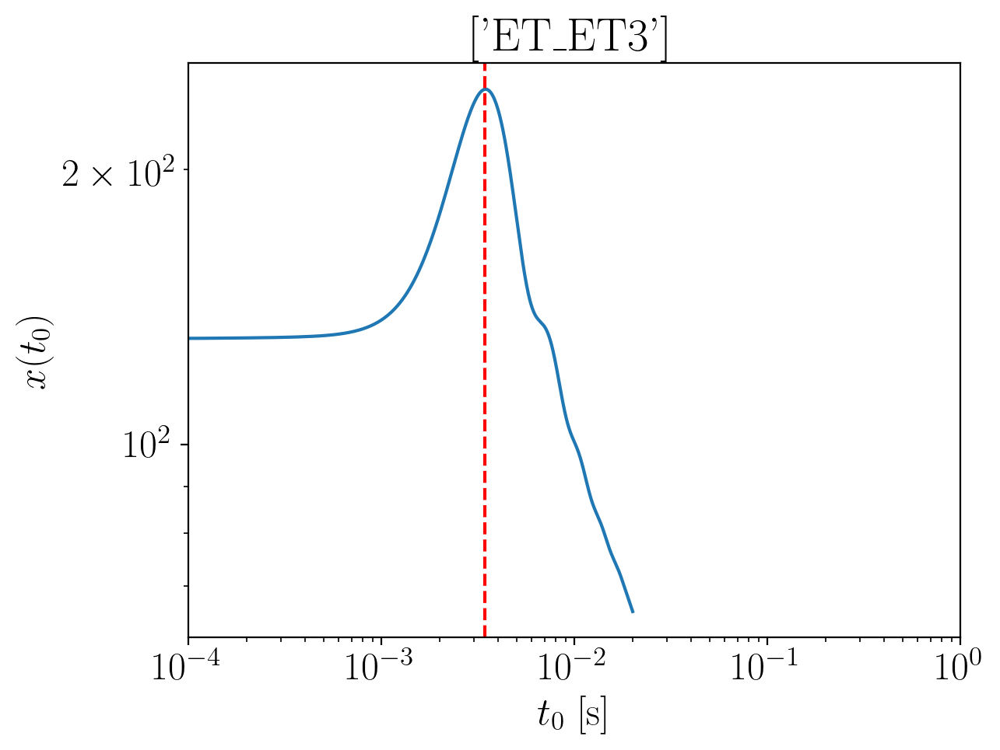

2024-01-15 15:47:24,360 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:24,376 - Network - INFO : PSDs loaded.
2024-01-15 15:47:24,378 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:24,386 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:24,393 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:24,418 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:24,419 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:47:24,425 - Network - INFO : Polarizations calculated.


time shift: 0.0034400000000000003
phase shift: -2.151133479229875
Inner product:
0.9997116571025947


2024-01-15 15:47:29,770 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:47:29,816 - Network - INFO : PSDs loaded.
2024-01-15 15:47:29,822 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:29,839 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:29,840 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:47:29,841 - Network - INFO :    CE-40_C
2024-01-15 15:47:33,417 - Network - INFO :    CE-20_S
2024-01-15 15:47:37,048 - Network - INFO :    ET_ET1
2024-01-15 15:47:40,609 - Network - INFO :    ET_ET2
2024-01-15 15:47:44,181 - Network - INFO :    ET_ET3
2024-01-15 15:47:47,778 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:47:47,785 - Network - INFO : SNRs calculated.
2024-01-15 15:47:47,785 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:47:47,786 - Network - INFO :    CE-40_C
2024-01-15 15:47:47,879 - Network - INFO :

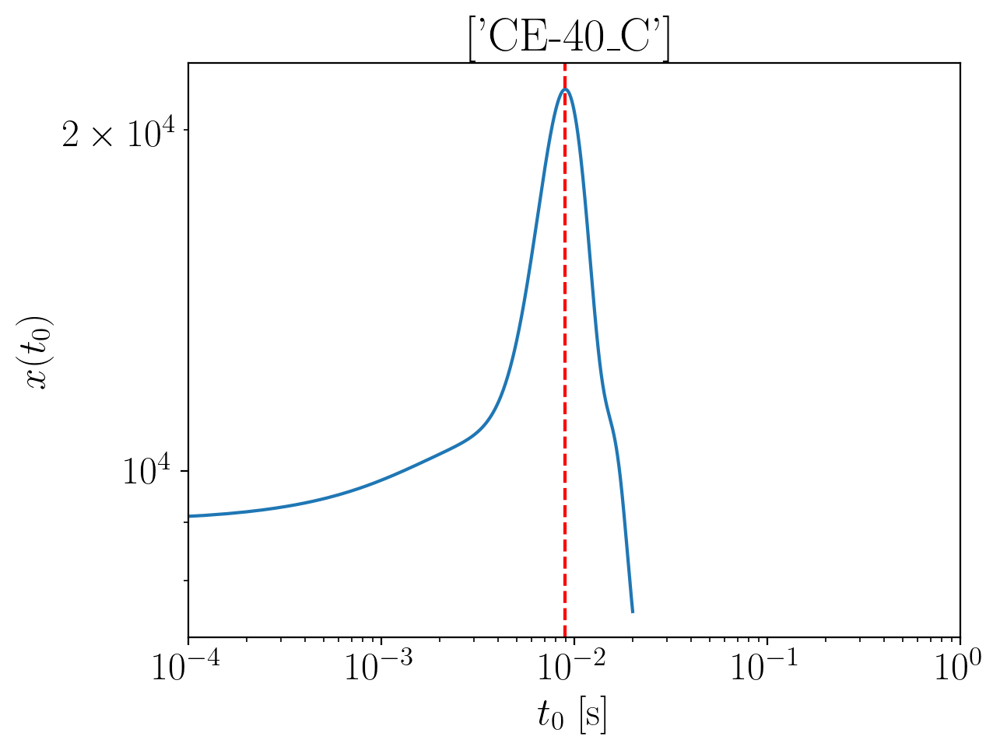

2024-01-15 15:47:50,488 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:50,495 - Network - INFO : PSDs loaded.
2024-01-15 15:47:50,497 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:50,502 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:50,507 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.096938017915899
Inner product:
0.999768371213703


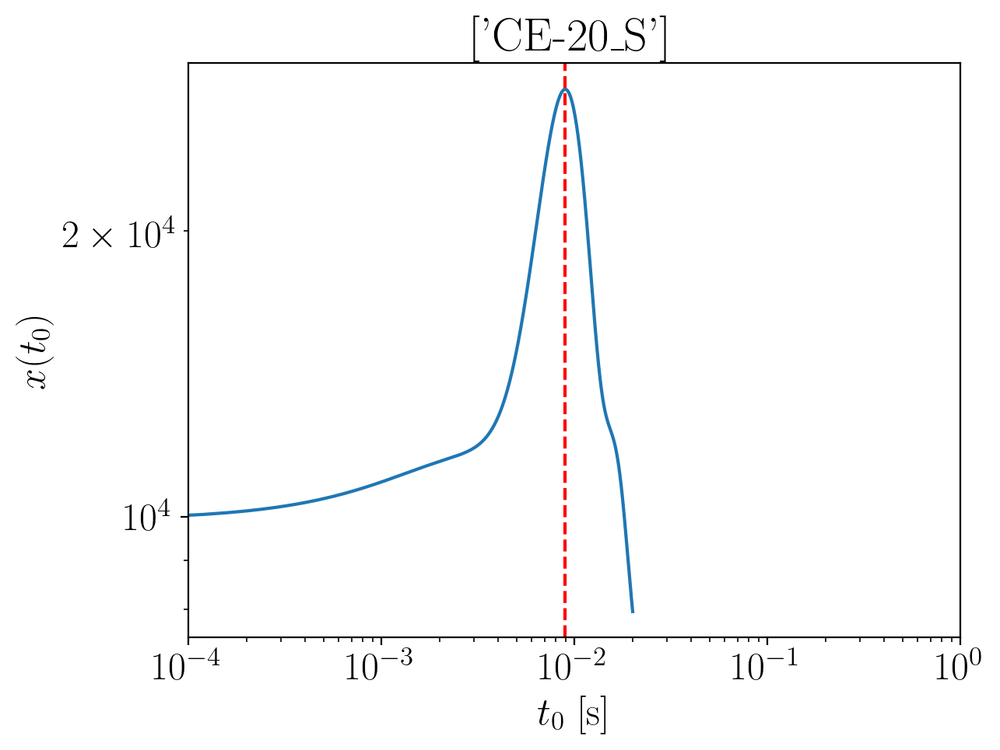

2024-01-15 15:47:51,907 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0980990666293367


2024-01-15 15:47:52,173 - Network - INFO : PSDs loaded.
2024-01-15 15:47:52,175 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:52,181 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:52,188 - Network - INFO : Polarizations calculated.


Inner product:
0.9997228330380603


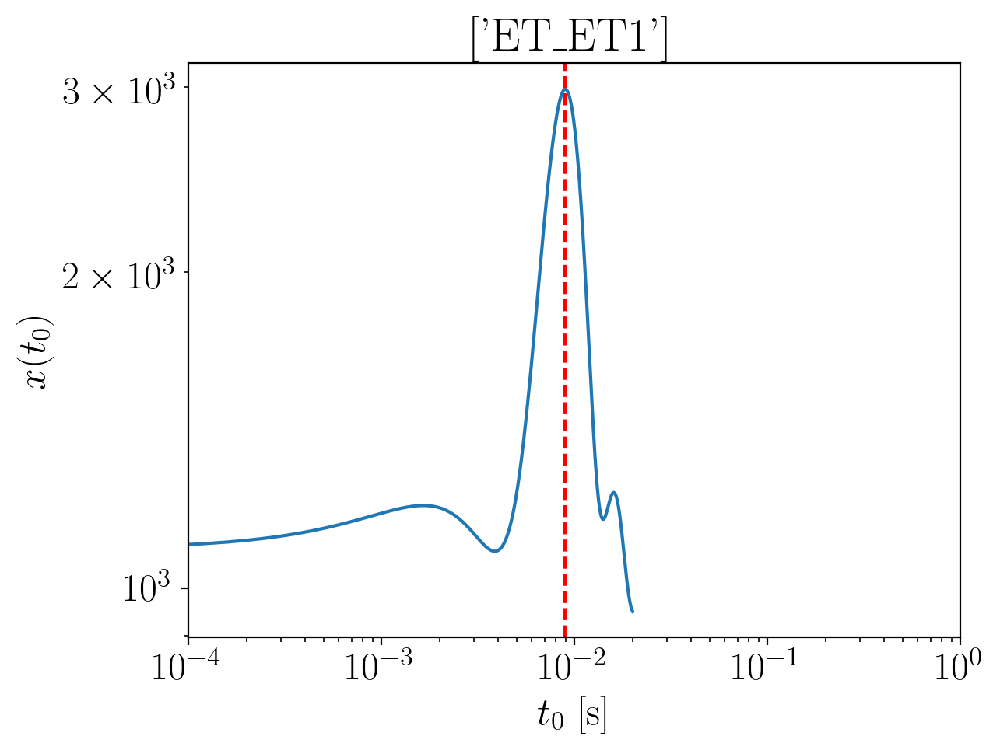

2024-01-15 15:47:53,760 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:53,773 - Network - INFO : PSDs loaded.
2024-01-15 15:47:53,775 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:53,781 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:53,787 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0931879887438924
Inner product:
0.9996783062037611


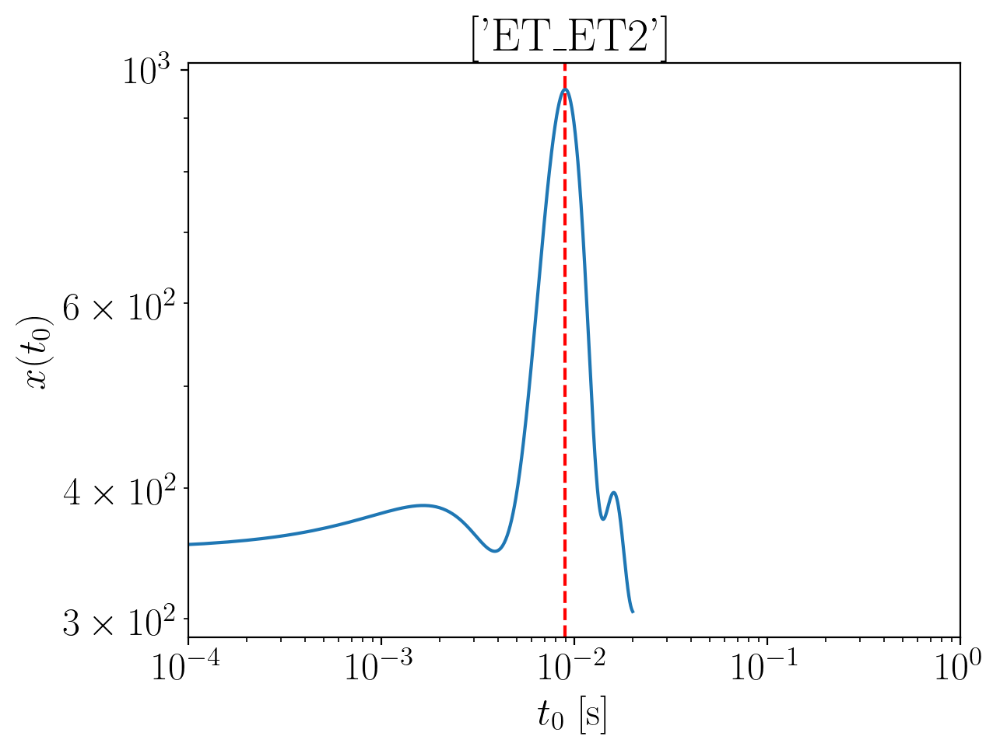

2024-01-15 15:47:55,403 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:55,417 - Network - INFO : PSDs loaded.
2024-01-15 15:47:55,419 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:55,424 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:55,429 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0931879887438924
Inner product:
0.9996783062037613


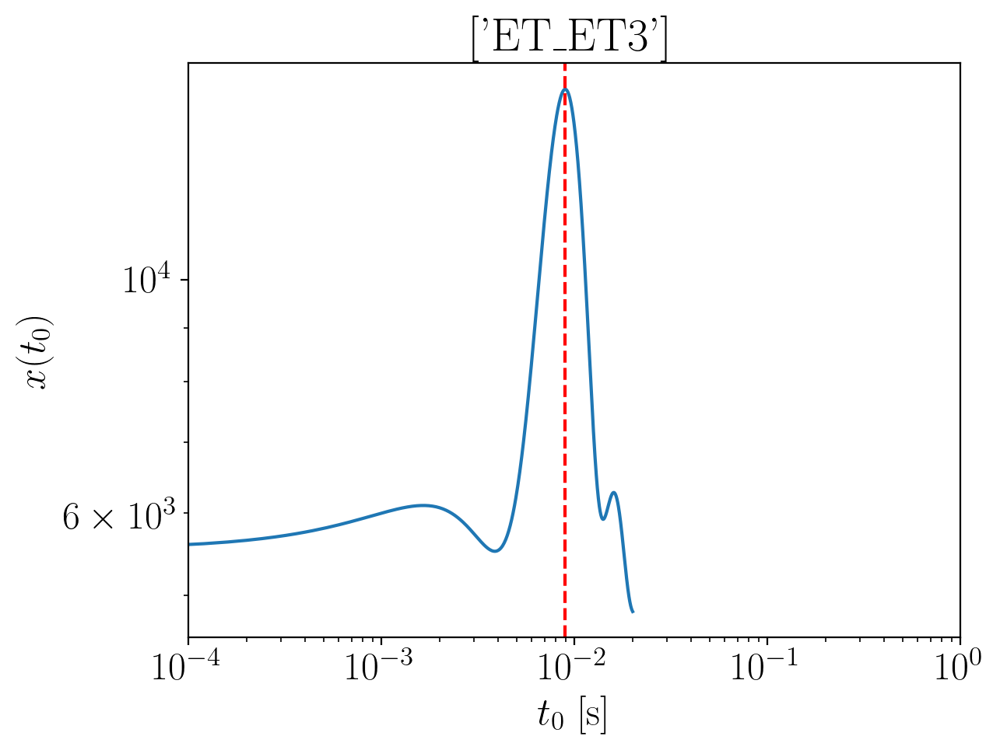

2024-01-15 15:47:56,979 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:56,993 - Network - INFO : PSDs loaded.
2024-01-15 15:47:56,995 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:47:57,000 - Network - INFO : Detector responses calculated.
2024-01-15 15:47:57,005 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:57,028 - Network - INFO : Polarizations calculated.
2024-01-15 15:47:57,029 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:47:57,033 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0931879887438924
Inner product:
0.9996783062037612


2024-01-15 15:48:02,480 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:48:02,523 - Network - INFO : PSDs loaded.
2024-01-15 15:48:02,529 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:02,544 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:02,545 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:48:02,546 - Network - INFO :    CE-40_C
2024-01-15 15:48:06,112 - Network - INFO :    CE-20_S
2024-01-15 15:48:09,696 - Network - INFO :    ET_ET1
2024-01-15 15:48:13,263 - Network - INFO :    ET_ET2
2024-01-15 15:48:16,850 - Network - INFO :    ET_ET3
2024-01-15 15:48:20,426 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:48:20,432 - Network - INFO : SNRs calculated.
2024-01-15 15:48:20,432 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:48:20,433 - Network - INFO :    CE-40_C
2024-01-15 15:48:20,526 - Network - INFO :

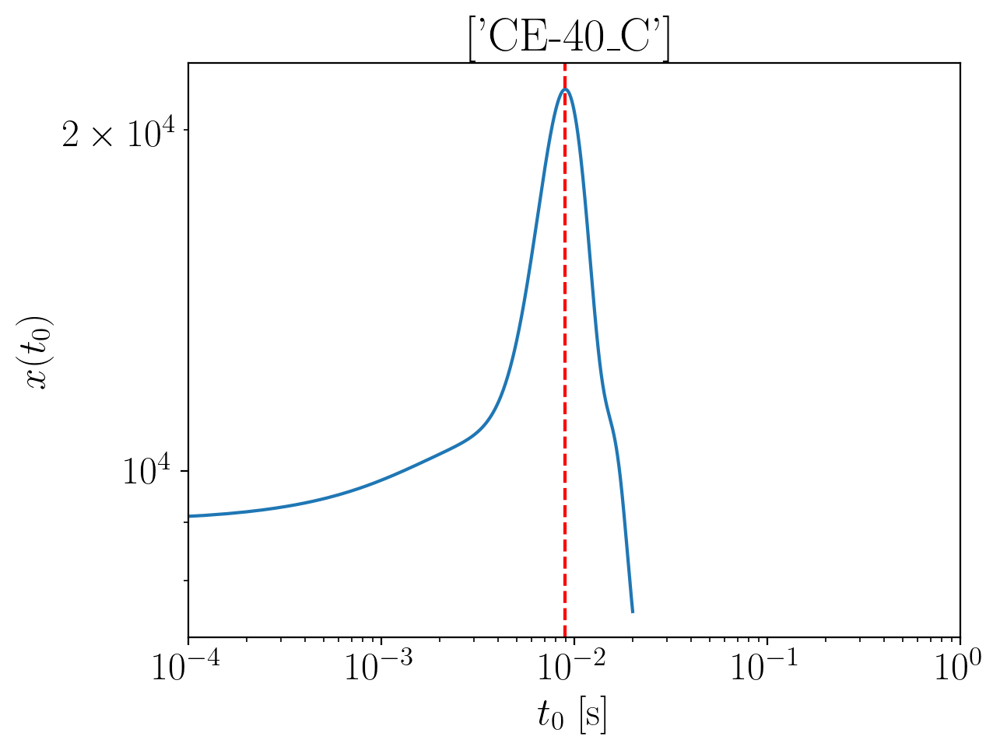

2024-01-15 15:48:22,269 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:22,284 - Network - INFO : PSDs loaded.
2024-01-15 15:48:22,286 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:22,291 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:22,296 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.37994478002851
Inner product:
0.9997683712137024


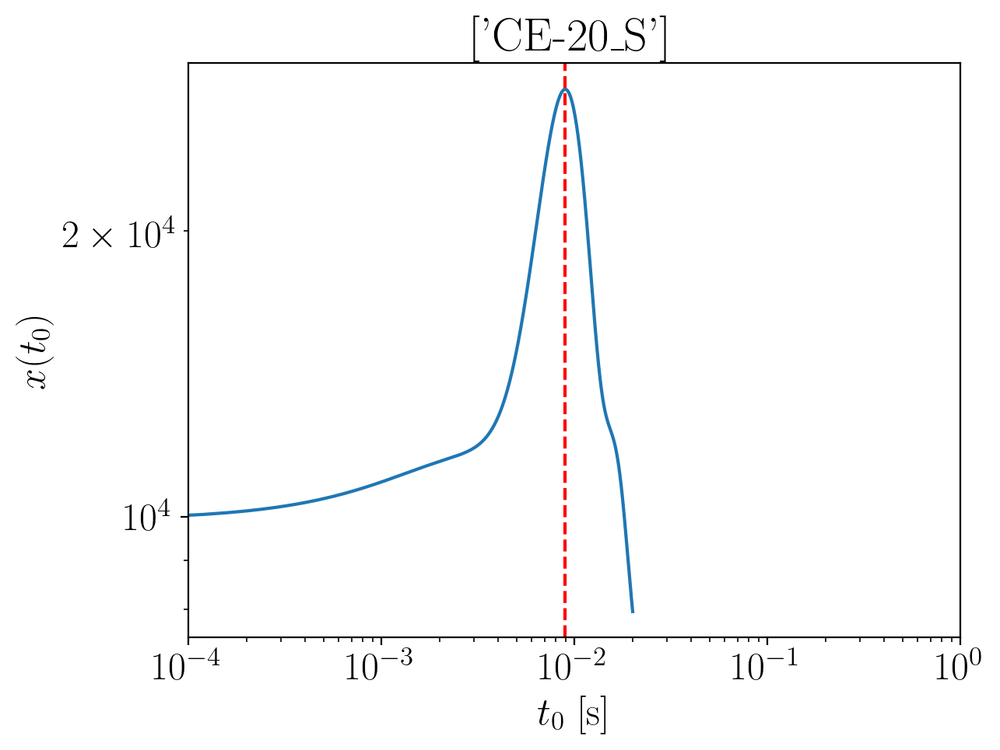

2024-01-15 15:48:23,433 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:23,440 - Network - INFO : PSDs loaded.
2024-01-15 15:48:23,442 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:23,448 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:23,454 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.381105828741951
Inner product:
0.9997228330380601


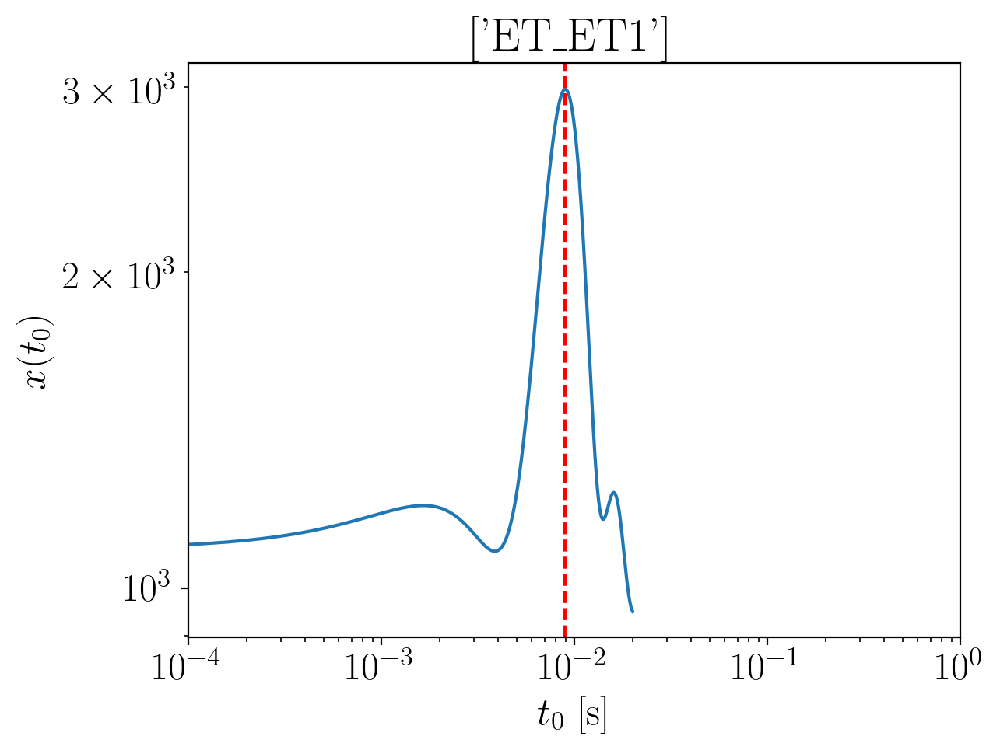

2024-01-15 15:48:24,827 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:24,840 - Network - INFO : PSDs loaded.
2024-01-15 15:48:24,842 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:24,848 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:24,852 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.372350520862263
Inner product:
0.9996783062037611


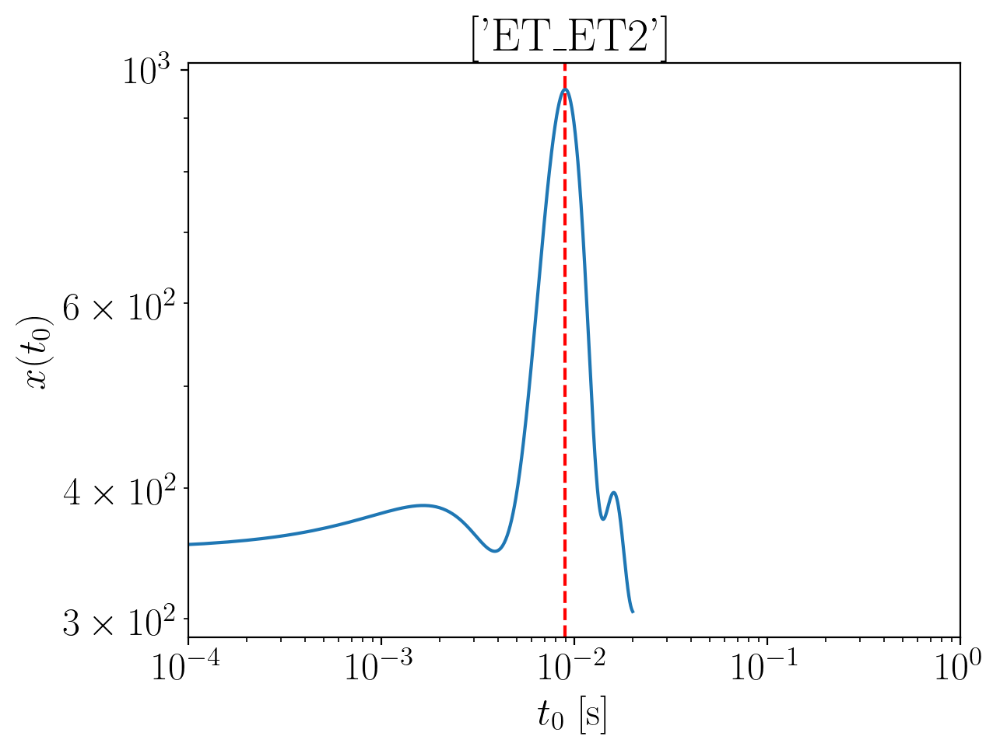

2024-01-15 15:48:26,284 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:26,298 - Network - INFO : PSDs loaded.
2024-01-15 15:48:26,300 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:26,306 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:26,311 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.372350520862263
Inner product:
0.999678306203761


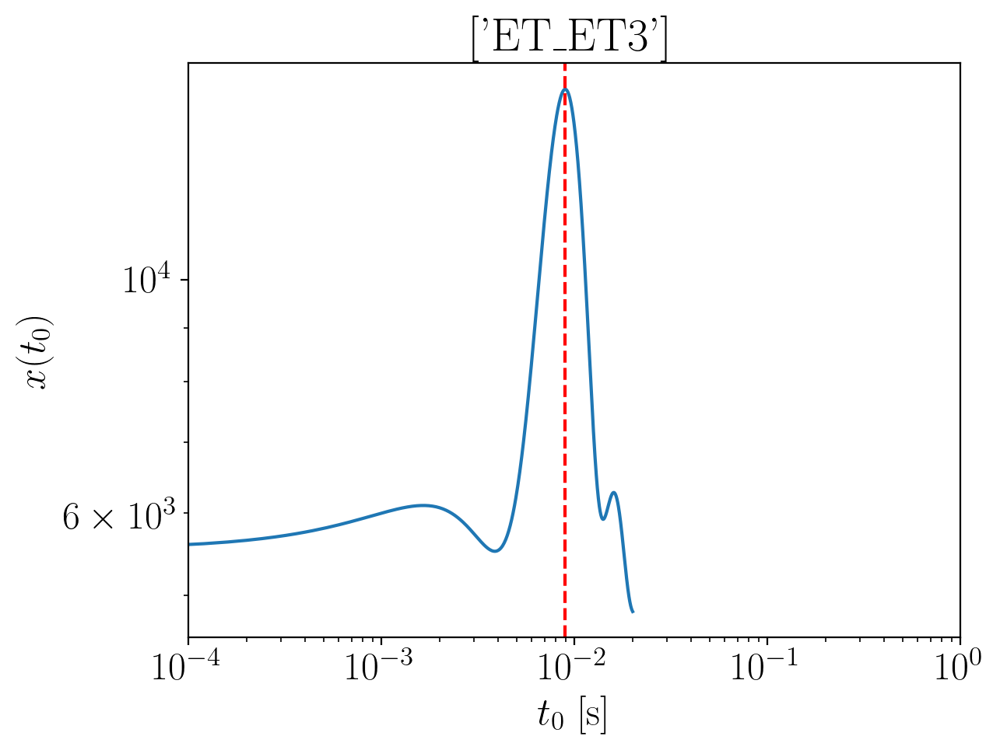

2024-01-15 15:48:27,820 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:27,834 - Network - INFO : PSDs loaded.
2024-01-15 15:48:27,836 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:27,842 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:27,846 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:27,869 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:27,870 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:48:27,874 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.372350520862263
Inner product:
0.999678306203761


2024-01-15 15:48:33,239 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:48:33,283 - Network - INFO : PSDs loaded.
2024-01-15 15:48:33,289 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:33,303 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:33,304 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:48:33,305 - Network - INFO :    CE-40_C
2024-01-15 15:48:36,849 - Network - INFO :    CE-20_S
2024-01-15 15:48:40,401 - Network - INFO :    ET_ET1
2024-01-15 15:48:44,003 - Network - INFO :    ET_ET2
2024-01-15 15:48:47,556 - Network - INFO :    ET_ET3
2024-01-15 15:48:51,111 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:48:51,117 - Network - INFO : SNRs calculated.
2024-01-15 15:48:51,118 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:48:51,118 - Network - INFO :    CE-40_C
2024-01-15 15:48:51,213 - Network - INFO :

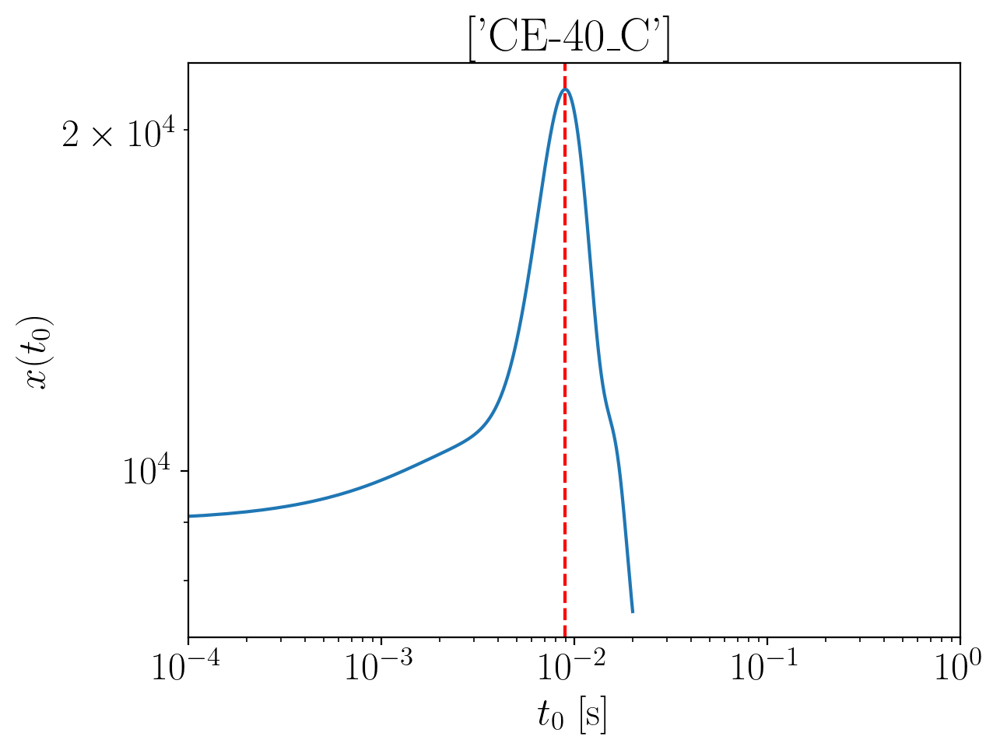

2024-01-15 15:48:52,963 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:52,974 - Network - INFO : PSDs loaded.
2024-01-15 15:48:52,978 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:52,984 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:52,990 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.299349184143456
Inner product:
0.9997683712137027


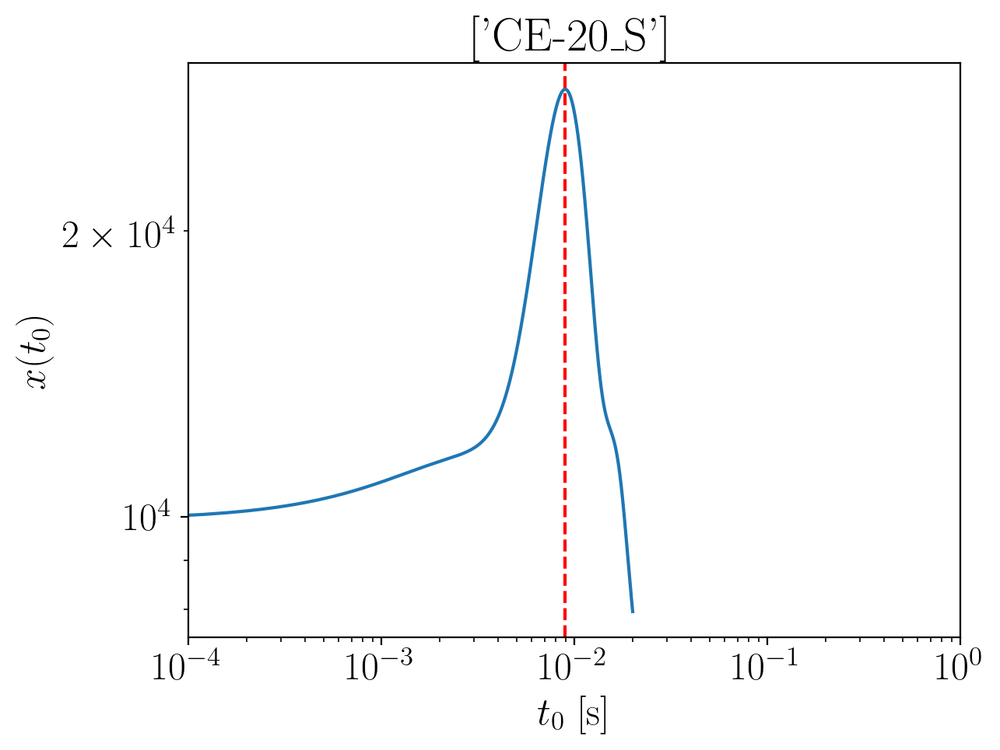

2024-01-15 15:48:54,136 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:54,144 - Network - INFO : PSDs loaded.
2024-01-15 15:48:54,146 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:54,151 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:54,156 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.300510232856894
Inner product:
0.9997228330380603


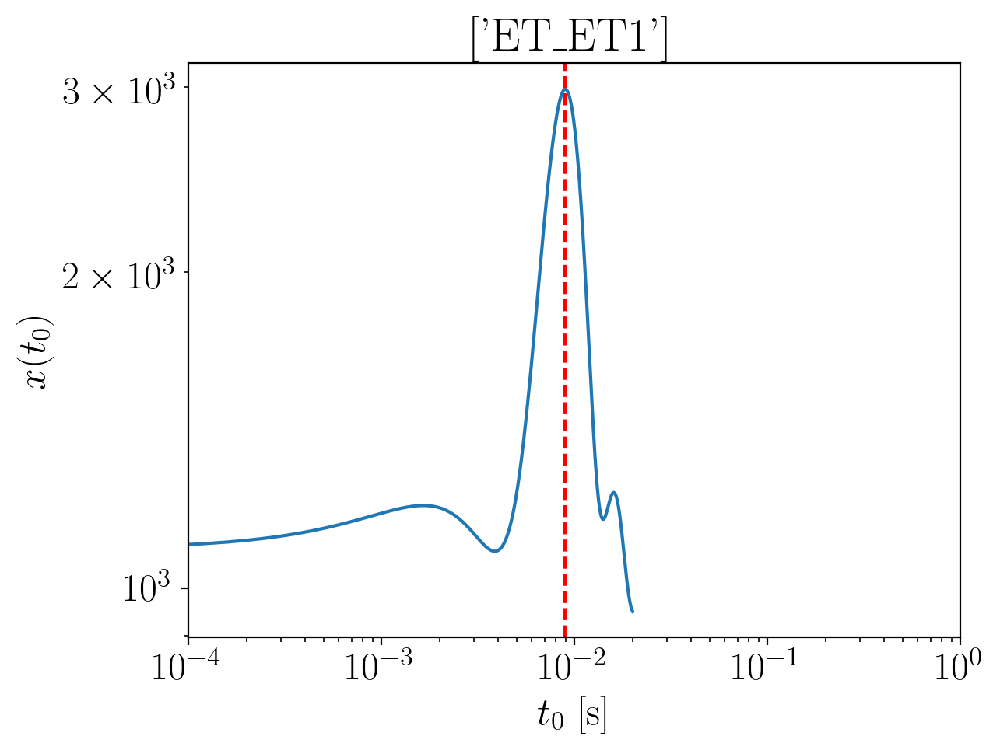

2024-01-15 15:48:55,527 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:55,545 - Network - INFO : PSDs loaded.
2024-01-15 15:48:55,547 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:55,552 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:55,559 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.291754924977227
Inner product:
0.9996783062037612


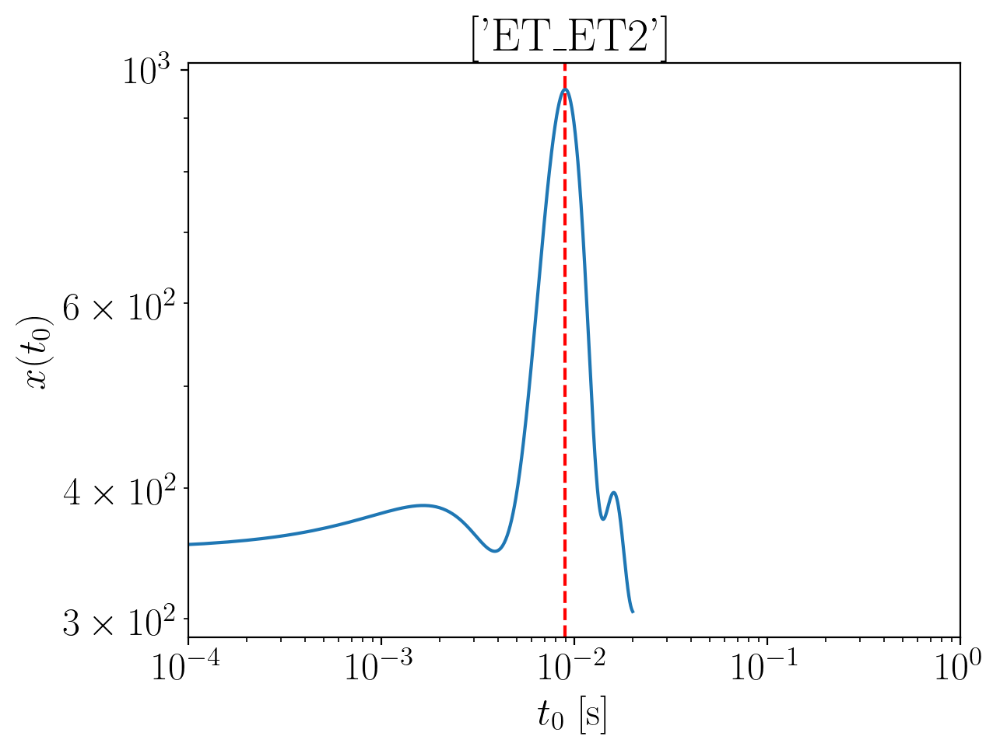

2024-01-15 15:48:56,995 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:57,015 - Network - INFO : PSDs loaded.
2024-01-15 15:48:57,020 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:57,037 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:57,045 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.291754924977227
Inner product:
0.9996783062037611


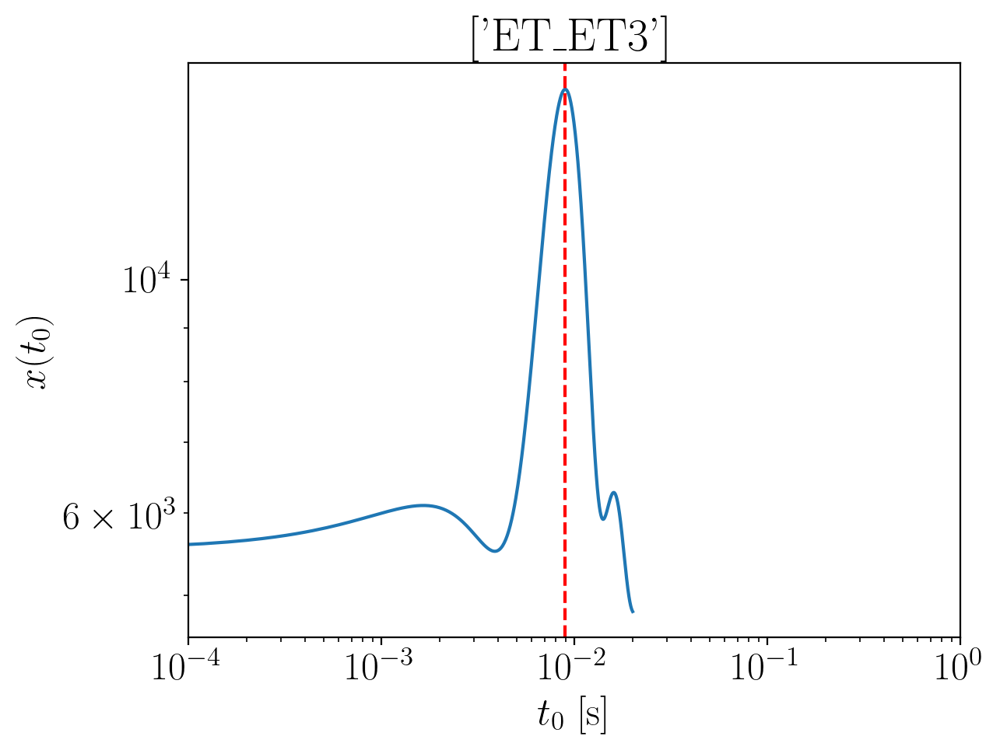

2024-01-15 15:48:58,447 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:58,461 - Network - INFO : PSDs loaded.
2024-01-15 15:48:58,463 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:48:58,471 - Network - INFO : Detector responses calculated.
2024-01-15 15:48:58,477 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:58,499 - Network - INFO : Polarizations calculated.
2024-01-15 15:48:58,500 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:48:58,504 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.291754924977227
Inner product:
0.9996783062037611


2024-01-15 15:49:03,793 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:49:03,838 - Network - INFO : PSDs loaded.
2024-01-15 15:49:03,844 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:03,858 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:03,859 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:49:03,860 - Network - INFO :    CE-40_C
2024-01-15 15:49:07,440 - Network - INFO :    CE-20_S
2024-01-15 15:49:11,019 - Network - INFO :    ET_ET1
2024-01-15 15:49:14,582 - Network - INFO :    ET_ET2
2024-01-15 15:49:18,254 - Network - INFO :    ET_ET3
2024-01-15 15:49:21,825 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:49:21,832 - Network - INFO : SNRs calculated.
2024-01-15 15:49:21,832 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:49:21,833 - Network - INFO :    CE-40_C
2024-01-15 15:49:21,928 - Network - INFO :

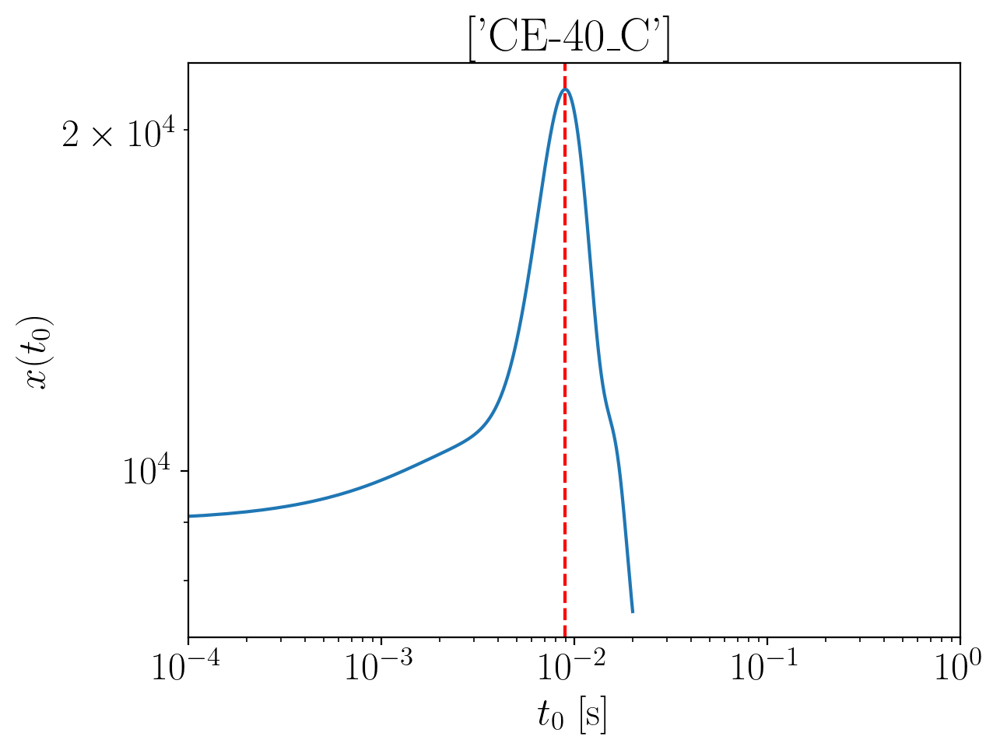

2024-01-15 15:49:24,575 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:24,584 - Network - INFO : PSDs loaded.
2024-01-15 15:49:24,586 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:24,596 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:24,602 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.2288932970482778
Inner product:
0.9997683712137027


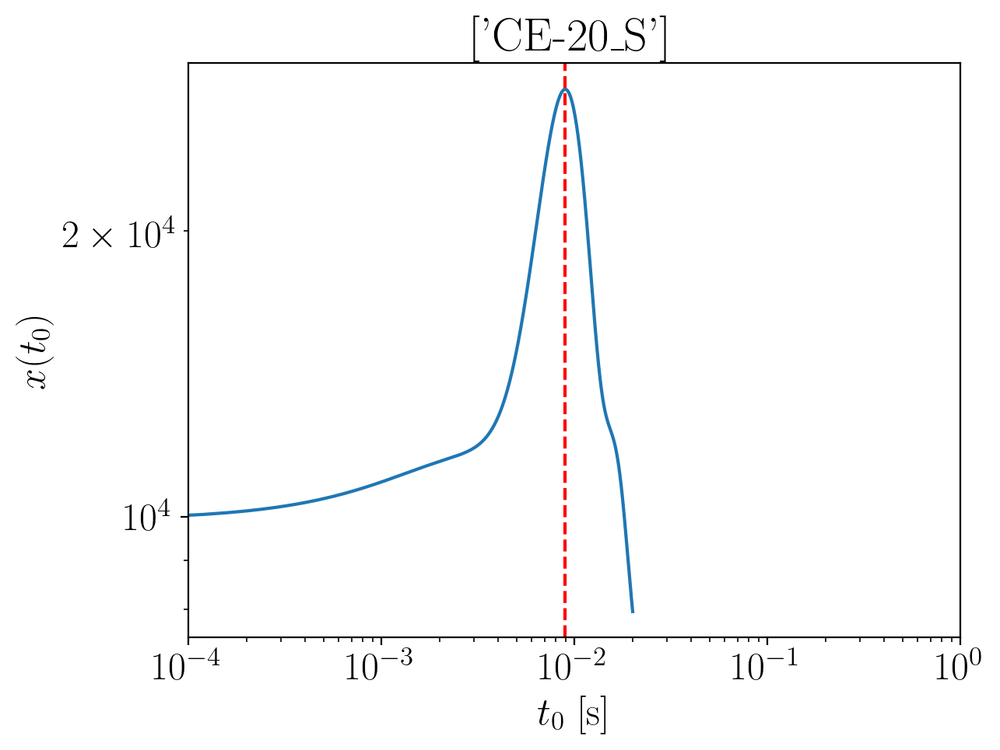

2024-01-15 15:49:26,012 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:26,021 - Network - INFO : PSDs loaded.
2024-01-15 15:49:26,024 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:26,031 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:26,038 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.230054345761715
Inner product:
0.9997228330380603


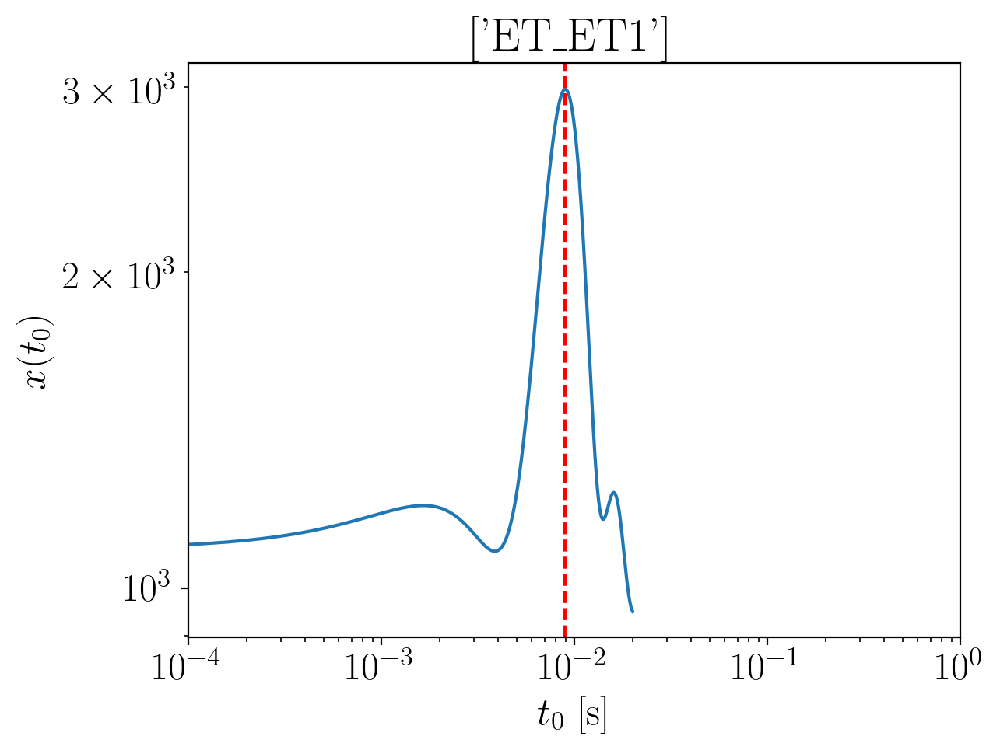

2024-01-15 15:49:27,701 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:27,715 - Network - INFO : PSDs loaded.
2024-01-15 15:49:27,717 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:27,723 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:27,728 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.2212990378820425
Inner product:
0.9996783062037611


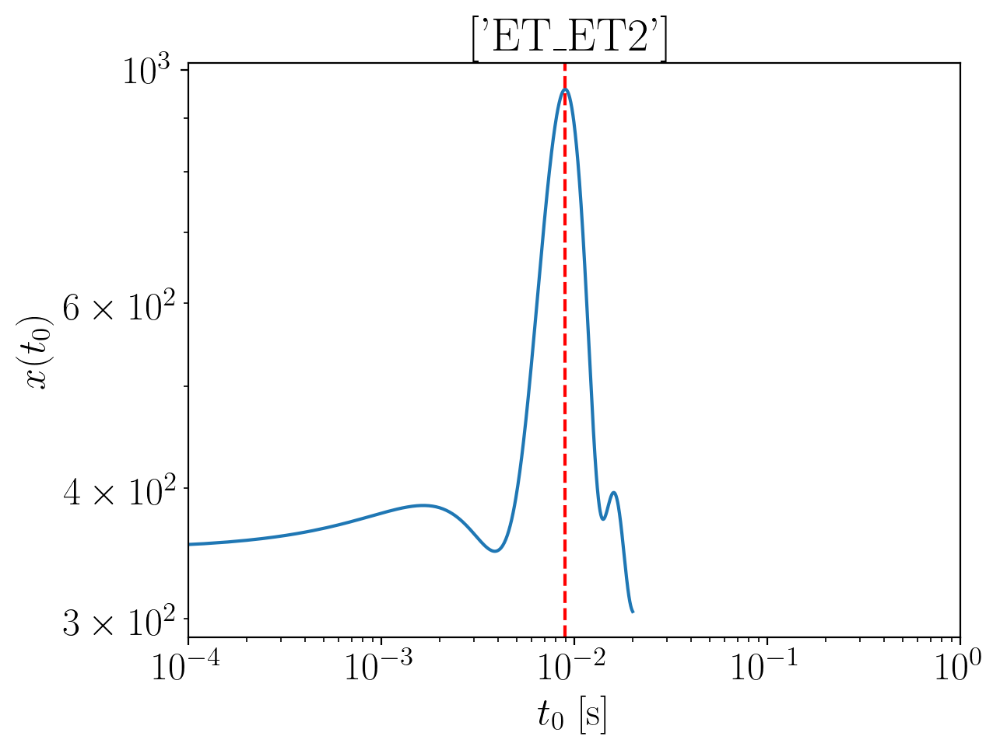

2024-01-15 15:49:29,286 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:29,300 - Network - INFO : PSDs loaded.
2024-01-15 15:49:29,302 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:29,313 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:29,319 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.221299037882043
Inner product:
0.9996783062037611


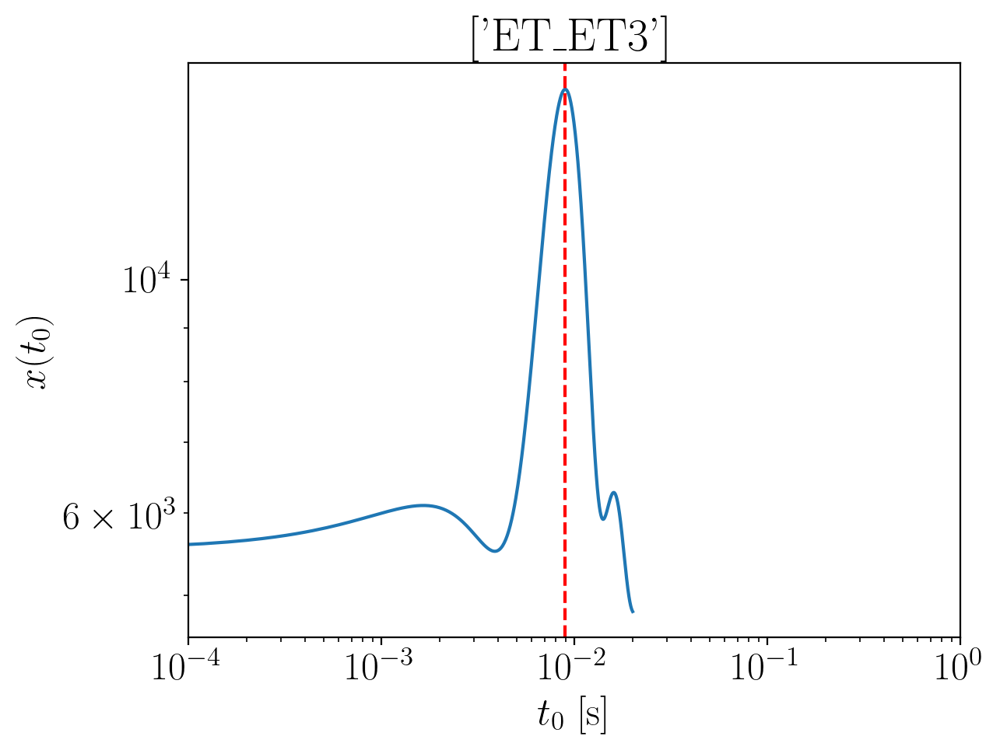

2024-01-15 15:49:30,907 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:30,921 - Network - INFO : PSDs loaded.
2024-01-15 15:49:30,922 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:30,928 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:30,933 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:30,955 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:30,955 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:49:30,959 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.2212990378820425
Inner product:
0.9996783062037612


2024-01-15 15:49:36,546 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:49:36,592 - Network - INFO : PSDs loaded.
2024-01-15 15:49:36,597 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:36,613 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:36,614 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:49:36,615 - Network - INFO :    CE-40_C
2024-01-15 15:49:40,272 - Network - INFO :    CE-20_S
2024-01-15 15:49:43,876 - Network - INFO :    ET_ET1
2024-01-15 15:49:47,441 - Network - INFO :    ET_ET2
2024-01-15 15:49:51,027 - Network - INFO :    ET_ET3
2024-01-15 15:49:54,602 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:49:54,608 - Network - INFO : SNRs calculated.
2024-01-15 15:49:54,608 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:49:54,609 - Network - INFO :    CE-40_C
2024-01-15 15:49:54,702 - Network - INFO :

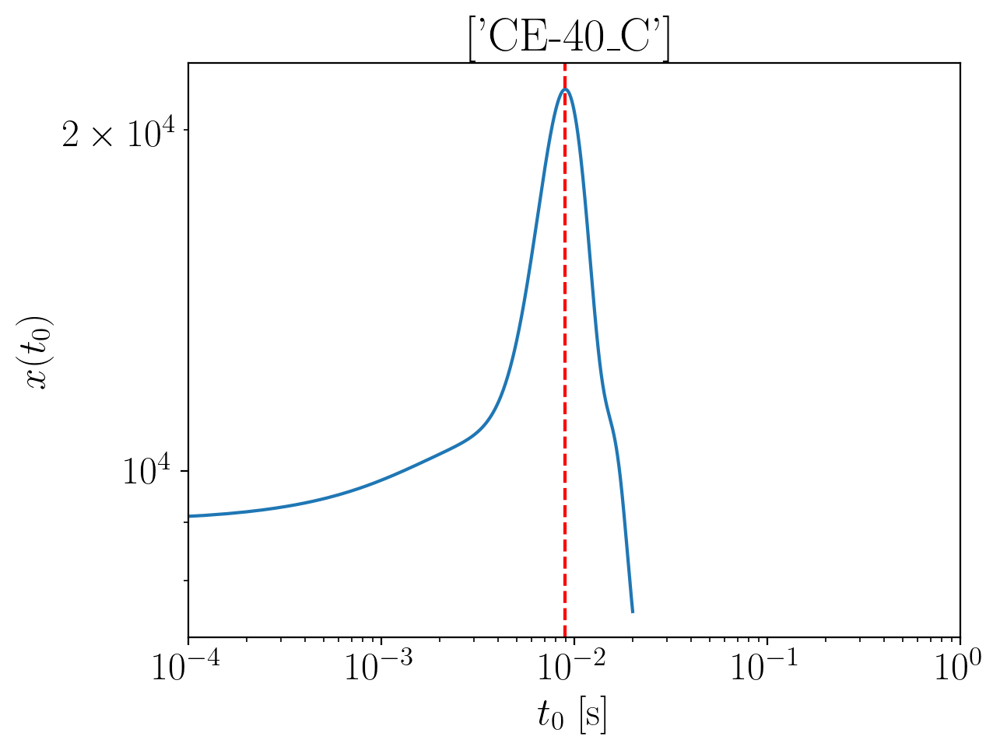

2024-01-15 15:49:56,409 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:56,420 - Network - INFO : PSDs loaded.
2024-01-15 15:49:56,437 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:56,453 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:56,460 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.1633926911945442
Inner product:
0.9997683712137027


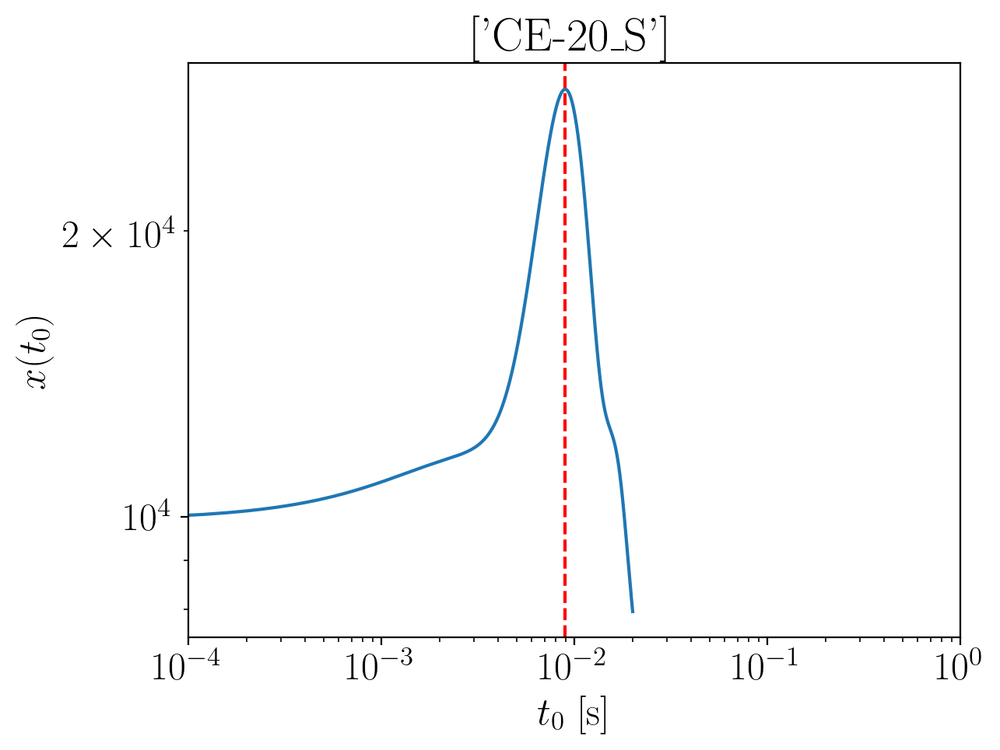

2024-01-15 15:49:57,635 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:57,644 - Network - INFO : PSDs loaded.
2024-01-15 15:49:57,646 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:57,651 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:57,656 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.1645537399079813
Inner product:
0.9997228330380603


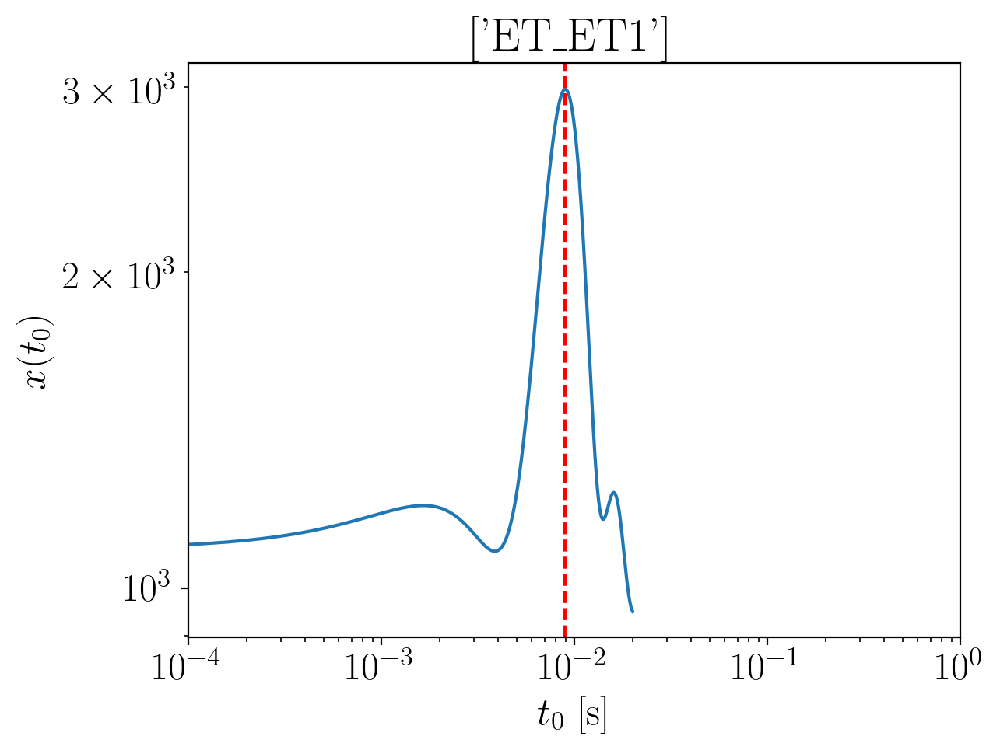

2024-01-15 15:49:59,195 - Network - INFO : Polarizations calculated.
2024-01-15 15:49:59,208 - Network - INFO : PSDs loaded.
2024-01-15 15:49:59,211 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:49:59,216 - Network - INFO : Detector responses calculated.
2024-01-15 15:49:59,221 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.1557984320283126
Inner product:
0.9996783062037612


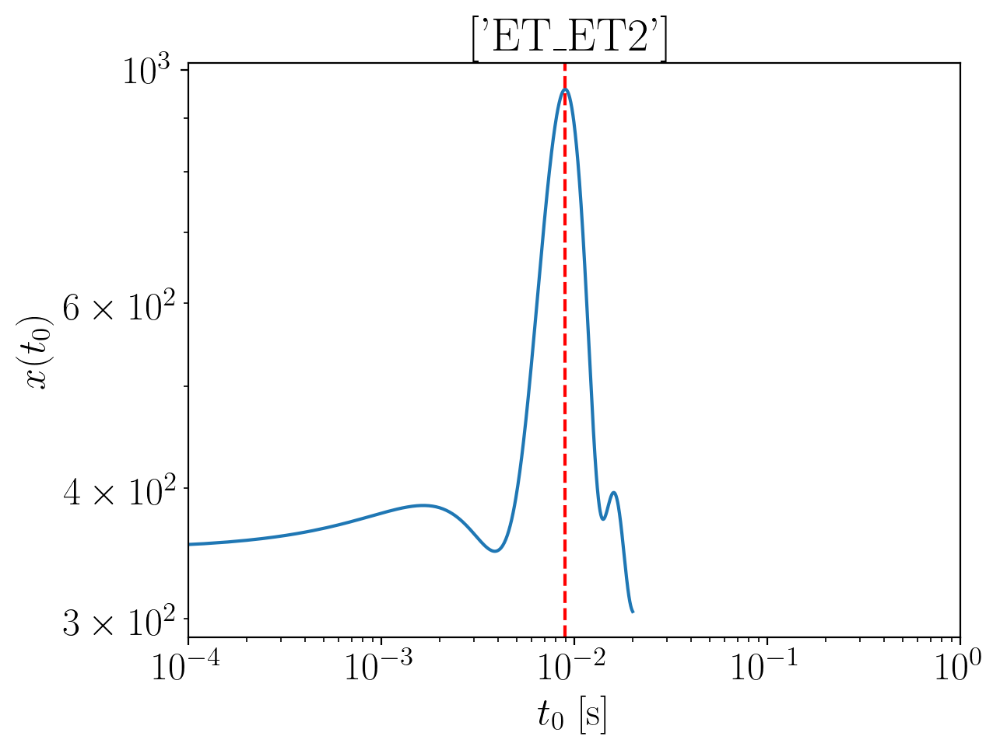

2024-01-15 15:50:00,620 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:00,634 - Network - INFO : PSDs loaded.
2024-01-15 15:50:00,637 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:00,643 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:00,648 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.155798432028313
Inner product:
0.9996783062037613


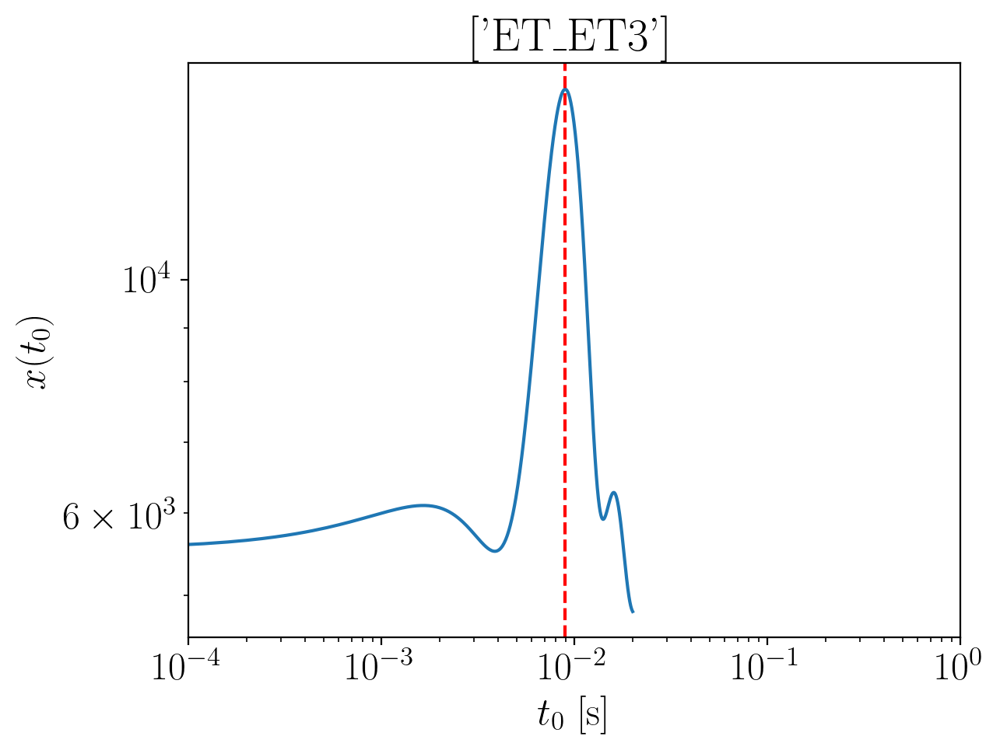

2024-01-15 15:50:02,107 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:02,121 - Network - INFO : PSDs loaded.
2024-01-15 15:50:02,124 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:02,129 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:02,134 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:02,157 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:02,157 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:50:02,161 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.1557984320283126
Inner product:
0.999678306203761


2024-01-15 15:50:07,527 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:50:07,572 - Network - INFO : PSDs loaded.
2024-01-15 15:50:07,577 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:07,592 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:07,593 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:50:07,593 - Network - INFO :    CE-40_C
2024-01-15 15:50:11,158 - Network - INFO :    CE-20_S
2024-01-15 15:50:14,753 - Network - INFO :    ET_ET1
2024-01-15 15:50:18,304 - Network - INFO :    ET_ET2
2024-01-15 15:50:21,877 - Network - INFO :    ET_ET3
2024-01-15 15:50:25,462 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:50:25,468 - Network - INFO : SNRs calculated.
2024-01-15 15:50:25,469 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:50:25,470 - Network - INFO :    CE-40_C
2024-01-15 15:50:25,566 - Network - INFO :

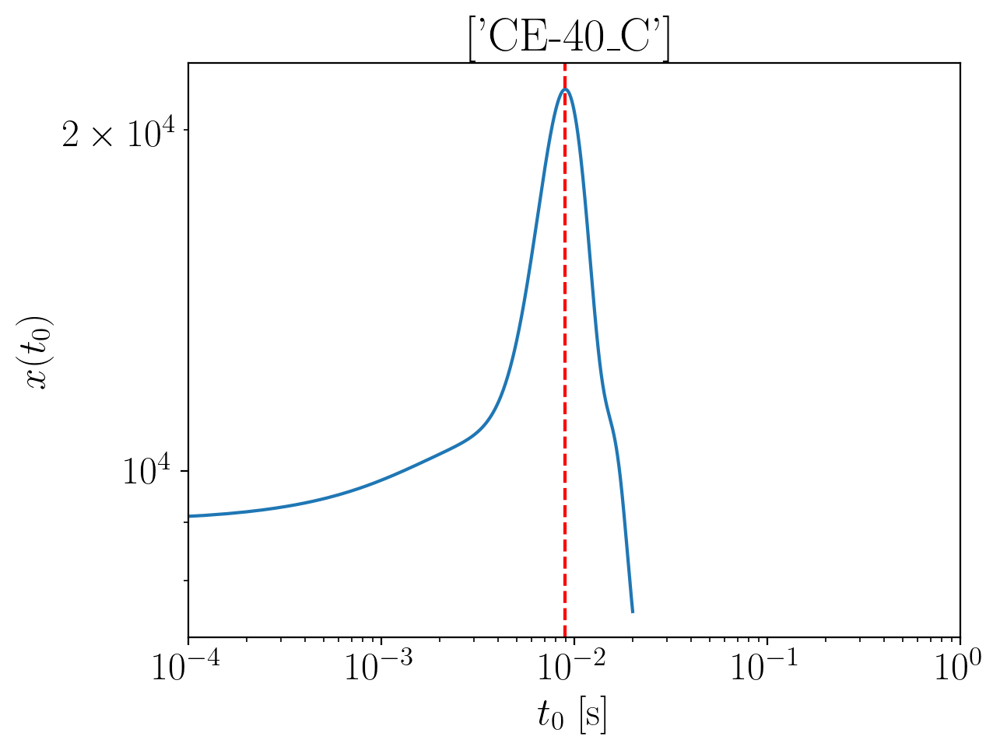

2024-01-15 15:50:27,271 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:27,281 - Network - INFO : PSDs loaded.
2024-01-15 15:50:27,287 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:27,310 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:27,320 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.100782247910125
Inner product:
0.999768371213703


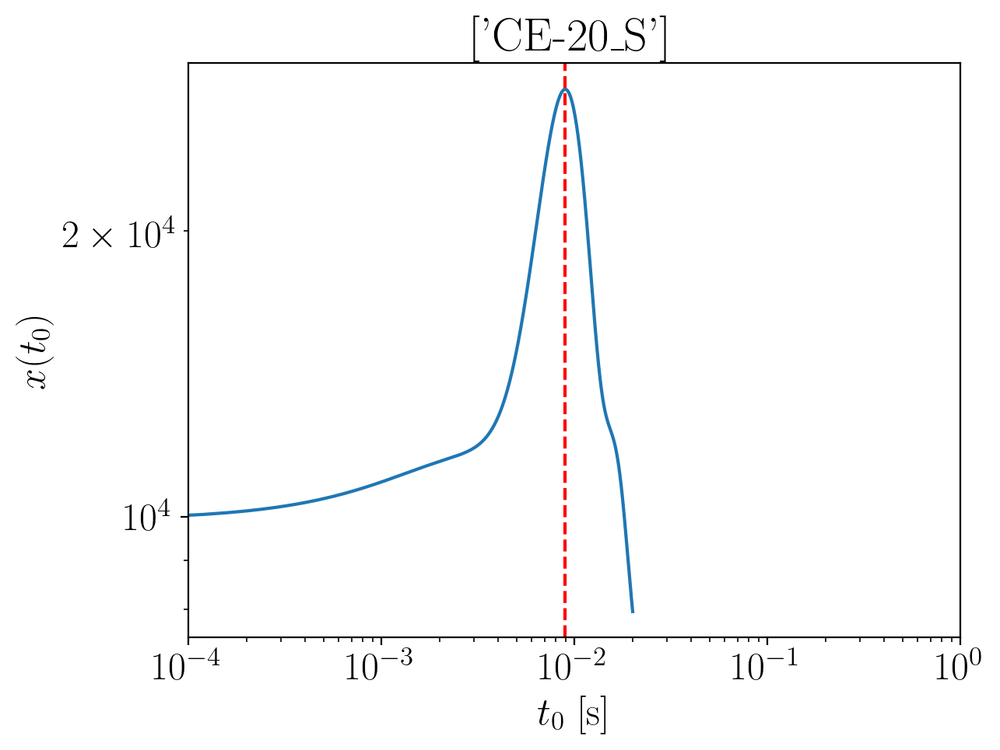

2024-01-15 15:50:28,470 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:28,476 - Network - INFO : PSDs loaded.
2024-01-15 15:50:28,478 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:28,483 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:28,488 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.1019432966235625
Inner product:
0.9997228330380603


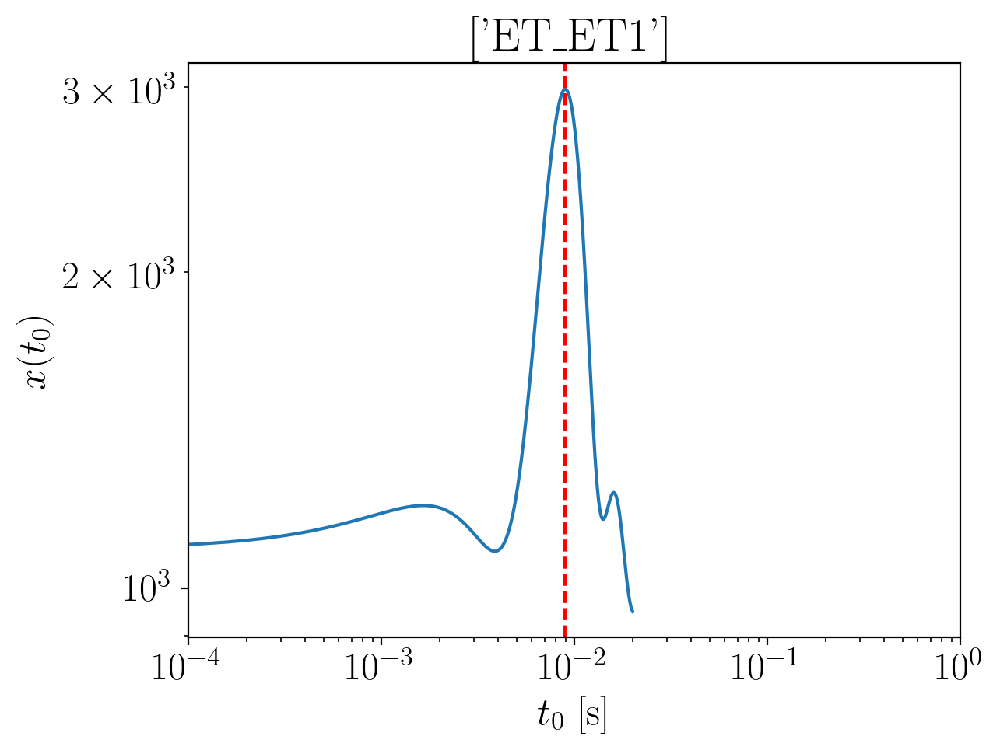

2024-01-15 15:50:29,868 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:29,882 - Network - INFO : PSDs loaded.
2024-01-15 15:50:29,885 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:29,892 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:29,898 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0931879887438924
Inner product:
0.9996783062037611


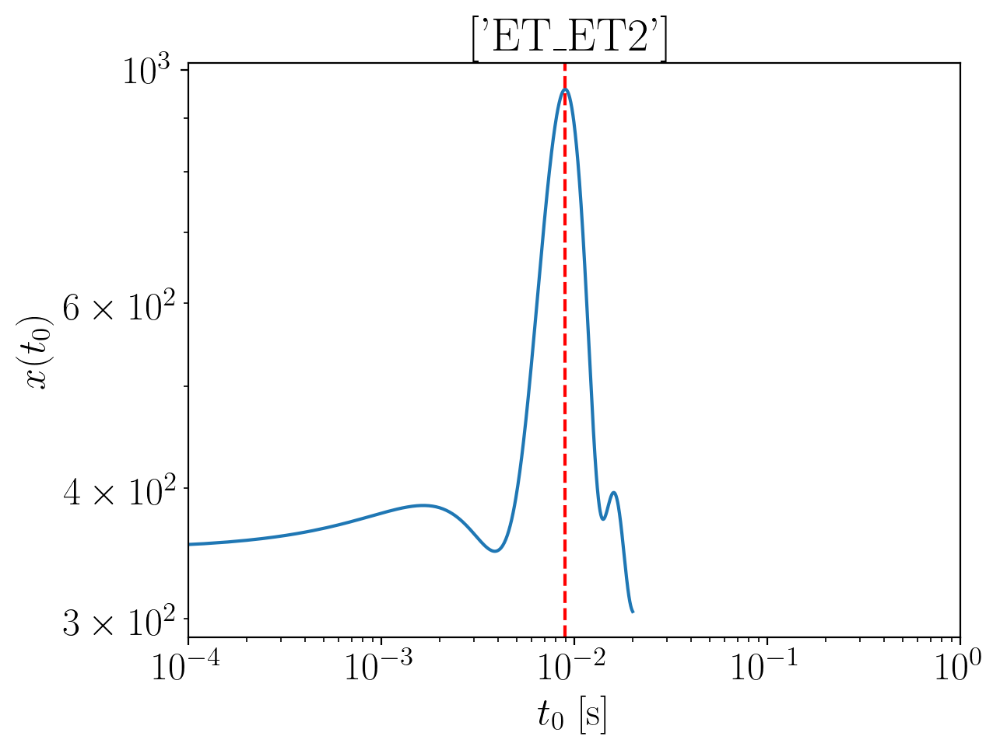

2024-01-15 15:50:31,312 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:31,455 - Network - INFO : PSDs loaded.
2024-01-15 15:50:31,457 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:31,463 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:31,468 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0931879887438924
Inner product:
0.9996783062037613


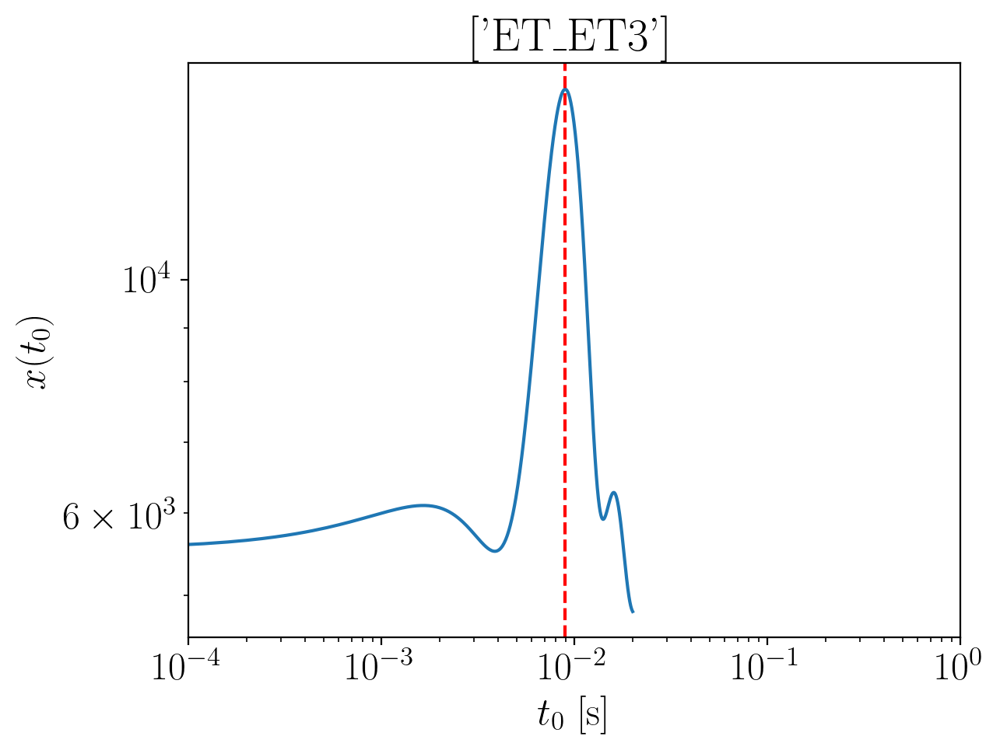

2024-01-15 15:50:32,848 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:32,863 - Network - INFO : PSDs loaded.
2024-01-15 15:50:32,865 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:32,871 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:32,879 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:32,902 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:32,903 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:50:32,907 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0931879887438924
Inner product:
0.9996783062037612


2024-01-15 15:50:38,195 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:50:38,240 - Network - INFO : PSDs loaded.
2024-01-15 15:50:38,246 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:38,261 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:38,262 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:50:38,262 - Network - INFO :    CE-40_C
2024-01-15 15:50:41,804 - Network - INFO :    CE-20_S
2024-01-15 15:50:45,358 - Network - INFO :    ET_ET1
2024-01-15 15:50:48,904 - Network - INFO :    ET_ET2
2024-01-15 15:50:52,515 - Network - INFO :    ET_ET3
2024-01-15 15:50:56,052 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:50:56,058 - Network - INFO : SNRs calculated.
2024-01-15 15:50:56,059 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:50:56,059 - Network - INFO :    CE-40_C
2024-01-15 15:50:56,153 - Network - INFO :

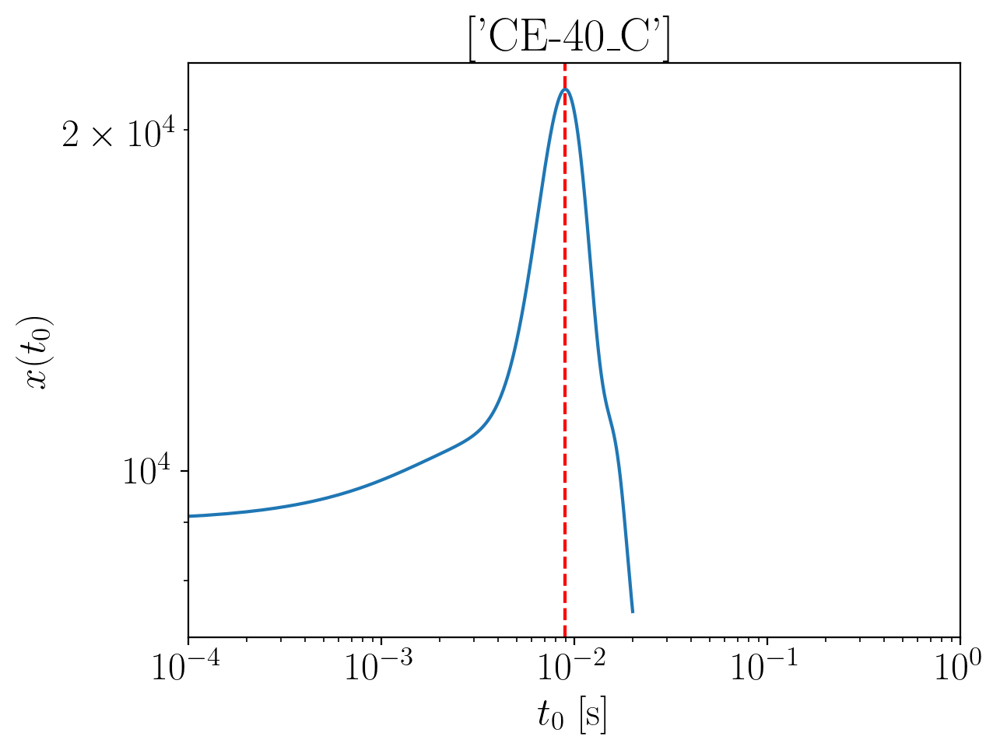

2024-01-15 15:50:57,894 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:57,912 - Network - INFO : PSDs loaded.
2024-01-15 15:50:57,915 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:57,926 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:57,931 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0400088062113757
Inner product:
0.999768371213703


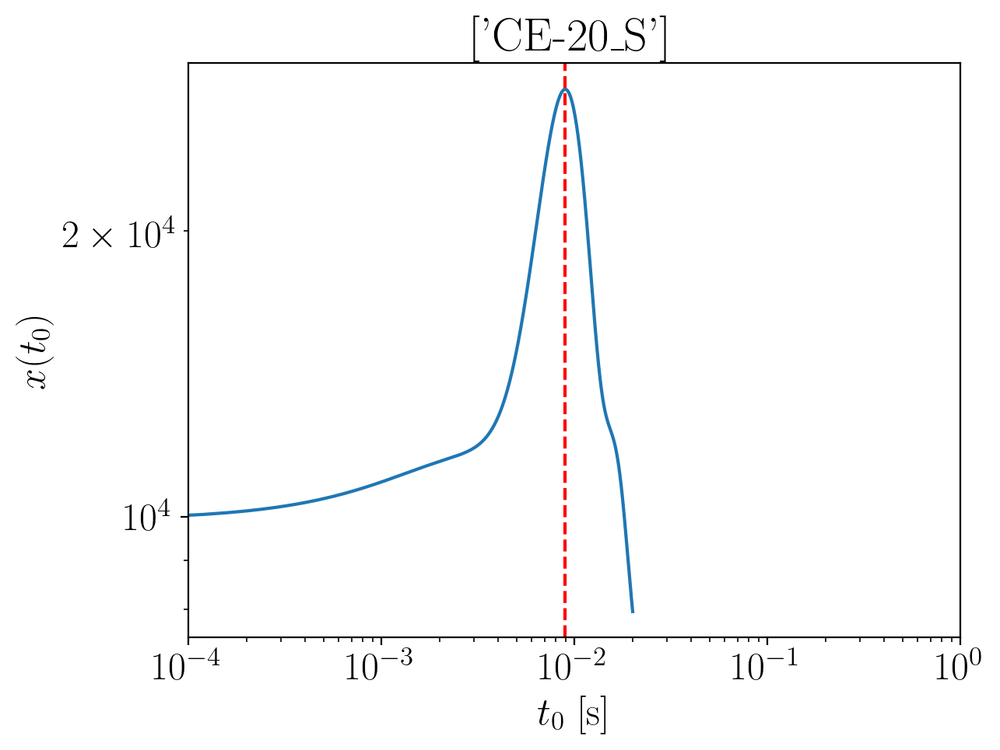

2024-01-15 15:50:59,077 - Network - INFO : Polarizations calculated.
2024-01-15 15:50:59,084 - Network - INFO : PSDs loaded.
2024-01-15 15:50:59,086 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:50:59,091 - Network - INFO : Detector responses calculated.
2024-01-15 15:50:59,096 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.041169854924813
Inner product:
0.9997228330380603


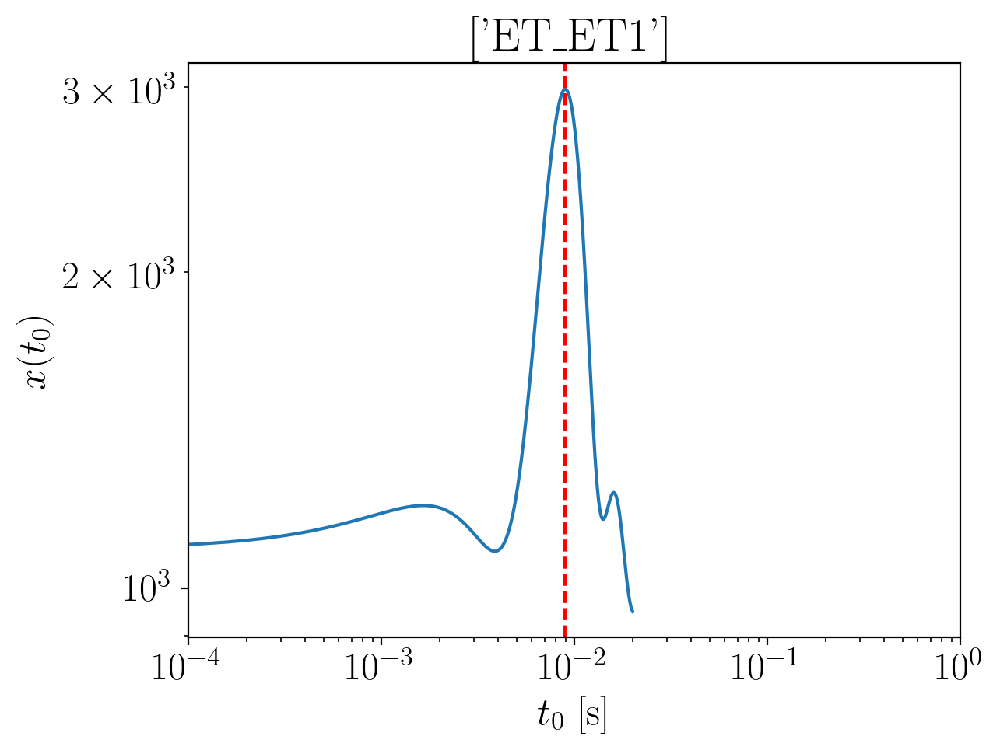

2024-01-15 15:51:00,488 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:00,505 - Network - INFO : PSDs loaded.
2024-01-15 15:51:00,508 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:00,513 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:00,519 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0324145470451436
Inner product:
0.9996783062037612


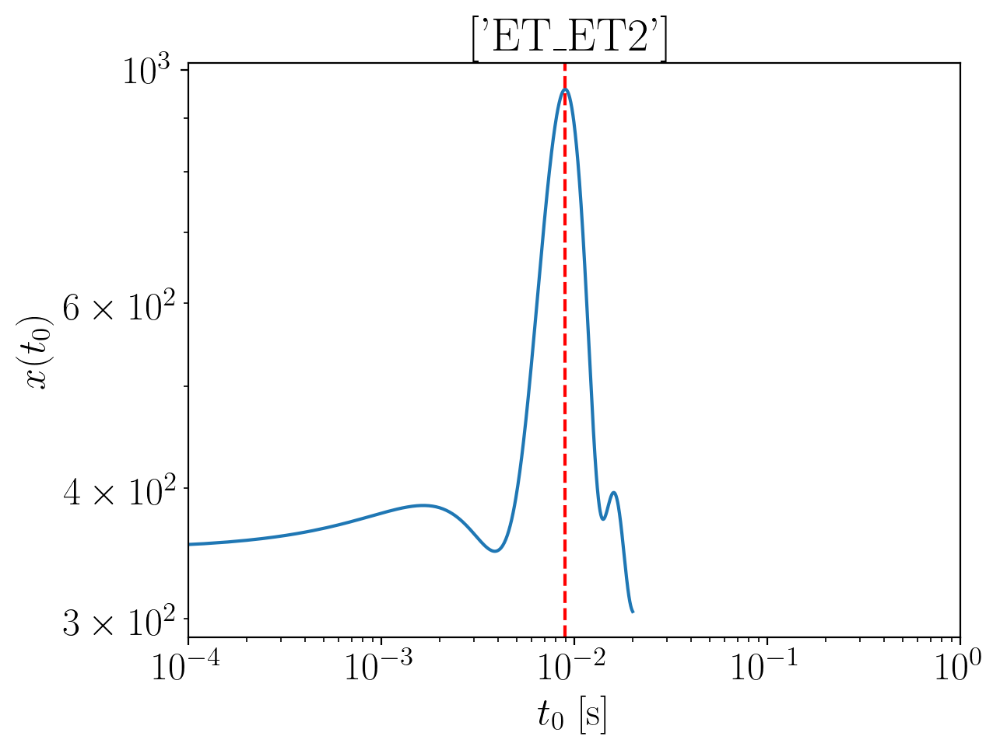

2024-01-15 15:51:01,954 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:01,968 - Network - INFO : PSDs loaded.
2024-01-15 15:51:01,970 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:01,975 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:01,980 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0324145470451436
Inner product:
0.9996783062037613


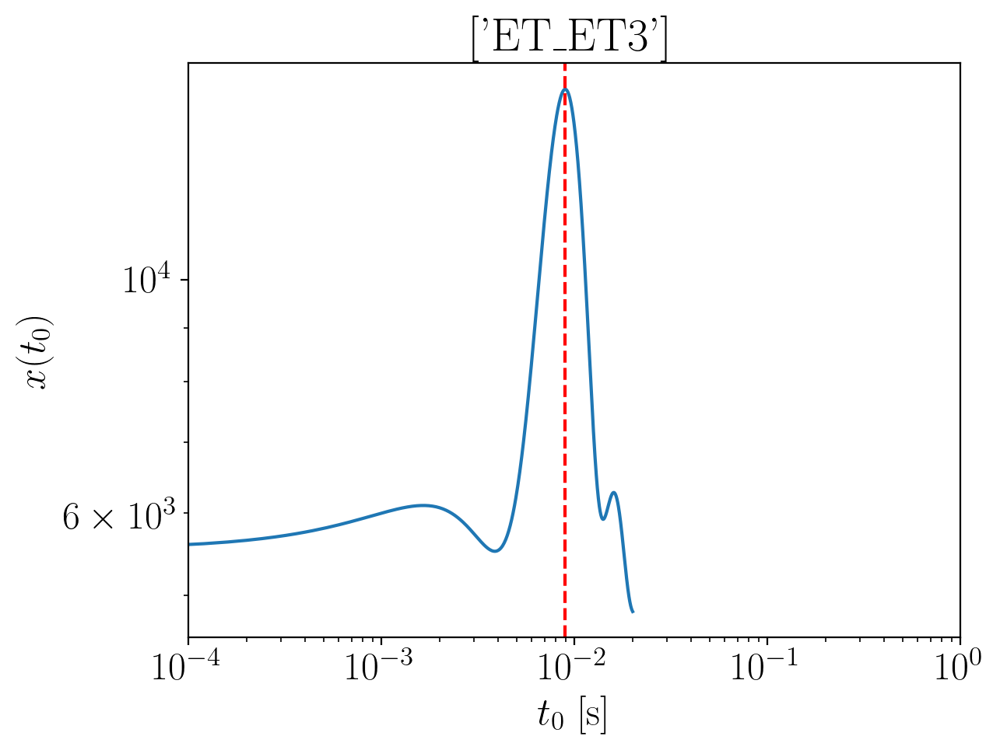

2024-01-15 15:51:03,364 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:03,378 - Network - INFO : PSDs loaded.
2024-01-15 15:51:03,381 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:03,387 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:03,393 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:03,488 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:03,489 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:51:03,495 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -2.0324145470451436
Inner product:
0.9996783062037612


2024-01-15 15:51:08,788 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:51:08,832 - Network - INFO : PSDs loaded.
2024-01-15 15:51:08,838 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:08,852 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:08,853 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:51:08,853 - Network - INFO :    CE-40_C
2024-01-15 15:51:12,468 - Network - INFO :    CE-20_S
2024-01-15 15:51:16,119 - Network - INFO :    ET_ET1
2024-01-15 15:51:19,711 - Network - INFO :    ET_ET2
2024-01-15 15:51:23,321 - Network - INFO :    ET_ET3
2024-01-15 15:51:26,898 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:51:26,904 - Network - INFO : SNRs calculated.
2024-01-15 15:51:26,905 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:51:26,905 - Network - INFO :    CE-40_C
2024-01-15 15:51:27,001 - Network - INFO :

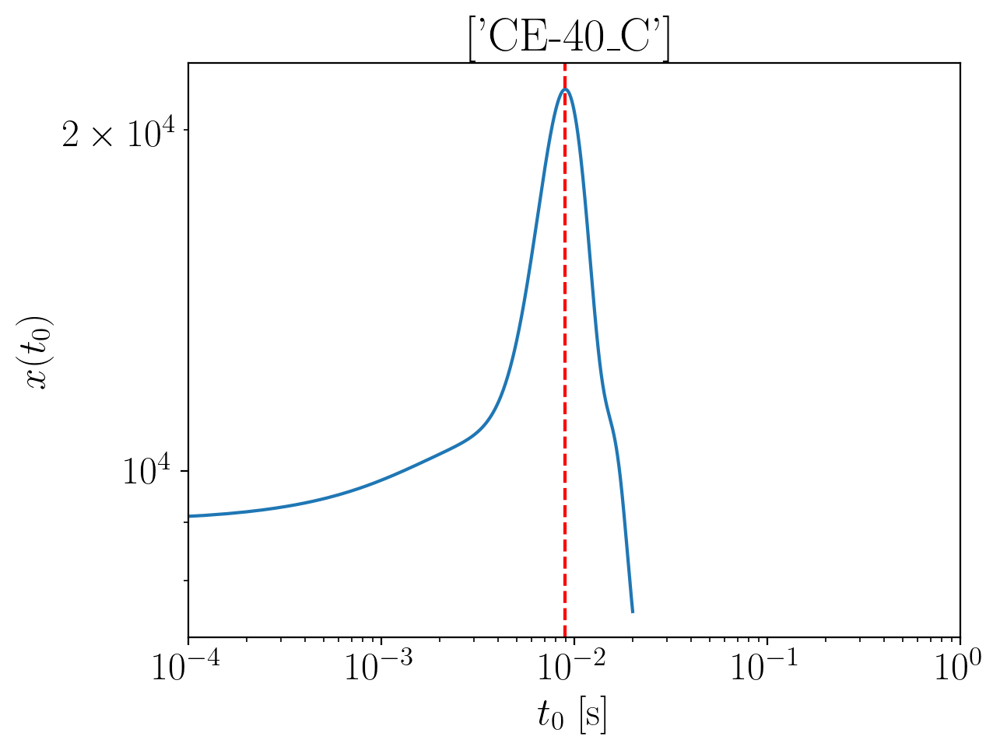

2024-01-15 15:51:28,862 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:28,881 - Network - INFO : PSDs loaded.
2024-01-15 15:51:28,883 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:28,901 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:28,915 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9804610247048187
Inner product:
0.9997683712137027


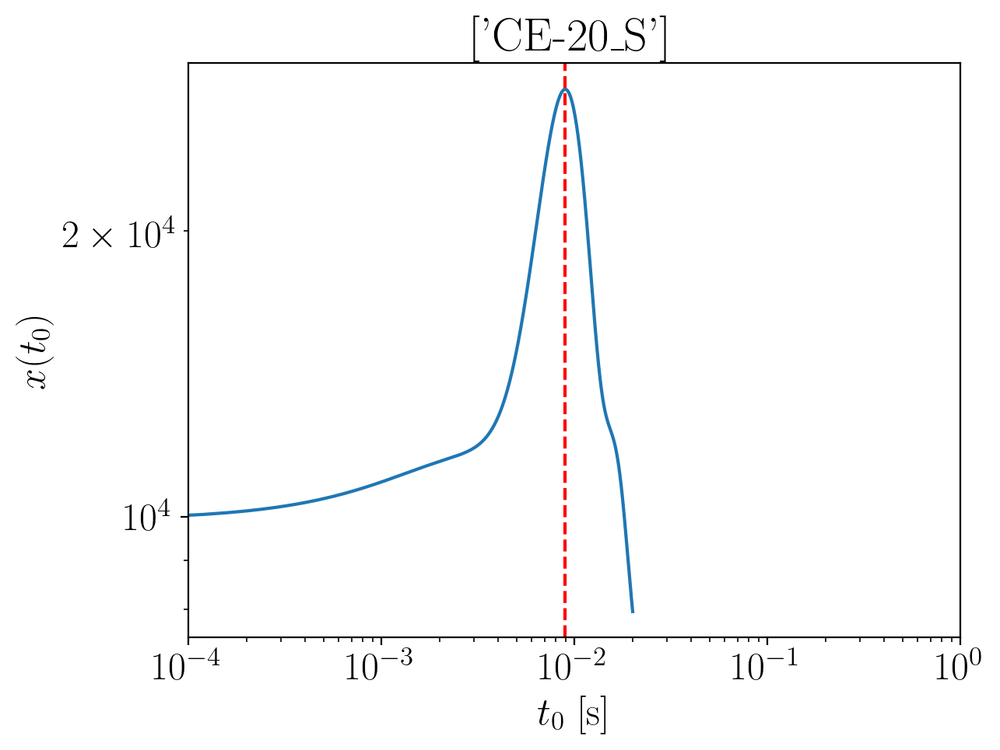

2024-01-15 15:51:30,051 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:30,057 - Network - INFO : PSDs loaded.
2024-01-15 15:51:30,059 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:30,064 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:30,069 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.981622073418256
Inner product:
0.9997228330380603


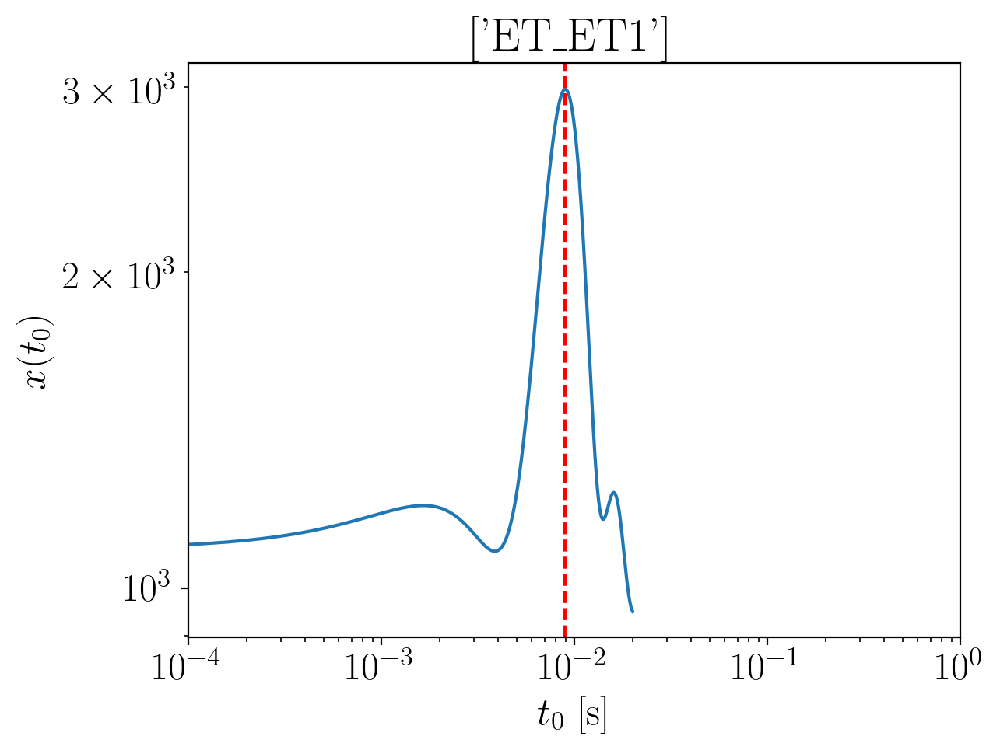

2024-01-15 15:51:31,451 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:31,467 - Network - INFO : PSDs loaded.
2024-01-15 15:51:31,469 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:31,475 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:31,480 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9728667655385859
Inner product:
0.9996783062037611


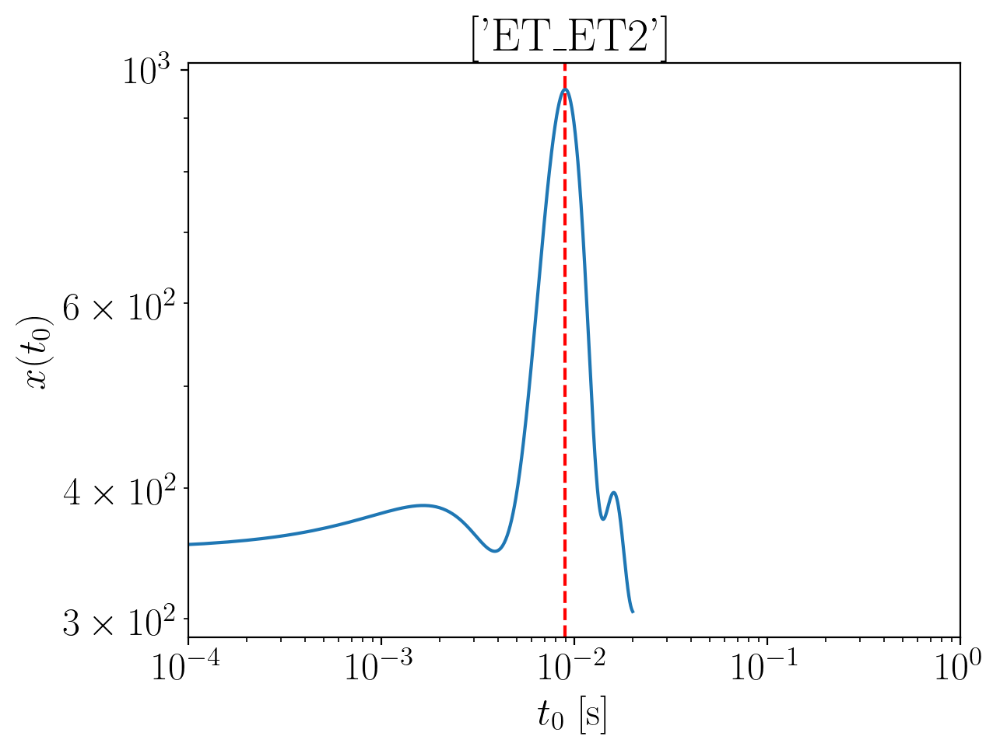

2024-01-15 15:51:32,902 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:32,915 - Network - INFO : PSDs loaded.
2024-01-15 15:51:32,918 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:32,924 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:32,929 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9728667655385859
Inner product:
0.9996783062037613


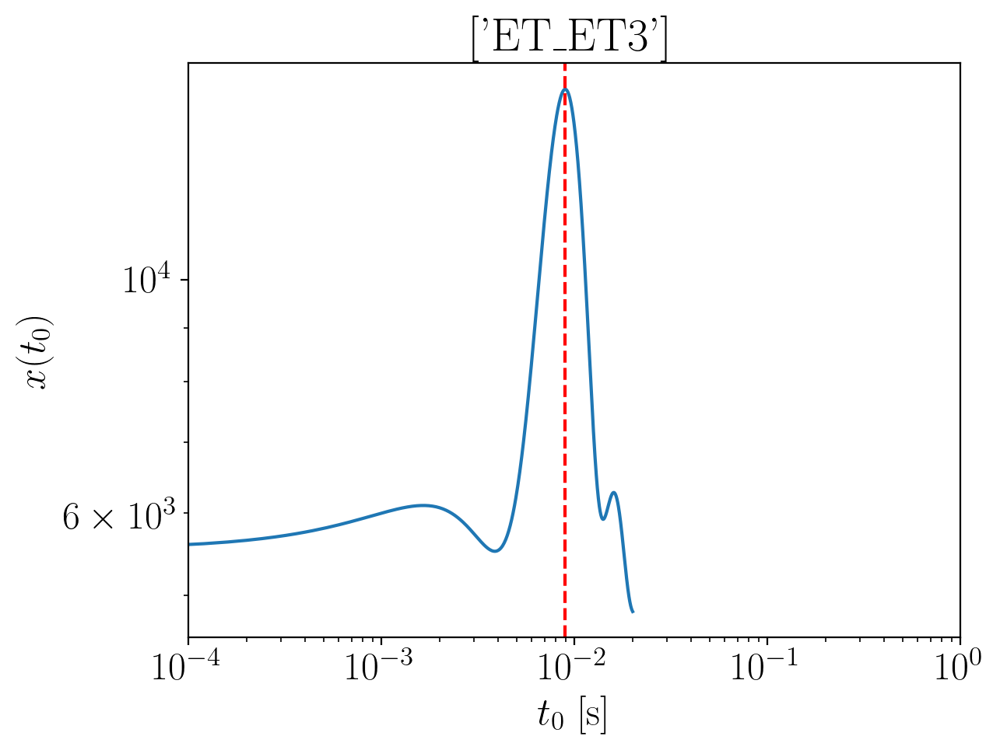

2024-01-15 15:51:34,326 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:34,339 - Network - INFO : PSDs loaded.
2024-01-15 15:51:34,341 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:34,346 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:34,351 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:34,374 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:34,375 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:51:34,379 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9728667655385859
Inner product:
0.9996783062037611


2024-01-15 15:51:39,712 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:51:39,755 - Network - INFO : PSDs loaded.
2024-01-15 15:51:39,761 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:39,776 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:39,776 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:51:39,777 - Network - INFO :    CE-40_C
2024-01-15 15:51:43,322 - Network - INFO :    CE-20_S
2024-01-15 15:51:46,894 - Network - INFO :    ET_ET1
2024-01-15 15:51:50,469 - Network - INFO :    ET_ET2
2024-01-15 15:51:54,047 - Network - INFO :    ET_ET3
2024-01-15 15:51:57,600 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:51:57,606 - Network - INFO : SNRs calculated.
2024-01-15 15:51:57,606 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:51:57,607 - Network - INFO :    CE-40_C
2024-01-15 15:51:57,700 - Network - INFO :

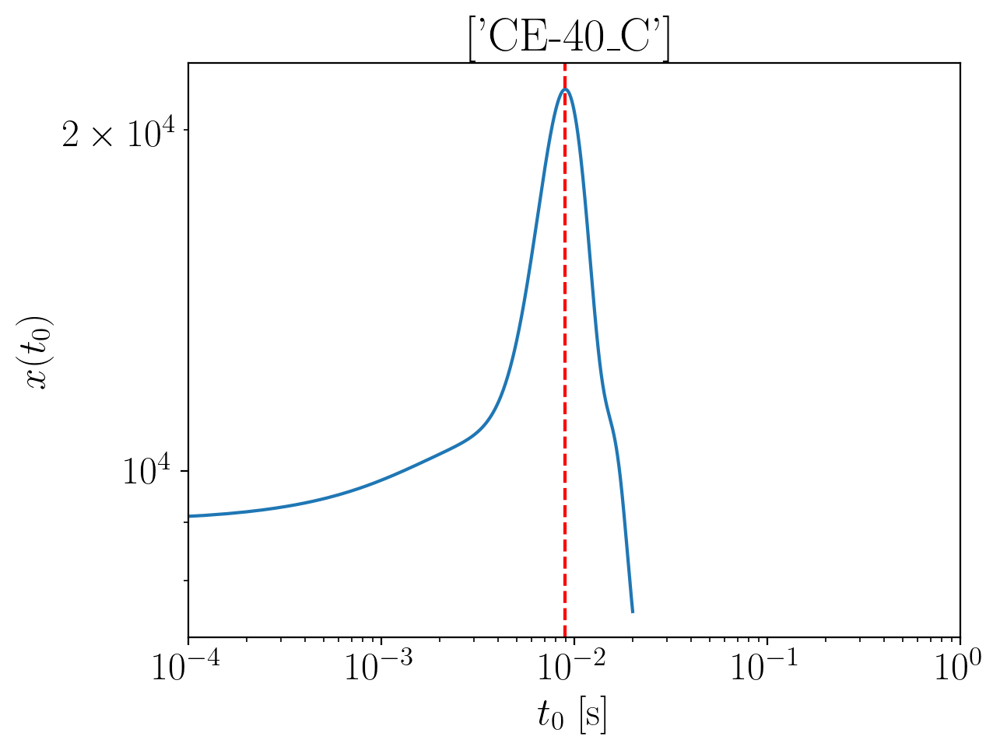

2024-01-15 15:51:59,408 - Network - INFO : Polarizations calculated.
2024-01-15 15:51:59,416 - Network - INFO : PSDs loaded.
2024-01-15 15:51:59,431 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:51:59,440 - Network - INFO : Detector responses calculated.
2024-01-15 15:51:59,445 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.921754185905936
Inner product:
0.999768371213703


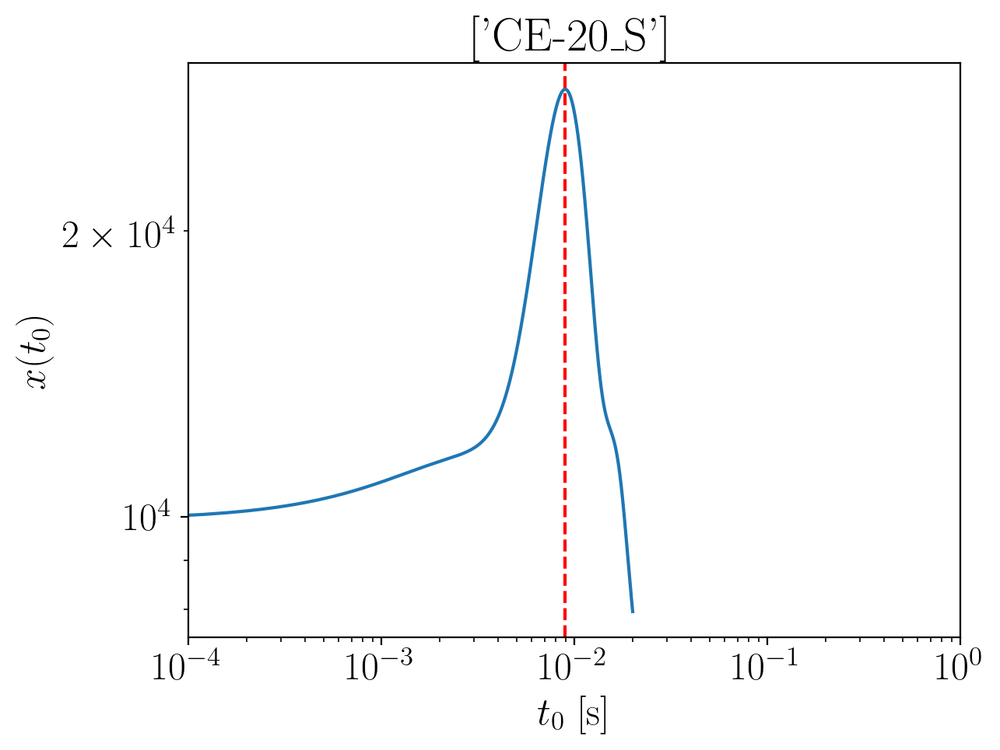

2024-01-15 15:52:00,595 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:00,601 - Network - INFO : PSDs loaded.
2024-01-15 15:52:00,603 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:00,608 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:00,614 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9229152346193734
Inner product:
0.9997228330380603


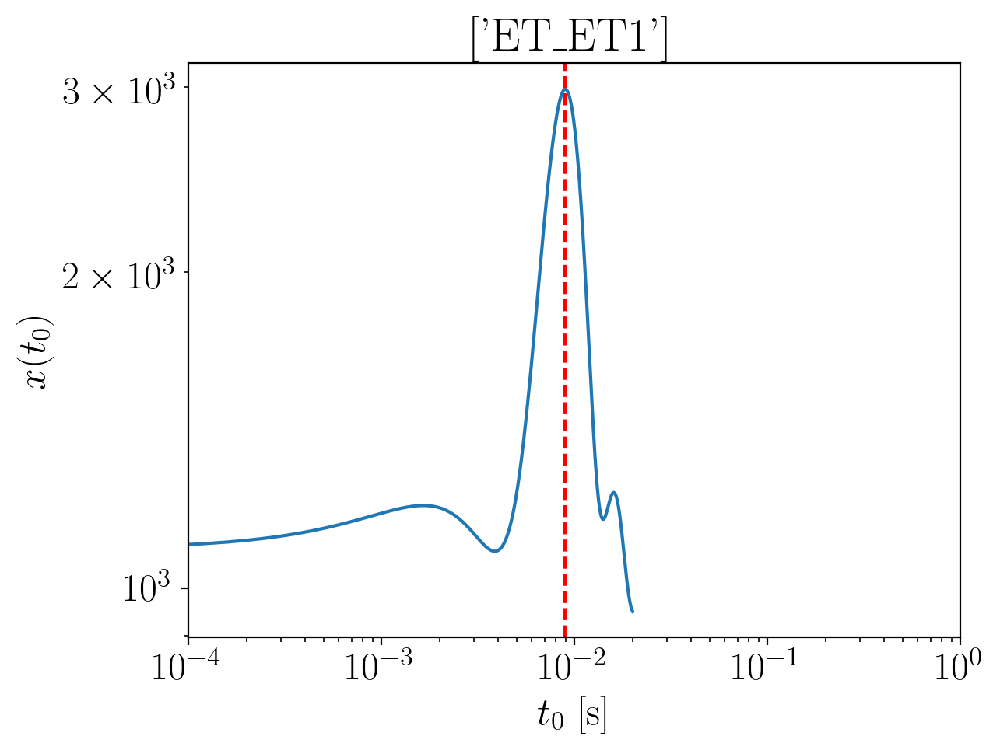

2024-01-15 15:52:02,142 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:02,155 - Network - INFO : PSDs loaded.
2024-01-15 15:52:02,157 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:02,163 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:02,168 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9141599267397036
Inner product:
0.9996783062037611


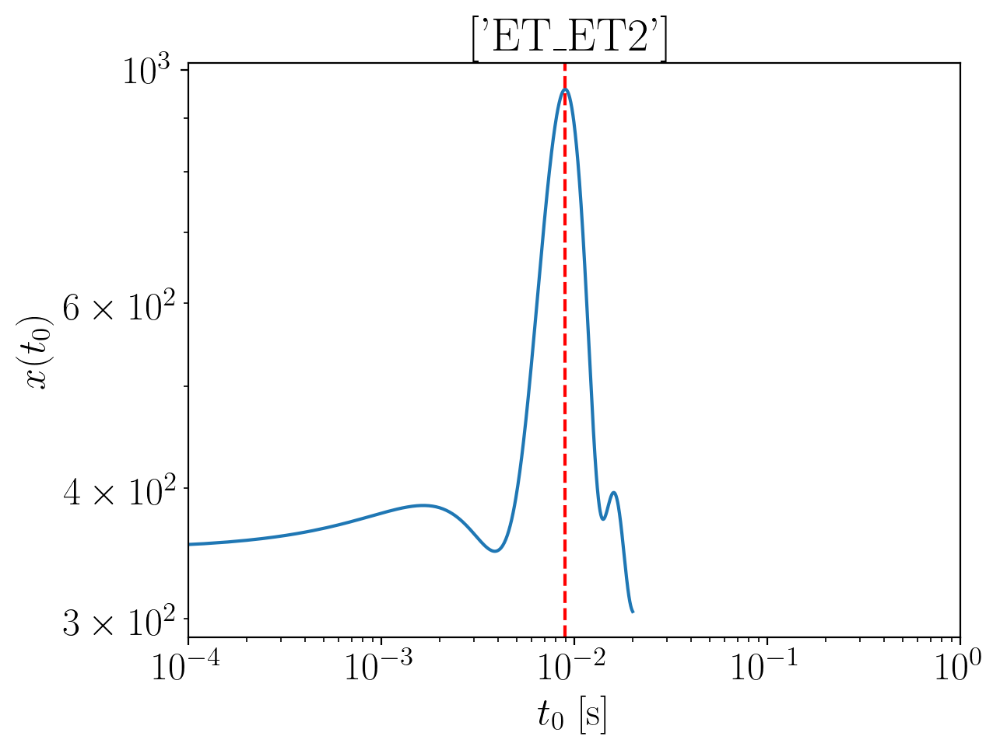

2024-01-15 15:52:03,602 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:03,617 - Network - INFO : PSDs loaded.
2024-01-15 15:52:03,619 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:03,625 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:03,630 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9141599267397036
Inner product:
0.9996783062037613


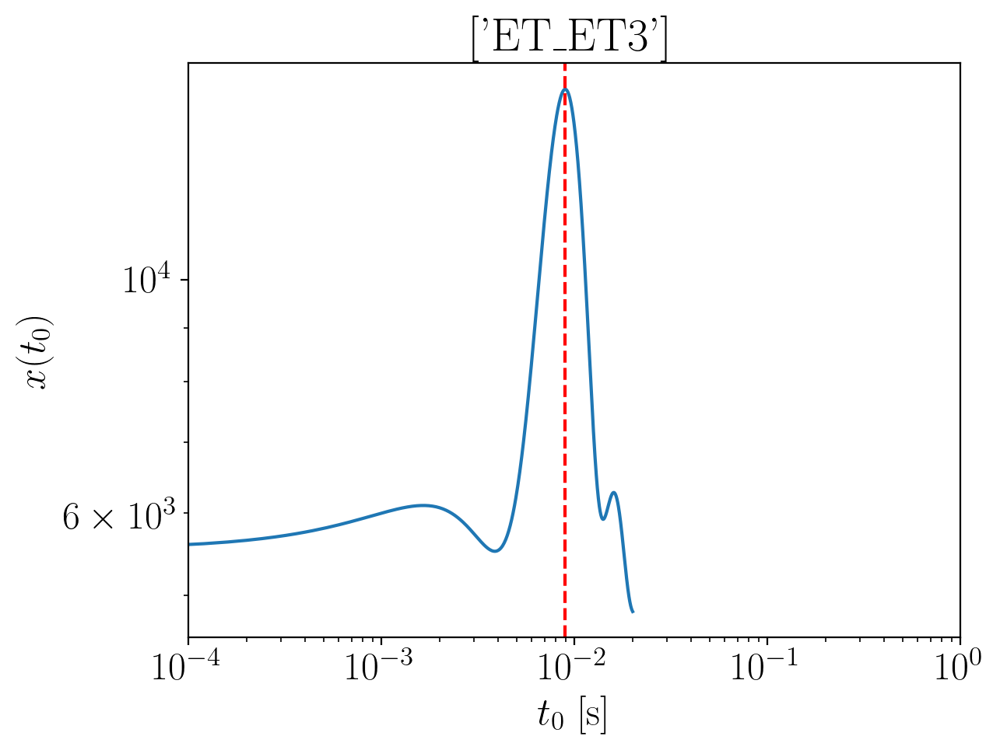

2024-01-15 15:52:05,015 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:05,030 - Network - INFO : PSDs loaded.
2024-01-15 15:52:05,034 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:05,044 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:05,050 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:05,073 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:05,073 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:52:05,077 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.9141599267397036
Inner product:
0.999678306203761


2024-01-15 15:52:10,408 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:52:10,455 - Network - INFO : PSDs loaded.
2024-01-15 15:52:10,462 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:10,477 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:10,478 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:52:10,479 - Network - INFO :    CE-40_C
2024-01-15 15:52:14,039 - Network - INFO :    CE-20_S
2024-01-15 15:52:17,600 - Network - INFO :    ET_ET1
2024-01-15 15:52:21,183 - Network - INFO :    ET_ET2
2024-01-15 15:52:24,736 - Network - INFO :    ET_ET3
2024-01-15 15:52:28,365 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:52:28,371 - Network - INFO : SNRs calculated.
2024-01-15 15:52:28,371 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:52:28,372 - Network - INFO :    CE-40_C
2024-01-15 15:52:28,465 - Network - INFO :

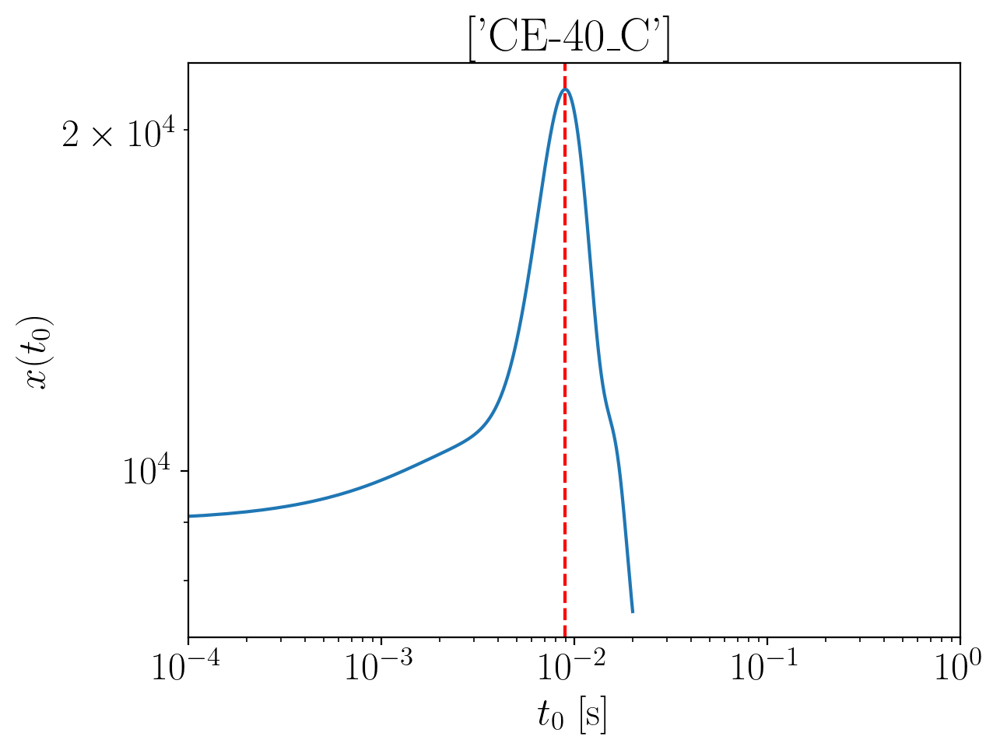

2024-01-15 15:52:30,184 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:30,190 - Network - INFO : PSDs loaded.
2024-01-15 15:52:30,199 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:30,225 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:30,239 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.8636325007362249
Inner product:
0.999768371213703


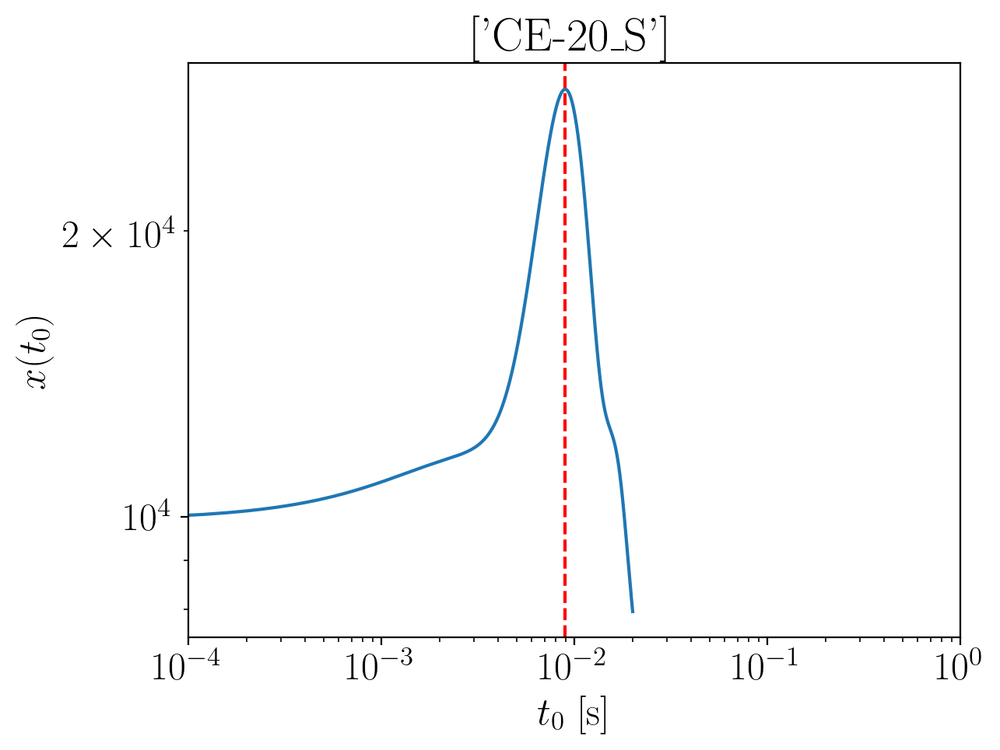

2024-01-15 15:52:31,388 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:31,394 - Network - INFO : PSDs loaded.
2024-01-15 15:52:31,396 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:31,401 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:31,405 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.8647935494496624
Inner product:
0.9997228330380603


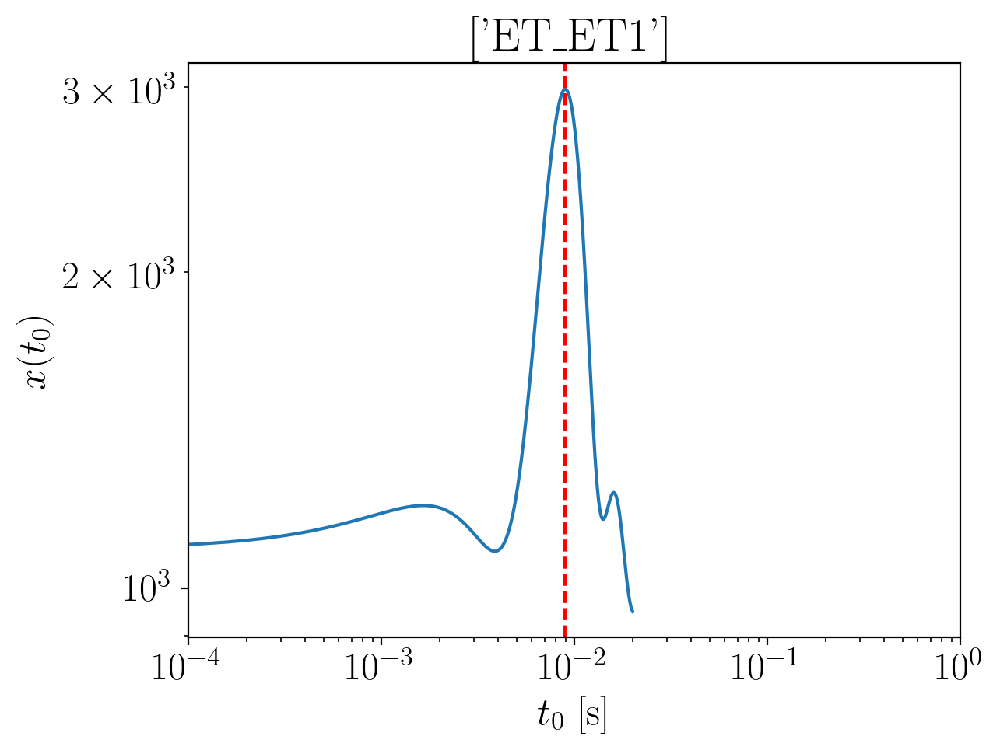

2024-01-15 15:52:32,782 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:32,802 - Network - INFO : PSDs loaded.
2024-01-15 15:52:32,805 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:32,815 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:32,820 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.8560382415699923
Inner product:
0.9996783062037612


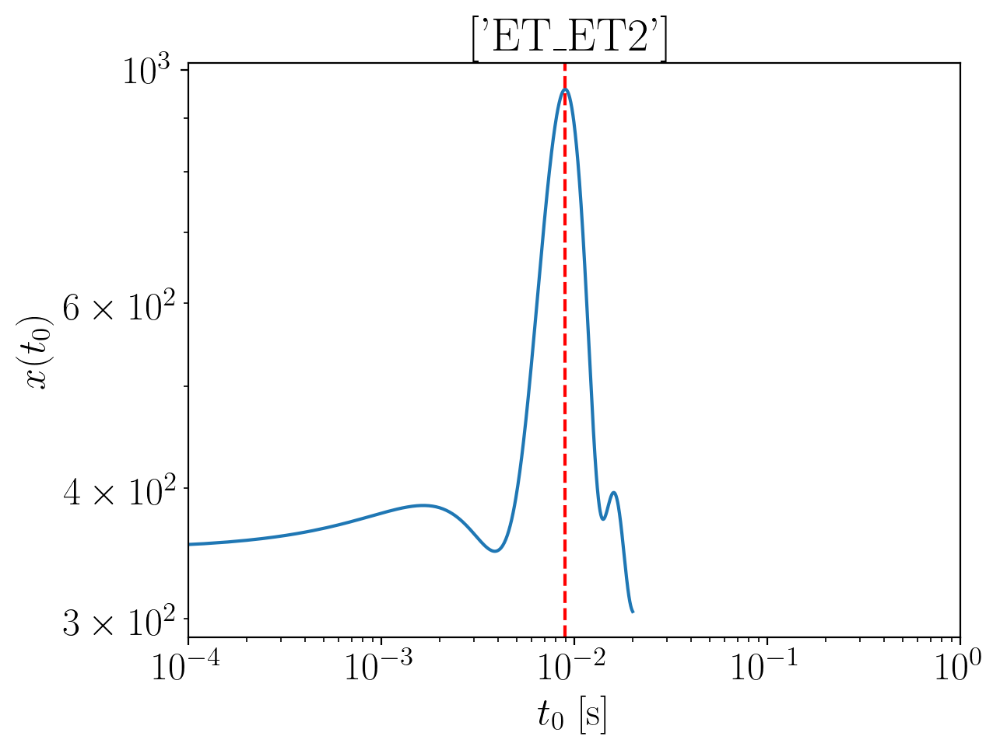

2024-01-15 15:52:34,286 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:34,301 - Network - INFO : PSDs loaded.
2024-01-15 15:52:34,304 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:34,314 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:34,319 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.8560382415699923
Inner product:
0.9996783062037613


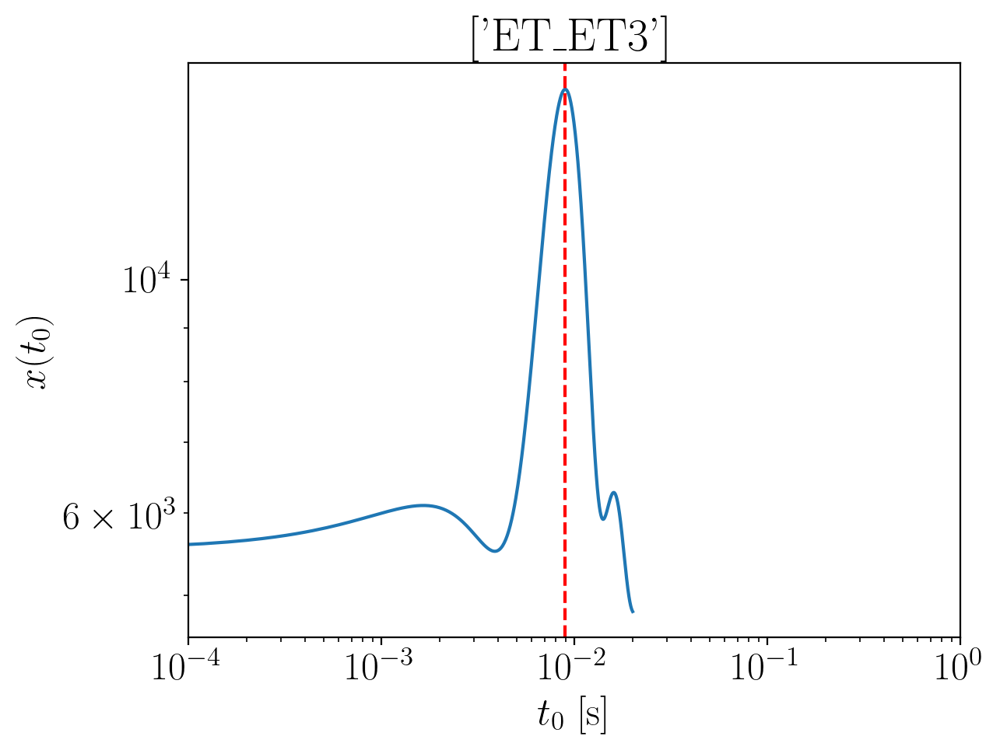

2024-01-15 15:52:35,974 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:35,988 - Network - INFO : PSDs loaded.
2024-01-15 15:52:35,990 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:35,995 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:36,001 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:36,024 - Network - INFO : Polarizations calculated.
2024-01-15 15:52:36,025 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:52:36,029 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.8560382415699923
Inner product:
0.9996783062037611


2024-01-15 15:52:41,496 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:52:41,540 - Network - INFO : PSDs loaded.
2024-01-15 15:52:41,546 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:52:41,562 - Network - INFO : Detector responses calculated.
2024-01-15 15:52:41,563 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:52:41,563 - Network - INFO :    CE-40_C
2024-01-15 15:52:45,115 - Network - INFO :    CE-20_S
2024-01-15 15:52:48,654 - Network - INFO :    ET_ET1
2024-01-15 15:52:52,199 - Network - INFO :    ET_ET2
2024-01-15 15:52:55,750 - Network - INFO :    ET_ET3
2024-01-15 15:52:59,303 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:52:59,309 - Network - INFO : SNRs calculated.
2024-01-15 15:52:59,309 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:52:59,310 - Network - INFO :    CE-40_C
2024-01-15 15:52:59,403 - Network - INFO :

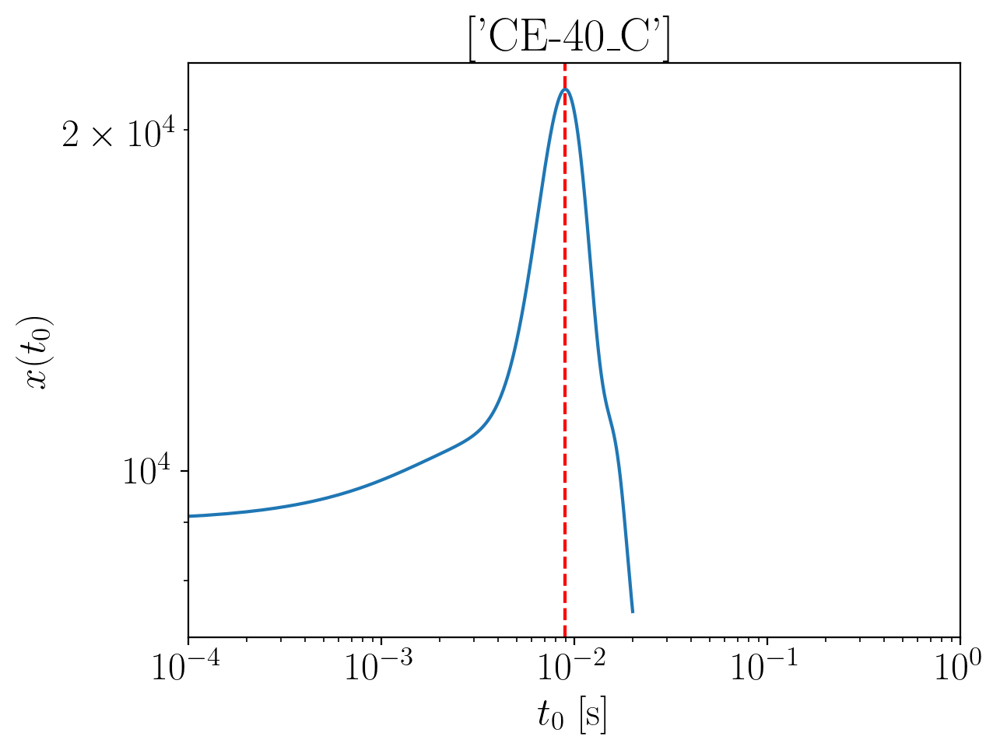

2024-01-15 15:53:01,131 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:01,140 - Network - INFO : PSDs loaded.
2024-01-15 15:53:01,146 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:01,191 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:01,200 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.8059190633239088
Inner product:
0.9997683712137027


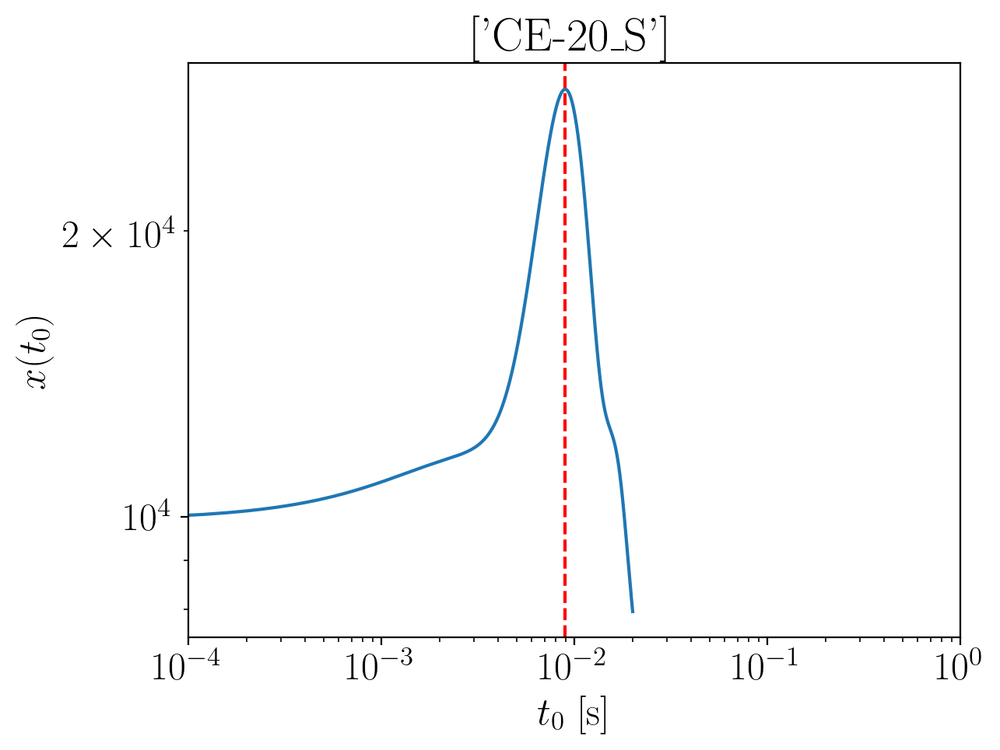

2024-01-15 15:53:02,356 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:02,362 - Network - INFO : PSDs loaded.
2024-01-15 15:53:02,364 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:02,369 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:02,374 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.807080112037346
Inner product:
0.9997228330380603


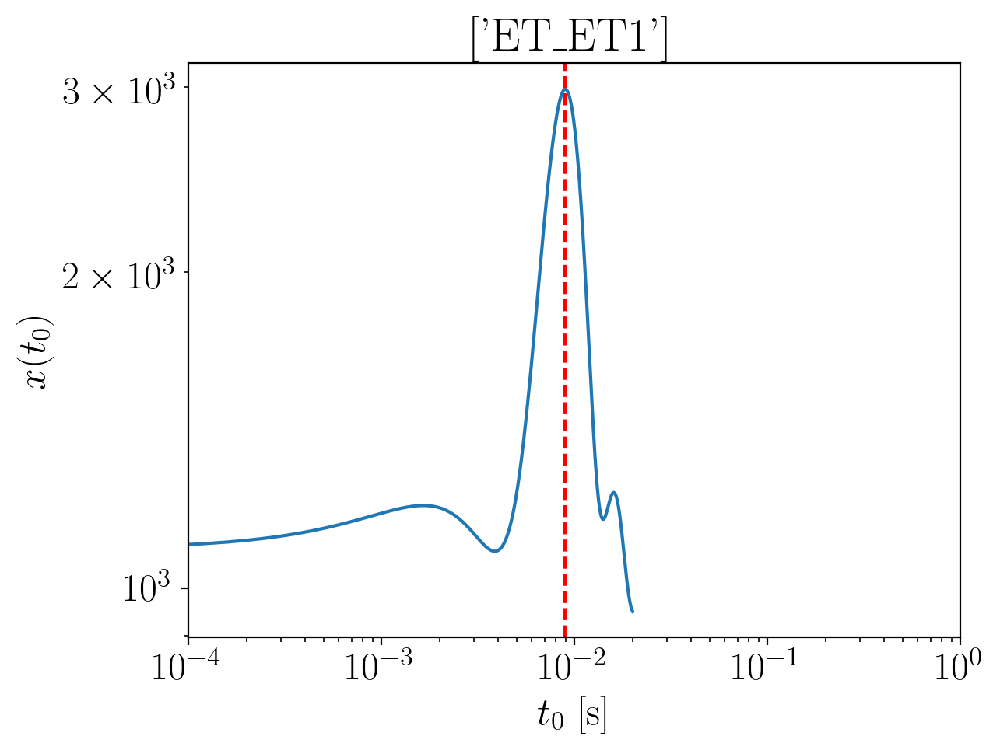

2024-01-15 15:53:03,882 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:03,896 - Network - INFO : PSDs loaded.
2024-01-15 15:53:03,899 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:03,906 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:03,911 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.798324804157676
Inner product:
0.9996783062037611


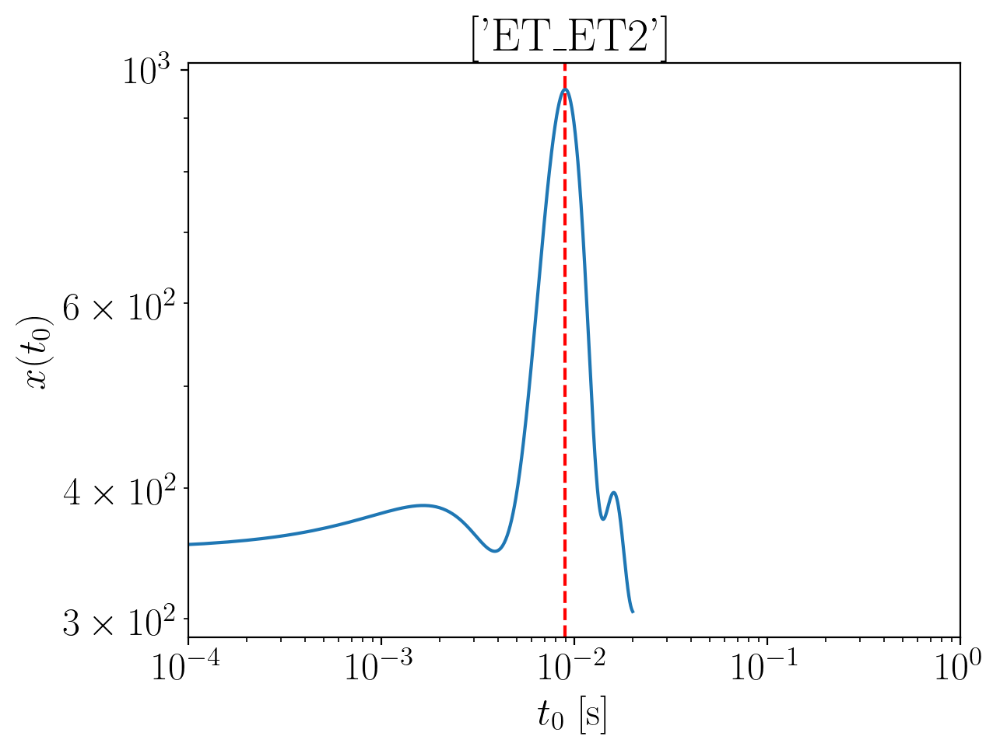

2024-01-15 15:53:05,384 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:05,400 - Network - INFO : PSDs loaded.
2024-01-15 15:53:05,402 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:05,408 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:05,414 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.798324804157676
Inner product:
0.9996783062037614


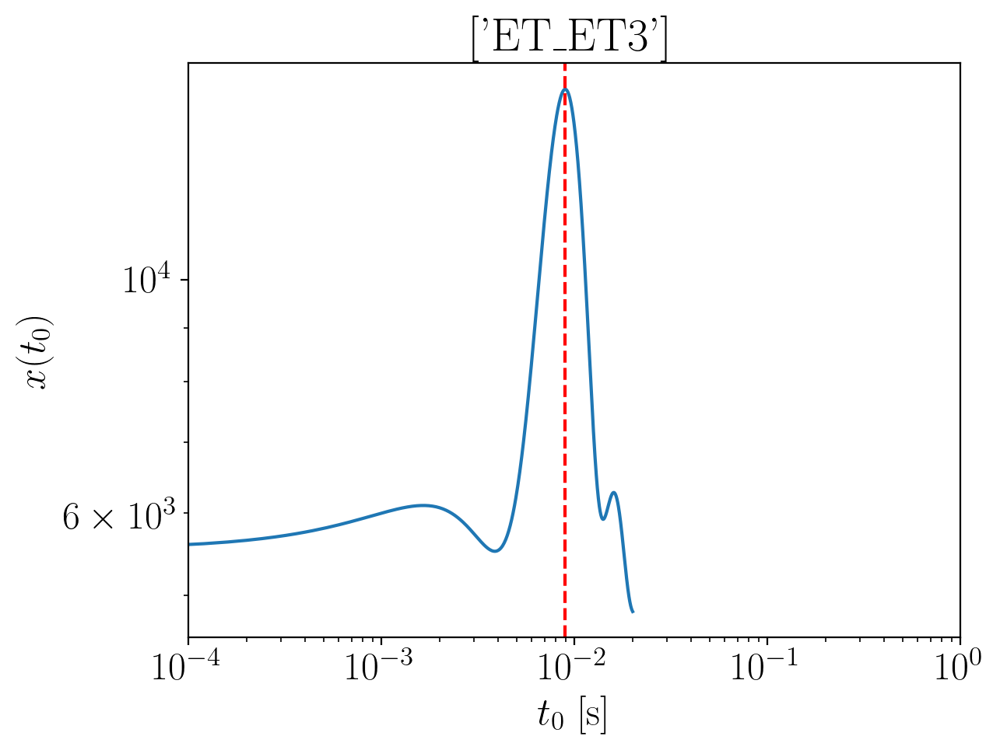

2024-01-15 15:53:06,801 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:06,819 - Network - INFO : PSDs loaded.
2024-01-15 15:53:06,821 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:06,827 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:06,832 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:06,857 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:06,858 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:53:06,863 - Network - INFO : Polarizations calculated.


time shift: 0.008960000000000001
phase shift: -1.798324804157676
Inner product:
0.999678306203761


2024-01-15 15:53:12,258 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:53:12,302 - Network - INFO : PSDs loaded.
2024-01-15 15:53:12,307 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:12,326 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:12,327 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:53:12,327 - Network - INFO :    CE-40_C
2024-01-15 15:53:15,930 - Network - INFO :    CE-20_S
2024-01-15 15:53:19,528 - Network - INFO :    ET_ET1
2024-01-15 15:53:23,197 - Network - INFO :    ET_ET2
2024-01-15 15:53:26,821 - Network - INFO :    ET_ET3
2024-01-15 15:53:30,429 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:53:30,436 - Network - INFO : SNRs calculated.
2024-01-15 15:53:30,437 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:53:30,437 - Network - INFO :    CE-40_C
2024-01-15 15:53:30,531 - Network - INFO :

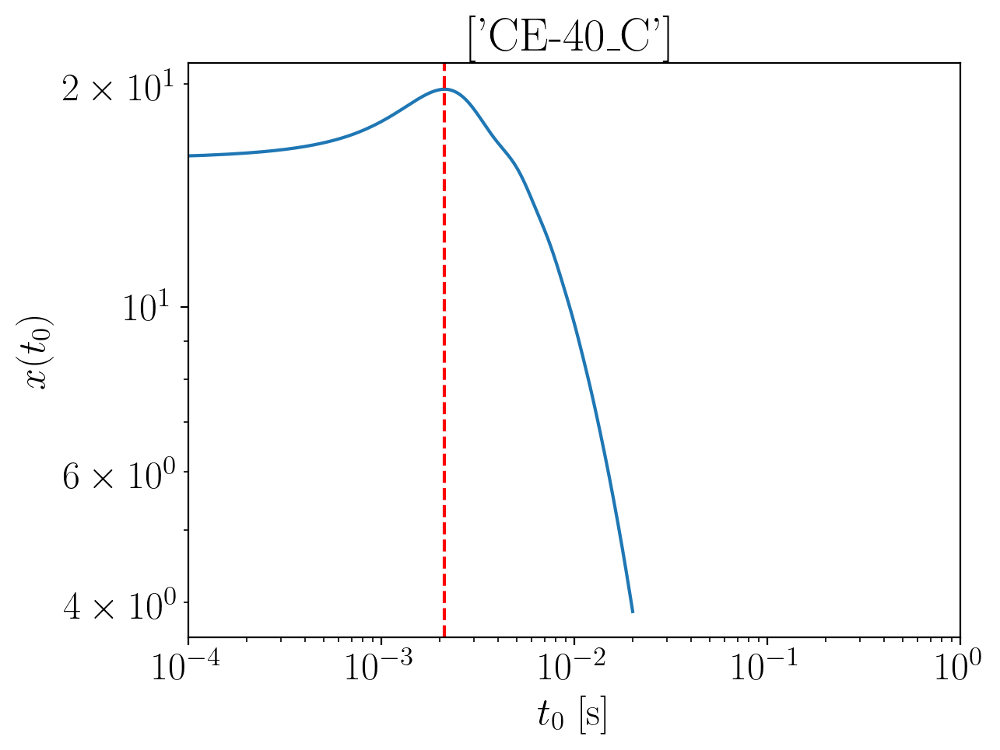

2024-01-15 15:53:33,619 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:33,628 - Network - INFO : PSDs loaded.
2024-01-15 15:53:33,630 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:33,638 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:33,645 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300413003318893
Inner product:
0.9996458389246424


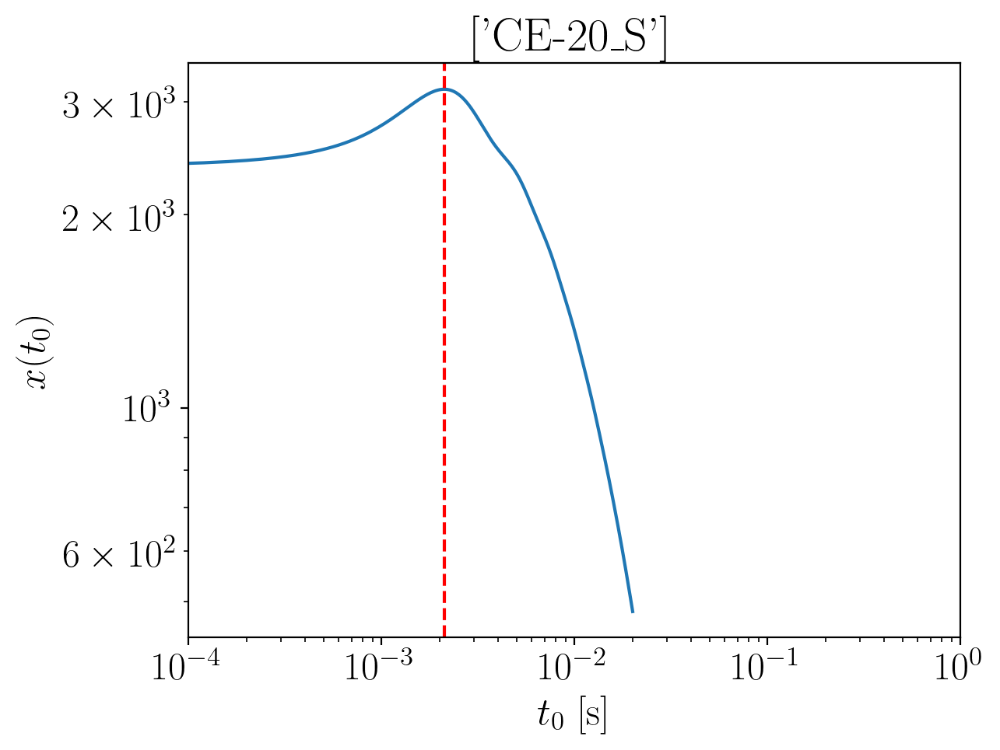

2024-01-15 15:53:34,840 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:34,848 - Network - INFO : PSDs loaded.
2024-01-15 15:53:34,850 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:34,858 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:34,865 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3021667204972935
Inner product:
0.9995380545462496


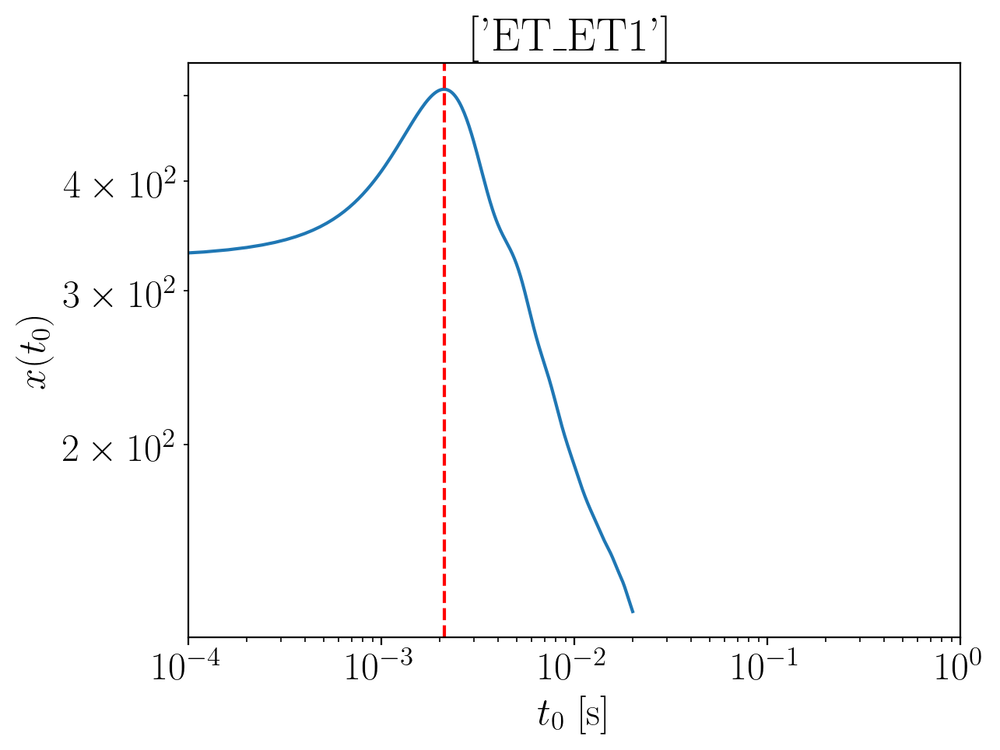

2024-01-15 15:53:36,375 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:36,391 - Network - INFO : PSDs loaded.
2024-01-15 15:53:36,393 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:36,400 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:36,406 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300114156649435
Inner product:
0.9993176198987969


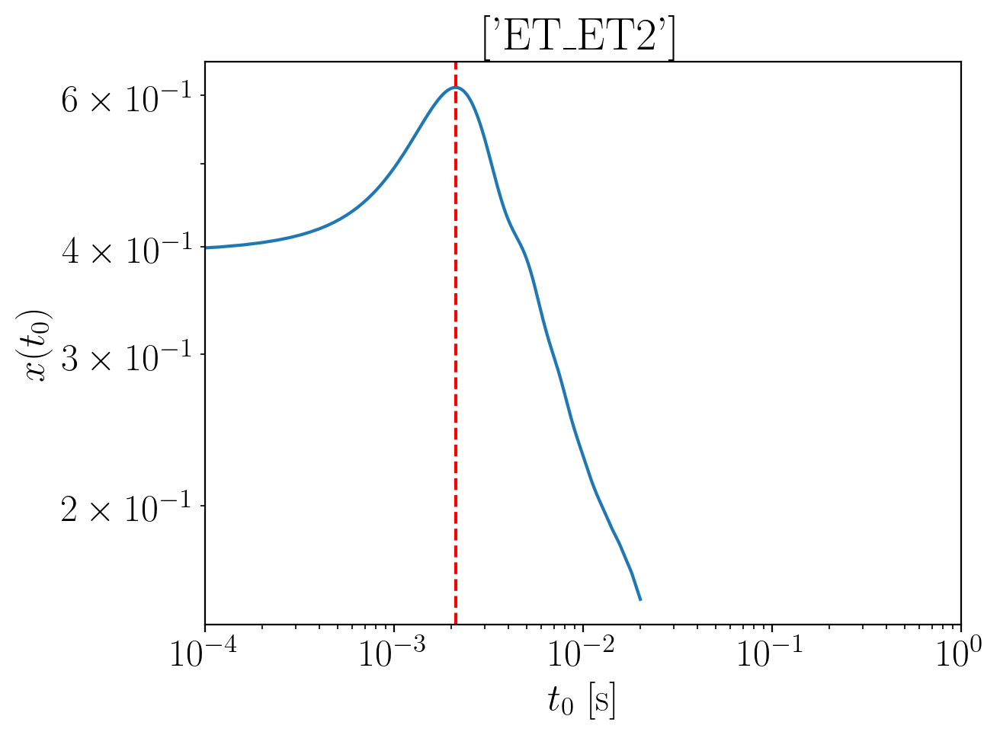

2024-01-15 15:53:40,098 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:40,115 - Network - INFO : PSDs loaded.
2024-01-15 15:53:40,118 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:40,126 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:40,132 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300114156649435
Inner product:
0.9993176198987967


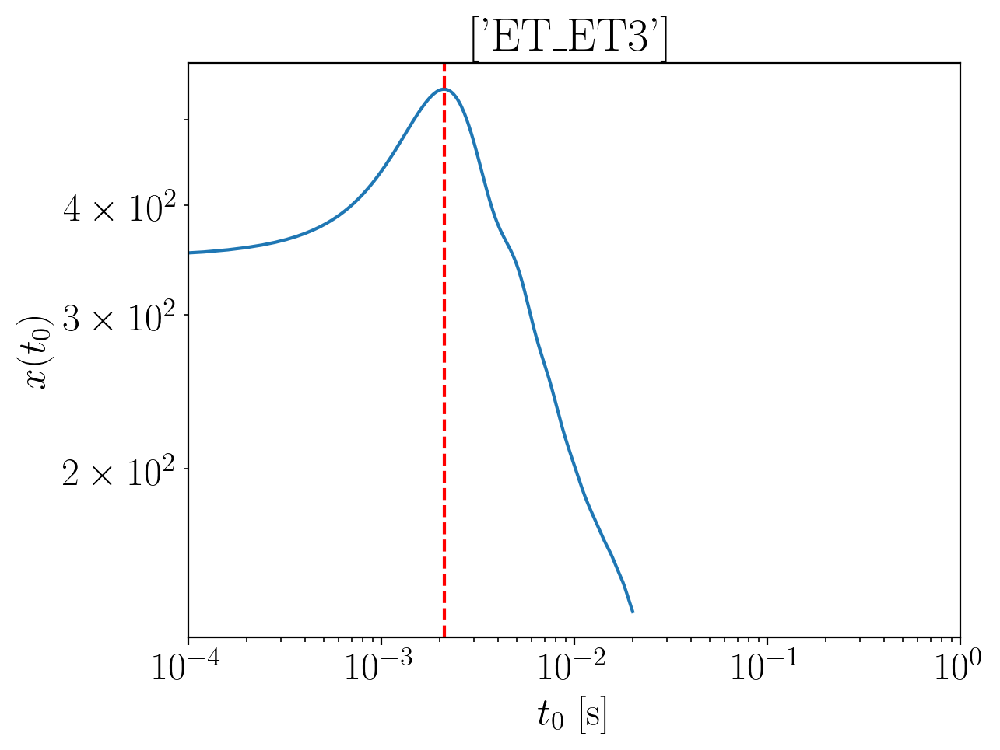

2024-01-15 15:53:41,558 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:41,573 - Network - INFO : PSDs loaded.
2024-01-15 15:53:41,576 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:41,583 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:41,590 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:41,616 - Network - INFO : Polarizations calculated.
2024-01-15 15:53:41,617 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:53:41,622 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300114156649435
Inner product:
0.9993176198987966


2024-01-15 15:53:47,045 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:53:47,088 - Network - INFO : PSDs loaded.
2024-01-15 15:53:47,094 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:53:47,113 - Network - INFO : Detector responses calculated.
2024-01-15 15:53:47,114 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:53:47,114 - Network - INFO :    CE-40_C
2024-01-15 15:53:50,735 - Network - INFO :    CE-20_S
2024-01-15 15:53:54,351 - Network - INFO :    ET_ET1
2024-01-15 15:53:57,988 - Network - INFO :    ET_ET2
2024-01-15 15:54:01,652 - Network - INFO :    ET_ET3
2024-01-15 15:54:05,239 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:54:05,246 - Network - INFO : SNRs calculated.
2024-01-15 15:54:05,247 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:54:05,248 - Network - INFO :    CE-40_C
2024-01-15 15:54:05,345 - Network - INFO :

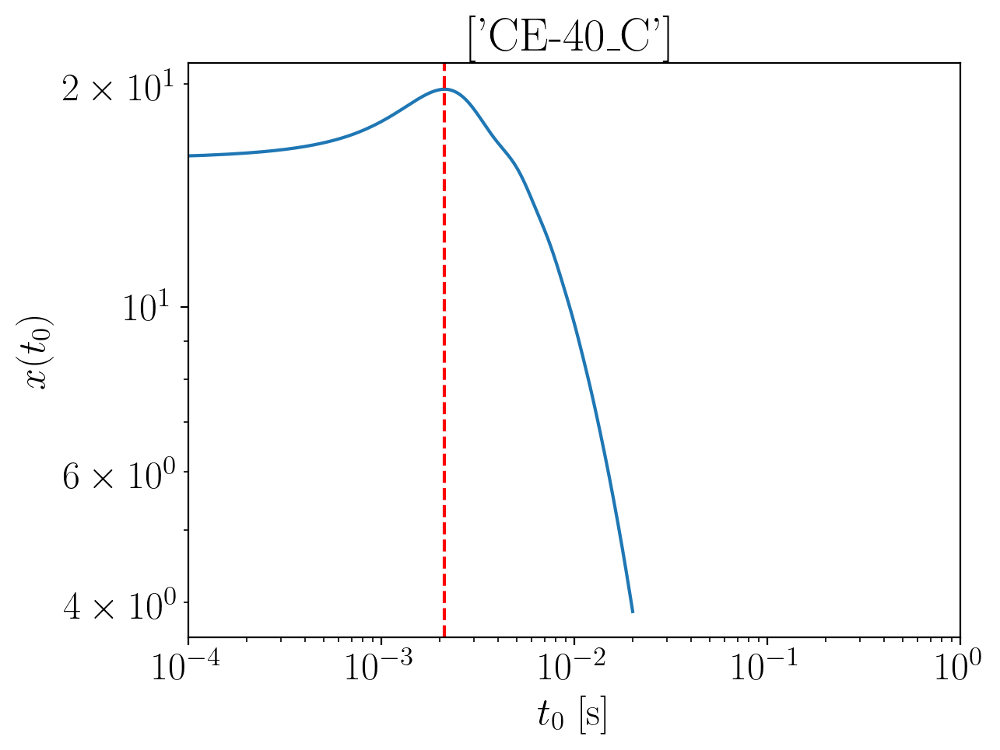

2024-01-15 15:54:07,118 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:07,131 - Network - INFO : PSDs loaded.
2024-01-15 15:54:07,137 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:07,153 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:07,161 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3510206667948523
Inner product:
0.9996458389246425


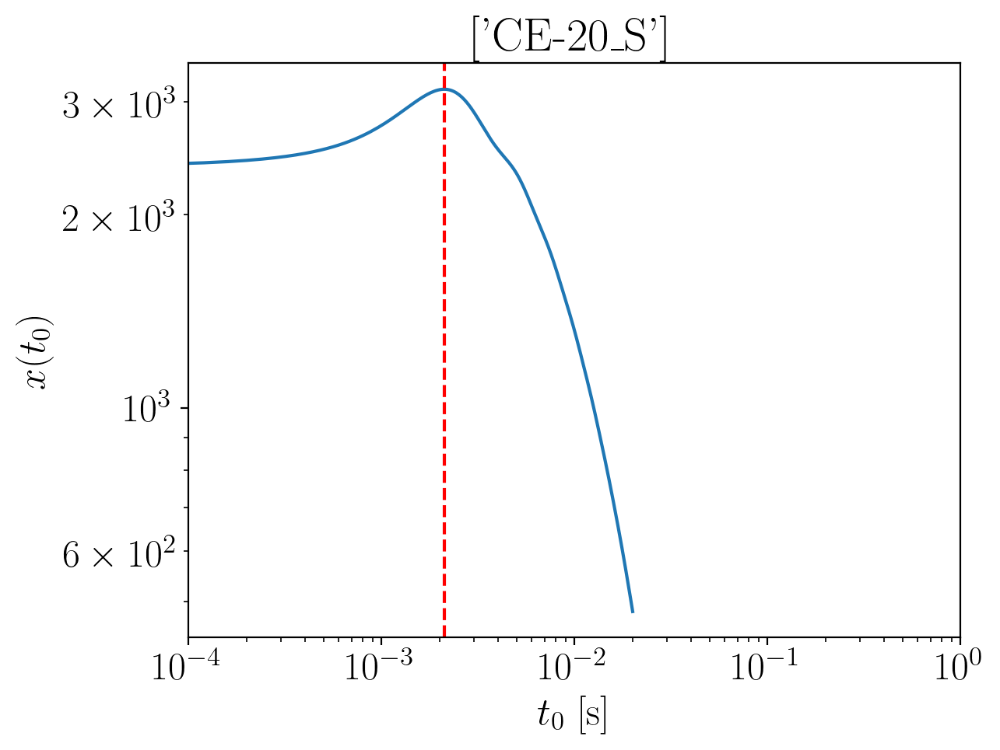

2024-01-15 15:54:08,320 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:08,328 - Network - INFO : PSDs loaded.
2024-01-15 15:54:08,330 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:08,336 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:08,343 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3527743839732507
Inner product:
0.9995380545462496


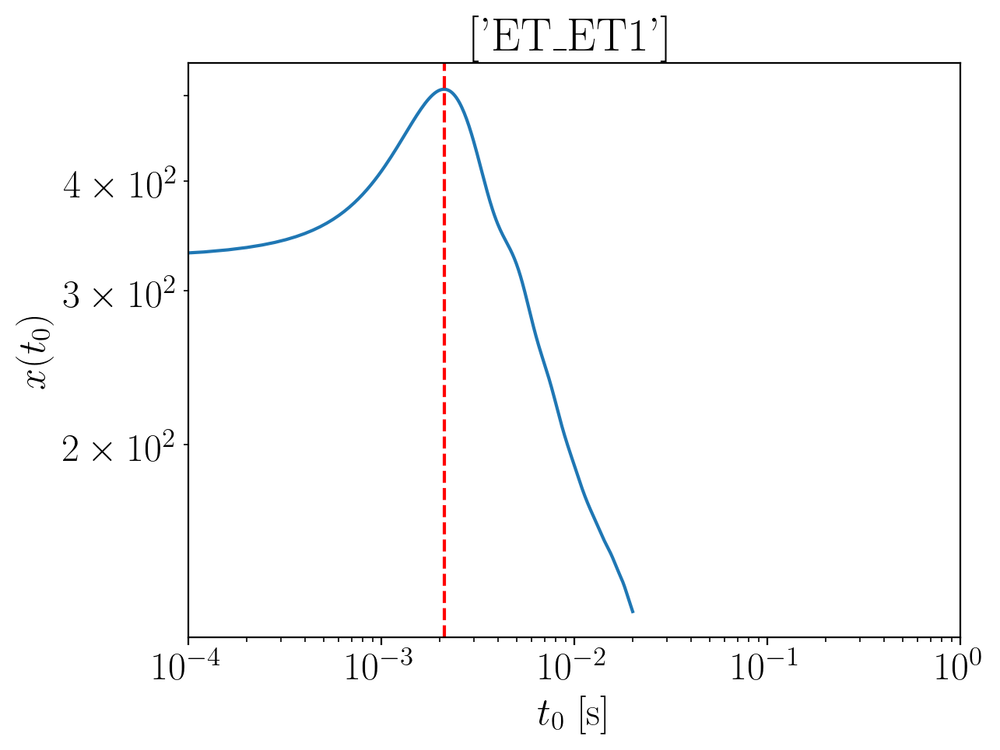

2024-01-15 15:54:09,932 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:09,947 - Network - INFO : PSDs loaded.
2024-01-15 15:54:09,949 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:09,956 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:09,962 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3499074323342164
Inner product:
0.9993176198987969


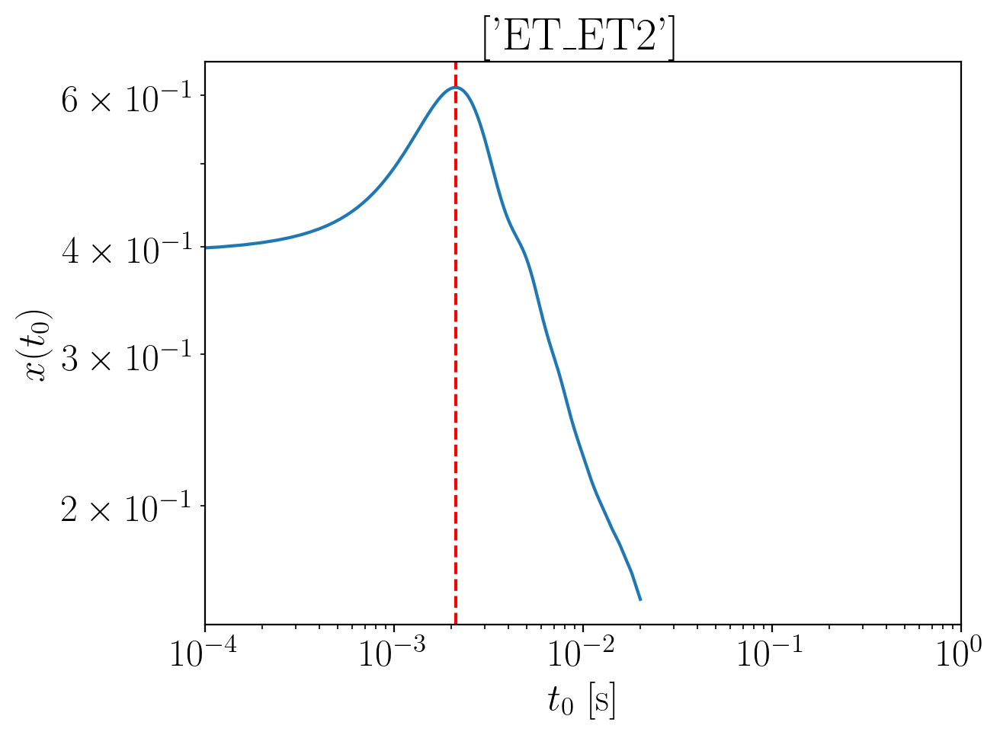

2024-01-15 15:54:11,387 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:11,402 - Network - INFO : PSDs loaded.
2024-01-15 15:54:11,405 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:11,413 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:11,420 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3499074323342164
Inner product:
0.9993176198987964


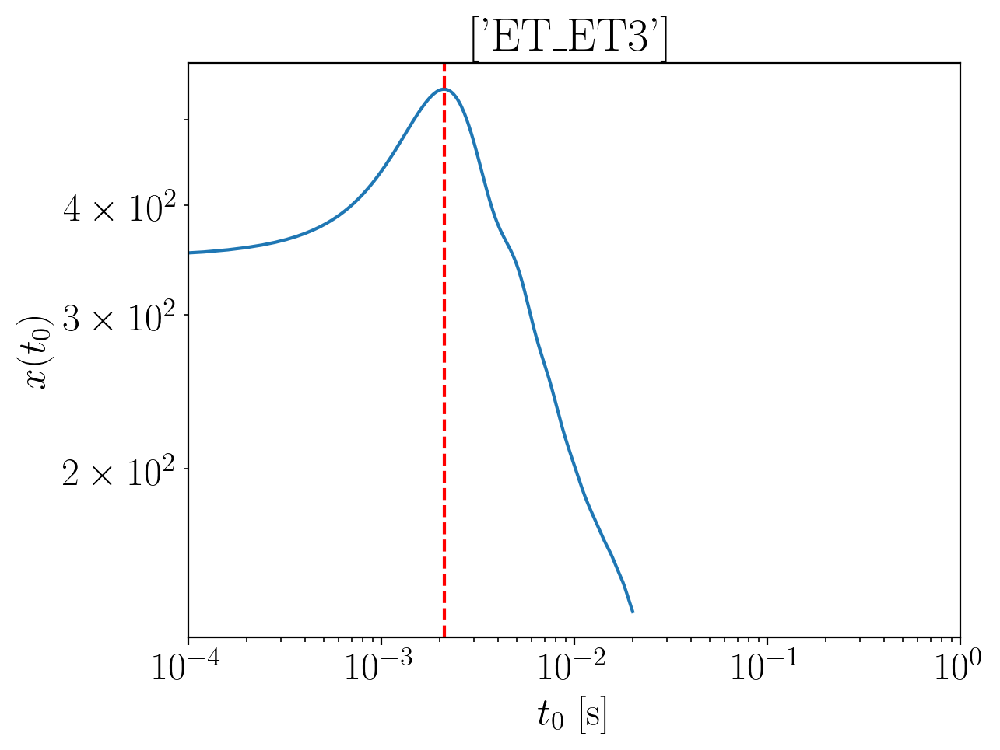

2024-01-15 15:54:12,809 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:12,825 - Network - INFO : PSDs loaded.
2024-01-15 15:54:12,827 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:12,834 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:12,842 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:12,865 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:12,866 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:54:12,870 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.349907432334216
Inner product:
0.9993176198987967


2024-01-15 15:54:18,239 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:54:18,285 - Network - INFO : PSDs loaded.
2024-01-15 15:54:18,292 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:18,309 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:18,310 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:54:18,311 - Network - INFO :    CE-40_C
2024-01-15 15:54:21,923 - Network - INFO :    CE-20_S
2024-01-15 15:54:25,532 - Network - INFO :    ET_ET1
2024-01-15 15:54:29,149 - Network - INFO :    ET_ET2
2024-01-15 15:54:32,768 - Network - INFO :    ET_ET3
2024-01-15 15:54:36,375 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:54:36,382 - Network - INFO : SNRs calculated.
2024-01-15 15:54:36,383 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:54:36,383 - Network - INFO :    CE-40_C
2024-01-15 15:54:36,476 - Network - INFO :

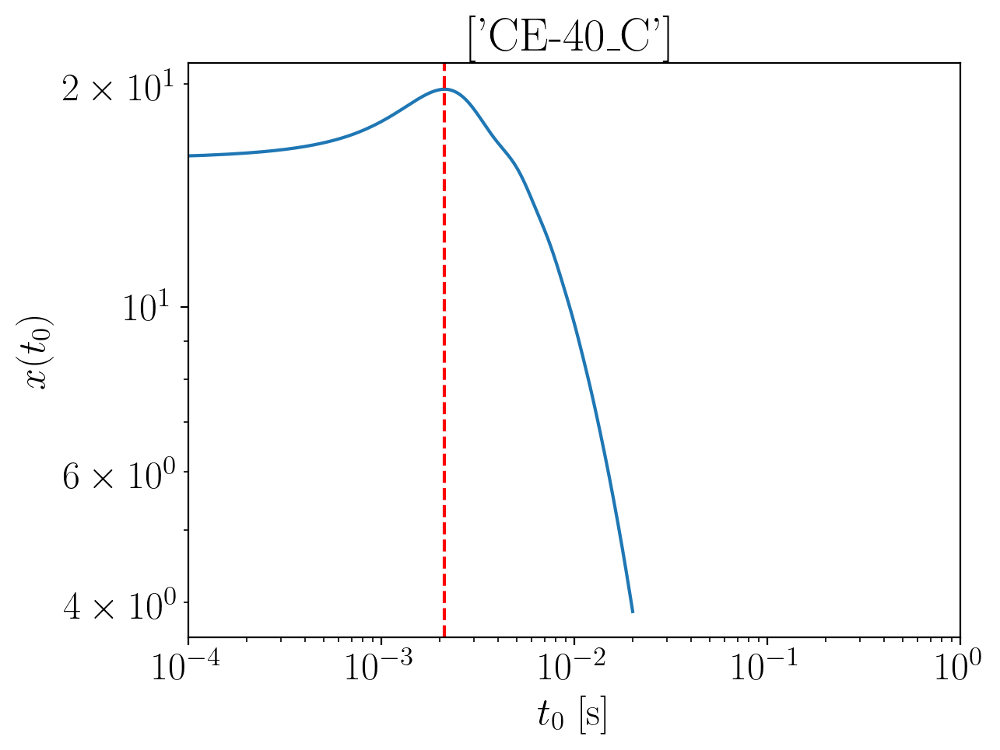

2024-01-15 15:54:38,210 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:38,230 - Network - INFO : PSDs loaded.
2024-01-15 15:54:38,241 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:38,254 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:38,268 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3392343649211926
Inner product:
0.9996458389246424


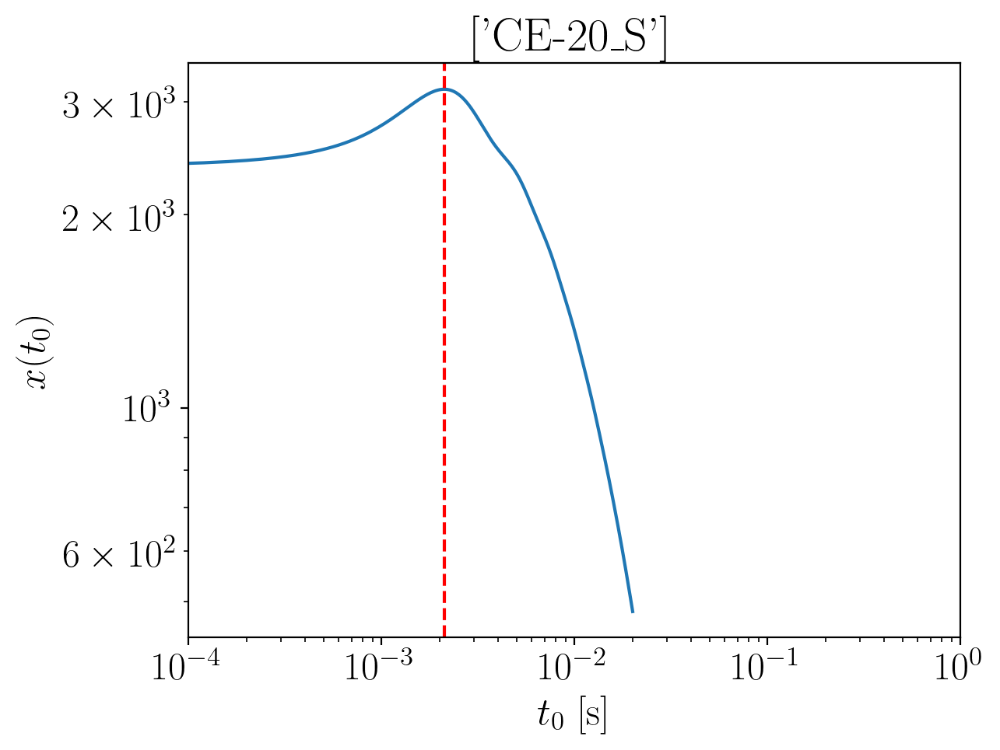

2024-01-15 15:54:39,436 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:39,450 - Network - INFO : PSDs loaded.
2024-01-15 15:54:39,456 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:39,482 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:39,489 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3409880820995896
Inner product:
0.9995380545462497


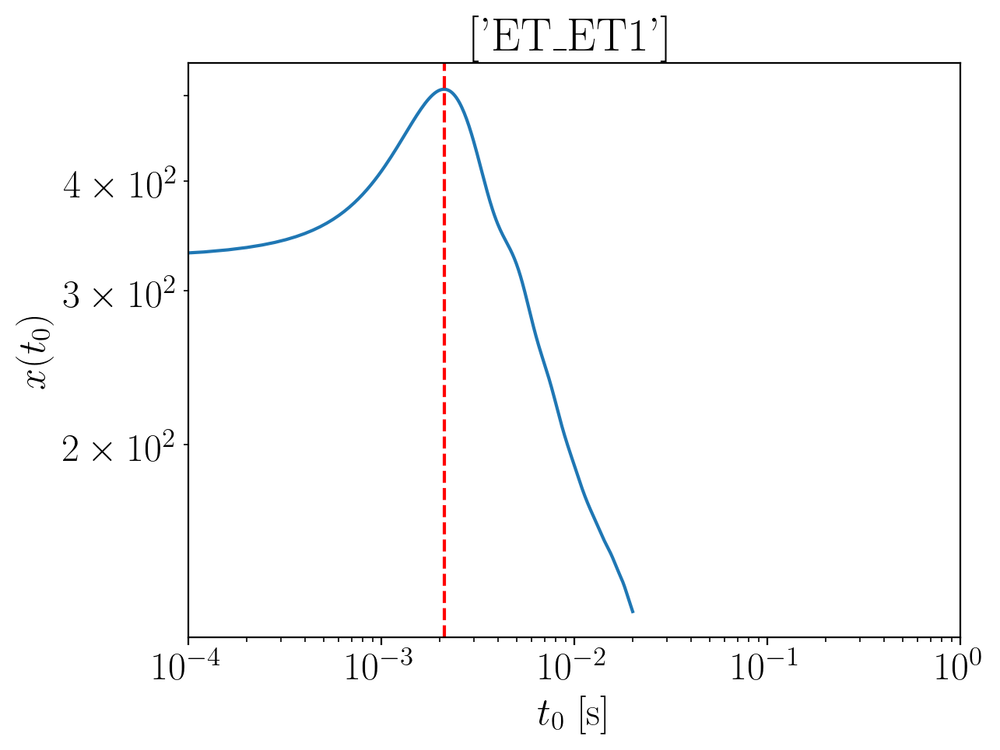

2024-01-15 15:54:40,914 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:40,928 - Network - INFO : PSDs loaded.
2024-01-15 15:54:40,930 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:40,937 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:40,944 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.338121130460573
Inner product:
0.999317619898797


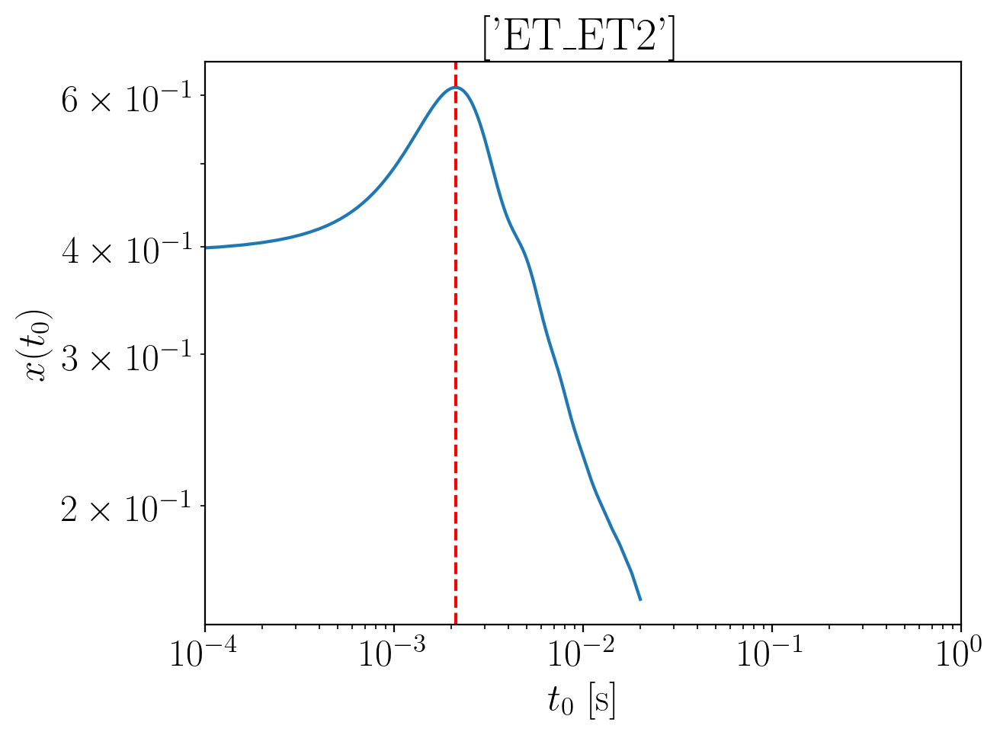

2024-01-15 15:54:42,318 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:42,464 - Network - INFO : PSDs loaded.
2024-01-15 15:54:42,466 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:42,473 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:42,479 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.338121130460573
Inner product:
0.999317619898797


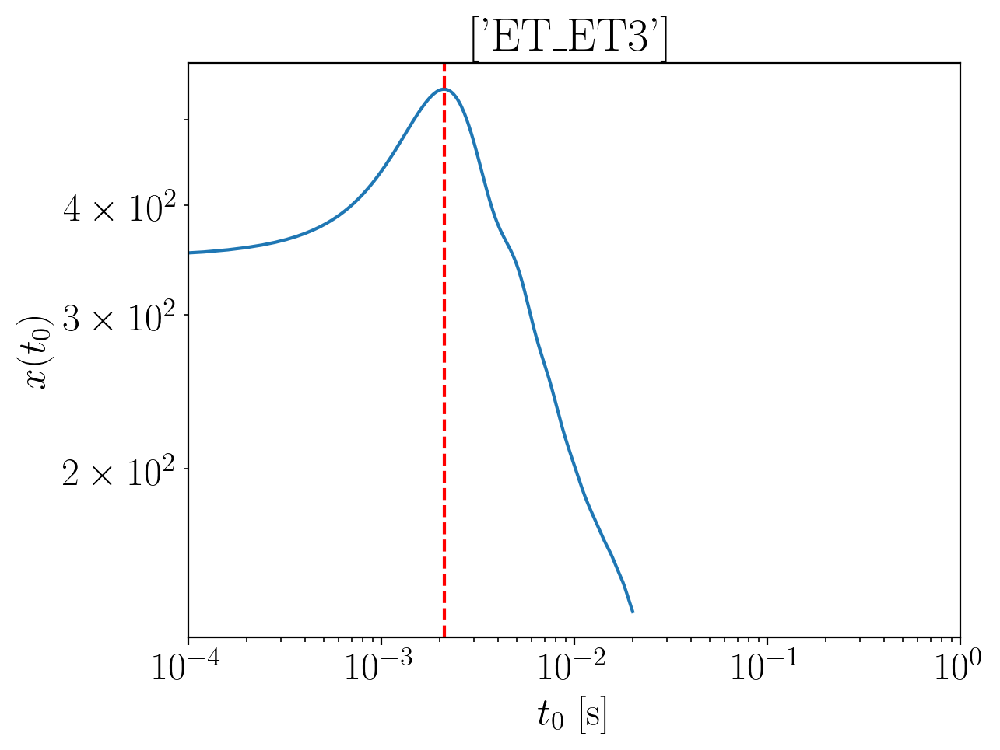

2024-01-15 15:54:43,872 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:43,886 - Network - INFO : PSDs loaded.
2024-01-15 15:54:43,890 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:43,899 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:43,906 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:43,929 - Network - INFO : Polarizations calculated.
2024-01-15 15:54:43,930 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:54:43,935 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.338121130460573
Inner product:
0.999317619898797


2024-01-15 15:54:49,298 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:54:49,343 - Network - INFO : PSDs loaded.
2024-01-15 15:54:49,348 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:54:49,366 - Network - INFO : Detector responses calculated.
2024-01-15 15:54:49,367 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:54:49,368 - Network - INFO :    CE-40_C
2024-01-15 15:54:52,948 - Network - INFO :    CE-20_S
2024-01-15 15:54:56,653 - Network - INFO :    ET_ET1
2024-01-15 15:55:00,257 - Network - INFO :    ET_ET2
2024-01-15 15:55:03,822 - Network - INFO :    ET_ET3
2024-01-15 15:55:07,408 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:55:07,415 - Network - INFO : SNRs calculated.
2024-01-15 15:55:07,416 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:55:07,416 - Network - INFO :    CE-40_C
2024-01-15 15:55:07,510 - Network - INFO :

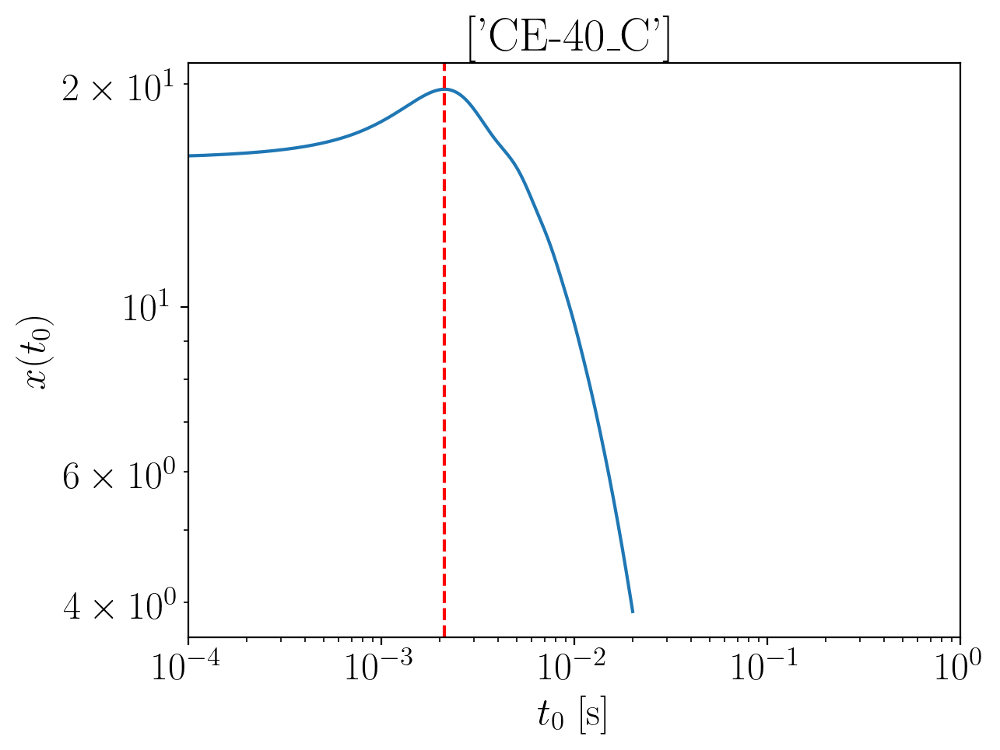

2024-01-15 15:55:09,250 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:09,264 - Network - INFO : PSDs loaded.
2024-01-15 15:55:09,268 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:09,280 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:09,293 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3268659617988297
Inner product:
0.9996458389246424


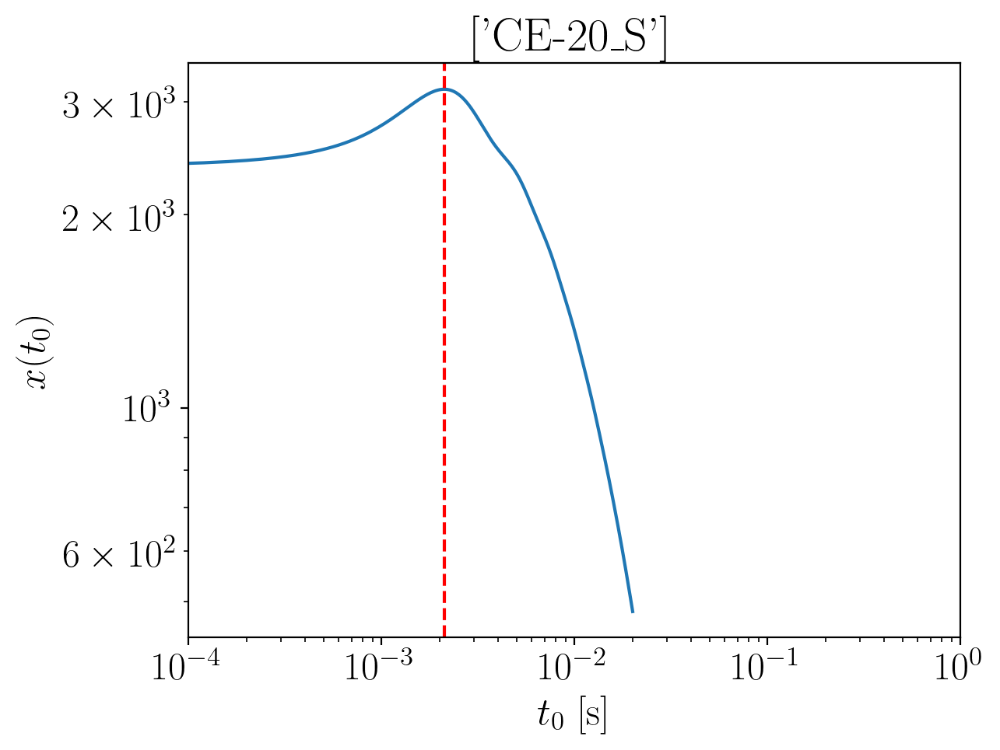

2024-01-15 15:55:10,457 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:10,464 - Network - INFO : PSDs loaded.
2024-01-15 15:55:10,466 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:10,473 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:10,479 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3286196789772293
Inner product:
0.9995380545462498


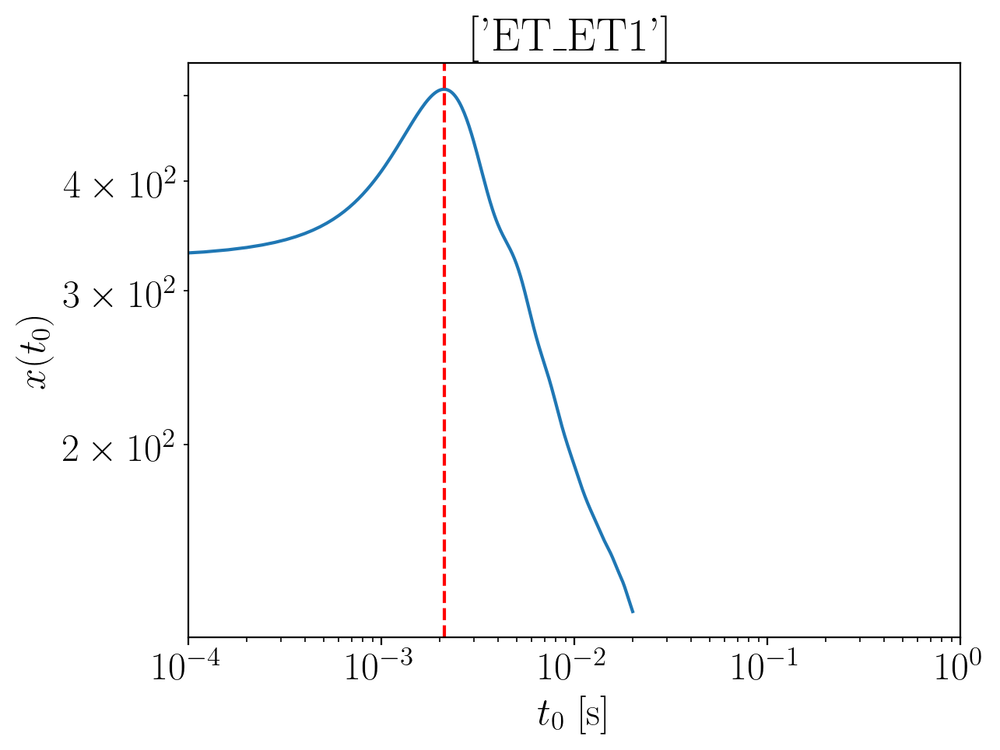

2024-01-15 15:55:11,883 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:11,903 - Network - INFO : PSDs loaded.
2024-01-15 15:55:11,905 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:11,911 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:11,918 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.325752727338198
Inner product:
0.9993176198987969


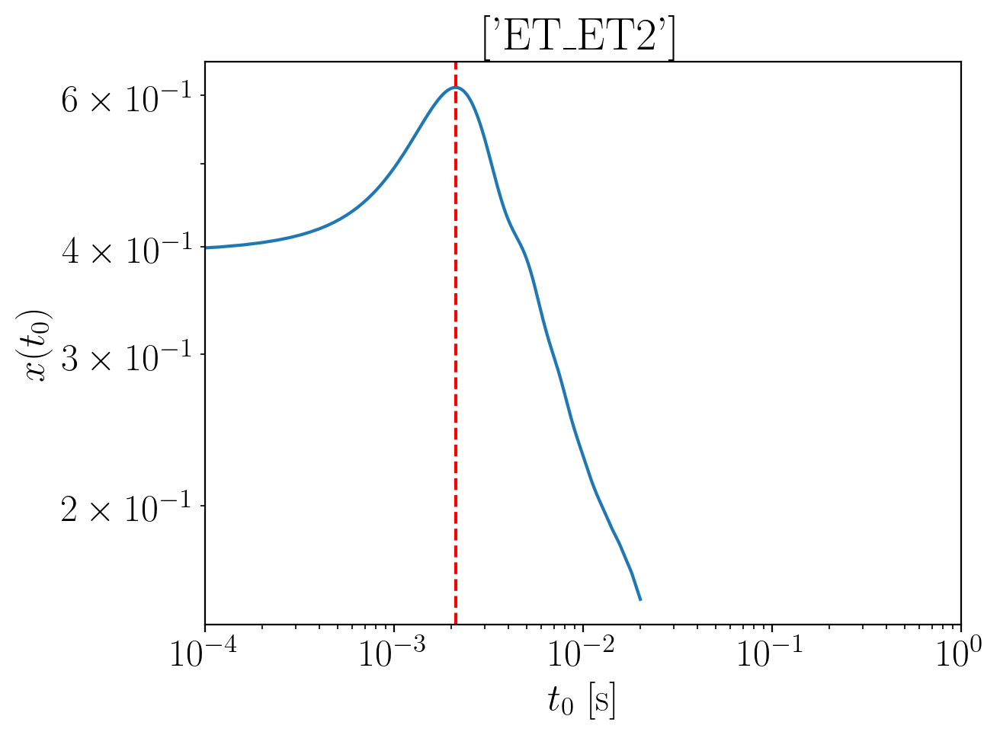

2024-01-15 15:55:13,324 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:13,338 - Network - INFO : PSDs loaded.
2024-01-15 15:55:13,340 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:13,348 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:13,354 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.325752727338198
Inner product:
0.999317619898797


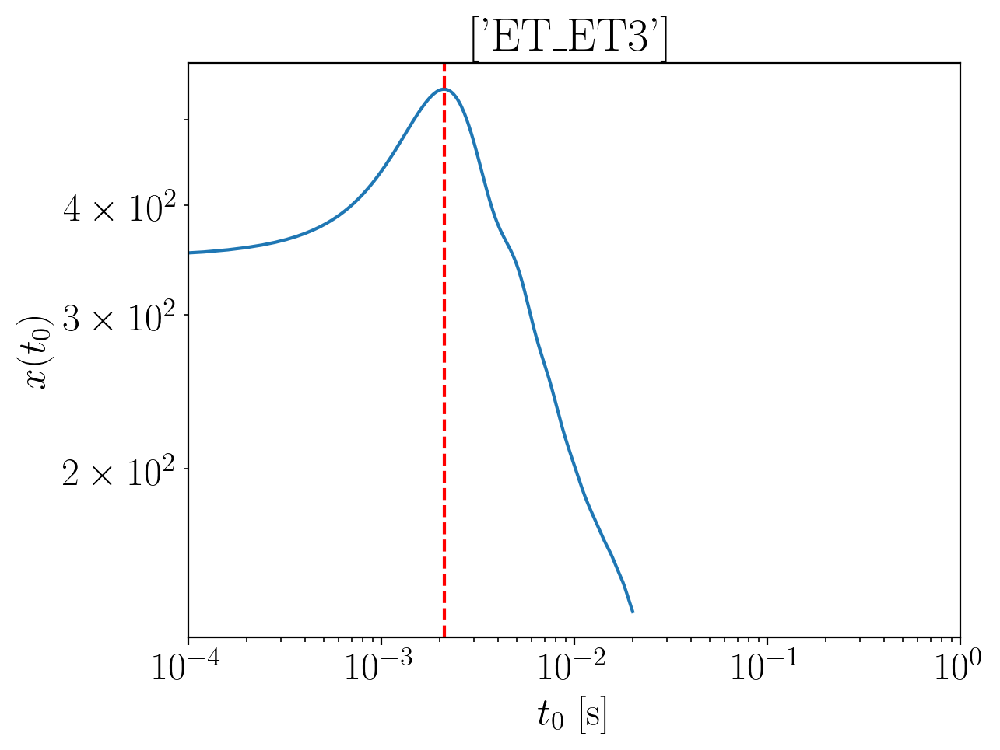

2024-01-15 15:55:14,764 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:14,784 - Network - INFO : PSDs loaded.
2024-01-15 15:55:14,789 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:14,803 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:14,811 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:14,840 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:14,841 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:55:14,845 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3257527273381986
Inner product:
0.9993176198987966


2024-01-15 15:55:20,258 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:55:20,303 - Network - INFO : PSDs loaded.
2024-01-15 15:55:20,310 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:20,329 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:20,330 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:55:20,331 - Network - INFO :    CE-40_C
2024-01-15 15:55:23,941 - Network - INFO :    CE-20_S
2024-01-15 15:55:27,552 - Network - INFO :    ET_ET1
2024-01-15 15:55:31,193 - Network - INFO :    ET_ET2
2024-01-15 15:55:34,855 - Network - INFO :    ET_ET3
2024-01-15 15:55:38,431 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:55:38,439 - Network - INFO : SNRs calculated.
2024-01-15 15:55:38,439 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:55:38,439 - Network - INFO :    CE-40_C
2024-01-15 15:55:38,534 - Network - INFO :

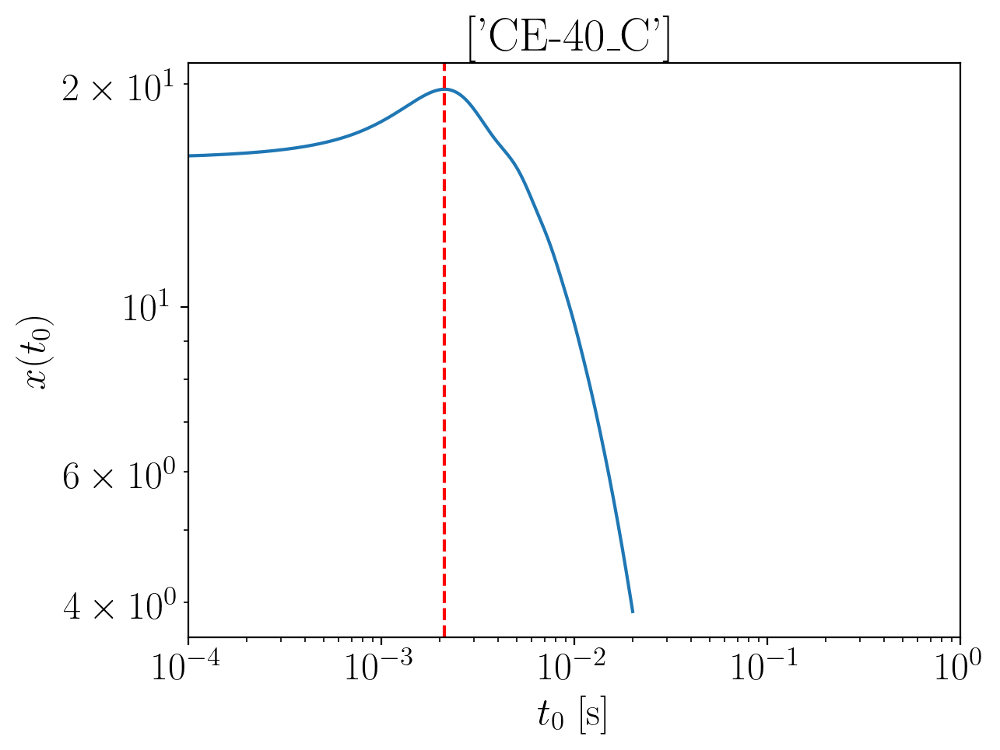

2024-01-15 15:55:40,416 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:40,428 - Network - INFO : PSDs loaded.
2024-01-15 15:55:40,440 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:40,455 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:40,470 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3141608044852124
Inner product:
0.9996458389246424


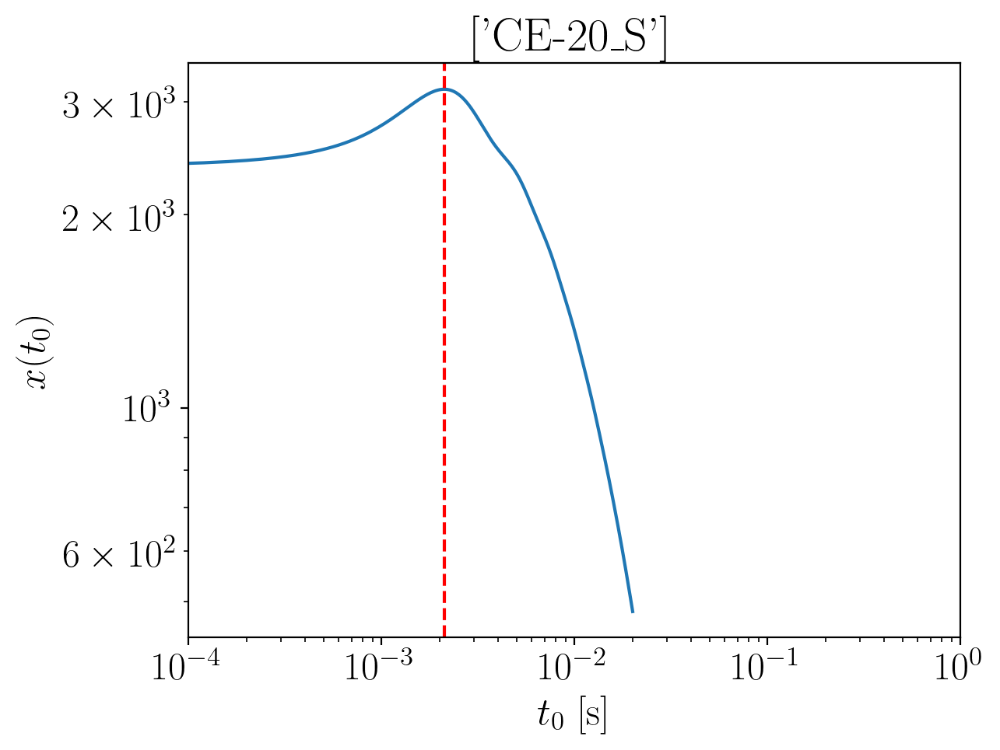

2024-01-15 15:55:41,635 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:41,658 - Network - INFO : PSDs loaded.
2024-01-15 15:55:41,669 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:41,681 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:41,699 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3159145216636126
Inner product:
0.9995380545462497


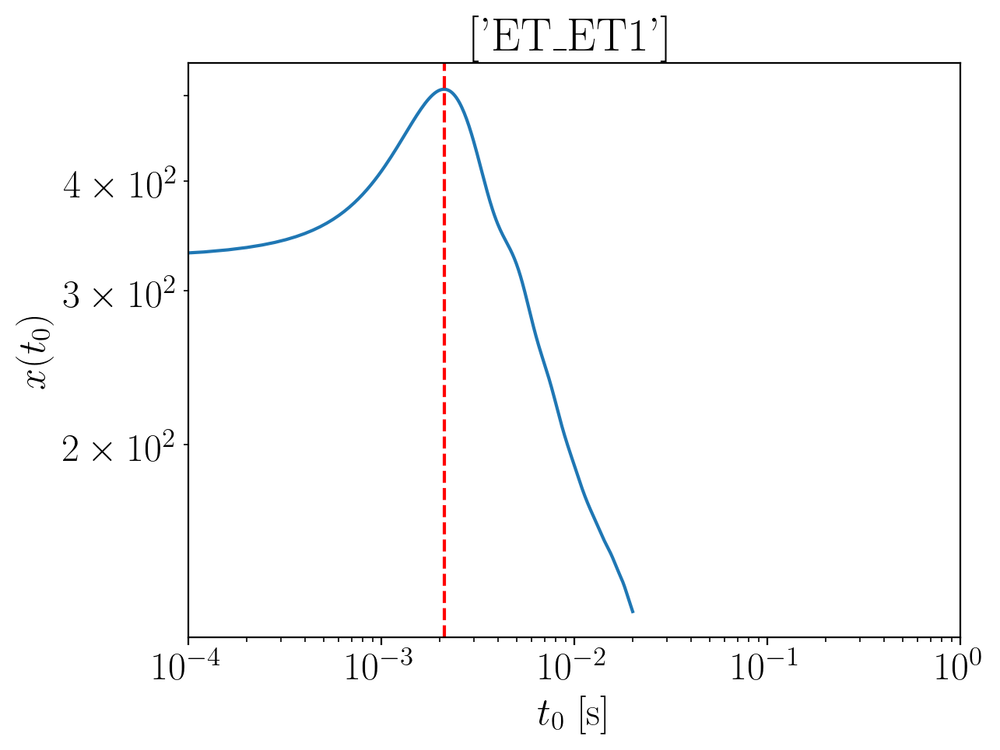

2024-01-15 15:55:43,155 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:43,170 - Network - INFO : PSDs loaded.
2024-01-15 15:55:43,173 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:43,181 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:43,188 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3130475700245876
Inner product:
0.9993176198987969


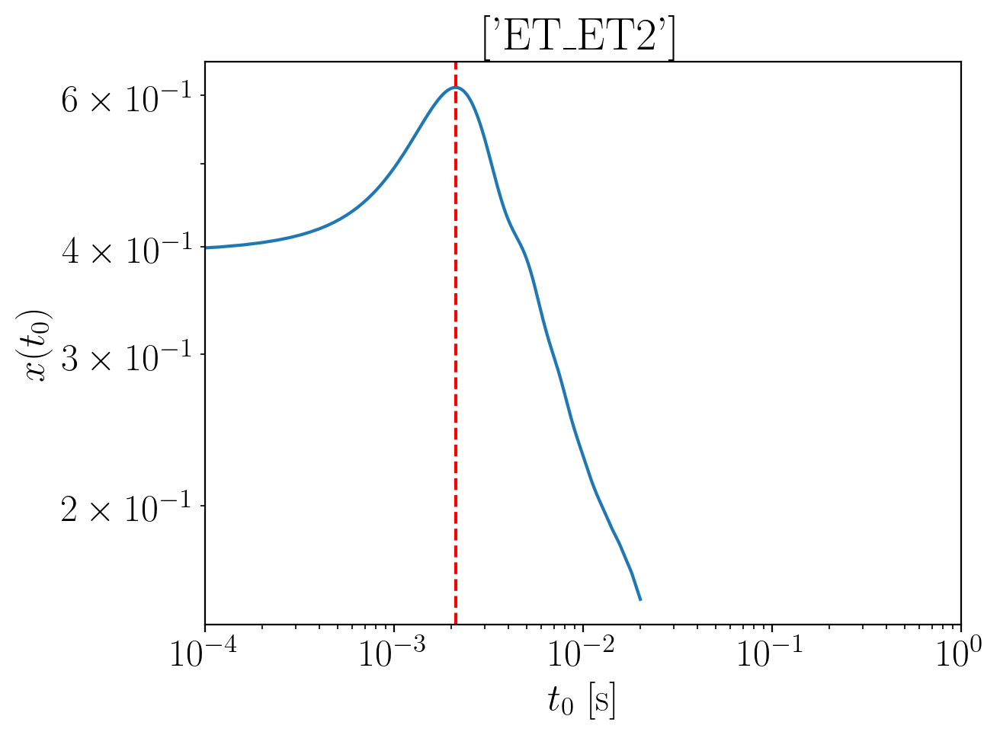

2024-01-15 15:55:44,557 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:44,573 - Network - INFO : PSDs loaded.
2024-01-15 15:55:44,578 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:44,591 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:44,598 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3130475700245876
Inner product:
0.9993176198987969


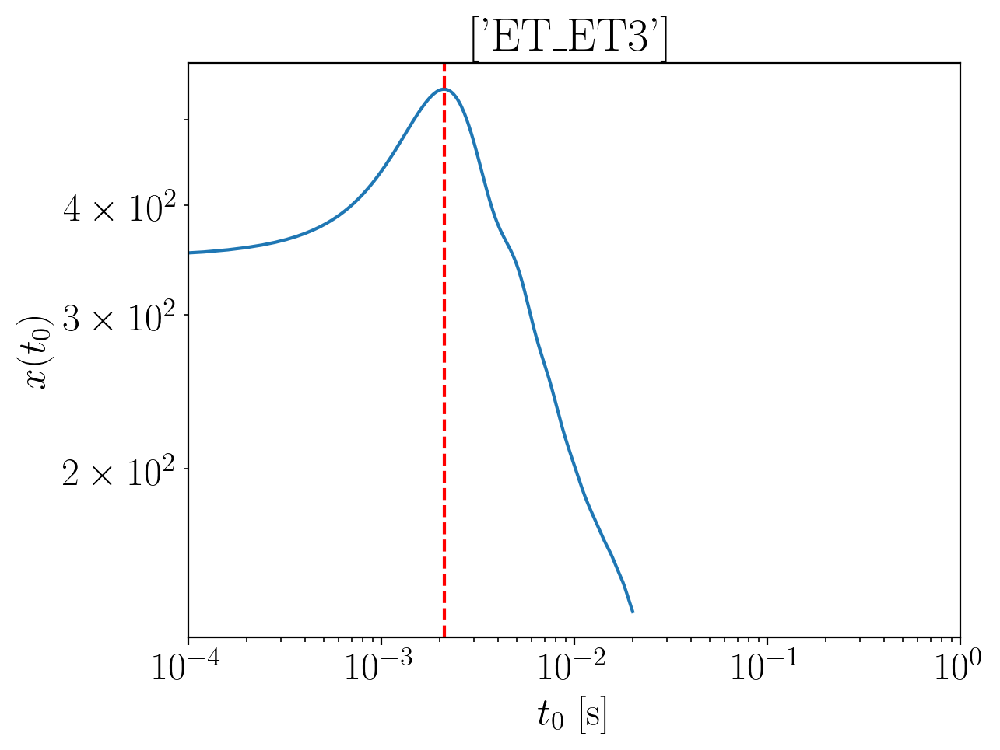

2024-01-15 15:55:45,970 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:45,986 - Network - INFO : PSDs loaded.
2024-01-15 15:55:45,989 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:46,005 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:46,015 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:46,039 - Network - INFO : Polarizations calculated.
2024-01-15 15:55:46,039 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:55:46,044 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3130475700245876
Inner product:
0.9993176198987966


2024-01-15 15:55:51,385 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:55:51,430 - Network - INFO : PSDs loaded.
2024-01-15 15:55:51,436 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:55:51,454 - Network - INFO : Detector responses calculated.
2024-01-15 15:55:51,455 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:55:51,456 - Network - INFO :    CE-40_C
2024-01-15 15:55:55,064 - Network - INFO :    CE-20_S
2024-01-15 15:55:58,679 - Network - INFO :    ET_ET1
2024-01-15 15:56:02,263 - Network - INFO :    ET_ET2
2024-01-15 15:56:05,913 - Network - INFO :    ET_ET3
2024-01-15 15:56:09,501 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:56:09,508 - Network - INFO : SNRs calculated.
2024-01-15 15:56:09,508 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:56:09,509 - Network - INFO :    CE-40_C
2024-01-15 15:56:09,602 - Network - INFO :

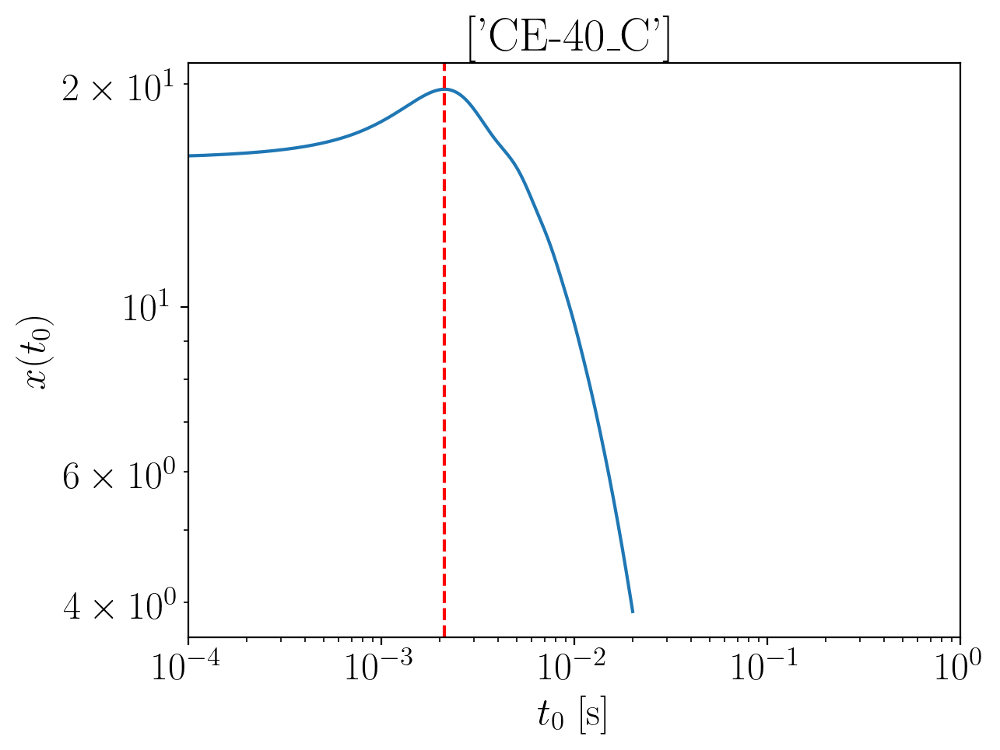

2024-01-15 15:56:11,361 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:11,375 - Network - INFO : PSDs loaded.
2024-01-15 15:56:11,381 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:11,412 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:11,433 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3012273911100607
Inner product:
0.9996458389246424


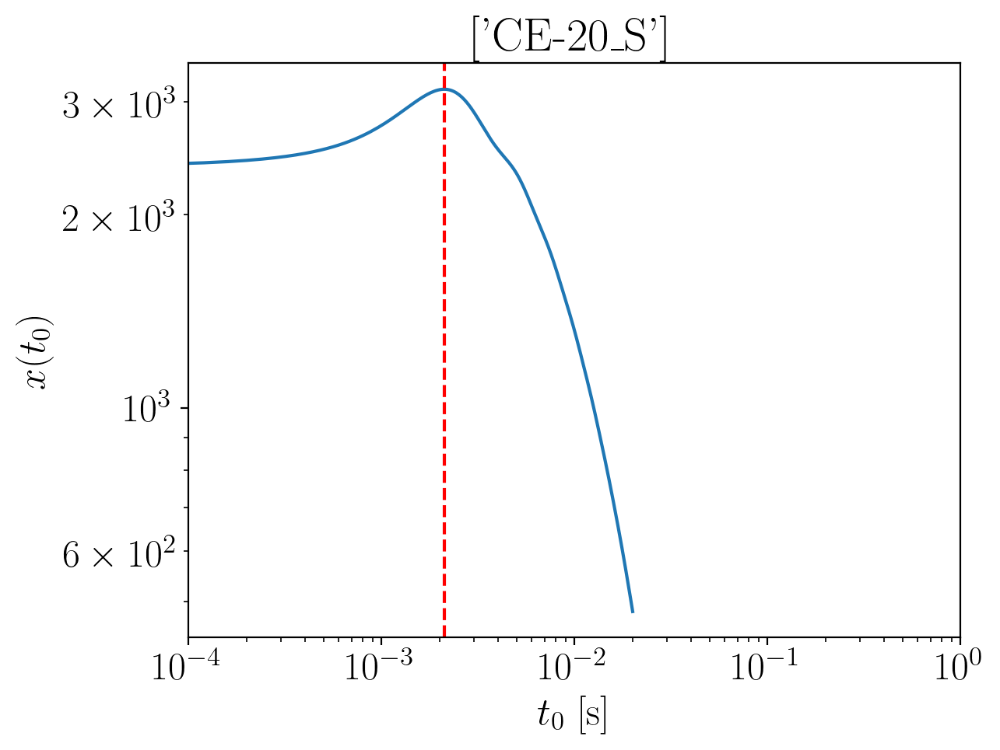

2024-01-15 15:56:12,730 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:12,765 - Network - INFO : PSDs loaded.
2024-01-15 15:56:12,778 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:12,792 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:12,816 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.3029811082884617
Inner product:
0.9995380545462497


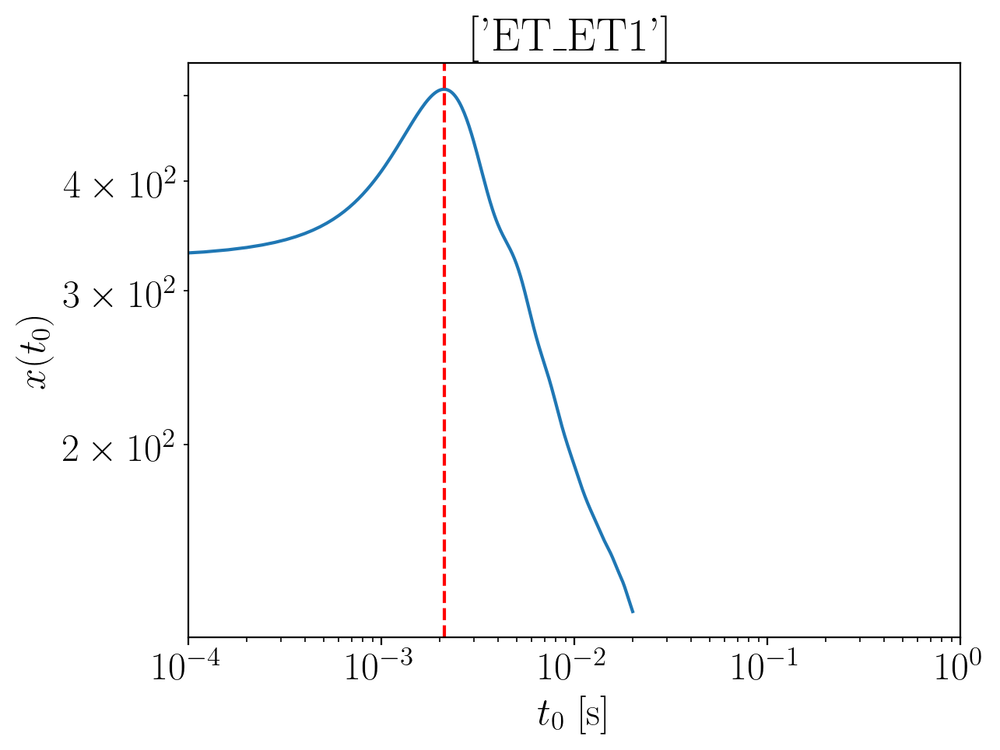

2024-01-15 15:56:14,250 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:14,265 - Network - INFO : PSDs loaded.
2024-01-15 15:56:14,270 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:14,277 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:14,284 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300114156649435
Inner product:
0.9993176198987969


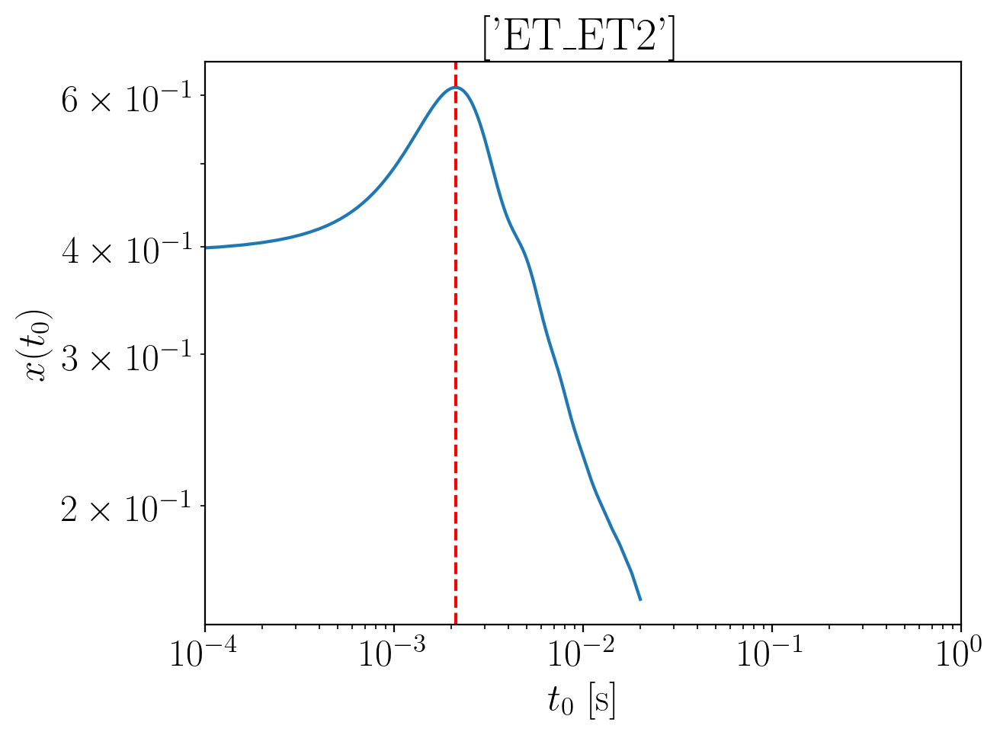

2024-01-15 15:56:15,688 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:15,721 - Network - INFO : PSDs loaded.
2024-01-15 15:56:15,724 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:15,732 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:15,739 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300114156649435
Inner product:
0.9993176198987967


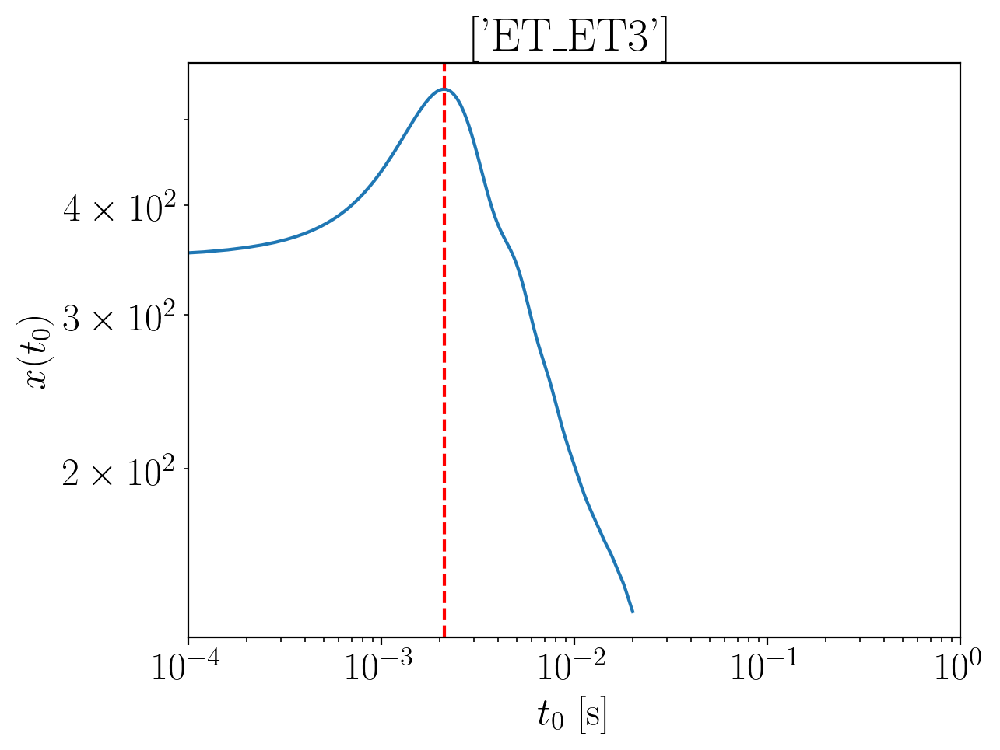

2024-01-15 15:56:17,168 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:17,182 - Network - INFO : PSDs loaded.
2024-01-15 15:56:17,184 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:17,194 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:17,200 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:17,224 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:17,224 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:56:17,229 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.300114156649435
Inner product:
0.9993176198987966


2024-01-15 15:56:22,670 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:56:22,720 - Network - INFO : PSDs loaded.
2024-01-15 15:56:22,725 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:22,748 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:22,749 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:56:22,749 - Network - INFO :    CE-40_C
2024-01-15 15:56:26,577 - Network - INFO :    CE-20_S
2024-01-15 15:56:30,161 - Network - INFO :    ET_ET1
2024-01-15 15:56:33,770 - Network - INFO :    ET_ET2
2024-01-15 15:56:37,410 - Network - INFO :    ET_ET3
2024-01-15 15:56:40,993 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:56:41,000 - Network - INFO : SNRs calculated.
2024-01-15 15:56:41,001 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:56:41,001 - Network - INFO :    CE-40_C
2024-01-15 15:56:41,095 - Network - INFO :

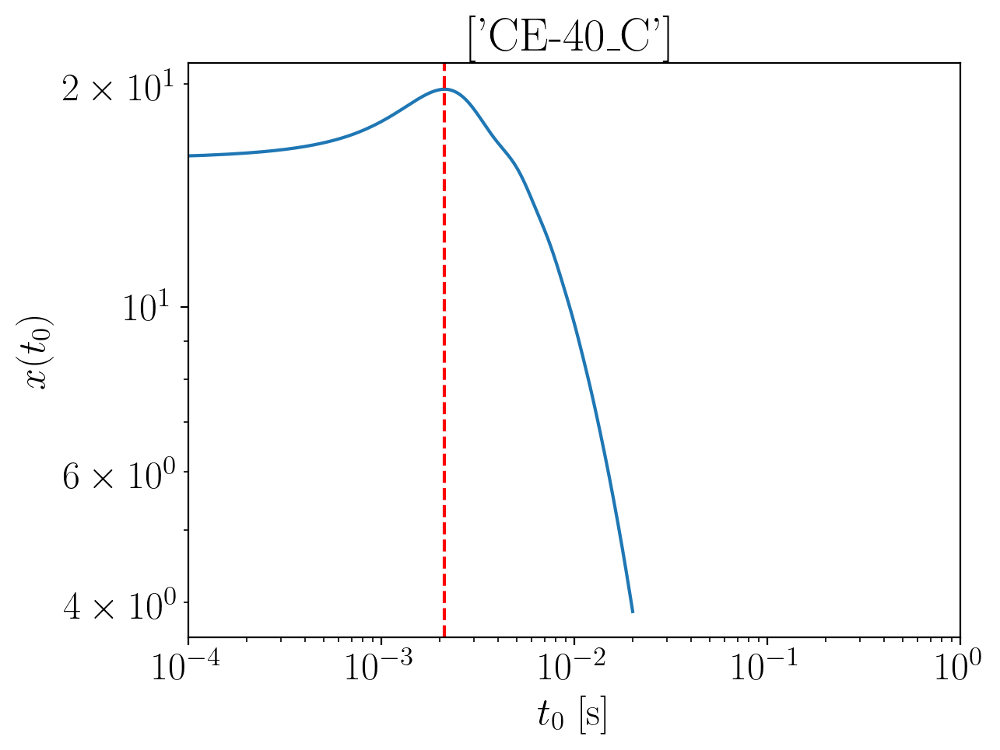

2024-01-15 15:56:42,814 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:42,822 - Network - INFO : PSDs loaded.
2024-01-15 15:56:42,827 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:42,844 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:42,862 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.288126170771048
Inner product:
0.9996458389246424


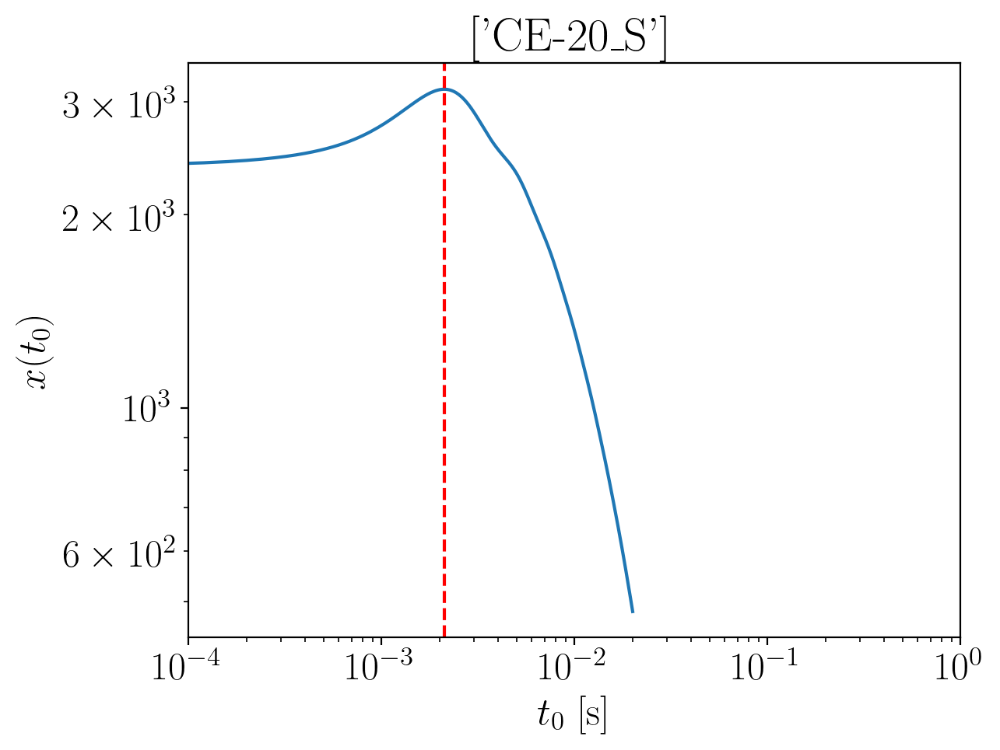

2024-01-15 15:56:44,028 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:44,035 - Network - INFO : PSDs loaded.
2024-01-15 15:56:44,037 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:44,044 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:44,050 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.289879887949449
Inner product:
0.9995380545462498


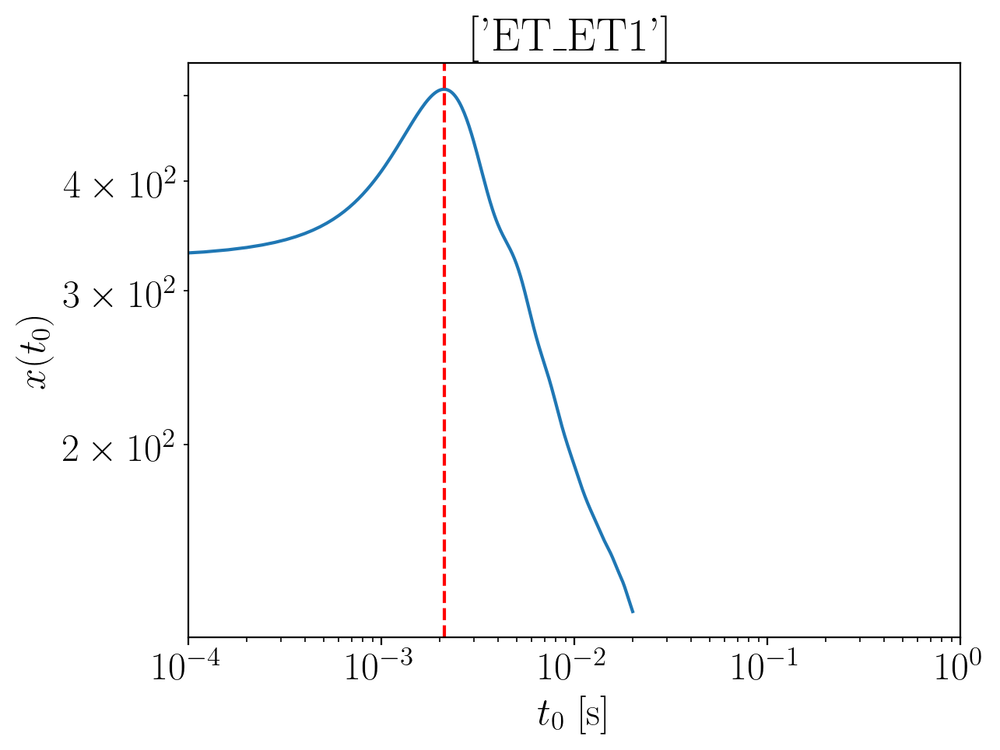

2024-01-15 15:56:45,443 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:45,463 - Network - INFO : PSDs loaded.
2024-01-15 15:56:45,471 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:45,492 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:45,502 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2870129363104206
Inner product:
0.999317619898797


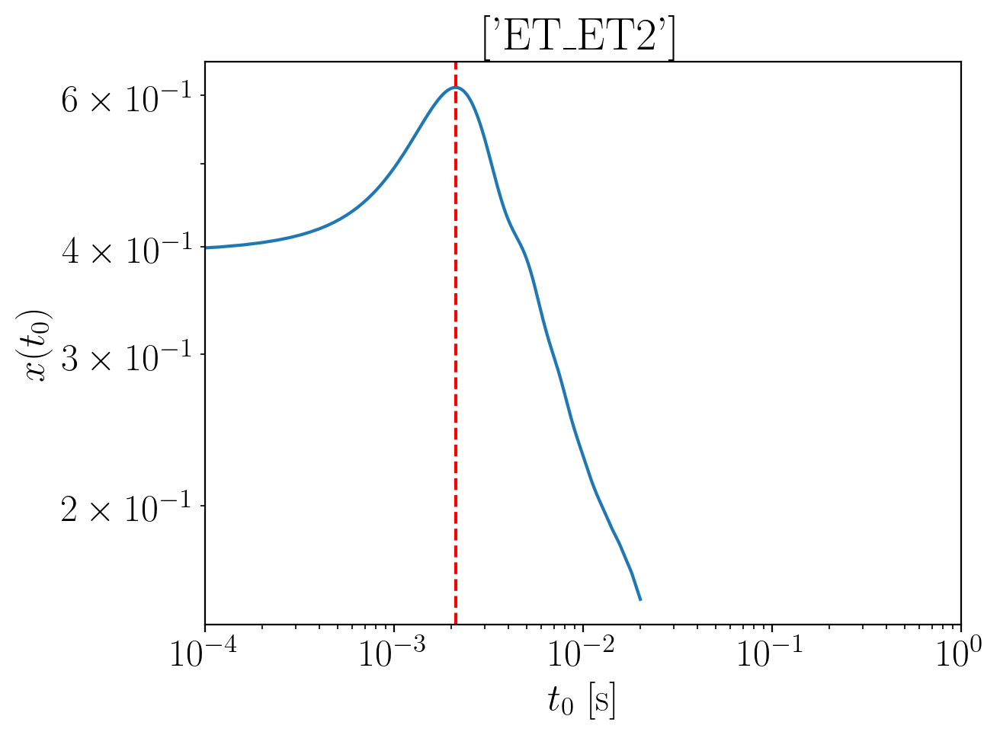

2024-01-15 15:56:46,974 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:46,989 - Network - INFO : PSDs loaded.
2024-01-15 15:56:46,991 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:46,998 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:47,005 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.28701293631042
Inner product:
0.9993176198987969


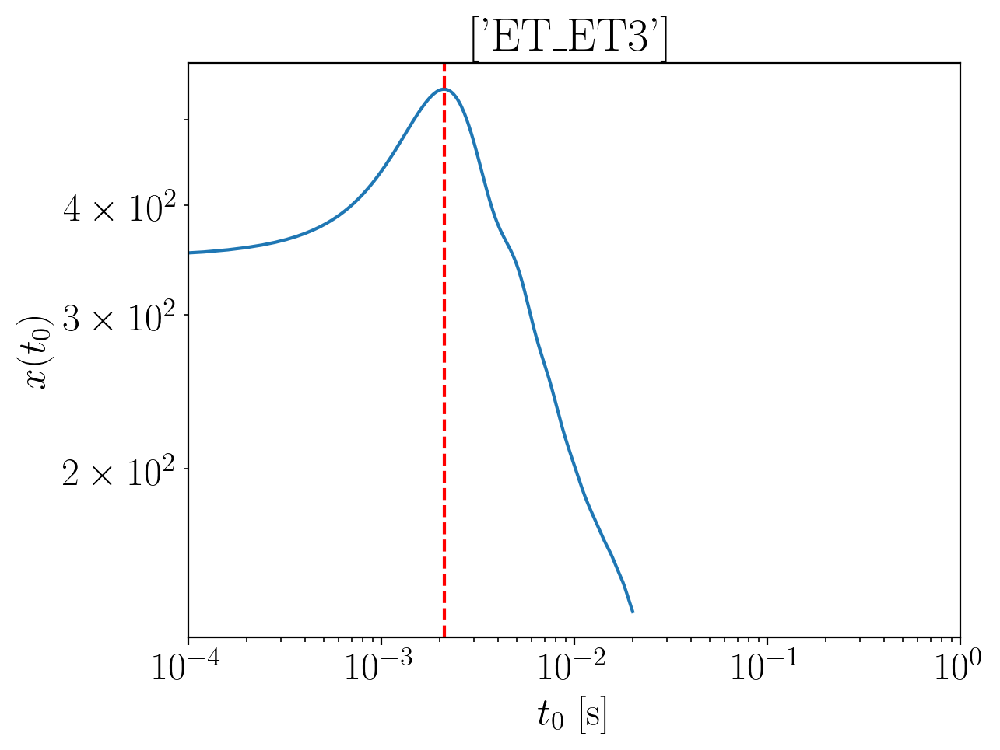

2024-01-15 15:56:48,556 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:48,570 - Network - INFO : PSDs loaded.
2024-01-15 15:56:48,572 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:48,578 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:48,589 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:48,613 - Network - INFO : Polarizations calculated.
2024-01-15 15:56:48,614 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:56:48,619 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.28701293631042
Inner product:
0.9993176198987966


2024-01-15 15:56:53,992 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:56:54,036 - Network - INFO : PSDs loaded.
2024-01-15 15:56:54,042 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:56:54,059 - Network - INFO : Detector responses calculated.
2024-01-15 15:56:54,060 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:56:54,060 - Network - INFO :    CE-40_C
2024-01-15 15:56:57,671 - Network - INFO :    CE-20_S
2024-01-15 15:57:01,245 - Network - INFO :    ET_ET1
2024-01-15 15:57:04,833 - Network - INFO :    ET_ET2
2024-01-15 15:57:08,409 - Network - INFO :    ET_ET3
2024-01-15 15:57:12,098 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:57:12,105 - Network - INFO : SNRs calculated.
2024-01-15 15:57:12,105 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:57:12,106 - Network - INFO :    CE-40_C
2024-01-15 15:57:12,199 - Network - INFO :

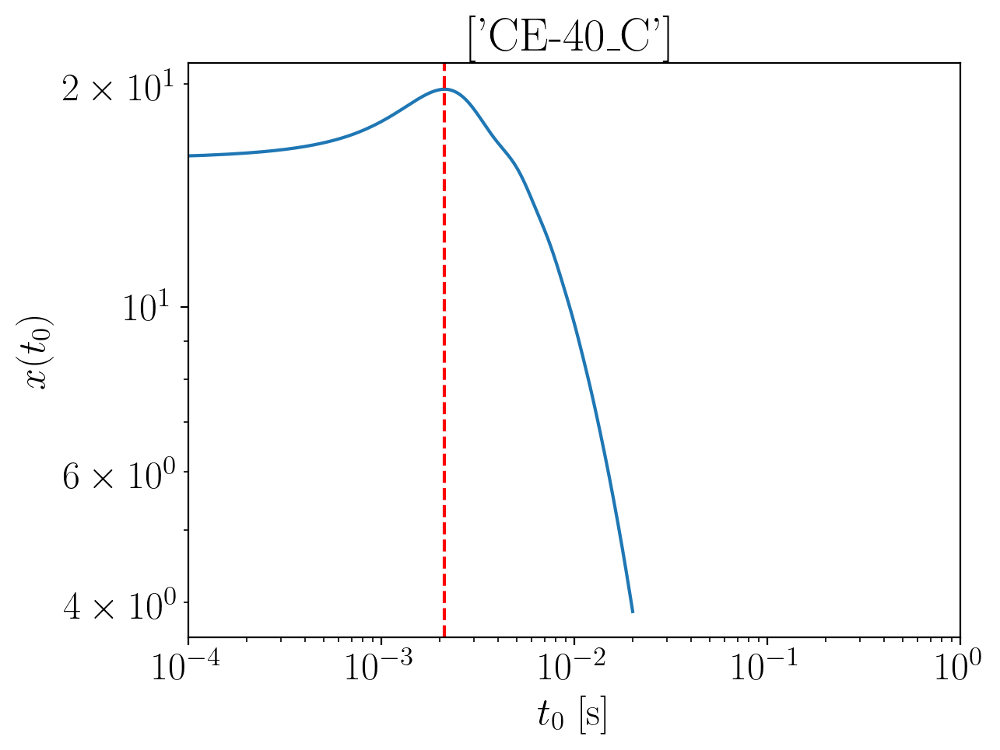

2024-01-15 15:57:14,013 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:14,035 - Network - INFO : PSDs loaded.
2024-01-15 15:57:14,038 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:14,046 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:14,053 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.274895195509929
Inner product:
0.9996458389246424


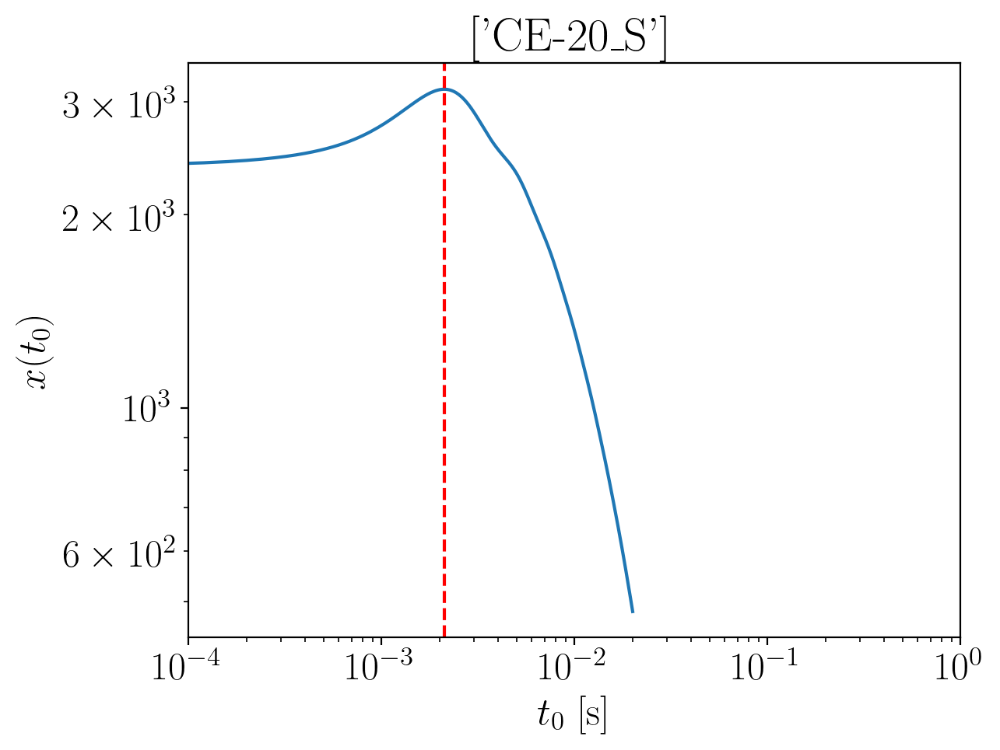

2024-01-15 15:57:15,266 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:15,273 - Network - INFO : PSDs loaded.
2024-01-15 15:57:15,275 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:15,282 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:15,288 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.27664891268833
Inner product:
0.9995380545462496


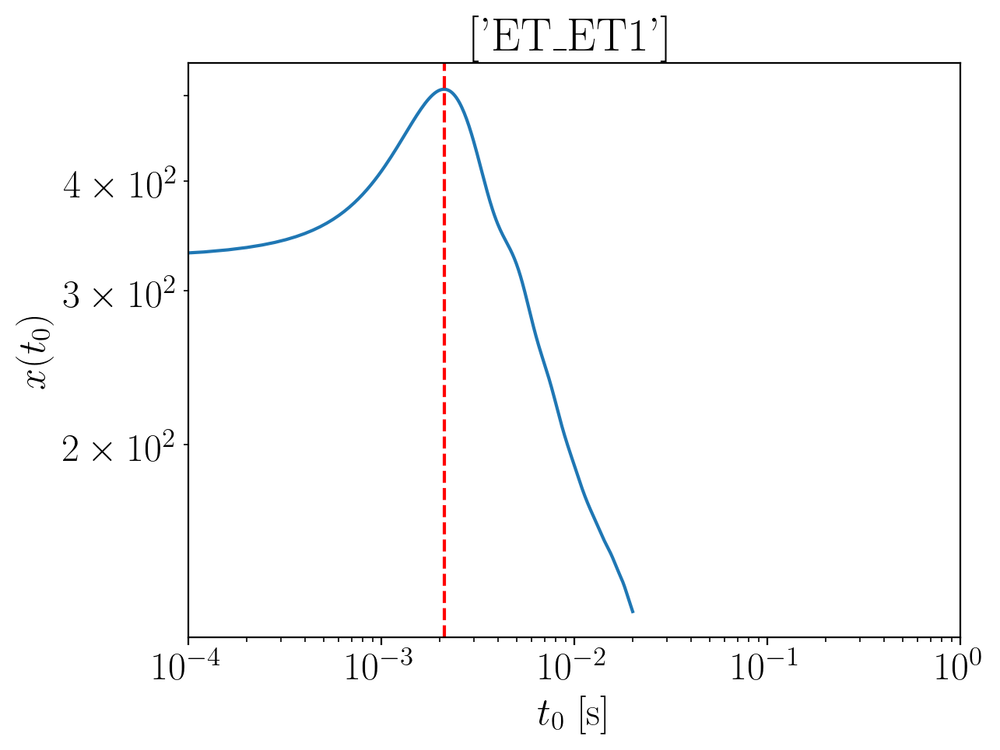

2024-01-15 15:57:16,727 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:16,749 - Network - INFO : PSDs loaded.
2024-01-15 15:57:16,751 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:16,759 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:16,766 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2737819610492975
Inner product:
0.9993176198987969


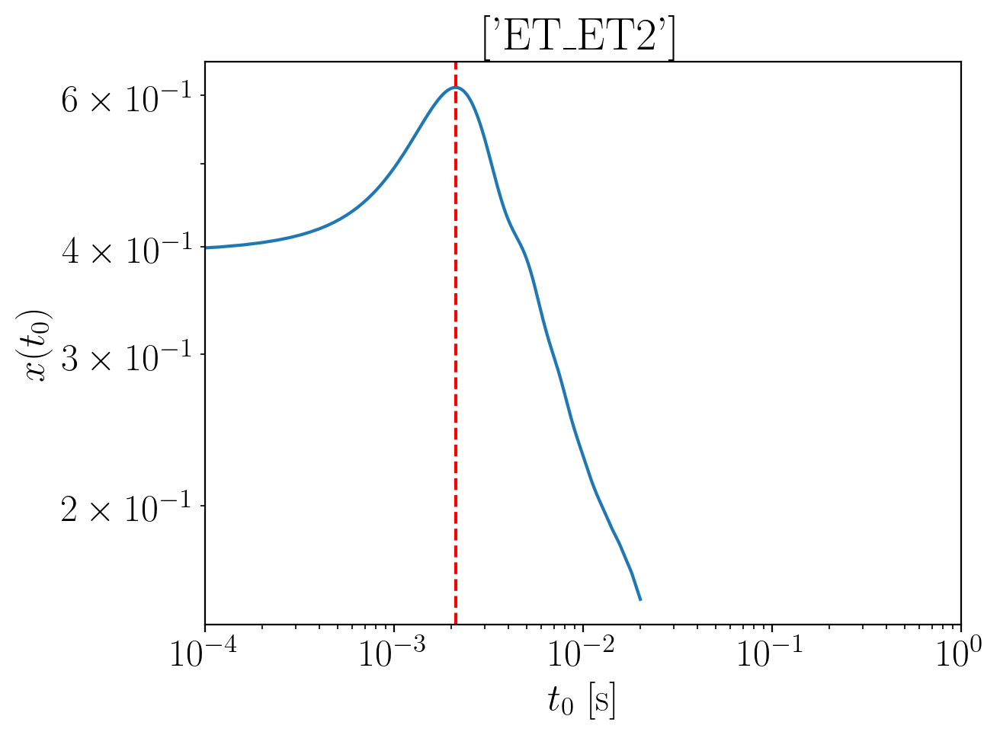

2024-01-15 15:57:18,382 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:18,397 - Network - INFO : PSDs loaded.
2024-01-15 15:57:18,399 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:18,408 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:18,415 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2737819610492975
Inner product:
0.9993176198987967


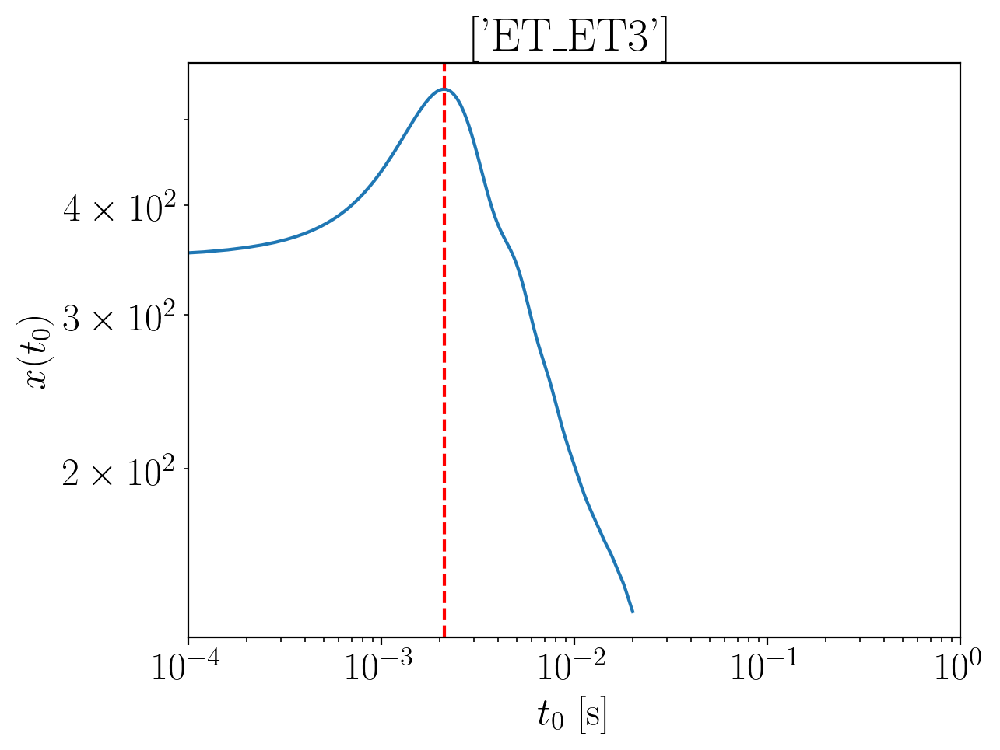

2024-01-15 15:57:20,011 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:20,028 - Network - INFO : PSDs loaded.
2024-01-15 15:57:20,031 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:20,039 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:20,048 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:20,076 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:20,077 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:57:20,083 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2737819610492975
Inner product:
0.9993176198987966


2024-01-15 15:57:25,617 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:57:25,662 - Network - INFO : PSDs loaded.
2024-01-15 15:57:25,668 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:25,686 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:25,687 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:57:25,687 - Network - INFO :    CE-40_C
2024-01-15 15:57:29,322 - Network - INFO :    CE-20_S
2024-01-15 15:57:32,876 - Network - INFO :    ET_ET1
2024-01-15 15:57:36,461 - Network - INFO :    ET_ET2
2024-01-15 15:57:40,054 - Network - INFO :    ET_ET3
2024-01-15 15:57:43,650 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:57:43,657 - Network - INFO : SNRs calculated.
2024-01-15 15:57:43,658 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:57:43,658 - Network - INFO :    CE-40_C
2024-01-15 15:57:43,751 - Network - INFO :

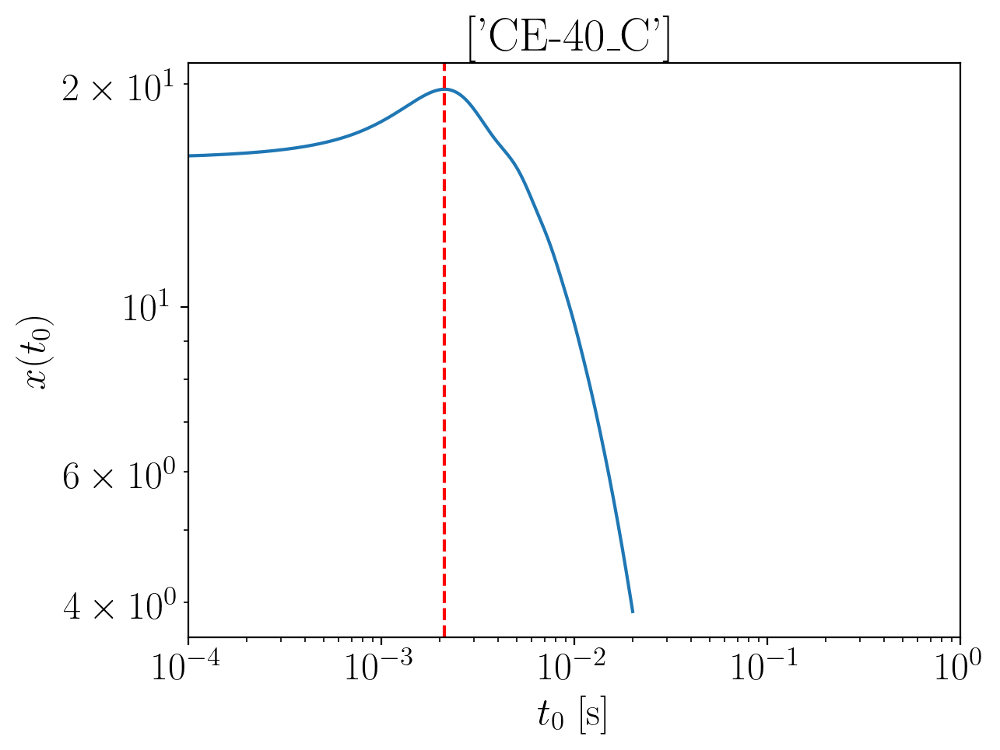

2024-01-15 15:57:45,667 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:45,675 - Network - INFO : PSDs loaded.
2024-01-15 15:57:45,677 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:45,684 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:45,691 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.261560334086425
Inner product:
0.9996458389246425


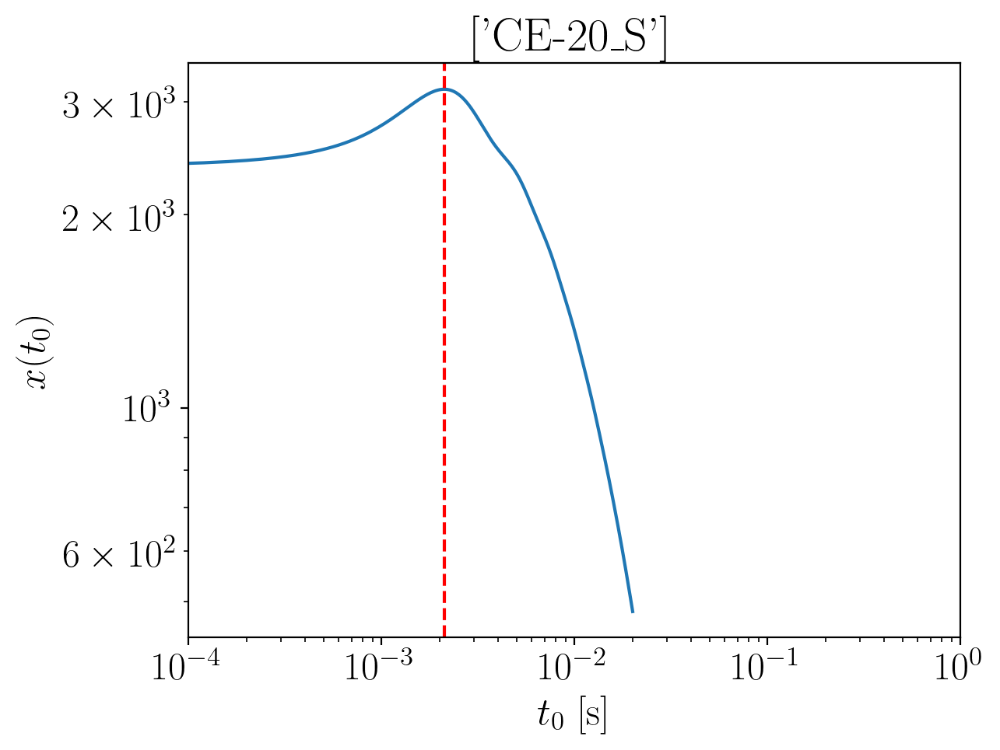

2024-01-15 15:57:46,904 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:46,911 - Network - INFO : PSDs loaded.
2024-01-15 15:57:46,914 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:46,921 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:46,928 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.263314051264826
Inner product:
0.9995380545462494


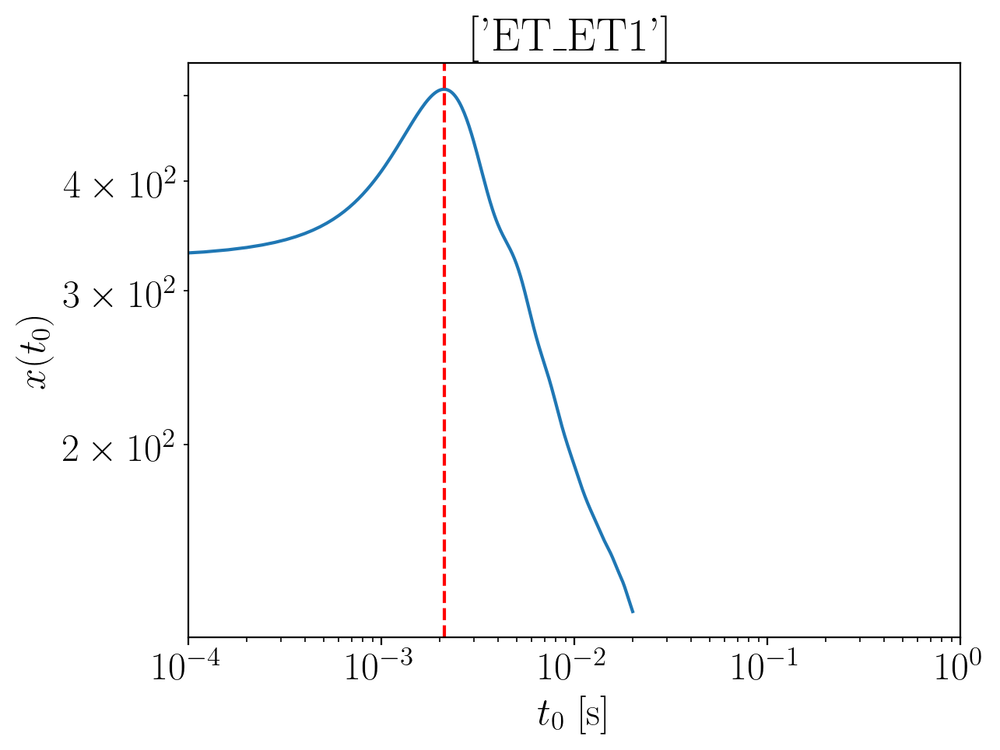

2024-01-15 15:57:48,527 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:48,541 - Network - INFO : PSDs loaded.
2024-01-15 15:57:48,544 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:48,552 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:48,558 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2604470996257926
Inner product:
0.9993176198987969


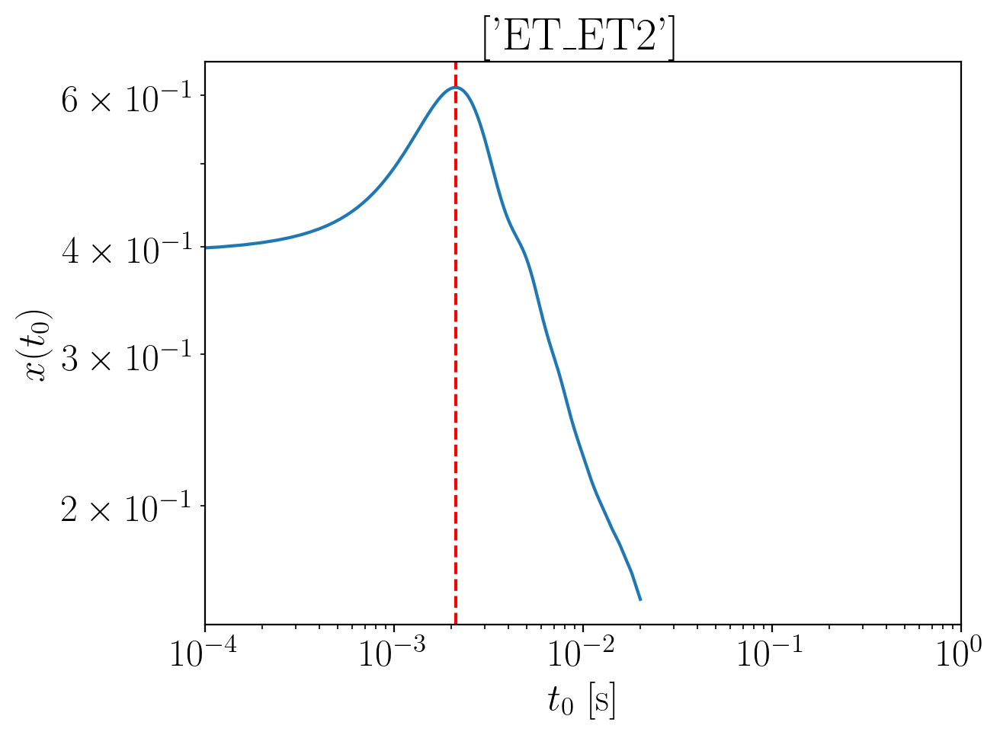

2024-01-15 15:57:50,000 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:50,014 - Network - INFO : PSDs loaded.
2024-01-15 15:57:50,017 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:50,025 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:50,037 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2604470996257926
Inner product:
0.9993176198987967


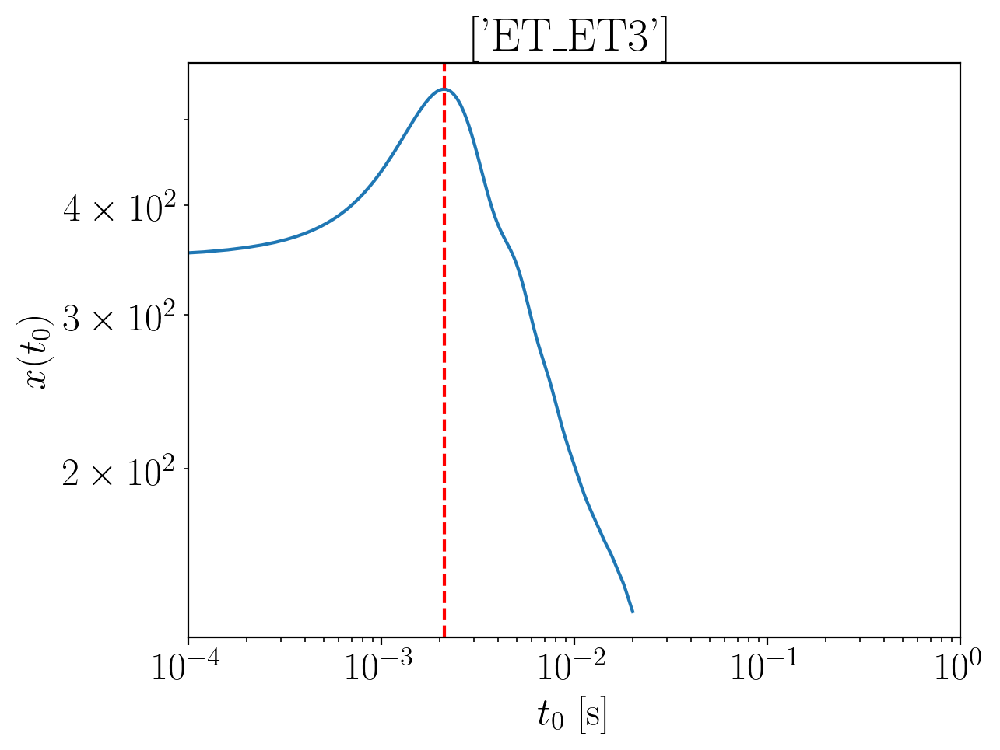

2024-01-15 15:57:51,553 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:51,568 - Network - INFO : PSDs loaded.
2024-01-15 15:57:51,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:51,578 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:51,585 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:51,612 - Network - INFO : Polarizations calculated.
2024-01-15 15:57:51,613 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:57:51,617 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2604470996257926
Inner product:
0.9993176198987967


2024-01-15 15:57:57,362 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:57:57,408 - Network - INFO : PSDs loaded.
2024-01-15 15:57:57,415 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:57:57,436 - Network - INFO : Detector responses calculated.
2024-01-15 15:57:57,437 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:57:57,438 - Network - INFO :    CE-40_C
2024-01-15 15:58:01,098 - Network - INFO :    CE-20_S
2024-01-15 15:58:04,751 - Network - INFO :    ET_ET1
2024-01-15 15:58:08,374 - Network - INFO :    ET_ET2
2024-01-15 15:58:11,962 - Network - INFO :    ET_ET3
2024-01-15 15:58:15,567 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:58:15,574 - Network - INFO : SNRs calculated.
2024-01-15 15:58:15,574 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:58:15,575 - Network - INFO :    CE-40_C
2024-01-15 15:58:15,669 - Network - INFO :

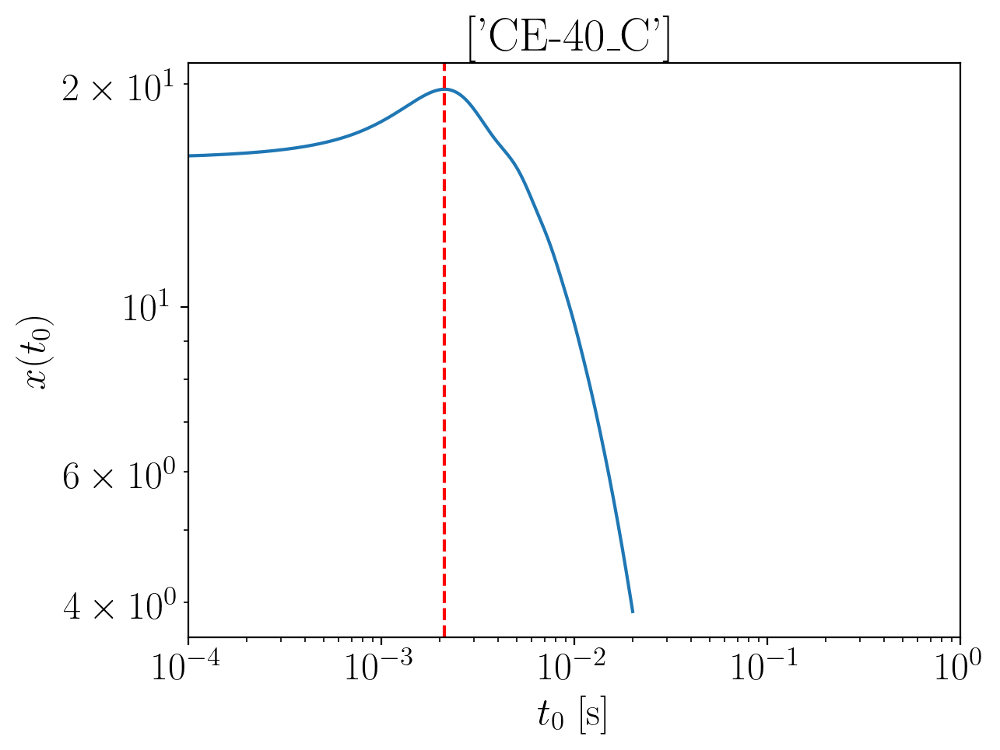

2024-01-15 15:58:17,393 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:17,401 - Network - INFO : PSDs loaded.
2024-01-15 15:58:17,416 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:17,435 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:17,477 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.248140134227934
Inner product:
0.9996458389246425


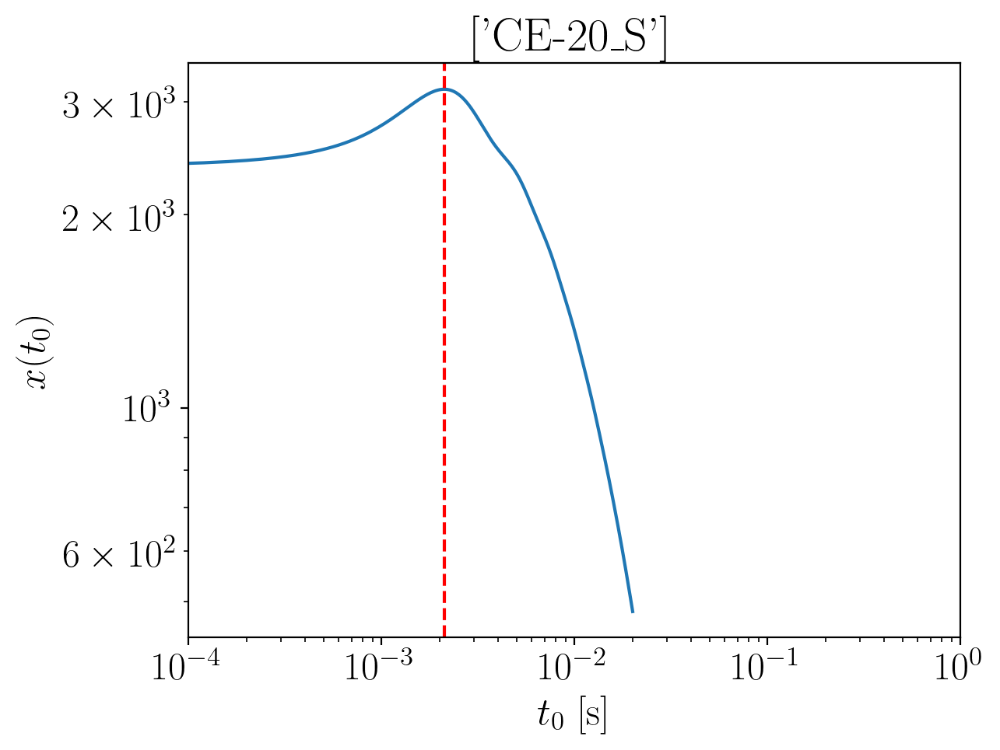

2024-01-15 15:58:18,641 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:18,648 - Network - INFO : PSDs loaded.
2024-01-15 15:58:18,650 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:18,657 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:18,663 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2498938514063345
Inner product:
0.9995380545462496


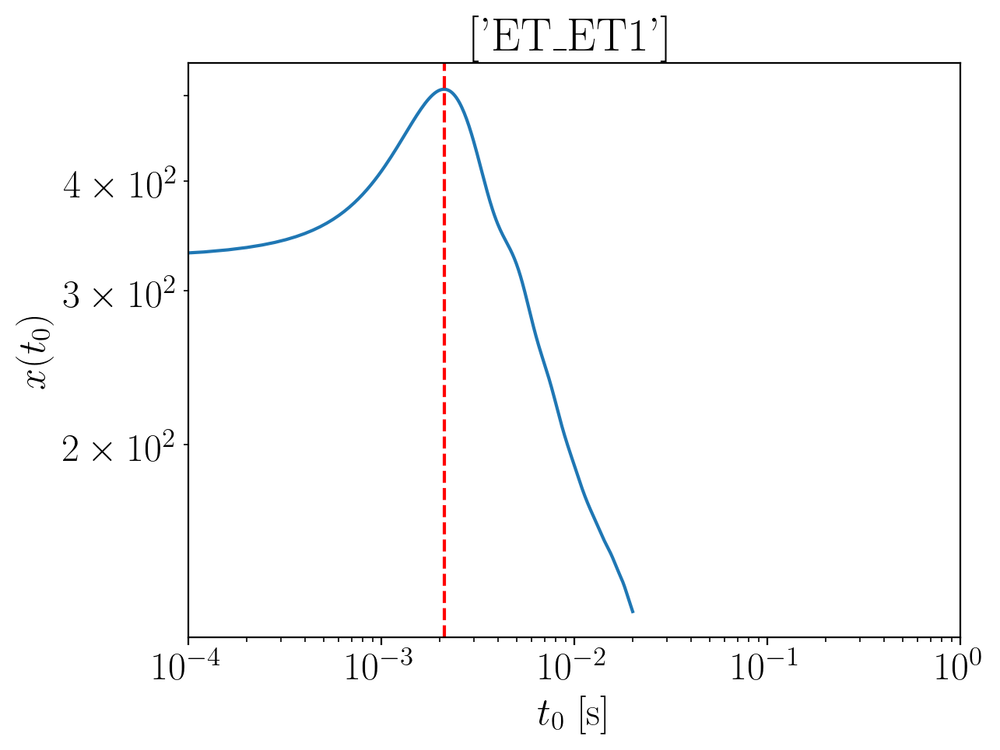

2024-01-15 15:58:20,032 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:20,049 - Network - INFO : PSDs loaded.
2024-01-15 15:58:20,056 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:20,073 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:20,088 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.247026899767302
Inner product:
0.9993176198987969


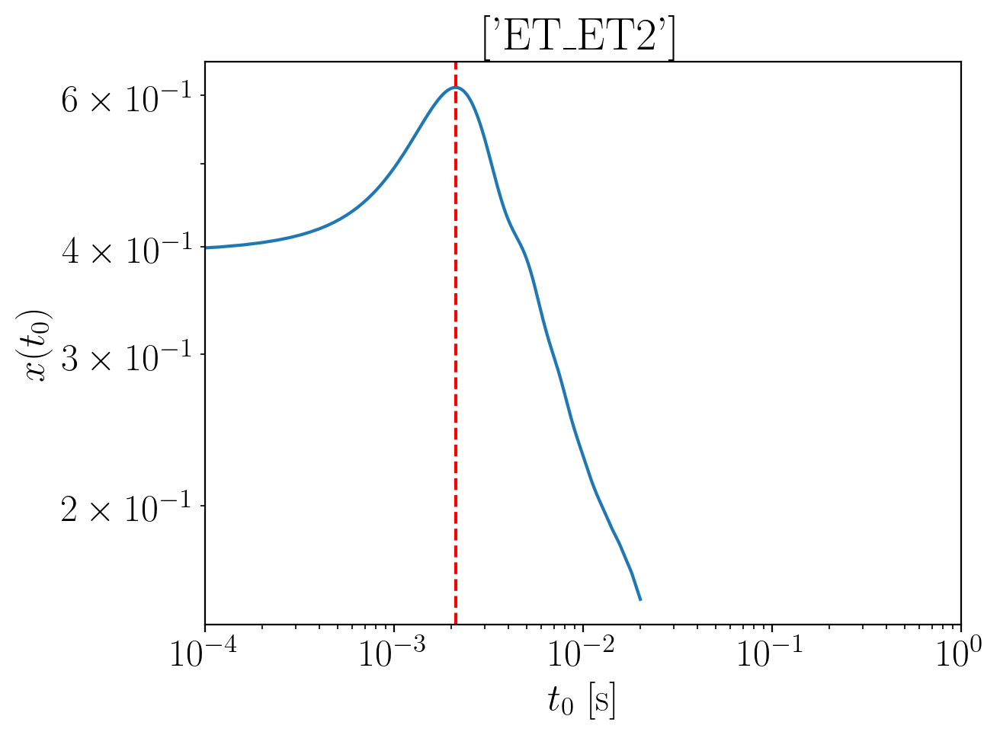

2024-01-15 15:58:21,597 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:21,610 - Network - INFO : PSDs loaded.
2024-01-15 15:58:21,612 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:21,620 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:21,628 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.247026899767302
Inner product:
0.9993176198987966


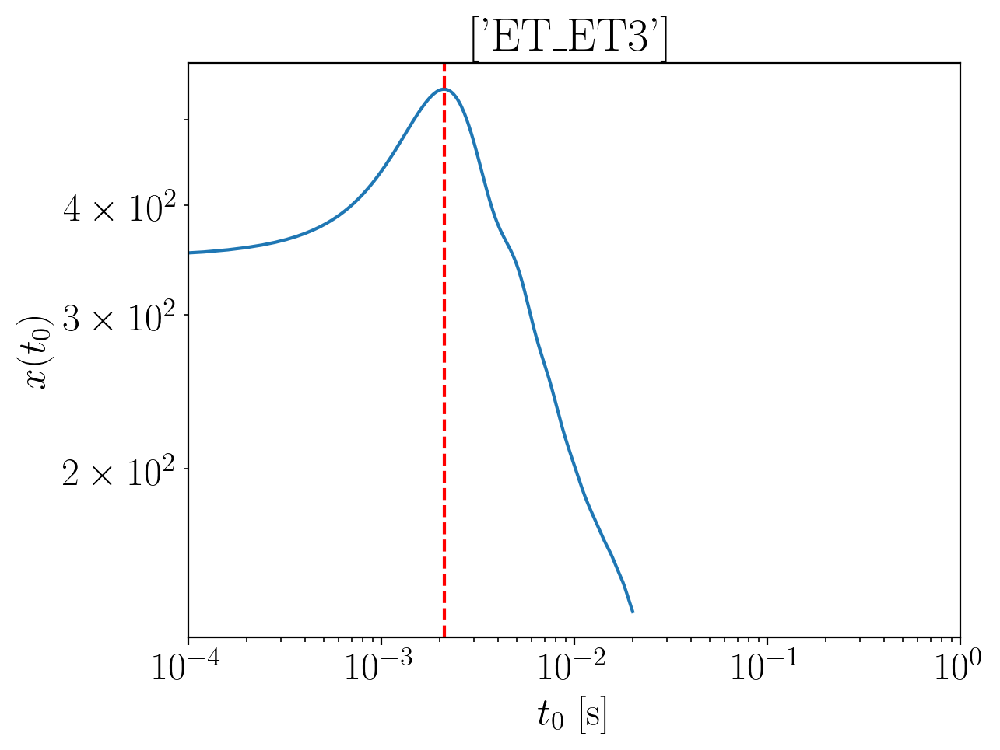

2024-01-15 15:58:22,987 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:23,001 - Network - INFO : PSDs loaded.
2024-01-15 15:58:23,007 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:23,030 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:23,048 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:23,095 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:23,095 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:58:23,099 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.247026899767302
Inner product:
0.9993176198987966


2024-01-15 15:58:28,483 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:58:28,527 - Network - INFO : PSDs loaded.
2024-01-15 15:58:28,533 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:28,552 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:28,553 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:58:28,553 - Network - INFO :    CE-40_C
2024-01-15 15:58:32,154 - Network - INFO :    CE-20_S
2024-01-15 15:58:35,707 - Network - INFO :    ET_ET1
2024-01-15 15:58:39,273 - Network - INFO :    ET_ET2
2024-01-15 15:58:42,854 - Network - INFO :    ET_ET3
2024-01-15 15:58:46,425 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:58:46,432 - Network - INFO : SNRs calculated.
2024-01-15 15:58:46,432 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:58:46,433 - Network - INFO :    CE-40_C
2024-01-15 15:58:46,526 - Network - INFO :

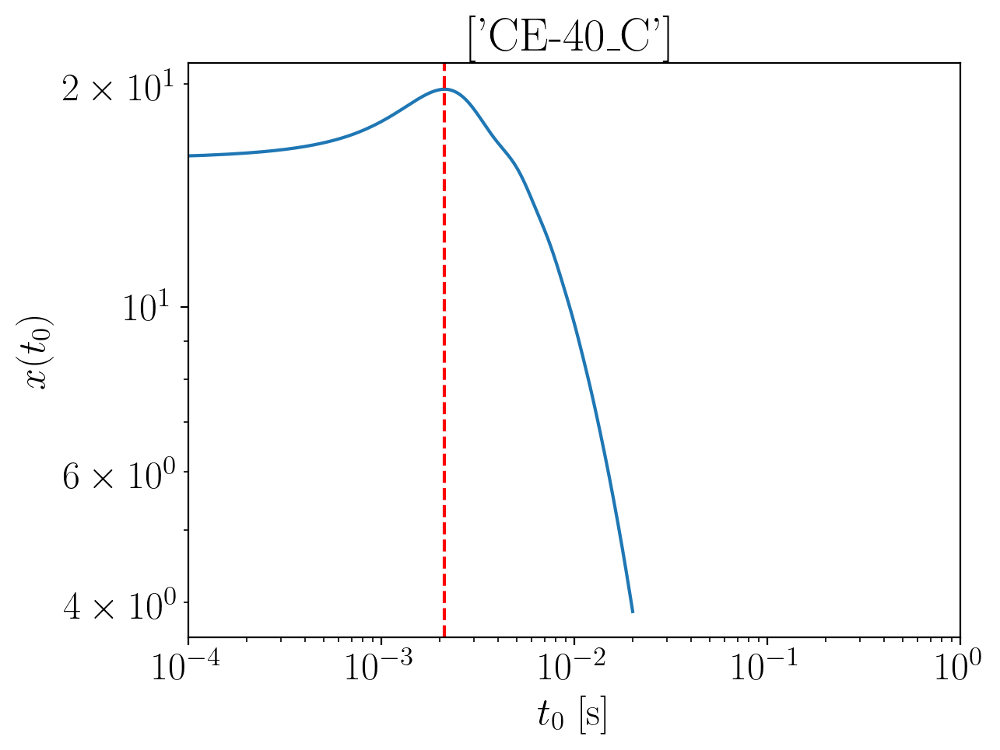

2024-01-15 15:58:48,252 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:48,259 - Network - INFO : PSDs loaded.
2024-01-15 15:58:48,261 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:48,278 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:48,298 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2346484247038556
Inner product:
0.9996458389246424


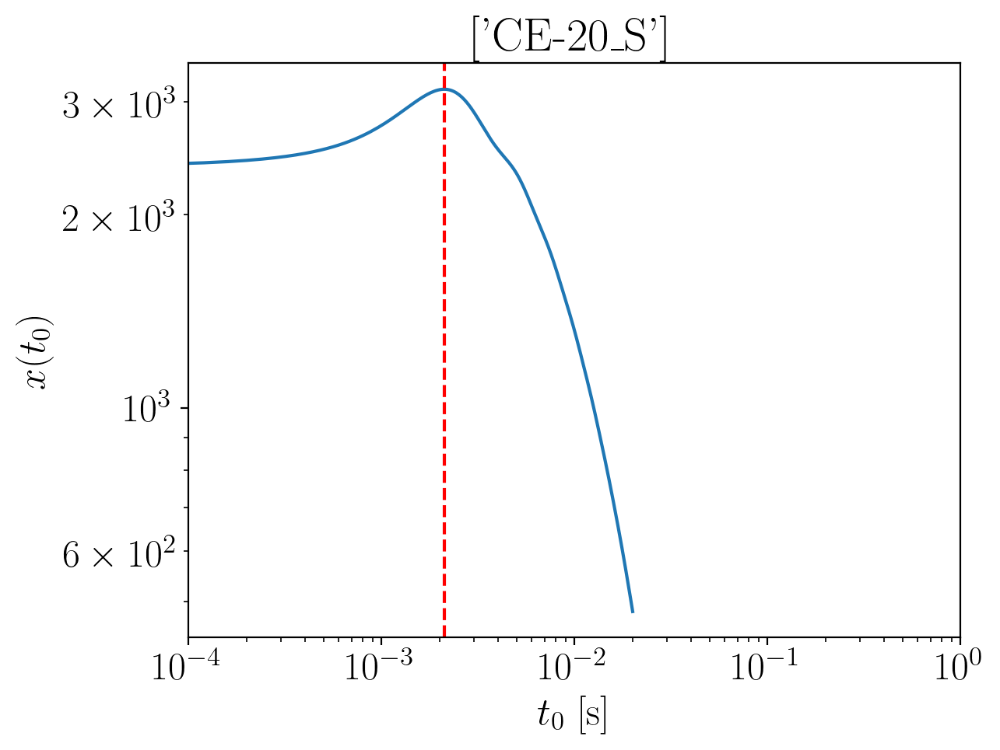

2024-01-15 15:58:49,473 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:49,480 - Network - INFO : PSDs loaded.
2024-01-15 15:58:49,482 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:49,488 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:49,495 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2364021418822566
Inner product:
0.9995380545462496


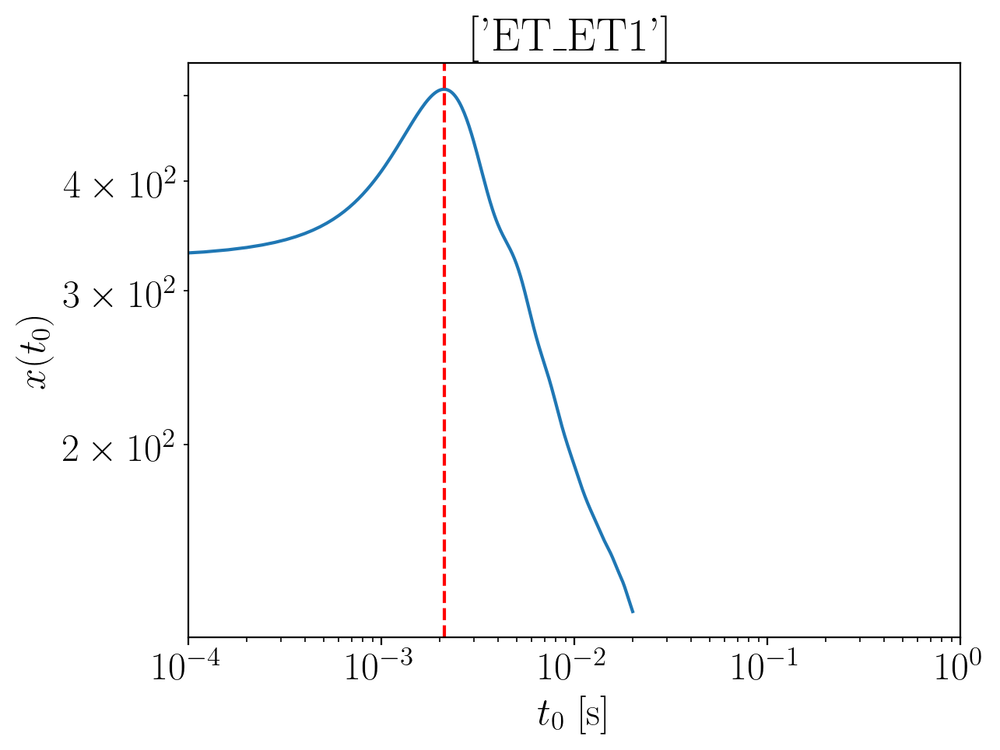

2024-01-15 15:58:50,853 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:50,866 - Network - INFO : PSDs loaded.
2024-01-15 15:58:50,874 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:50,890 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:50,926 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.2335351902432232
Inner product:
0.9993176198987969


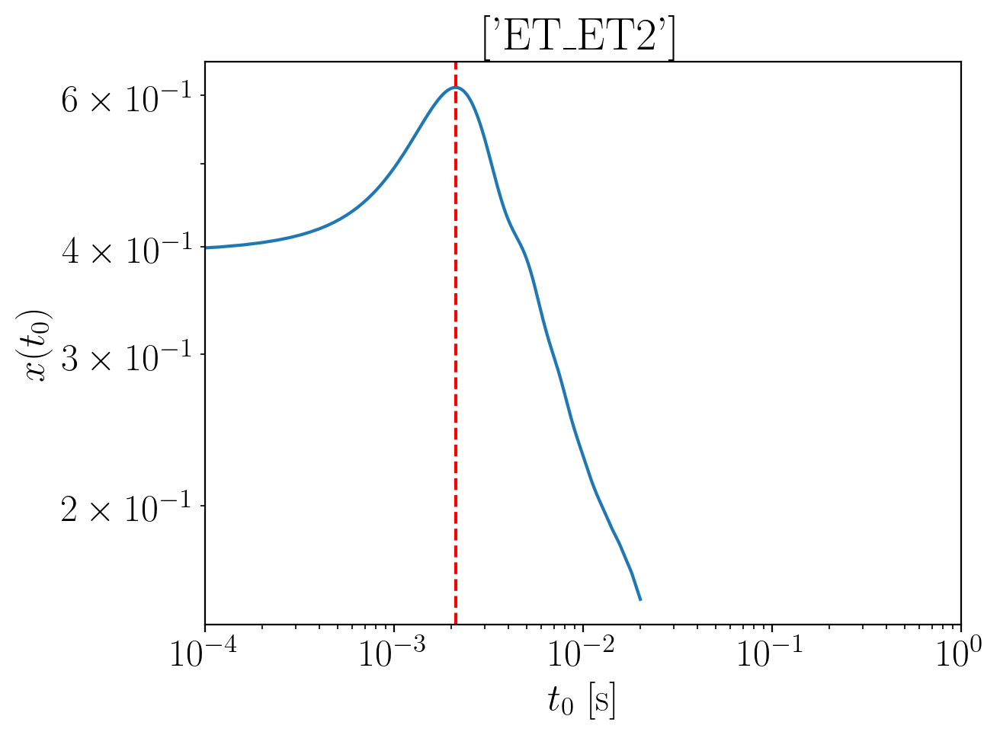

2024-01-15 15:58:52,354 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:52,367 - Network - INFO : PSDs loaded.
2024-01-15 15:58:52,369 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:52,376 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:52,383 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.233535190243223
Inner product:
0.9993176198987964


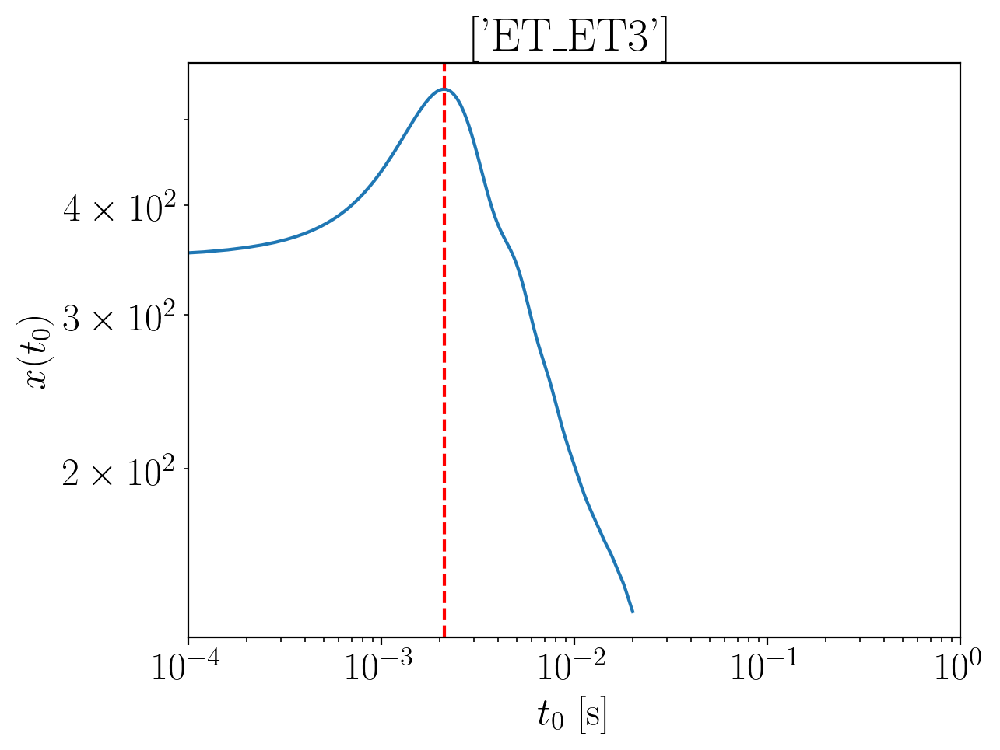

2024-01-15 15:58:53,799 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:53,813 - Network - INFO : PSDs loaded.
2024-01-15 15:58:53,819 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:53,833 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:53,851 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:53,878 - Network - INFO : Polarizations calculated.
2024-01-15 15:58:53,880 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:58:53,885 - Network - INFO : Polarizations calculated.


time shift: 0.0021200000000000004
phase shift: -2.233535190243223
Inner product:
0.9993176198987966


2024-01-15 15:58:59,304 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:58:59,380 - Network - INFO : PSDs loaded.
2024-01-15 15:58:59,387 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:58:59,406 - Network - INFO : Detector responses calculated.
2024-01-15 15:58:59,407 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:58:59,407 - Network - INFO :    CE-40_C
2024-01-15 15:59:03,063 - Network - INFO :    CE-20_S
2024-01-15 15:59:06,629 - Network - INFO :    ET_ET1
2024-01-15 15:59:10,188 - Network - INFO :    ET_ET2
2024-01-15 15:59:13,852 - Network - INFO :    ET_ET3
2024-01-15 15:59:17,483 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:59:17,490 - Network - INFO : SNRs calculated.
2024-01-15 15:59:17,490 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:59:17,490 - Network - INFO :    CE-40_C
2024-01-15 15:59:17,610 - Network - INFO :

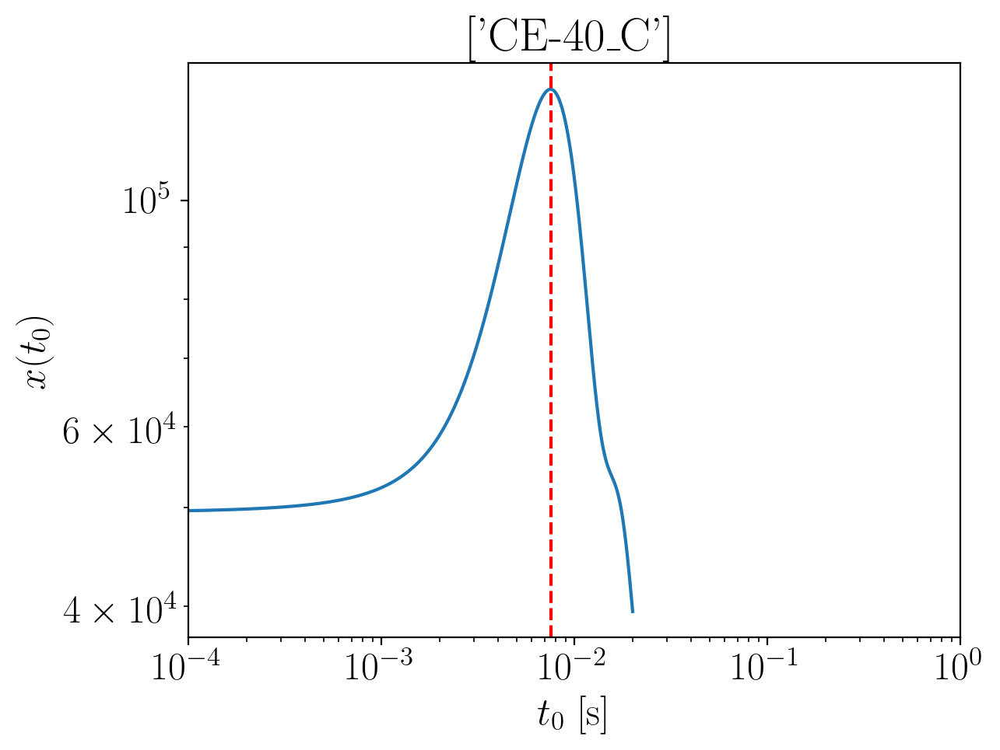

2024-01-15 15:59:20,673 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:20,682 - Network - INFO : PSDs loaded.
2024-01-15 15:59:20,684 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:20,692 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:20,698 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.148691591888737
Inner product:
0.9994627977362285


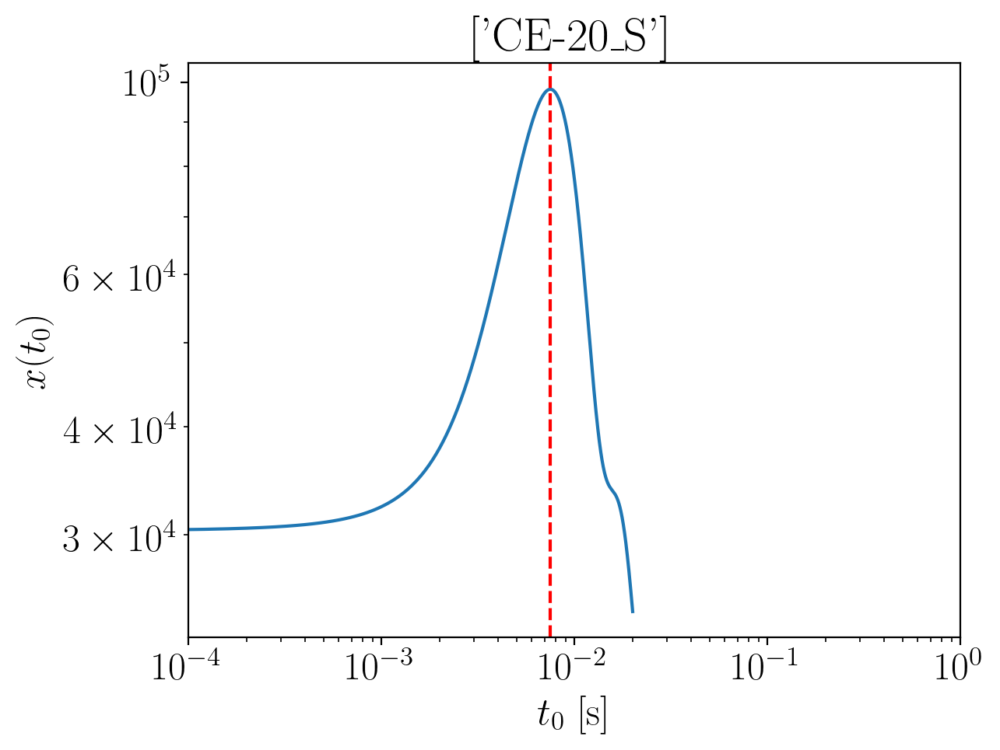

2024-01-15 15:59:22,494 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:22,502 - Network - INFO : PSDs loaded.
2024-01-15 15:59:22,506 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:22,512 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:22,518 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.1603312490906963
Inner product:
0.9993975769636633


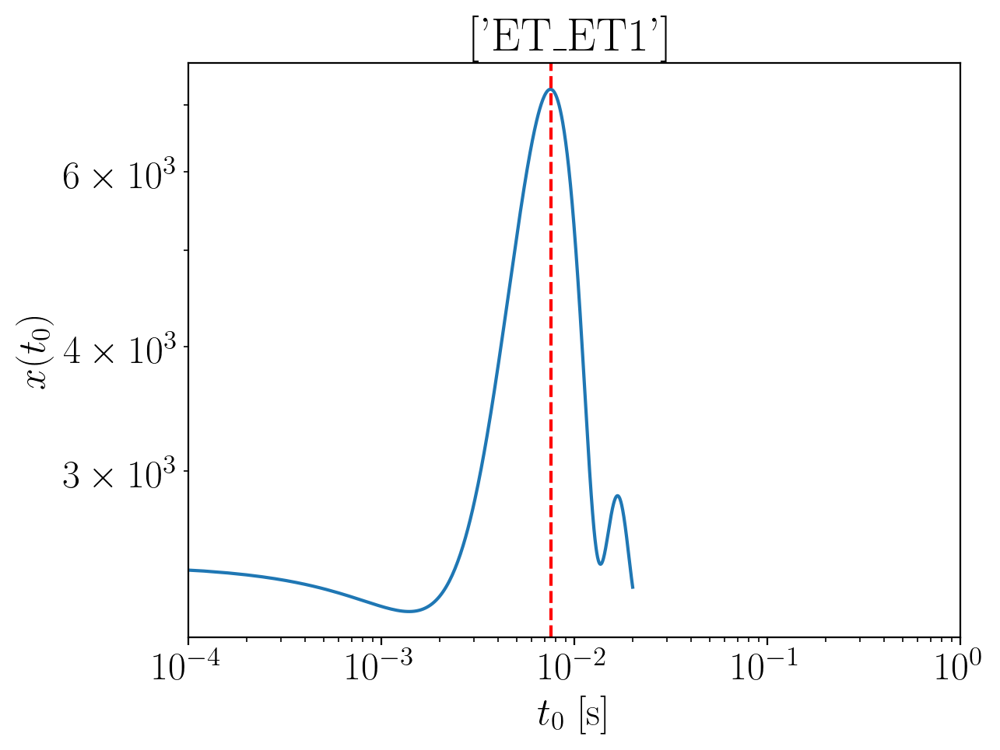

2024-01-15 15:59:23,888 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:23,913 - Network - INFO : PSDs loaded.
2024-01-15 15:59:23,921 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:23,927 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:23,937 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.138657742058021
Inner product:
0.9994120616554688


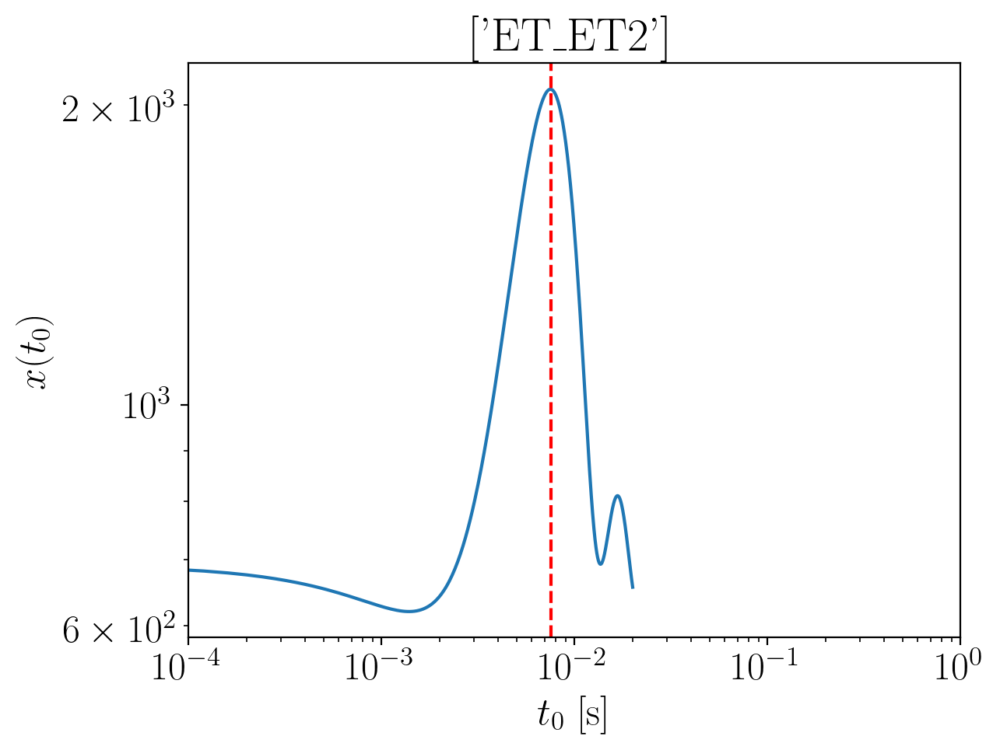

2024-01-15 15:59:25,363 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:25,382 - Network - INFO : PSDs loaded.
2024-01-15 15:59:25,384 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:25,389 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:25,394 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.1386577420580215
Inner product:
0.9994120616554683


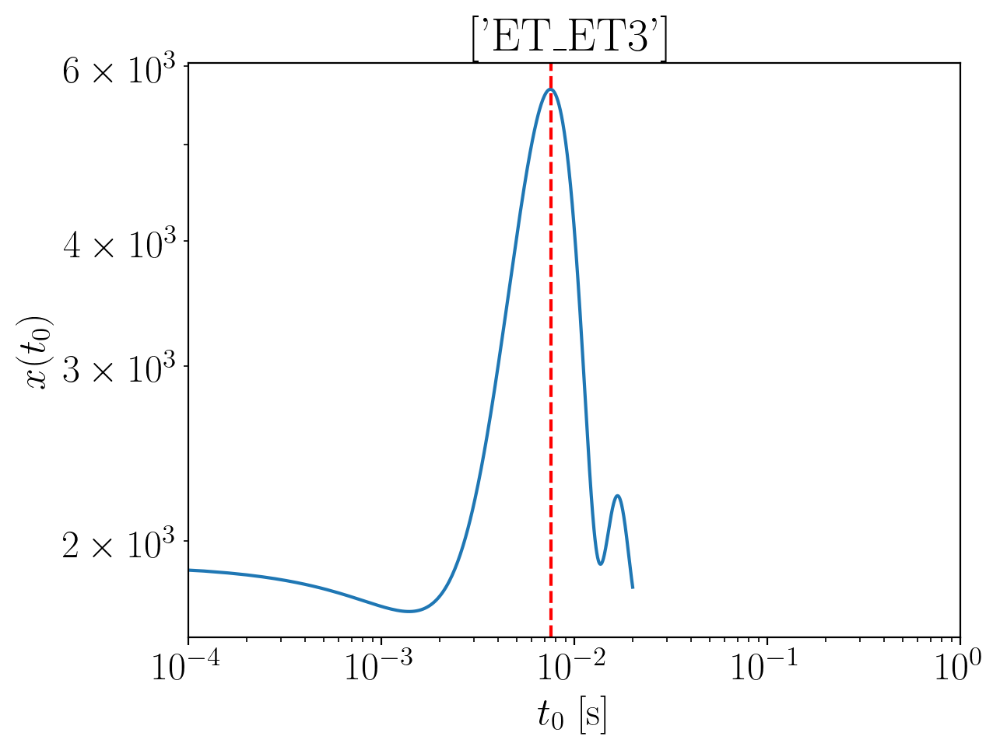

2024-01-15 15:59:26,782 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:26,808 - Network - INFO : PSDs loaded.
2024-01-15 15:59:26,813 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:26,828 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:26,834 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:26,861 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:26,862 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:59:26,867 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.1386577420580215
Inner product:
0.9994120616554683


2024-01-15 15:59:32,242 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 15:59:32,287 - Network - INFO : PSDs loaded.
2024-01-15 15:59:32,293 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:32,307 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:32,308 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 15:59:32,308 - Network - INFO :    CE-40_C
2024-01-15 15:59:35,912 - Network - INFO :    CE-20_S
2024-01-15 15:59:39,507 - Network - INFO :    ET_ET1
2024-01-15 15:59:43,106 - Network - INFO :    ET_ET2
2024-01-15 15:59:46,704 - Network - INFO :    ET_ET3
2024-01-15 15:59:50,277 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 15:59:50,284 - Network - INFO : SNRs calculated.
2024-01-15 15:59:50,284 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 15:59:50,284 - Network - INFO :    CE-40_C
2024-01-15 15:59:50,377 - Network - INFO :

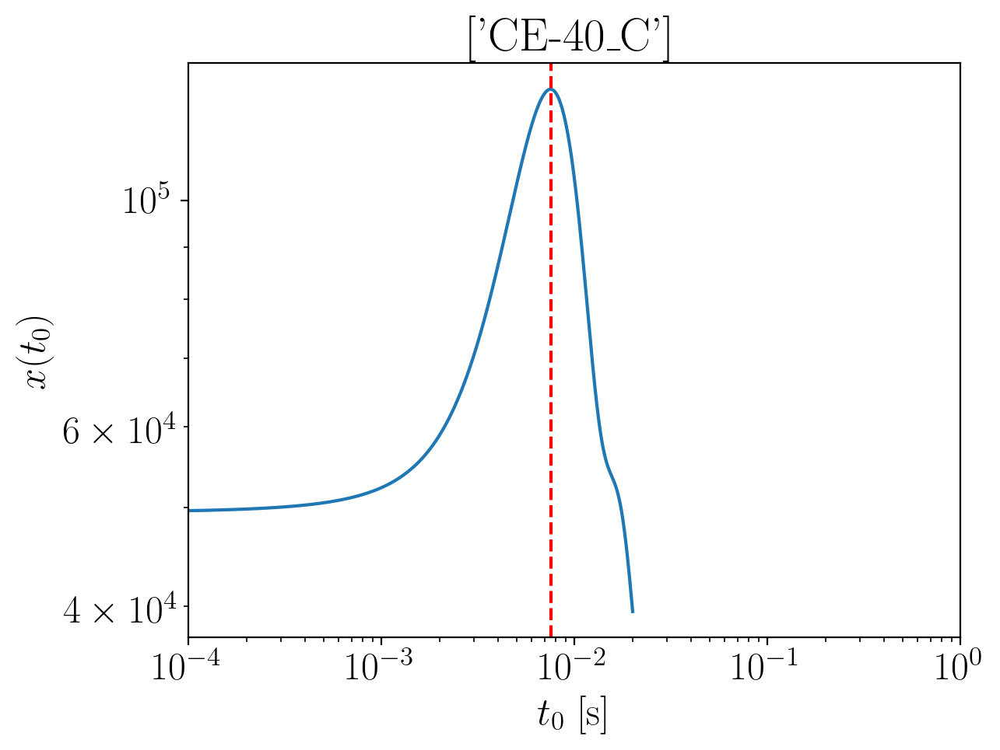

2024-01-15 15:59:52,094 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:52,102 - Network - INFO : PSDs loaded.
2024-01-15 15:59:52,103 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:52,108 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:52,113 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.3674119222031687
Inner product:
0.9994627977362285


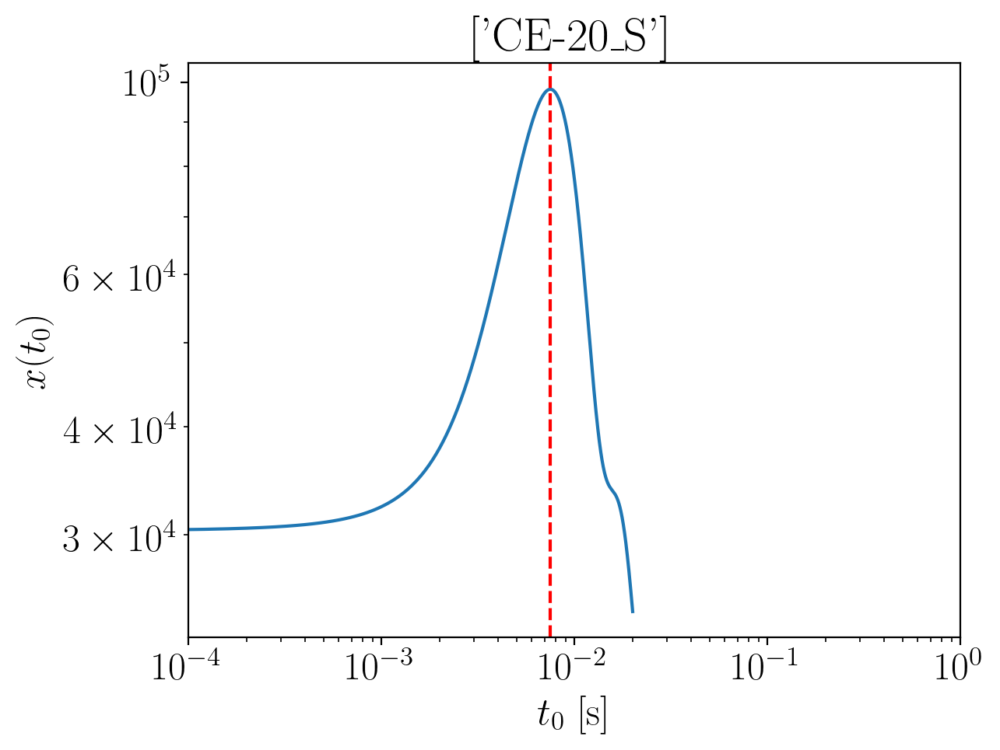

2024-01-15 15:59:53,480 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:53,486 - Network - INFO : PSDs loaded.
2024-01-15 15:59:53,488 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:53,493 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:53,498 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.3790515794051266
Inner product:
0.9993975769636633


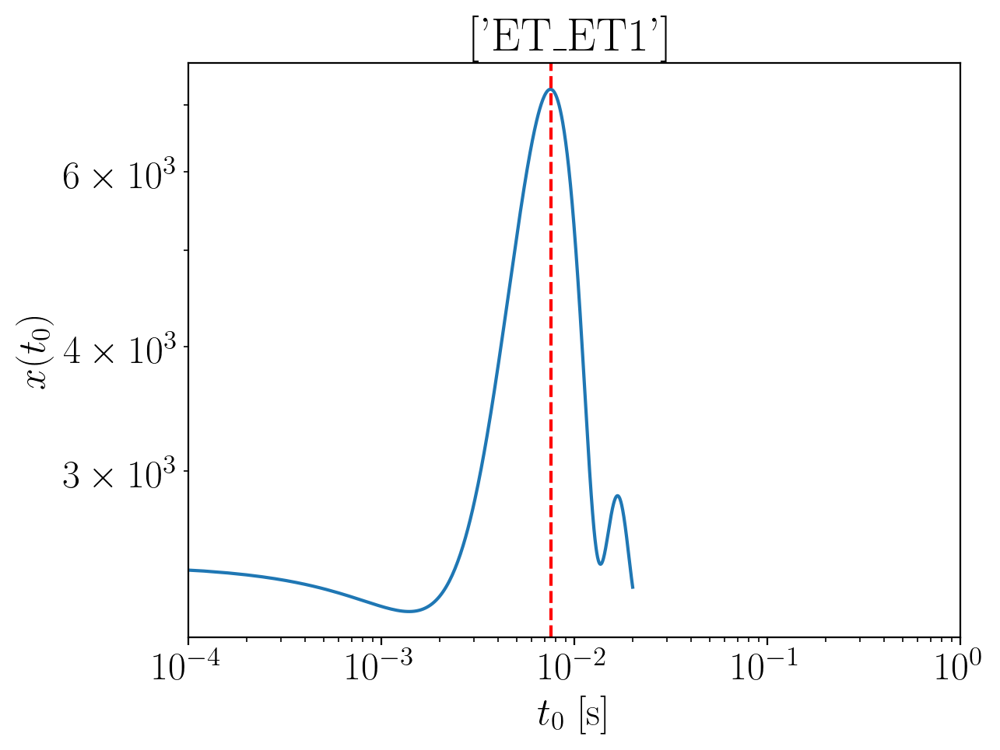

2024-01-15 15:59:54,861 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:54,875 - Network - INFO : PSDs loaded.
2024-01-15 15:59:54,879 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:54,894 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:54,906 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.354249402178981
Inner product:
0.9994120616554687


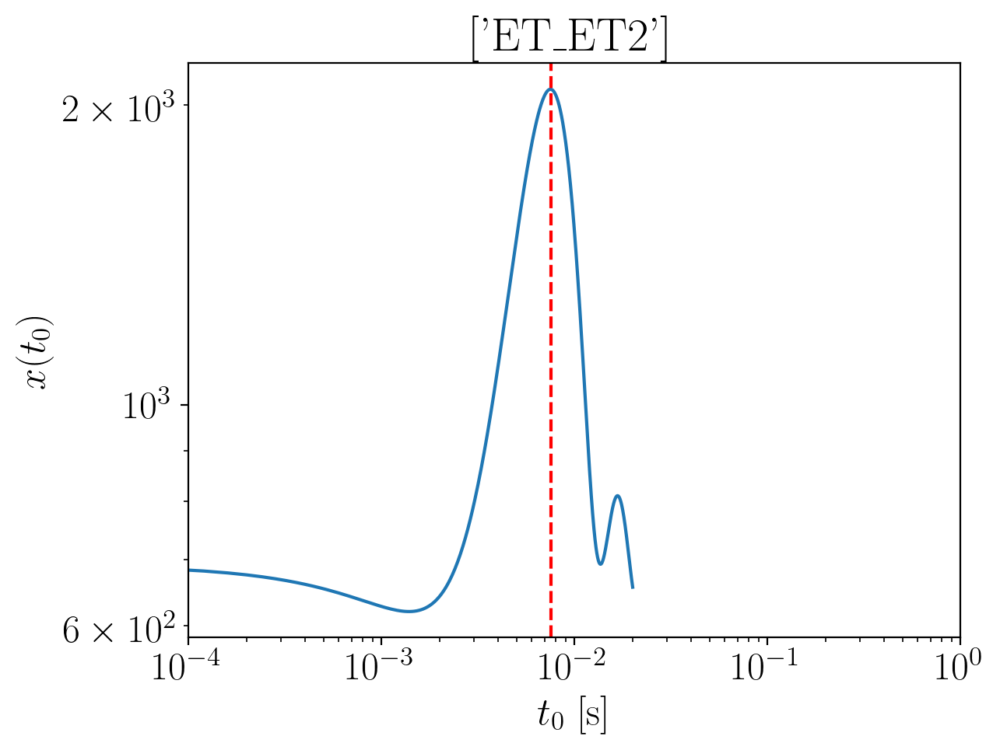

2024-01-15 15:59:56,324 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:56,339 - Network - INFO : PSDs loaded.
2024-01-15 15:59:56,342 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:56,356 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:56,362 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.354249402178981
Inner product:
0.9994120616554683


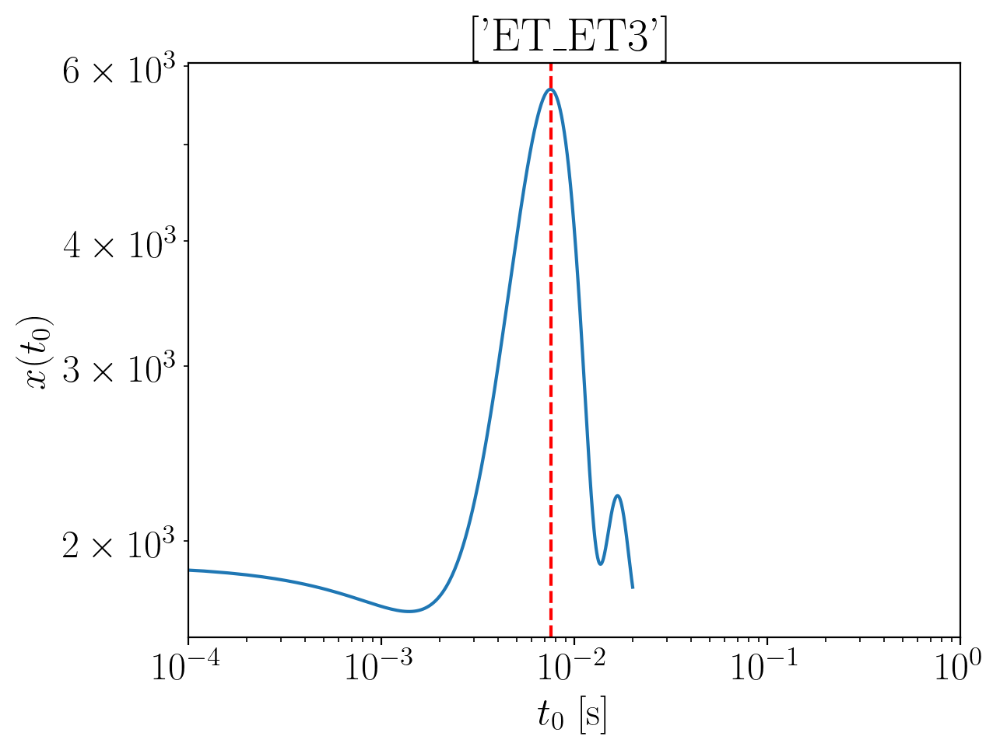

2024-01-15 15:59:57,771 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:57,786 - Network - INFO : PSDs loaded.
2024-01-15 15:59:57,790 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 15:59:57,804 - Network - INFO : Detector responses calculated.
2024-01-15 15:59:57,809 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:57,837 - Network - INFO : Polarizations calculated.
2024-01-15 15:59:57,838 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 15:59:57,859 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.354249402178981
Inner product:
0.9994120616554683


2024-01-15 16:00:03,181 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:00:03,226 - Network - INFO : PSDs loaded.
2024-01-15 16:00:03,232 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:03,247 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:03,248 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:00:03,248 - Network - INFO :    CE-40_C
2024-01-15 16:00:06,821 - Network - INFO :    CE-20_S
2024-01-15 16:00:10,386 - Network - INFO :    ET_ET1
2024-01-15 16:00:13,971 - Network - INFO :    ET_ET2
2024-01-15 16:00:17,701 - Network - INFO :    ET_ET3
2024-01-15 16:00:21,251 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:00:21,257 - Network - INFO : SNRs calculated.
2024-01-15 16:00:21,258 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:00:21,258 - Network - INFO :    CE-40_C
2024-01-15 16:00:21,352 - Network - INFO :

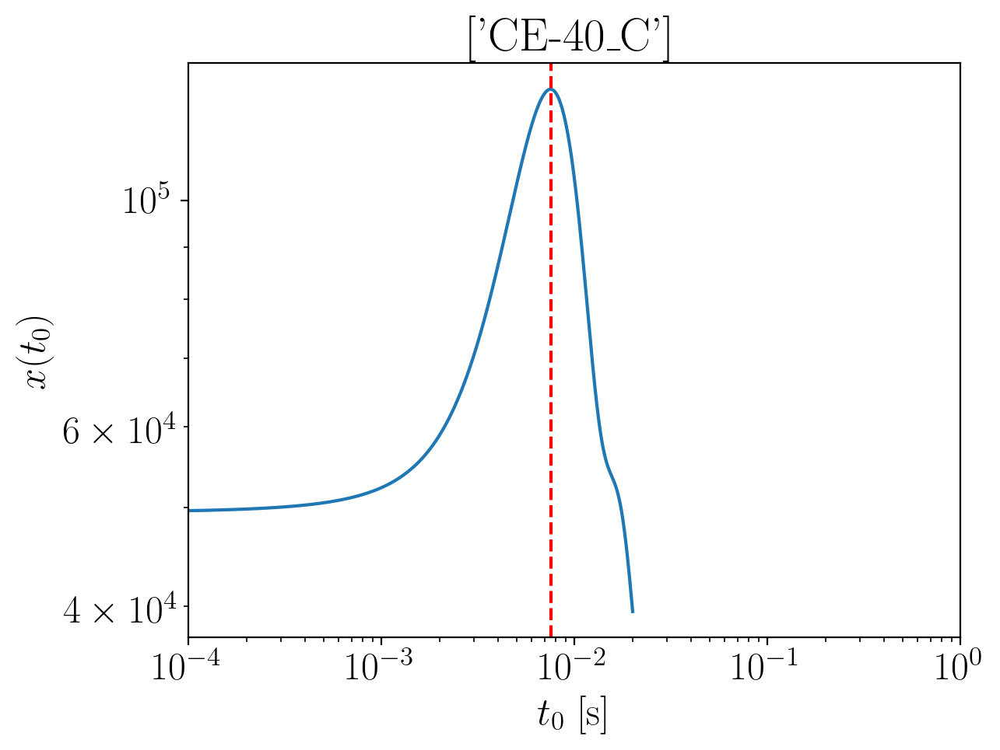

2024-01-15 16:00:23,069 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:23,076 - Network - INFO : PSDs loaded.
2024-01-15 16:00:23,077 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:23,082 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:23,087 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.3088185250679625
Inner product:
0.9994627977362285


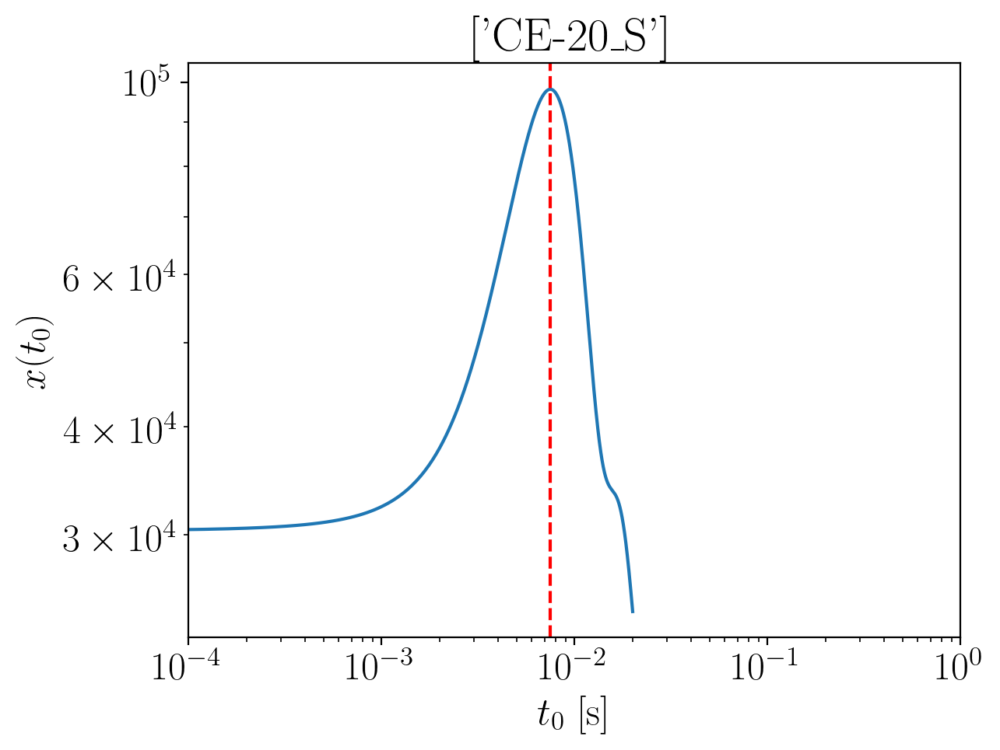

2024-01-15 16:00:24,272 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:24,279 - Network - INFO : PSDs loaded.
2024-01-15 16:00:24,281 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:24,286 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:24,291 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.3204581822699217
Inner product:
0.9993975769636633


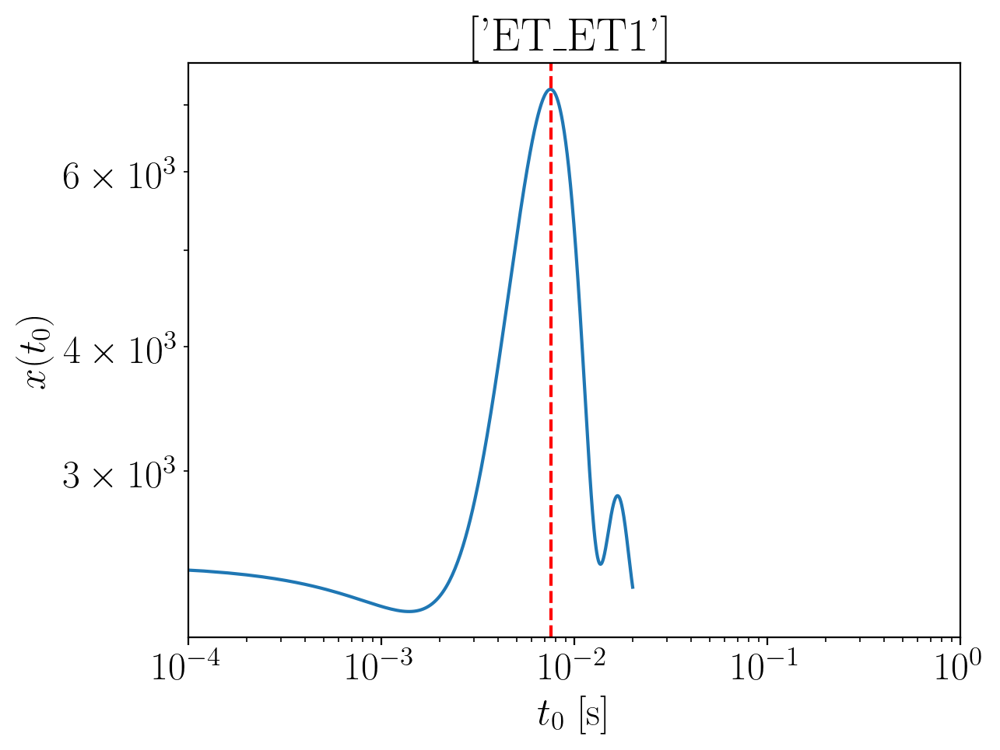

2024-01-15 16:00:25,643 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:25,657 - Network - INFO : PSDs loaded.
2024-01-15 16:00:25,662 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:25,674 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:25,687 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.295656005043766
Inner product:
0.9994120616554688


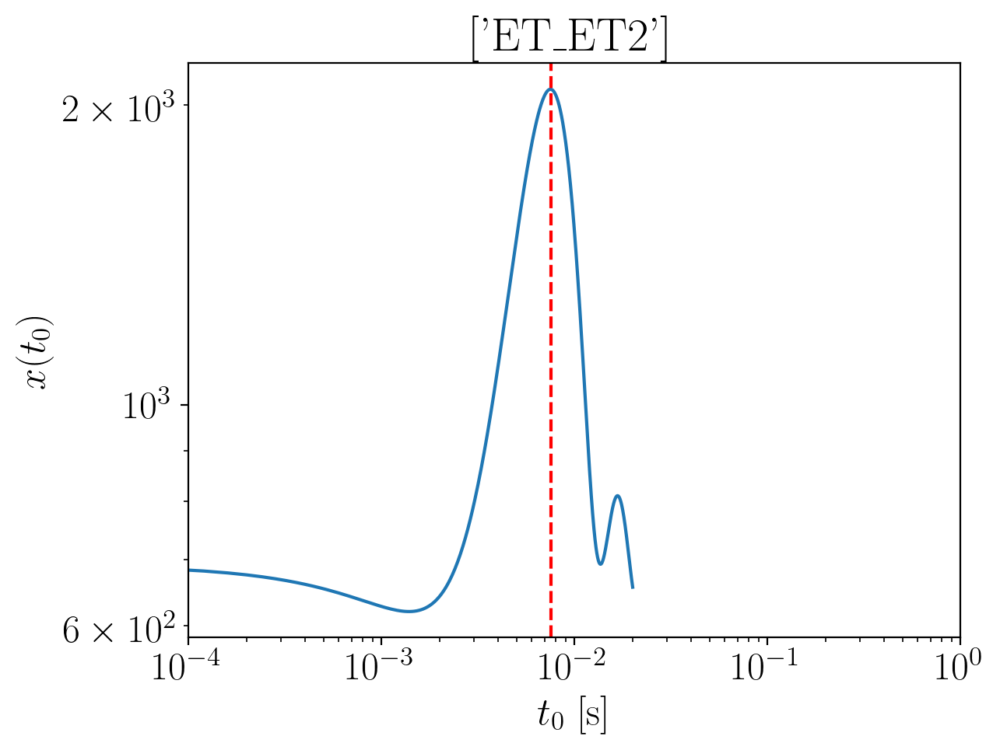

2024-01-15 16:00:27,289 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:27,304 - Network - INFO : PSDs loaded.
2024-01-15 16:00:27,306 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:27,311 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:27,320 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.2956560050437664
Inner product:
0.9994120616554683


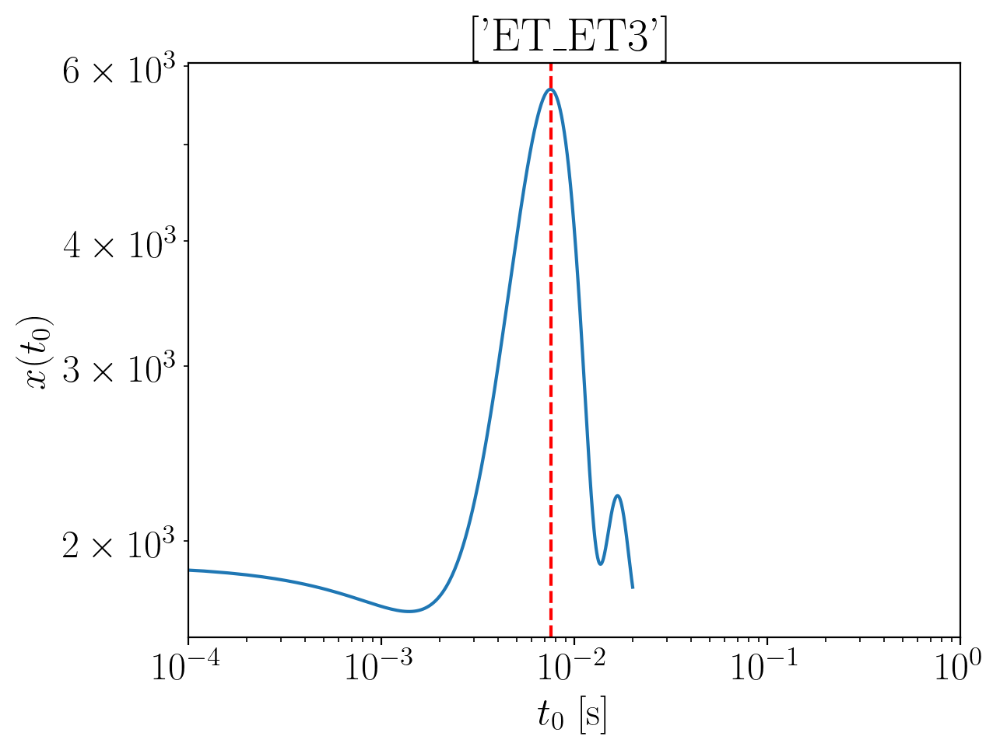

2024-01-15 16:00:28,866 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:28,881 - Network - INFO : PSDs loaded.
2024-01-15 16:00:28,883 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:28,889 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:28,895 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:28,921 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:28,922 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:00:28,927 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.2956560050437664
Inner product:
0.9994120616554683


2024-01-15 16:00:34,429 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:00:34,473 - Network - INFO : PSDs loaded.
2024-01-15 16:00:34,479 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:34,493 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:34,494 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:00:34,495 - Network - INFO :    CE-40_C
2024-01-15 16:00:38,045 - Network - INFO :    CE-20_S
2024-01-15 16:00:41,591 - Network - INFO :    ET_ET1
2024-01-15 16:00:45,132 - Network - INFO :    ET_ET2
2024-01-15 16:00:48,686 - Network - INFO :    ET_ET3
2024-01-15 16:00:52,233 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:00:52,239 - Network - INFO : SNRs calculated.
2024-01-15 16:00:52,240 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:00:52,240 - Network - INFO :    CE-40_C
2024-01-15 16:00:52,334 - Network - INFO :

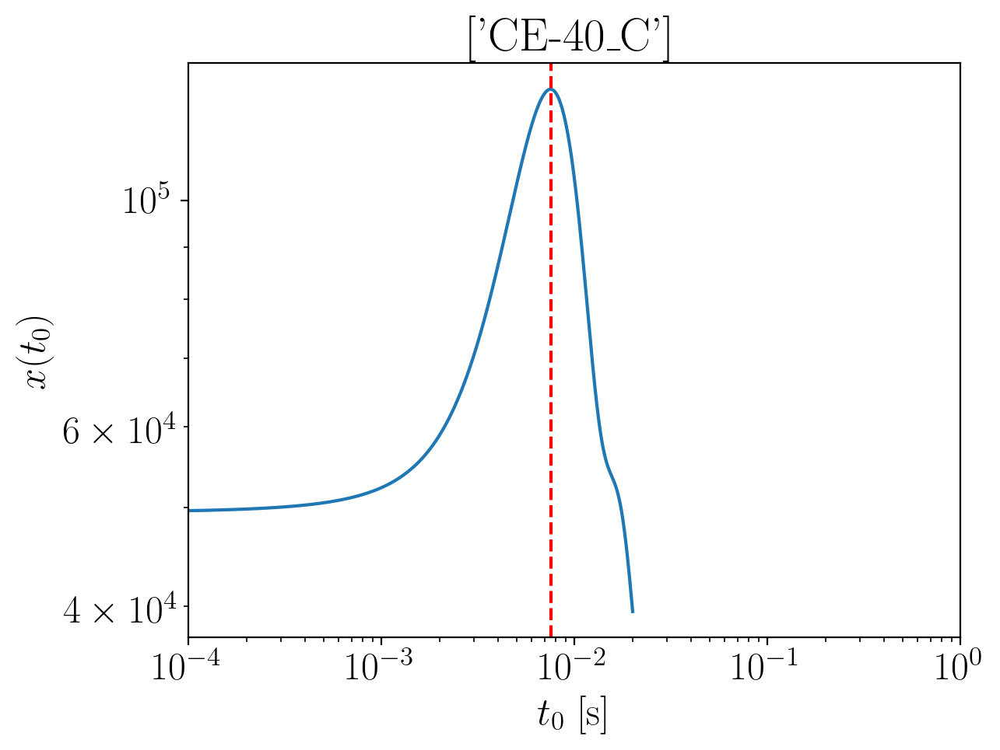

2024-01-15 16:00:54,049 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:54,055 - Network - INFO : PSDs loaded.
2024-01-15 16:00:54,057 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:54,062 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:54,067 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.254452901767009
Inner product:
0.9994627977362285


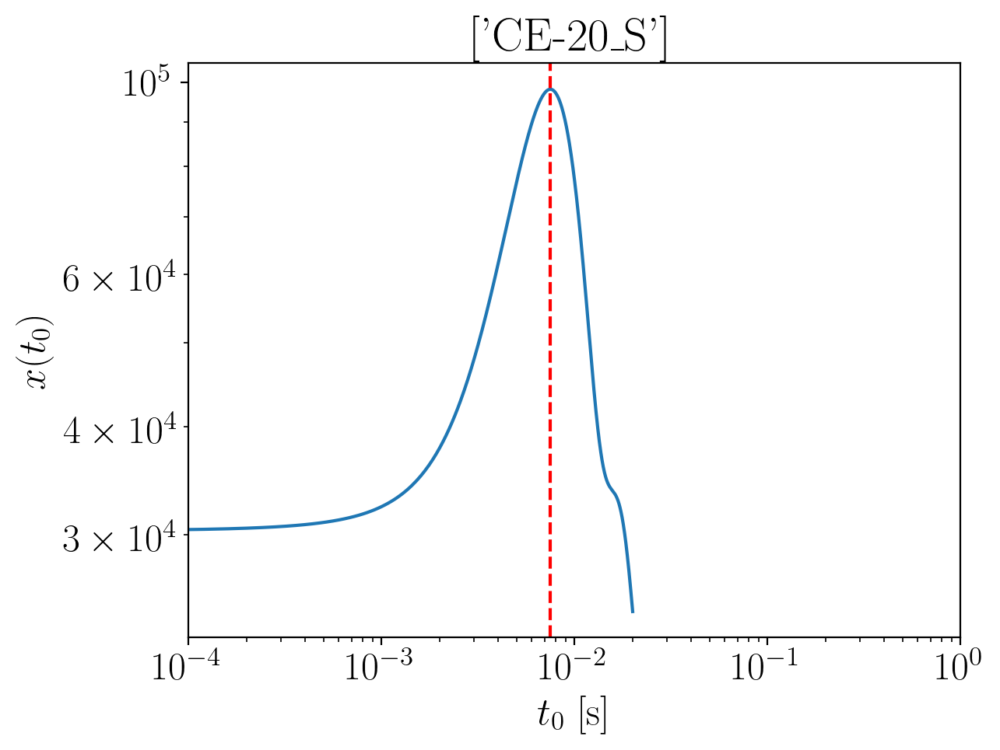

2024-01-15 16:00:55,285 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:55,291 - Network - INFO : PSDs loaded.
2024-01-15 16:00:55,293 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:55,298 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:55,303 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.2660925589689684
Inner product:
0.9993975769636633


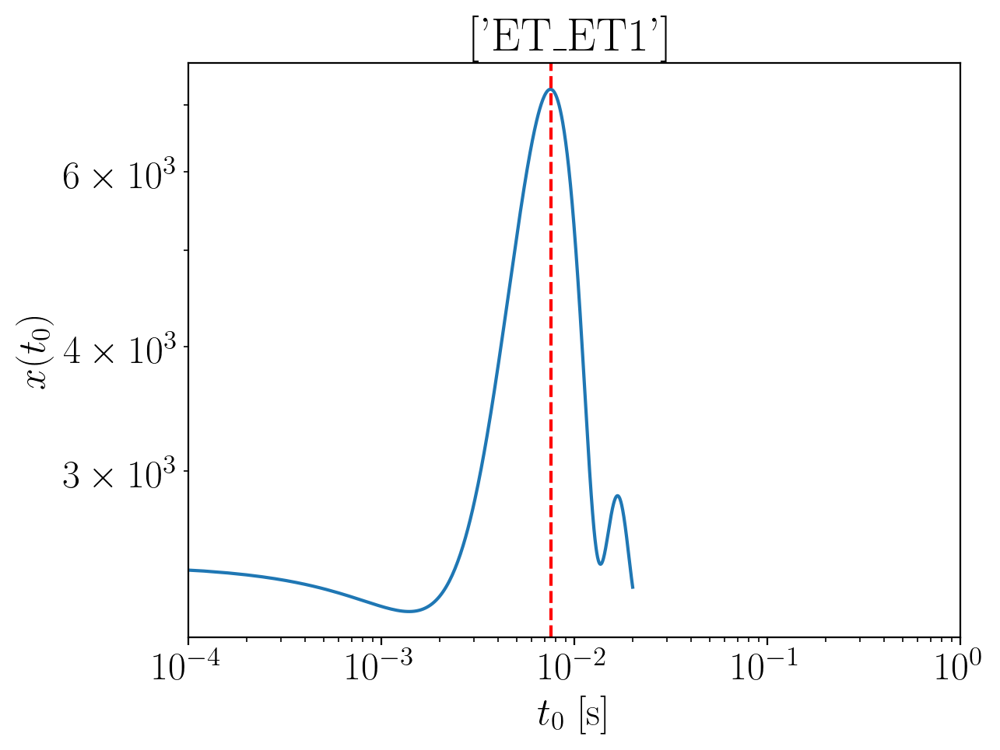

2024-01-15 16:00:56,746 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:56,766 - Network - INFO : PSDs loaded.
2024-01-15 16:00:56,770 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:56,784 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:56,789 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.2412903817428127
Inner product:
0.9994120616554688


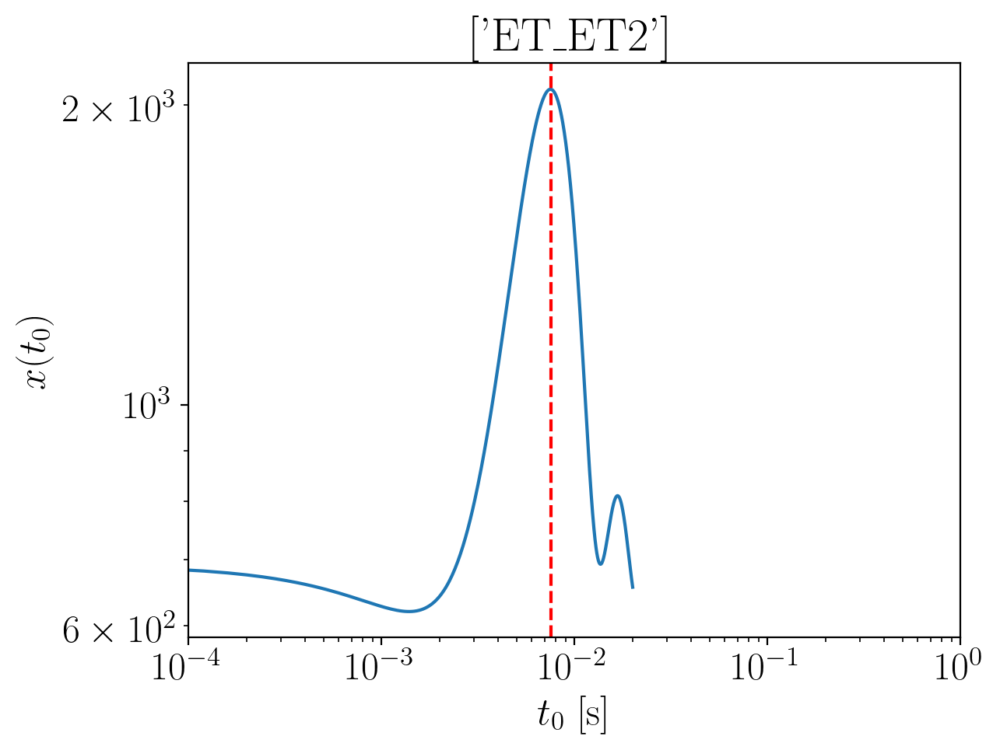

2024-01-15 16:00:58,213 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:58,228 - Network - INFO : PSDs loaded.
2024-01-15 16:00:58,231 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:58,237 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:58,241 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.2412903817428127
Inner product:
0.9994120616554683


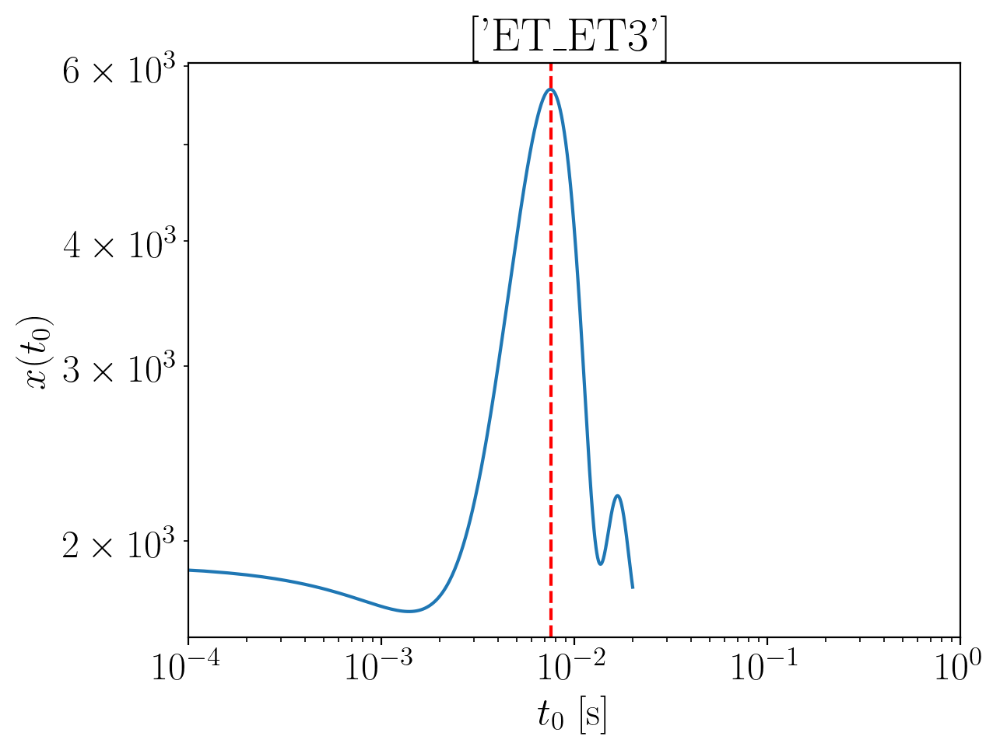

2024-01-15 16:00:59,612 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:59,631 - Network - INFO : PSDs loaded.
2024-01-15 16:00:59,635 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:00:59,645 - Network - INFO : Detector responses calculated.
2024-01-15 16:00:59,650 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:59,683 - Network - INFO : Polarizations calculated.
2024-01-15 16:00:59,684 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:00:59,688 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.2412903817428127
Inner product:
0.9994120616554683


2024-01-15 16:01:05,072 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:01:05,246 - Network - INFO : PSDs loaded.
2024-01-15 16:01:05,252 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:05,267 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:05,268 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:01:05,269 - Network - INFO :    CE-40_C
2024-01-15 16:01:08,819 - Network - INFO :    CE-20_S
2024-01-15 16:01:12,356 - Network - INFO :    ET_ET1
2024-01-15 16:01:15,998 - Network - INFO :    ET_ET2
2024-01-15 16:01:19,547 - Network - INFO :    ET_ET3
2024-01-15 16:01:23,118 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:01:23,124 - Network - INFO : SNRs calculated.
2024-01-15 16:01:23,124 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:01:23,125 - Network - INFO :    CE-40_C
2024-01-15 16:01:23,218 - Network - INFO :

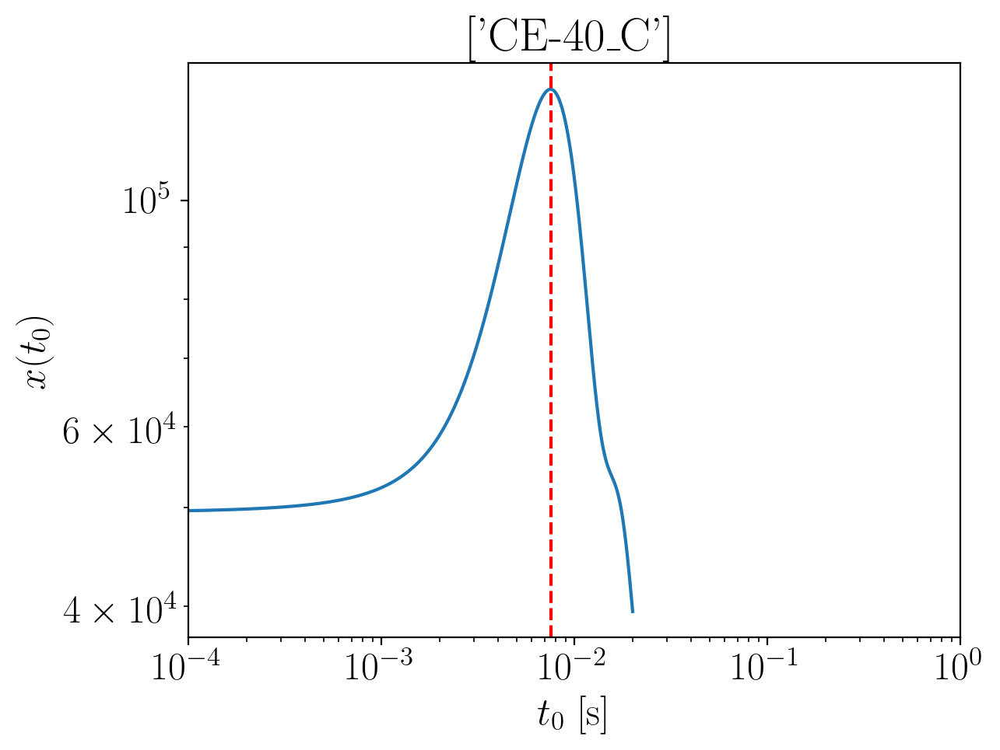

2024-01-15 16:01:24,929 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:24,936 - Network - INFO : PSDs loaded.
2024-01-15 16:01:24,938 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:24,943 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:24,948 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.2024241869584
Inner product:
0.9994627977362285


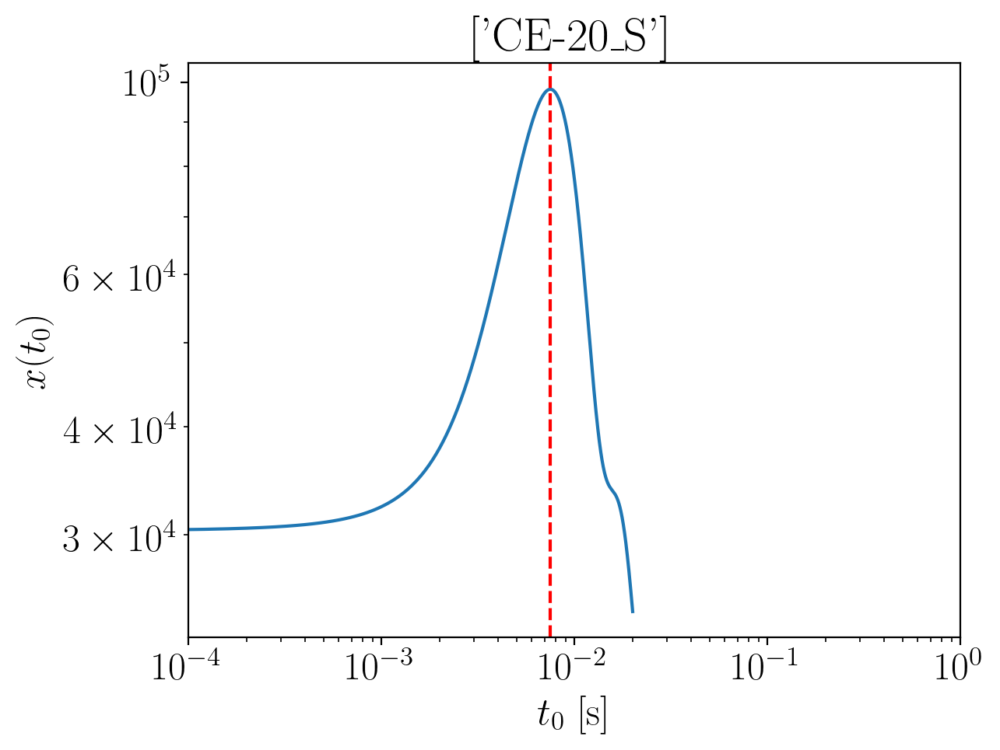

2024-01-15 16:01:26,160 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:26,166 - Network - INFO : PSDs loaded.
2024-01-15 16:01:26,168 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:26,173 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:26,179 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.2140638441603593
Inner product:
0.9993975769636633


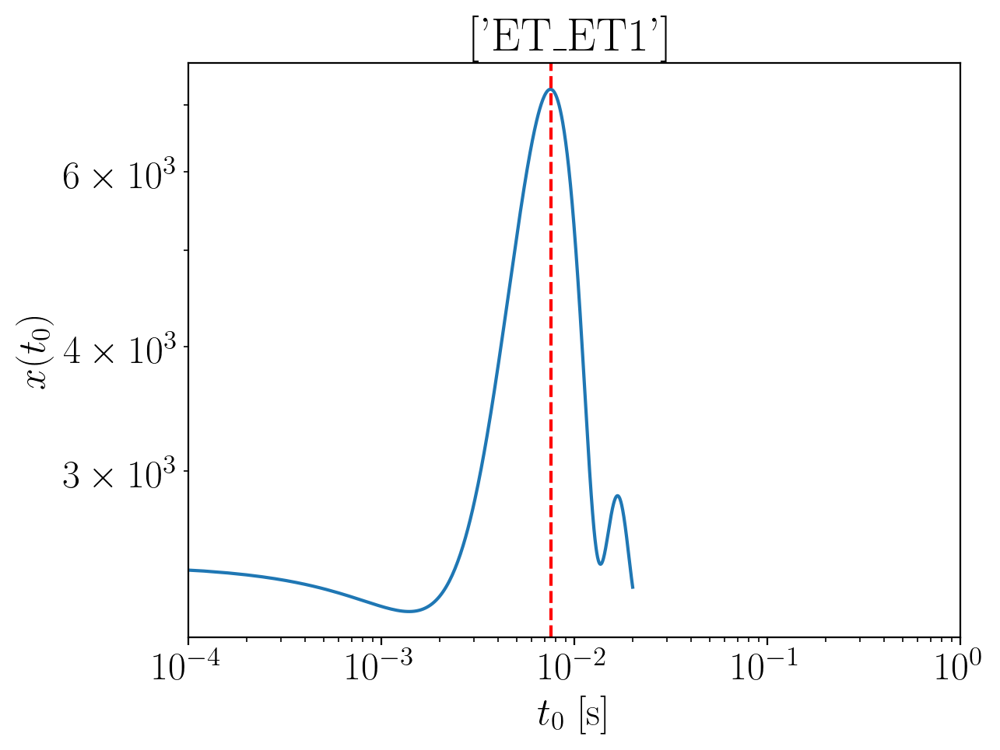

2024-01-15 16:01:27,608 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:27,623 - Network - INFO : PSDs loaded.
2024-01-15 16:01:27,632 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:27,652 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:27,682 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.189261666934204
Inner product:
0.9994120616554688


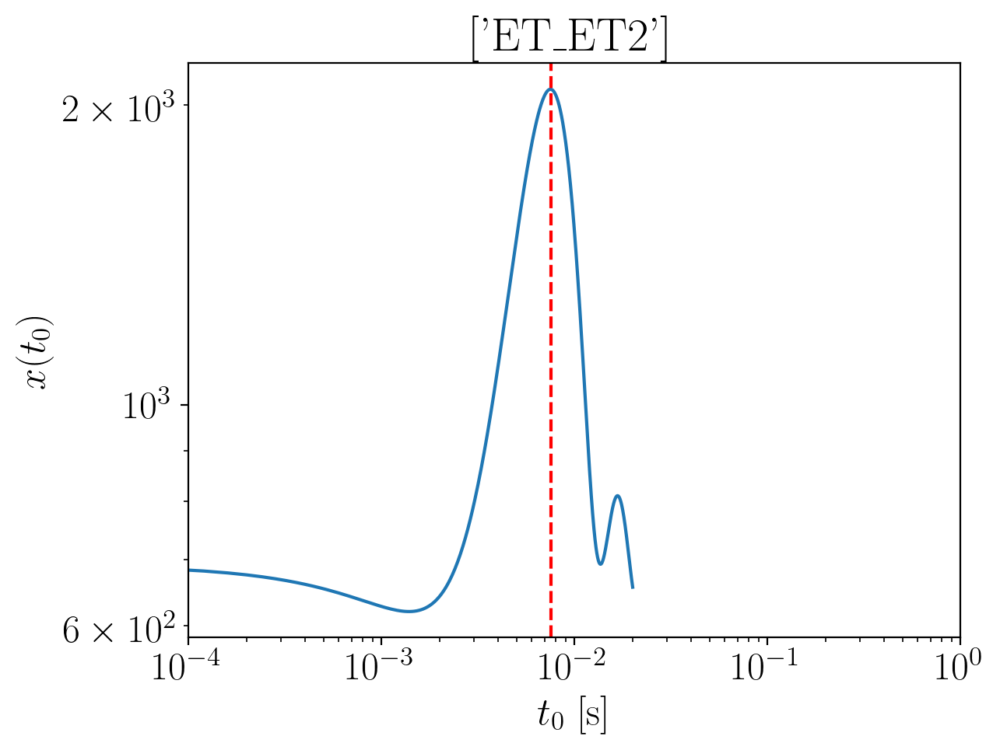

2024-01-15 16:01:29,188 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:29,201 - Network - INFO : PSDs loaded.
2024-01-15 16:01:29,204 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:29,210 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:29,215 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.189261666934204
Inner product:
0.9994120616554683


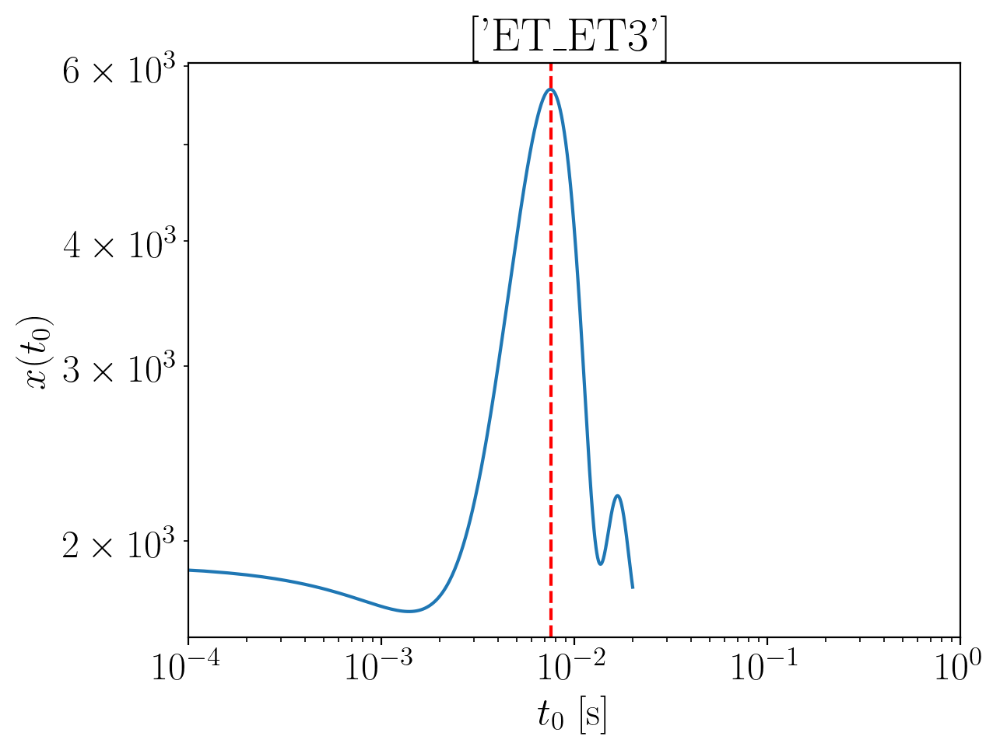

2024-01-15 16:01:30,665 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:30,686 - Network - INFO : PSDs loaded.
2024-01-15 16:01:30,688 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:30,701 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:30,706 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:30,744 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:30,745 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:01:30,751 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.189261666934204
Inner product:
0.9994120616554683


2024-01-15 16:01:36,206 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:01:36,254 - Network - INFO : PSDs loaded.
2024-01-15 16:01:36,259 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:36,275 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:36,276 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:01:36,276 - Network - INFO :    CE-40_C
2024-01-15 16:01:39,862 - Network - INFO :    CE-20_S
2024-01-15 16:01:43,406 - Network - INFO :    ET_ET1
2024-01-15 16:01:46,963 - Network - INFO :    ET_ET2
2024-01-15 16:01:50,510 - Network - INFO :    ET_ET3
2024-01-15 16:01:54,073 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:01:54,079 - Network - INFO : SNRs calculated.
2024-01-15 16:01:54,080 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:01:54,080 - Network - INFO :    CE-40_C
2024-01-15 16:01:54,173 - Network - INFO :

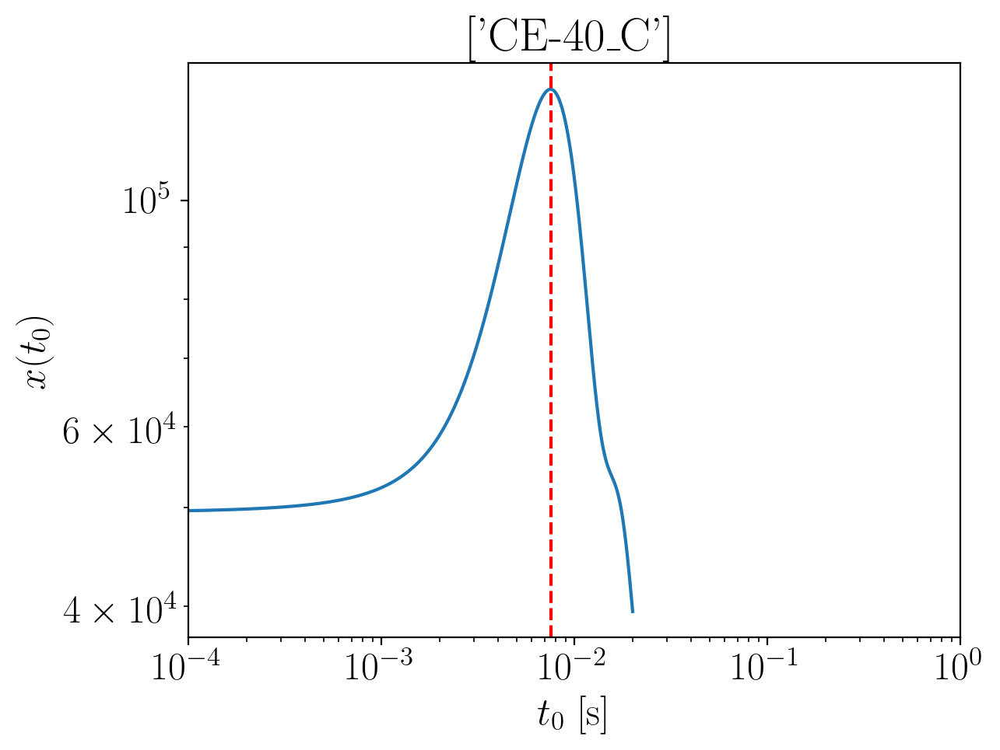

2024-01-15 16:01:55,899 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:55,906 - Network - INFO : PSDs loaded.
2024-01-15 16:01:55,907 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:55,913 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:55,918 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.1518202620822158
Inner product:
0.9994627977362285


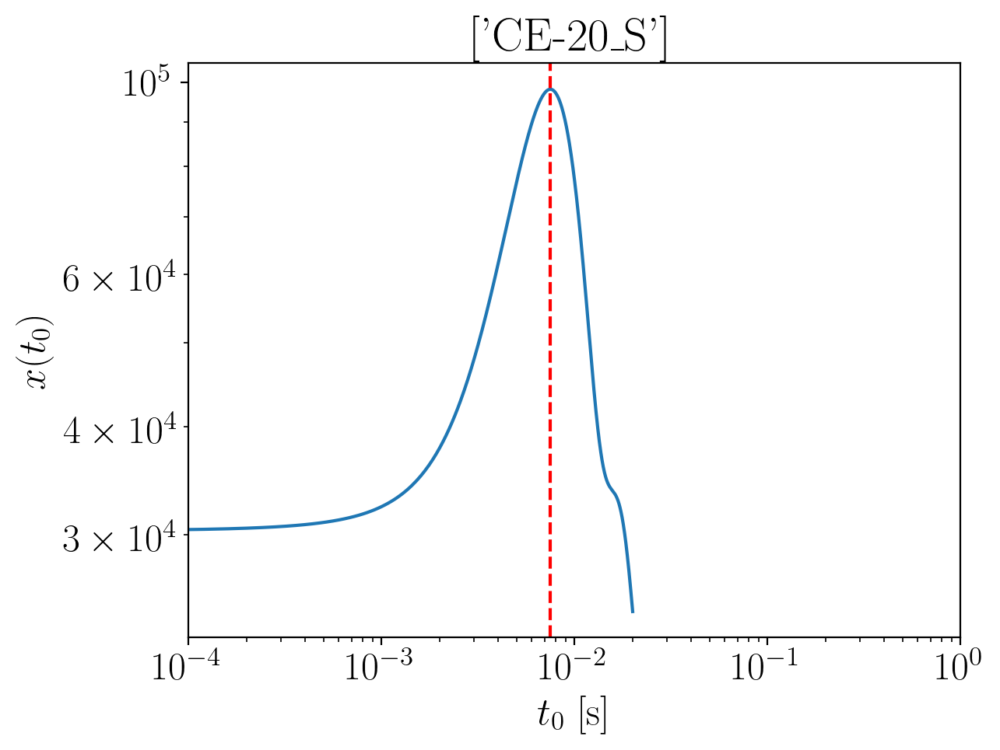

2024-01-15 16:01:57,409 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:57,417 - Network - INFO : PSDs loaded.
2024-01-15 16:01:57,426 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:57,435 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:57,447 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.1634599192841755
Inner product:
0.9993975769636633


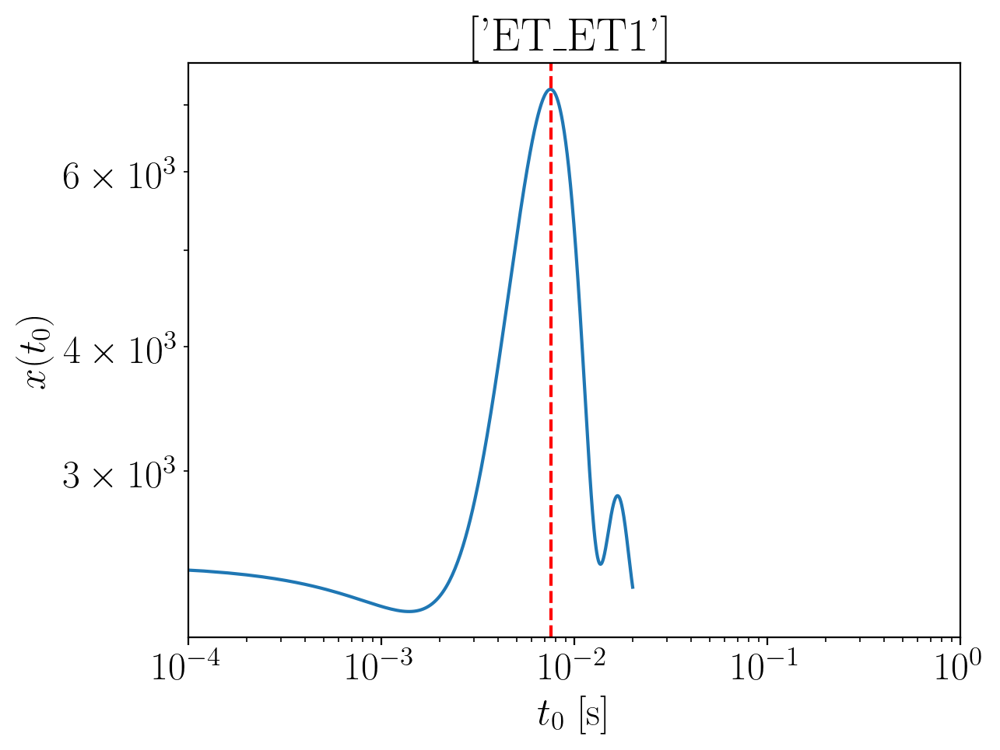

2024-01-15 16:01:58,852 - Network - INFO : Polarizations calculated.
2024-01-15 16:01:58,866 - Network - INFO : PSDs loaded.
2024-01-15 16:01:58,872 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:01:58,886 - Network - INFO : Detector responses calculated.
2024-01-15 16:01:58,893 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.138657742058021
Inner product:
0.9994120616554688


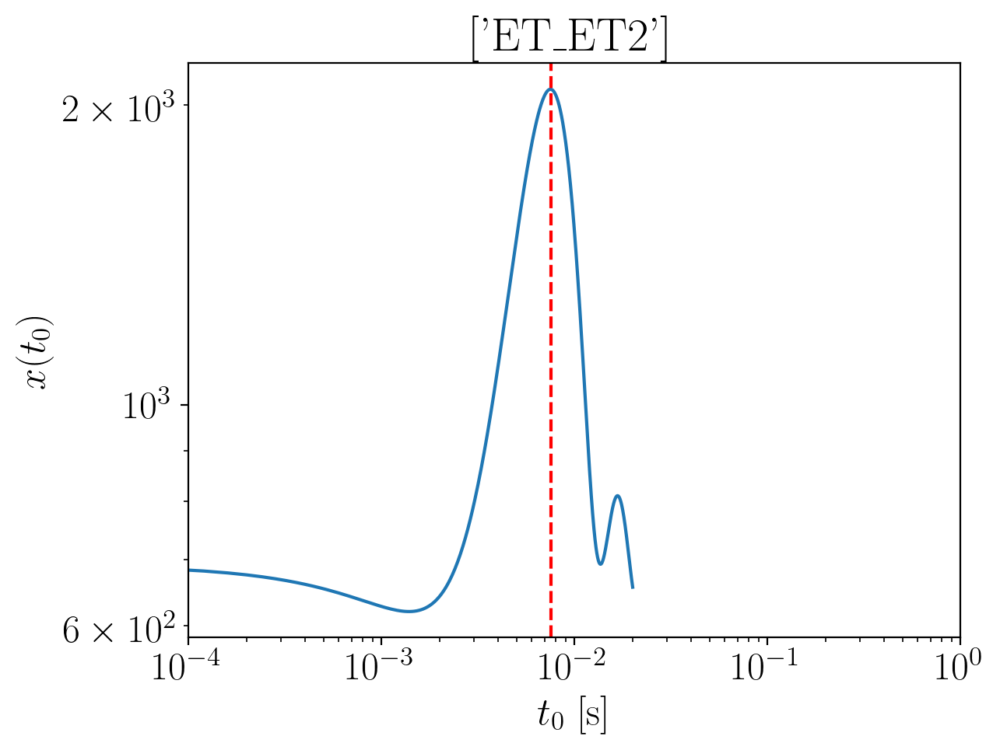

2024-01-15 16:02:00,462 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:00,477 - Network - INFO : PSDs loaded.
2024-01-15 16:02:00,479 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:00,485 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:00,493 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.1386577420580215
Inner product:
0.9994120616554683


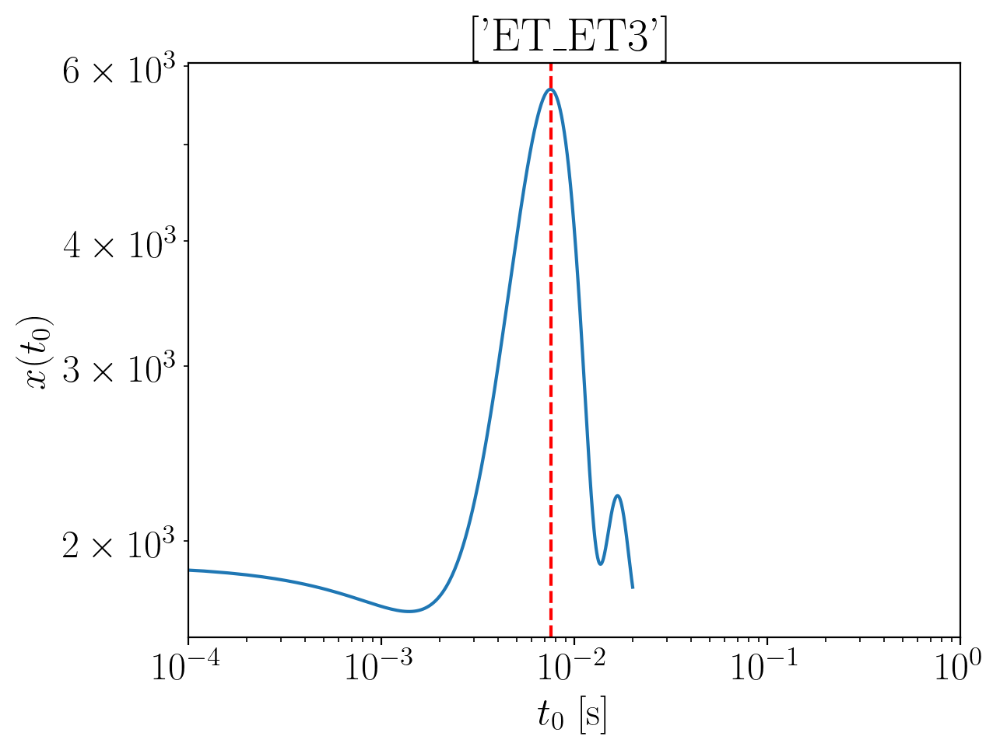

2024-01-15 16:02:01,938 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:01,954 - Network - INFO : PSDs loaded.
2024-01-15 16:02:01,959 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:01,970 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:01,983 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:02,008 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:02,009 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:02:02,013 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.1386577420580215
Inner product:
0.9994120616554683


2024-01-15 16:02:07,334 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:02:07,380 - Network - INFO : PSDs loaded.
2024-01-15 16:02:07,385 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:07,444 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:07,448 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:02:07,448 - Network - INFO :    CE-40_C
2024-01-15 16:02:11,005 - Network - INFO :    CE-20_S
2024-01-15 16:02:14,531 - Network - INFO :    ET_ET1
2024-01-15 16:02:18,085 - Network - INFO :    ET_ET2
2024-01-15 16:02:21,639 - Network - INFO :    ET_ET3
2024-01-15 16:02:25,209 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:02:25,215 - Network - INFO : SNRs calculated.
2024-01-15 16:02:25,216 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:02:25,217 - Network - INFO :    CE-40_C
2024-01-15 16:02:25,313 - Network - INFO :

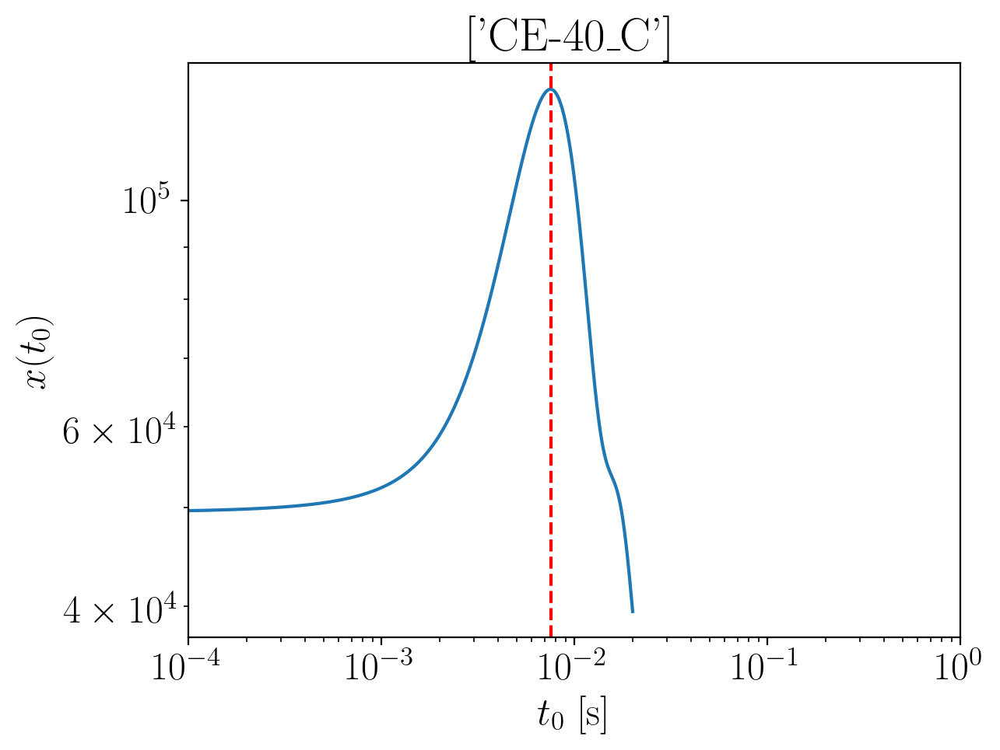

2024-01-15 16:02:27,077 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:27,084 - Network - INFO : PSDs loaded.
2024-01-15 16:02:27,086 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:27,093 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:27,106 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.102117277140133
Inner product:
0.9994627977362285


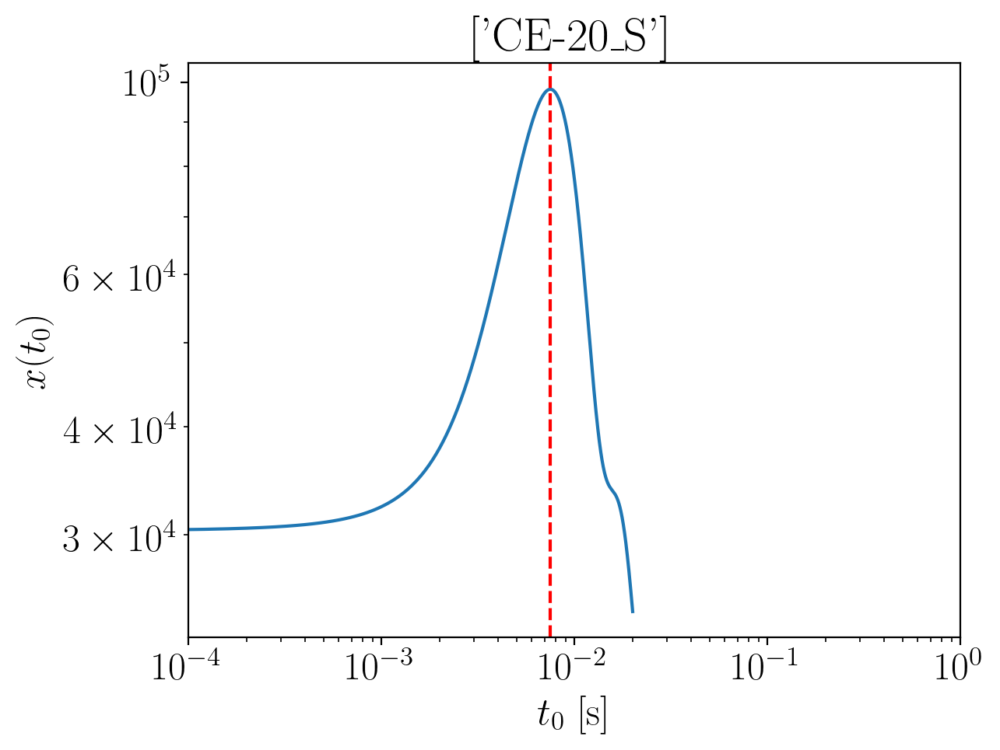

2024-01-15 16:02:28,301 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:28,308 - Network - INFO : PSDs loaded.
2024-01-15 16:02:28,318 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:28,350 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:28,359 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.113756934342092
Inner product:
0.9993975769636633


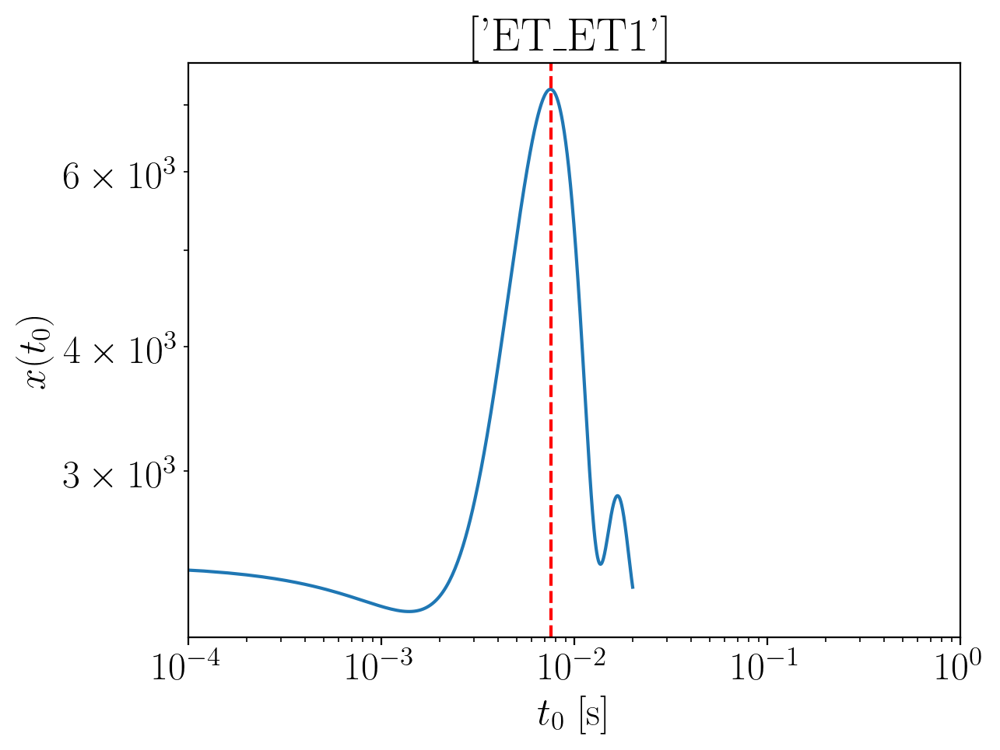

2024-01-15 16:02:29,800 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:29,976 - Network - INFO : PSDs loaded.
2024-01-15 16:02:29,978 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:29,983 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:29,988 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.0889547571159377
Inner product:
0.9994120616554688


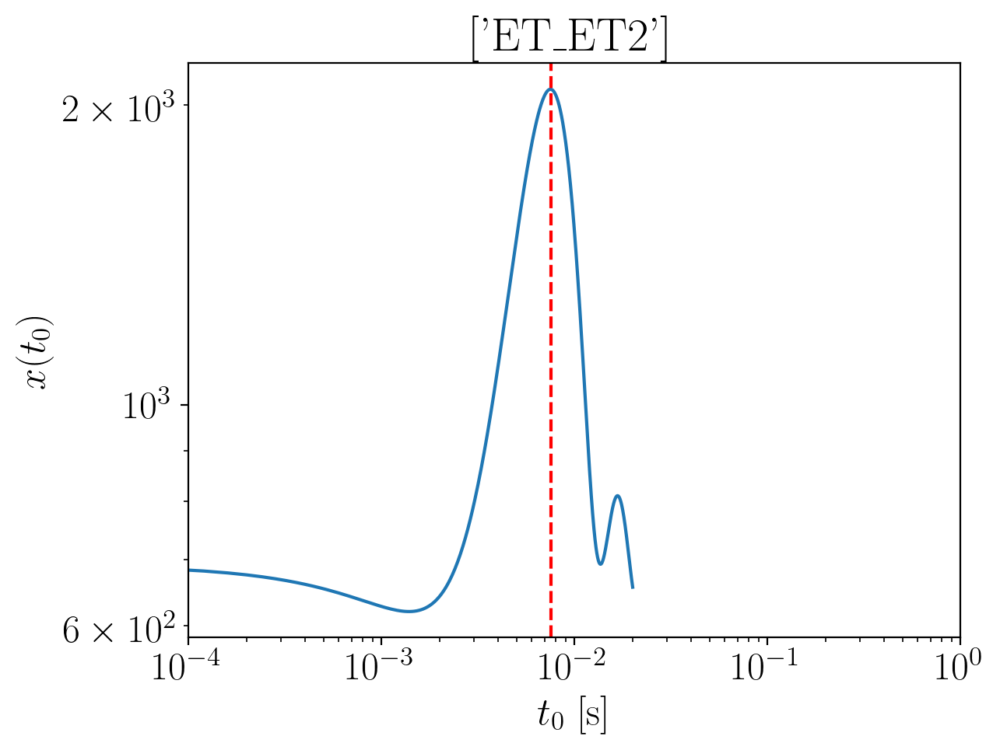

2024-01-15 16:02:31,435 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:31,448 - Network - INFO : PSDs loaded.
2024-01-15 16:02:31,450 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:31,455 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:31,461 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.0889547571159373
Inner product:
0.9994120616554683


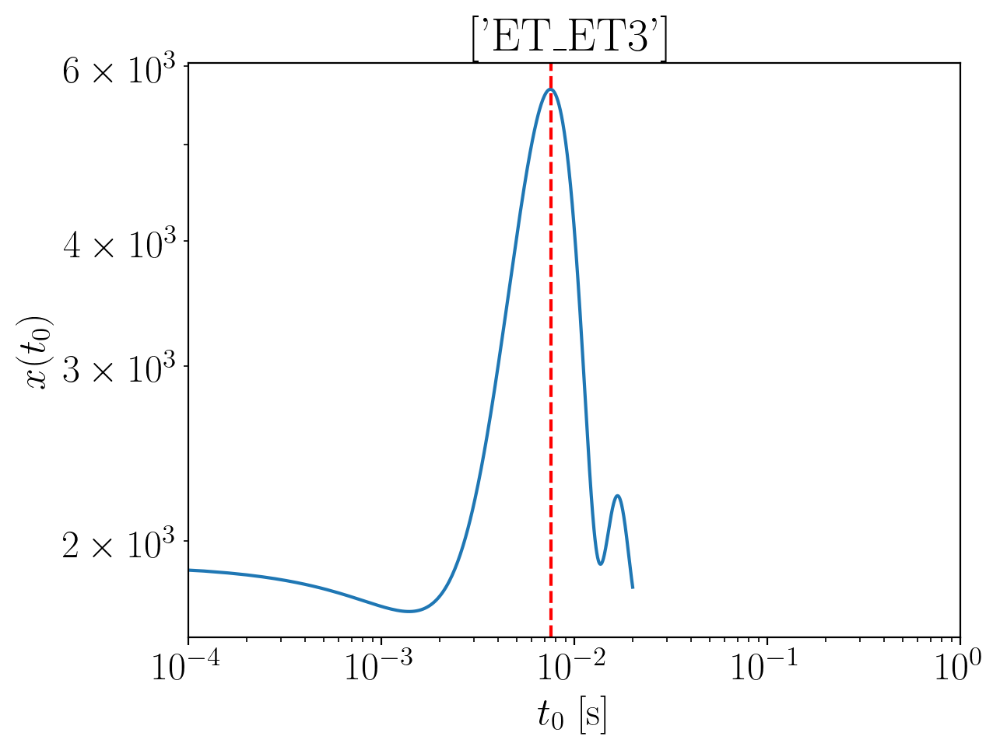

2024-01-15 16:02:32,848 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:32,869 - Network - INFO : PSDs loaded.
2024-01-15 16:02:32,880 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:32,886 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:32,891 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:32,939 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:32,951 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:02:32,973 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.0889547571159373
Inner product:
0.9994120616554683


2024-01-15 16:02:38,291 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:02:38,335 - Network - INFO : PSDs loaded.
2024-01-15 16:02:38,341 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:38,355 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:38,356 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:02:38,357 - Network - INFO :    CE-40_C
2024-01-15 16:02:41,949 - Network - INFO :    CE-20_S
2024-01-15 16:02:45,501 - Network - INFO :    ET_ET1
2024-01-15 16:02:49,142 - Network - INFO :    ET_ET2
2024-01-15 16:02:52,738 - Network - INFO :    ET_ET3
2024-01-15 16:02:56,316 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:02:56,322 - Network - INFO : SNRs calculated.
2024-01-15 16:02:56,323 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:02:56,323 - Network - INFO :    CE-40_C
2024-01-15 16:02:56,416 - Network - INFO :

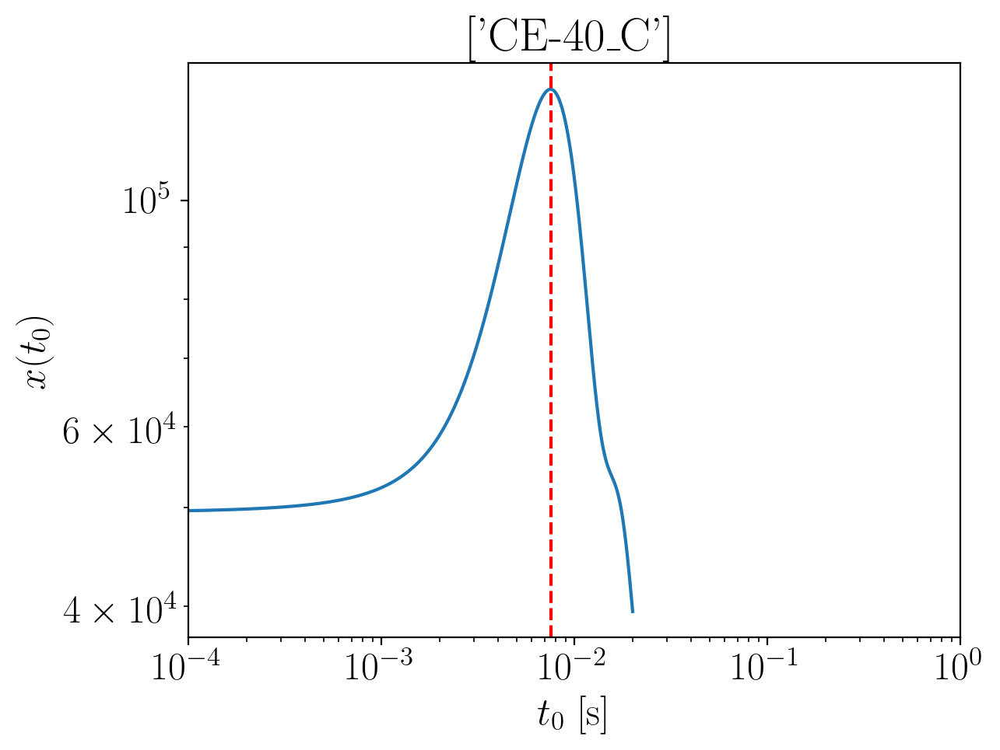

2024-01-15 16:02:58,170 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:58,181 - Network - INFO : PSDs loaded.
2024-01-15 16:02:58,185 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:58,196 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:58,216 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.0529850808658865
Inner product:
0.9994627977362285


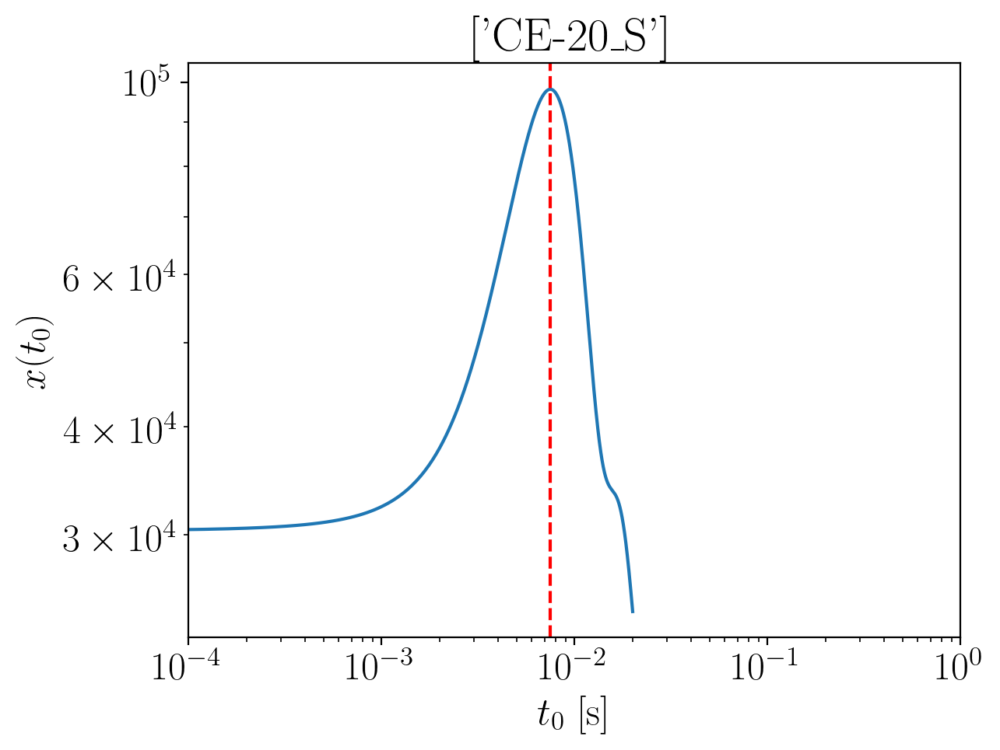

2024-01-15 16:02:59,389 - Network - INFO : Polarizations calculated.
2024-01-15 16:02:59,396 - Network - INFO : PSDs loaded.
2024-01-15 16:02:59,398 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:02:59,403 - Network - INFO : Detector responses calculated.
2024-01-15 16:02:59,408 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.0646247380678457
Inner product:
0.9993975769636633


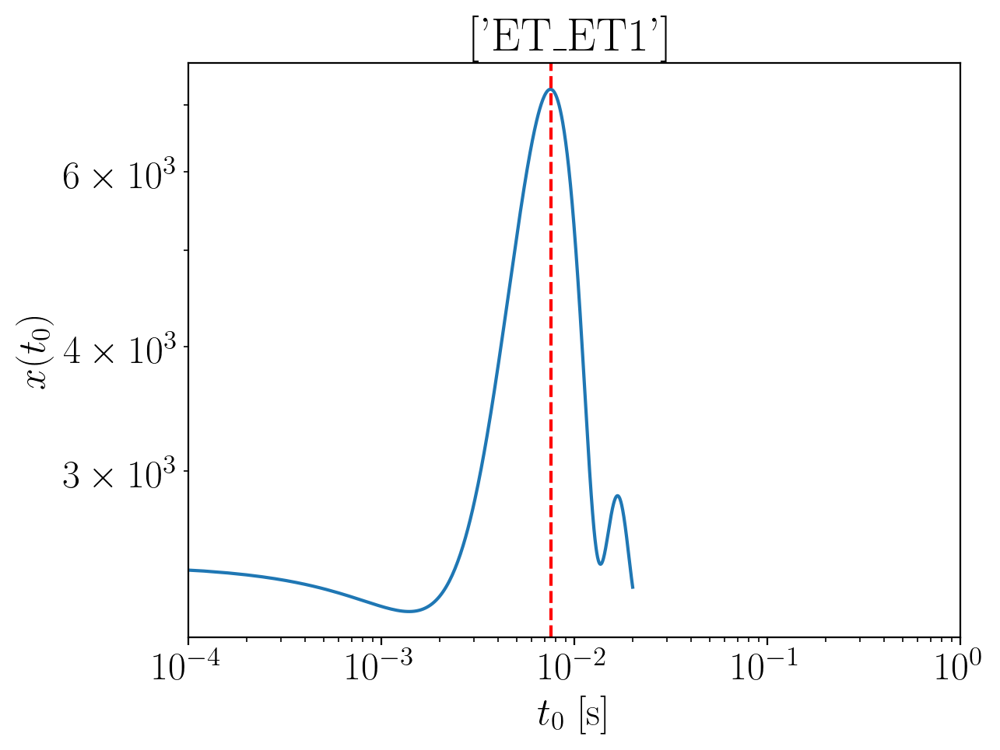

2024-01-15 16:03:00,776 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:00,789 - Network - INFO : PSDs loaded.
2024-01-15 16:03:00,791 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:00,796 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:00,801 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.039822560841691
Inner product:
0.9994120616554687


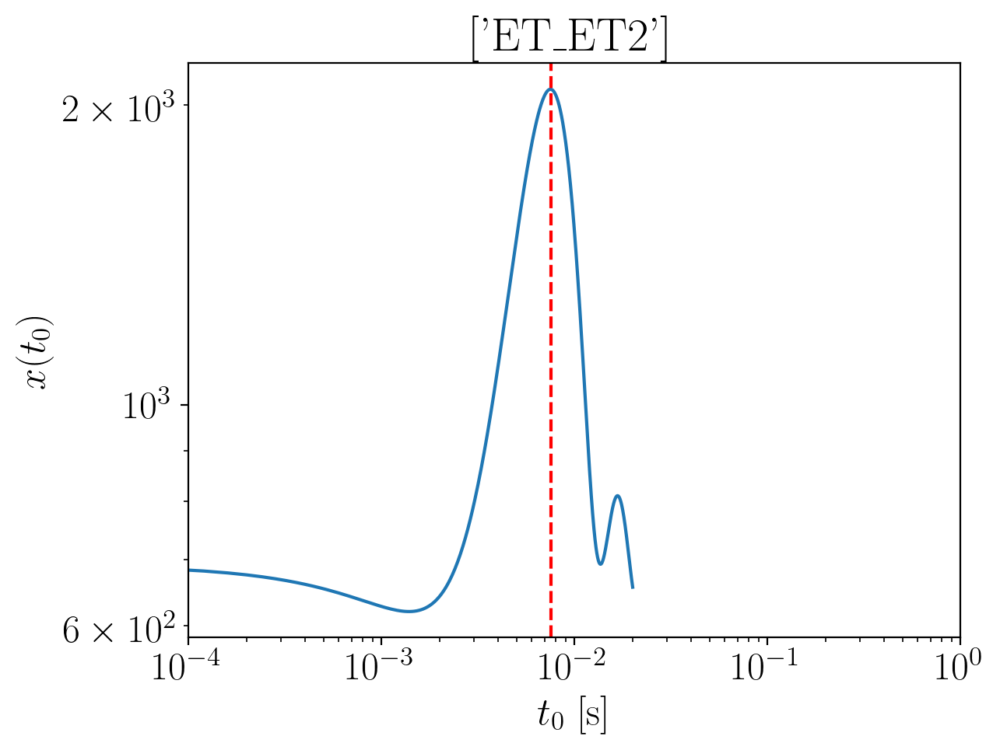

2024-01-15 16:03:02,241 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:02,255 - Network - INFO : PSDs loaded.
2024-01-15 16:03:02,262 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:02,270 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:02,282 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.039822560841691
Inner product:
0.9994120616554683


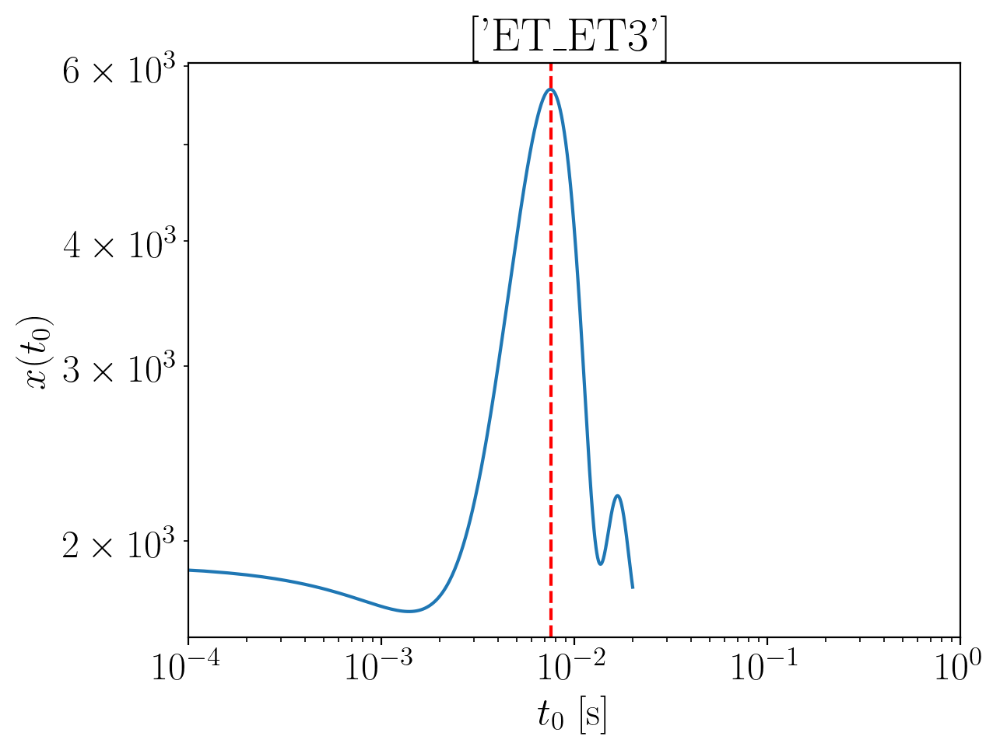

2024-01-15 16:03:03,786 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:03,800 - Network - INFO : PSDs loaded.
2024-01-15 16:03:03,802 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:03,807 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:03,812 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:03,835 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:03,836 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:03:03,840 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.039822560841691
Inner product:
0.9994120616554683


2024-01-15 16:03:09,183 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:03:09,227 - Network - INFO : PSDs loaded.
2024-01-15 16:03:09,232 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:09,247 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:09,247 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:03:09,248 - Network - INFO :    CE-40_C
2024-01-15 16:03:12,863 - Network - INFO :    CE-20_S
2024-01-15 16:03:16,408 - Network - INFO :    ET_ET1
2024-01-15 16:03:19,966 - Network - INFO :    ET_ET2
2024-01-15 16:03:23,522 - Network - INFO :    ET_ET3
2024-01-15 16:03:27,070 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:03:27,076 - Network - INFO : SNRs calculated.
2024-01-15 16:03:27,076 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:03:27,077 - Network - INFO :    CE-40_C
2024-01-15 16:03:27,170 - Network - INFO :

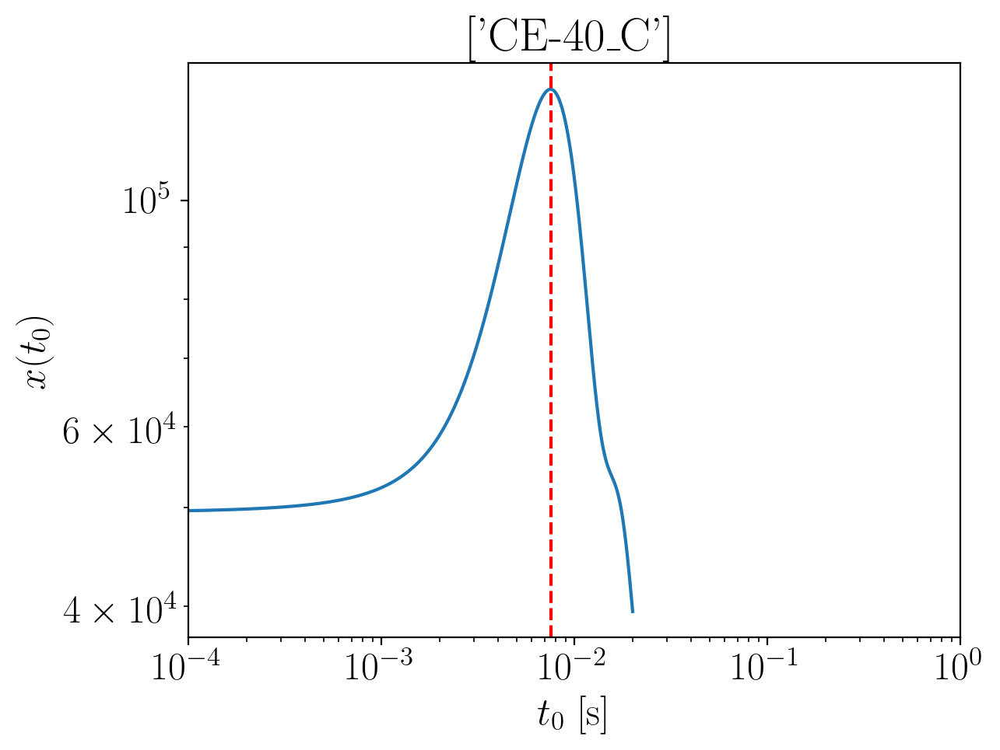

2024-01-15 16:03:28,876 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:28,882 - Network - INFO : PSDs loaded.
2024-01-15 16:03:28,884 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:28,888 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:28,893 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -2.0042034539334677
Inner product:
0.9994627977362285


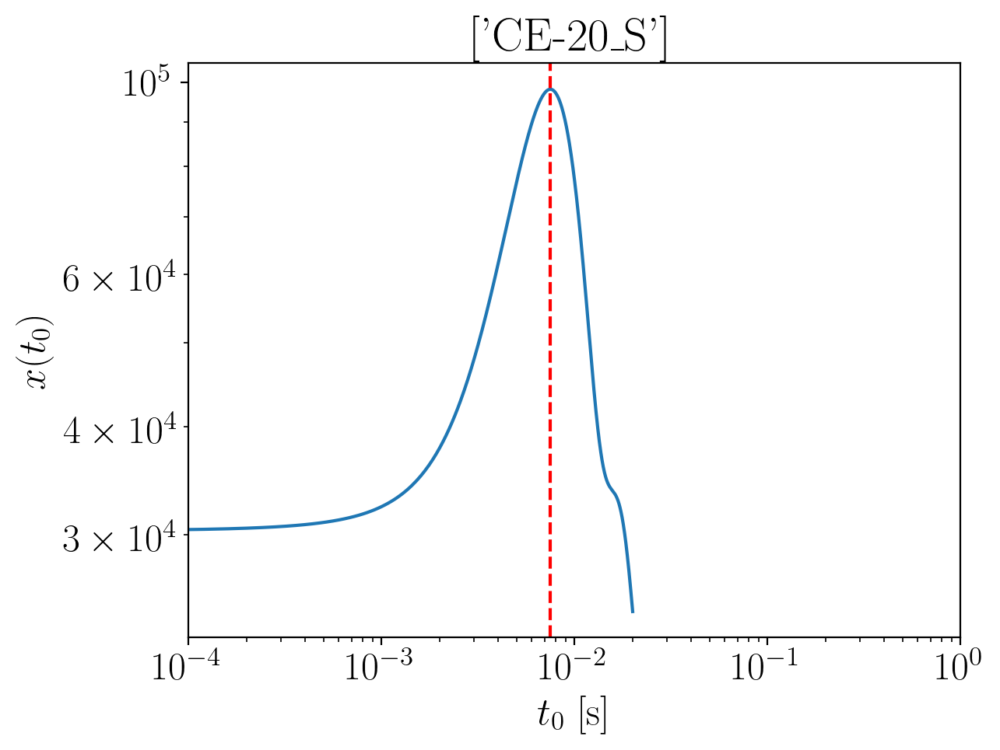

2024-01-15 16:03:30,120 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:30,126 - Network - INFO : PSDs loaded.
2024-01-15 16:03:30,128 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:30,133 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:30,138 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -2.015843111135427
Inner product:
0.9993975769636633


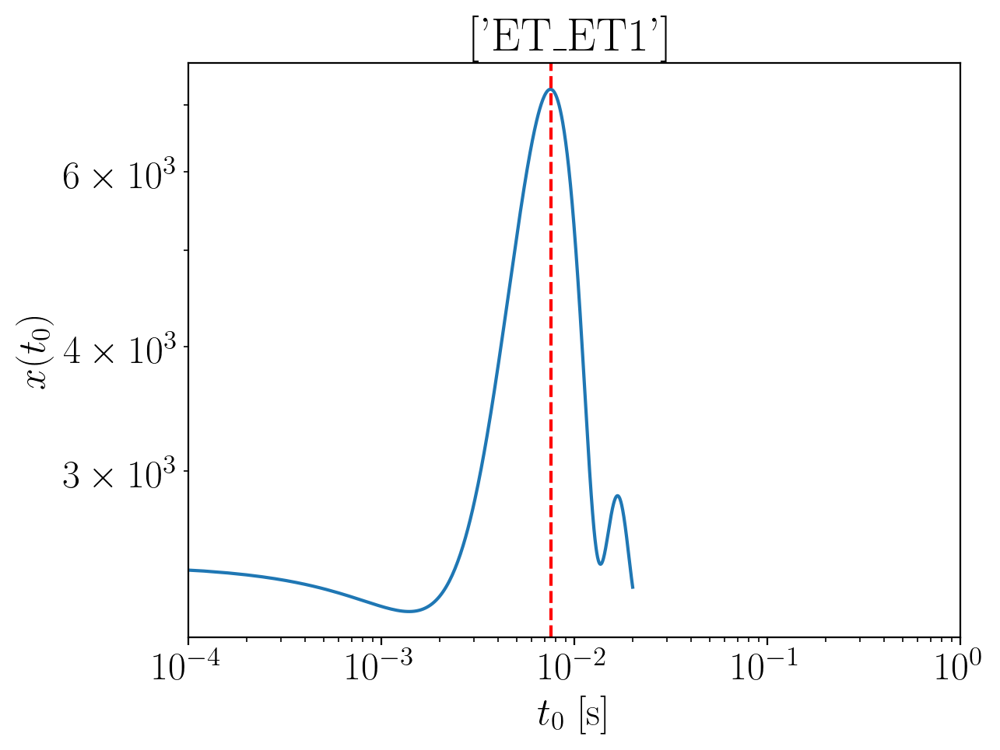

2024-01-15 16:03:31,613 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:31,632 - Network - INFO : PSDs loaded.
2024-01-15 16:03:31,640 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:31,646 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:31,656 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9910409339092723
Inner product:
0.9994120616554687


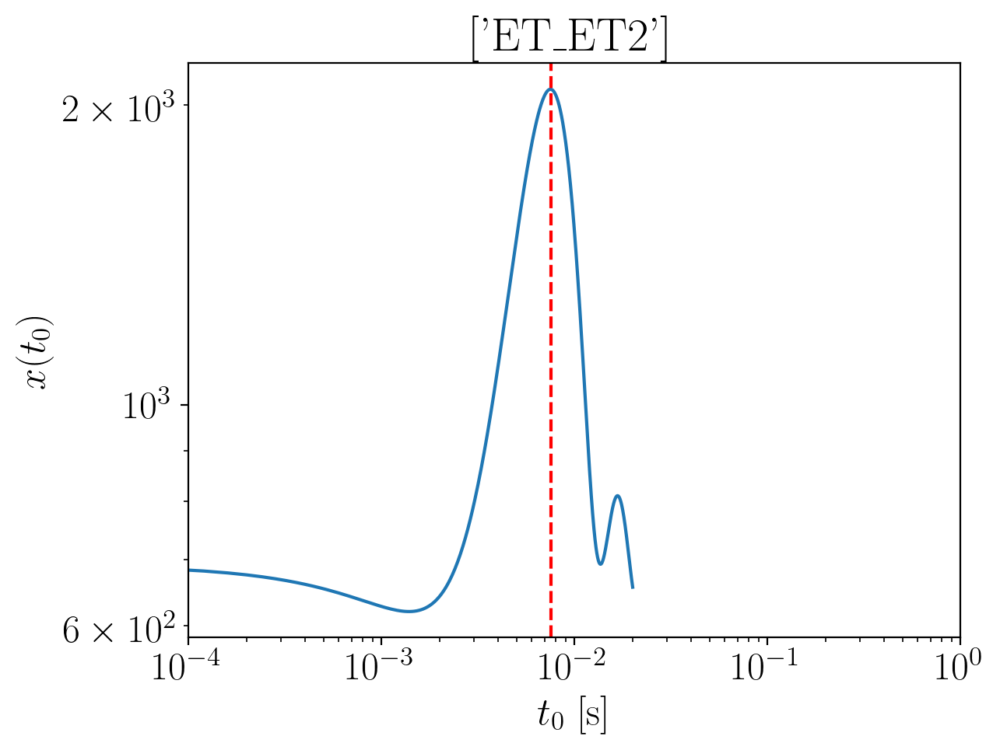

2024-01-15 16:03:33,071 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:33,088 - Network - INFO : PSDs loaded.
2024-01-15 16:03:33,094 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:33,103 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:33,110 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9910409339092723
Inner product:
0.9994120616554683


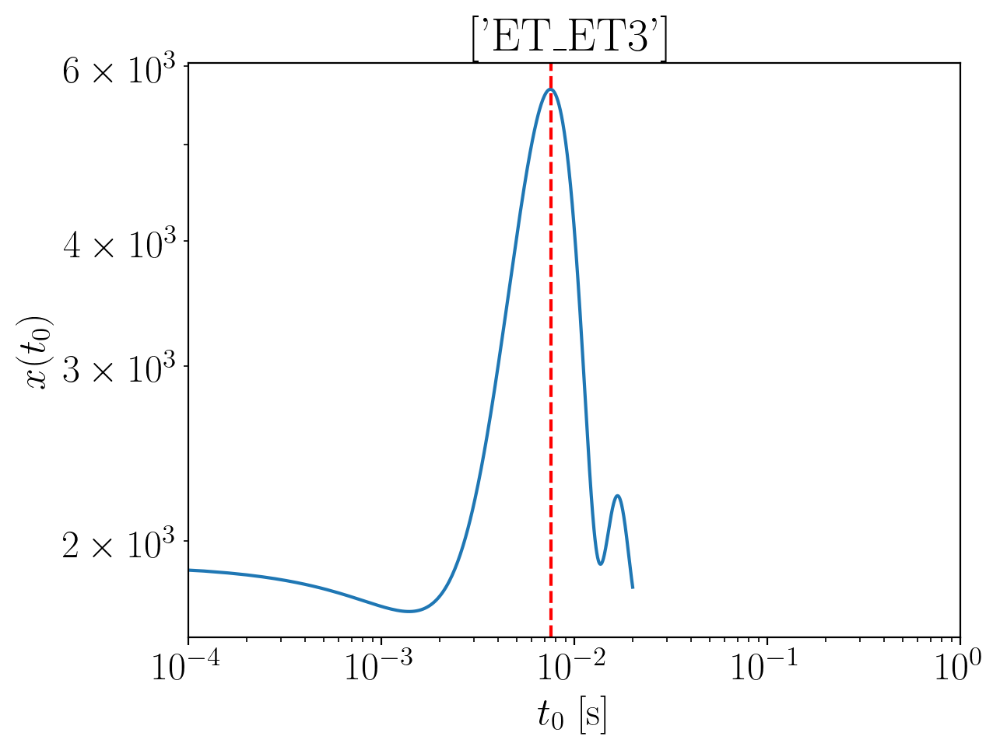

2024-01-15 16:03:34,485 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:34,501 - Network - INFO : PSDs loaded.
2024-01-15 16:03:34,506 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:34,514 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:34,520 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:34,550 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:34,551 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:03:34,555 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9910409339092723
Inner product:
0.9994120616554683


2024-01-15 16:03:39,963 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:03:40,009 - Network - INFO : PSDs loaded.
2024-01-15 16:03:40,016 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:40,032 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:40,033 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:03:40,033 - Network - INFO :    CE-40_C
2024-01-15 16:03:43,642 - Network - INFO :    CE-20_S
2024-01-15 16:03:47,203 - Network - INFO :    ET_ET1
2024-01-15 16:03:50,733 - Network - INFO :    ET_ET2
2024-01-15 16:03:54,294 - Network - INFO :    ET_ET3
2024-01-15 16:03:57,910 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:03:57,917 - Network - INFO : SNRs calculated.
2024-01-15 16:03:57,918 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:03:57,919 - Network - INFO :    CE-40_C
2024-01-15 16:03:58,022 - Network - INFO :

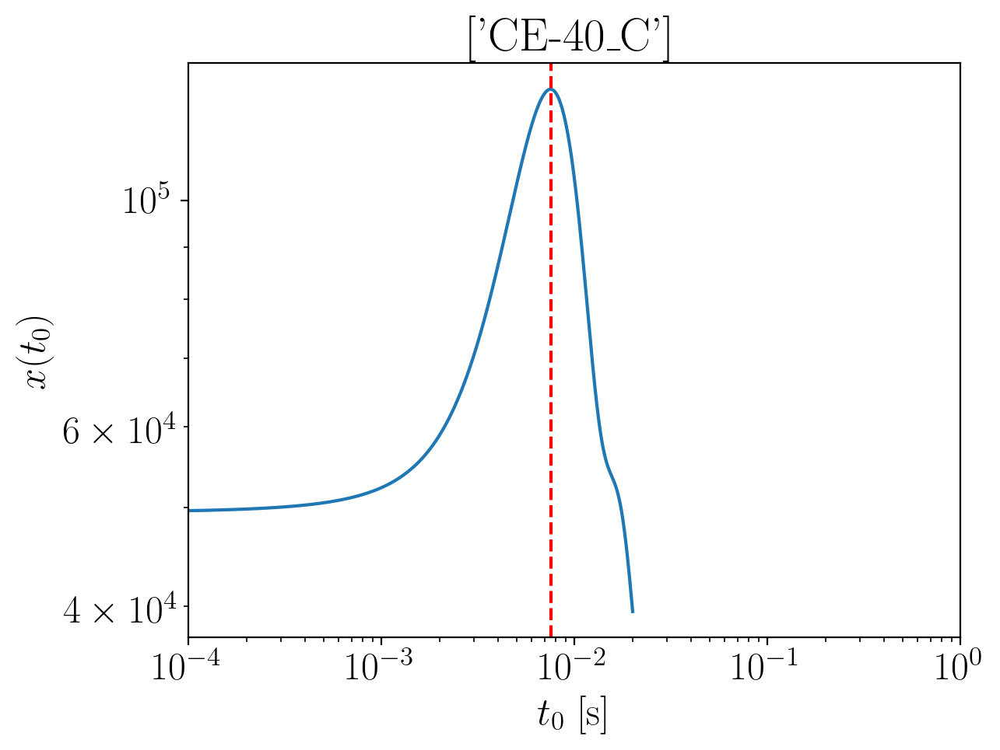

2024-01-15 16:03:59,934 - Network - INFO : Polarizations calculated.
2024-01-15 16:03:59,942 - Network - INFO : PSDs loaded.
2024-01-15 16:03:59,944 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:03:59,949 - Network - INFO : Detector responses calculated.
2024-01-15 16:03:59,954 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9556200477414059
Inner product:
0.9994627977362285


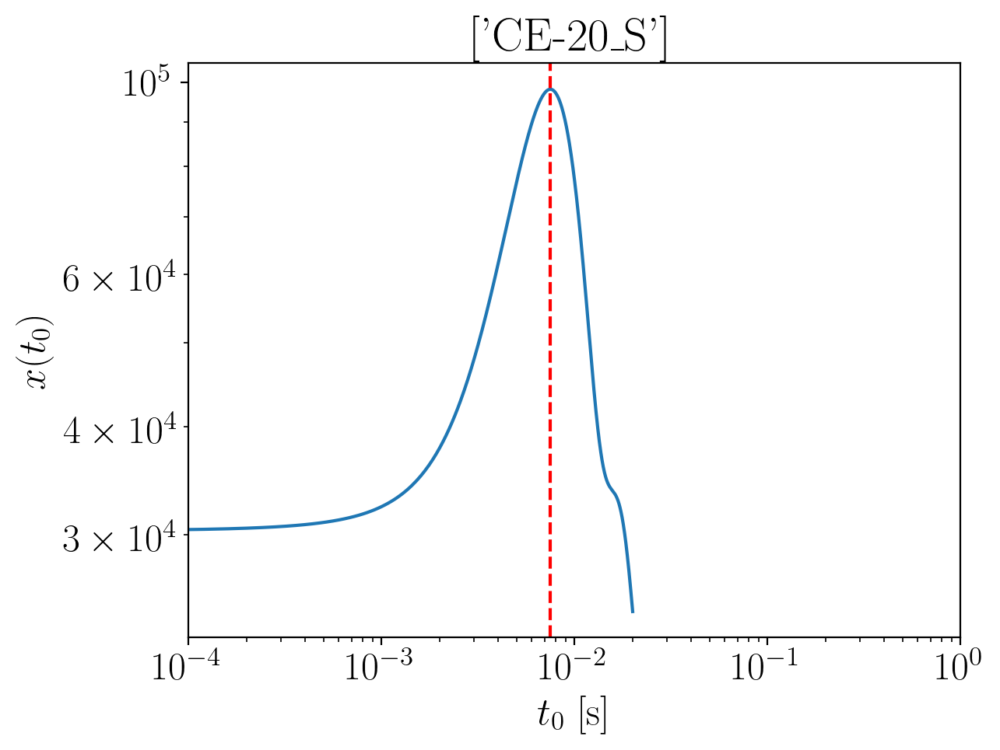

2024-01-15 16:04:01,136 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:01,143 - Network - INFO : PSDs loaded.
2024-01-15 16:04:01,145 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:01,151 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:01,156 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -1.9672597049433653
Inner product:
0.9993975769636633


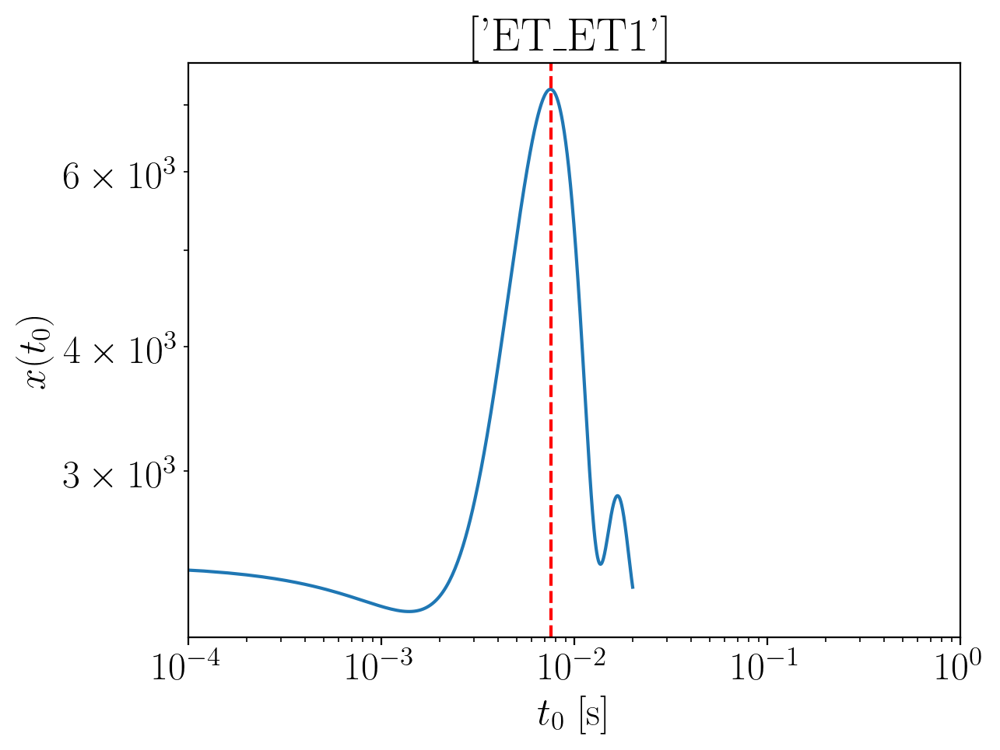

2024-01-15 16:04:02,675 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:02,691 - Network - INFO : PSDs loaded.
2024-01-15 16:04:02,693 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:02,705 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:02,717 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9424575277172105
Inner product:
0.9994120616554685


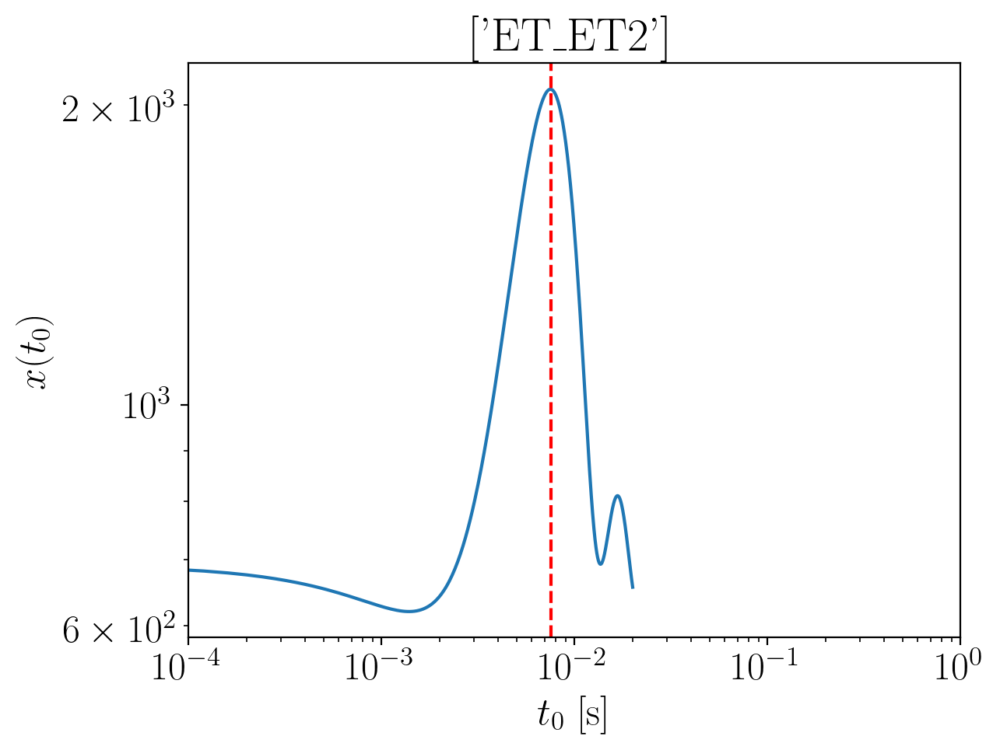

2024-01-15 16:04:04,136 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:04,151 - Network - INFO : PSDs loaded.
2024-01-15 16:04:04,157 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:04,163 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:04,177 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9424575277172105
Inner product:
0.9994120616554683


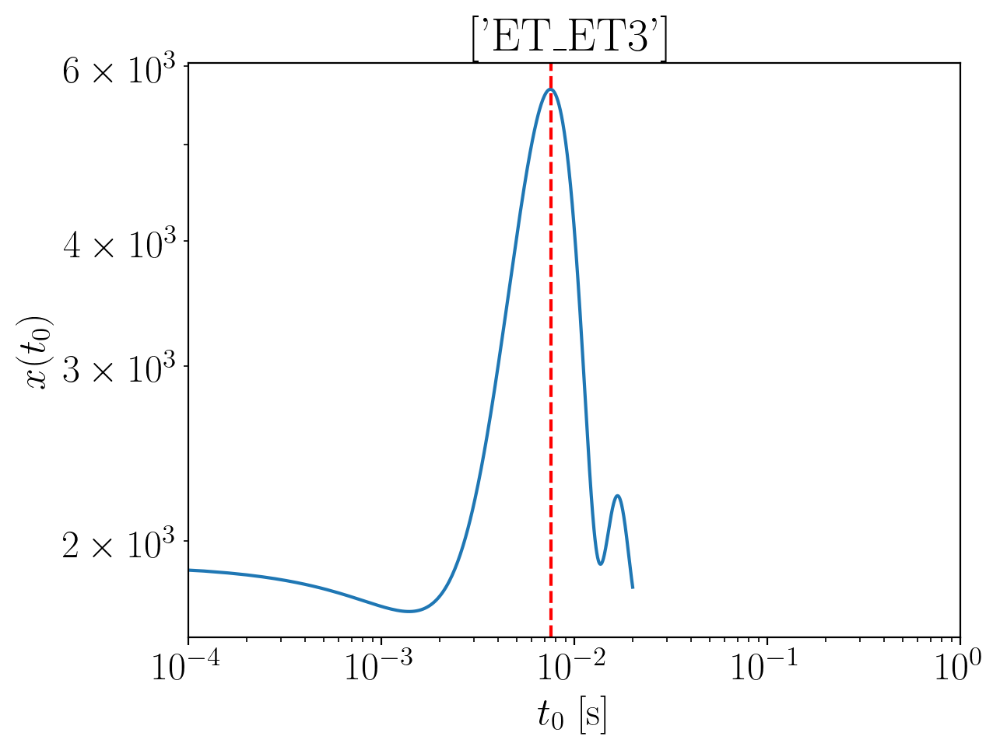

2024-01-15 16:04:05,594 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:05,608 - Network - INFO : PSDs loaded.
2024-01-15 16:04:05,614 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:05,625 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:05,631 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:05,659 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:05,660 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:04:05,665 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9424575277172103
Inner product:
0.9994120616554683


2024-01-15 16:04:11,125 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:04:11,169 - Network - INFO : PSDs loaded.
2024-01-15 16:04:11,175 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:11,194 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:11,195 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:04:11,196 - Network - INFO :    CE-40_C
2024-01-15 16:04:14,760 - Network - INFO :    CE-20_S
2024-01-15 16:04:18,326 - Network - INFO :    ET_ET1
2024-01-15 16:04:21,907 - Network - INFO :    ET_ET2
2024-01-15 16:04:25,434 - Network - INFO :    ET_ET3
2024-01-15 16:04:29,010 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:04:29,016 - Network - INFO : SNRs calculated.
2024-01-15 16:04:29,017 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:04:29,017 - Network - INFO :    CE-40_C
2024-01-15 16:04:29,112 - Network - INFO :

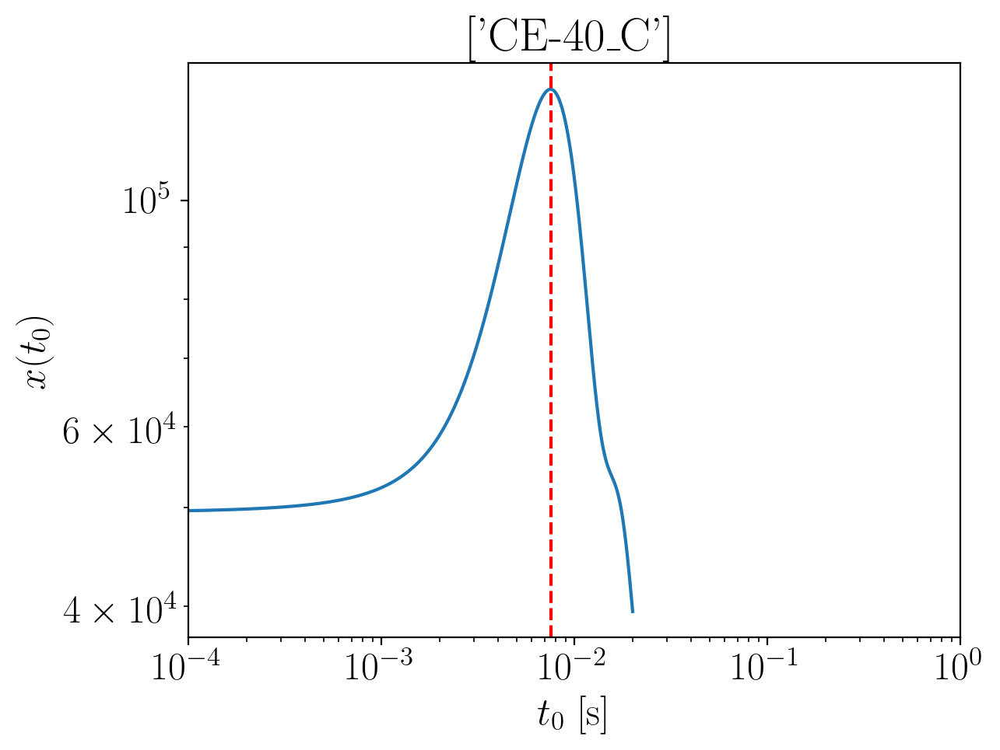

2024-01-15 16:04:30,830 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:30,837 - Network - INFO : PSDs loaded.
2024-01-15 16:04:30,839 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:30,844 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:30,849 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.9071269888539952
Inner product:
0.9994627977362285


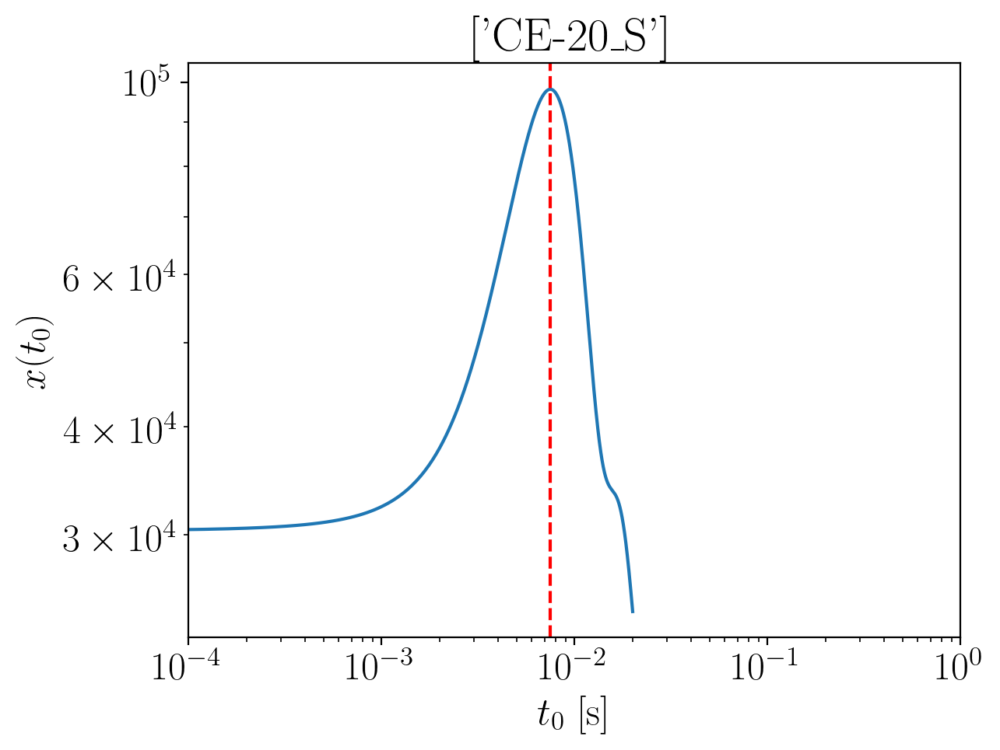

2024-01-15 16:04:32,056 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:32,063 - Network - INFO : PSDs loaded.
2024-01-15 16:04:32,065 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:32,071 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:32,076 - Network - INFO : Polarizations calculated.


time shift: 0.0074800000000000005
phase shift: -1.9187666460559547
Inner product:
0.9993975769636633


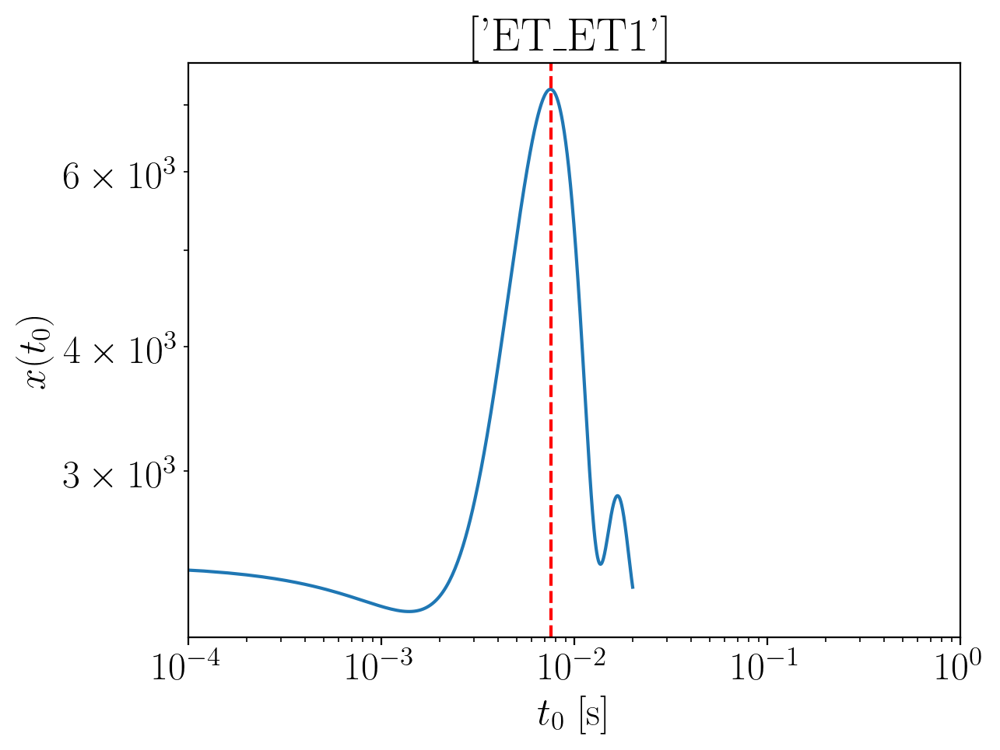

2024-01-15 16:04:33,531 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:33,544 - Network - INFO : PSDs loaded.
2024-01-15 16:04:33,547 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:33,552 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:33,557 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.8939644688298
Inner product:
0.9994120616554687


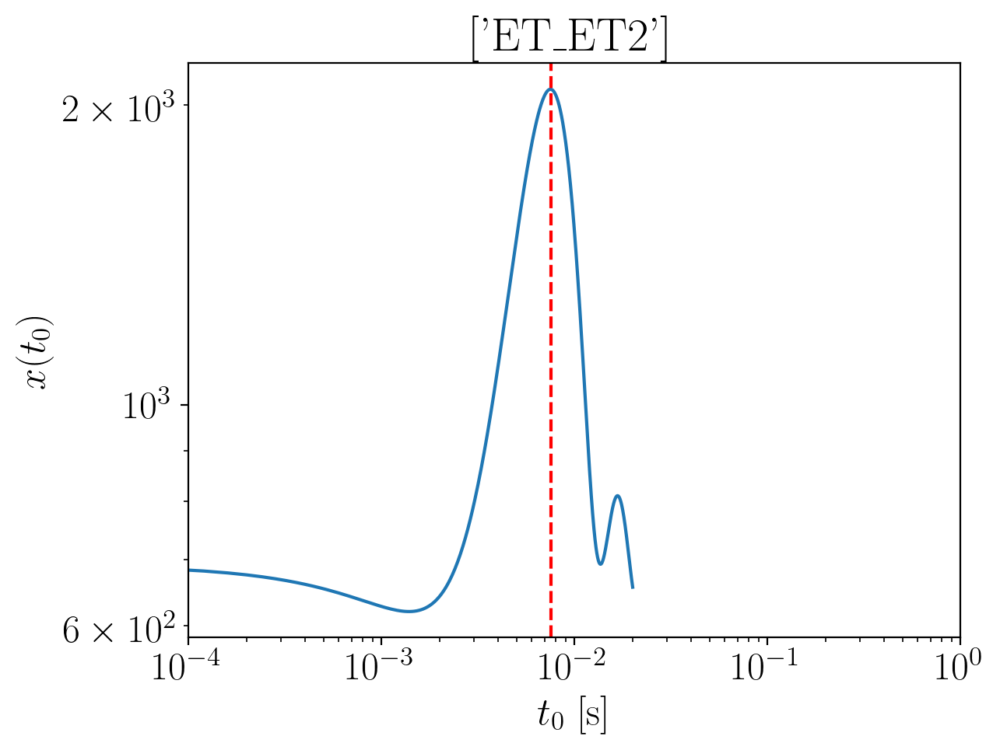

2024-01-15 16:04:35,153 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:35,166 - Network - INFO : PSDs loaded.
2024-01-15 16:04:35,168 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:35,173 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:35,178 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.8939644688298
Inner product:
0.9994120616554683


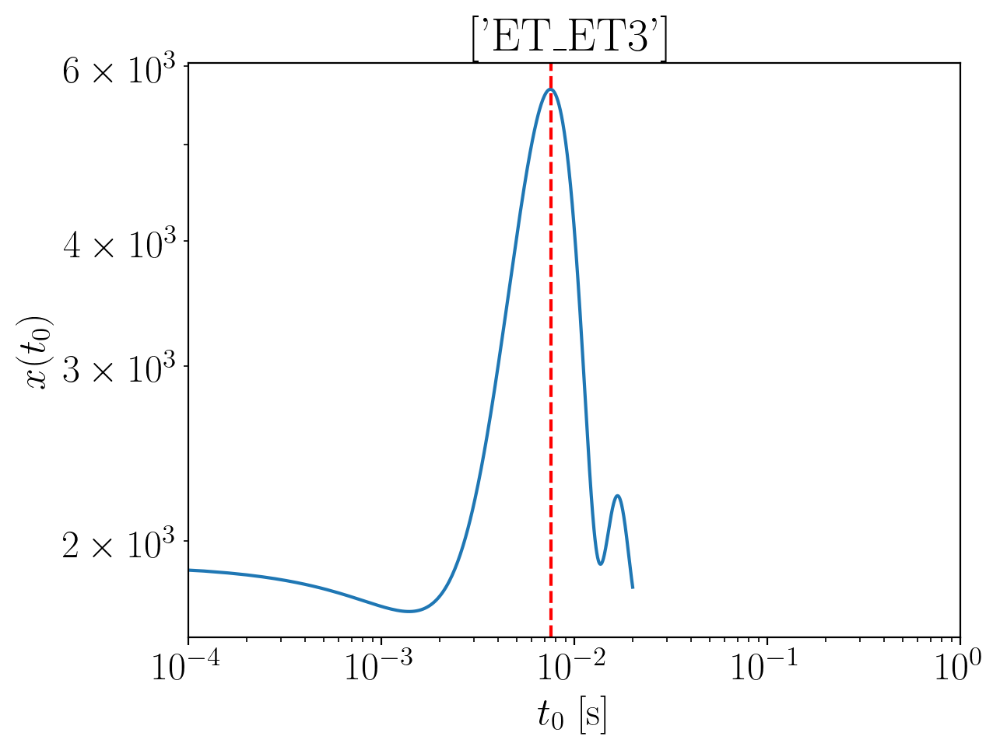

2024-01-15 16:04:36,619 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:36,639 - Network - INFO : PSDs loaded.
2024-01-15 16:04:36,645 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:36,652 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:36,660 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:36,713 - Network - INFO : Polarizations calculated.
2024-01-15 16:04:36,715 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:04:36,729 - Network - INFO : Polarizations calculated.


time shift: 0.007520000000000001
phase shift: -1.8939644688298
Inner product:
0.9994120616554683


2024-01-15 16:04:42,055 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:04:42,101 - Network - INFO : PSDs loaded.
2024-01-15 16:04:42,107 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:04:42,122 - Network - INFO : Detector responses calculated.
2024-01-15 16:04:42,123 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:04:42,123 - Network - INFO :    CE-40_C
2024-01-15 16:04:45,700 - Network - INFO :    CE-20_S
2024-01-15 16:04:49,269 - Network - INFO :    ET_ET1
2024-01-15 16:04:52,839 - Network - INFO :    ET_ET2
2024-01-15 16:04:56,384 - Network - INFO :    ET_ET3
2024-01-15 16:04:59,960 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:04:59,967 - Network - INFO : SNRs calculated.
2024-01-15 16:04:59,968 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:04:59,969 - Network - INFO :    CE-40_C
2024-01-15 16:05:00,072 - Network - INFO :

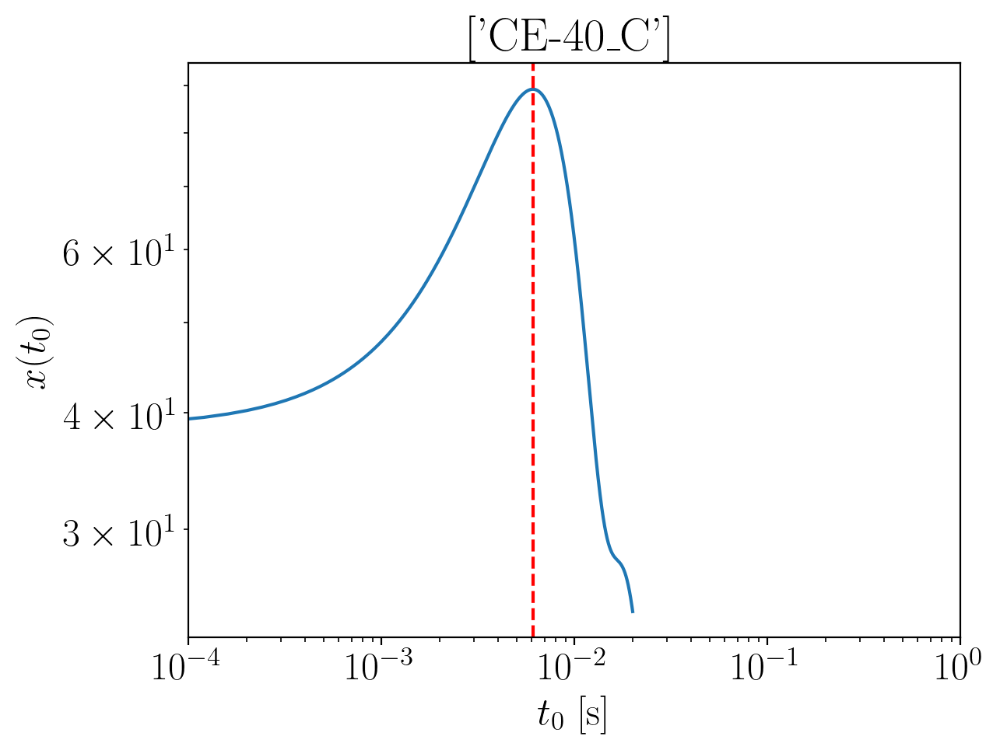

2024-01-15 16:05:01,816 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:01,825 - Network - INFO : PSDs loaded.
2024-01-15 16:05:01,828 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:01,834 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:01,839 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.174828269964609
Inner product:
0.9995867452129219


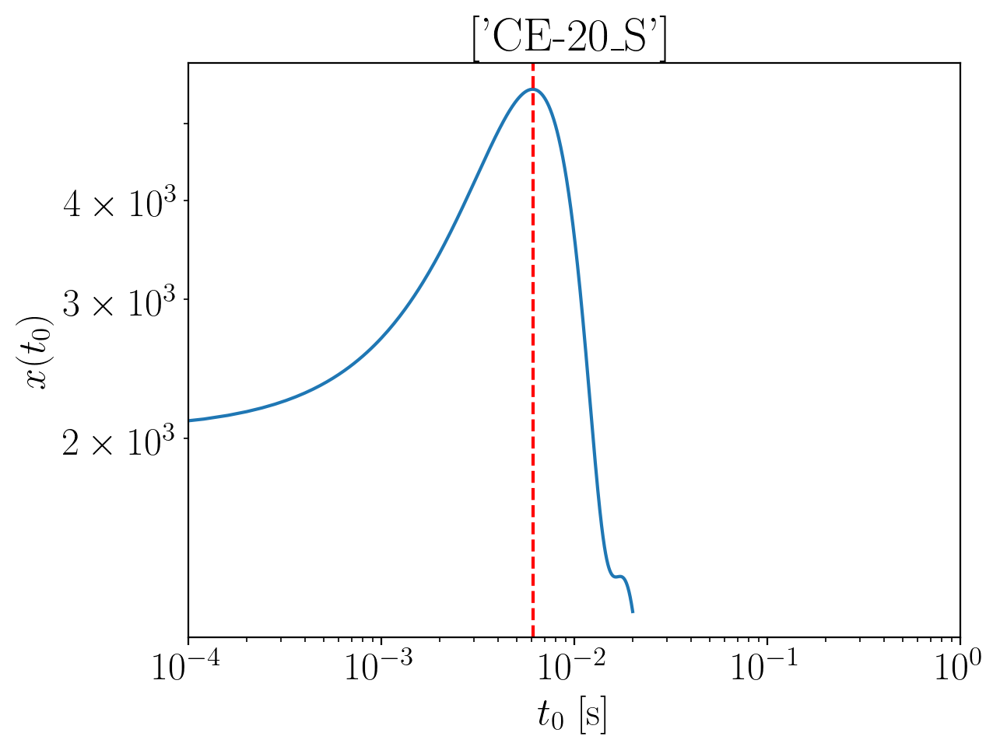

2024-01-15 16:05:03,039 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:03,046 - Network - INFO : PSDs loaded.
2024-01-15 16:05:03,048 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:03,053 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:03,059 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.176567886796814
Inner product:
0.9995301914444018


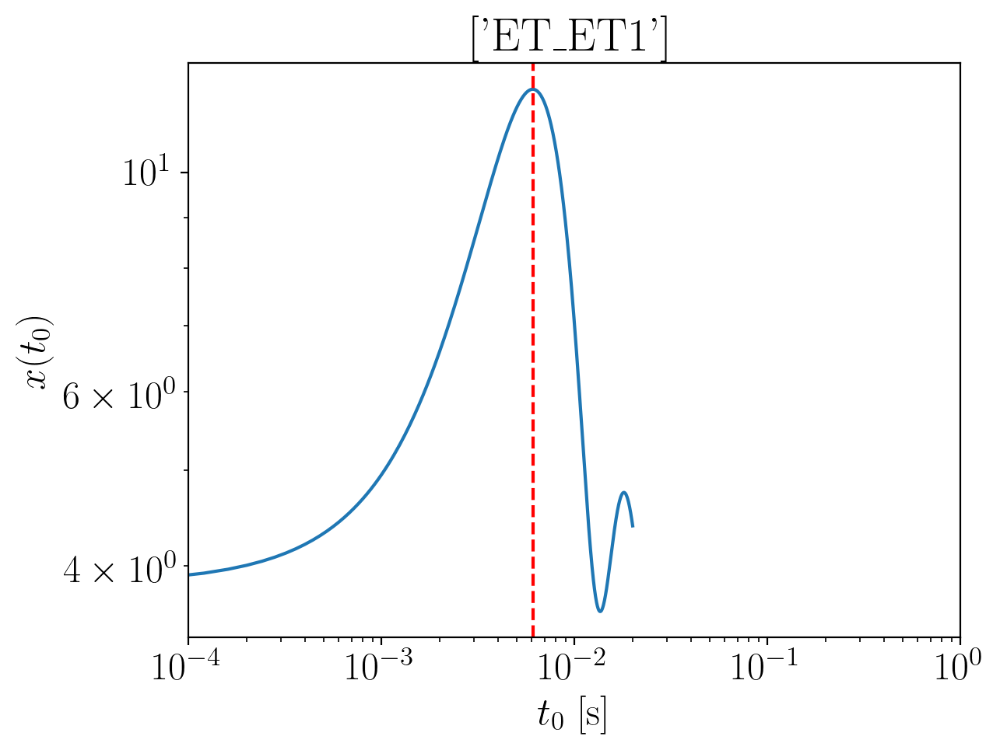

2024-01-15 16:05:04,462 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:04,482 - Network - INFO : PSDs loaded.
2024-01-15 16:05:04,491 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:04,506 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:04,516 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1651509574713326
Inner product:
0.9996122478252939


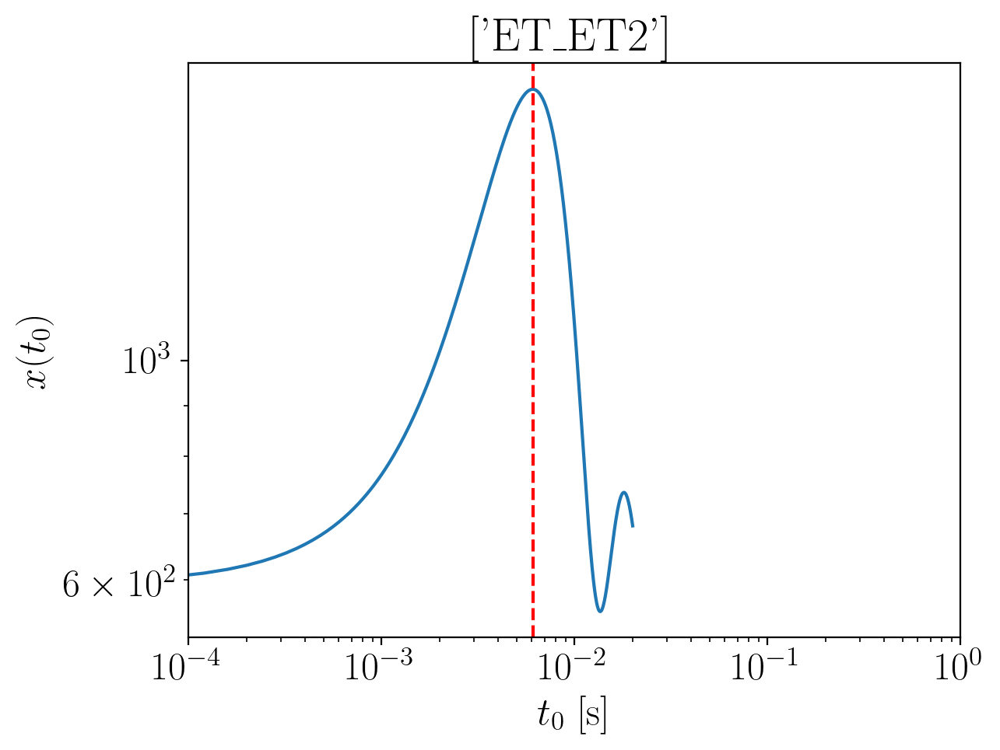

2024-01-15 16:05:05,996 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:06,009 - Network - INFO : PSDs loaded.
2024-01-15 16:05:06,011 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:06,016 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:06,021 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1651509574713326
Inner product:
0.9996122478252939


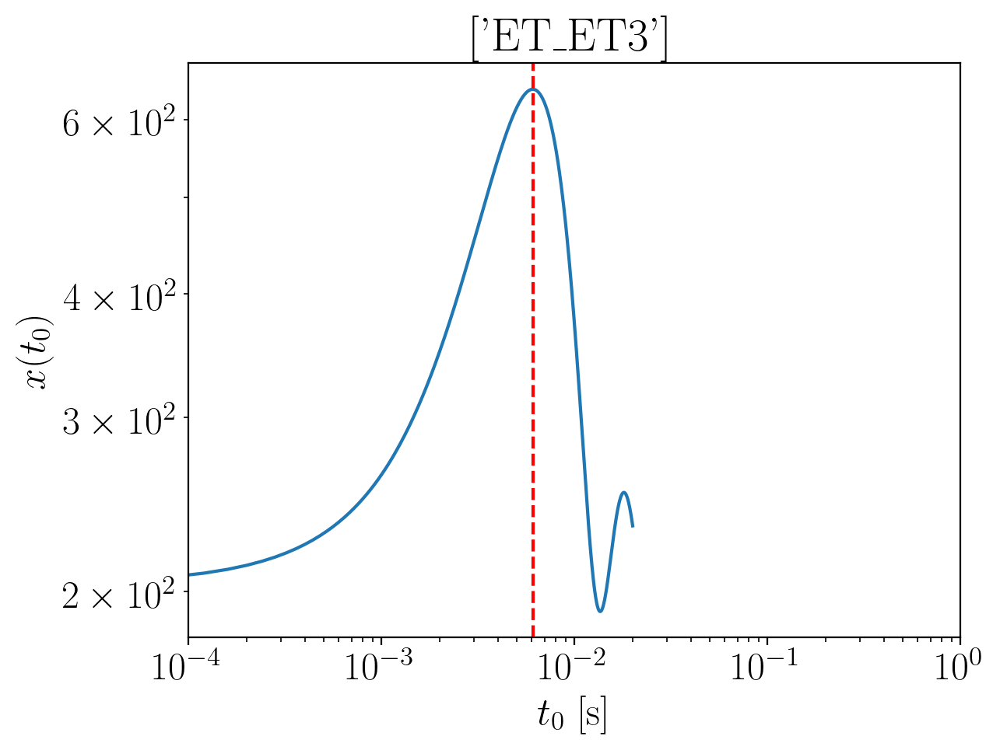

2024-01-15 16:05:07,416 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:07,433 - Network - INFO : PSDs loaded.
2024-01-15 16:05:07,439 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:07,453 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:07,461 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:07,494 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:07,496 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:05:07,500 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1651509574713326
Inner product:
0.9996122478252939


2024-01-15 16:05:12,902 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:05:13,077 - Network - INFO : PSDs loaded.
2024-01-15 16:05:13,083 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:13,097 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:13,098 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:05:13,098 - Network - INFO :    CE-40_C
2024-01-15 16:05:16,690 - Network - INFO :    CE-20_S
2024-01-15 16:05:20,257 - Network - INFO :    ET_ET1
2024-01-15 16:05:23,906 - Network - INFO :    ET_ET2
2024-01-15 16:05:27,802 - Network - INFO :    ET_ET3
2024-01-15 16:05:31,517 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:05:31,523 - Network - INFO : SNRs calculated.
2024-01-15 16:05:31,523 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:05:31,524 - Network - INFO :    CE-40_C
2024-01-15 16:05:31,618 - Network - INFO :

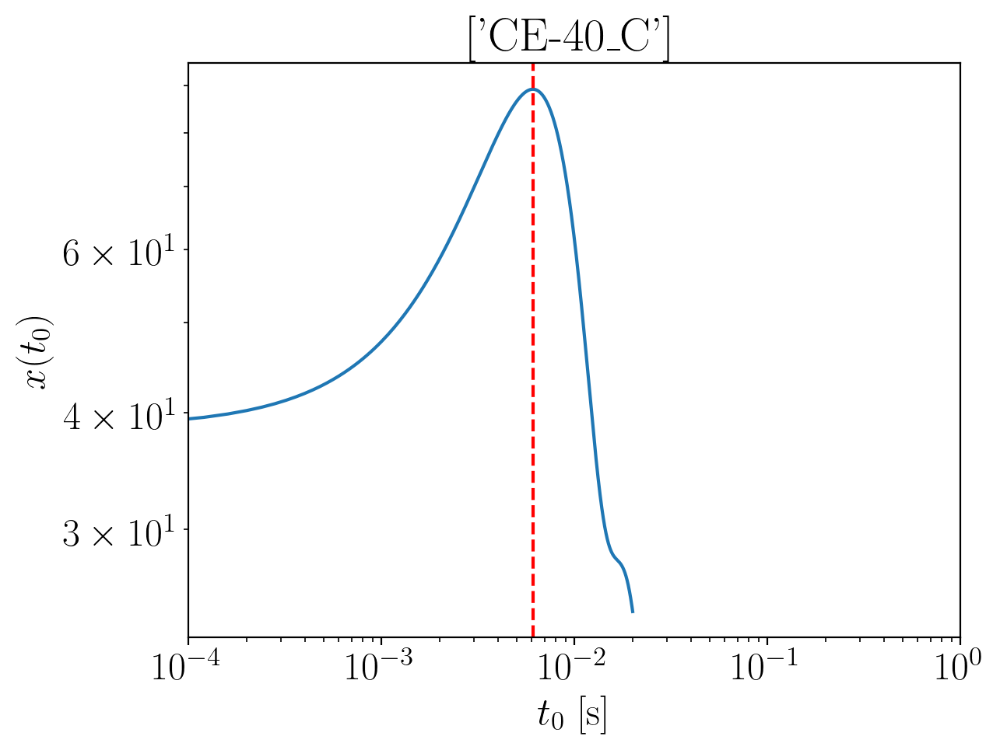

2024-01-15 16:05:33,337 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:33,343 - Network - INFO : PSDs loaded.
2024-01-15 16:05:33,345 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:33,350 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:33,355 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1625674704583466
Inner product:
0.9995867452129219


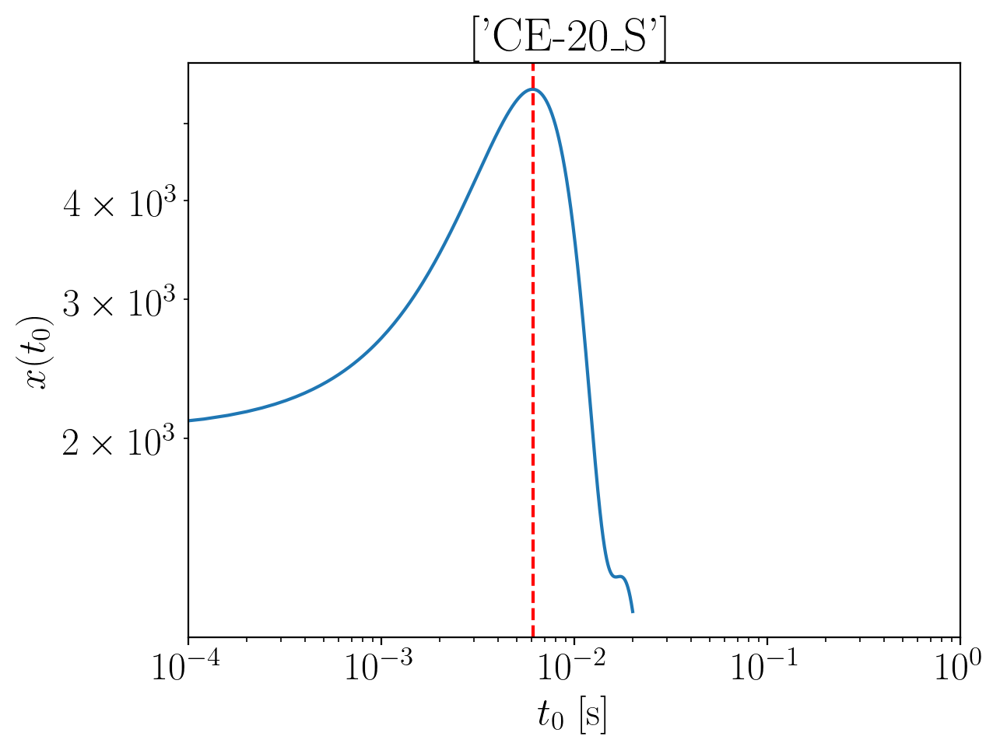

2024-01-15 16:05:34,715 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:34,726 - Network - INFO : PSDs loaded.
2024-01-15 16:05:34,730 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:34,740 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:34,755 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1643070872905508
Inner product:
0.9995301914444016


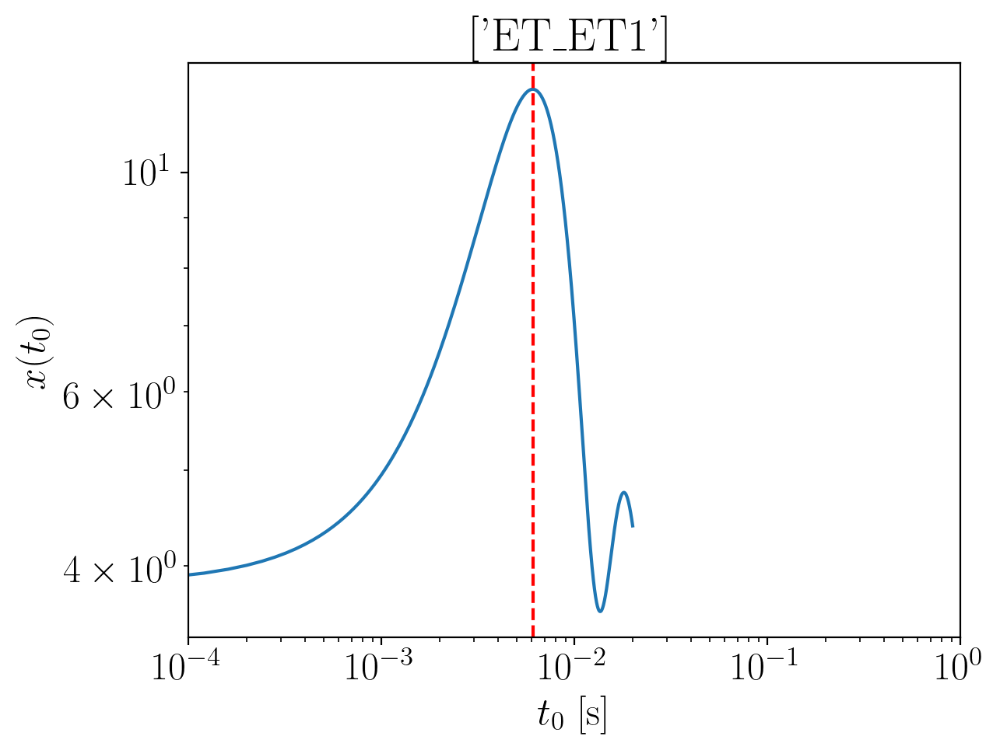

2024-01-15 16:05:37,048 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:37,061 - Network - INFO : PSDs loaded.
2024-01-15 16:05:37,063 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:37,068 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:37,073 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.151142518672934
Inner product:
0.9996122478252938


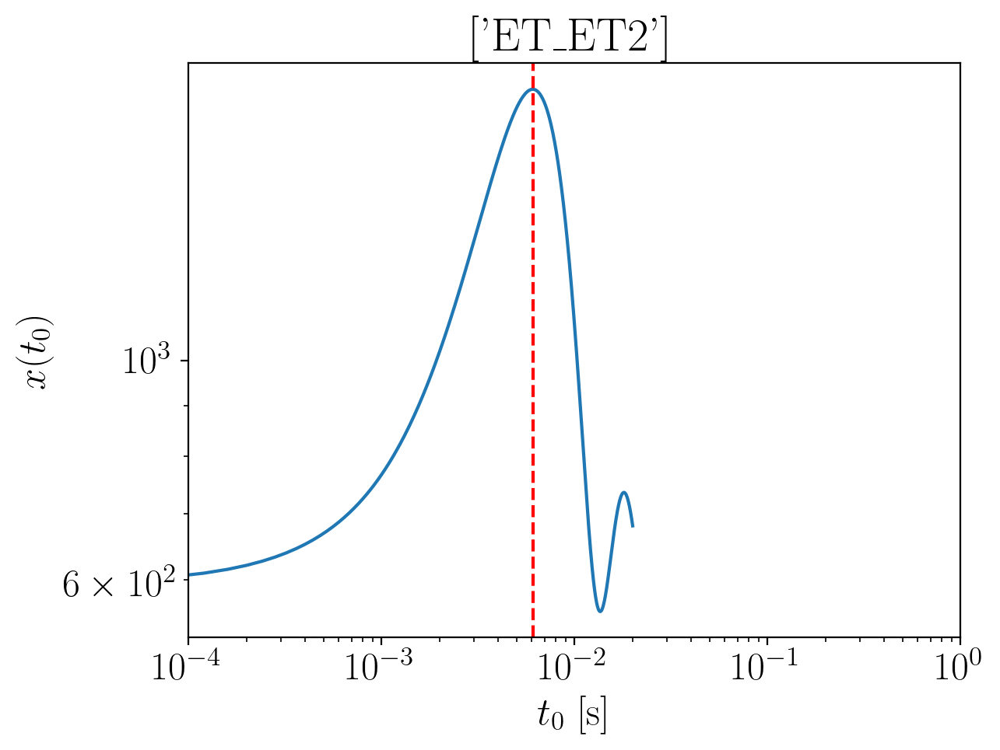

2024-01-15 16:05:38,836 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:38,851 - Network - INFO : PSDs loaded.
2024-01-15 16:05:38,853 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:38,859 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:38,890 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.151142518672934
Inner product:
0.9996122478252939


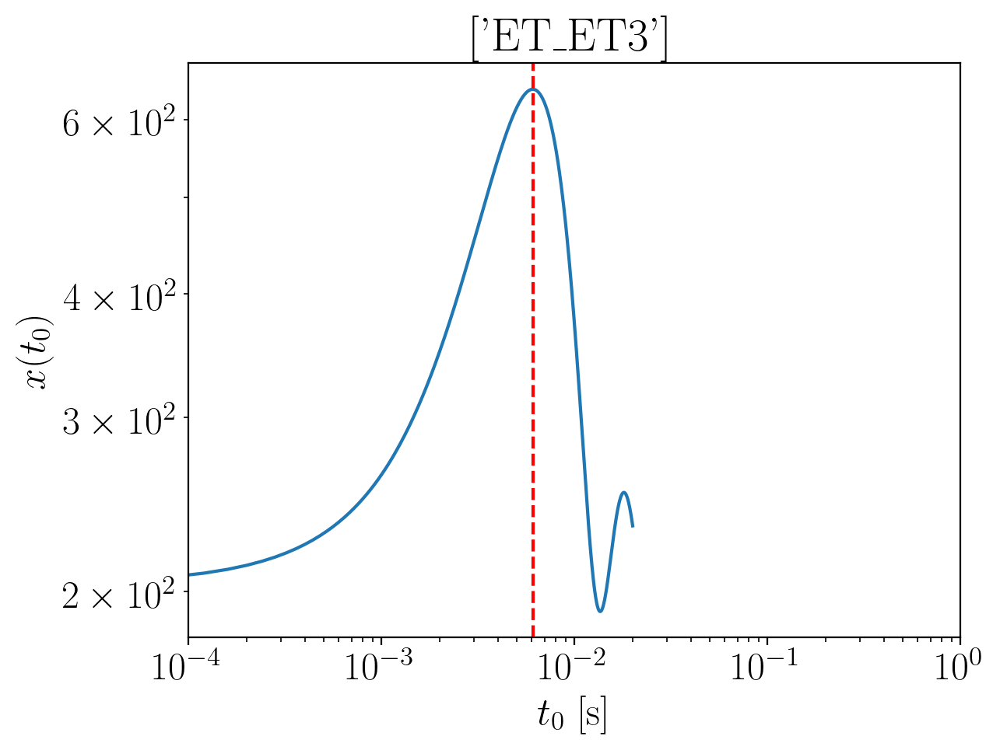

2024-01-15 16:05:40,661 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:40,677 - Network - INFO : PSDs loaded.
2024-01-15 16:05:40,680 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:40,686 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:40,691 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:40,742 - Network - INFO : Polarizations calculated.
2024-01-15 16:05:40,743 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:05:40,749 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.151142518672934
Inner product:
0.9996122478252936


2024-01-15 16:05:46,575 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:05:46,622 - Network - INFO : PSDs loaded.
2024-01-15 16:05:46,628 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:05:46,644 - Network - INFO : Detector responses calculated.
2024-01-15 16:05:46,645 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:05:46,646 - Network - INFO :    CE-40_C
2024-01-15 16:05:50,210 - Network - INFO :    CE-20_S
2024-01-15 16:05:53,808 - Network - INFO :    ET_ET1
2024-01-15 16:05:57,362 - Network - INFO :    ET_ET2
2024-01-15 16:06:00,931 - Network - INFO :    ET_ET3
2024-01-15 16:06:04,499 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:06:04,505 - Network - INFO : SNRs calculated.
2024-01-15 16:06:04,506 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:06:04,506 - Network - INFO :    CE-40_C
2024-01-15 16:06:04,600 - Network - INFO :

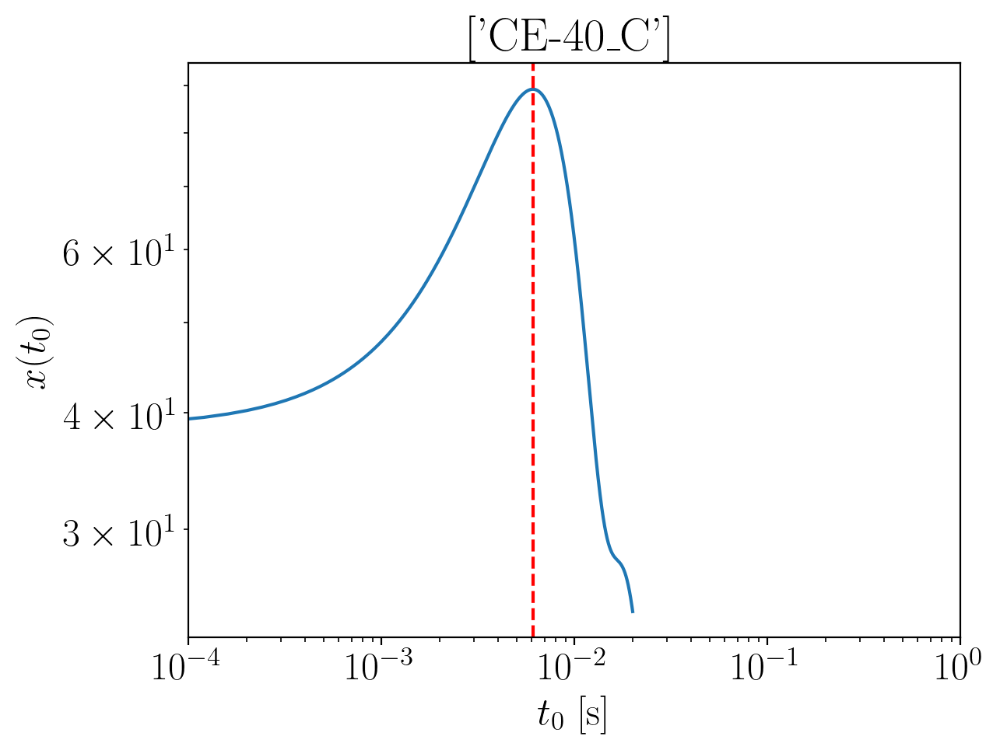

2024-01-15 16:06:06,360 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:06,366 - Network - INFO : PSDs loaded.
2024-01-15 16:06:06,368 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:06,373 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:06,377 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.207851575313214
Inner product:
0.9995867452129221


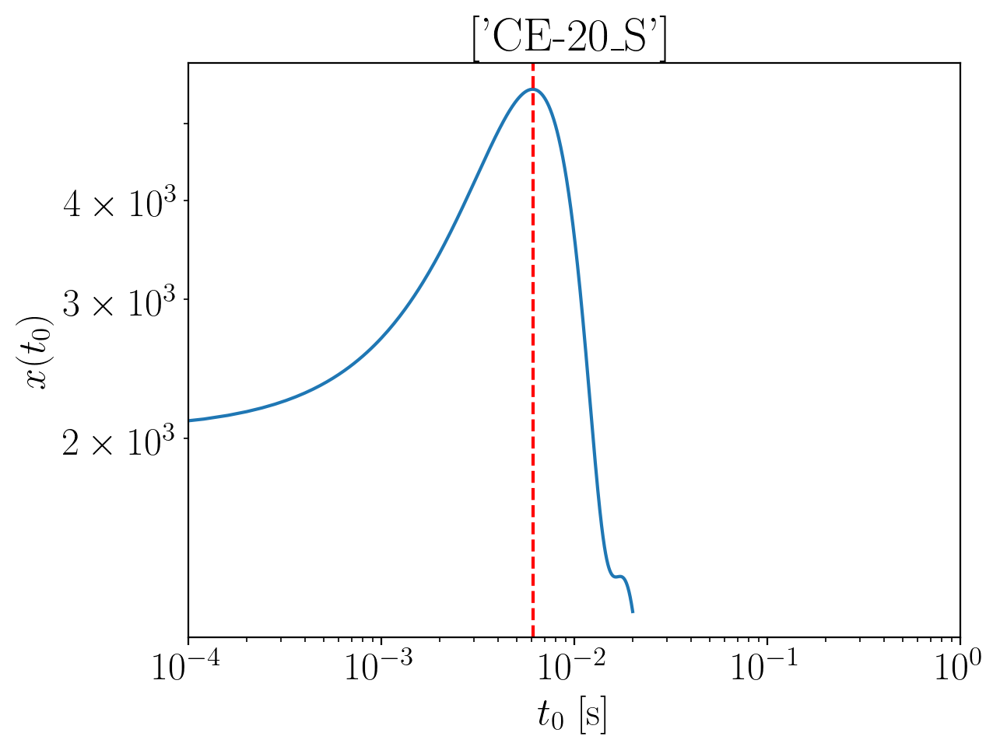

2024-01-15 16:06:07,748 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:07,754 - Network - INFO : PSDs loaded.
2024-01-15 16:06:07,756 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:07,761 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:07,765 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.209591192145419
Inner product:
0.9995301914444016


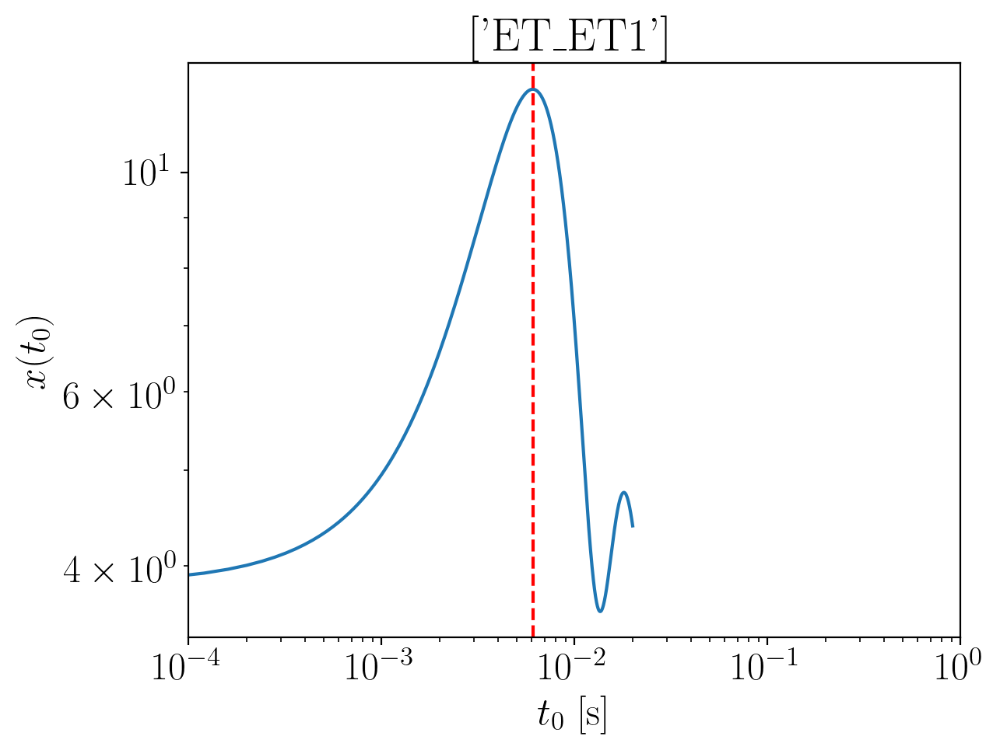

2024-01-15 16:06:09,314 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:09,328 - Network - INFO : PSDs loaded.
2024-01-15 16:06:09,331 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:09,336 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:09,341 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1964266235277963
Inner product:
0.9996122478252938


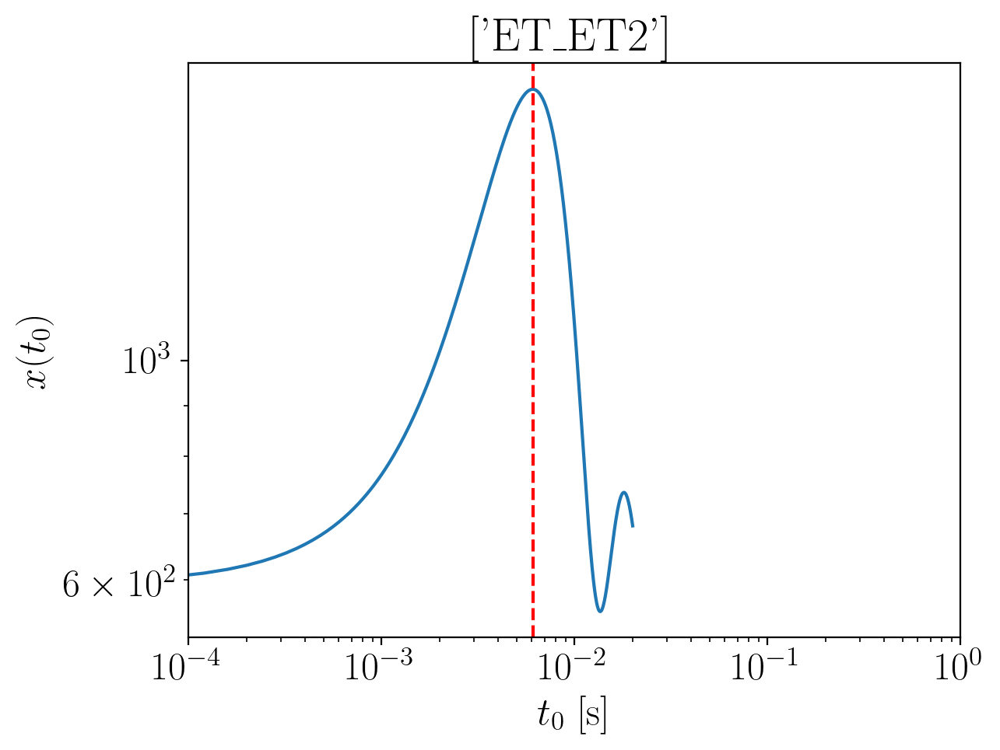

2024-01-15 16:06:10,838 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:10,853 - Network - INFO : PSDs loaded.
2024-01-15 16:06:10,856 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:10,862 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:10,876 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1964266235277963
Inner product:
0.9996122478252941


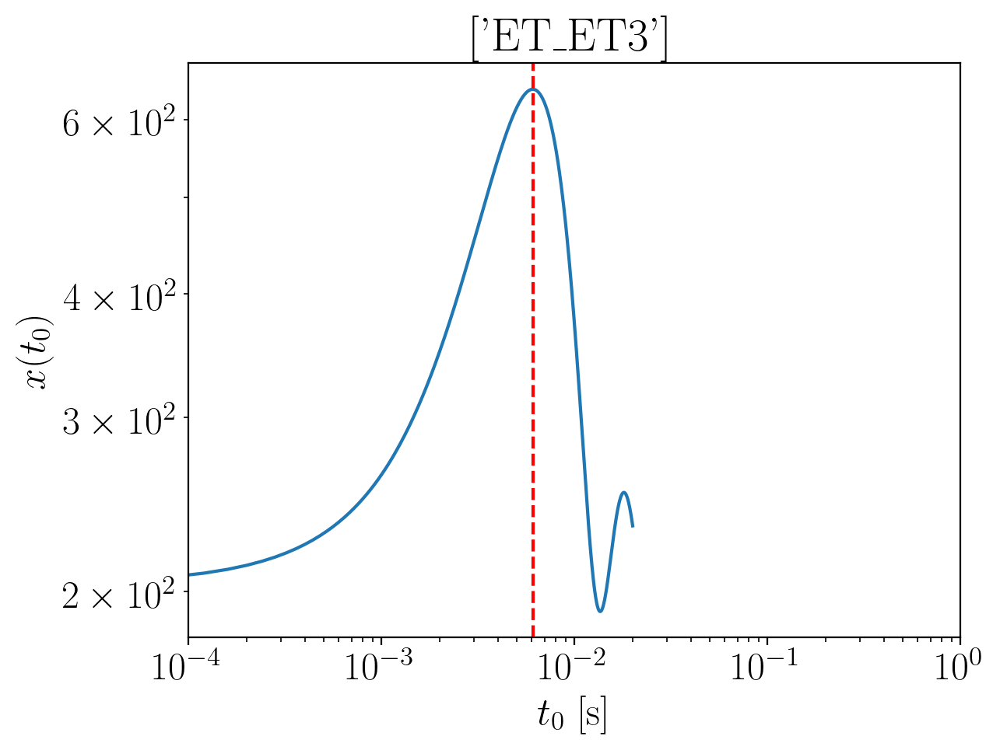

2024-01-15 16:06:12,354 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:12,367 - Network - INFO : PSDs loaded.
2024-01-15 16:06:12,369 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:12,375 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:12,379 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:12,420 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:12,422 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:06:12,433 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1964266235277963
Inner product:
0.9996122478252936


2024-01-15 16:06:17,866 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:06:17,915 - Network - INFO : PSDs loaded.
2024-01-15 16:06:17,938 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:17,974 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:17,975 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:06:17,976 - Network - INFO :    CE-40_C
2024-01-15 16:06:21,547 - Network - INFO :    CE-20_S
2024-01-15 16:06:25,137 - Network - INFO :    ET_ET1
2024-01-15 16:06:28,694 - Network - INFO :    ET_ET2
2024-01-15 16:06:32,247 - Network - INFO :    ET_ET3
2024-01-15 16:06:35,805 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:06:35,811 - Network - INFO : SNRs calculated.
2024-01-15 16:06:35,812 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:06:35,813 - Network - INFO :    CE-40_C
2024-01-15 16:06:35,909 - Network - INFO :

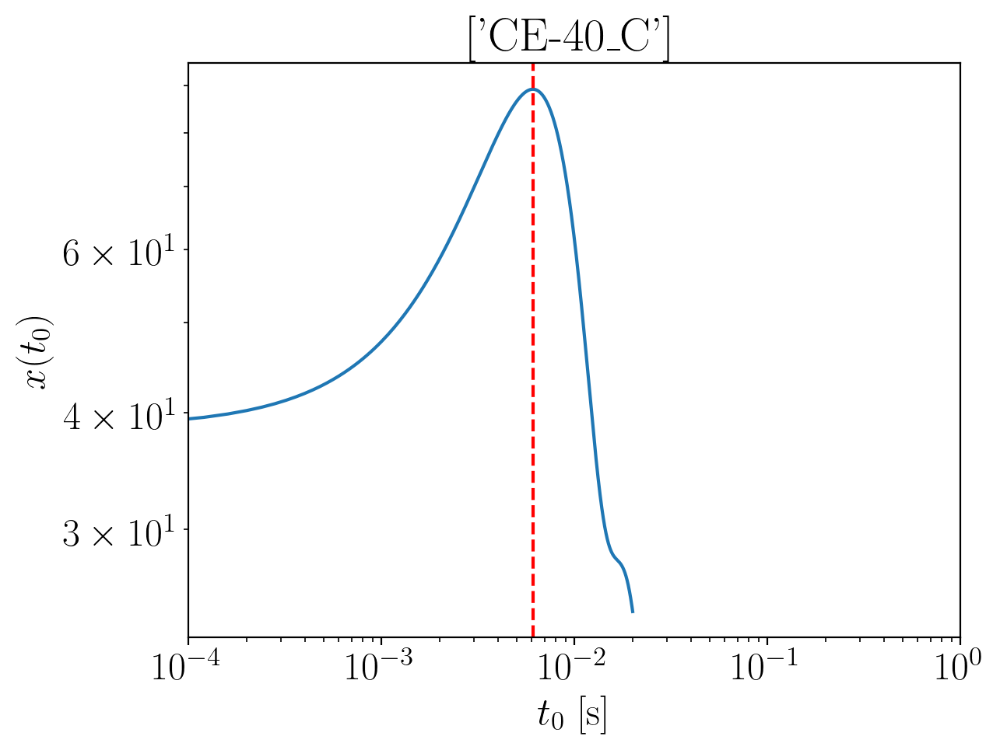

2024-01-15 16:06:37,594 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:37,600 - Network - INFO : PSDs loaded.
2024-01-15 16:06:37,602 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:37,606 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:37,611 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.213772257533556
Inner product:
0.9995867452129219


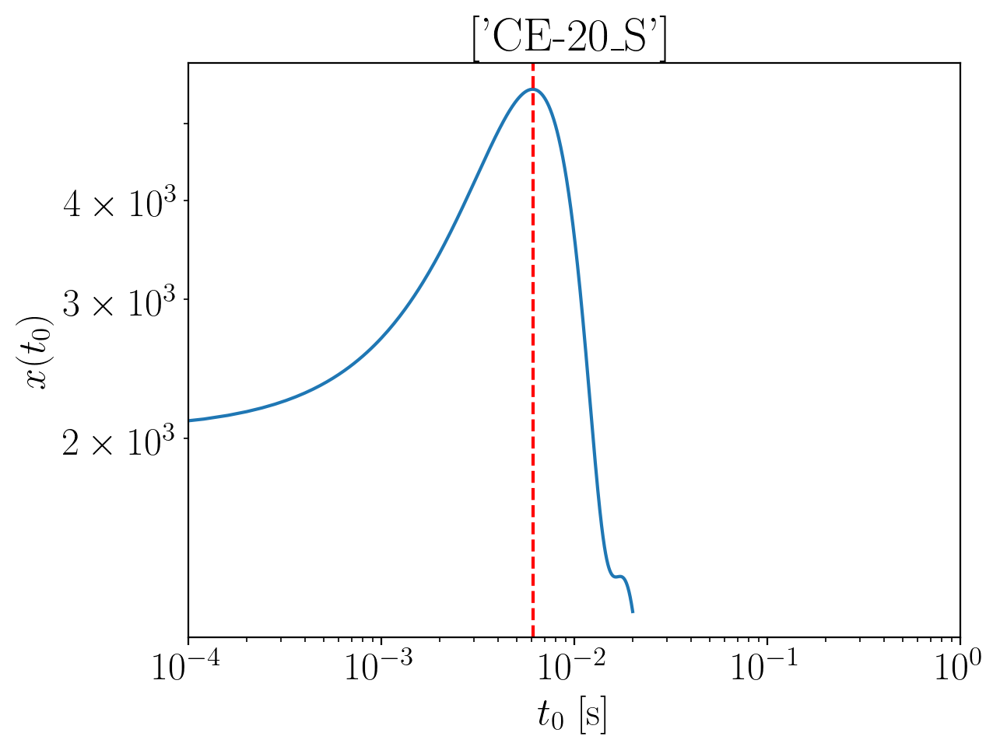

2024-01-15 16:06:38,792 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:38,799 - Network - INFO : PSDs loaded.
2024-01-15 16:06:38,801 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:38,805 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:38,810 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.2155118743657605
Inner product:
0.9995301914444016


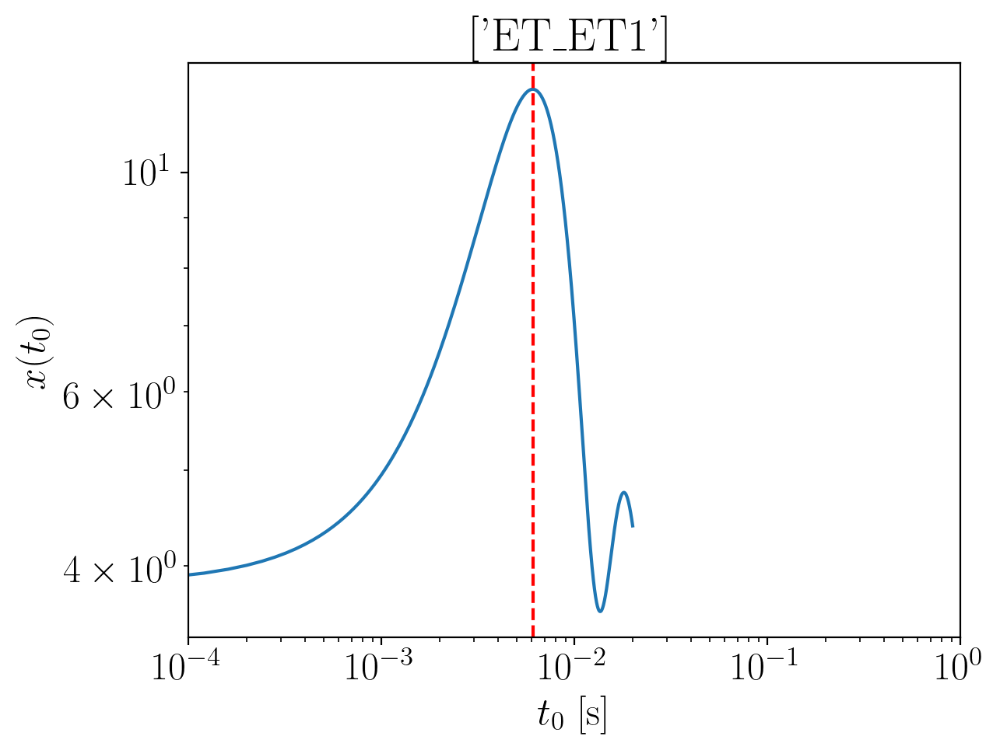

2024-01-15 16:06:40,265 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:40,281 - Network - INFO : PSDs loaded.
2024-01-15 16:06:40,284 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:40,292 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:40,299 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.2023473057481406
Inner product:
0.9996122478252939


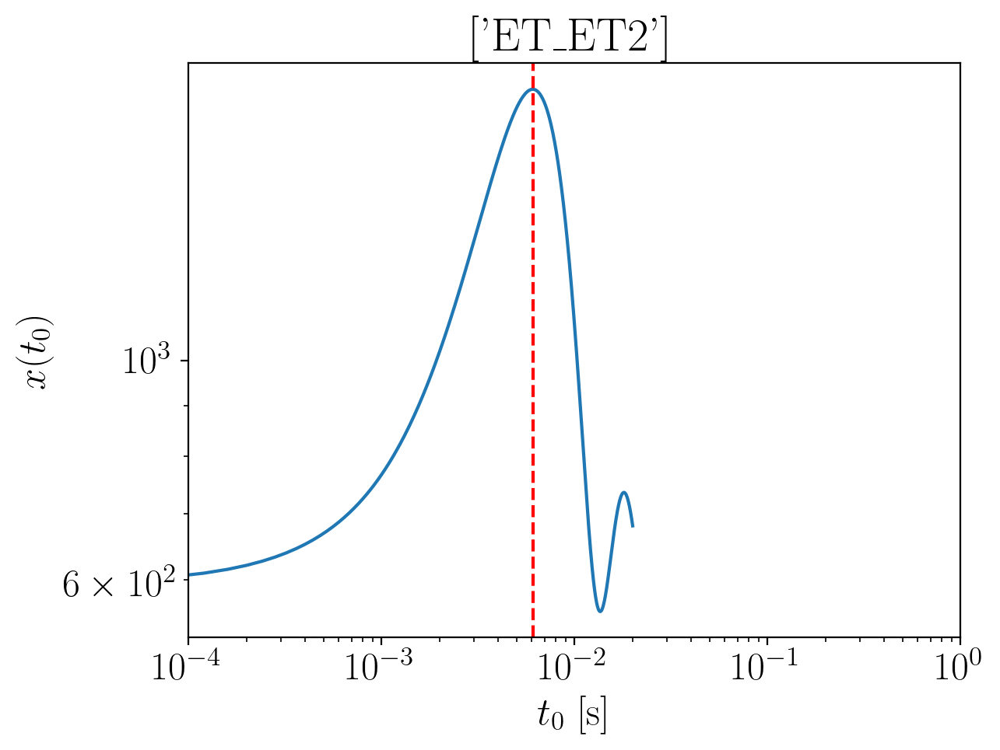

2024-01-15 16:06:41,727 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.2023473057481406


2024-01-15 16:06:41,971 - Network - INFO : PSDs loaded.
2024-01-15 16:06:41,972 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:41,980 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:41,985 - Network - INFO : Polarizations calculated.


Inner product:
0.9996122478252936


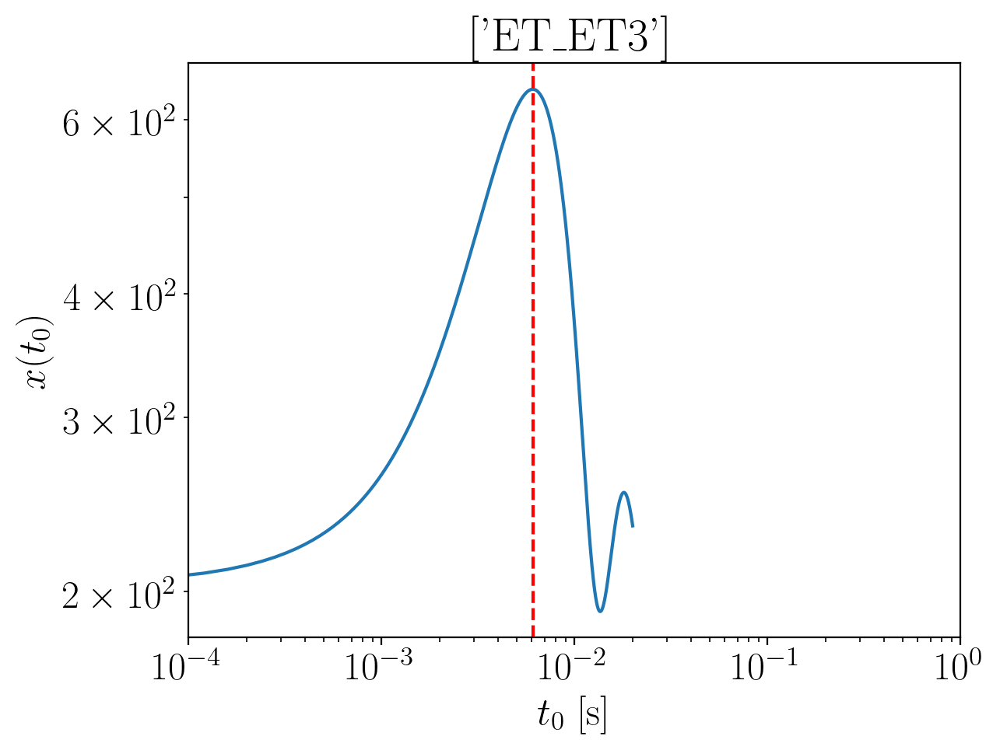

2024-01-15 16:06:43,350 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:43,364 - Network - INFO : PSDs loaded.
2024-01-15 16:06:43,367 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:43,372 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:43,377 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:43,401 - Network - INFO : Polarizations calculated.
2024-01-15 16:06:43,406 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:06:43,414 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.2023473057481406
Inner product:
0.9996122478252939


2024-01-15 16:06:48,864 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:06:48,909 - Network - INFO : PSDs loaded.
2024-01-15 16:06:48,914 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:06:48,972 - Network - INFO : Detector responses calculated.
2024-01-15 16:06:48,973 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:06:48,974 - Network - INFO :    CE-40_C
2024-01-15 16:06:52,575 - Network - INFO :    CE-20_S
2024-01-15 16:06:56,114 - Network - INFO :    ET_ET1
2024-01-15 16:06:59,694 - Network - INFO :    ET_ET2
2024-01-15 16:07:03,245 - Network - INFO :    ET_ET3
2024-01-15 16:07:06,794 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:07:06,801 - Network - INFO : SNRs calculated.
2024-01-15 16:07:06,801 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:07:06,801 - Network - INFO :    CE-40_C
2024-01-15 16:07:06,896 - Network - INFO :

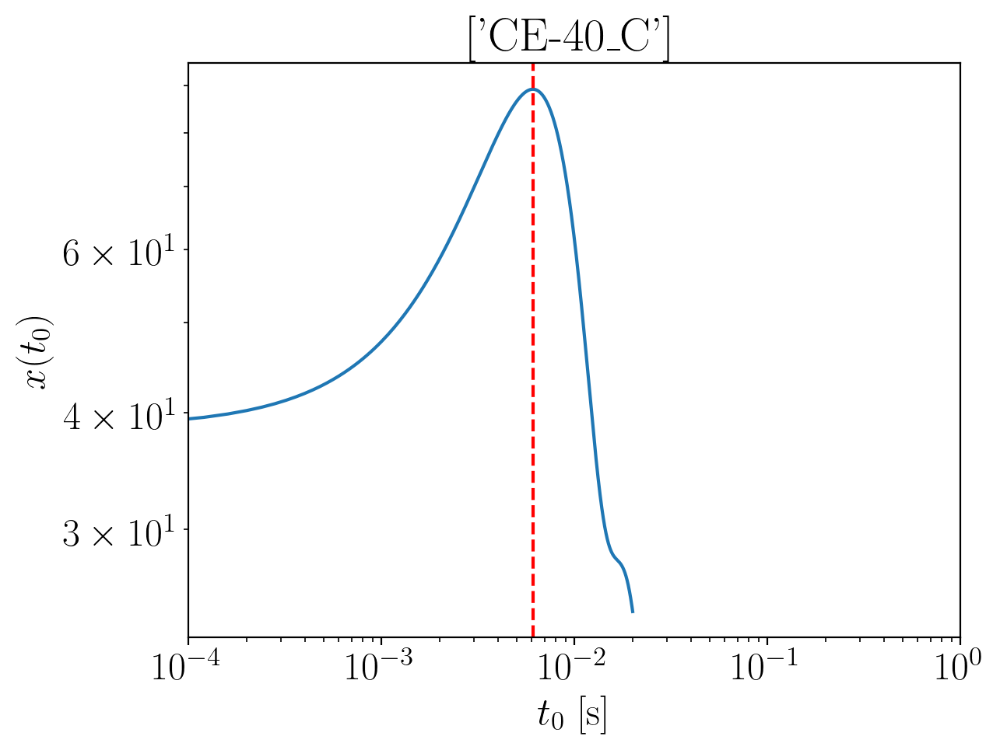

2024-01-15 16:07:08,631 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:08,637 - Network - INFO : PSDs loaded.
2024-01-15 16:07:08,639 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:08,645 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:08,649 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.200567813615236
Inner product:
0.9995867452129221


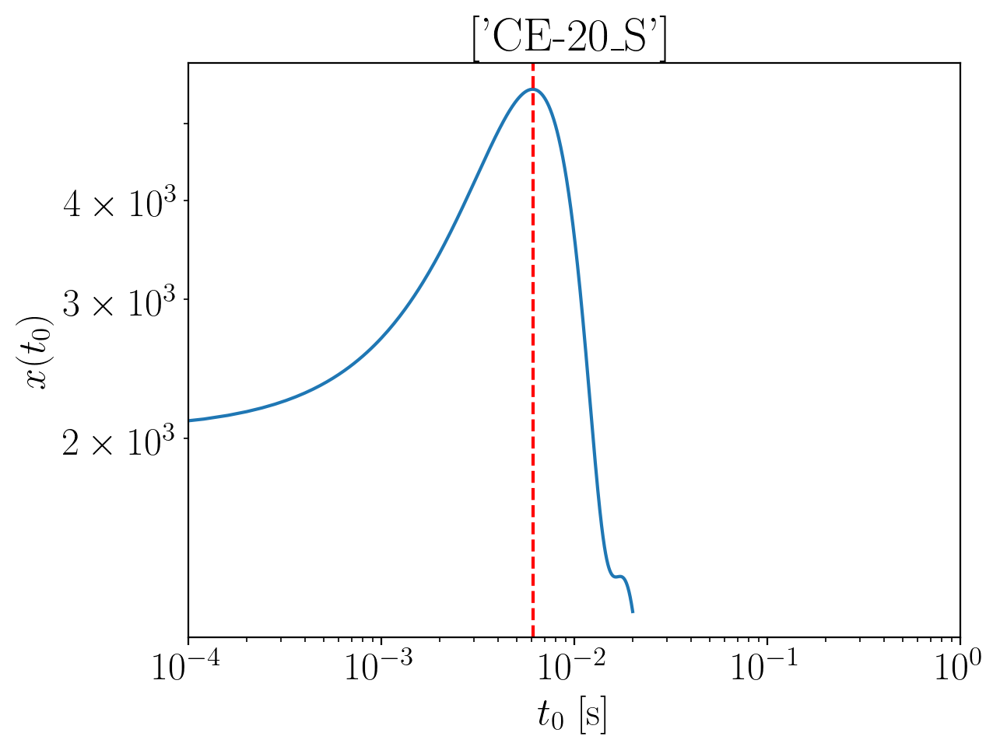

2024-01-15 16:07:09,863 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:09,870 - Network - INFO : PSDs loaded.
2024-01-15 16:07:09,873 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:09,878 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:09,883 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.202307430447441
Inner product:
0.9995301914444014


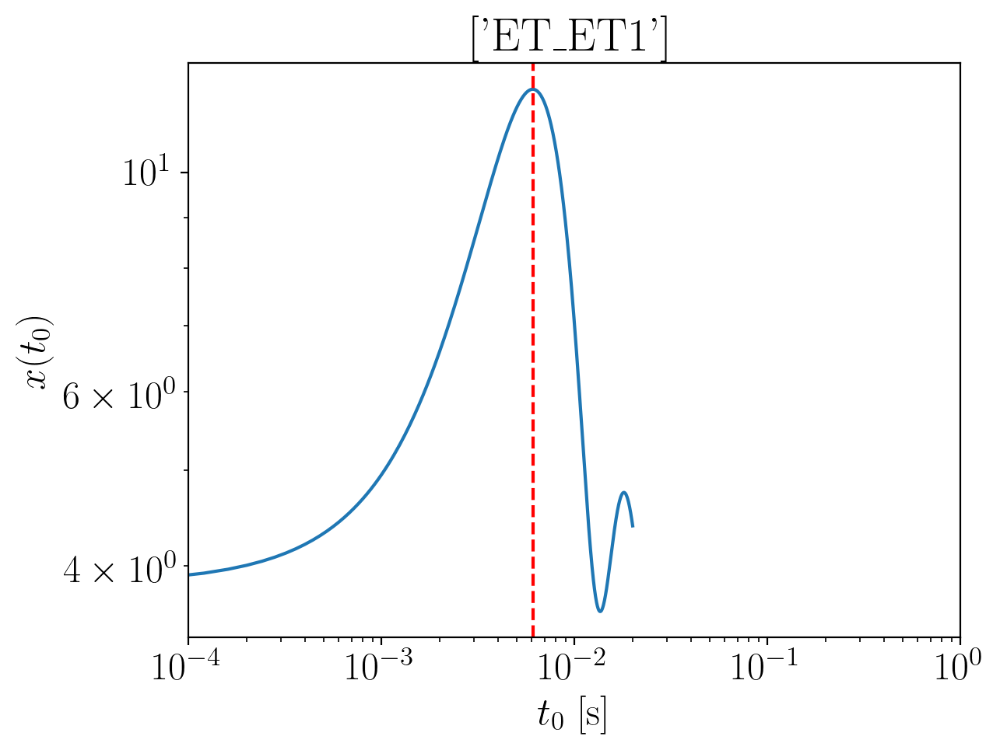

2024-01-15 16:07:11,273 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:11,287 - Network - INFO : PSDs loaded.
2024-01-15 16:07:11,289 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:11,297 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:11,309 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1891428618298203
Inner product:
0.9996122478252938


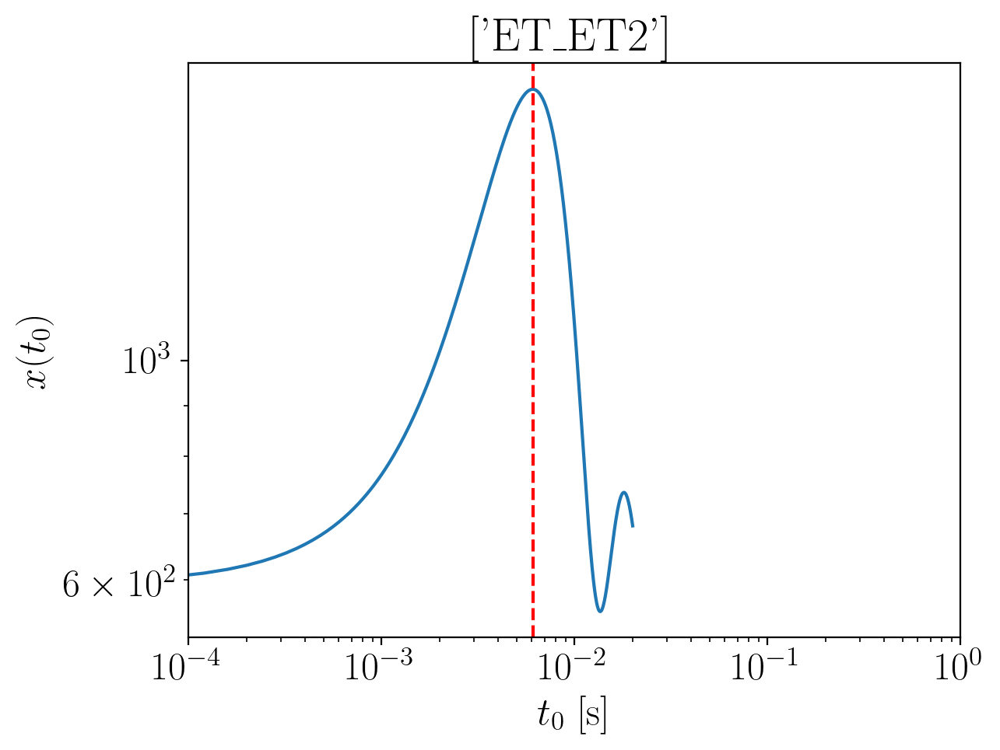

2024-01-15 16:07:12,764 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:12,778 - Network - INFO : PSDs loaded.
2024-01-15 16:07:12,780 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:12,785 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:12,789 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1891428618298203
Inner product:
0.9996122478252939


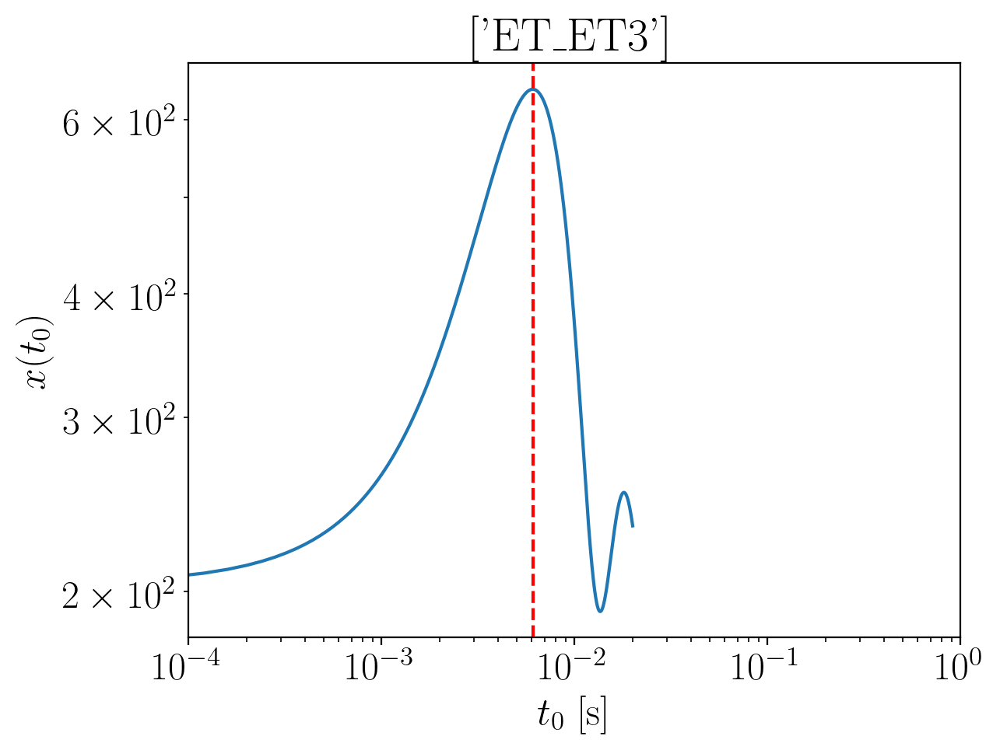

2024-01-15 16:07:14,193 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:14,213 - Network - INFO : PSDs loaded.
2024-01-15 16:07:14,222 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:14,239 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:14,244 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:14,273 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:14,273 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:07:14,278 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1891428618298203
Inner product:
0.999612247825294


2024-01-15 16:07:19,990 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:07:20,037 - Network - INFO : PSDs loaded.
2024-01-15 16:07:20,043 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:20,058 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:20,058 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:07:20,059 - Network - INFO :    CE-40_C
2024-01-15 16:07:23,653 - Network - INFO :    CE-20_S
2024-01-15 16:07:27,193 - Network - INFO :    ET_ET1
2024-01-15 16:07:30,749 - Network - INFO :    ET_ET2
2024-01-15 16:07:34,332 - Network - INFO :    ET_ET3
2024-01-15 16:07:37,875 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:07:37,882 - Network - INFO : SNRs calculated.
2024-01-15 16:07:37,883 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:07:37,883 - Network - INFO :    CE-40_C
2024-01-15 16:07:37,978 - Network - INFO :

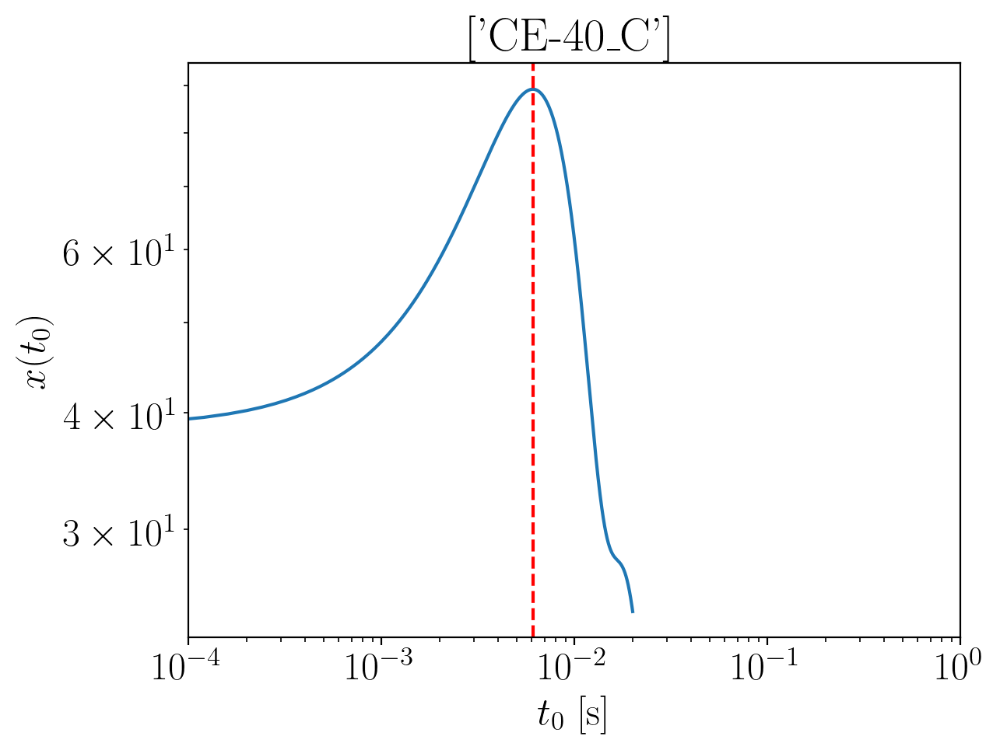

2024-01-15 16:07:39,838 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:39,845 - Network - INFO : PSDs loaded.
2024-01-15 16:07:39,849 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:39,856 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:39,862 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1765759092567474
Inner product:
0.9995867452129221


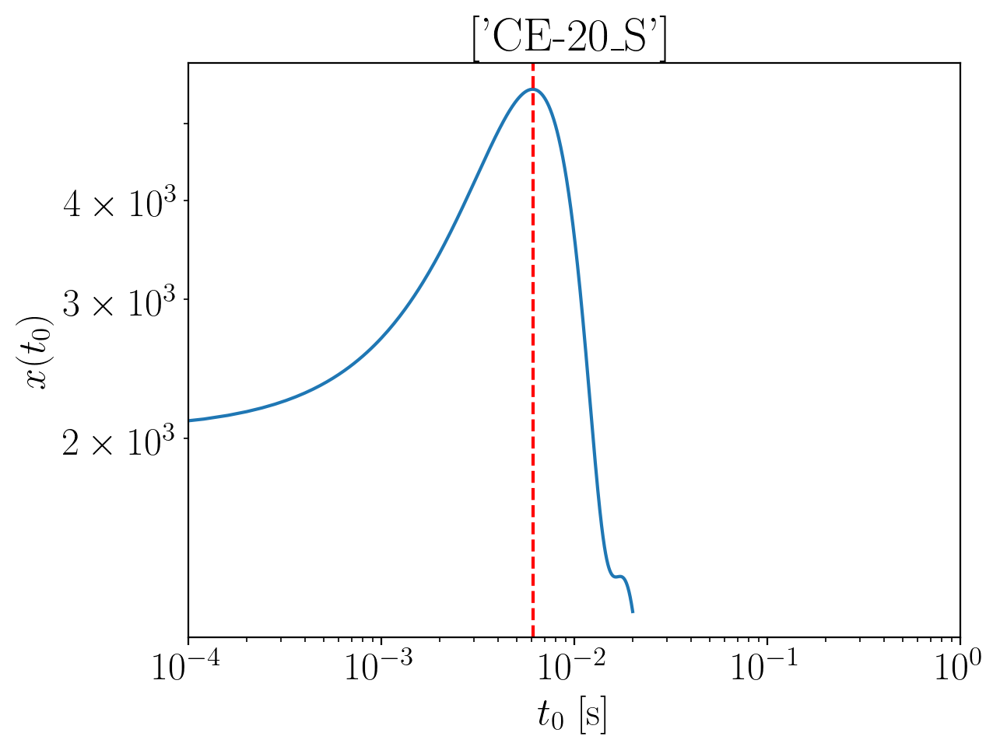

2024-01-15 16:07:41,032 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:41,039 - Network - INFO : PSDs loaded.
2024-01-15 16:07:41,040 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:41,045 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:41,050 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1783155260889524
Inner product:
0.9995301914444016


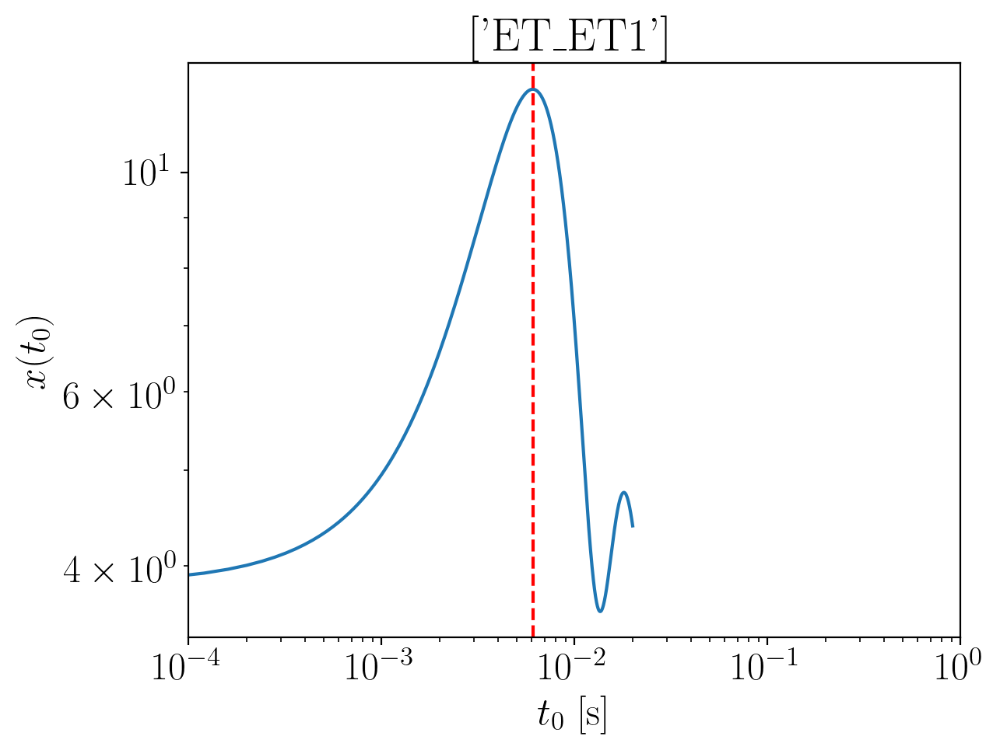

2024-01-15 16:07:42,428 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:42,441 - Network - INFO : PSDs loaded.
2024-01-15 16:07:42,443 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:42,448 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:42,453 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1651509574713326
Inner product:
0.9996122478252939


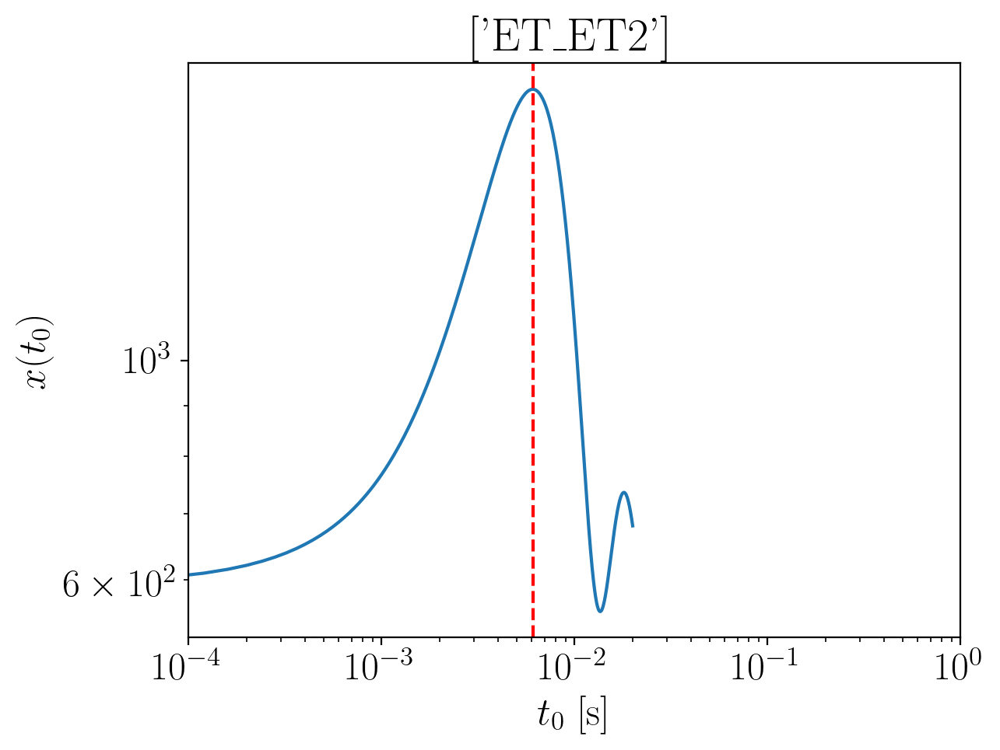

2024-01-15 16:07:43,877 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:43,897 - Network - INFO : PSDs loaded.
2024-01-15 16:07:43,906 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:43,916 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:43,935 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1651509574713326
Inner product:
0.9996122478252939


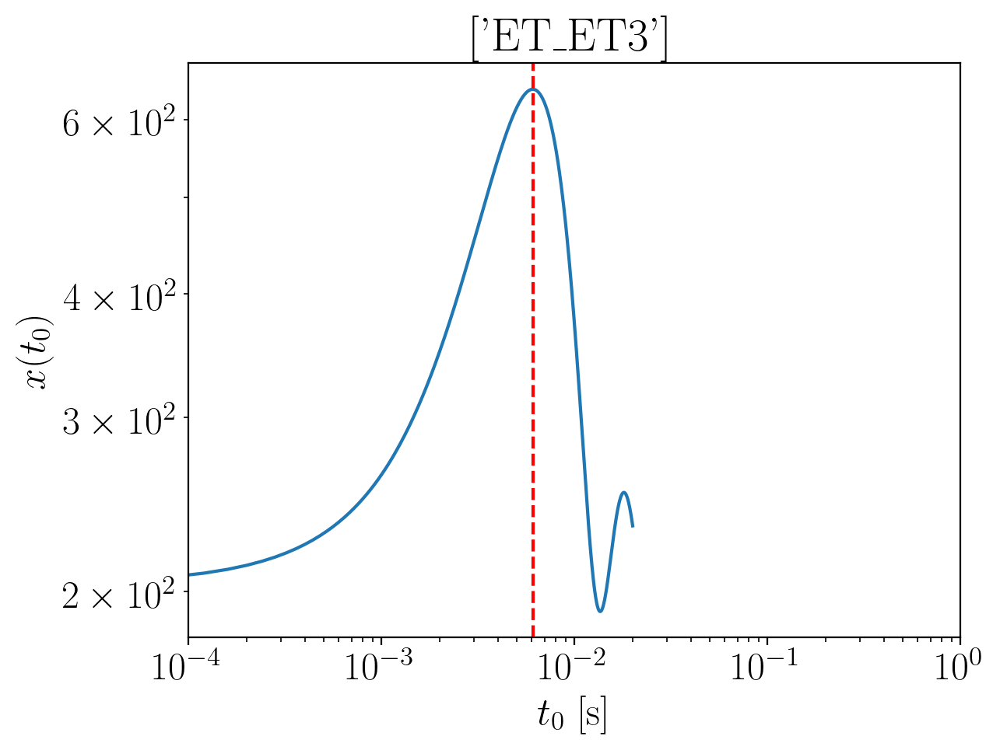

2024-01-15 16:07:45,346 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:45,368 - Network - INFO : PSDs loaded.
2024-01-15 16:07:45,370 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:45,375 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:45,384 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:45,416 - Network - INFO : Polarizations calculated.
2024-01-15 16:07:45,417 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:07:45,420 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1651509574713326
Inner product:
0.9996122478252939


2024-01-15 16:07:50,782 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:07:50,826 - Network - INFO : PSDs loaded.
2024-01-15 16:07:50,842 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:07:50,880 - Network - INFO : Detector responses calculated.
2024-01-15 16:07:50,881 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:07:50,882 - Network - INFO :    CE-40_C
2024-01-15 16:07:54,457 - Network - INFO :    CE-20_S
2024-01-15 16:07:58,015 - Network - INFO :    ET_ET1
2024-01-15 16:08:01,581 - Network - INFO :    ET_ET2
2024-01-15 16:08:05,158 - Network - INFO :    ET_ET3
2024-01-15 16:08:08,741 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:08:08,747 - Network - INFO : SNRs calculated.
2024-01-15 16:08:08,748 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:08:08,749 - Network - INFO :    CE-40_C
2024-01-15 16:08:08,844 - Network - INFO :

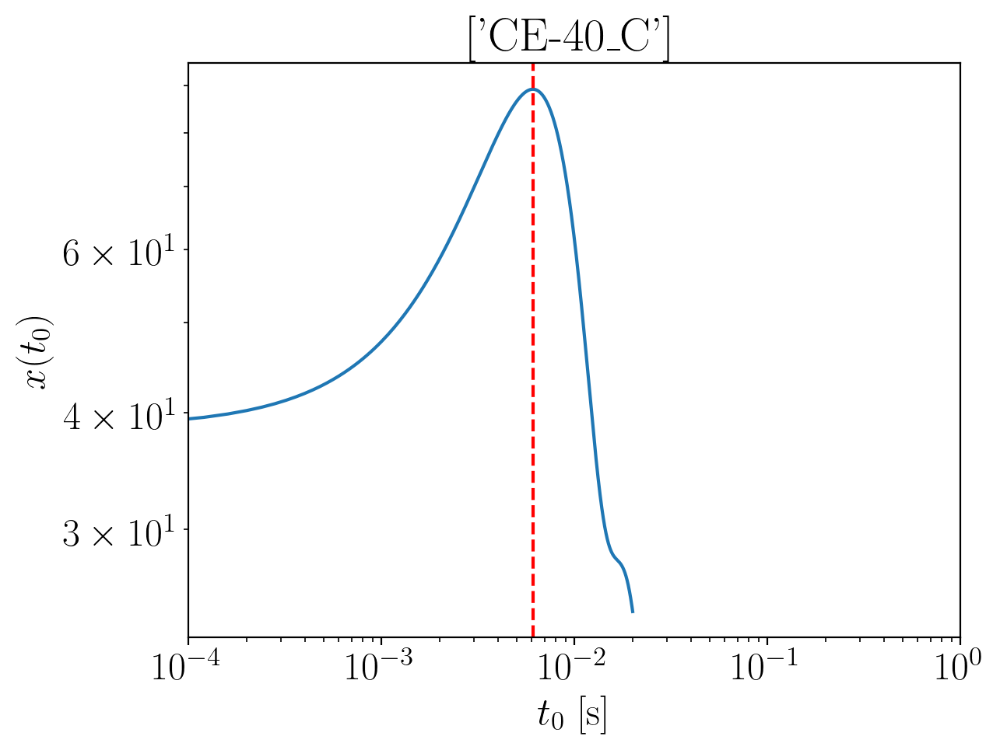

2024-01-15 16:08:10,558 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:10,567 - Network - INFO : PSDs loaded.
2024-01-15 16:08:10,569 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:10,577 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:10,585 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1460790395678258
Inner product:
0.9995867452129221


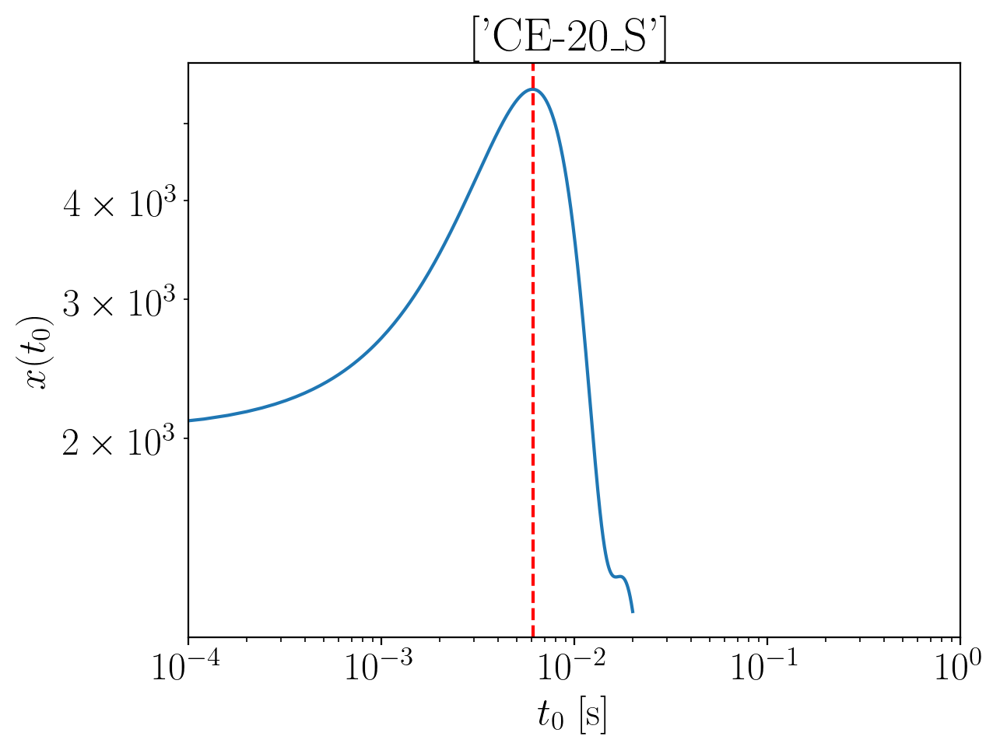

2024-01-15 16:08:11,959 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:11,965 - Network - INFO : PSDs loaded.
2024-01-15 16:08:11,967 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:11,972 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:11,977 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.147818656400031
Inner product:
0.9995301914444016


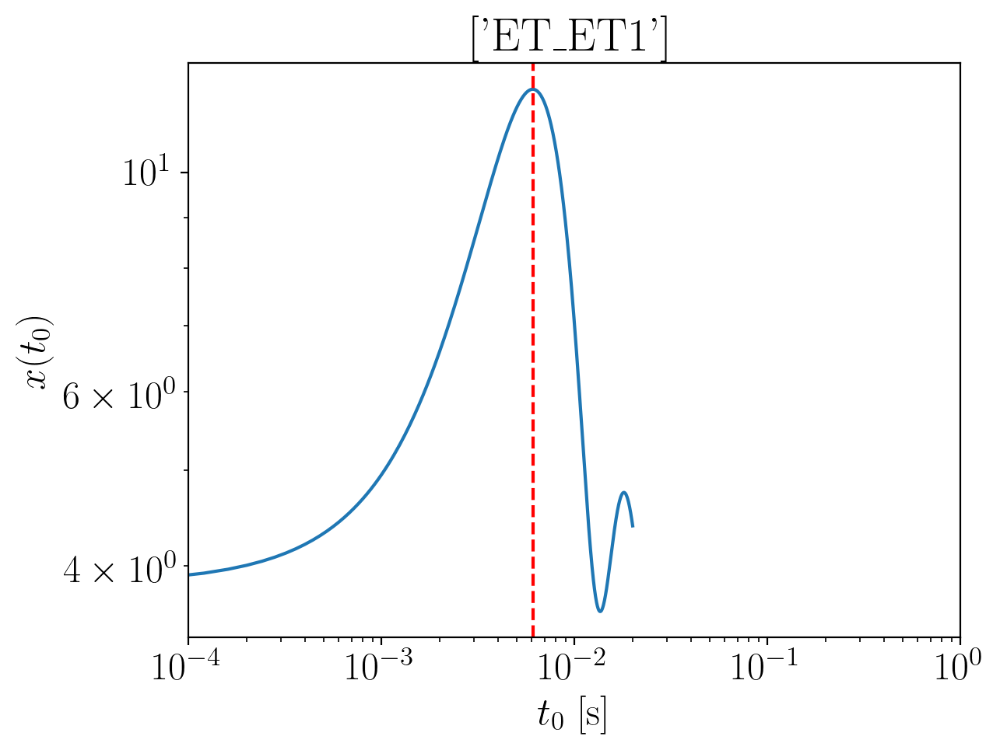

2024-01-15 16:08:13,519 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:13,541 - Network - INFO : PSDs loaded.
2024-01-15 16:08:13,551 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:13,566 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:13,576 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1346540877824105
Inner product:
0.9996122478252938


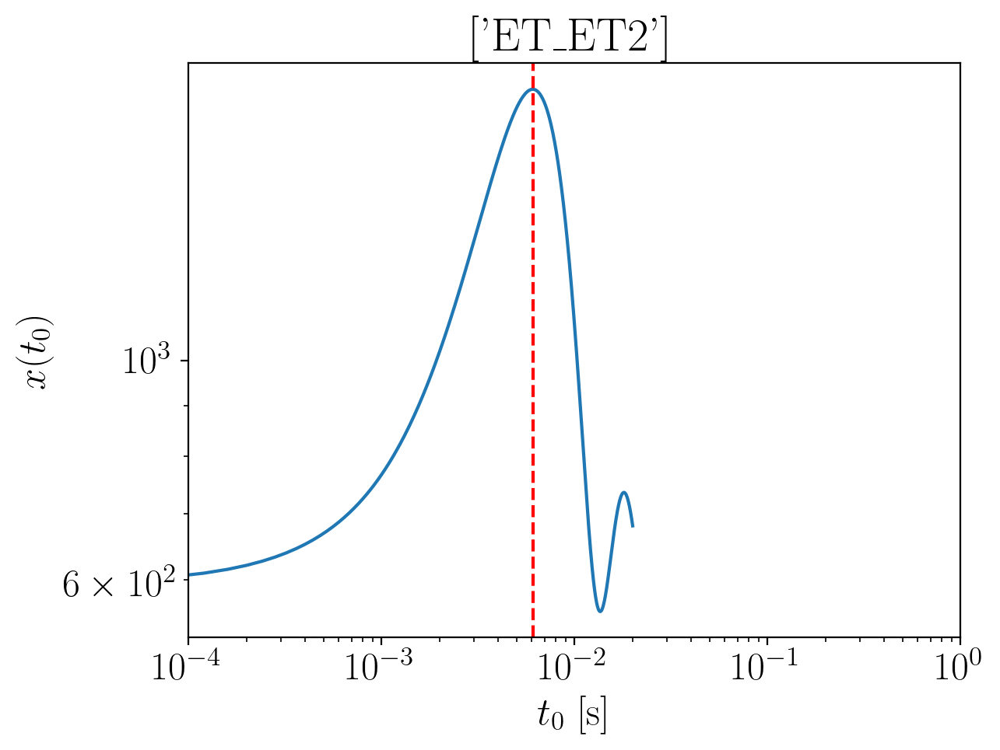

2024-01-15 16:08:15,013 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:15,036 - Network - INFO : PSDs loaded.
2024-01-15 16:08:15,038 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:15,045 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:15,053 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1346540877824105
Inner product:
0.9996122478252939


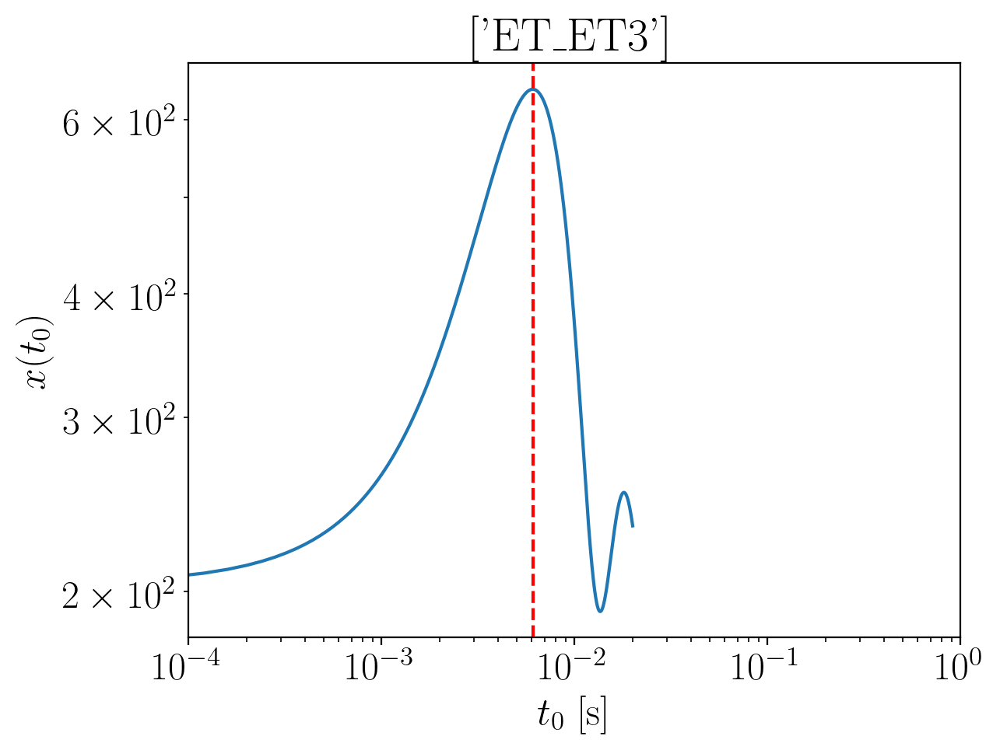

2024-01-15 16:08:16,486 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:16,503 - Network - INFO : PSDs loaded.
2024-01-15 16:08:16,506 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:16,512 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:16,520 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:16,558 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:16,559 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:08:16,571 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1346540877824105
Inner product:
0.999612247825294


2024-01-15 16:08:21,905 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:08:21,950 - Network - INFO : PSDs loaded.
2024-01-15 16:08:21,956 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:21,971 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:21,972 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:08:21,973 - Network - INFO :    CE-40_C
2024-01-15 16:08:25,513 - Network - INFO :    CE-20_S
2024-01-15 16:08:29,159 - Network - INFO :    ET_ET1
2024-01-15 16:08:32,746 - Network - INFO :    ET_ET2
2024-01-15 16:08:36,354 - Network - INFO :    ET_ET3
2024-01-15 16:08:39,945 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:08:39,951 - Network - INFO : SNRs calculated.
2024-01-15 16:08:39,951 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:08:39,952 - Network - INFO :    CE-40_C
2024-01-15 16:08:40,045 - Network - INFO :

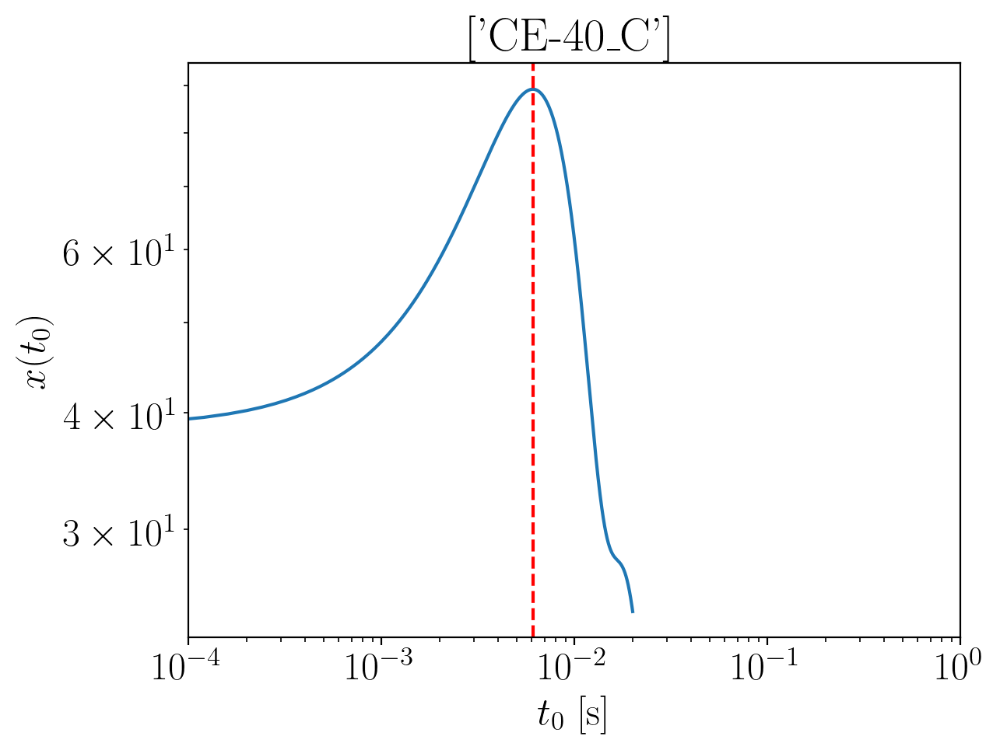

2024-01-15 16:08:41,972 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:41,995 - Network - INFO : PSDs loaded.
2024-01-15 16:08:41,997 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:42,004 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:42,011 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1115418630797955
Inner product:
0.9995867452129219


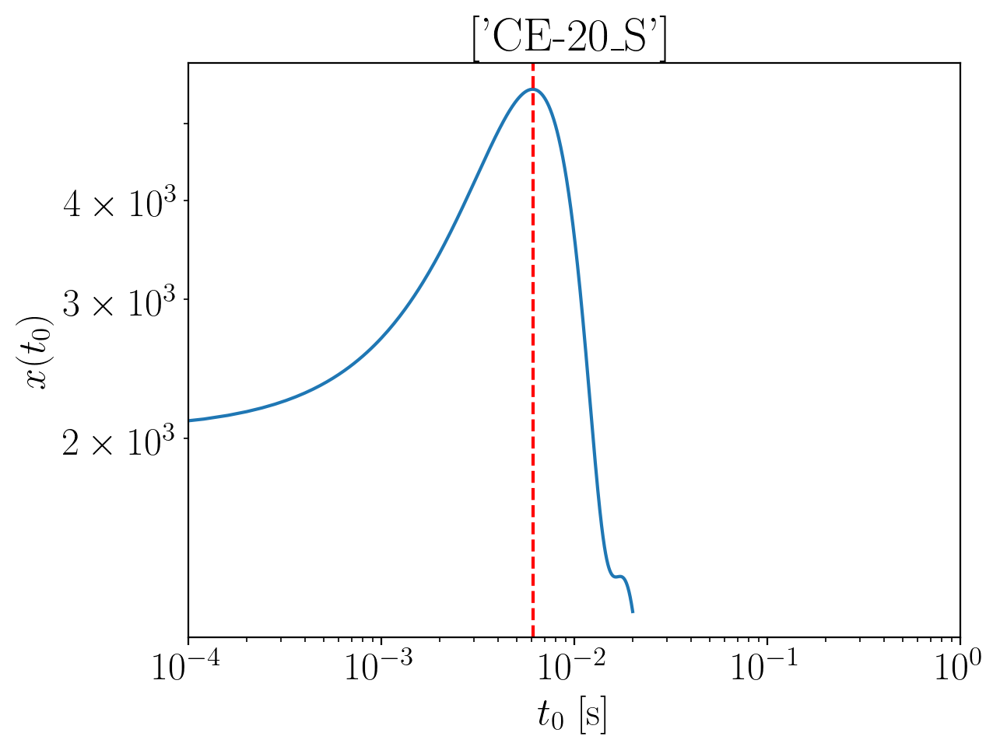

2024-01-15 16:08:43,405 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:43,413 - Network - INFO : PSDs loaded.
2024-01-15 16:08:43,415 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:43,420 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:43,425 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1132814799120005
Inner product:
0.9995301914444016


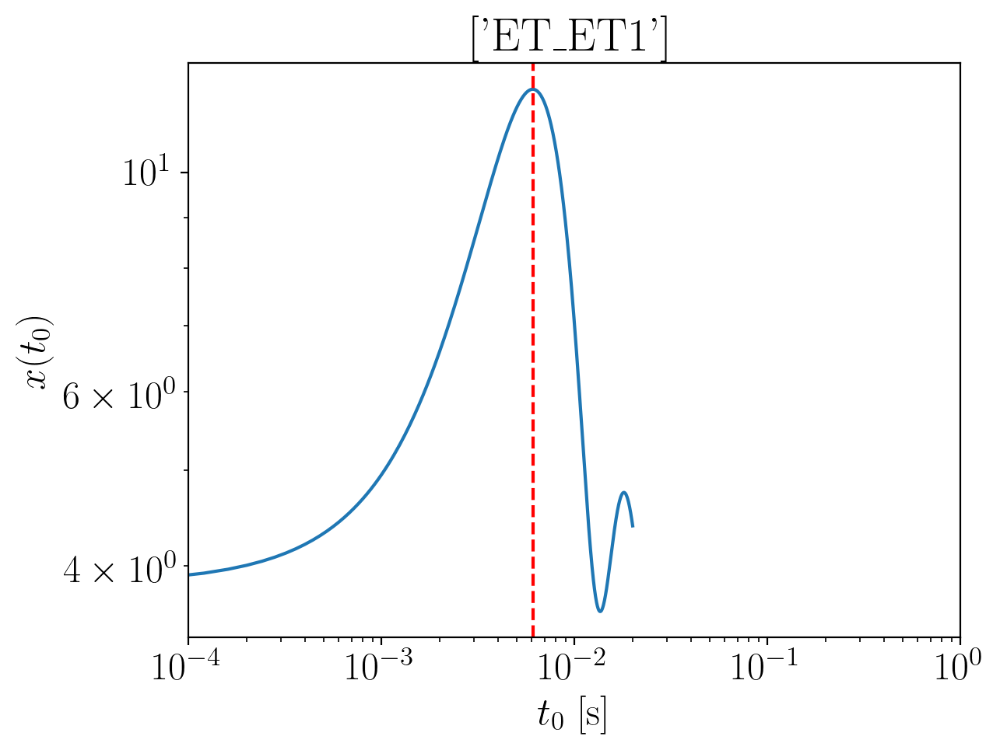

2024-01-15 16:08:45,216 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:45,236 - Network - INFO : PSDs loaded.
2024-01-15 16:08:45,238 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:45,245 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:45,252 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1001169112943803
Inner product:
0.999612247825294


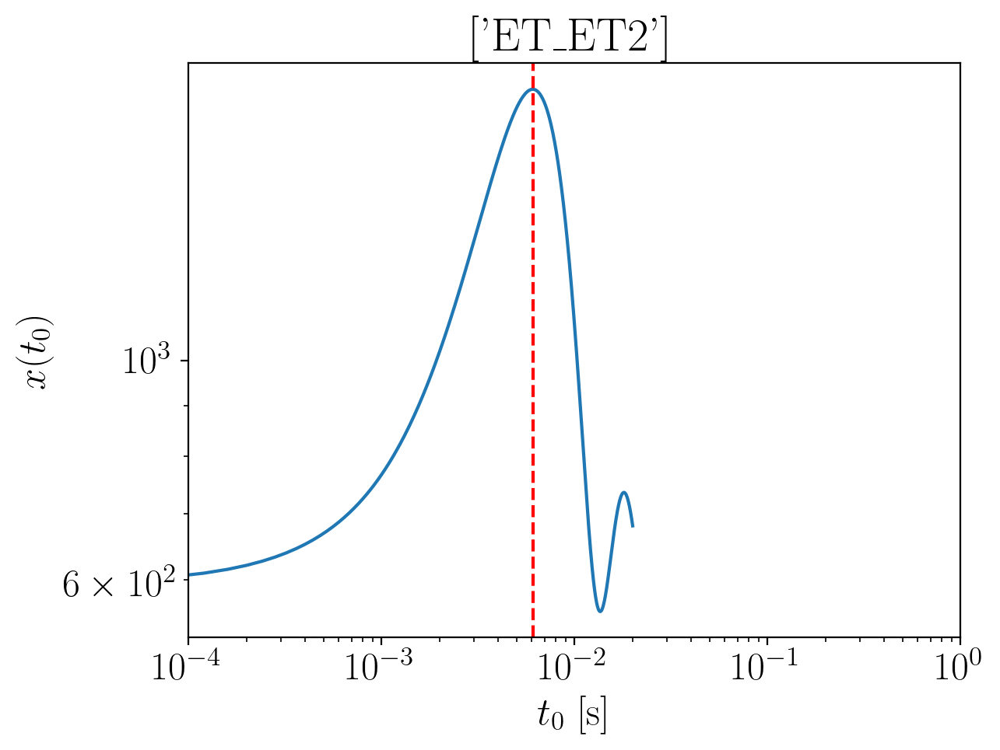

2024-01-15 16:08:46,898 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:47,062 - Network - INFO : PSDs loaded.
2024-01-15 16:08:47,065 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:47,072 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:47,080 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1001169112943803
Inner product:
0.9996122478252939


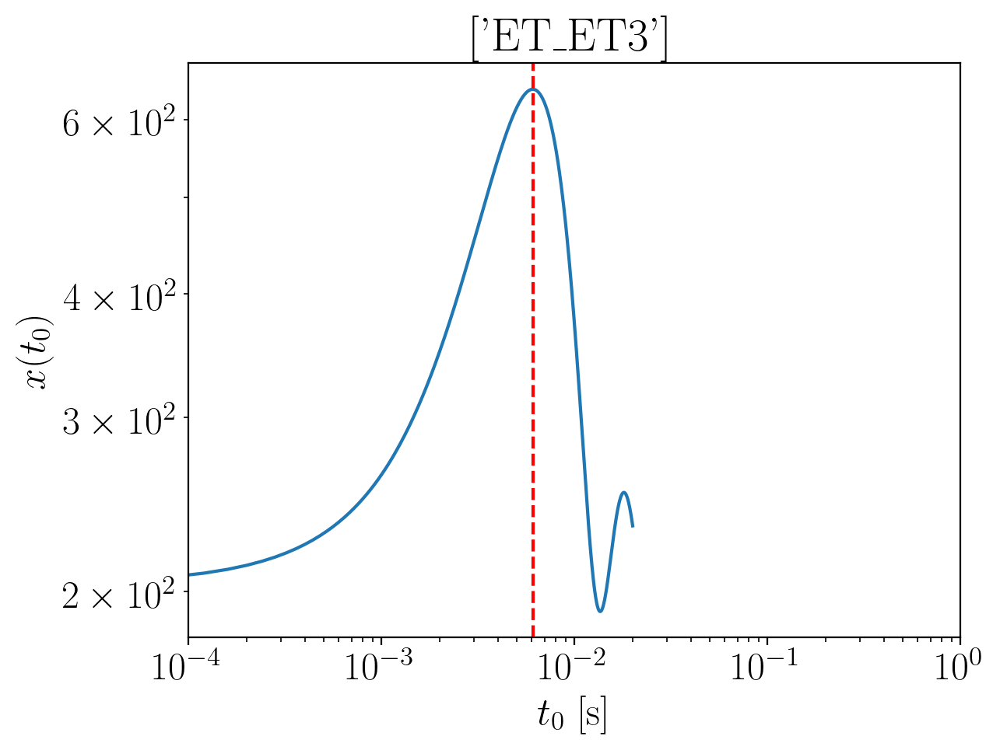

2024-01-15 16:08:48,728 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:48,742 - Network - INFO : PSDs loaded.
2024-01-15 16:08:48,745 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:48,752 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:48,757 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:48,781 - Network - INFO : Polarizations calculated.
2024-01-15 16:08:48,782 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:08:48,786 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.1001169112943803
Inner product:
0.9996122478252937


2024-01-15 16:08:54,388 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:08:54,434 - Network - INFO : PSDs loaded.
2024-01-15 16:08:54,439 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:08:54,453 - Network - INFO : Detector responses calculated.
2024-01-15 16:08:54,454 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:08:54,454 - Network - INFO :    CE-40_C
2024-01-15 16:08:58,007 - Network - INFO :    CE-20_S
2024-01-15 16:09:01,517 - Network - INFO :    ET_ET1
2024-01-15 16:09:05,081 - Network - INFO :    ET_ET2
2024-01-15 16:09:08,903 - Network - INFO :    ET_ET3
2024-01-15 16:09:12,615 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:09:12,621 - Network - INFO : SNRs calculated.
2024-01-15 16:09:12,622 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:09:12,622 - Network - INFO :    CE-40_C
2024-01-15 16:09:12,715 - Network - INFO :

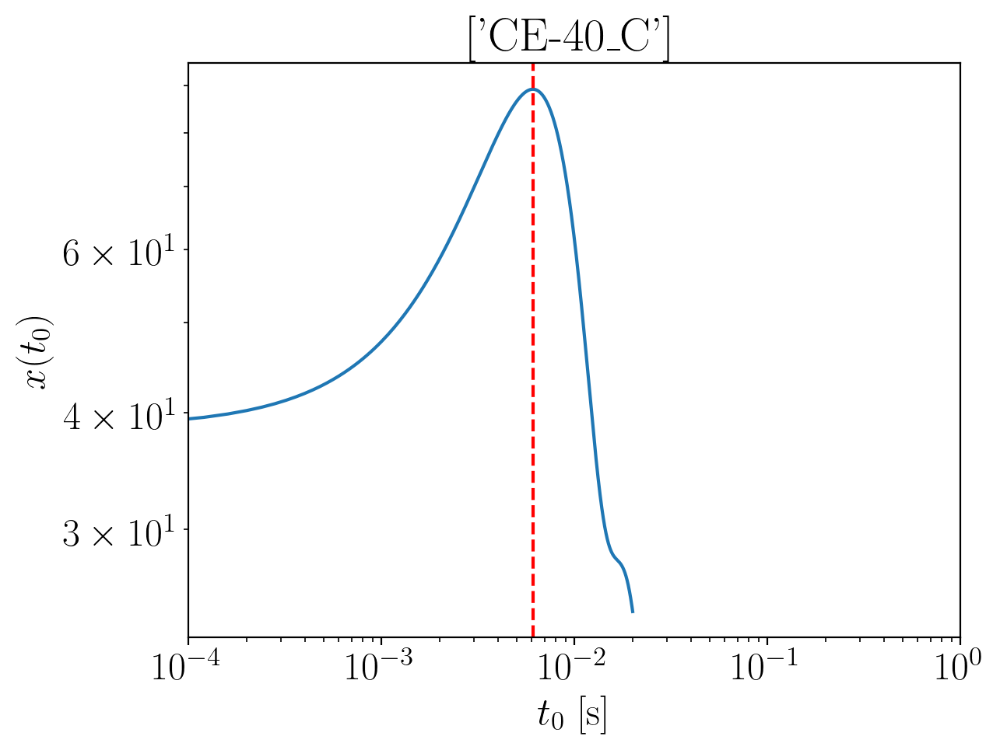

2024-01-15 16:09:14,451 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:14,457 - Network - INFO : PSDs loaded.
2024-01-15 16:09:14,459 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:14,463 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:14,468 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.0744816626471505
Inner product:
0.9995867452129221


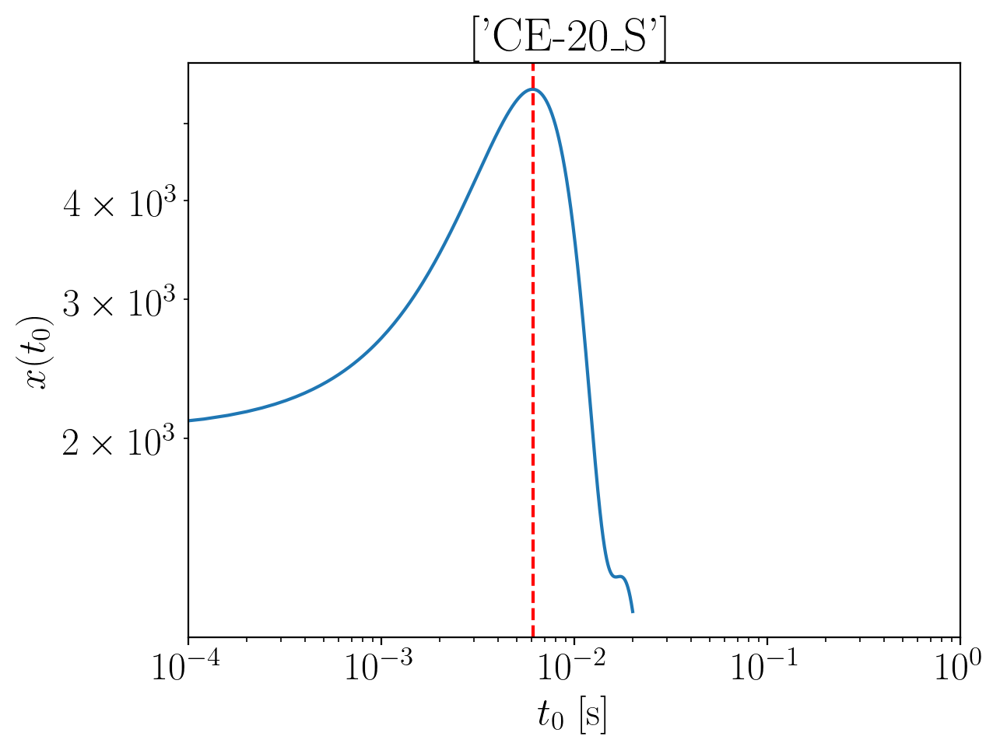

2024-01-15 16:09:15,688 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:15,695 - Network - INFO : PSDs loaded.
2024-01-15 16:09:15,697 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:15,703 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:15,741 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.0762212794793555
Inner product:
0.9995301914444016


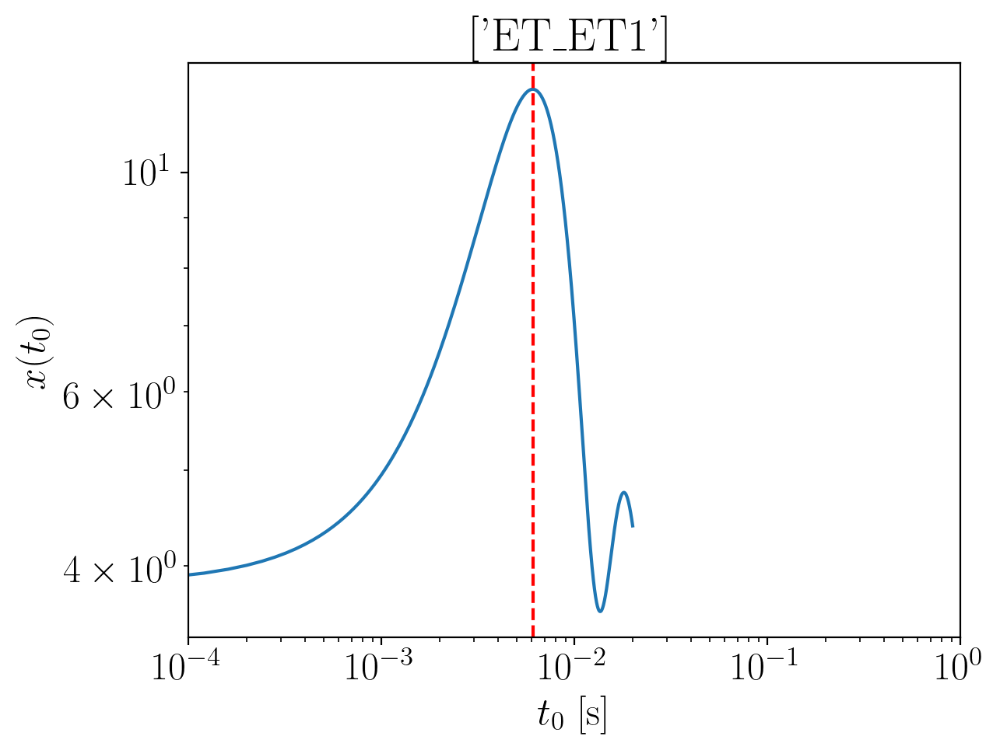

2024-01-15 16:09:17,205 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:17,224 - Network - INFO : PSDs loaded.
2024-01-15 16:09:17,235 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:17,242 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:17,249 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.063056710861735
Inner product:
0.9996122478252938


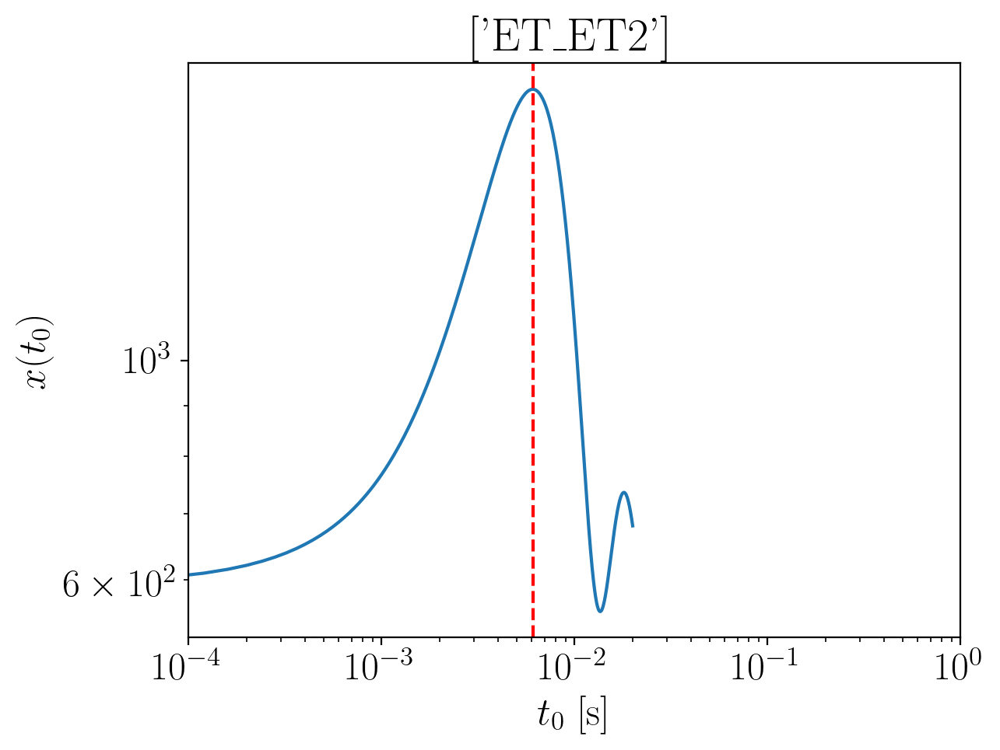

2024-01-15 16:09:18,968 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:18,983 - Network - INFO : PSDs loaded.
2024-01-15 16:09:18,985 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:18,991 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:18,997 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.063056710861735
Inner product:
0.9996122478252939


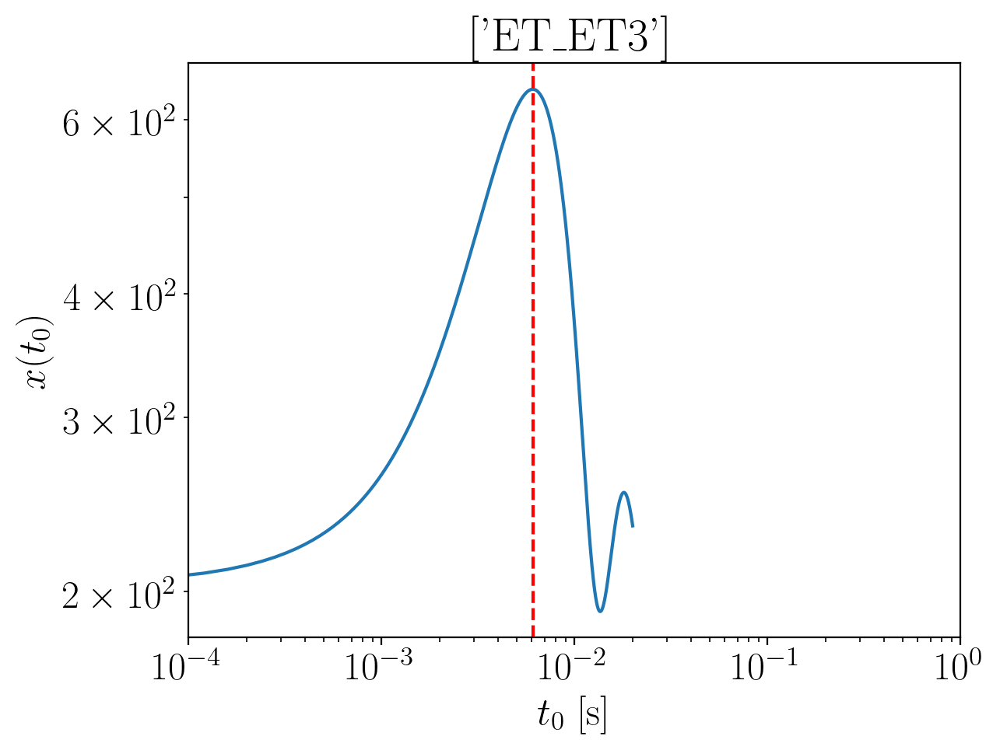

2024-01-15 16:09:20,635 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:20,650 - Network - INFO : PSDs loaded.
2024-01-15 16:09:20,652 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:20,659 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:20,665 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:20,695 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:20,696 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:09:20,702 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.0630567108617353
Inner product:
0.9996122478252939


2024-01-15 16:09:26,238 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:09:26,282 - Network - INFO : PSDs loaded.
2024-01-15 16:09:26,287 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:26,302 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:26,302 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:09:26,303 - Network - INFO :    CE-40_C
2024-01-15 16:09:29,905 - Network - INFO :    CE-20_S
2024-01-15 16:09:33,433 - Network - INFO :    ET_ET1
2024-01-15 16:09:36,977 - Network - INFO :    ET_ET2
2024-01-15 16:09:40,527 - Network - INFO :    ET_ET3
2024-01-15 16:09:44,098 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:09:44,104 - Network - INFO : SNRs calculated.
2024-01-15 16:09:44,105 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:09:44,105 - Network - INFO :    CE-40_C
2024-01-15 16:09:44,198 - Network - INFO :

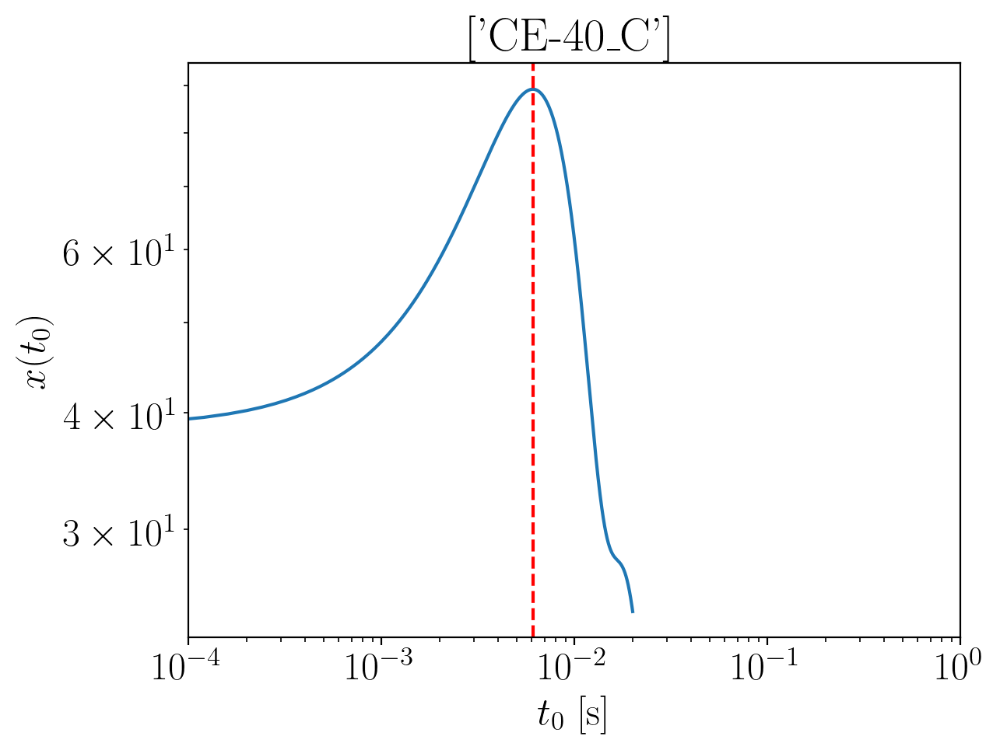

2024-01-15 16:09:46,045 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:46,054 - Network - INFO : PSDs loaded.
2024-01-15 16:09:46,056 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:46,061 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:46,065 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.035871718837127
Inner product:
0.9995867452129221


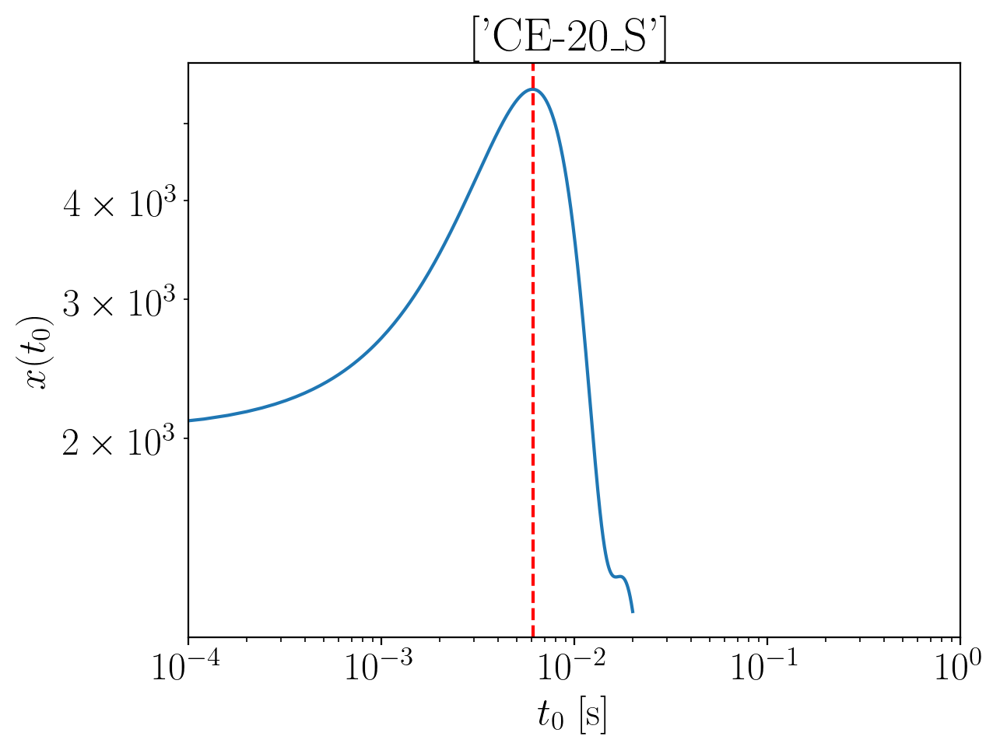

2024-01-15 16:09:47,241 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:47,248 - Network - INFO : PSDs loaded.
2024-01-15 16:09:47,250 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:47,254 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:47,259 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.037611335669332
Inner product:
0.9995301914444018


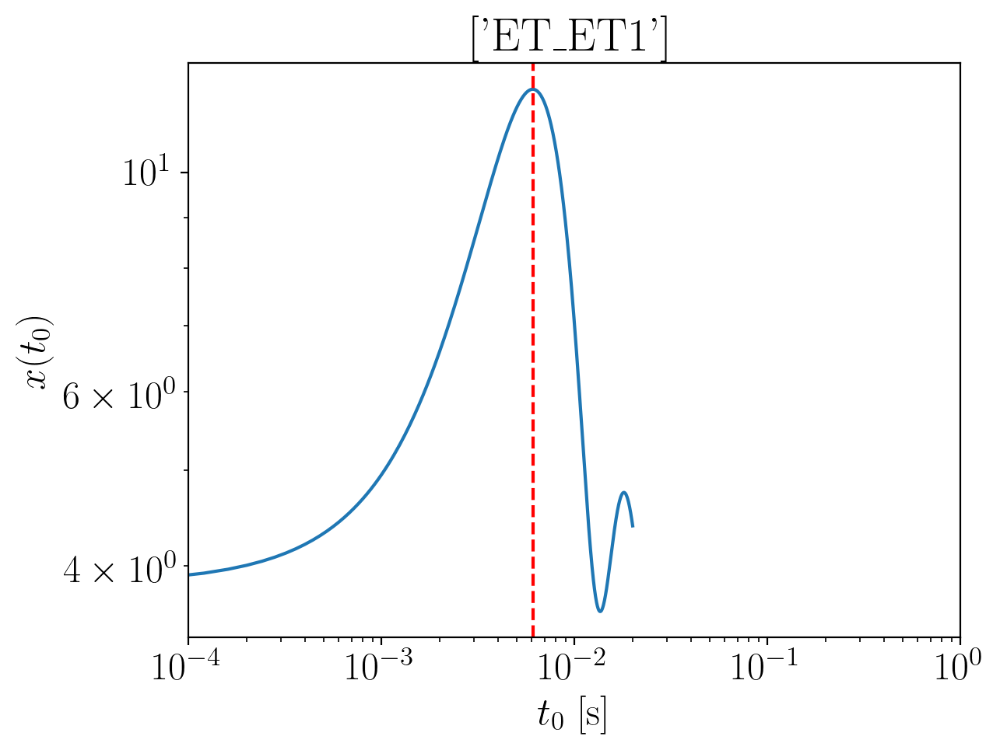

2024-01-15 16:09:48,685 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:48,706 - Network - INFO : PSDs loaded.
2024-01-15 16:09:48,709 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:48,733 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:48,748 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.0244467670517112
Inner product:
0.9996122478252939


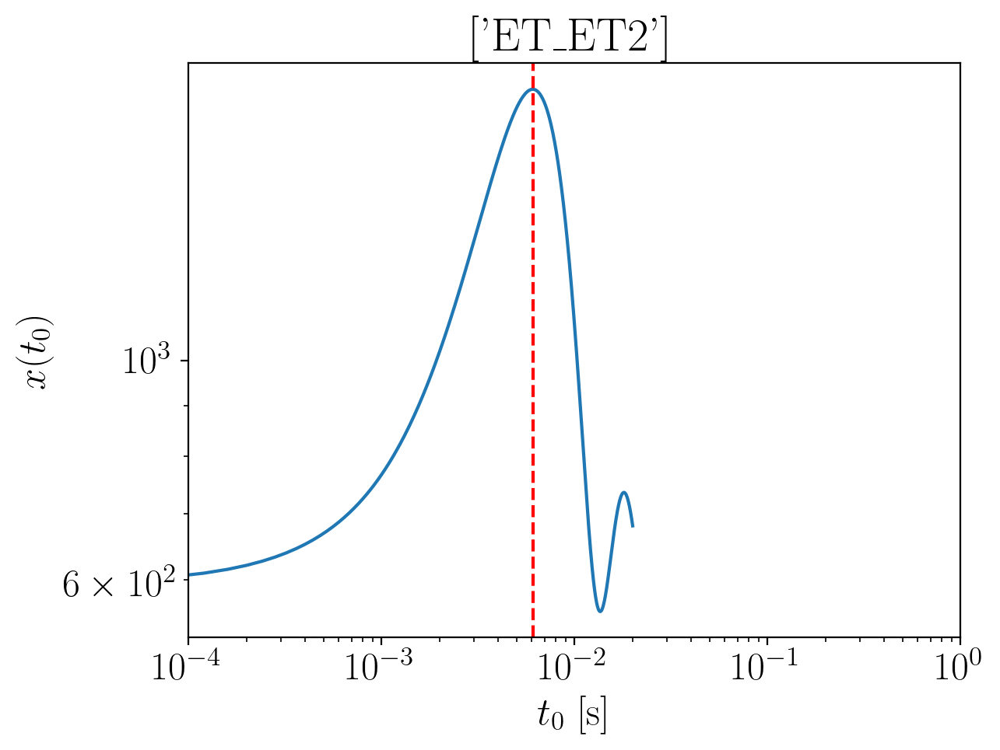

2024-01-15 16:09:50,165 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:50,182 - Network - INFO : PSDs loaded.
2024-01-15 16:09:50,185 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:50,190 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:50,195 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.0244467670517117
Inner product:
0.9996122478252939


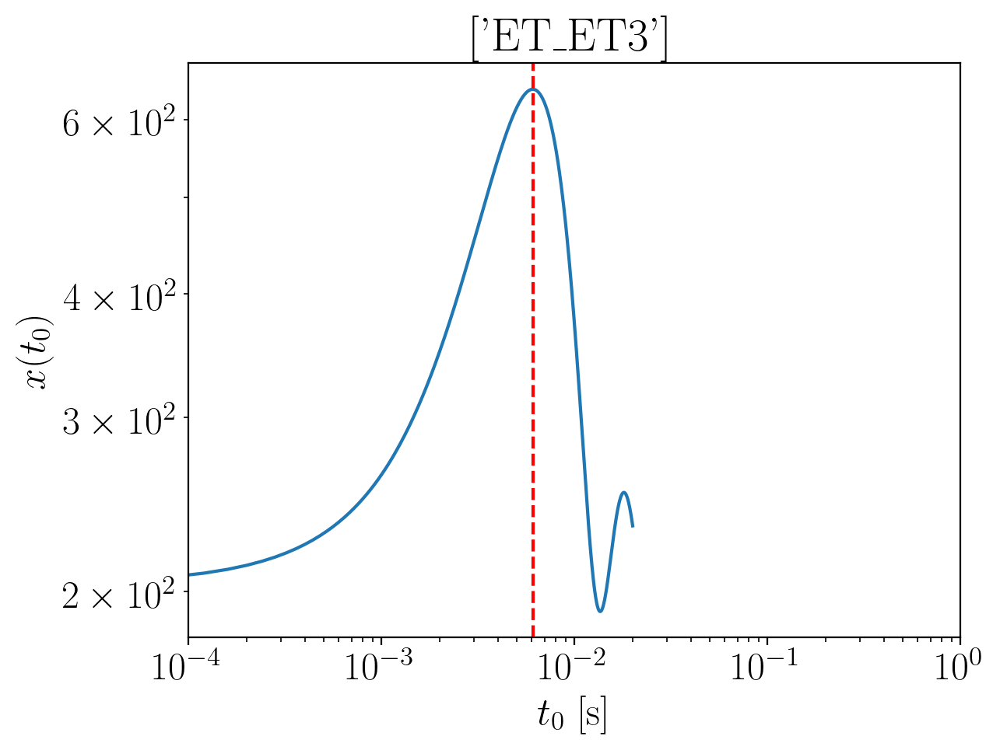

2024-01-15 16:09:51,658 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:51,674 - Network - INFO : PSDs loaded.
2024-01-15 16:09:51,676 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:51,681 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:51,686 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:51,718 - Network - INFO : Polarizations calculated.
2024-01-15 16:09:51,719 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:09:51,729 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -2.0244467670517117
Inner product:
0.9996122478252937


2024-01-15 16:09:57,079 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:09:57,124 - Network - INFO : PSDs loaded.
2024-01-15 16:09:57,129 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:09:57,143 - Network - INFO : Detector responses calculated.
2024-01-15 16:09:57,144 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:09:57,144 - Network - INFO :    CE-40_C
2024-01-15 16:10:00,710 - Network - INFO :    CE-20_S
2024-01-15 16:10:04,233 - Network - INFO :    ET_ET1
2024-01-15 16:10:07,827 - Network - INFO :    ET_ET2
2024-01-15 16:10:11,375 - Network - INFO :    ET_ET3
2024-01-15 16:10:15,017 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:10:15,023 - Network - INFO : SNRs calculated.
2024-01-15 16:10:15,024 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:10:15,025 - Network - INFO :    CE-40_C
2024-01-15 16:10:15,120 - Network - INFO :

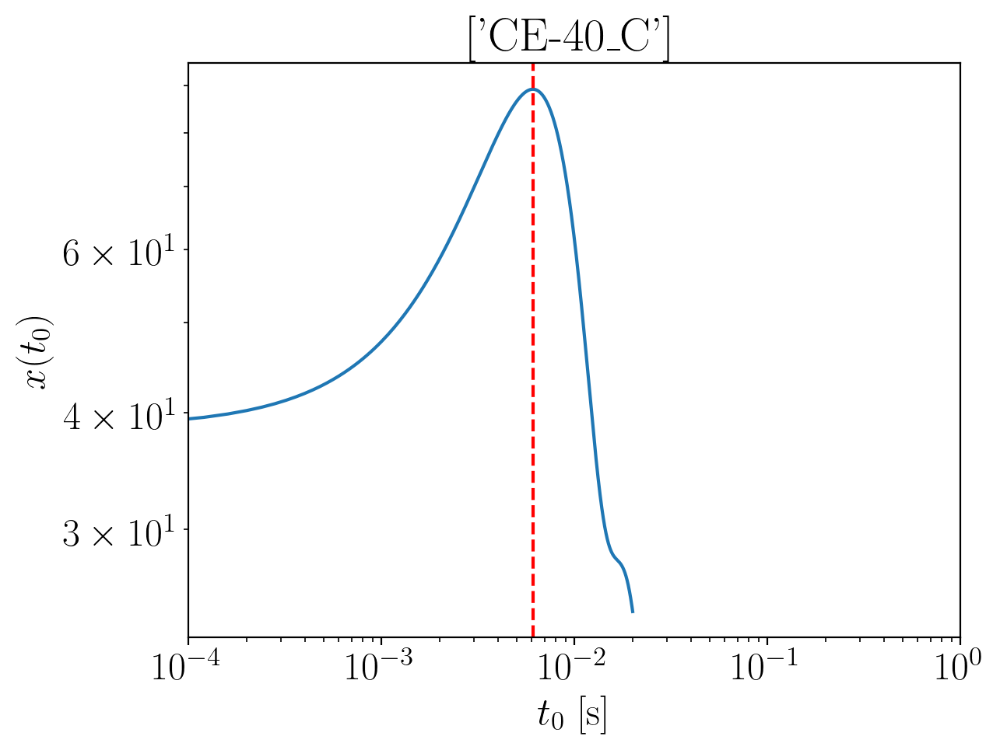

2024-01-15 16:10:16,830 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:16,843 - Network - INFO : PSDs loaded.
2024-01-15 16:10:16,848 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:16,853 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:16,867 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -1.9963510177970445
Inner product:
0.9995867452129221


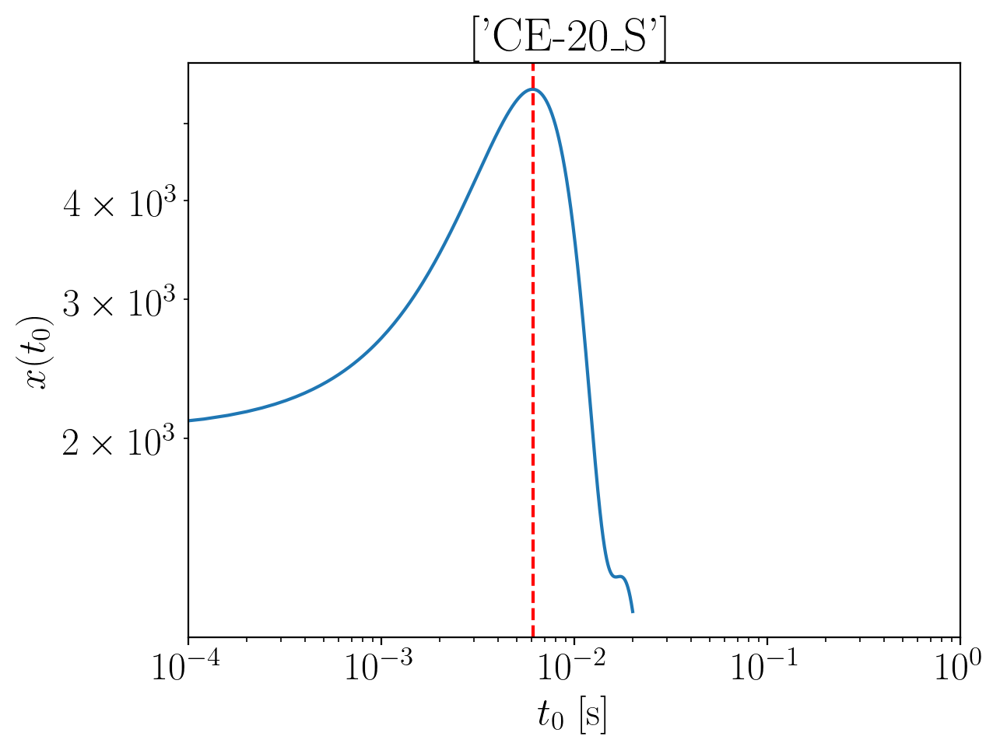

2024-01-15 16:10:18,033 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:18,040 - Network - INFO : PSDs loaded.
2024-01-15 16:10:18,042 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:18,047 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:18,052 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -1.9980906346292493
Inner product:
0.9995301914444018


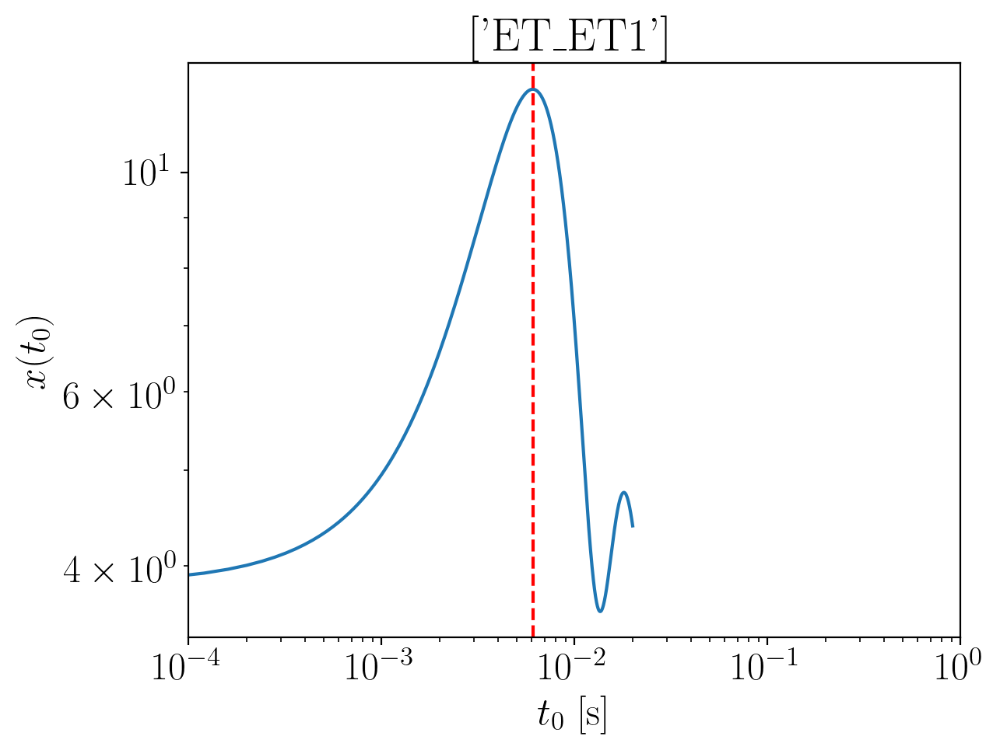

2024-01-15 16:10:19,549 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:19,563 - Network - INFO : PSDs loaded.
2024-01-15 16:10:19,565 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:19,570 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:19,581 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -1.9849260660116288
Inner product:
0.9996122478252939


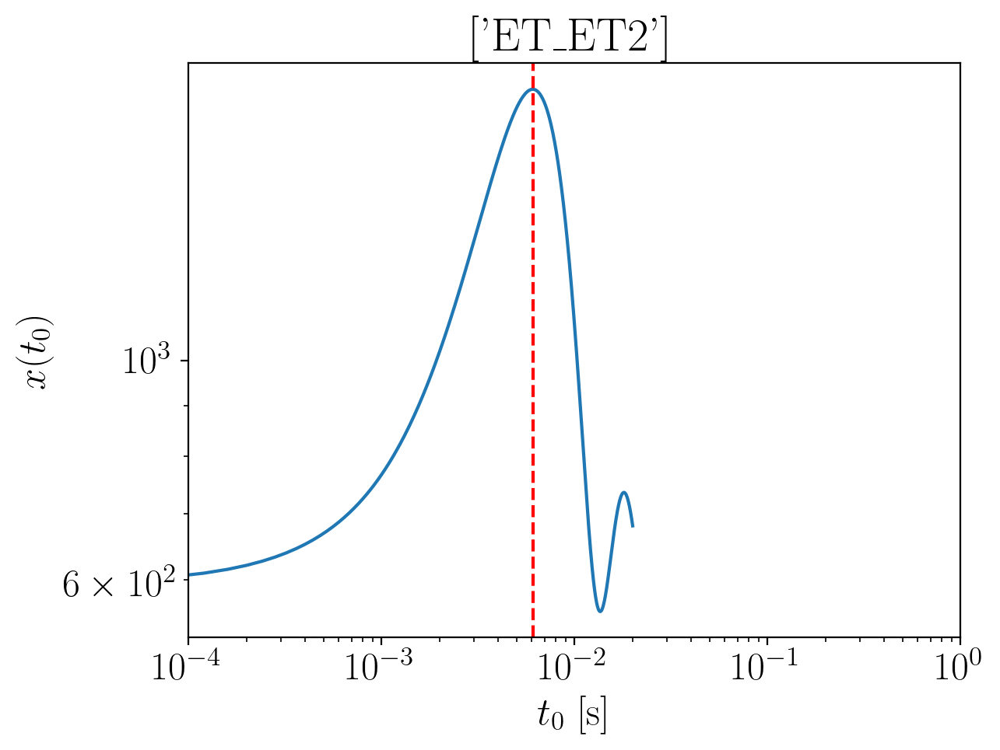

2024-01-15 16:10:21,013 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:21,027 - Network - INFO : PSDs loaded.
2024-01-15 16:10:21,029 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:21,034 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:21,039 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -1.9849260660116288
Inner product:
0.9996122478252936


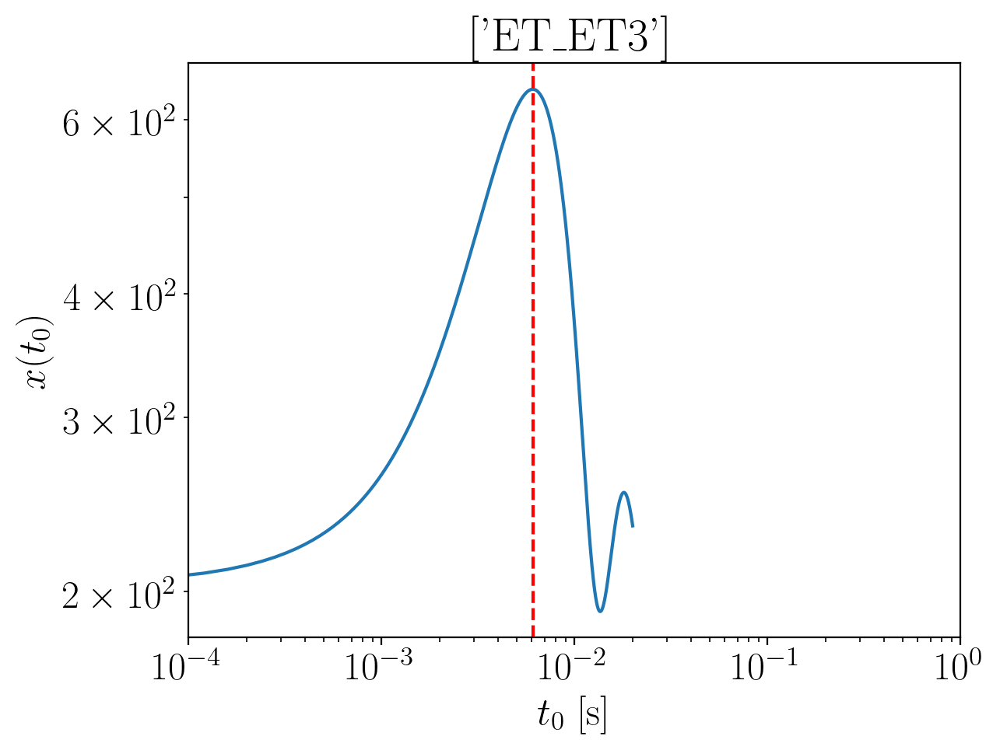

2024-01-15 16:10:22,476 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:22,508 - Network - INFO : PSDs loaded.
2024-01-15 16:10:22,516 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:22,525 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:22,532 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:22,566 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:22,567 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:10:22,575 - Network - INFO : Polarizations calculated.


time shift: 0.00608
phase shift: -1.9849260660116288
Inner product:
0.9996122478252936


2024-01-15 16:10:28,090 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:10:28,135 - Network - INFO : PSDs loaded.
2024-01-15 16:10:28,140 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:28,188 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:28,189 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:10:28,190 - Network - INFO :    CE-40_C
2024-01-15 16:10:31,770 - Network - INFO :    CE-20_S
2024-01-15 16:10:35,338 - Network - INFO :    ET_ET1
2024-01-15 16:10:38,914 - Network - INFO :    ET_ET2
2024-01-15 16:10:42,493 - Network - INFO :    ET_ET3
2024-01-15 16:10:46,044 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:10:46,050 - Network - INFO : SNRs calculated.
2024-01-15 16:10:46,051 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:10:46,051 - Network - INFO :    CE-40_C
2024-01-15 16:10:46,147 - Network - INFO :

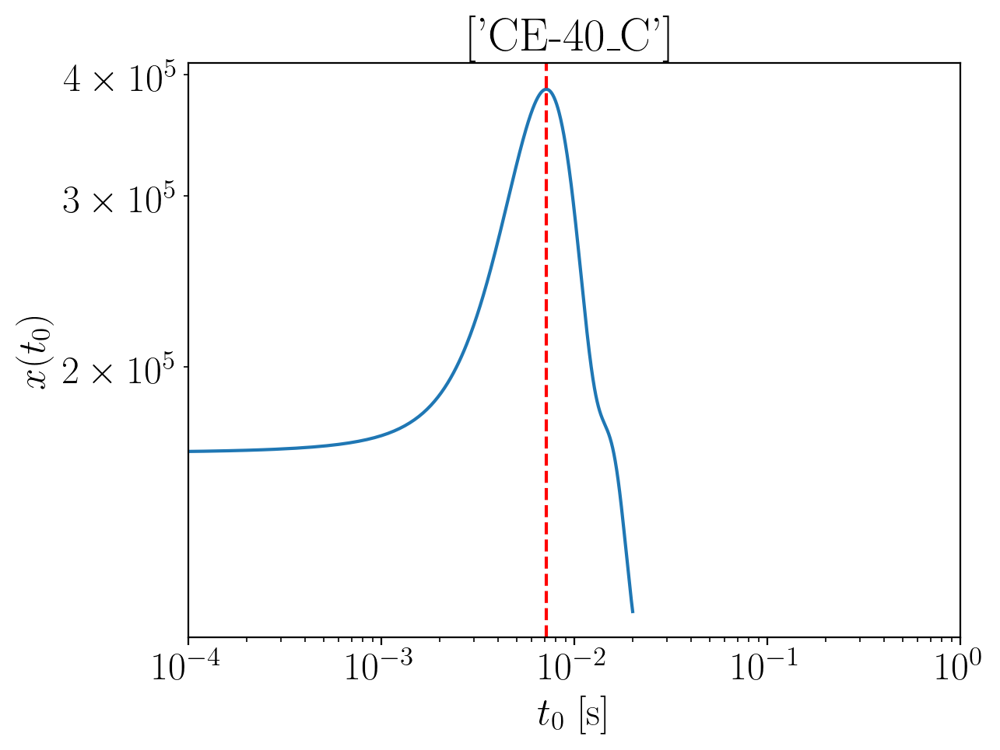

2024-01-15 16:10:49,619 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:49,628 - Network - INFO : PSDs loaded.
2024-01-15 16:10:49,631 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:49,637 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:49,643 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.152030852048737
Inner product:
0.9996417381682167


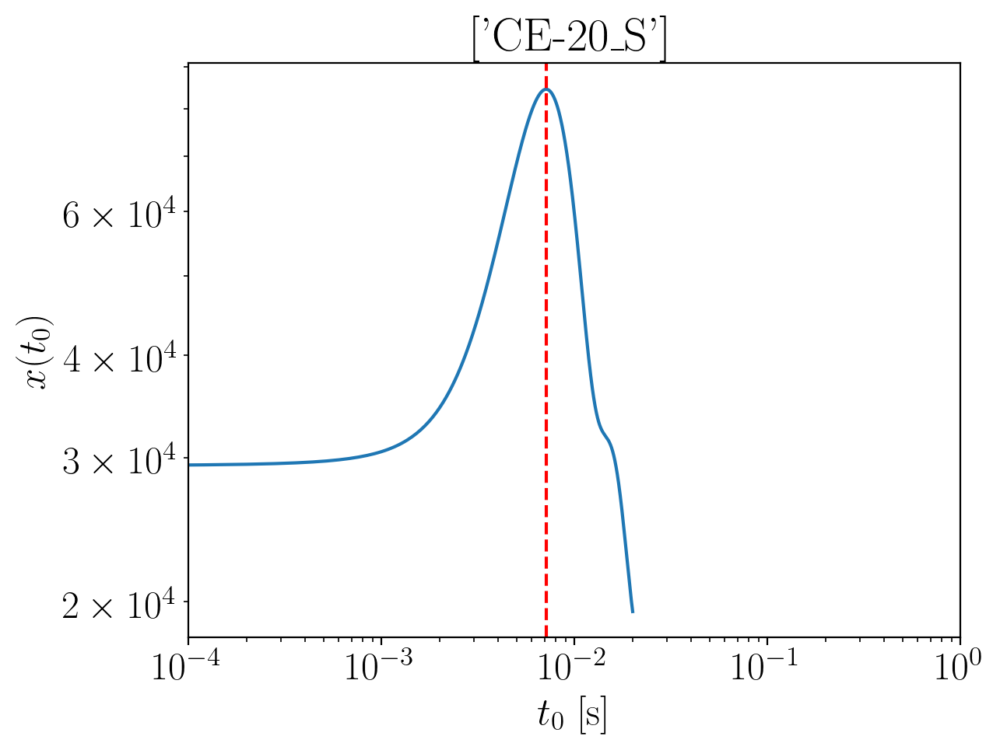

2024-01-15 16:10:50,808 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:50,821 - Network - INFO : PSDs loaded.
2024-01-15 16:10:50,823 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:50,847 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:50,857 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1541982652485565
Inner product:
0.9995904314960874


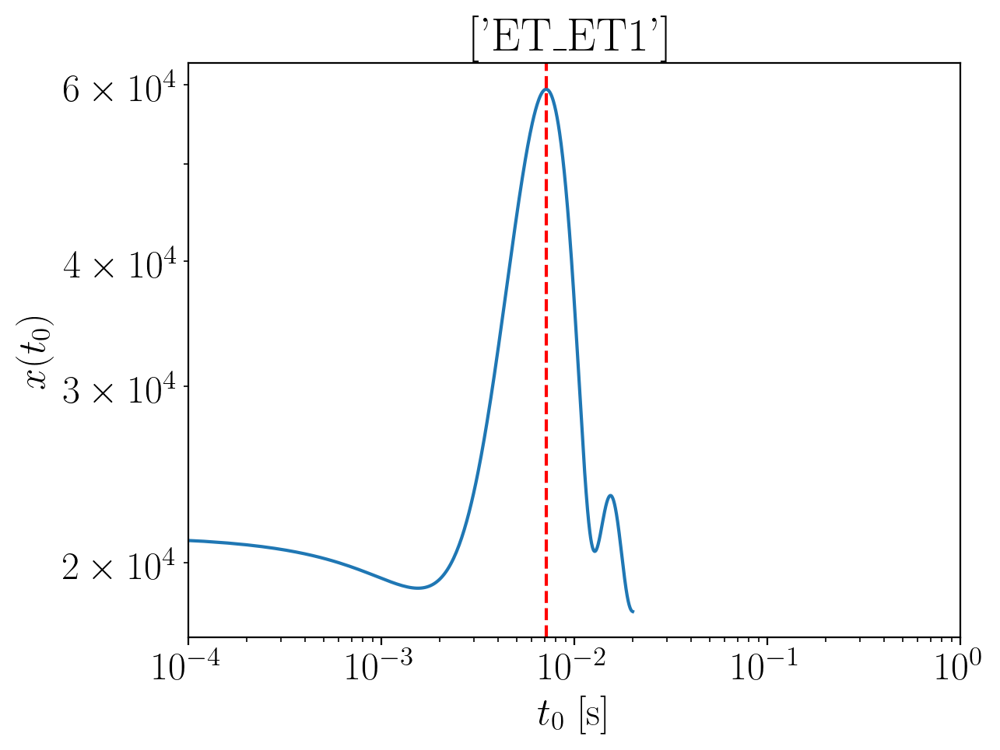

2024-01-15 16:10:52,247 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:52,264 - Network - INFO : PSDs loaded.
2024-01-15 16:10:52,278 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:52,298 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:52,311 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.147941174087486
Inner product:
0.9996063833880358


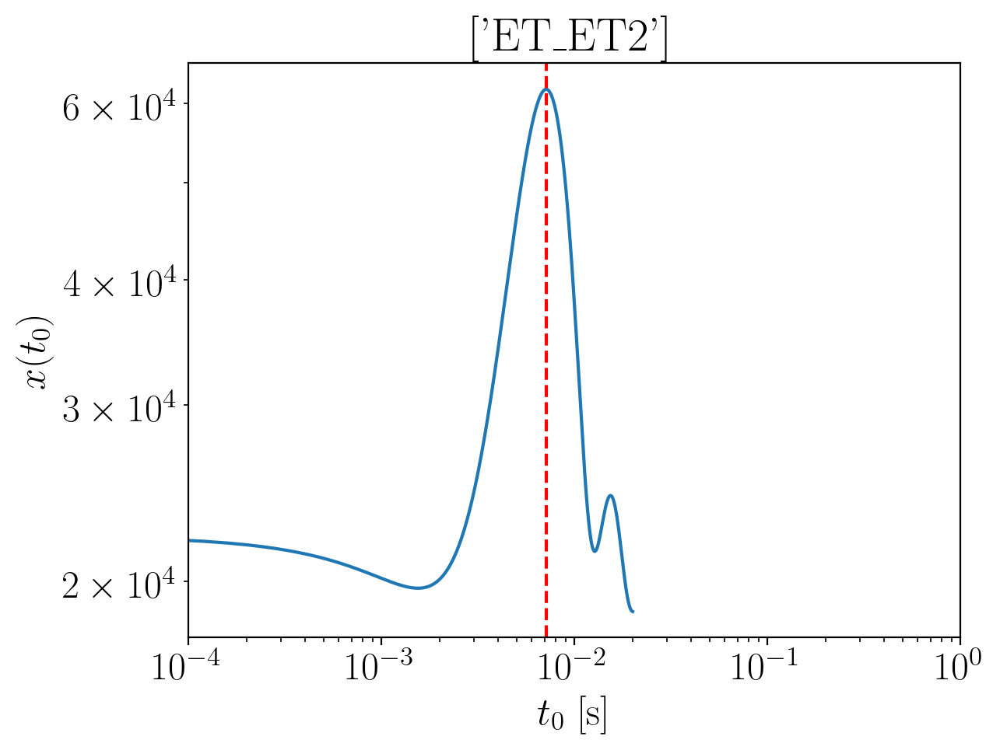

2024-01-15 16:10:53,762 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:53,777 - Network - INFO : PSDs loaded.
2024-01-15 16:10:53,779 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:53,793 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:53,811 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1479411740874865
Inner product:
0.9996063833880358


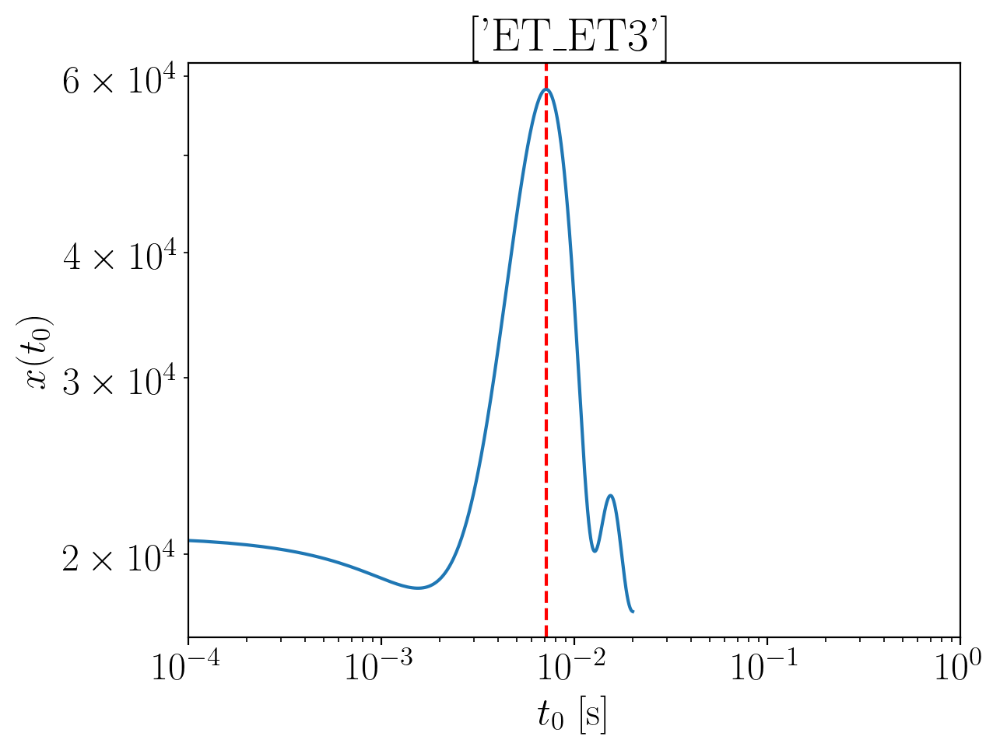

2024-01-15 16:10:55,414 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:55,427 - Network - INFO : PSDs loaded.
2024-01-15 16:10:55,429 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:10:55,435 - Network - INFO : Detector responses calculated.
2024-01-15 16:10:55,443 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:55,467 - Network - INFO : Polarizations calculated.
2024-01-15 16:10:55,467 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:10:55,472 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1479411740874865
Inner product:
0.9996063833880356


2024-01-15 16:11:00,784 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:11:00,829 - Network - INFO : PSDs loaded.
2024-01-15 16:11:00,834 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:00,849 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:00,849 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:11:00,850 - Network - INFO :    CE-40_C
2024-01-15 16:11:04,478 - Network - INFO :    CE-20_S
2024-01-15 16:11:08,082 - Network - INFO :    ET_ET1
2024-01-15 16:11:11,716 - Network - INFO :    ET_ET2
2024-01-15 16:11:15,330 - Network - INFO :    ET_ET3
2024-01-15 16:11:18,887 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:11:18,893 - Network - INFO : SNRs calculated.
2024-01-15 16:11:18,894 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:11:18,894 - Network - INFO :    CE-40_C
2024-01-15 16:11:18,987 - Network - INFO :

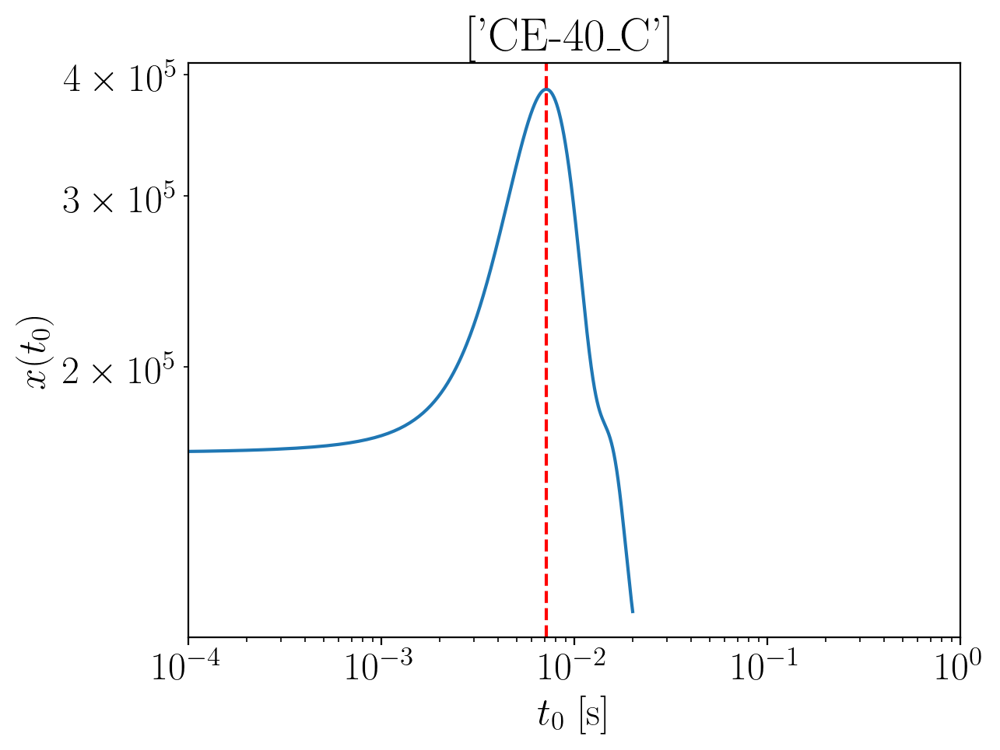

2024-01-15 16:11:20,703 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:20,711 - Network - INFO : PSDs loaded.
2024-01-15 16:11:20,713 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:20,719 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:20,724 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.3625445498425757
Inner product:
0.9996417381682164


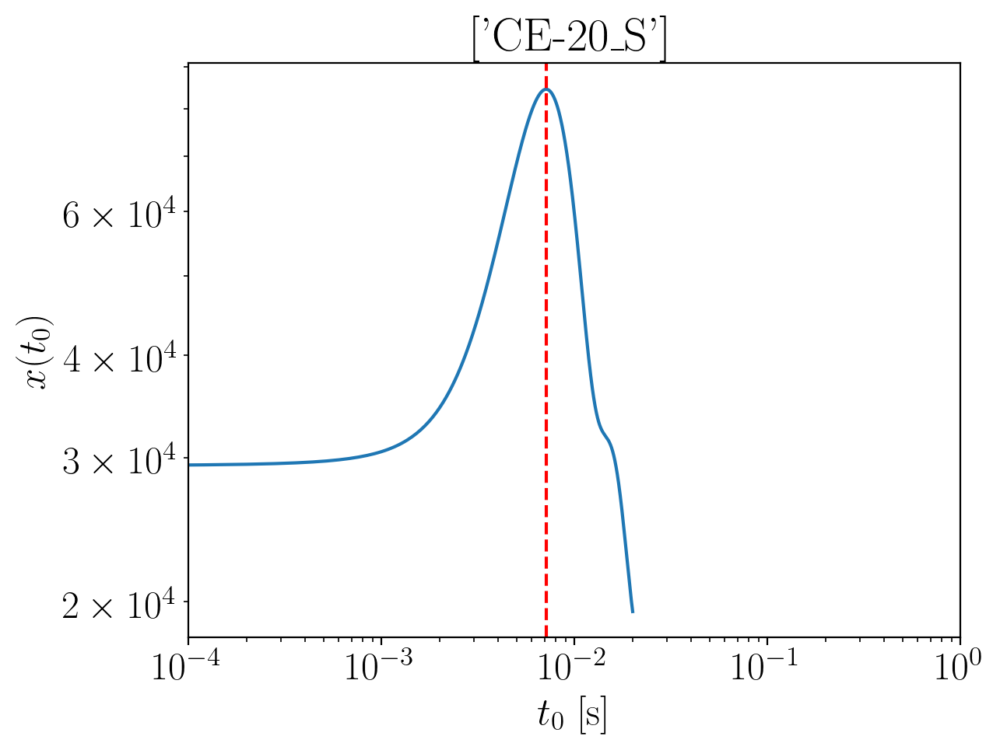

2024-01-15 16:11:21,896 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:21,902 - Network - INFO : PSDs loaded.
2024-01-15 16:11:21,904 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:21,909 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:21,914 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.364711963042394
Inner product:
0.9995904314960874


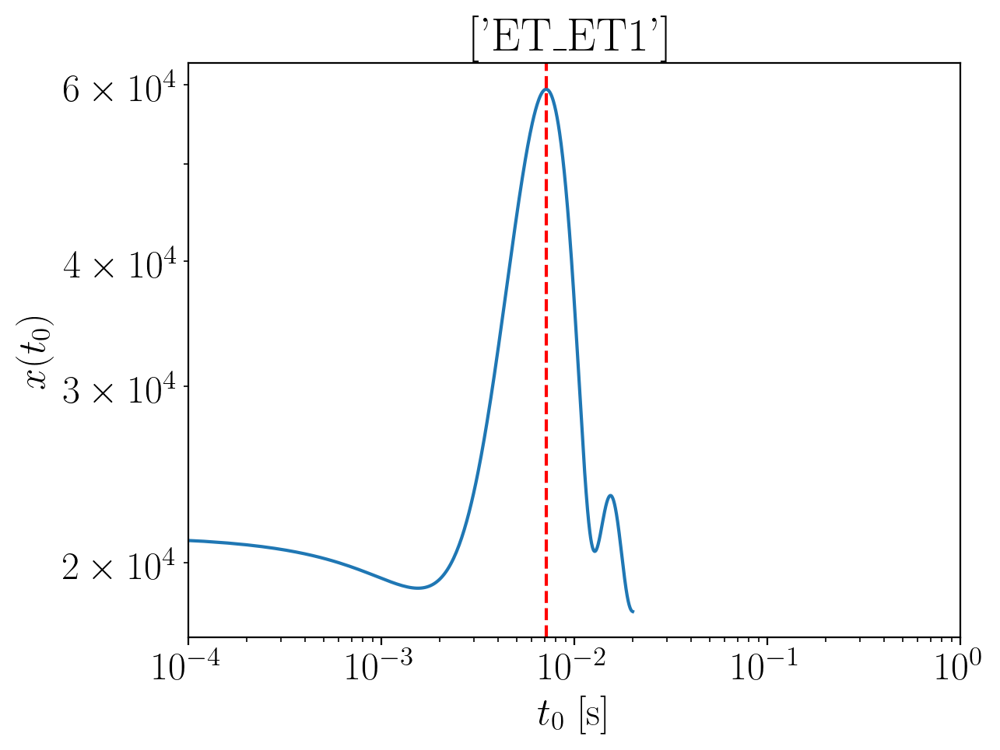

2024-01-15 16:11:23,282 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:23,295 - Network - INFO : PSDs loaded.
2024-01-15 16:11:23,297 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:23,302 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:23,307 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.3555008861787377
Inner product:
0.9996063833880358


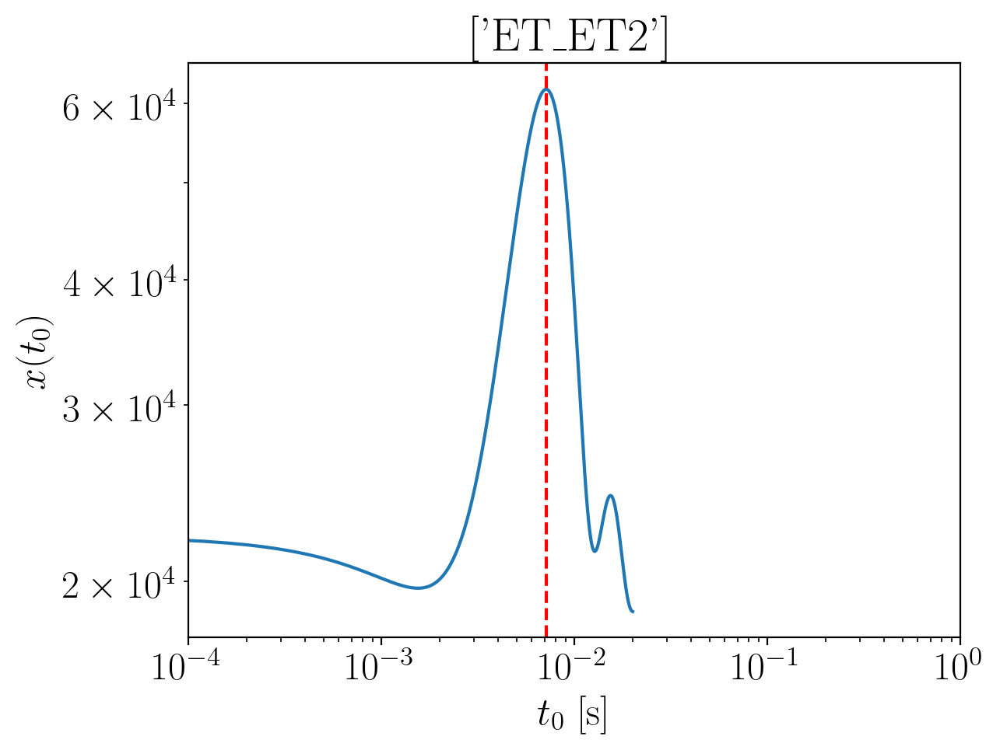

2024-01-15 16:11:24,723 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:24,737 - Network - INFO : PSDs loaded.
2024-01-15 16:11:24,739 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:24,751 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:24,765 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.3555008861787377
Inner product:
0.9996063833880358


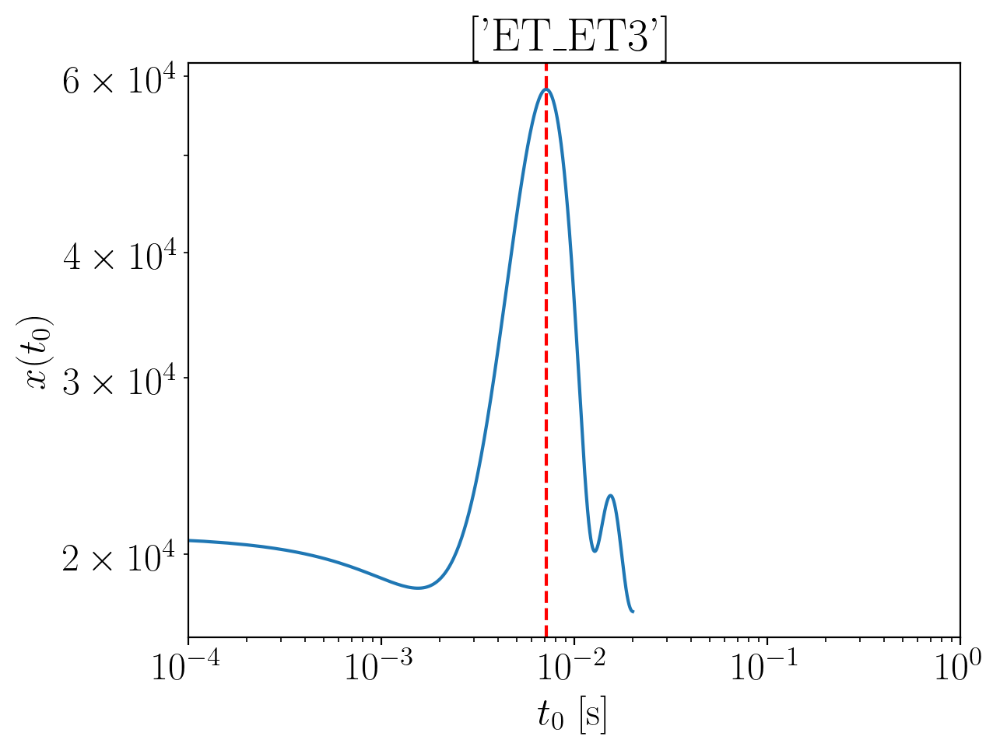

2024-01-15 16:11:26,183 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:26,209 - Network - INFO : PSDs loaded.
2024-01-15 16:11:26,215 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:26,225 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:26,232 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:26,255 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:26,257 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:11:26,268 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.355500886178738
Inner product:
0.9996063833880356


2024-01-15 16:11:31,642 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:11:31,687 - Network - INFO : PSDs loaded.
2024-01-15 16:11:31,692 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:31,725 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:31,728 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:11:31,731 - Network - INFO :    CE-40_C
2024-01-15 16:11:35,305 - Network - INFO :    CE-20_S
2024-01-15 16:11:38,854 - Network - INFO :    ET_ET1
2024-01-15 16:11:42,408 - Network - INFO :    ET_ET2
2024-01-15 16:11:45,944 - Network - INFO :    ET_ET3
2024-01-15 16:11:49,509 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:11:49,515 - Network - INFO : SNRs calculated.
2024-01-15 16:11:49,516 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:11:49,516 - Network - INFO :    CE-40_C
2024-01-15 16:11:49,610 - Network - INFO :

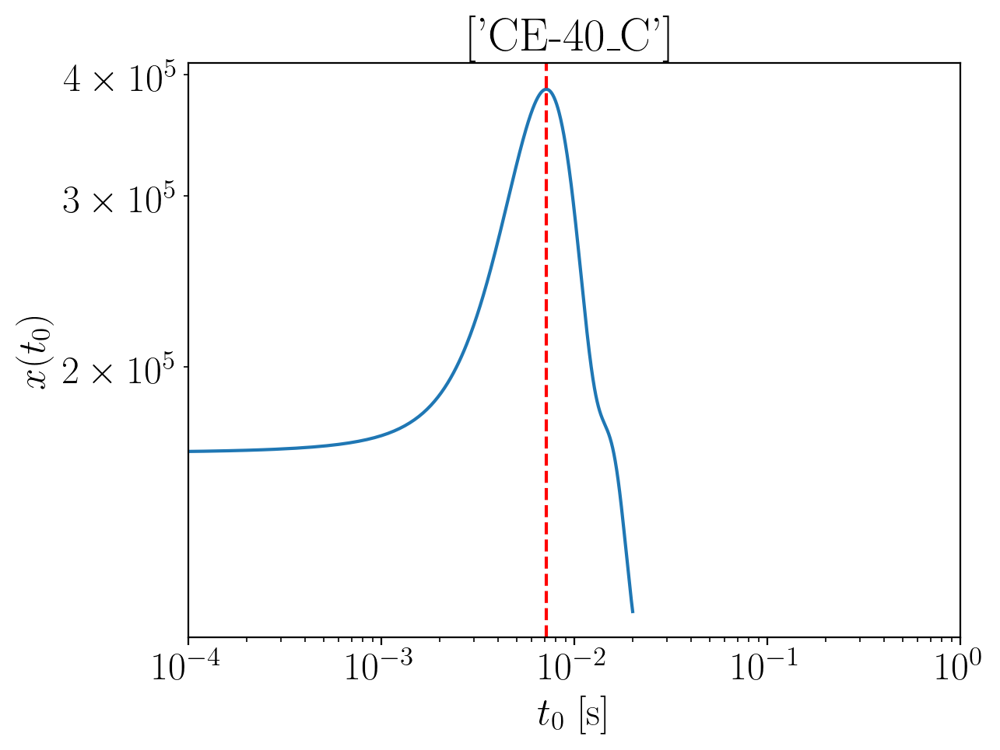

2024-01-15 16:11:51,449 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:51,456 - Network - INFO : PSDs loaded.
2024-01-15 16:11:51,457 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:51,463 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:51,468 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.3051592382348813
Inner product:
0.9996417381682164


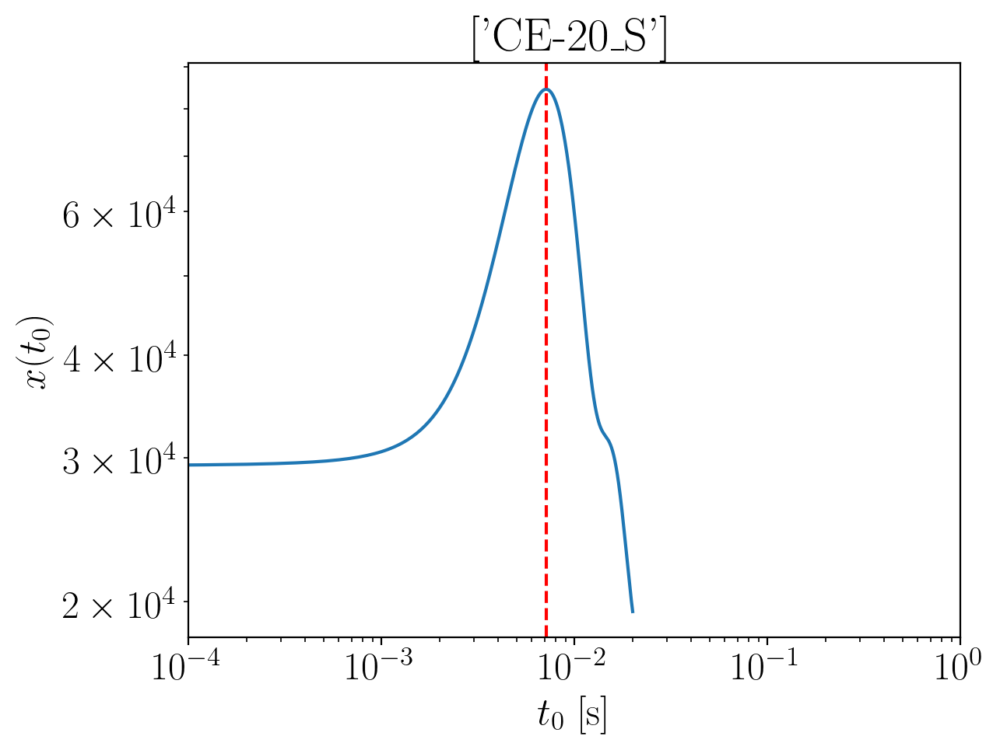

2024-01-15 16:11:52,712 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:52,719 - Network - INFO : PSDs loaded.
2024-01-15 16:11:52,721 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:52,726 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:52,731 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.3073266514347006
Inner product:
0.9995904314960874


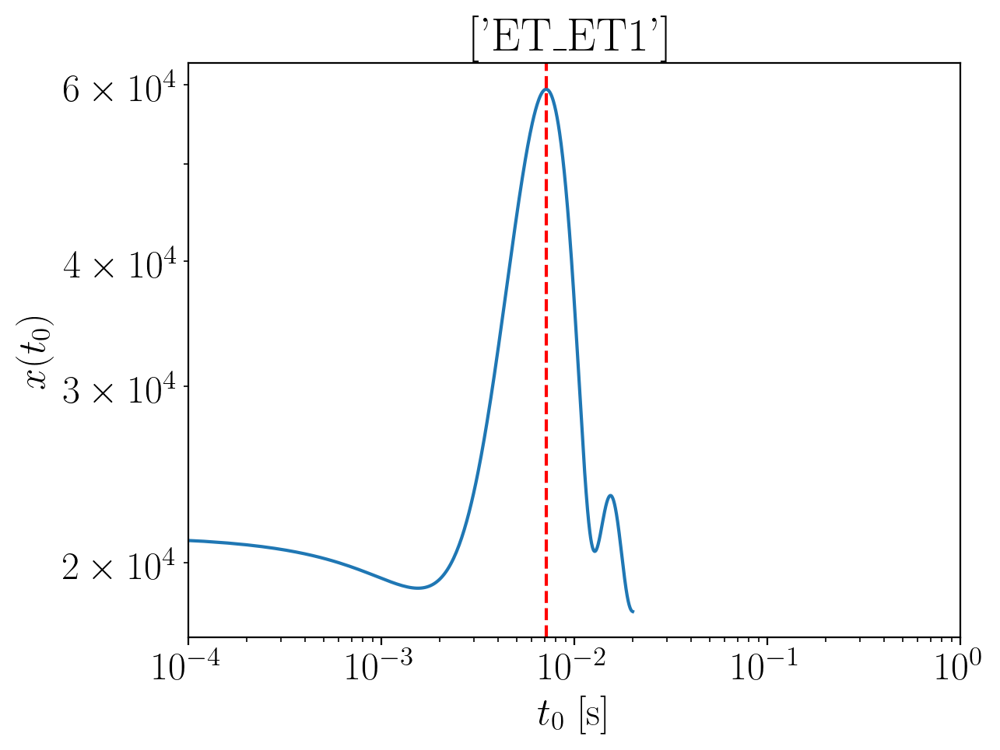

2024-01-15 16:11:54,131 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:54,143 - Network - INFO : PSDs loaded.
2024-01-15 16:11:54,145 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:54,150 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:54,155 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.298115574571054
Inner product:
0.9996063833880359


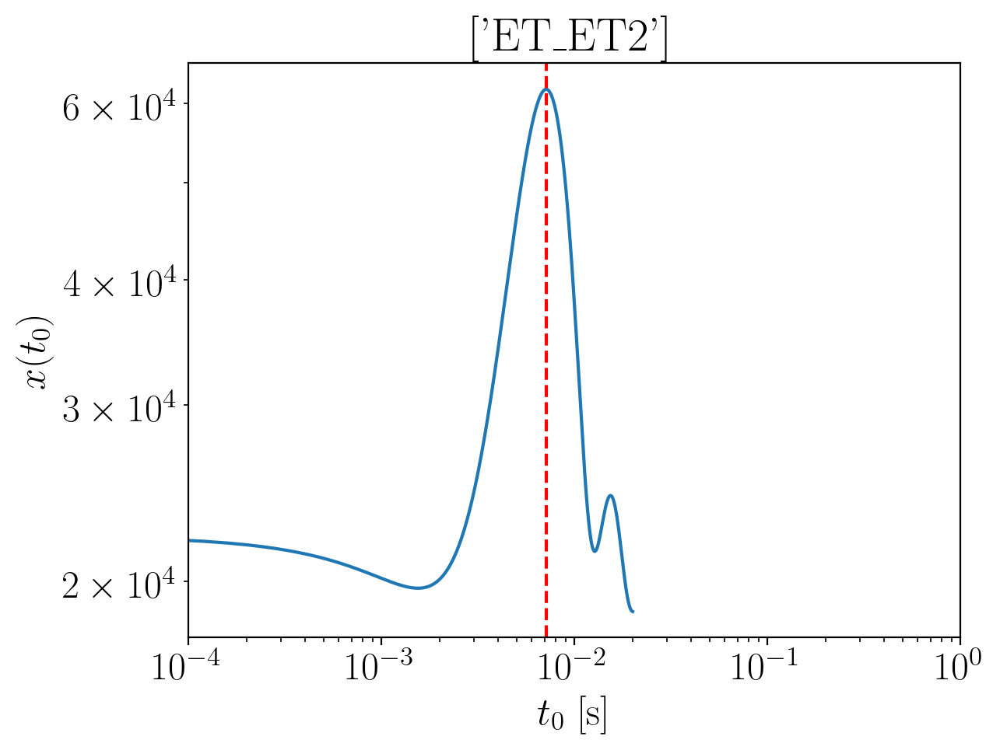

2024-01-15 16:11:55,547 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:55,560 - Network - INFO : PSDs loaded.
2024-01-15 16:11:55,562 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:55,568 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:55,575 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.298115574571054
Inner product:
0.9996063833880358


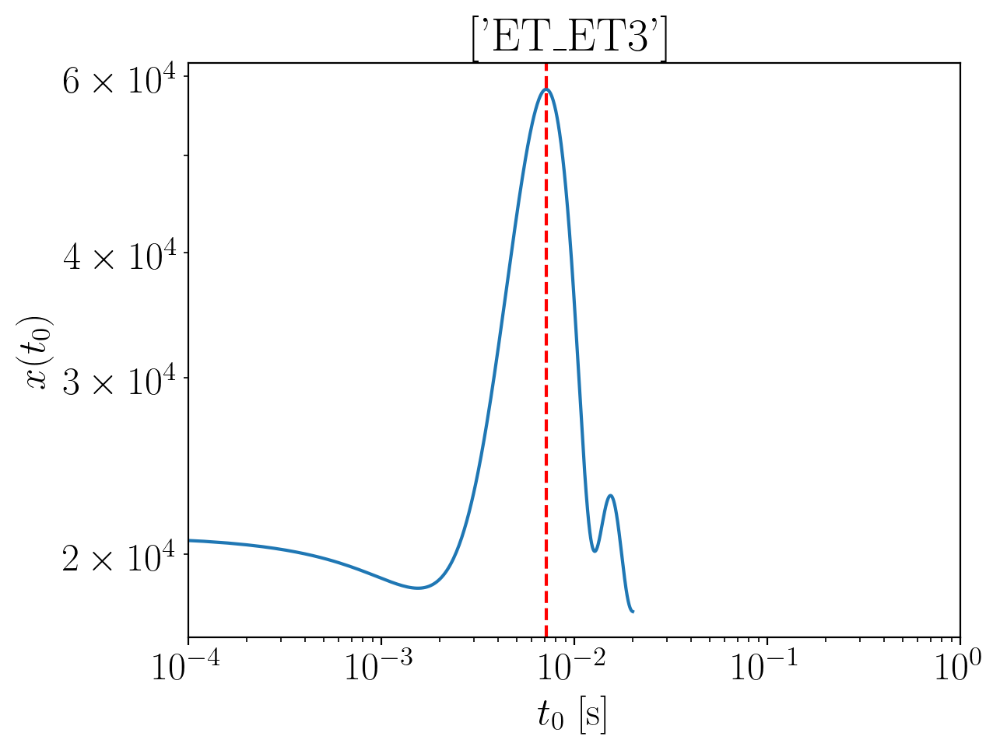

2024-01-15 16:11:57,029 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:57,054 - Network - INFO : PSDs loaded.
2024-01-15 16:11:57,074 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:11:57,082 - Network - INFO : Detector responses calculated.
2024-01-15 16:11:57,089 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:57,125 - Network - INFO : Polarizations calculated.
2024-01-15 16:11:57,128 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:11:57,143 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.298115574571054
Inner product:
0.9996063833880359


2024-01-15 16:12:02,498 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:12:02,543 - Network - INFO : PSDs loaded.
2024-01-15 16:12:02,559 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:02,599 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:02,600 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:12:02,600 - Network - INFO :    CE-40_C
2024-01-15 16:12:06,221 - Network - INFO :    CE-20_S
2024-01-15 16:12:09,784 - Network - INFO :    ET_ET1
2024-01-15 16:12:13,440 - Network - INFO :    ET_ET2
2024-01-15 16:12:17,003 - Network - INFO :    ET_ET3
2024-01-15 16:12:20,562 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:12:20,568 - Network - INFO : SNRs calculated.
2024-01-15 16:12:20,569 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:12:20,569 - Network - INFO :    CE-40_C
2024-01-15 16:12:20,663 - Network - INFO :

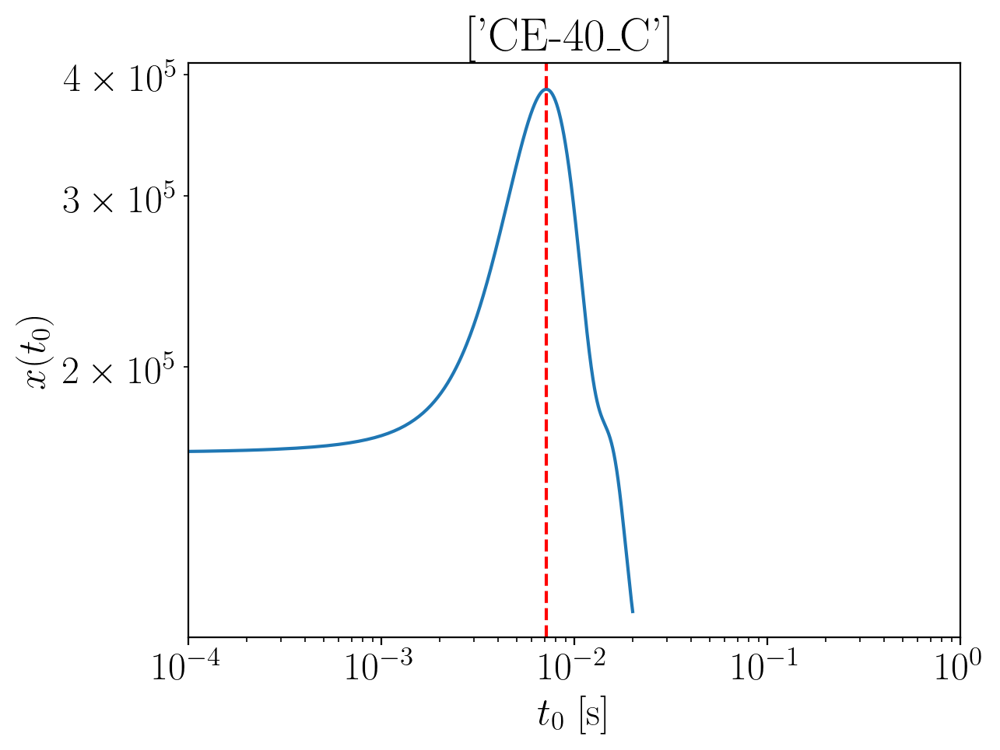

2024-01-15 16:12:22,389 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:22,396 - Network - INFO : PSDs loaded.
2024-01-15 16:12:22,398 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:22,403 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:22,408 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.2526474466349744
Inner product:
0.9996417381682167


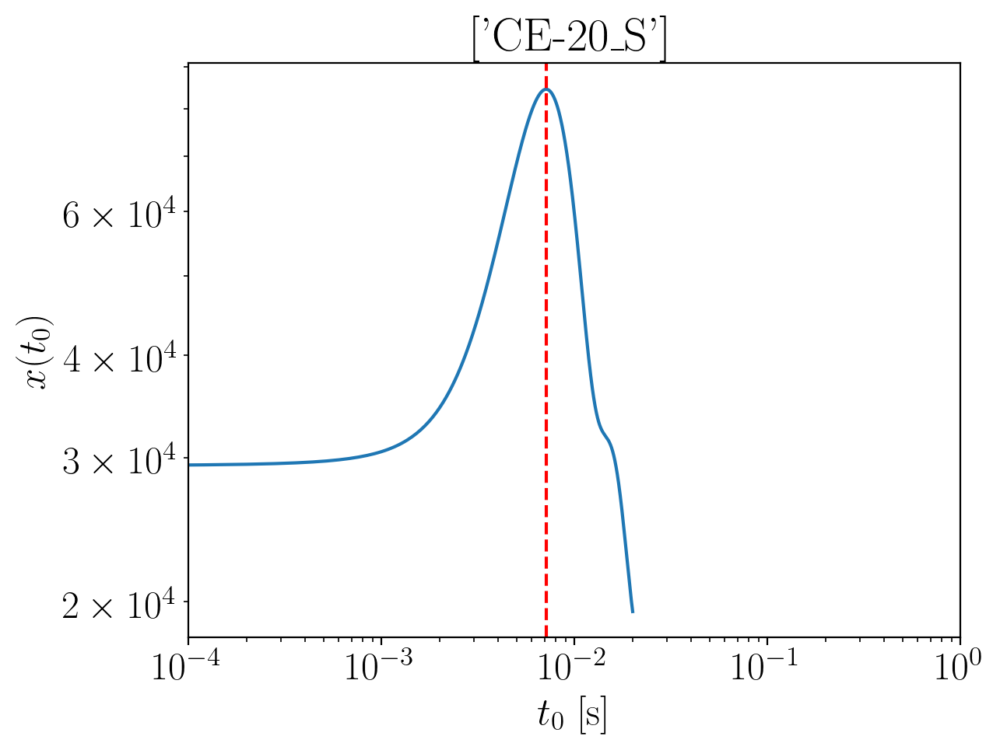

2024-01-15 16:12:23,610 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:23,616 - Network - INFO : PSDs loaded.
2024-01-15 16:12:23,618 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:23,623 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:23,628 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.254814859834794
Inner product:
0.9995904314960874


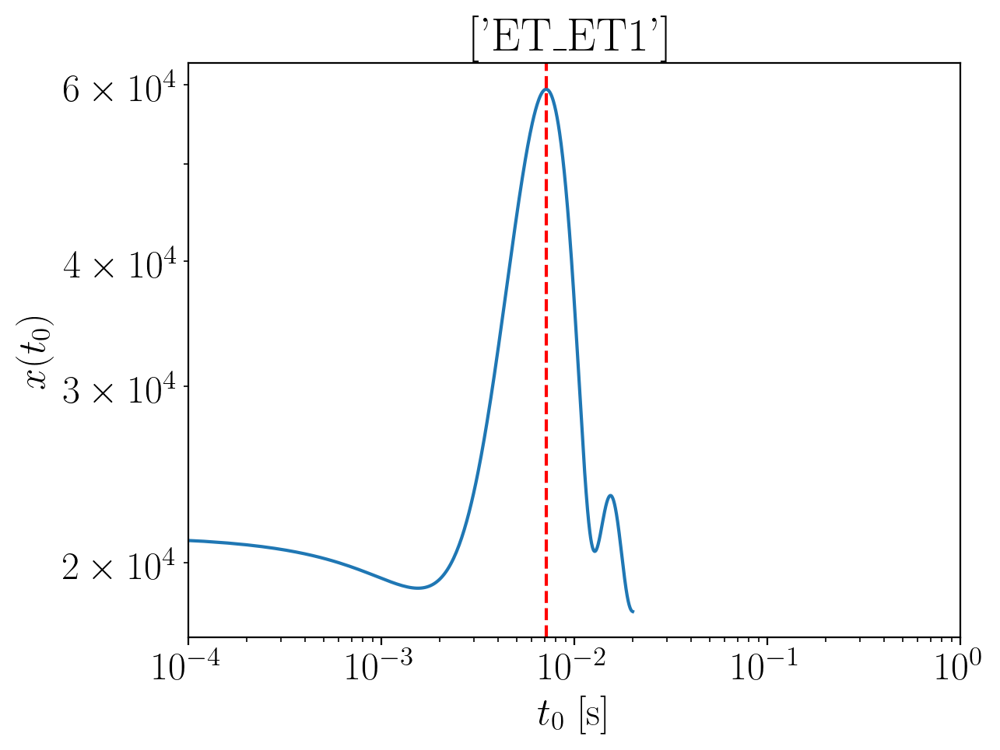

2024-01-15 16:12:25,196 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:25,211 - Network - INFO : PSDs loaded.
2024-01-15 16:12:25,216 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:25,223 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:25,228 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.2456037829711457
Inner product:
0.9996063833880358


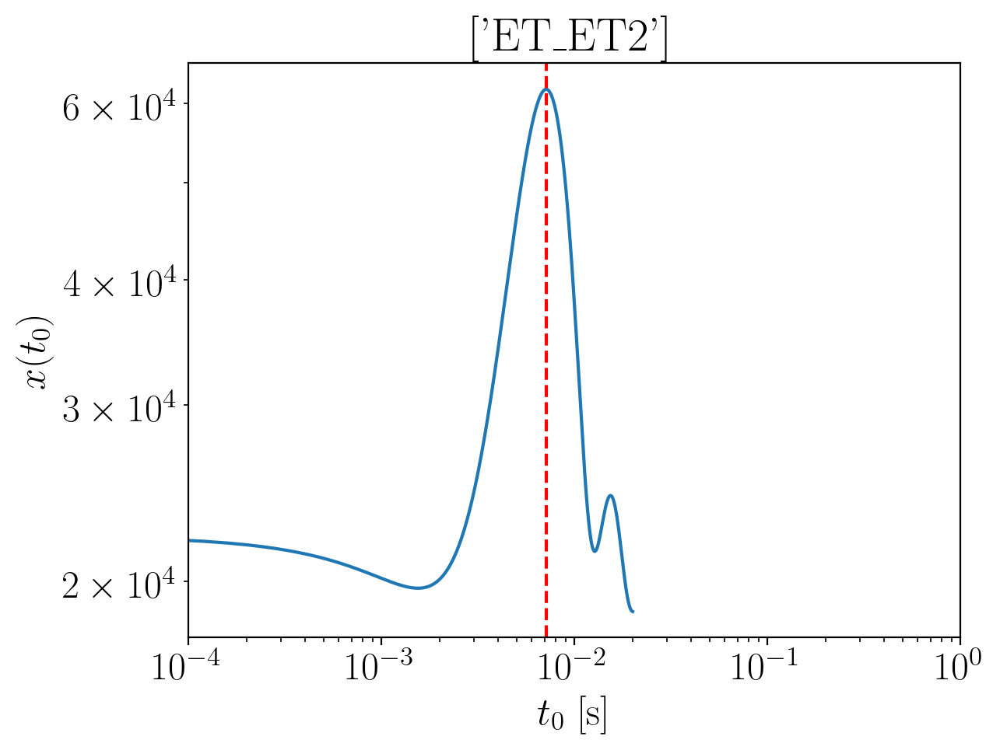

2024-01-15 16:12:26,635 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:26,648 - Network - INFO : PSDs loaded.
2024-01-15 16:12:26,650 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:26,655 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:26,660 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.2456037829711453
Inner product:
0.9996063833880359


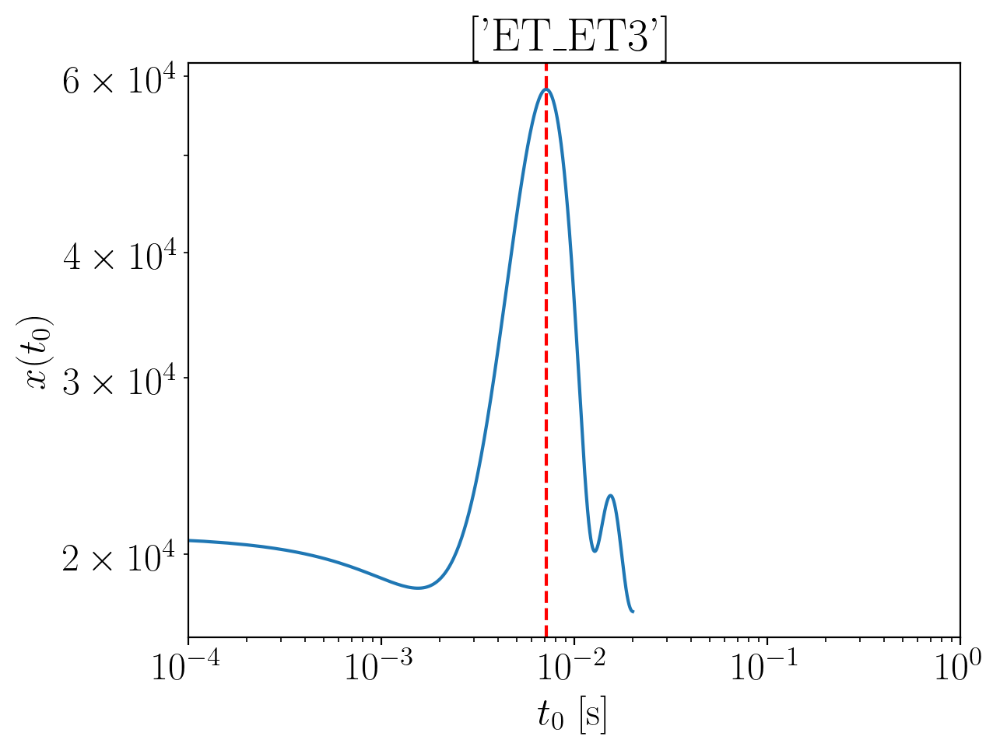

2024-01-15 16:12:28,105 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:28,121 - Network - INFO : PSDs loaded.
2024-01-15 16:12:28,128 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:28,163 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:28,172 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:28,205 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:28,210 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:12:28,217 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.2456037829711457
Inner product:
0.9996063833880359


2024-01-15 16:12:33,641 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:12:33,687 - Network - INFO : PSDs loaded.
2024-01-15 16:12:33,705 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:33,736 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:33,738 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:12:33,739 - Network - INFO :    CE-40_C
2024-01-15 16:12:37,293 - Network - INFO :    CE-20_S
2024-01-15 16:12:40,873 - Network - INFO :    ET_ET1
2024-01-15 16:12:44,443 - Network - INFO :    ET_ET2
2024-01-15 16:12:48,077 - Network - INFO :    ET_ET3
2024-01-15 16:12:51,721 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:12:51,728 - Network - INFO : SNRs calculated.
2024-01-15 16:12:51,728 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:12:51,728 - Network - INFO :    CE-40_C
2024-01-15 16:12:51,822 - Network - INFO :

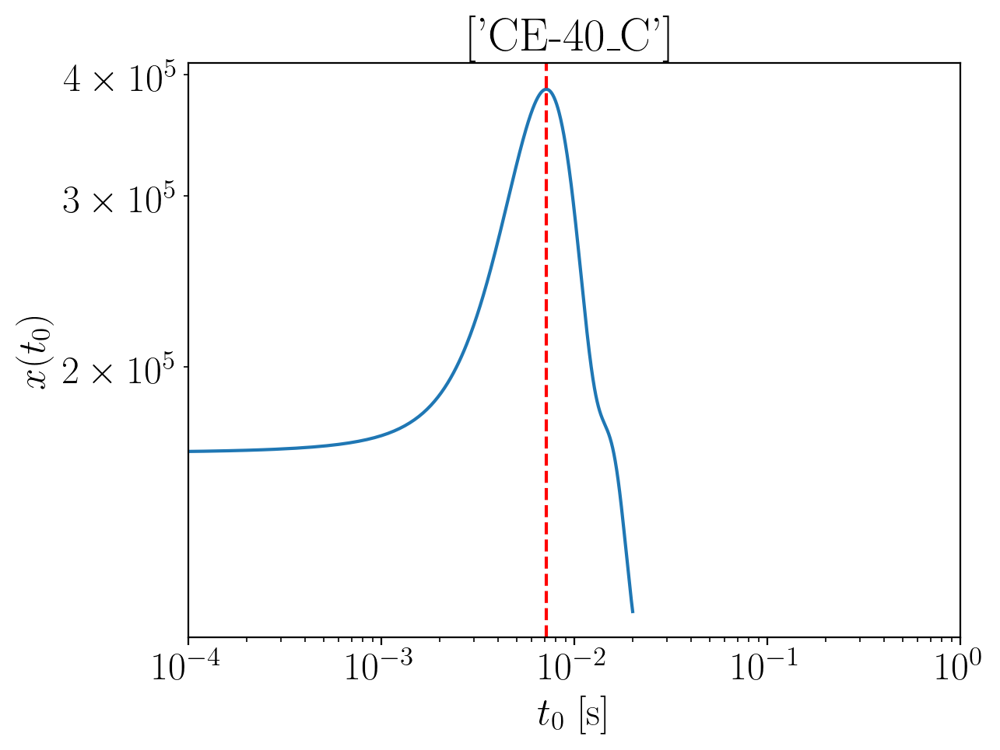

2024-01-15 16:12:53,559 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:53,565 - Network - INFO : PSDs loaded.
2024-01-15 16:12:53,567 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:53,572 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:53,577 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.2029366027182347
Inner product:
0.9996417381682167


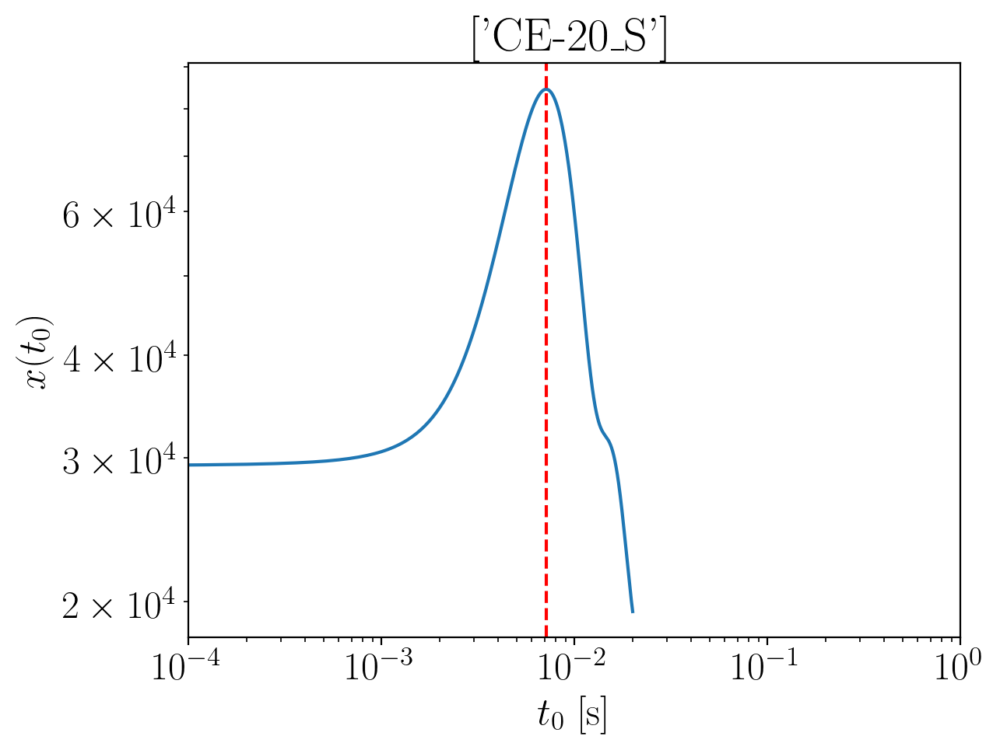

2024-01-15 16:12:54,817 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:54,824 - Network - INFO : PSDs loaded.
2024-01-15 16:12:54,826 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:54,831 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:54,836 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.2051040159180544
Inner product:
0.9995904314960874


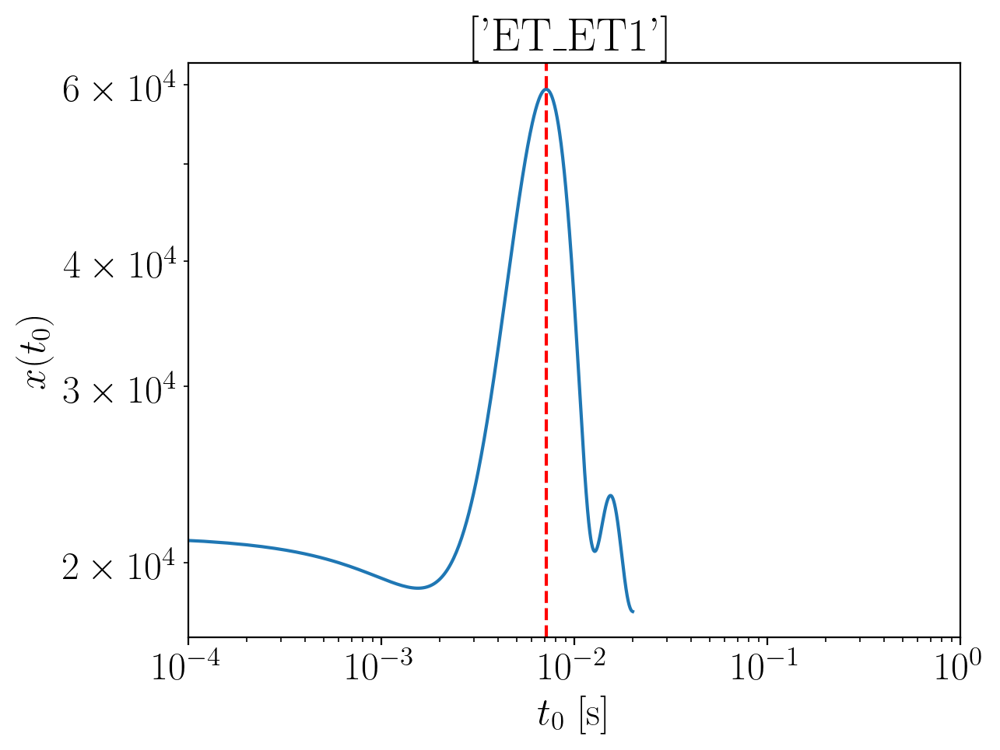

2024-01-15 16:12:56,250 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:56,263 - Network - INFO : PSDs loaded.
2024-01-15 16:12:56,266 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:56,271 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:56,275 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.195892939054406
Inner product:
0.9996063833880358


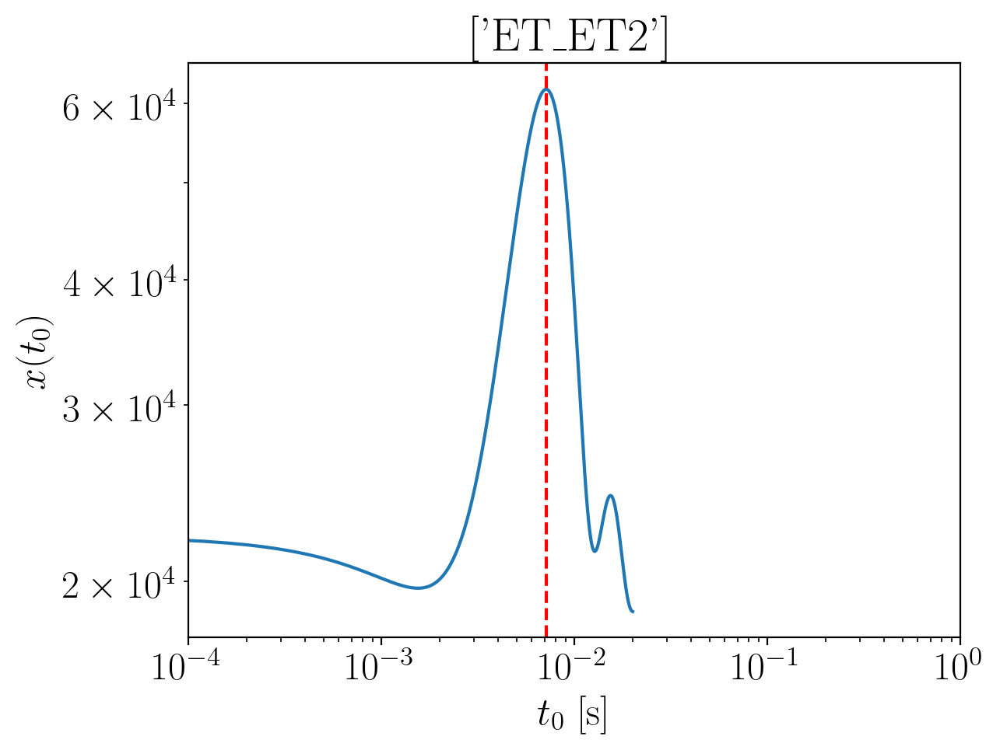

2024-01-15 16:12:57,703 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:57,717 - Network - INFO : PSDs loaded.
2024-01-15 16:12:57,719 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:57,726 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:57,731 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.195892939054406
Inner product:
0.9996063833880358


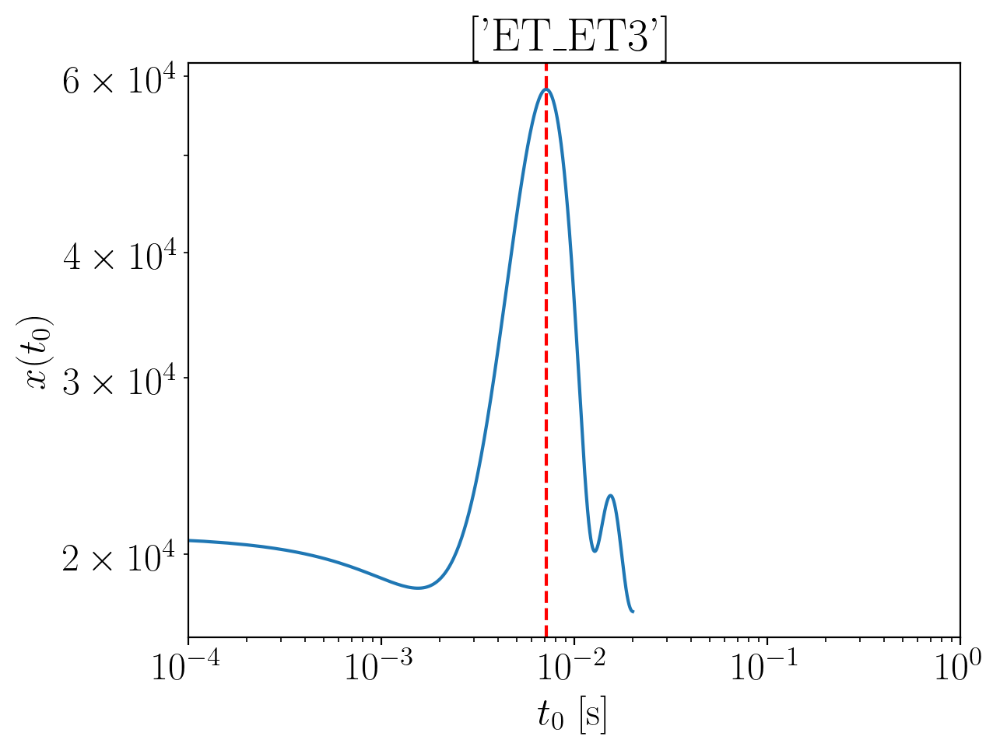

2024-01-15 16:12:59,142 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.195892939054406


2024-01-15 16:12:59,345 - Network - INFO : PSDs loaded.
2024-01-15 16:12:59,348 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:12:59,353 - Network - INFO : Detector responses calculated.
2024-01-15 16:12:59,358 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:59,424 - Network - INFO : Polarizations calculated.
2024-01-15 16:12:59,428 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:12:59,437 - Network - INFO : Polarizations calculated.


Inner product:
0.9996063833880356


2024-01-15 16:13:04,761 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:13:04,807 - Network - INFO : PSDs loaded.
2024-01-15 16:13:04,813 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:04,828 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:04,829 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:13:04,829 - Network - INFO :    CE-40_C
2024-01-15 16:13:08,553 - Network - INFO :    CE-20_S
2024-01-15 16:13:12,143 - Network - INFO :    ET_ET1
2024-01-15 16:13:15,697 - Network - INFO :    ET_ET2
2024-01-15 16:13:19,252 - Network - INFO :    ET_ET3
2024-01-15 16:13:22,815 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:13:22,822 - Network - INFO : SNRs calculated.
2024-01-15 16:13:22,822 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:13:22,823 - Network - INFO :    CE-40_C
2024-01-15 16:13:22,916 - Network - INFO :

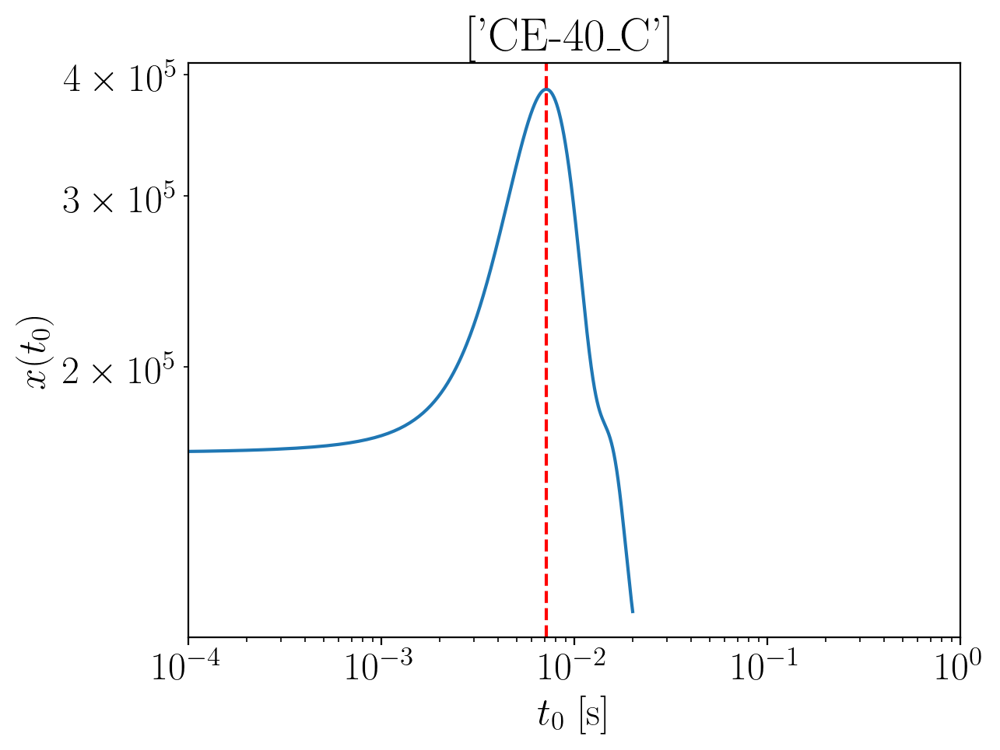

2024-01-15 16:13:24,661 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:24,667 - Network - INFO : PSDs loaded.
2024-01-15 16:13:24,669 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:24,674 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:24,679 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.154984837751317
Inner product:
0.9996417381682167


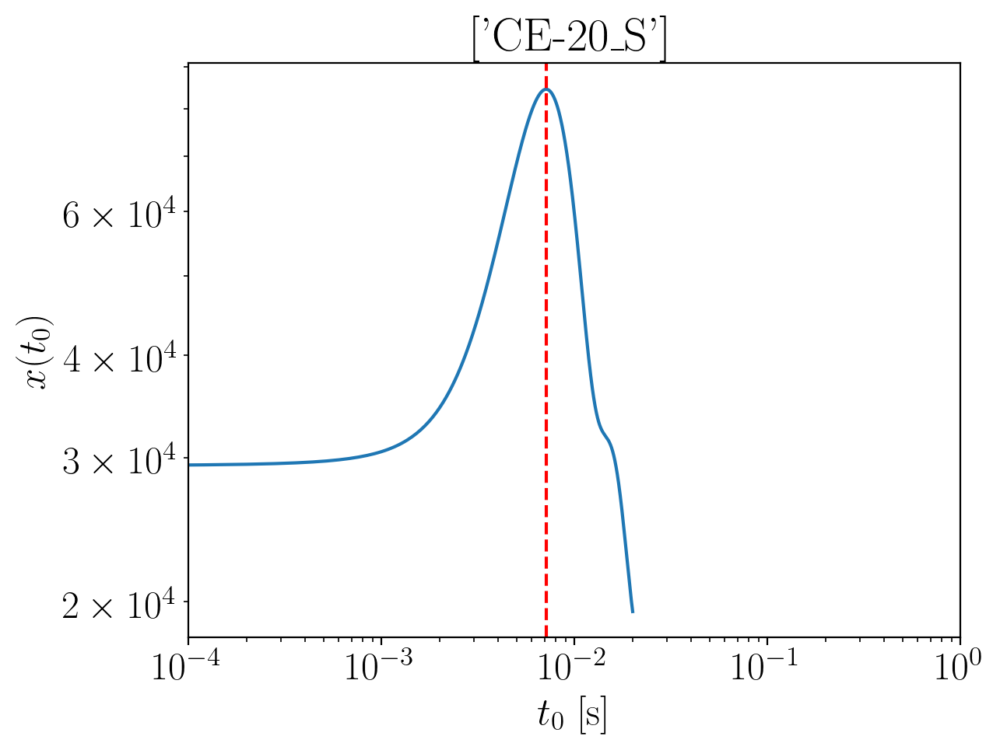

2024-01-15 16:13:25,843 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:25,849 - Network - INFO : PSDs loaded.
2024-01-15 16:13:25,851 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:25,856 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:25,861 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1571522509511367
Inner product:
0.9995904314960874


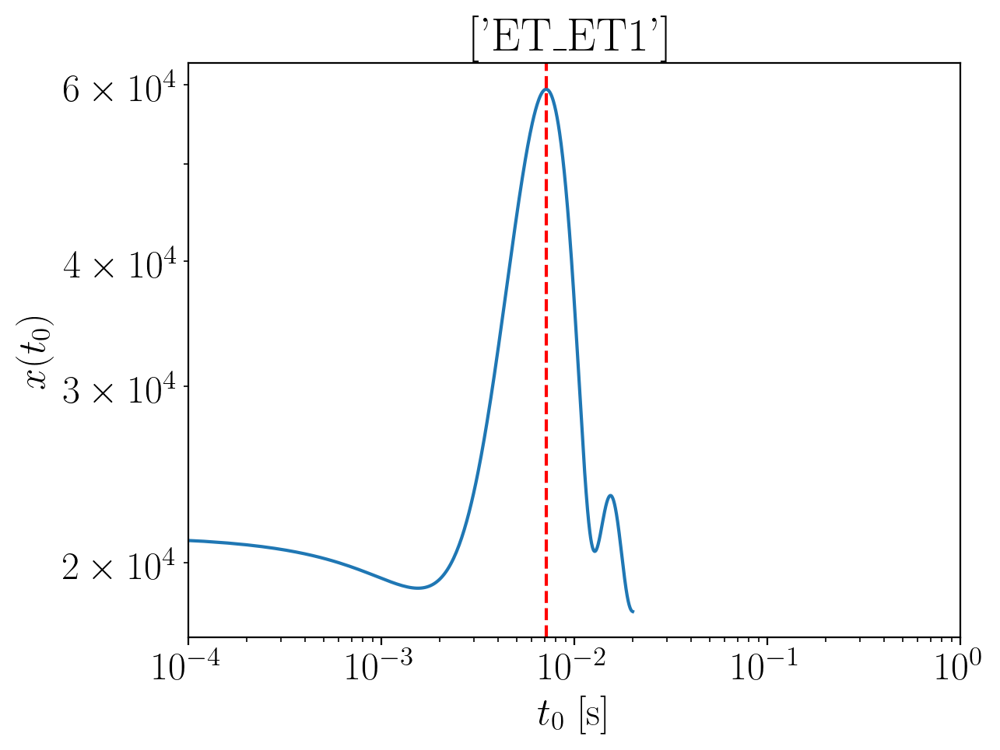

2024-01-15 16:13:27,266 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:27,279 - Network - INFO : PSDs loaded.
2024-01-15 16:13:27,280 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:27,286 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:27,290 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.147941174087486
Inner product:
0.9996063833880358


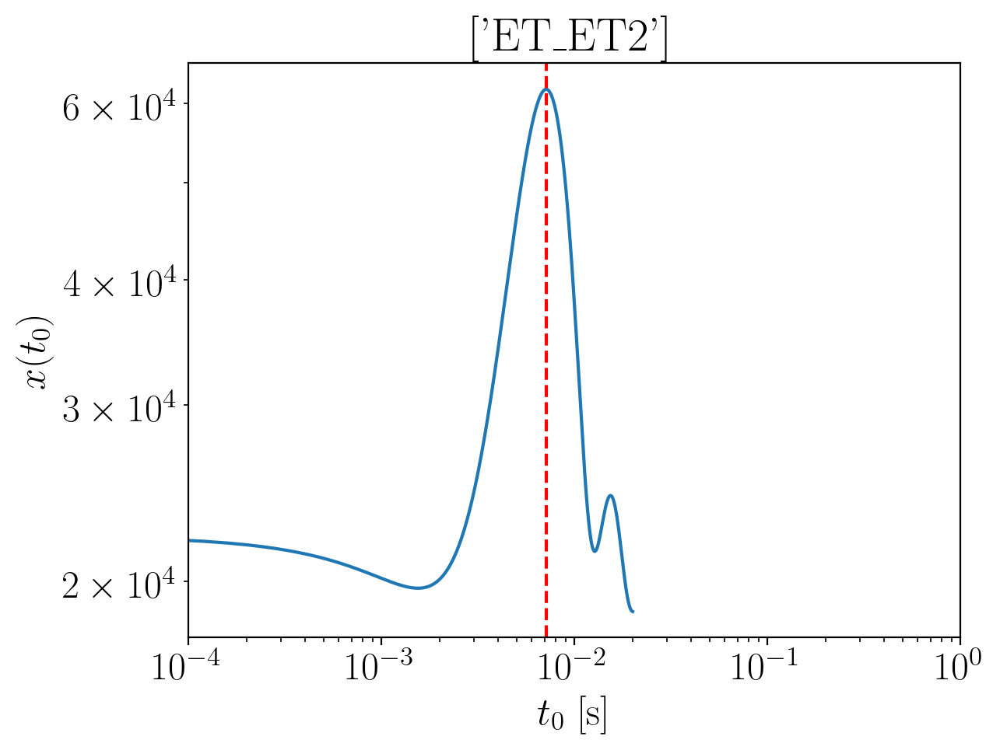

2024-01-15 16:13:28,813 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:28,832 - Network - INFO : PSDs loaded.
2024-01-15 16:13:28,835 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:28,842 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:28,852 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1479411740874865
Inner product:
0.9996063833880358


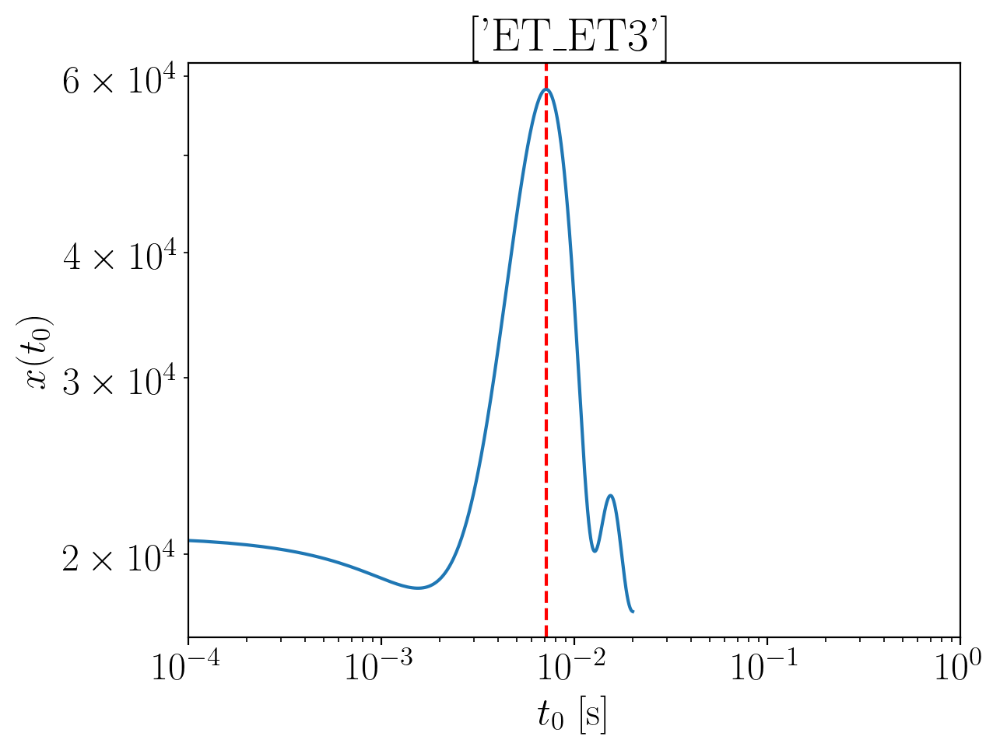

2024-01-15 16:13:30,274 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:30,293 - Network - INFO : PSDs loaded.
2024-01-15 16:13:30,303 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:30,339 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:30,360 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:30,392 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:30,403 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:13:30,412 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1479411740874865
Inner product:
0.9996063833880356


2024-01-15 16:13:35,803 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:13:35,847 - Network - INFO : PSDs loaded.
2024-01-15 16:13:35,853 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:35,898 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:35,899 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:13:35,900 - Network - INFO :    CE-40_C
2024-01-15 16:13:39,476 - Network - INFO :    CE-20_S
2024-01-15 16:13:43,064 - Network - INFO :    ET_ET1
2024-01-15 16:13:46,618 - Network - INFO :    ET_ET2
2024-01-15 16:13:50,212 - Network - INFO :    ET_ET3
2024-01-15 16:13:53,836 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:13:53,842 - Network - INFO : SNRs calculated.
2024-01-15 16:13:53,842 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:13:53,843 - Network - INFO :    CE-40_C
2024-01-15 16:13:53,936 - Network - INFO :

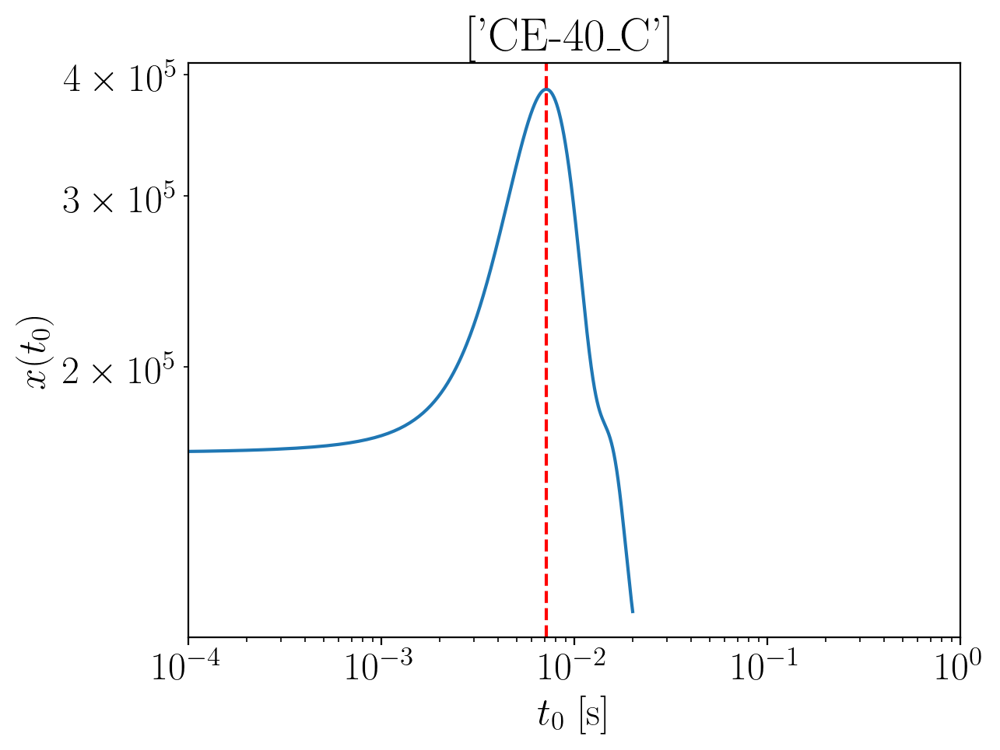

2024-01-15 16:13:55,680 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:55,687 - Network - INFO : PSDs loaded.
2024-01-15 16:13:55,689 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:55,694 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:55,699 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.108180220013507
Inner product:
0.9996417381682167


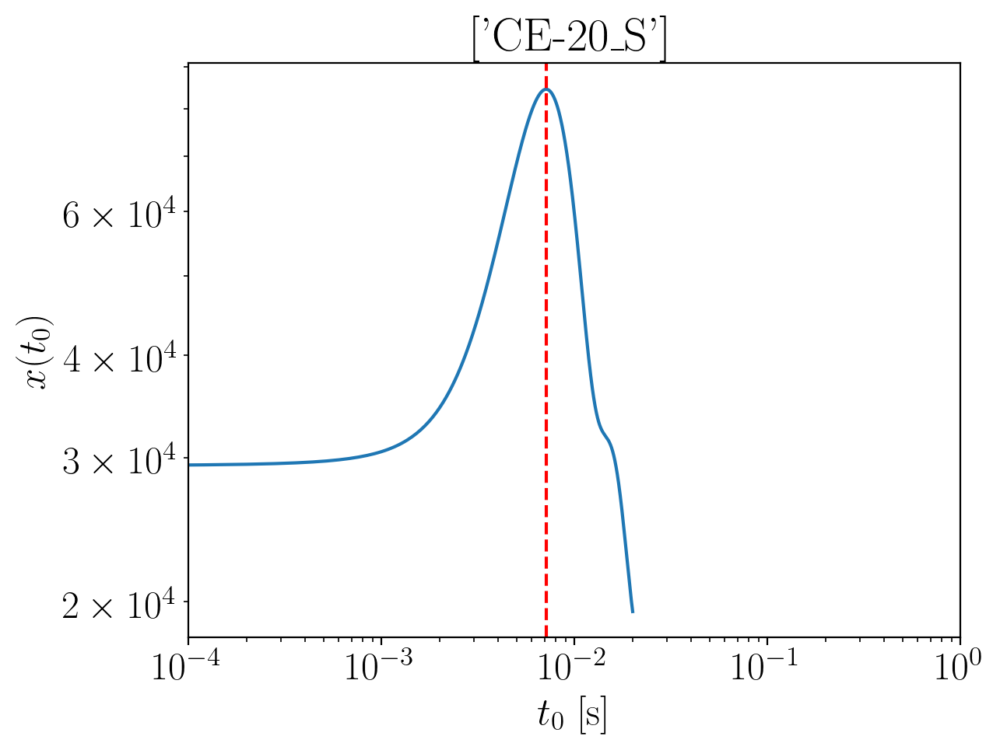

2024-01-15 16:13:57,112 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:57,119 - Network - INFO : PSDs loaded.
2024-01-15 16:13:57,122 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:57,132 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:57,137 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.110347633213327
Inner product:
0.9995904314960874


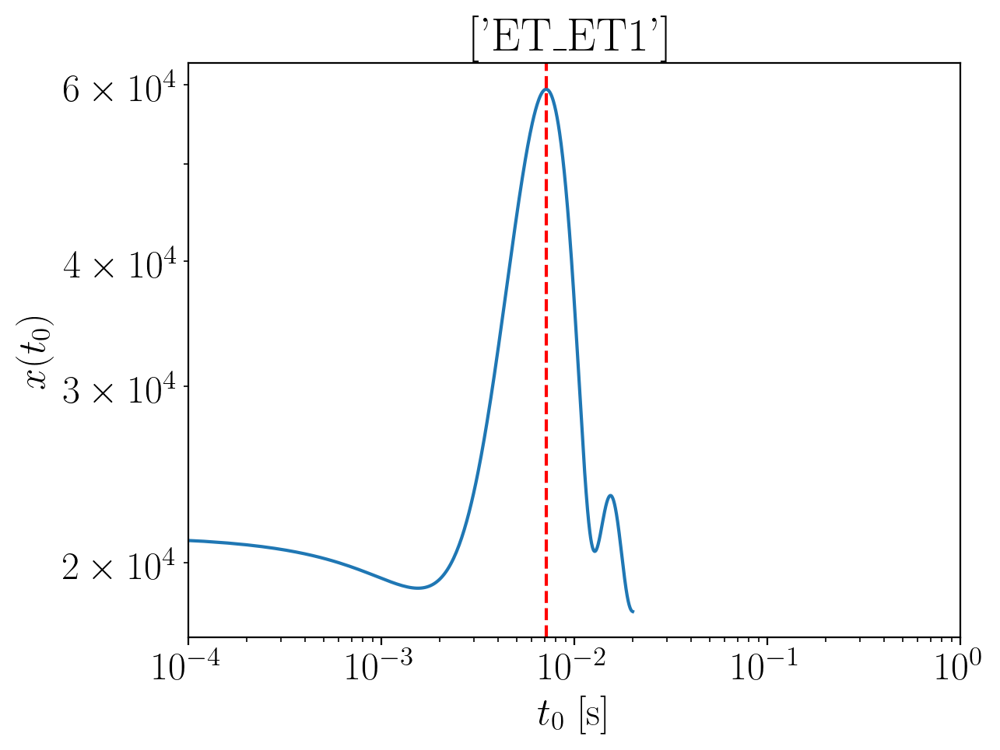

2024-01-15 16:13:58,547 - Network - INFO : Polarizations calculated.
2024-01-15 16:13:58,566 - Network - INFO : PSDs loaded.
2024-01-15 16:13:58,568 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:13:58,573 - Network - INFO : Detector responses calculated.
2024-01-15 16:13:58,578 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1011365563496778
Inner product:
0.9996063833880356


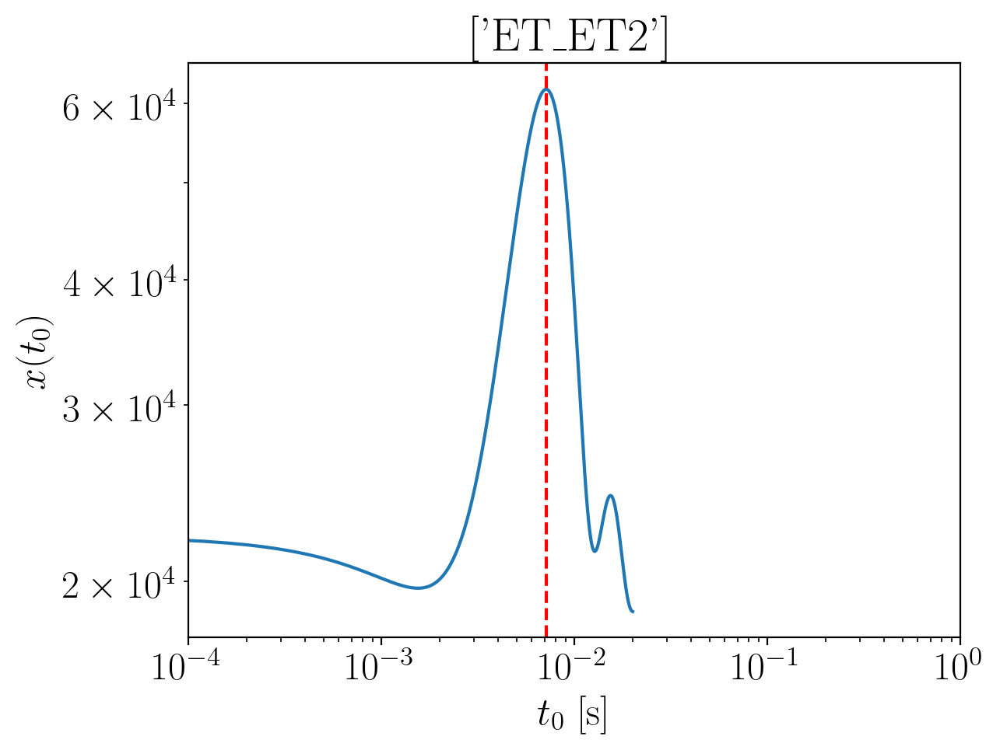

2024-01-15 16:14:00,052 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:00,065 - Network - INFO : PSDs loaded.
2024-01-15 16:14:00,067 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:00,072 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:00,077 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1011365563496778
Inner product:
0.9996063833880358


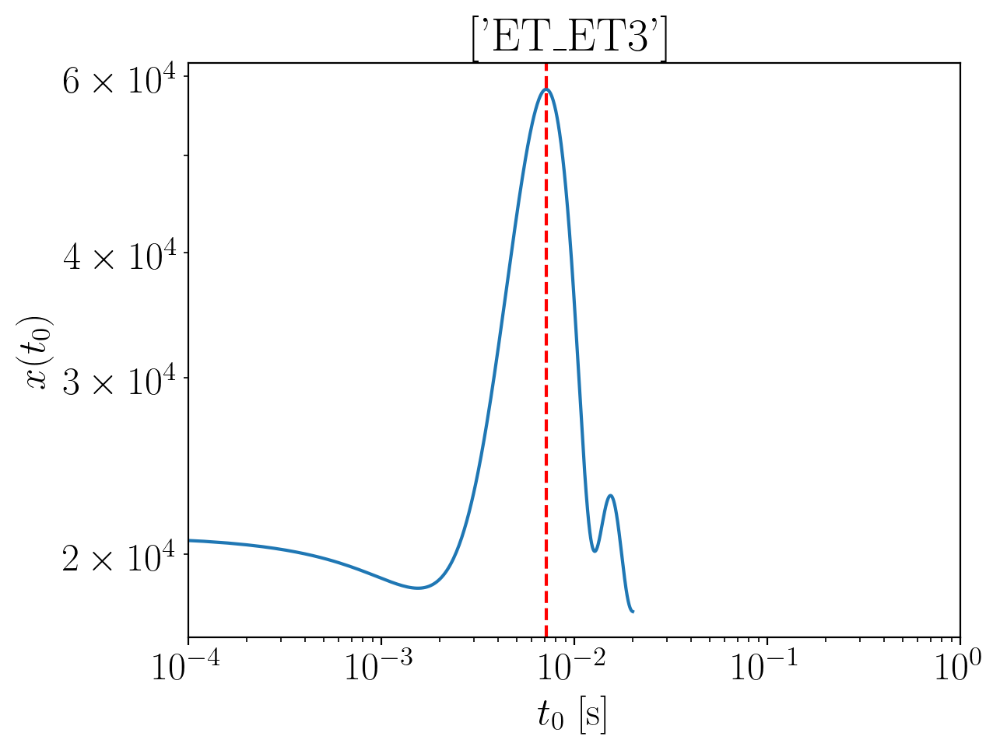

2024-01-15 16:14:01,509 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:01,522 - Network - INFO : PSDs loaded.
2024-01-15 16:14:01,524 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:01,529 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:01,534 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:01,558 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:01,558 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:14:01,564 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.1011365563496778
Inner product:
0.9996063833880355


2024-01-15 16:14:07,036 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:14:07,082 - Network - INFO : PSDs loaded.
2024-01-15 16:14:07,087 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:07,102 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:07,103 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:14:07,103 - Network - INFO :    CE-40_C
2024-01-15 16:14:10,716 - Network - INFO :    CE-20_S
2024-01-15 16:14:14,291 - Network - INFO :    ET_ET1
2024-01-15 16:14:17,875 - Network - INFO :    ET_ET2
2024-01-15 16:14:21,504 - Network - INFO :    ET_ET3
2024-01-15 16:14:25,076 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:14:25,082 - Network - INFO : SNRs calculated.
2024-01-15 16:14:25,083 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:14:25,083 - Network - INFO :    CE-40_C
2024-01-15 16:14:25,177 - Network - INFO :

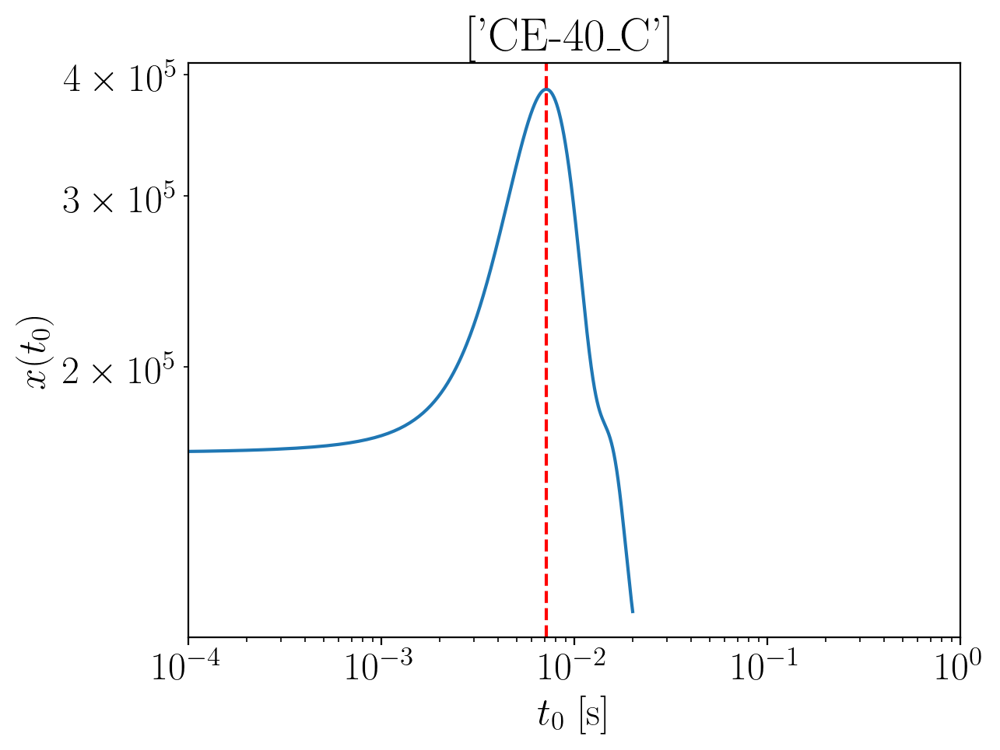

2024-01-15 16:14:26,899 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:26,906 - Network - INFO : PSDs loaded.
2024-01-15 16:14:26,909 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:26,918 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:26,922 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.0621306394315333
Inner product:
0.9996417381682167


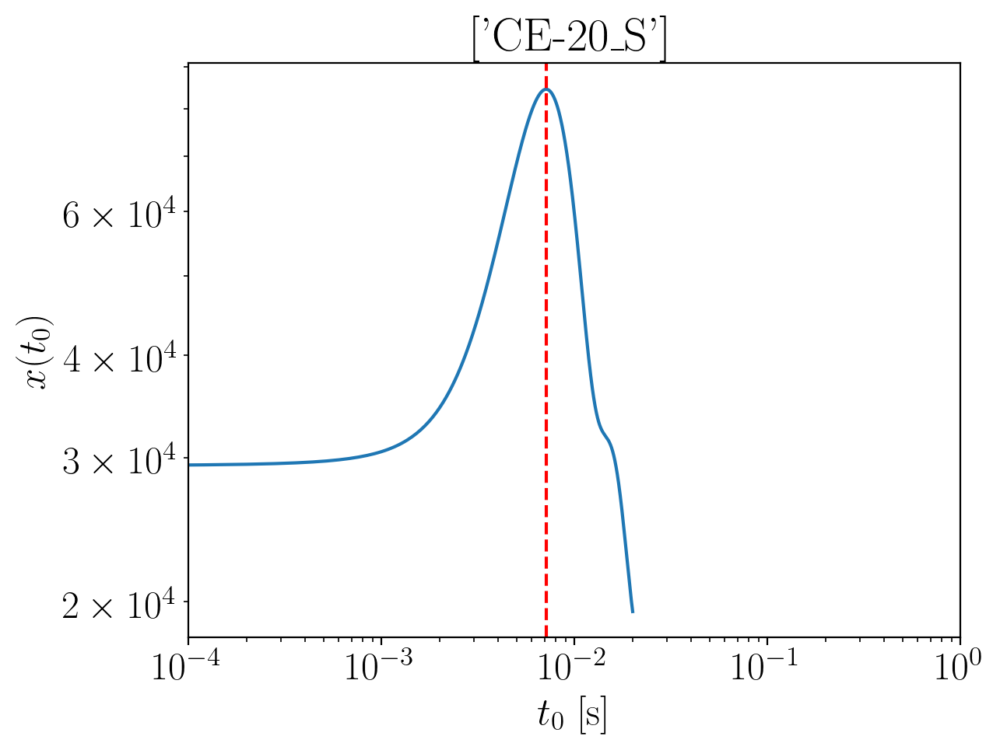

2024-01-15 16:14:28,148 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:28,155 - Network - INFO : PSDs loaded.
2024-01-15 16:14:28,157 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:28,162 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:28,168 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.064298052631353
Inner product:
0.9995904314960874


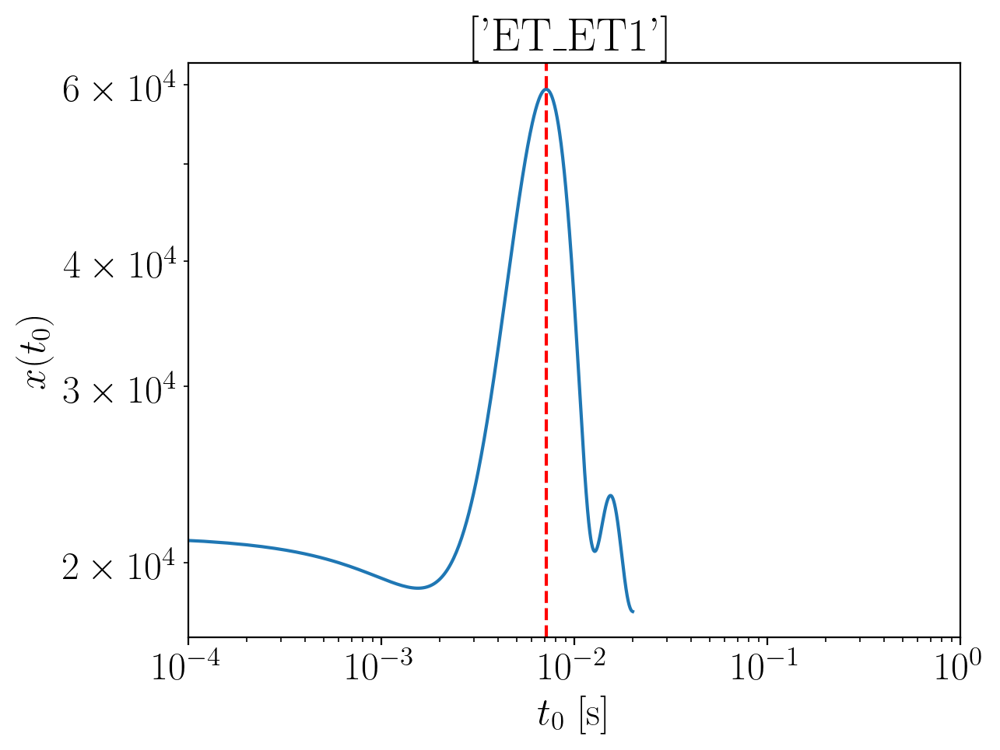

2024-01-15 16:14:29,591 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:29,604 - Network - INFO : PSDs loaded.
2024-01-15 16:14:29,606 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:29,611 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:29,616 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.055086975767704
Inner product:
0.9996063833880358


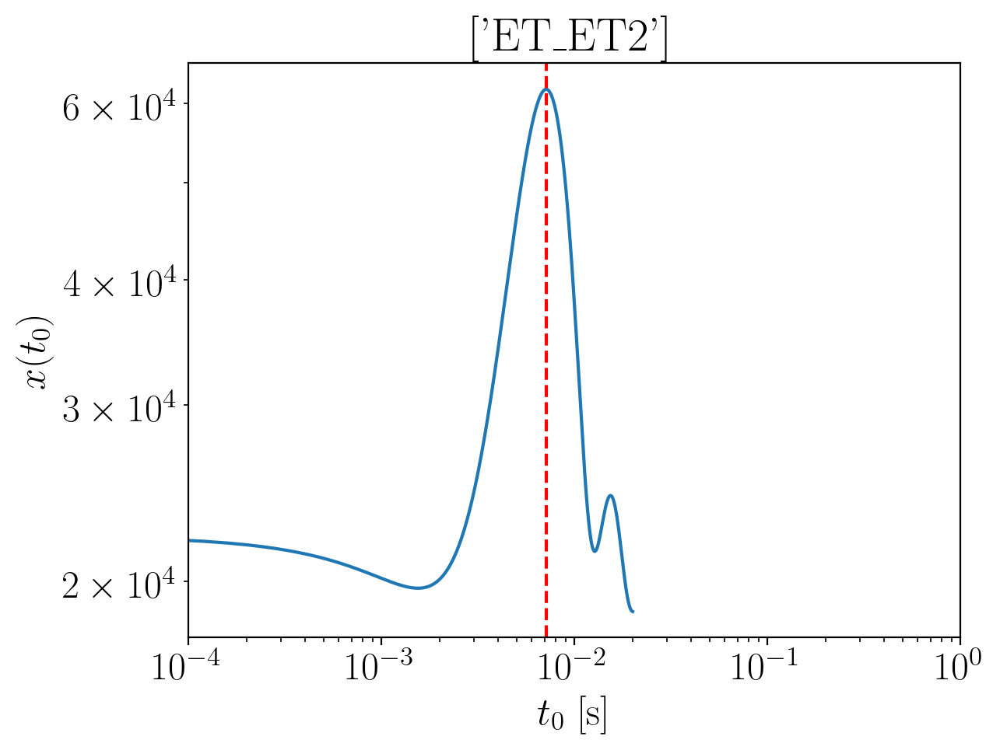

2024-01-15 16:14:31,212 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:31,227 - Network - INFO : PSDs loaded.
2024-01-15 16:14:31,230 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:31,235 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:31,239 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.055086975767704
Inner product:
0.9996063833880358


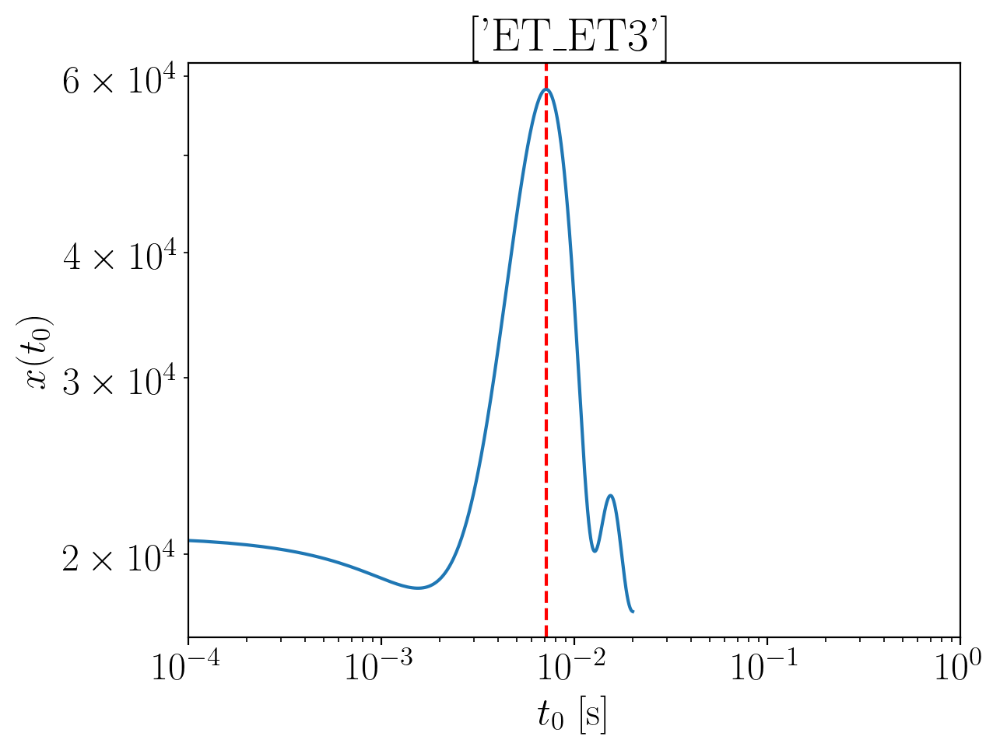

2024-01-15 16:14:32,643 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:32,658 - Network - INFO : PSDs loaded.
2024-01-15 16:14:32,661 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:32,667 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:32,674 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:32,699 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:32,705 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:14:32,718 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.055086975767704
Inner product:
0.9996063833880356


2024-01-15 16:14:38,171 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:14:38,215 - Network - INFO : PSDs loaded.
2024-01-15 16:14:38,221 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:38,236 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:38,237 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:14:38,238 - Network - INFO :    CE-40_C
2024-01-15 16:14:41,978 - Network - INFO :    CE-20_S
2024-01-15 16:14:45,578 - Network - INFO :    ET_ET1
2024-01-15 16:14:49,162 - Network - INFO :    ET_ET2
2024-01-15 16:14:52,748 - Network - INFO :    ET_ET3
2024-01-15 16:14:56,307 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:14:56,314 - Network - INFO : SNRs calculated.
2024-01-15 16:14:56,314 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:14:56,315 - Network - INFO :    CE-40_C
2024-01-15 16:14:56,409 - Network - INFO :

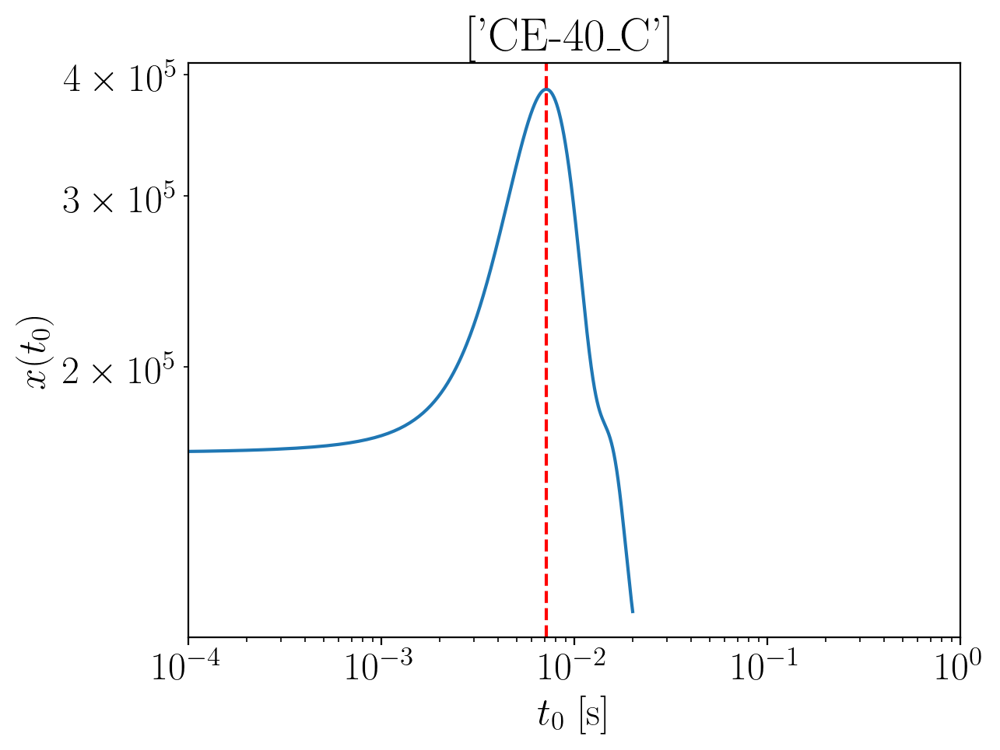

2024-01-15 16:14:58,158 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:58,168 - Network - INFO : PSDs loaded.
2024-01-15 16:14:58,170 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:58,178 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:58,183 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.016570720011393
Inner product:
0.9996417381682167


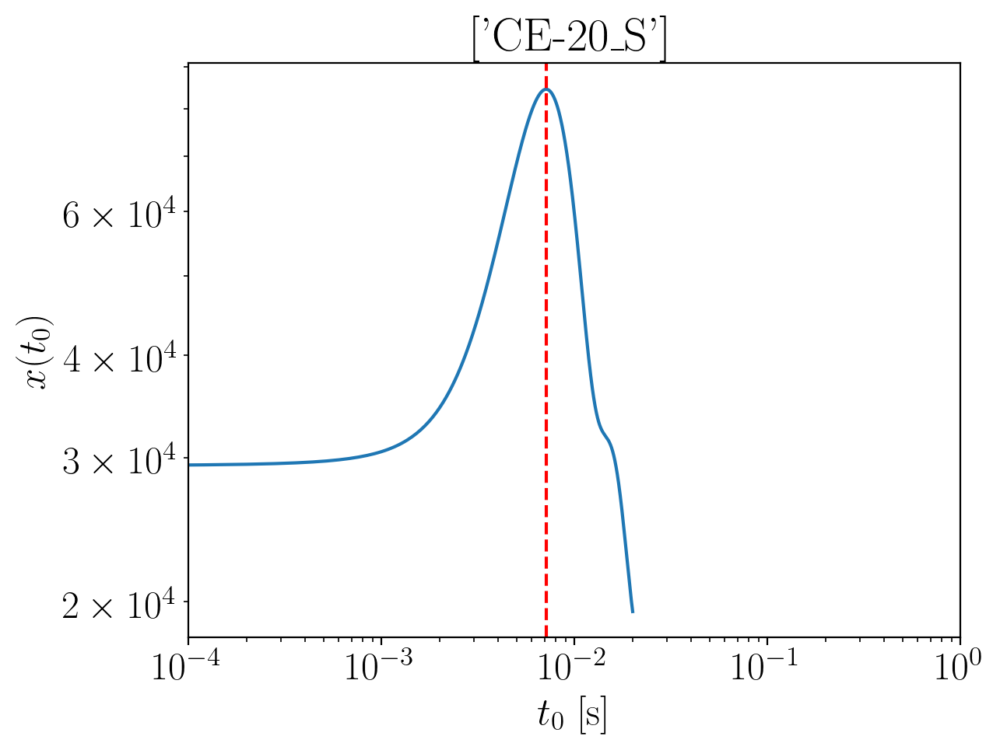

2024-01-15 16:14:59,343 - Network - INFO : Polarizations calculated.
2024-01-15 16:14:59,350 - Network - INFO : PSDs loaded.
2024-01-15 16:14:59,352 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:14:59,357 - Network - INFO : Detector responses calculated.
2024-01-15 16:14:59,362 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.0187381332112126
Inner product:
0.9995904314960874


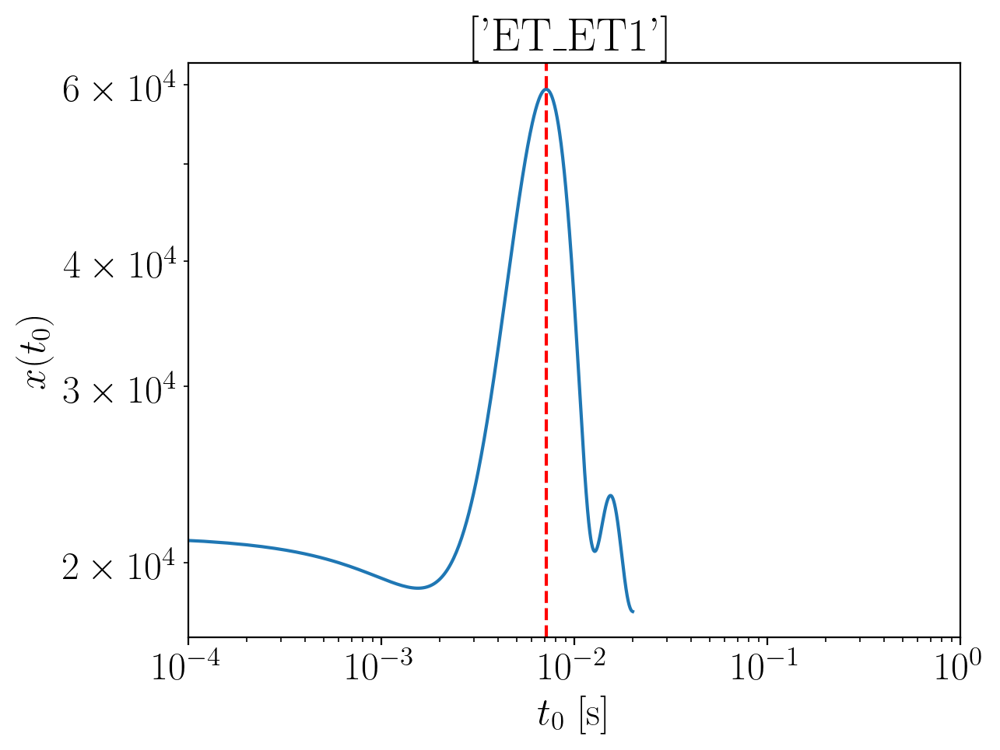

2024-01-15 16:15:00,709 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:00,723 - Network - INFO : PSDs loaded.
2024-01-15 16:15:00,724 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:00,730 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:00,735 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.009527056347563
Inner product:
0.9996063833880358


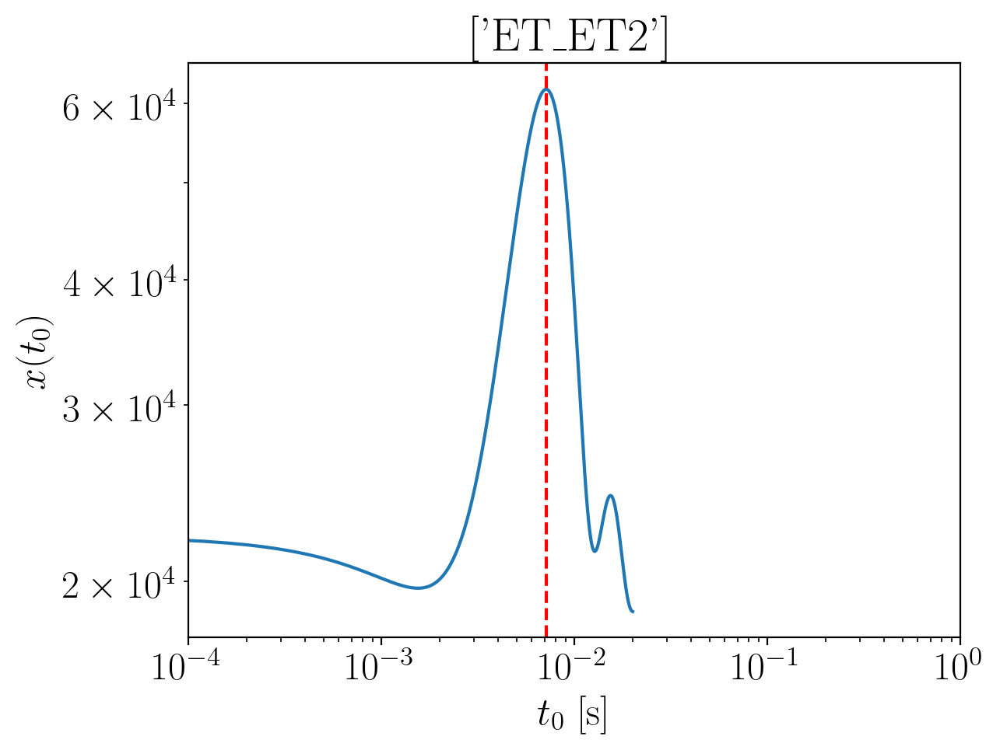

2024-01-15 16:15:02,157 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:02,176 - Network - INFO : PSDs loaded.
2024-01-15 16:15:02,179 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:02,184 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:02,190 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.0095270563475633
Inner product:
0.9996063833880358


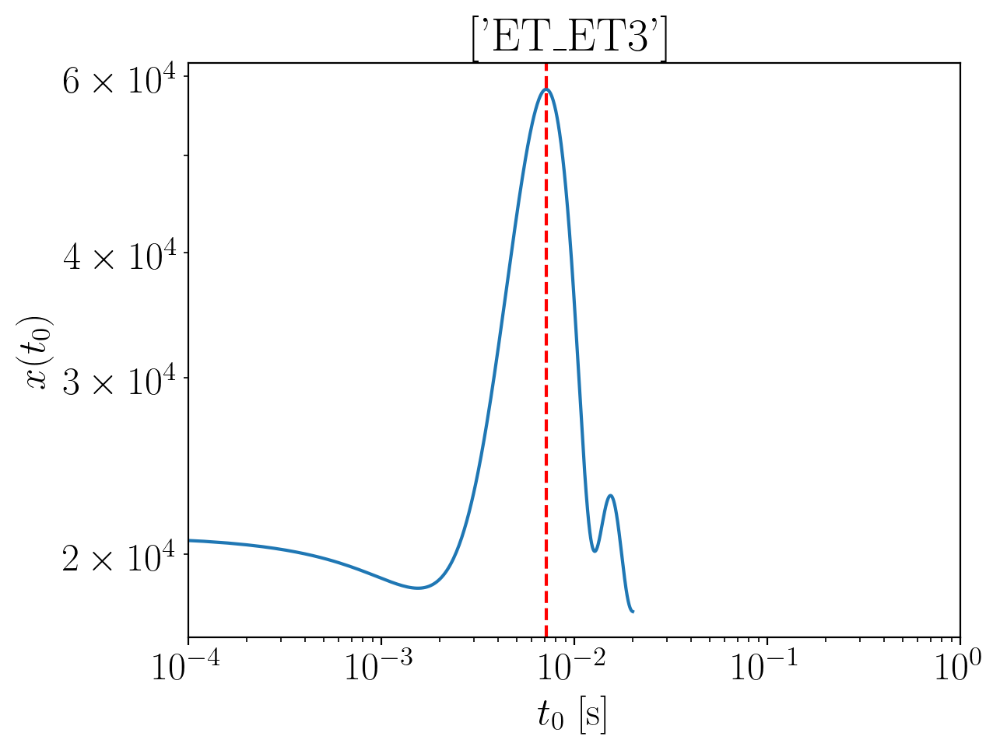

2024-01-15 16:15:03,606 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:03,619 - Network - INFO : PSDs loaded.
2024-01-15 16:15:03,621 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:03,626 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:03,631 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:03,653 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:03,654 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:15:03,659 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -2.0095270563475633
Inner product:
0.9996063833880355


2024-01-15 16:15:09,153 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:15:09,197 - Network - INFO : PSDs loaded.
2024-01-15 16:15:09,203 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:09,218 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:09,227 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:15:09,235 - Network - INFO :    CE-40_C
2024-01-15 16:15:12,839 - Network - INFO :    CE-20_S
2024-01-15 16:15:16,396 - Network - INFO :    ET_ET1
2024-01-15 16:15:19,951 - Network - INFO :    ET_ET2
2024-01-15 16:15:23,516 - Network - INFO :    ET_ET3
2024-01-15 16:15:27,077 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:15:27,083 - Network - INFO : SNRs calculated.
2024-01-15 16:15:27,084 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:15:27,084 - Network - INFO :    CE-40_C
2024-01-15 16:15:27,178 - Network - INFO :

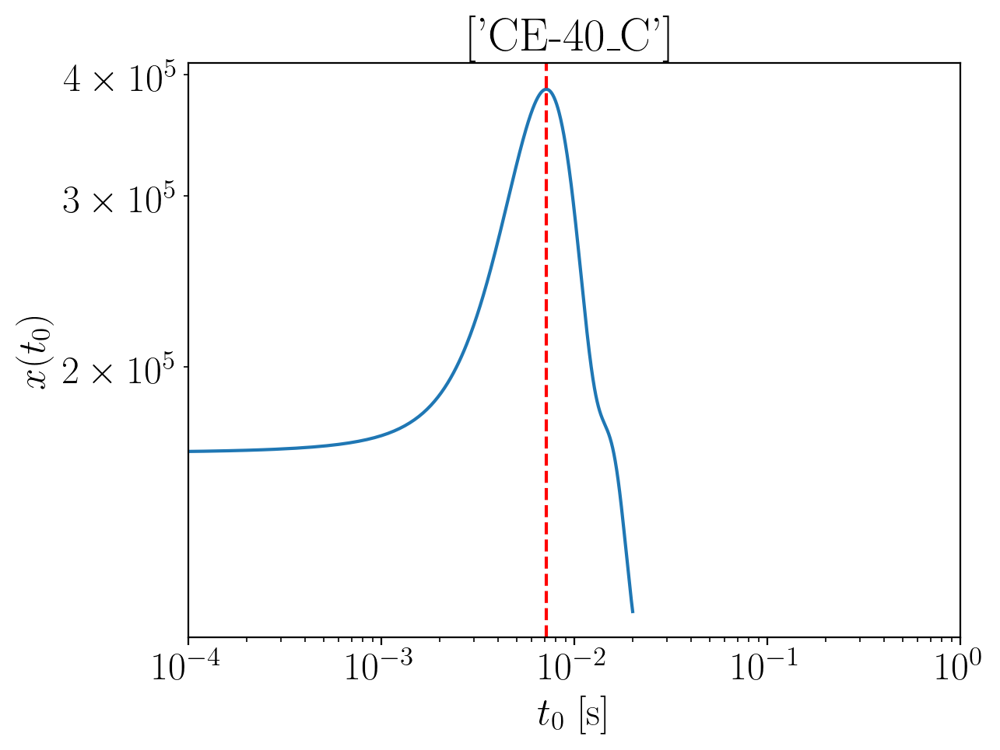

2024-01-15 16:15:29,011 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:29,024 - Network - INFO : PSDs loaded.
2024-01-15 16:15:29,026 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:29,031 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:29,037 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.9713142388061586
Inner product:
0.9996417381682167


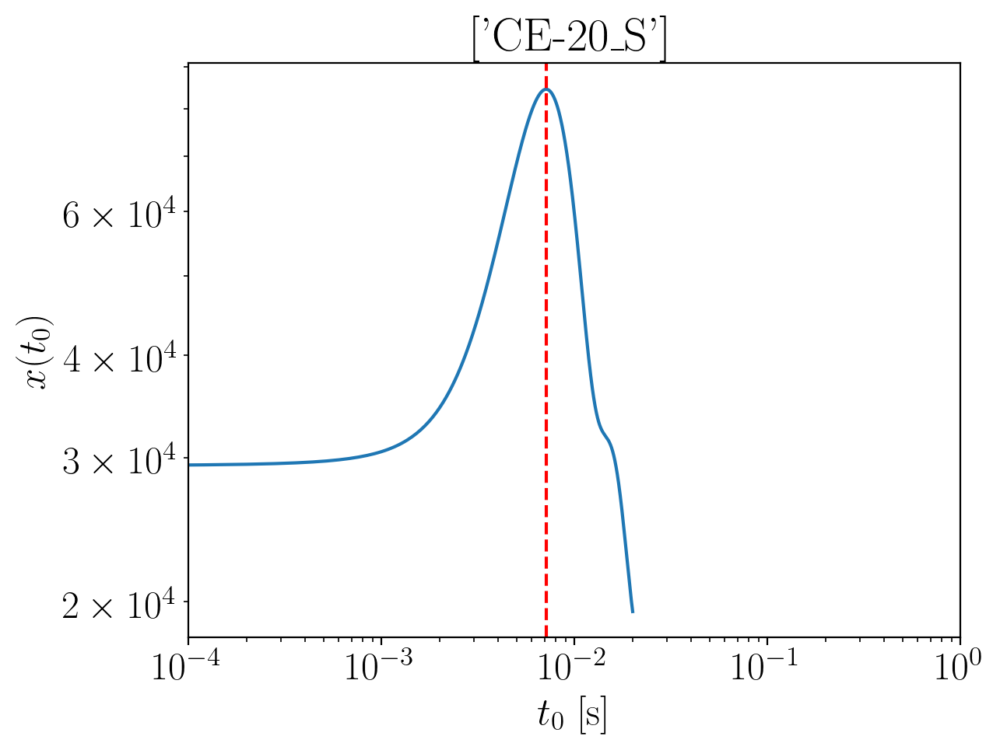

2024-01-15 16:15:30,248 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:30,255 - Network - INFO : PSDs loaded.
2024-01-15 16:15:30,257 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:30,262 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:30,267 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.9734816520059784
Inner product:
0.9995904314960874


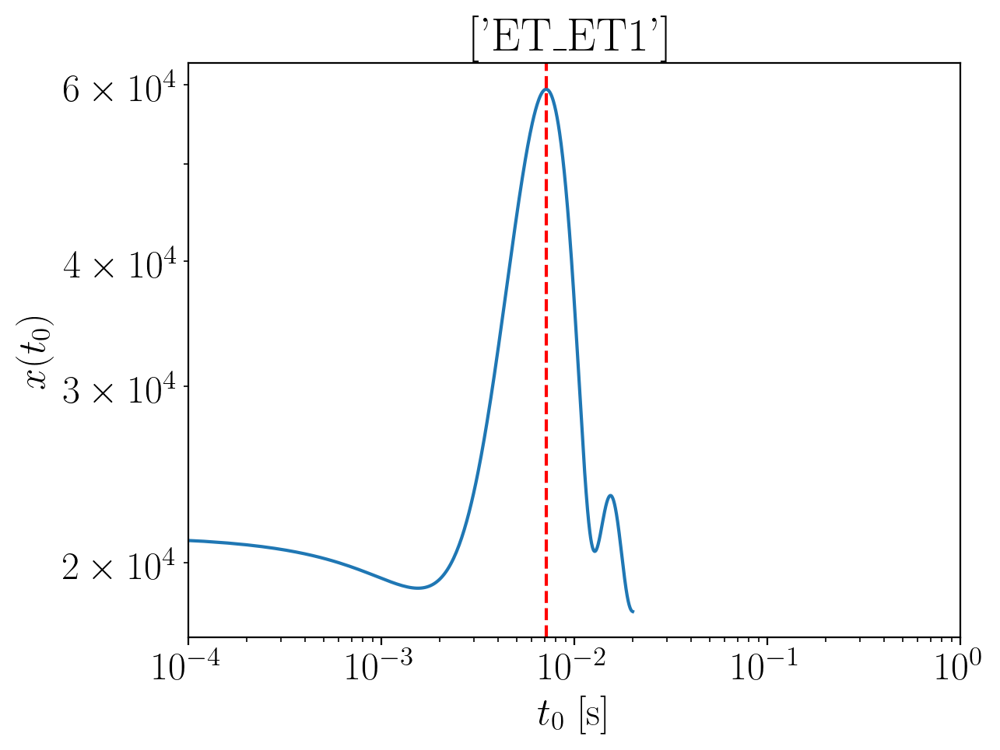

2024-01-15 16:15:31,686 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:31,699 - Network - INFO : PSDs loaded.
2024-01-15 16:15:31,701 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:31,706 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:31,711 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.964270575142329
Inner product:
0.9996063833880358


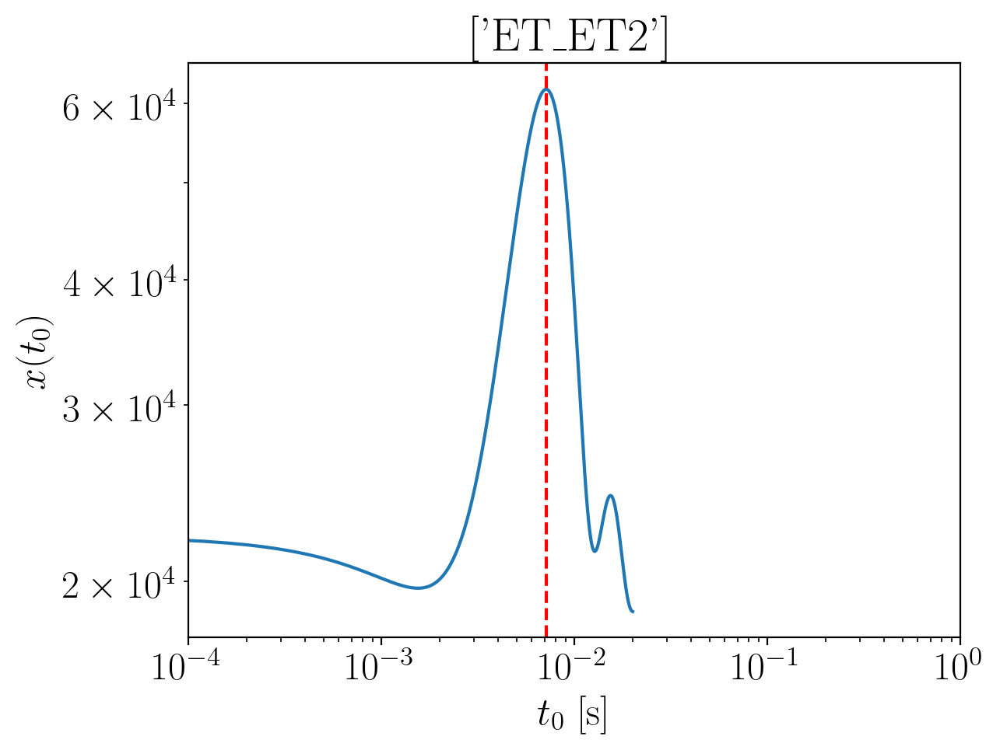

2024-01-15 16:15:33,137 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:33,150 - Network - INFO : PSDs loaded.
2024-01-15 16:15:33,152 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:33,158 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:33,163 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.964270575142329
Inner product:
0.9996063833880358


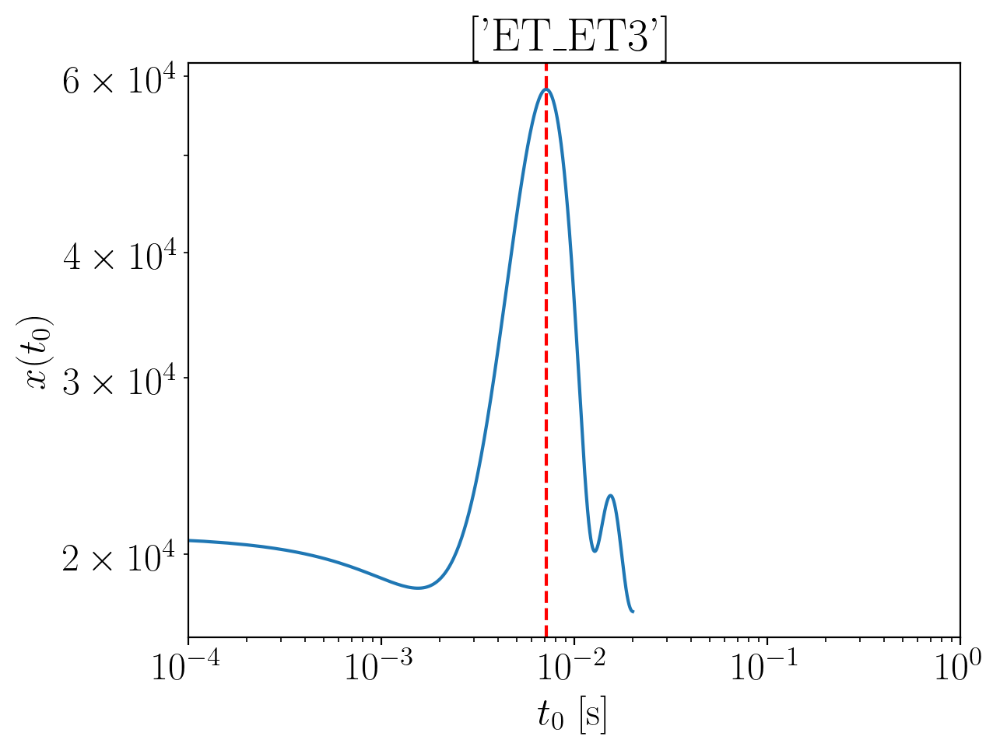

2024-01-15 16:15:34,655 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:34,668 - Network - INFO : PSDs loaded.
2024-01-15 16:15:34,671 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:34,677 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:34,683 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:34,719 - Network - INFO : Polarizations calculated.
2024-01-15 16:15:34,723 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:15:34,735 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.964270575142329
Inner product:
0.9996063833880356


2024-01-15 16:15:40,152 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:15:40,197 - Network - INFO : PSDs loaded.
2024-01-15 16:15:40,213 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:15:40,247 - Network - INFO : Detector responses calculated.
2024-01-15 16:15:40,248 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:15:40,248 - Network - INFO :    CE-40_C
2024-01-15 16:15:43,876 - Network - INFO :    CE-20_S
2024-01-15 16:15:47,449 - Network - INFO :    ET_ET1
2024-01-15 16:15:50,998 - Network - INFO :    ET_ET2
2024-01-15 16:15:54,601 - Network - INFO :    ET_ET3
2024-01-15 16:15:58,166 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:15:58,172 - Network - INFO : SNRs calculated.
2024-01-15 16:15:58,172 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:15:58,173 - Network - INFO :    CE-40_C
2024-01-15 16:15:58,266 - Network - INFO :

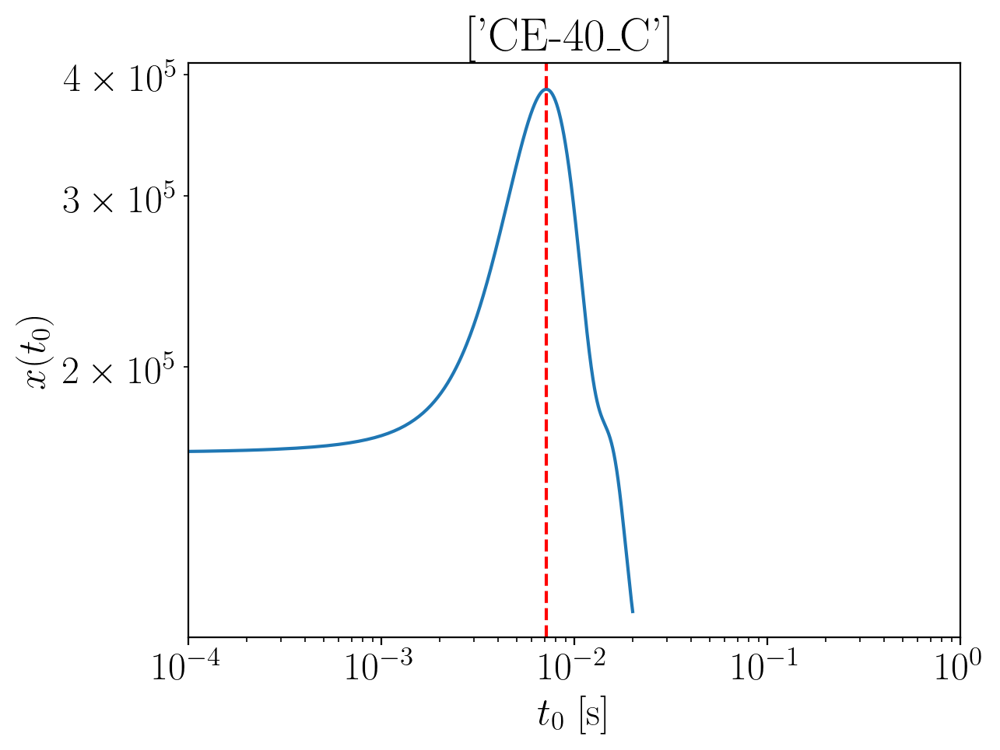

2024-01-15 16:15:59,996 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:00,003 - Network - INFO : PSDs loaded.
2024-01-15 16:16:00,005 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:00,012 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:00,018 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.9262273251939273
Inner product:
0.9996417381682167


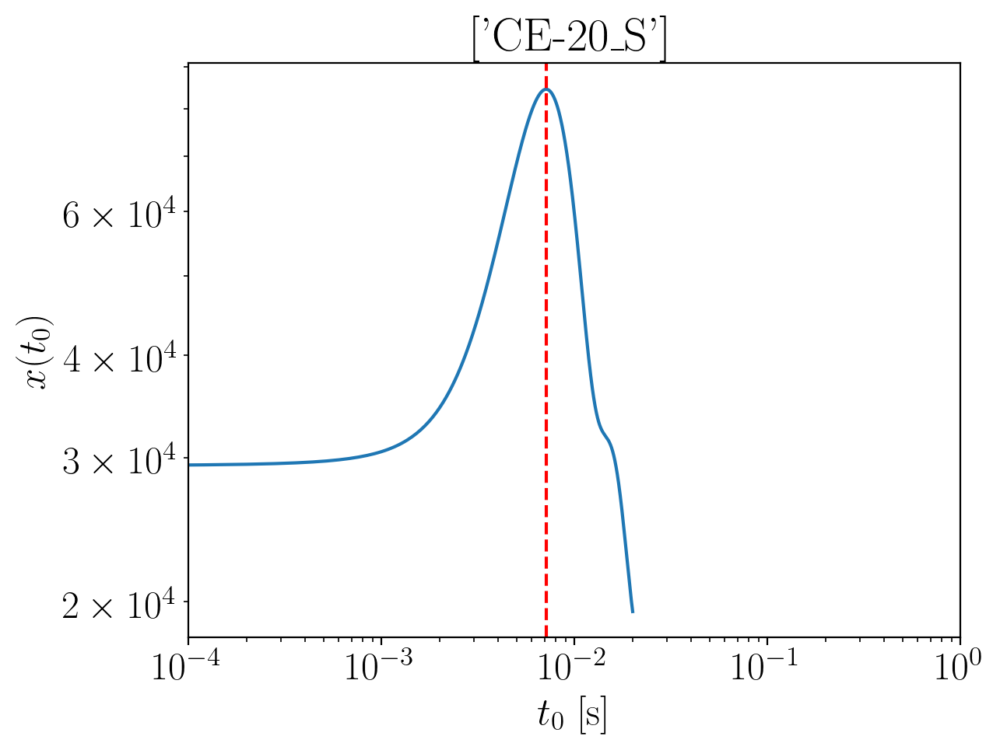

2024-01-15 16:16:01,175 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:01,182 - Network - INFO : PSDs loaded.
2024-01-15 16:16:01,183 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:01,189 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:01,194 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.928394738393747
Inner product:
0.9995904314960874


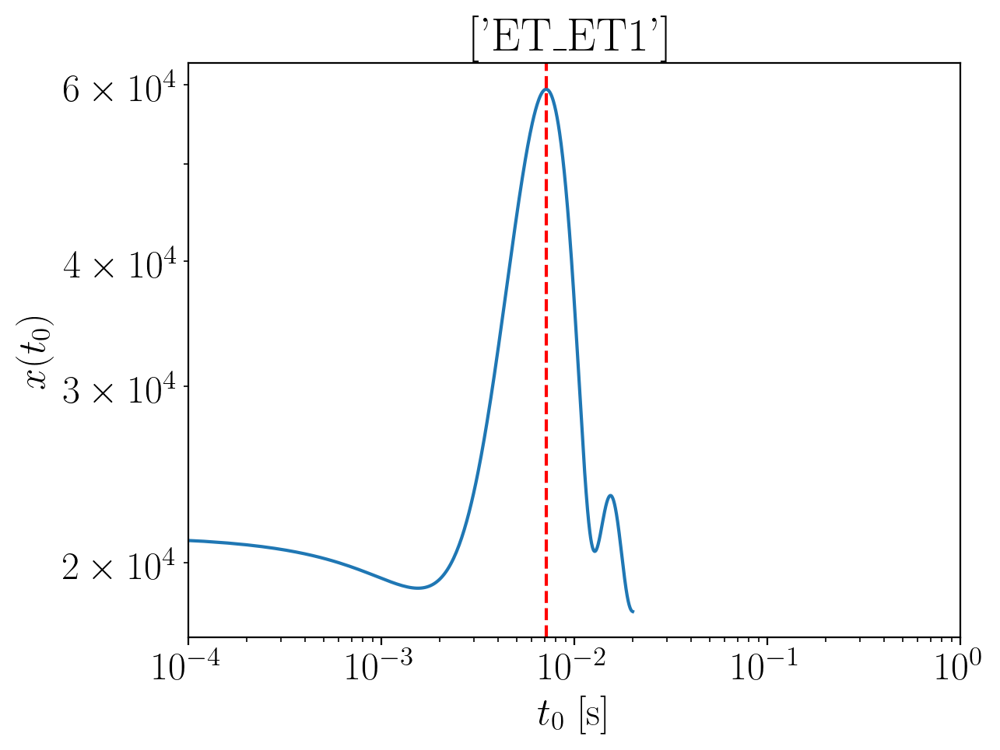

2024-01-15 16:16:02,667 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:02,682 - Network - INFO : PSDs loaded.
2024-01-15 16:16:02,692 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:02,711 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:02,732 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.9191836615300977
Inner product:
0.9996063833880356


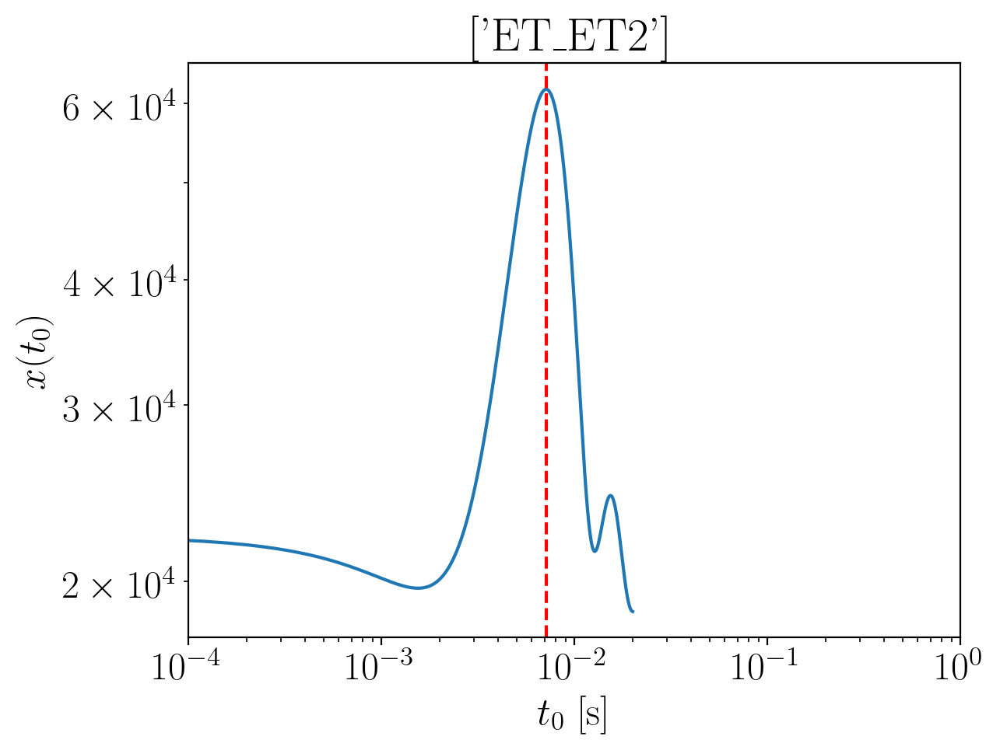

2024-01-15 16:16:04,167 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:04,186 - Network - INFO : PSDs loaded.
2024-01-15 16:16:04,190 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:04,205 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:04,211 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.9191836615300977
Inner product:
0.9996063833880359


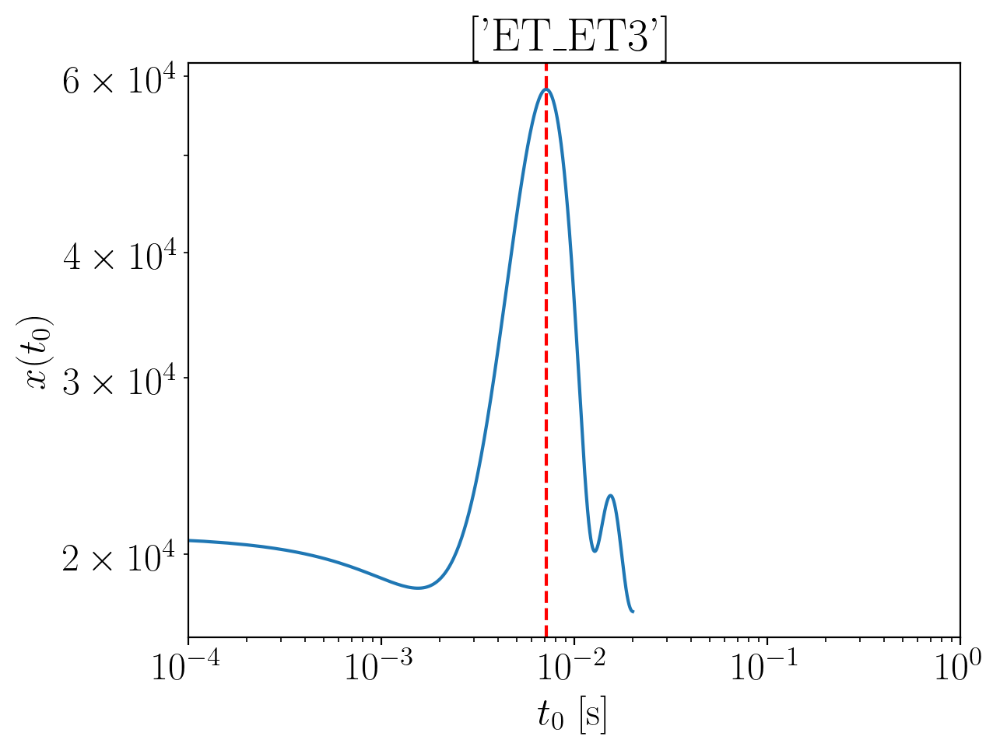

2024-01-15 16:16:05,643 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:05,658 - Network - INFO : PSDs loaded.
2024-01-15 16:16:05,672 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:05,682 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:05,694 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:05,742 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:05,749 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:16:05,755 - Network - INFO : Polarizations calculated.


time shift: 0.0071200000000000005
phase shift: -1.9191836615300977
Inner product:
0.9996063833880358


2024-01-15 16:16:11,200 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:16:11,246 - Network - INFO : PSDs loaded.
2024-01-15 16:16:11,252 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:11,276 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:11,277 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:16:11,278 - Network - INFO :    CE-40_C
2024-01-15 16:16:14,909 - Network - INFO :    CE-20_S
2024-01-15 16:16:18,531 - Network - INFO :    ET_ET1
2024-01-15 16:16:22,164 - Network - INFO :    ET_ET2
2024-01-15 16:16:25,767 - Network - INFO :    ET_ET3
2024-01-15 16:16:29,393 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:16:29,400 - Network - INFO : SNRs calculated.
2024-01-15 16:16:29,401 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:16:29,401 - Network - INFO :    CE-40_C
2024-01-15 16:16:29,495 - Network - INFO :

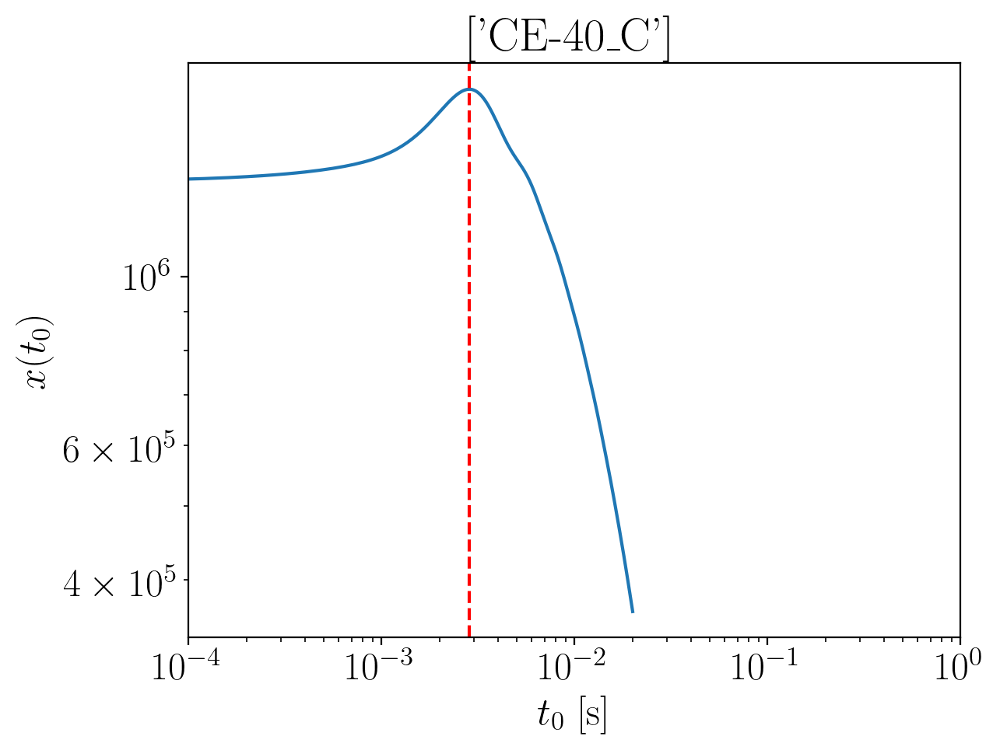

2024-01-15 16:16:31,241 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:31,248 - Network - INFO : PSDs loaded.
2024-01-15 16:16:31,252 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:31,259 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:31,267 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.301663518871715
Inner product:
0.999871772224298


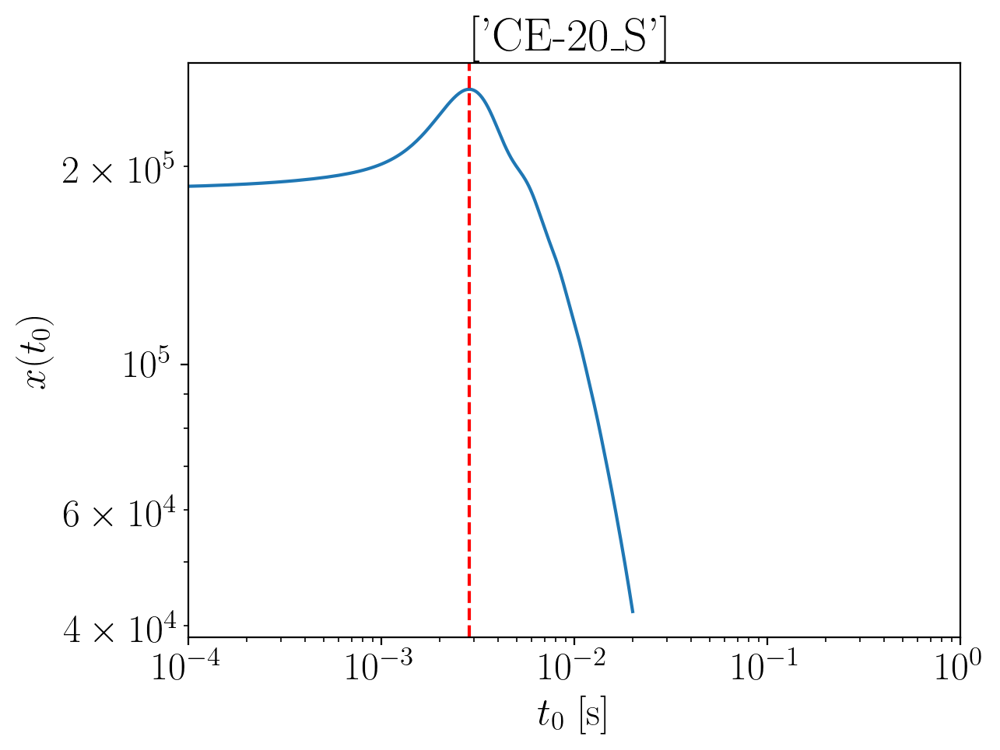

2024-01-15 16:16:32,464 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:32,470 - Network - INFO : PSDs loaded.
2024-01-15 16:16:32,472 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:32,479 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:32,486 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.303214237146529
Inner product:
0.9998446925505527


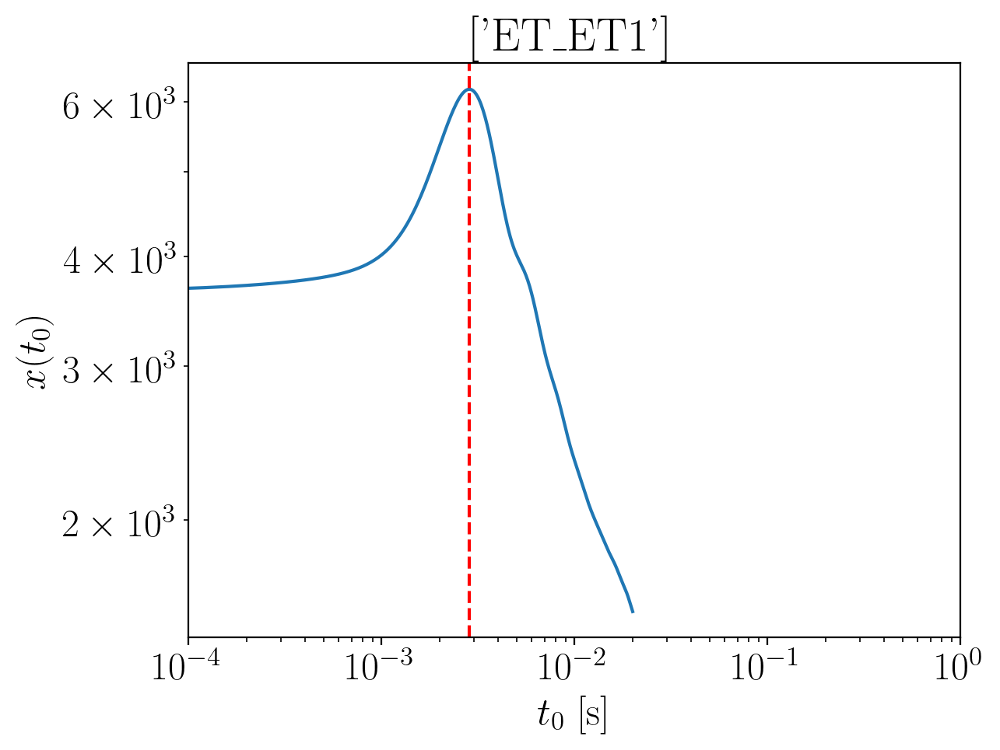

2024-01-15 16:16:33,847 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:33,860 - Network - INFO : PSDs loaded.
2024-01-15 16:16:33,862 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:33,869 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:33,875 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2979225724912395
Inner product:
0.9997026524221063


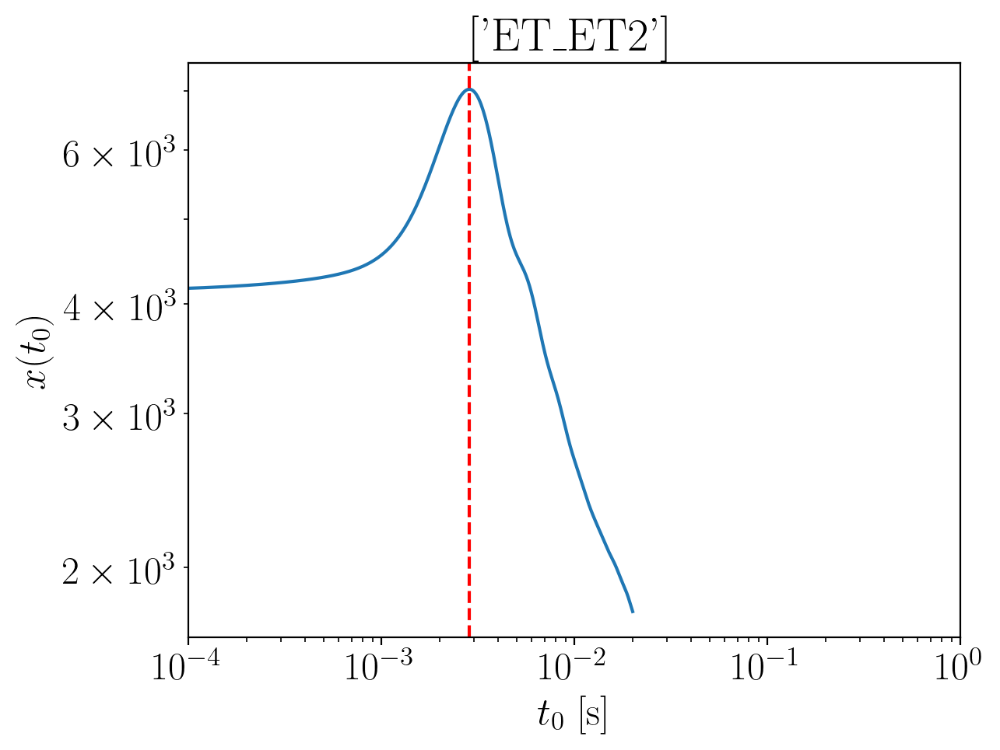

2024-01-15 16:16:35,330 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:35,343 - Network - INFO : PSDs loaded.
2024-01-15 16:16:35,345 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:35,351 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:35,357 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2979225724912395
Inner product:
0.9997026524221062


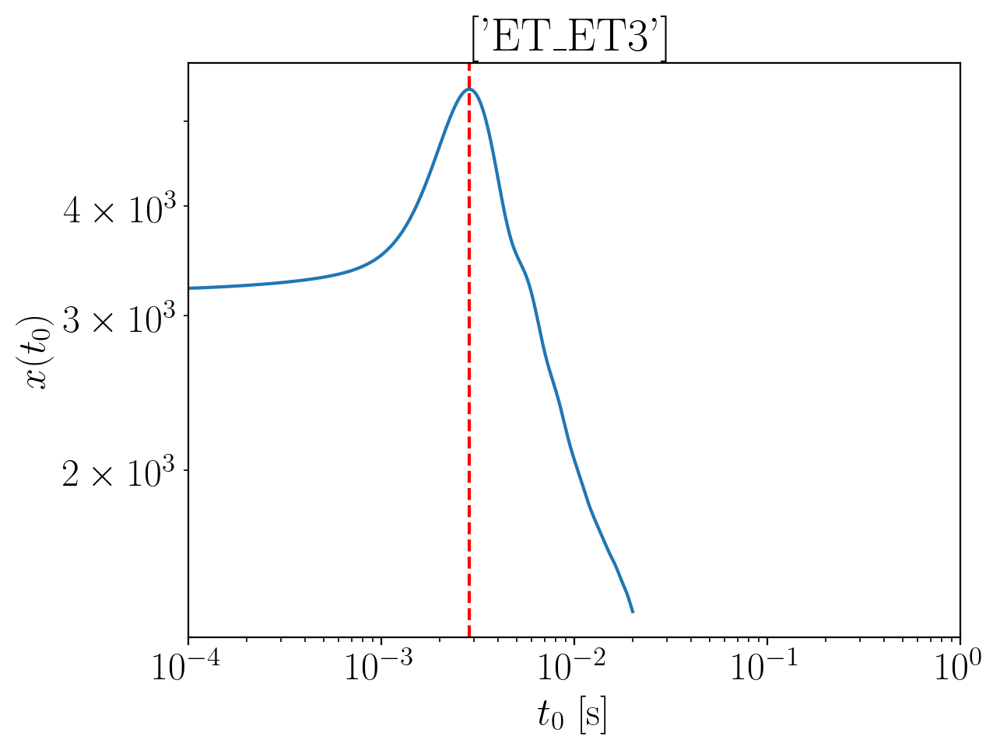

2024-01-15 16:16:36,855 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:36,869 - Network - INFO : PSDs loaded.
2024-01-15 16:16:36,873 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:36,881 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:36,901 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:36,957 - Network - INFO : Polarizations calculated.
2024-01-15 16:16:36,959 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:16:36,966 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2979225724912395
Inner product:
0.9997026524221062


2024-01-15 16:16:42,442 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:16:42,623 - Network - INFO : PSDs loaded.
2024-01-15 16:16:42,629 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:16:42,648 - Network - INFO : Detector responses calculated.
2024-01-15 16:16:42,648 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:16:42,649 - Network - INFO :    CE-40_C
2024-01-15 16:16:46,296 - Network - INFO :    CE-20_S
2024-01-15 16:16:49,935 - Network - INFO :    ET_ET1
2024-01-15 16:16:53,526 - Network - INFO :    ET_ET2
2024-01-15 16:16:57,125 - Network - INFO :    ET_ET3
2024-01-15 16:17:00,723 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:17:00,730 - Network - INFO : SNRs calculated.
2024-01-15 16:17:00,730 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:17:00,731 - Network - INFO :    CE-40_C
2024-01-15 16:17:00,824 - Network - INFO :

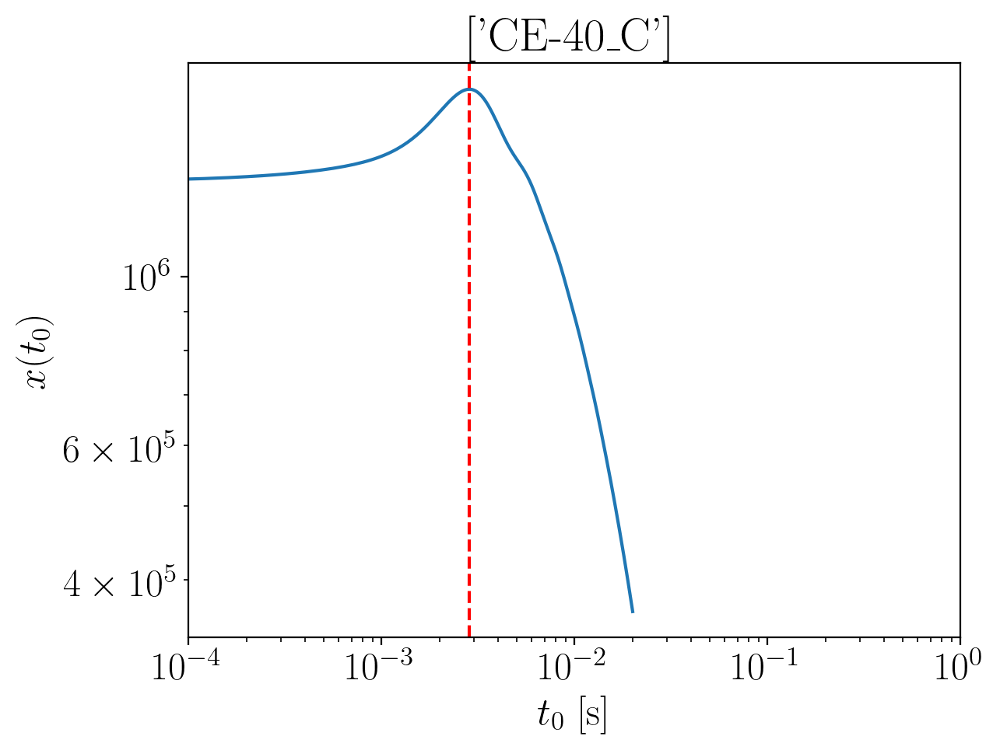

2024-01-15 16:17:02,544 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:02,566 - Network - INFO : PSDs loaded.
2024-01-15 16:17:02,568 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:02,574 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:02,581 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.415029305984503
Inner product:
0.9998717722242975


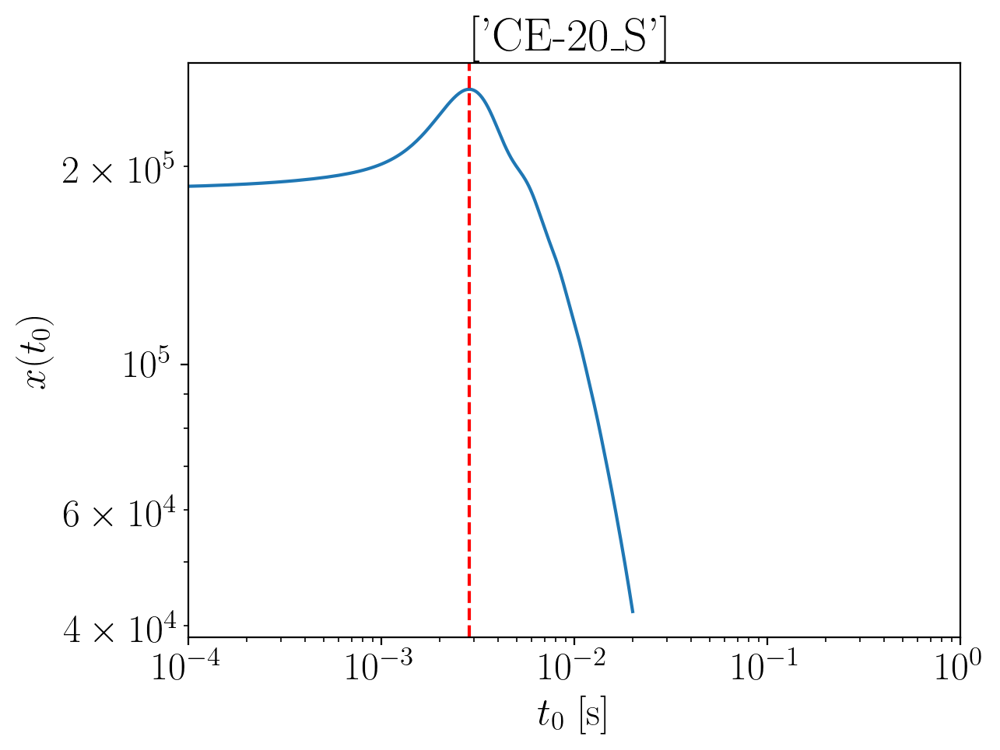

2024-01-15 16:17:03,766 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:03,773 - Network - INFO : PSDs loaded.
2024-01-15 16:17:03,780 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:03,793 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:03,824 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.416580024259329
Inner product:
0.9998446925505523


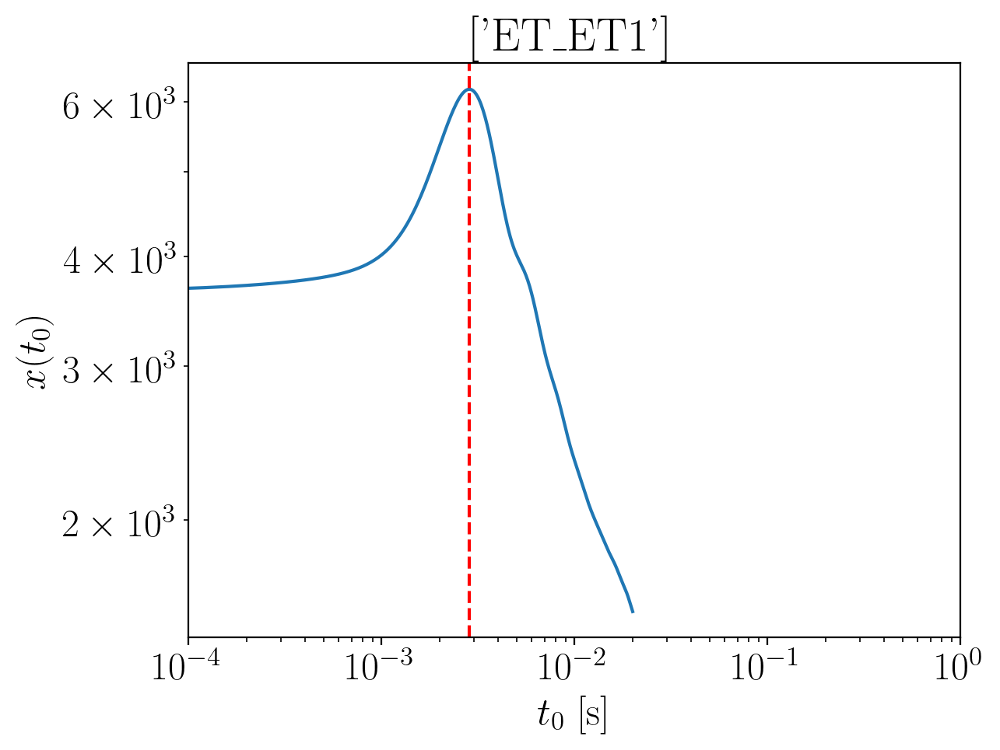

2024-01-15 16:17:05,212 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:05,225 - Network - INFO : PSDs loaded.
2024-01-15 16:17:05,227 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:05,233 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:05,239 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.409787664951727
Inner product:
0.9997026524221054


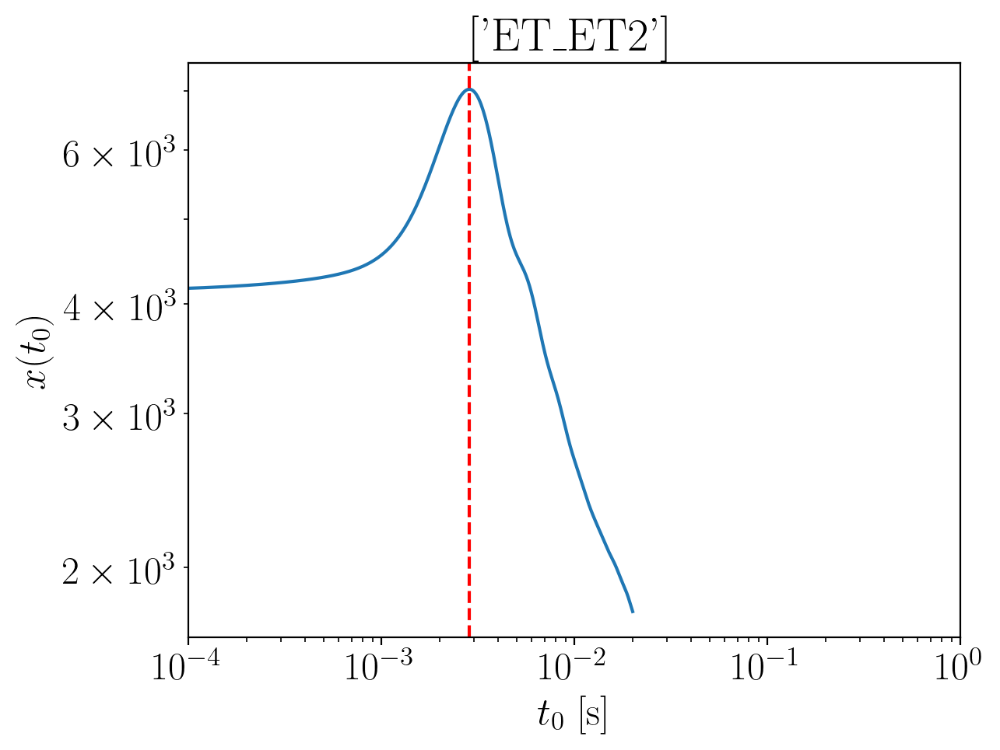

2024-01-15 16:17:06,700 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:06,713 - Network - INFO : PSDs loaded.
2024-01-15 16:17:06,715 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:06,722 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:06,728 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.4097876649517276
Inner product:
0.9997026524221054


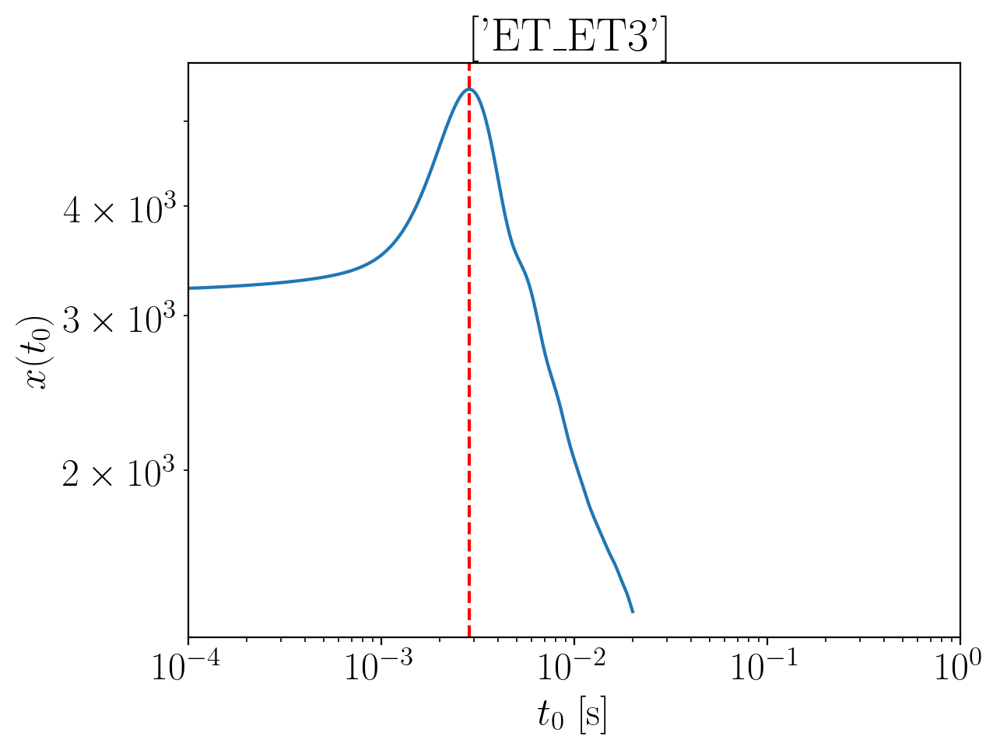

2024-01-15 16:17:08,181 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:08,195 - Network - INFO : PSDs loaded.
2024-01-15 16:17:08,197 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:08,205 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:08,213 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:08,259 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:08,262 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:17:08,267 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.4097876649517276
Inner product:
0.9997026524221054


2024-01-15 16:17:13,736 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:17:13,782 - Network - INFO : PSDs loaded.
2024-01-15 16:17:13,788 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:13,835 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:13,836 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:17:13,836 - Network - INFO :    CE-40_C
2024-01-15 16:17:17,449 - Network - INFO :    CE-20_S
2024-01-15 16:17:21,024 - Network - INFO :    ET_ET1
2024-01-15 16:17:24,614 - Network - INFO :    ET_ET2
2024-01-15 16:17:28,231 - Network - INFO :    ET_ET3
2024-01-15 16:17:31,831 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:17:31,838 - Network - INFO : SNRs calculated.
2024-01-15 16:17:31,838 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:17:31,839 - Network - INFO :    CE-40_C
2024-01-15 16:17:31,933 - Network - INFO :

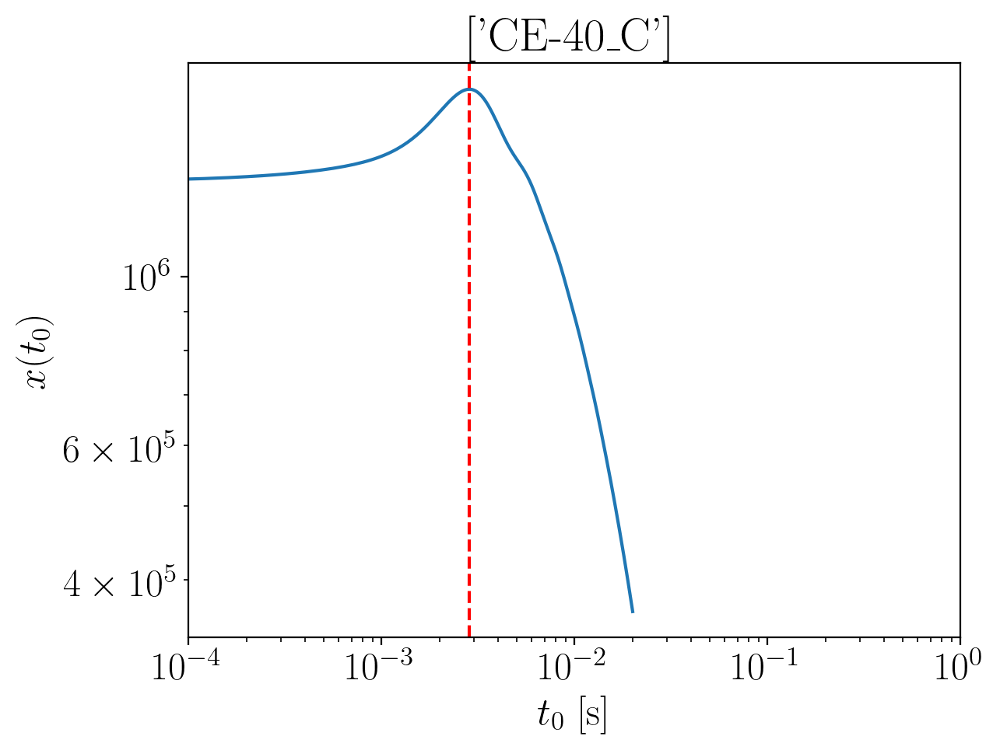

2024-01-15 16:17:34,038 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:34,066 - Network - INFO : PSDs loaded.
2024-01-15 16:17:34,094 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:34,113 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:34,129 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3826997433917536
Inner product:
0.9998717722242978


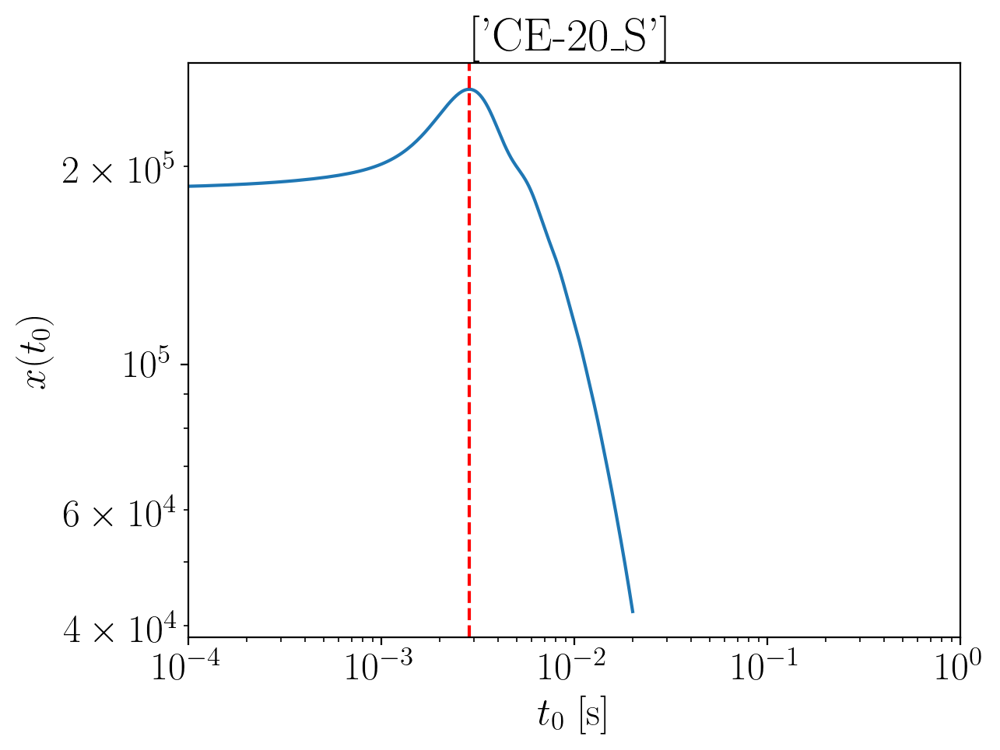

2024-01-15 16:17:35,676 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:35,695 - Network - INFO : PSDs loaded.
2024-01-15 16:17:35,714 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:35,727 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:35,738 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.38425046166657
Inner product:
0.9998446925505525


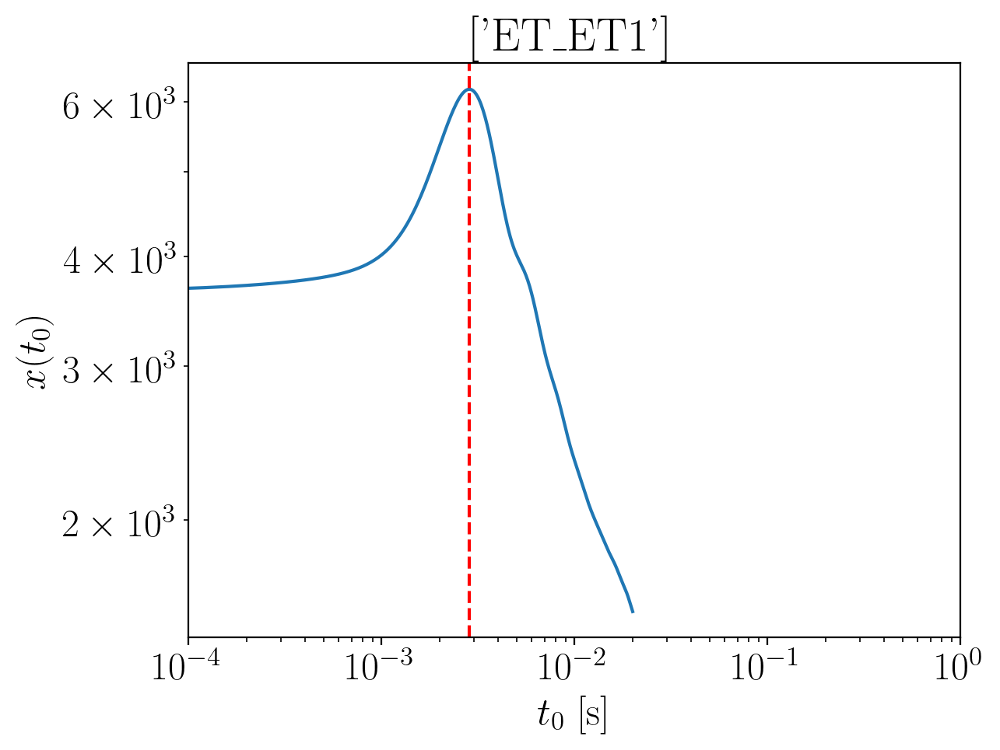

2024-01-15 16:17:37,465 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:37,482 - Network - INFO : PSDs loaded.
2024-01-15 16:17:37,486 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:37,536 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:37,548 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3774581023589816
Inner product:
0.9997026524221059


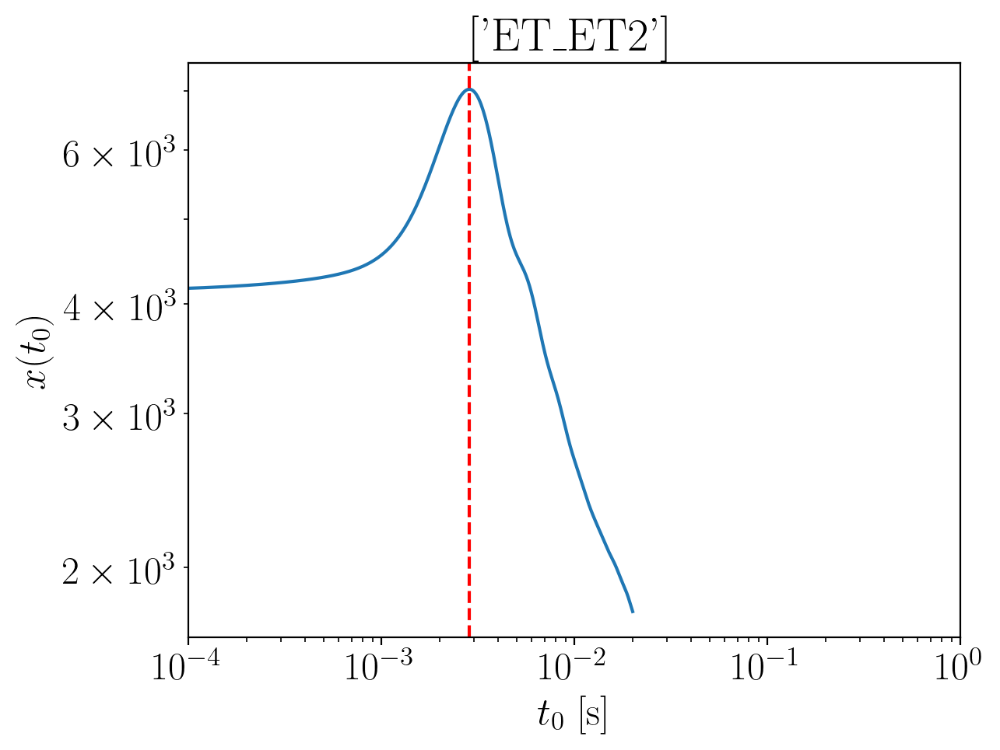

2024-01-15 16:17:39,219 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:39,233 - Network - INFO : PSDs loaded.
2024-01-15 16:17:39,235 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:39,252 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:39,293 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3774581023589816
Inner product:
0.9997026524221057


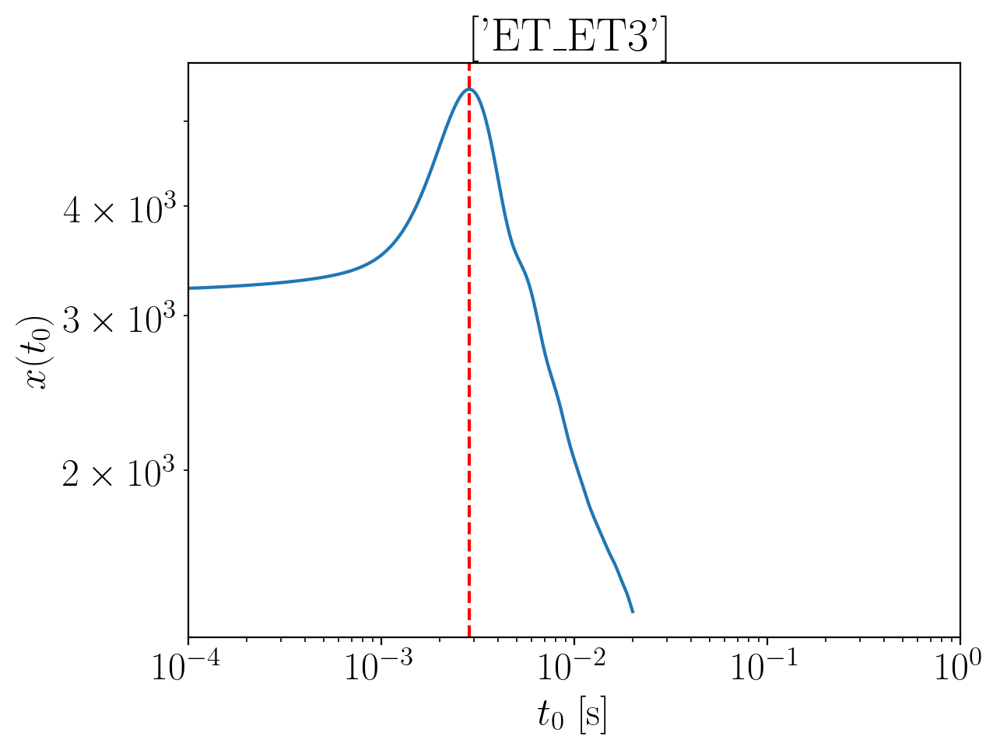

2024-01-15 16:17:40,901 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:40,914 - Network - INFO : PSDs loaded.
2024-01-15 16:17:40,916 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:40,922 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:40,937 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:40,998 - Network - INFO : Polarizations calculated.
2024-01-15 16:17:41,001 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:17:41,008 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3774581023589816
Inner product:
0.9997026524221058


2024-01-15 16:17:48,530 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:17:48,583 - Network - INFO : PSDs loaded.
2024-01-15 16:17:48,606 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:17:48,651 - Network - INFO : Detector responses calculated.
2024-01-15 16:17:48,652 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:17:48,652 - Network - INFO :    CE-40_C
2024-01-15 16:17:52,324 - Network - INFO :    CE-20_S
2024-01-15 16:17:57,058 - Network - INFO :    ET_ET1
2024-01-15 16:18:03,002 - Network - INFO :    ET_ET2
2024-01-15 16:18:07,532 - Network - INFO :    ET_ET3
2024-01-15 16:18:11,992 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:18:11,999 - Network - INFO : SNRs calculated.
2024-01-15 16:18:11,999 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:18:12,000 - Network - INFO :    CE-40_C
2024-01-15 16:18:12,094 - Network - INFO :

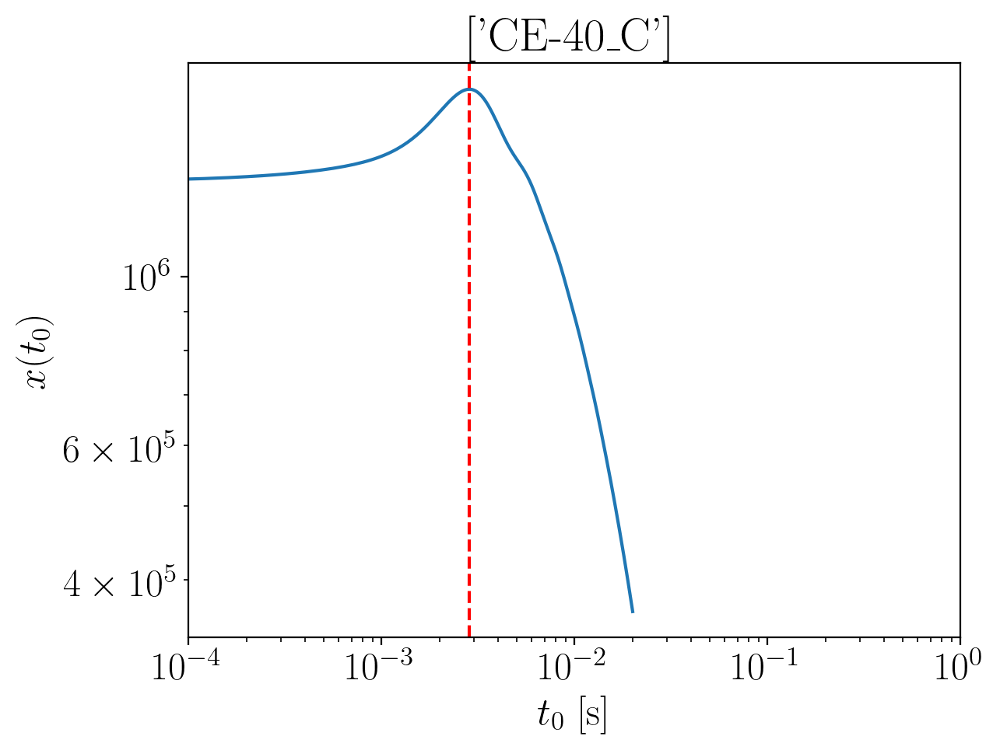

2024-01-15 16:18:14,472 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:14,484 - Network - INFO : PSDs loaded.
2024-01-15 16:18:14,489 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:14,508 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:14,525 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.354134813473604
Inner product:
0.9998717722242981


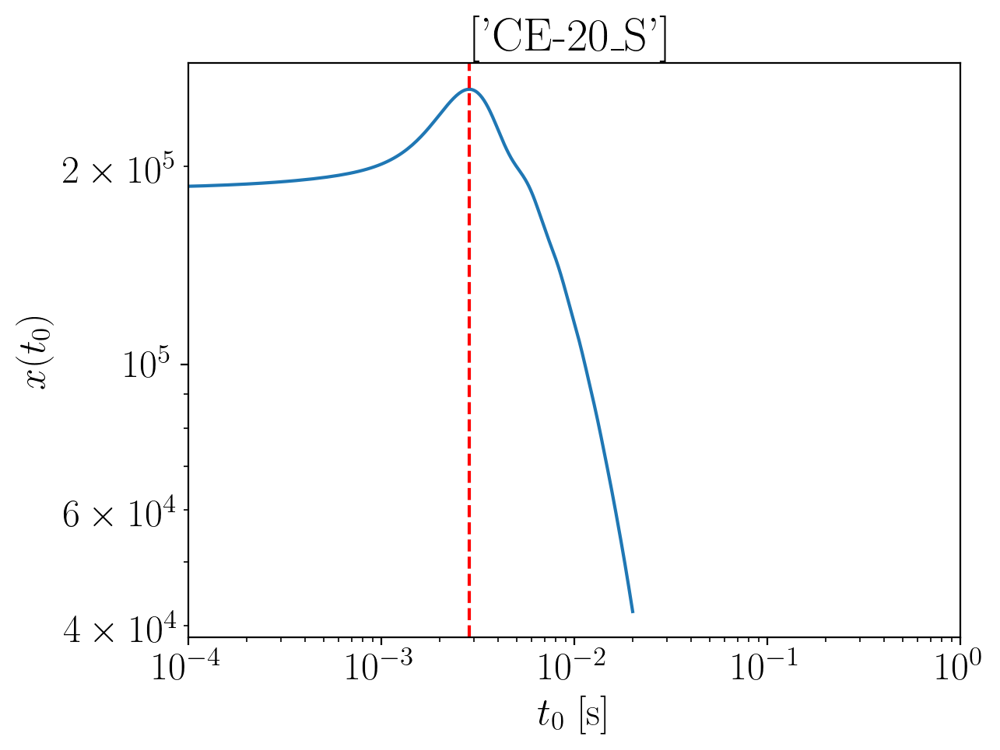

2024-01-15 16:18:16,347 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:16,359 - Network - INFO : PSDs loaded.
2024-01-15 16:18:16,364 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:16,391 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:16,439 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.355685531748416
Inner product:
0.999844692550553


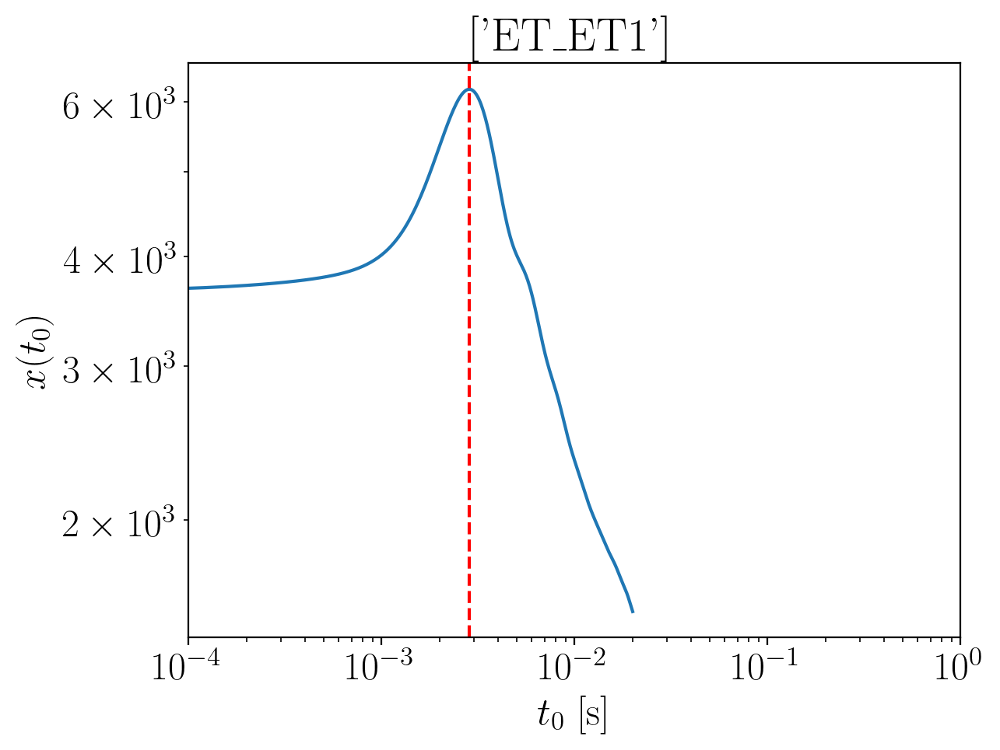

2024-01-15 16:18:18,631 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:18,646 - Network - INFO : PSDs loaded.
2024-01-15 16:18:18,649 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:18,656 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:18,665 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.348893172440858
Inner product:
0.9997026524221065


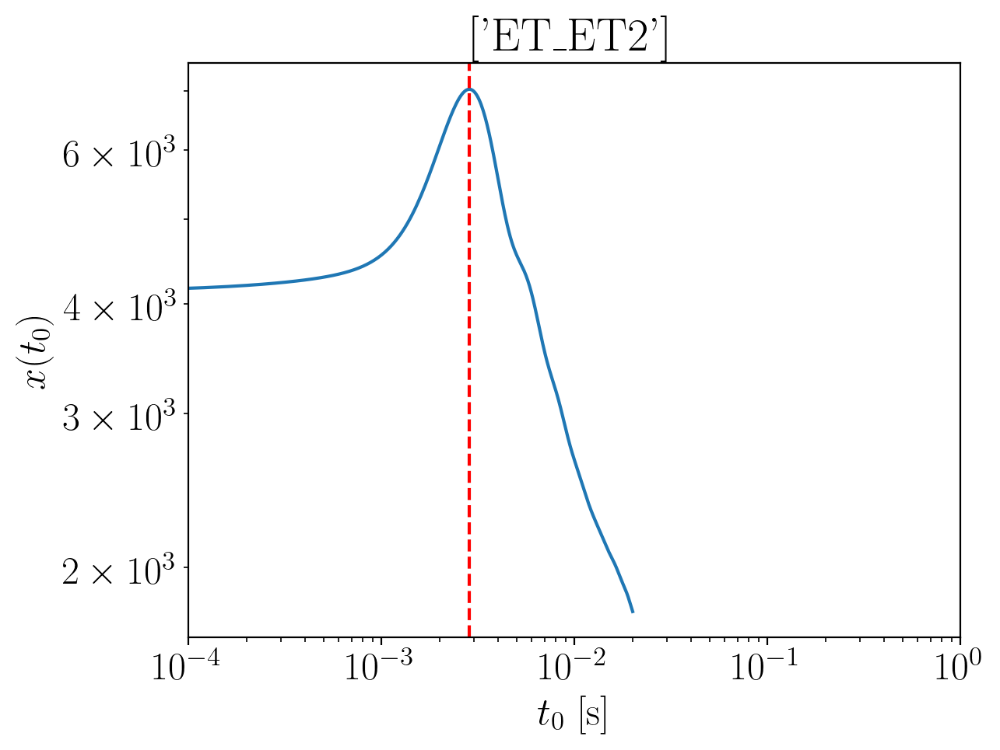

2024-01-15 16:18:21,935 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:21,960 - Network - INFO : PSDs loaded.
2024-01-15 16:18:21,965 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:21,986 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:22,045 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3488931724408584
Inner product:
0.9997026524221065


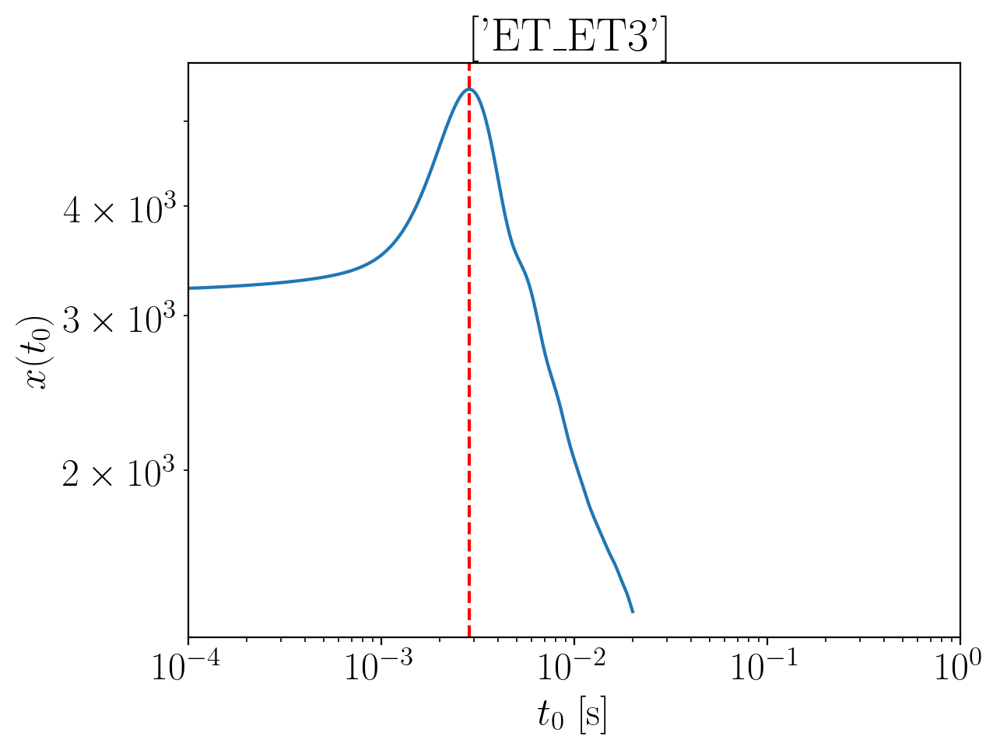

2024-01-15 16:18:24,847 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:24,863 - Network - INFO : PSDs loaded.
2024-01-15 16:18:24,865 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:24,873 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:24,885 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:24,916 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:24,917 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:18:24,924 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3488931724408584
Inner product:
0.9997026524221063


2024-01-15 16:18:33,622 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:18:33,688 - Network - INFO : PSDs loaded.
2024-01-15 16:18:33,698 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:33,728 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:33,730 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:18:33,731 - Network - INFO :    CE-40_C
2024-01-15 16:18:39,370 - Network - INFO :    CE-20_S
2024-01-15 16:18:43,803 - Network - INFO :    ET_ET1
2024-01-15 16:18:47,432 - Network - INFO :    ET_ET2
2024-01-15 16:18:51,180 - Network - INFO :    ET_ET3
2024-01-15 16:18:55,129 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:18:55,136 - Network - INFO : SNRs calculated.
2024-01-15 16:18:55,137 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:18:55,137 - Network - INFO :    CE-40_C
2024-01-15 16:18:55,230 - Network - INFO :

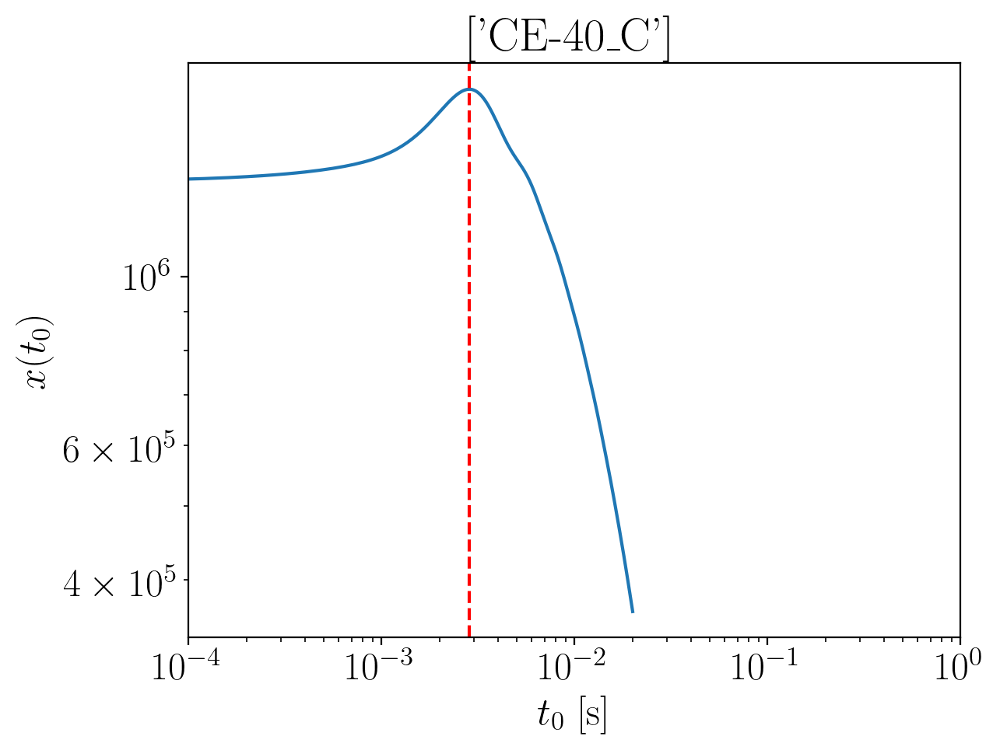

2024-01-15 16:18:57,048 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:57,056 - Network - INFO : PSDs loaded.
2024-01-15 16:18:57,058 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:57,065 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:57,072 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.327855598110406
Inner product:
0.9998717722242981


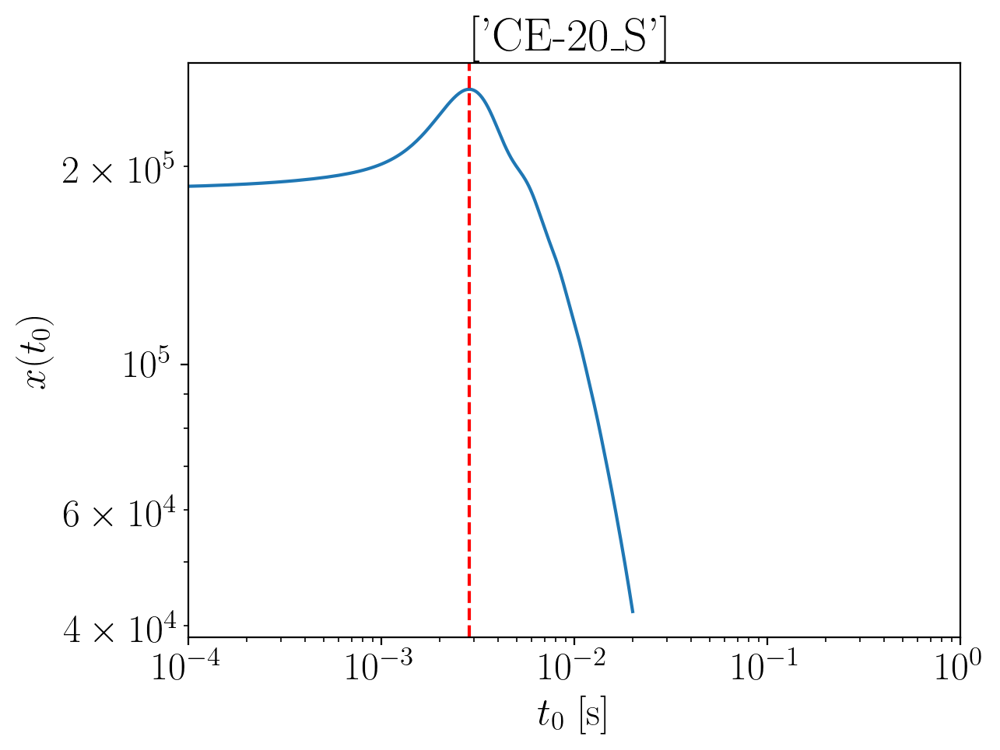

2024-01-15 16:18:58,381 - Network - INFO : Polarizations calculated.
2024-01-15 16:18:58,390 - Network - INFO : PSDs loaded.
2024-01-15 16:18:58,392 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:18:58,402 - Network - INFO : Detector responses calculated.
2024-01-15 16:18:58,411 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3294063163852203
Inner product:
0.9998446925505529


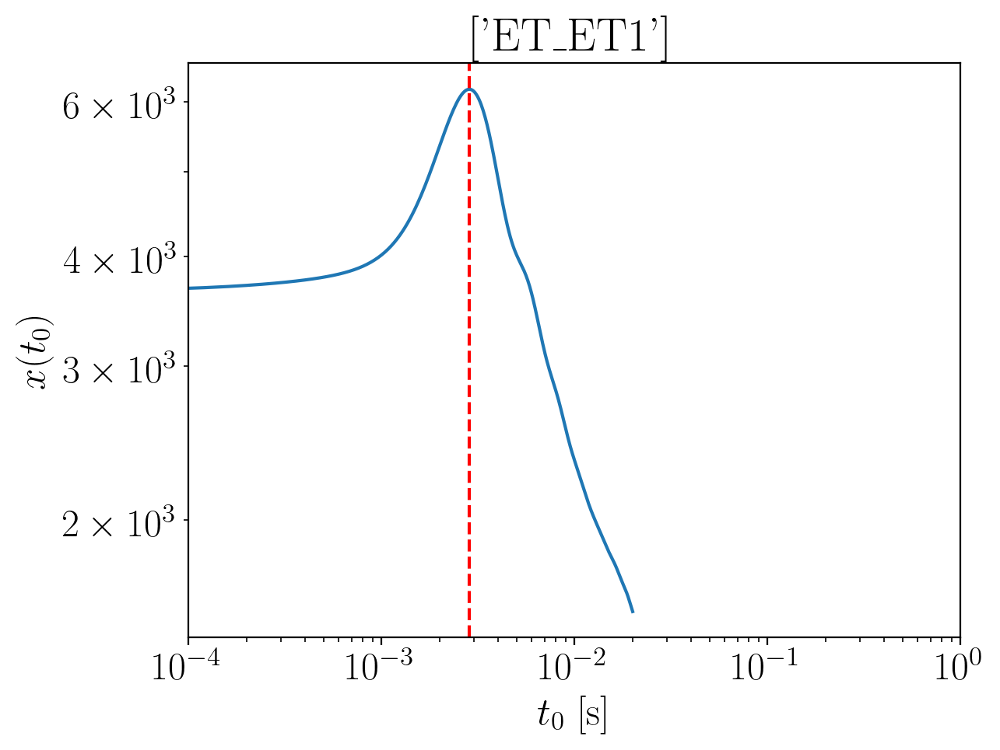

2024-01-15 16:19:01,279 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:01,312 - Network - INFO : PSDs loaded.
2024-01-15 16:19:01,322 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:01,339 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:01,364 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3226139570776567
Inner product:
0.9997026524221063


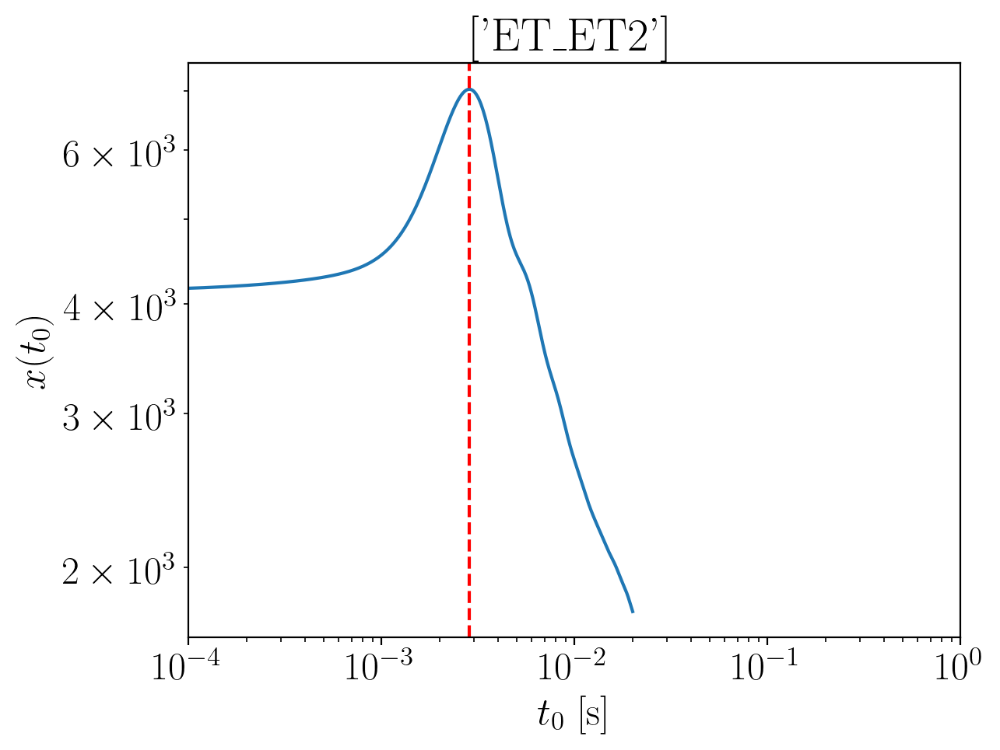

2024-01-15 16:19:03,861 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:03,873 - Network - INFO : PSDs loaded.
2024-01-15 16:19:03,875 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:03,882 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:03,888 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3226139570776563
Inner product:
0.9997026524221062


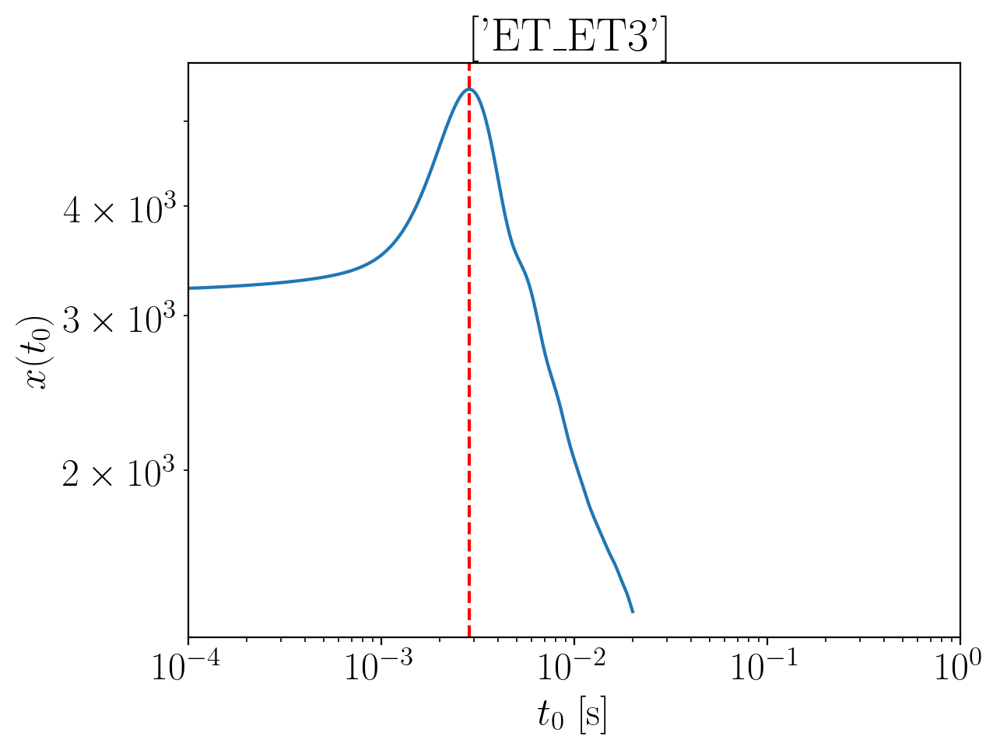

2024-01-15 16:19:05,912 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:05,928 - Network - INFO : PSDs loaded.
2024-01-15 16:19:05,930 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:05,939 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:05,946 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:05,980 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:05,981 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:19:05,988 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3226139570776563
Inner product:
0.9997026524221062


2024-01-15 16:19:12,159 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:19:12,215 - Network - INFO : PSDs loaded.
2024-01-15 16:19:12,229 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:12,263 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:12,264 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:19:12,265 - Network - INFO :    CE-40_C
2024-01-15 16:19:16,299 - Network - INFO :    CE-20_S
2024-01-15 16:19:19,961 - Network - INFO :    ET_ET1
2024-01-15 16:19:23,633 - Network - INFO :    ET_ET2
2024-01-15 16:19:28,022 - Network - INFO :    ET_ET3
2024-01-15 16:19:32,160 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:19:32,168 - Network - INFO : SNRs calculated.
2024-01-15 16:19:32,168 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:19:32,168 - Network - INFO :    CE-40_C
2024-01-15 16:19:32,262 - Network - INFO :

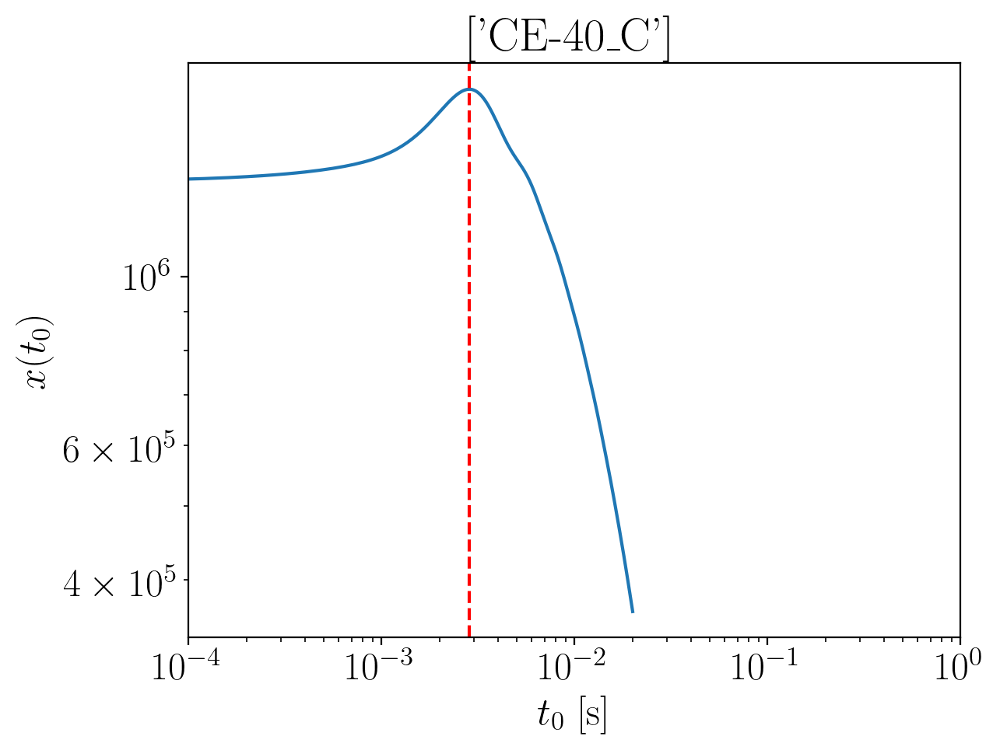

2024-01-15 16:19:34,159 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:34,166 - Network - INFO : PSDs loaded.
2024-01-15 16:19:34,167 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:34,174 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:34,180 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.3031642135239894
Inner product:
0.9998717722242981


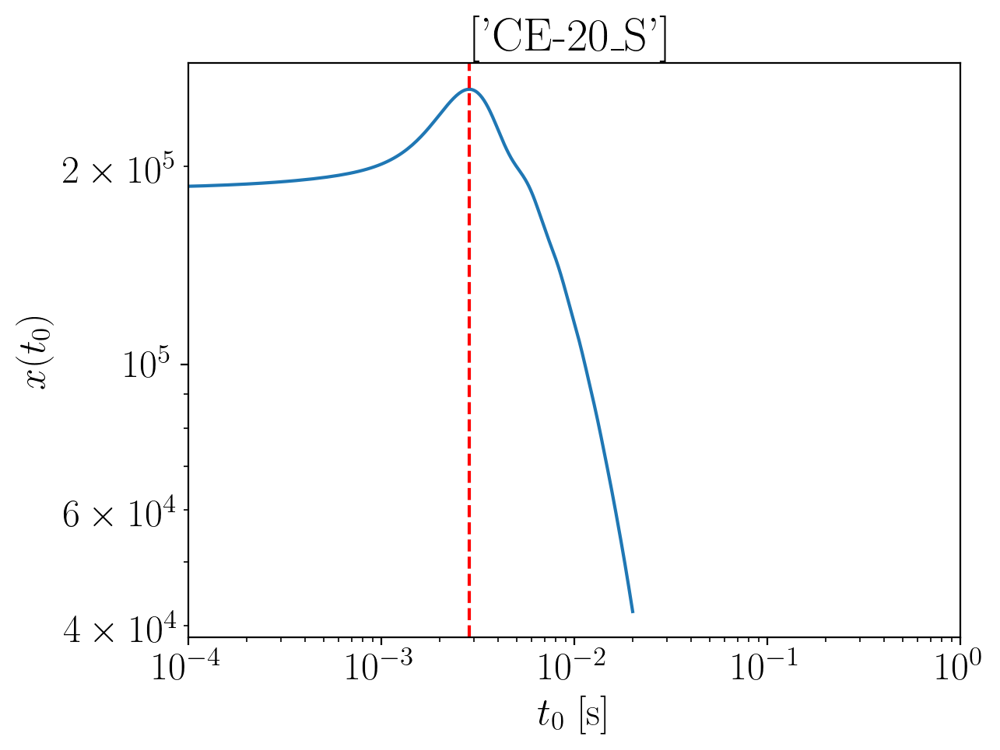

2024-01-15 16:19:35,819 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:35,831 - Network - INFO : PSDs loaded.
2024-01-15 16:19:35,835 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:35,846 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:35,857 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.304714931798804
Inner product:
0.999844692550553


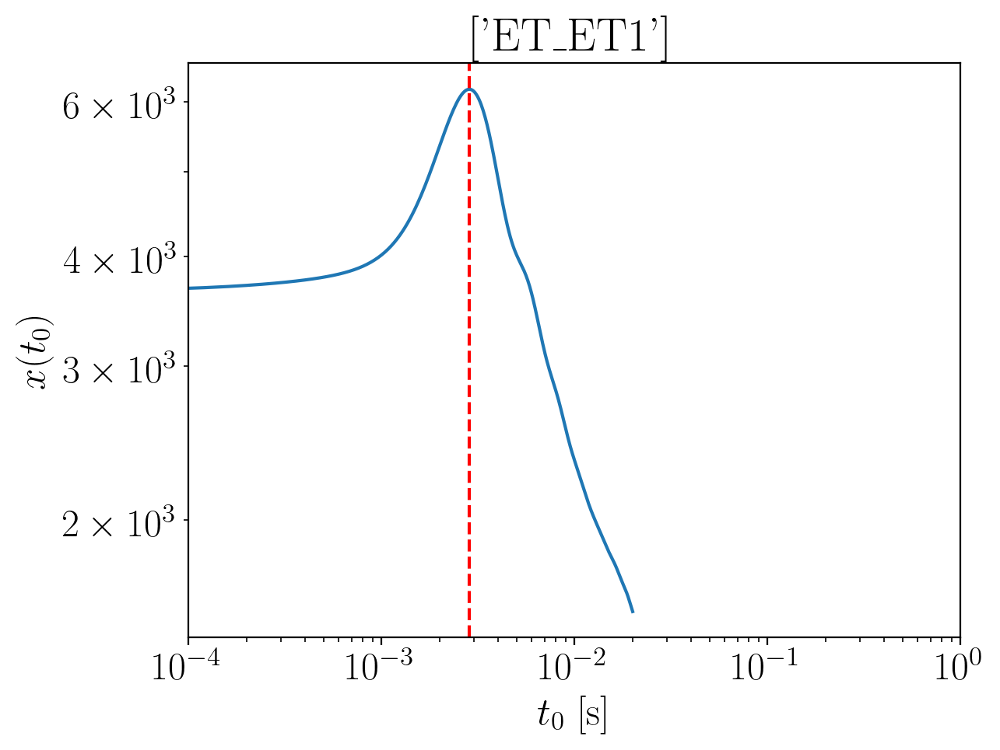

2024-01-15 16:19:38,254 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:38,274 - Network - INFO : PSDs loaded.
2024-01-15 16:19:38,276 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:38,287 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:38,297 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2979225724912395
Inner product:
0.9997026524221063


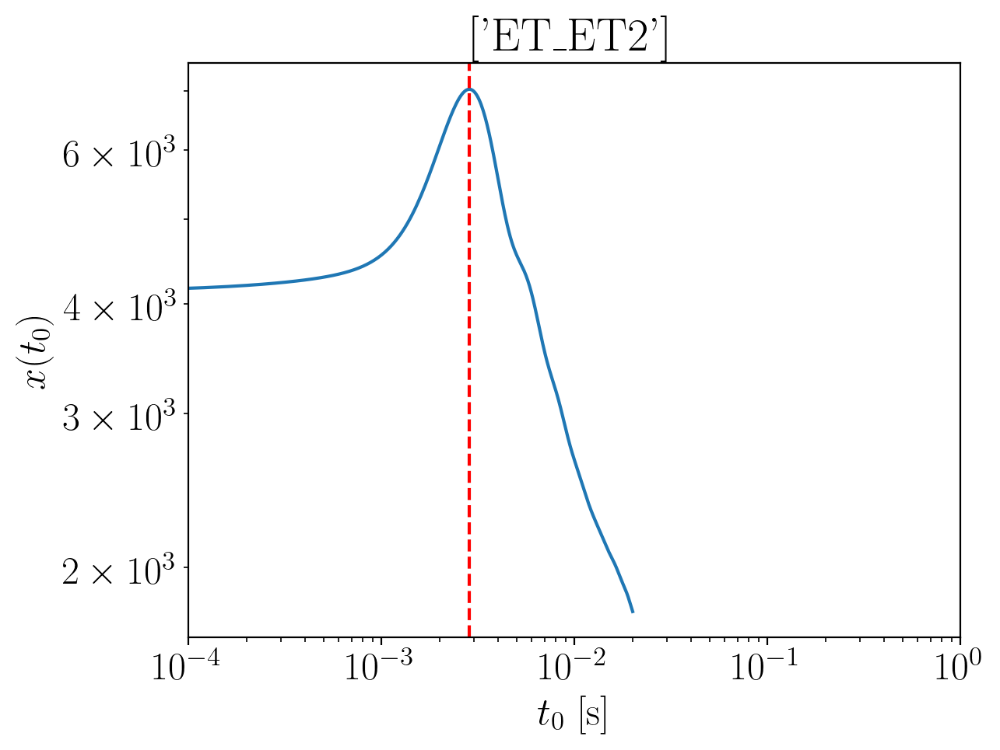

2024-01-15 16:19:40,352 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:40,380 - Network - INFO : PSDs loaded.
2024-01-15 16:19:40,383 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:40,392 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:40,404 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2979225724912395
Inner product:
0.9997026524221062


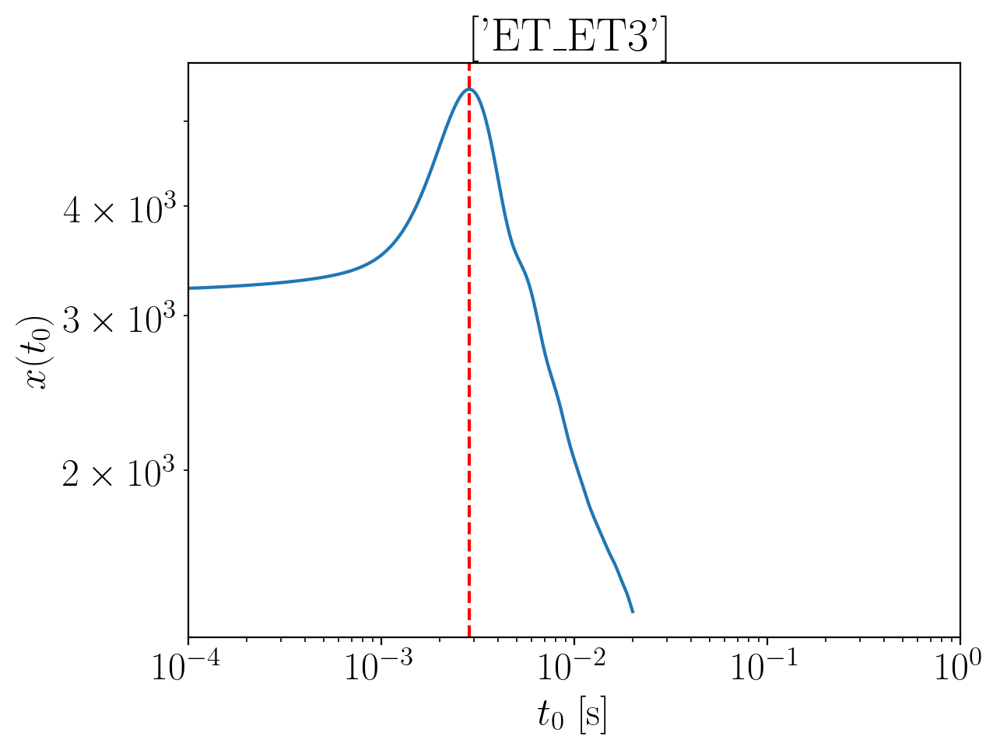

2024-01-15 16:19:42,472 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:42,487 - Network - INFO : PSDs loaded.
2024-01-15 16:19:42,489 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:42,496 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:42,506 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:42,538 - Network - INFO : Polarizations calculated.
2024-01-15 16:19:42,539 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:19:42,546 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2979225724912395
Inner product:
0.9997026524221062


2024-01-15 16:19:48,408 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:19:48,455 - Network - INFO : PSDs loaded.
2024-01-15 16:19:48,475 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:19:48,515 - Network - INFO : Detector responses calculated.
2024-01-15 16:19:48,516 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:19:48,516 - Network - INFO :    CE-40_C
2024-01-15 16:19:53,157 - Network - INFO :    CE-20_S
2024-01-15 16:19:57,099 - Network - INFO :    ET_ET1
2024-01-15 16:20:00,714 - Network - INFO :    ET_ET2
2024-01-15 16:20:04,290 - Network - INFO :    ET_ET3
2024-01-15 16:20:07,870 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:20:07,877 - Network - INFO : SNRs calculated.
2024-01-15 16:20:07,877 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:20:07,878 - Network - INFO :    CE-40_C
2024-01-15 16:20:07,972 - Network - INFO :

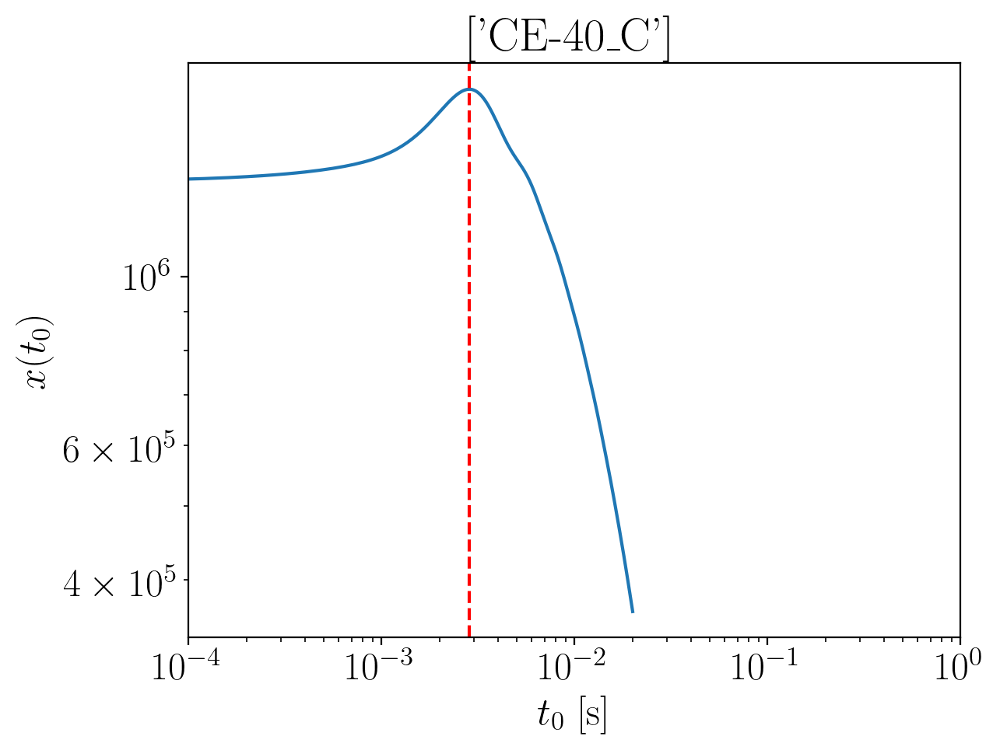

2024-01-15 16:20:09,749 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:09,756 - Network - INFO : PSDs loaded.
2024-01-15 16:20:09,759 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:09,768 - Network - INFO : Detector responses calculated.
2024-01-15 16:20:09,776 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2796547250843906
Inner product:
0.9998717722242983


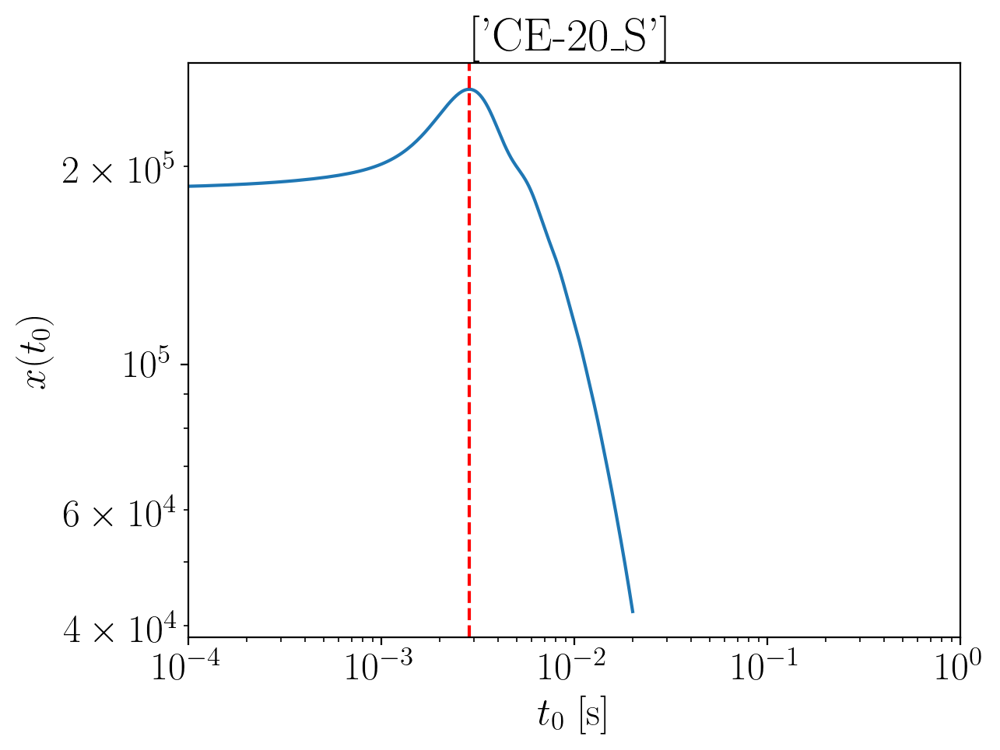

2024-01-15 16:20:11,556 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:11,592 - Network - INFO : PSDs loaded.
2024-01-15 16:20:11,670 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:11,715 - Network - INFO : Detector responses calculated.


time shift: 0.00284
phase shift: -2.281205443359204


2024-01-15 16:20:11,862 - Network - INFO : Polarizations calculated.


Inner product:
0.9998446925505529


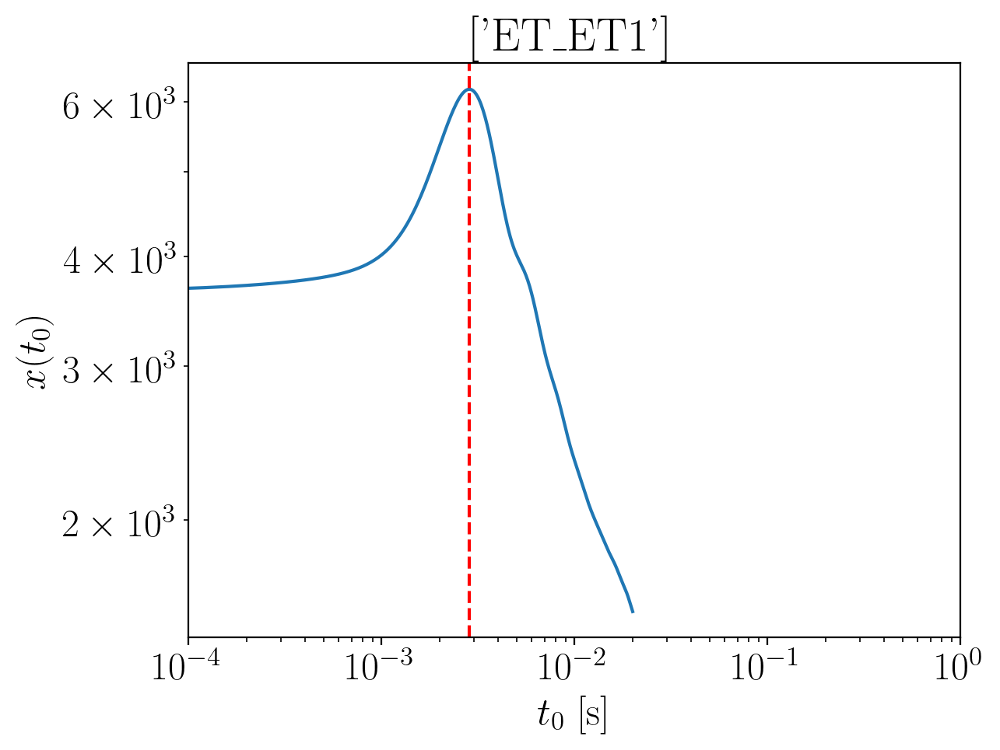

2024-01-15 16:20:15,691 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:15,704 - Network - INFO : PSDs loaded.
2024-01-15 16:20:15,706 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:15,713 - Network - INFO : Detector responses calculated.
2024-01-15 16:20:15,720 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.27441308405164
Inner product:
0.9997026524221063


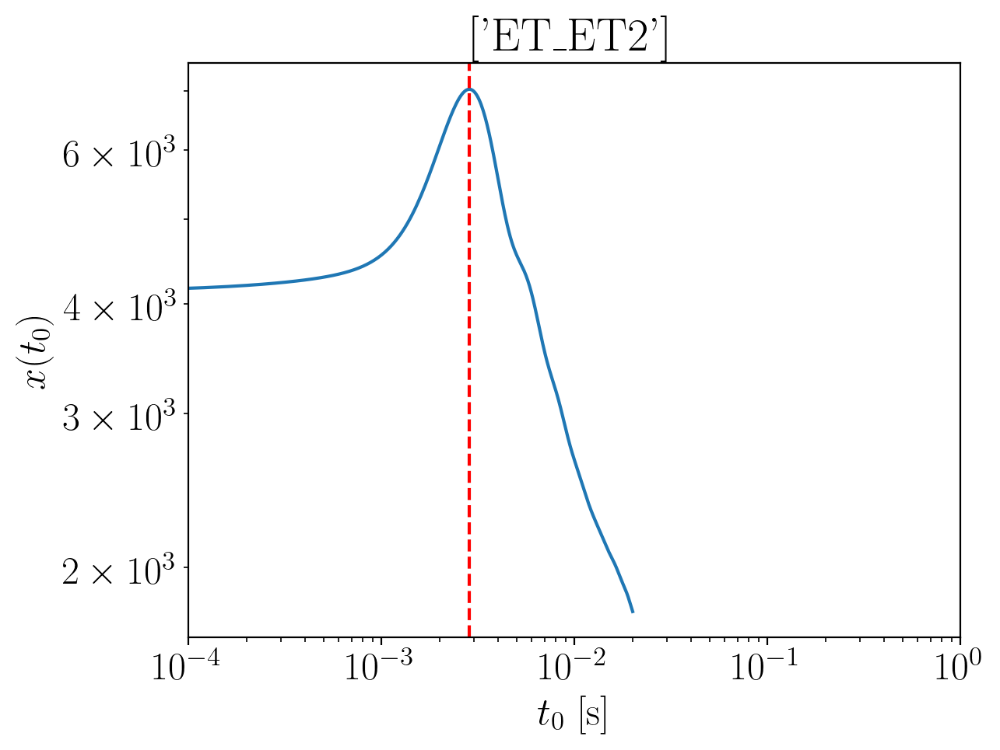

2024-01-15 16:20:18,279 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:18,299 - Network - INFO : PSDs loaded.
2024-01-15 16:20:18,302 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:18,312 - Network - INFO : Detector responses calculated.
2024-01-15 16:20:18,322 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.27441308405164
Inner product:
0.9997026524221062


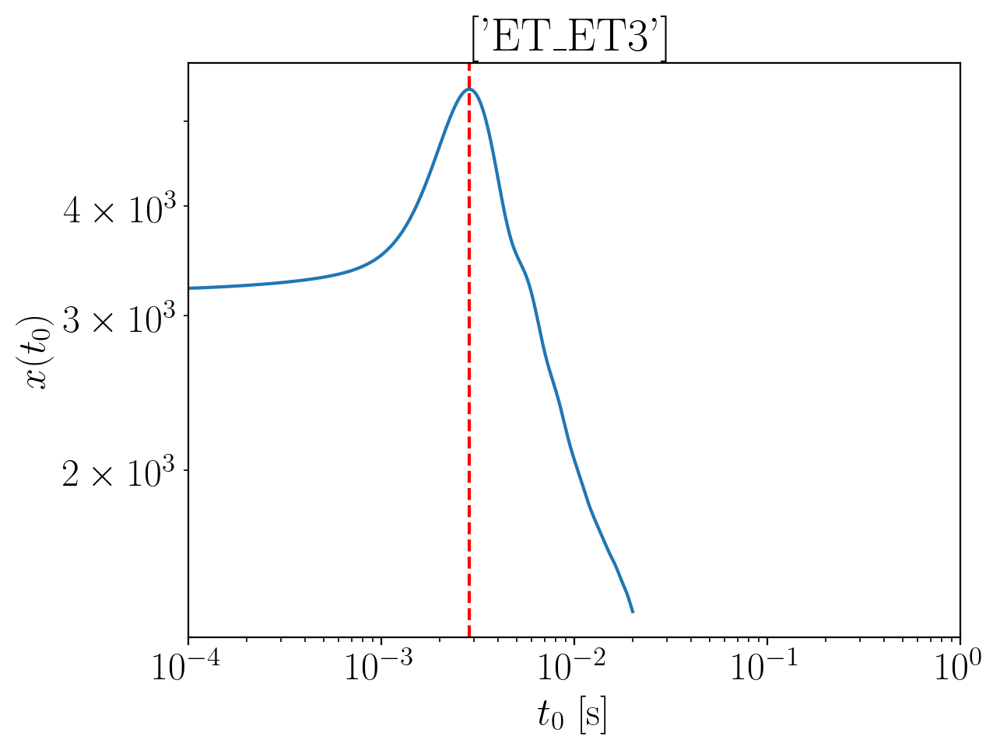

2024-01-15 16:20:20,774 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:20,801 - Network - INFO : PSDs loaded.
2024-01-15 16:20:20,804 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:20,817 - Network - INFO : Detector responses calculated.
2024-01-15 16:20:20,842 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:20,885 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:20,887 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:20:20,898 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.27441308405164
Inner product:
0.9997026524221062


2024-01-15 16:20:30,844 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:20:30,914 - Network - INFO : PSDs loaded.
2024-01-15 16:20:30,938 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:30,982 - Network - INFO : Detector responses calculated.
2024-01-15 16:20:30,989 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:20:30,991 - Network - INFO :    CE-40_C
2024-01-15 16:20:36,795 - Network - INFO :    CE-20_S
2024-01-15 16:20:41,977 - Network - INFO :    ET_ET1
2024-01-15 16:20:46,209 - Network - INFO :    ET_ET2
2024-01-15 16:20:50,866 - Network - INFO :    ET_ET3
2024-01-15 16:20:56,280 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:20:56,289 - Network - INFO : SNRs calculated.
2024-01-15 16:20:56,289 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:20:56,290 - Network - INFO :    CE-40_C
2024-01-15 16:20:56,402 - Network - INFO :

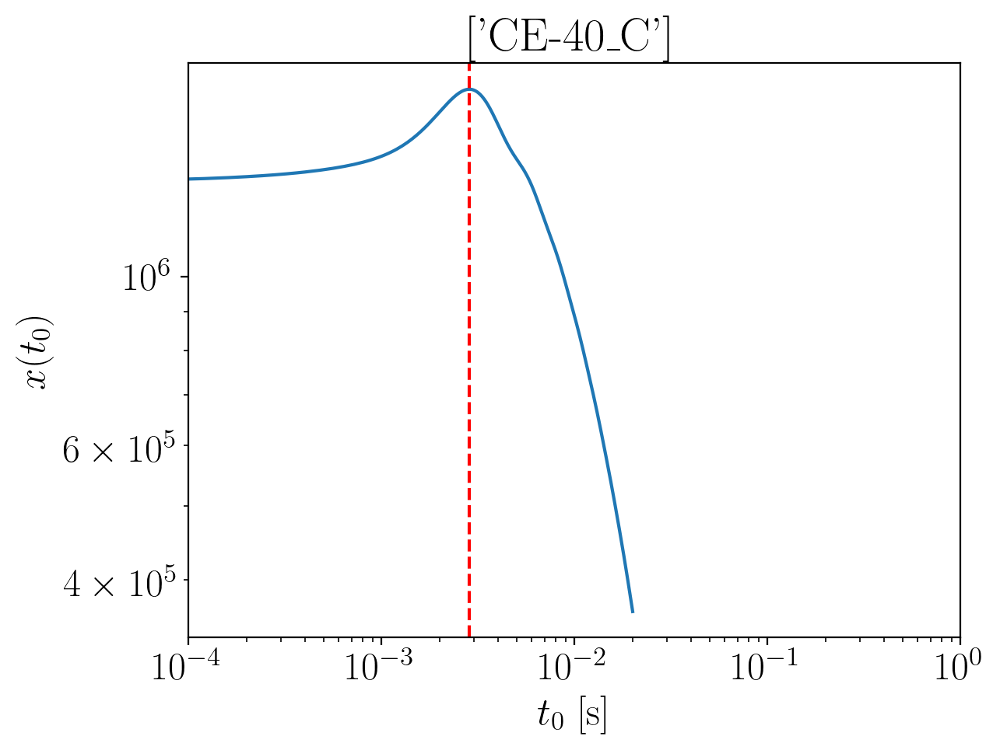

2024-01-15 16:20:59,029 - Network - INFO : Polarizations calculated.
2024-01-15 16:20:59,041 - Network - INFO : PSDs loaded.
2024-01-15 16:20:59,045 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:20:59,060 - Network - INFO : Detector responses calculated.
2024-01-15 16:20:59,073 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2570631139686914
Inner product:
0.9998717722242981


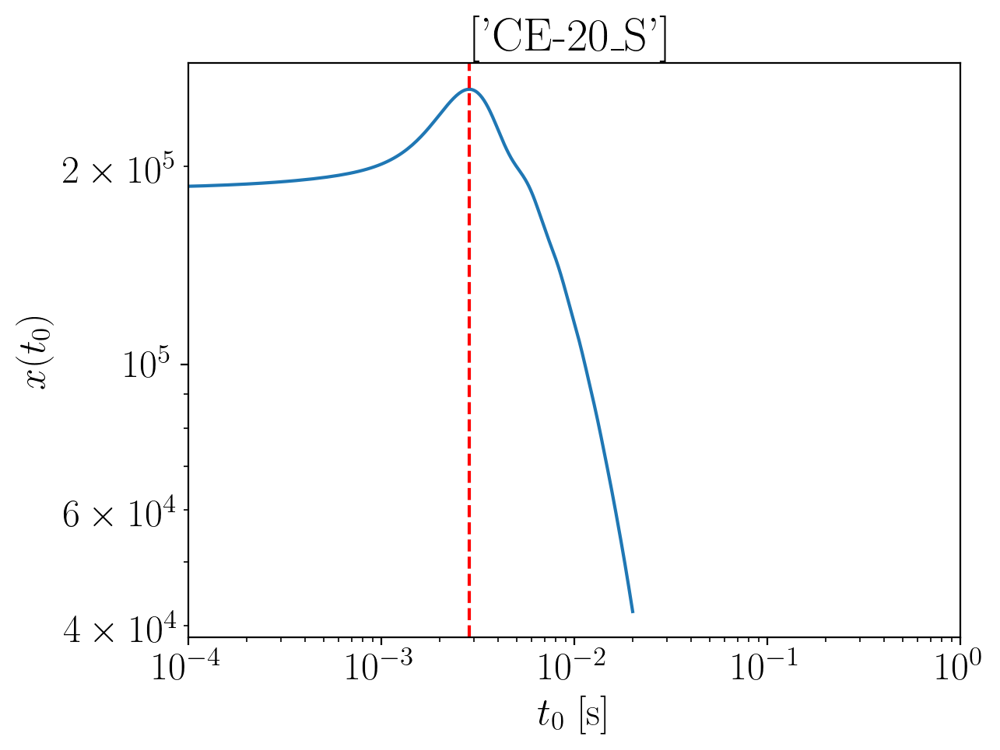

2024-01-15 16:21:01,380 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:01,391 - Network - INFO : PSDs loaded.
2024-01-15 16:21:01,395 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:01,407 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:01,418 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2586138322435048
Inner product:
0.9998446925505527


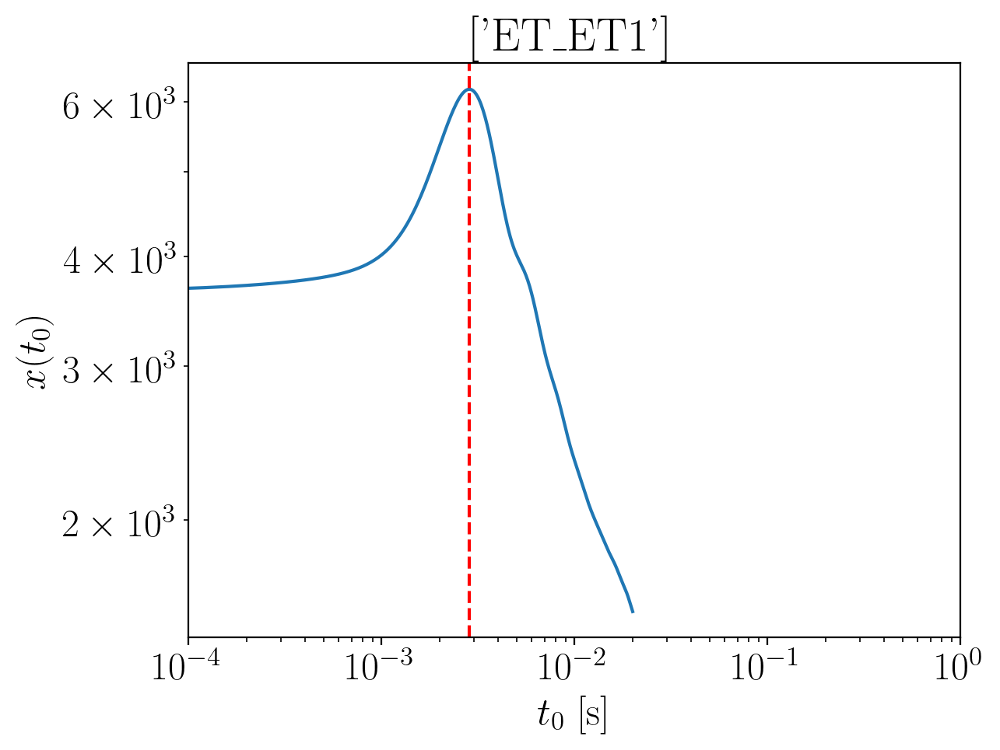

2024-01-15 16:21:03,857 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:03,873 - Network - INFO : PSDs loaded.
2024-01-15 16:21:03,877 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:03,886 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:03,895 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.25182147293594
Inner product:
0.9997026524221062


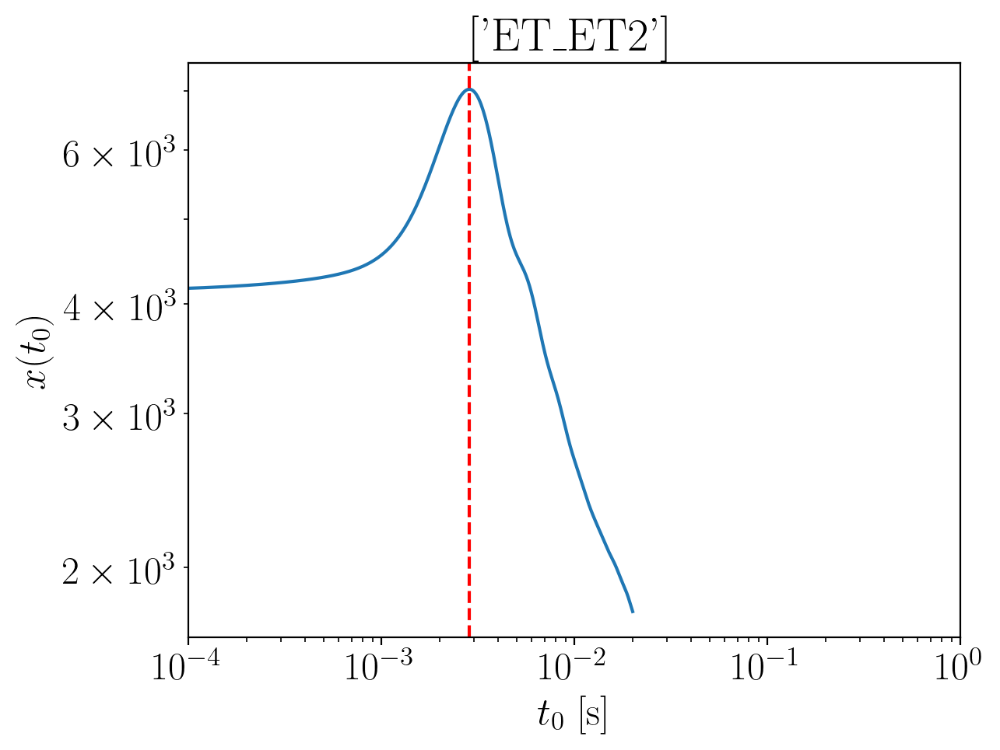

2024-01-15 16:21:06,590 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:06,603 - Network - INFO : PSDs loaded.
2024-01-15 16:21:06,605 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:06,612 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:06,619 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.25182147293594
Inner product:
0.9997026524221063


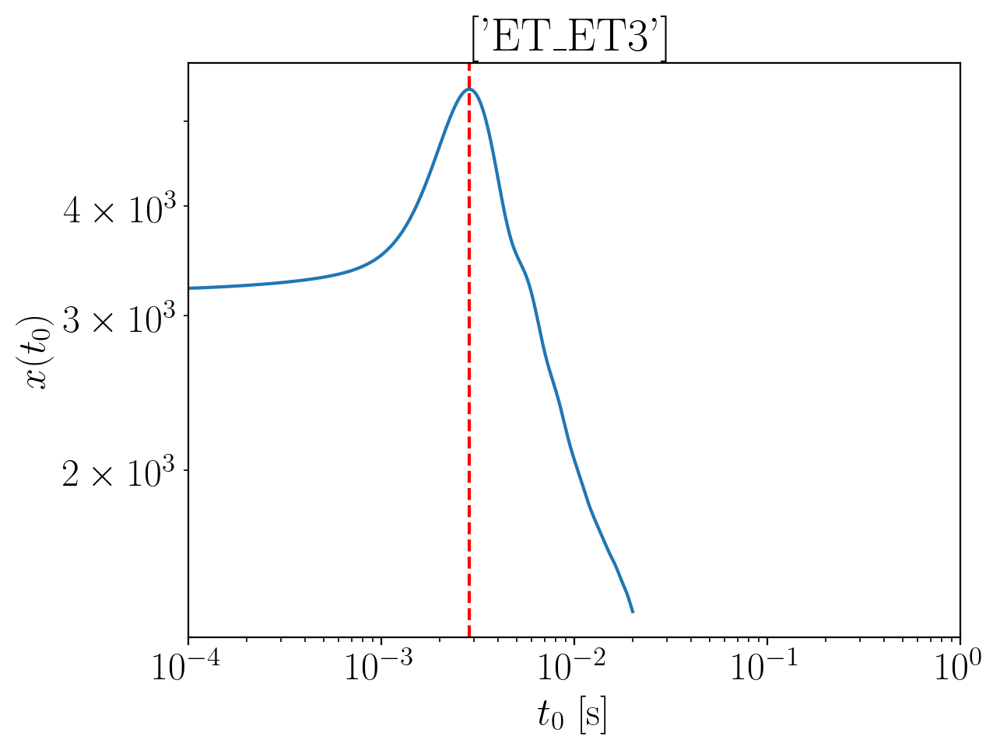

2024-01-15 16:21:08,956 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:08,969 - Network - INFO : PSDs loaded.
2024-01-15 16:21:08,971 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:08,977 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:08,983 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:09,030 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:09,034 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:21:09,046 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.25182147293594
Inner product:
0.9997026524221062


2024-01-15 16:21:15,276 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:21:15,323 - Network - INFO : PSDs loaded.
2024-01-15 16:21:15,341 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:15,386 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:15,387 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:21:15,388 - Network - INFO :    CE-40_C
2024-01-15 16:21:19,543 - Network - INFO :    CE-20_S
2024-01-15 16:21:24,219 - Network - INFO :    ET_ET1
2024-01-15 16:21:28,850 - Network - INFO :    ET_ET2
2024-01-15 16:21:33,514 - Network - INFO :    ET_ET3
2024-01-15 16:21:37,679 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:21:37,686 - Network - INFO : SNRs calculated.
2024-01-15 16:21:37,686 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:21:37,687 - Network - INFO :    CE-40_C
2024-01-15 16:21:37,780 - Network - INFO :

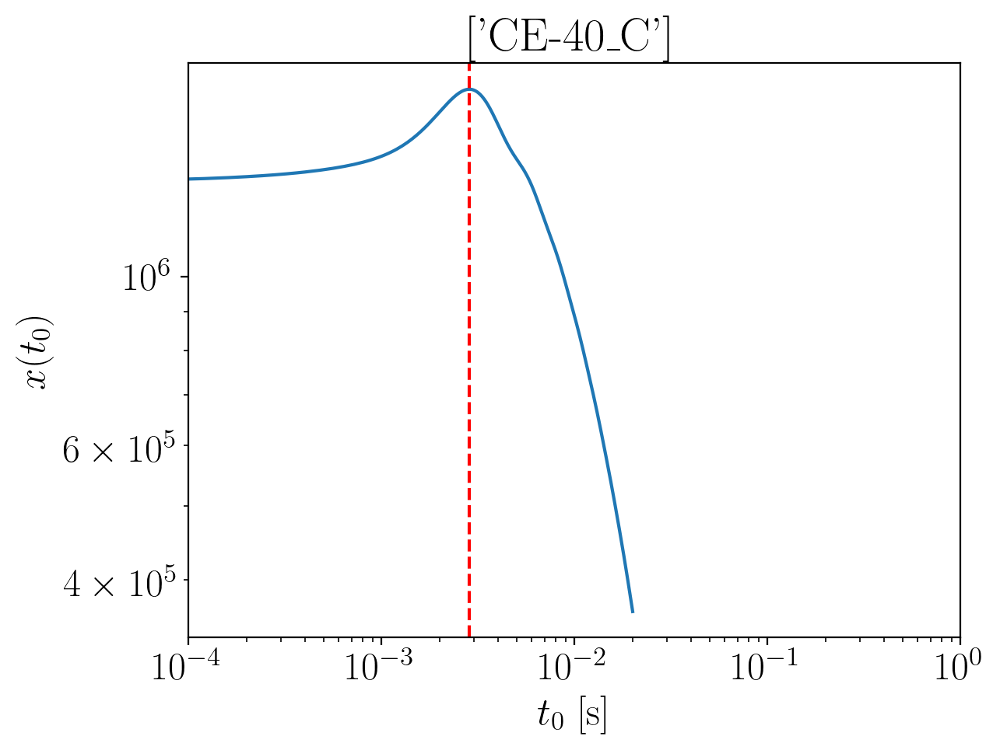

2024-01-15 16:21:39,565 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:39,572 - Network - INFO : PSDs loaded.
2024-01-15 16:21:39,574 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:39,580 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:39,586 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.235205079066056
Inner product:
0.999871772224298


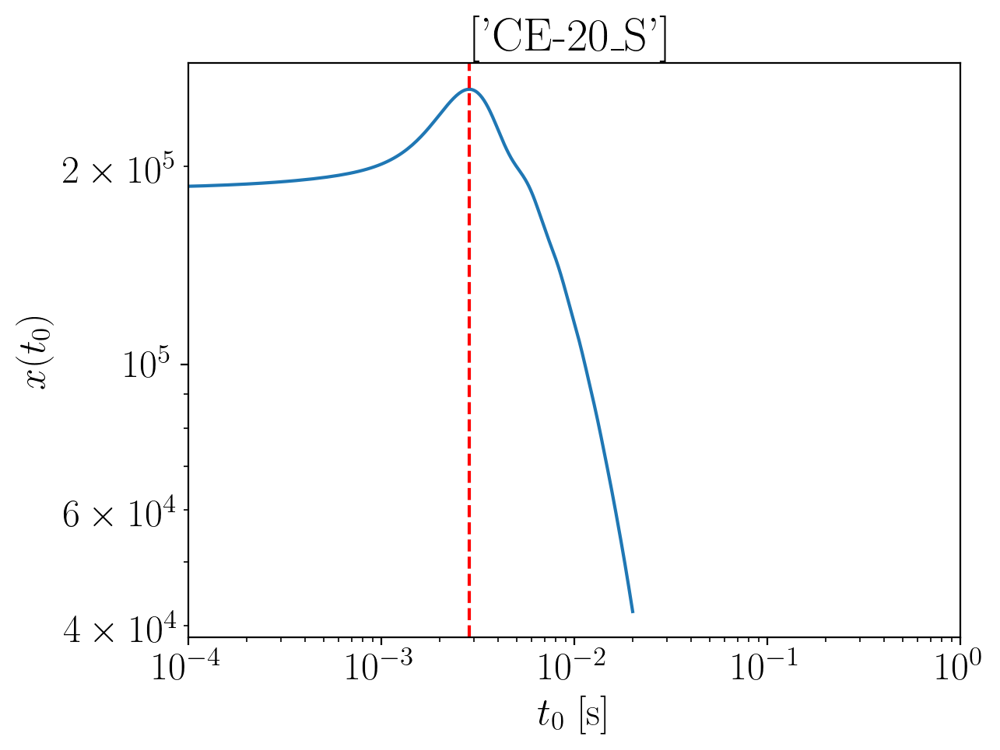

2024-01-15 16:21:40,941 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:40,950 - Network - INFO : PSDs loaded.
2024-01-15 16:21:40,953 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:40,963 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:41,003 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.23675579734087
Inner product:
0.9998446925505527


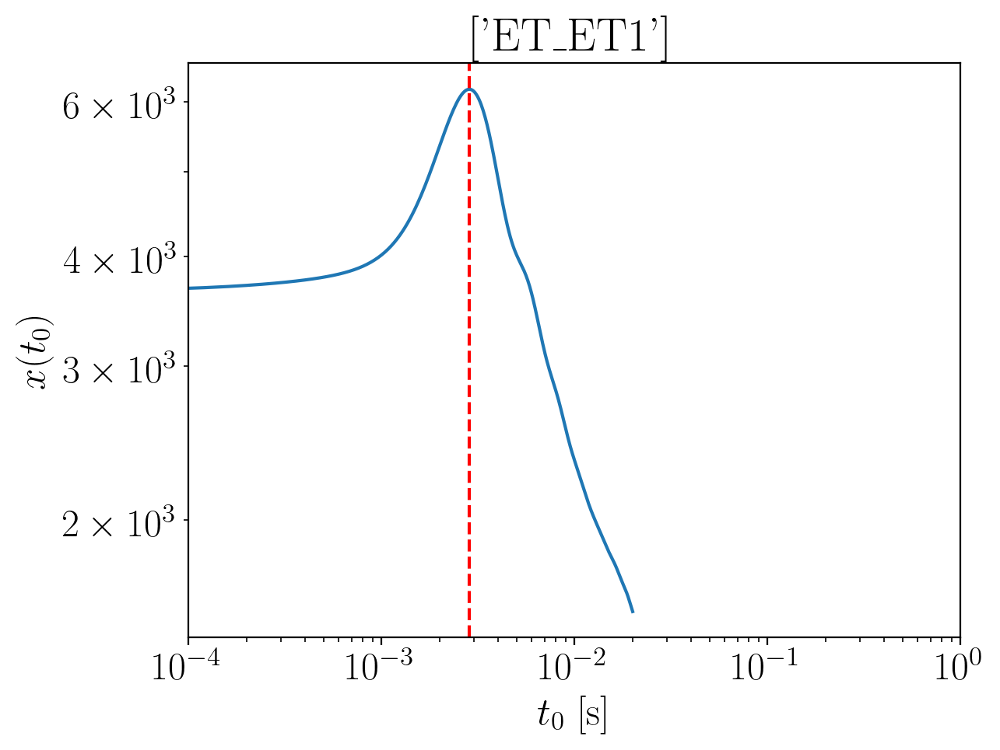

2024-01-15 16:21:43,102 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:43,118 - Network - INFO : PSDs loaded.
2024-01-15 16:21:43,121 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:43,128 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:43,136 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.229963438033305
Inner product:
0.9997026524221063


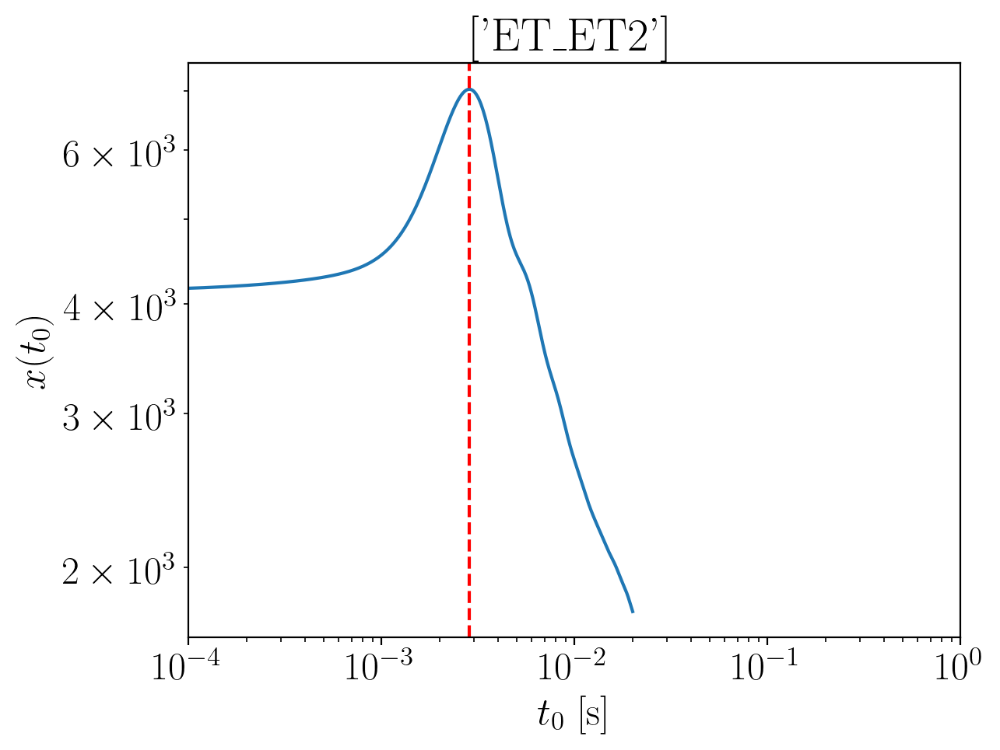

2024-01-15 16:21:45,014 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:45,036 - Network - INFO : PSDs loaded.
2024-01-15 16:21:45,039 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:45,050 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:45,115 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.229963438033305
Inner product:
0.9997026524221063


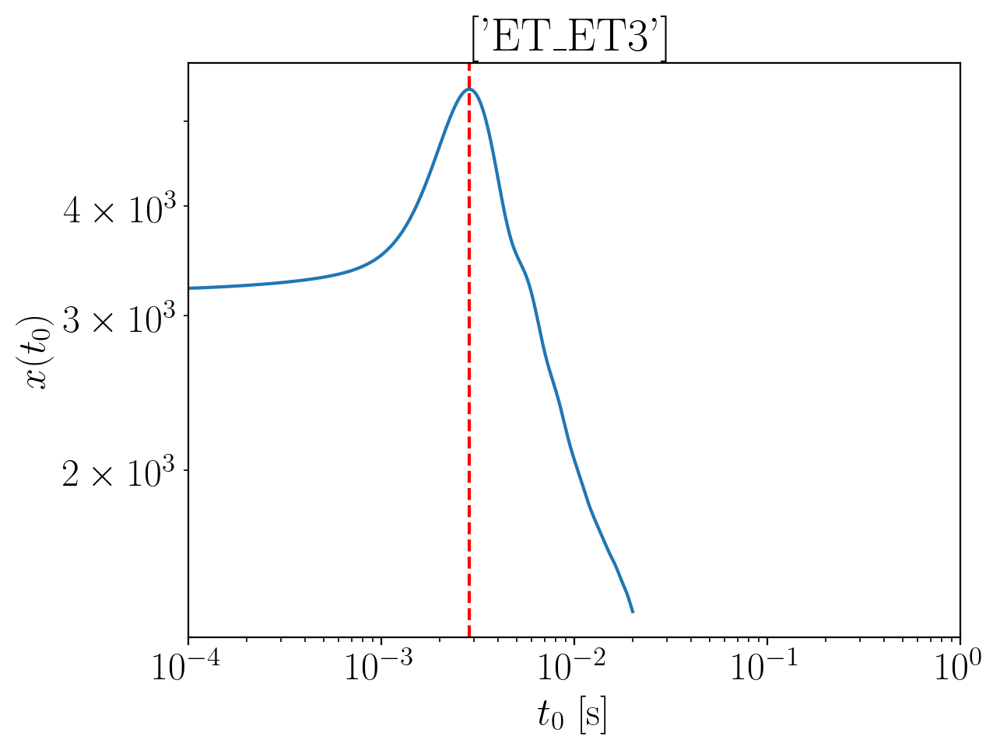

2024-01-15 16:21:47,209 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:47,225 - Network - INFO : PSDs loaded.
2024-01-15 16:21:47,227 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:47,234 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:47,263 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:47,308 - Network - INFO : Polarizations calculated.
2024-01-15 16:21:47,309 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:21:47,317 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.229963438033305
Inner product:
0.9997026524221062


2024-01-15 16:21:53,496 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:21:53,545 - Network - INFO : PSDs loaded.
2024-01-15 16:21:53,551 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:21:53,576 - Network - INFO : Detector responses calculated.
2024-01-15 16:21:53,577 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:21:53,578 - Network - INFO :    CE-40_C
2024-01-15 16:21:57,938 - Network - INFO :    CE-20_S
2024-01-15 16:22:01,709 - Network - INFO :    ET_ET1
2024-01-15 16:22:05,786 - Network - INFO :    ET_ET2
2024-01-15 16:22:09,481 - Network - INFO :    ET_ET3
2024-01-15 16:22:13,390 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:22:13,397 - Network - INFO : SNRs calculated.
2024-01-15 16:22:13,397 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:22:13,398 - Network - INFO :    CE-40_C
2024-01-15 16:22:13,491 - Network - INFO :

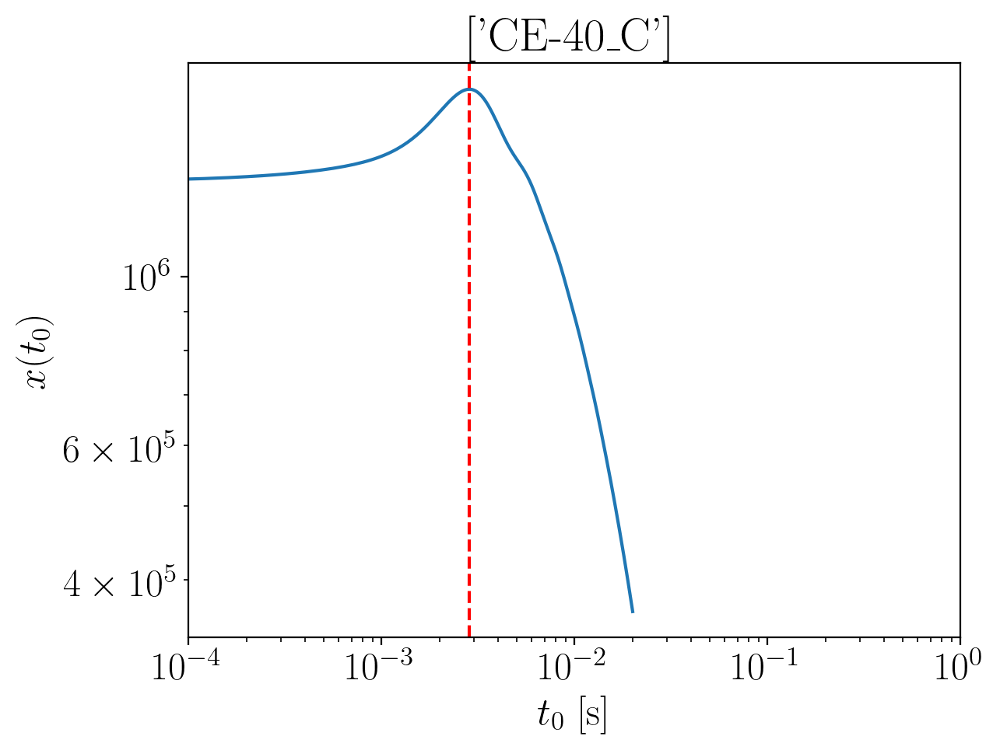

2024-01-15 16:22:15,368 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:15,377 - Network - INFO : PSDs loaded.
2024-01-15 16:22:15,380 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:15,387 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:15,395 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2139454951996025
Inner product:
0.9998717722242981


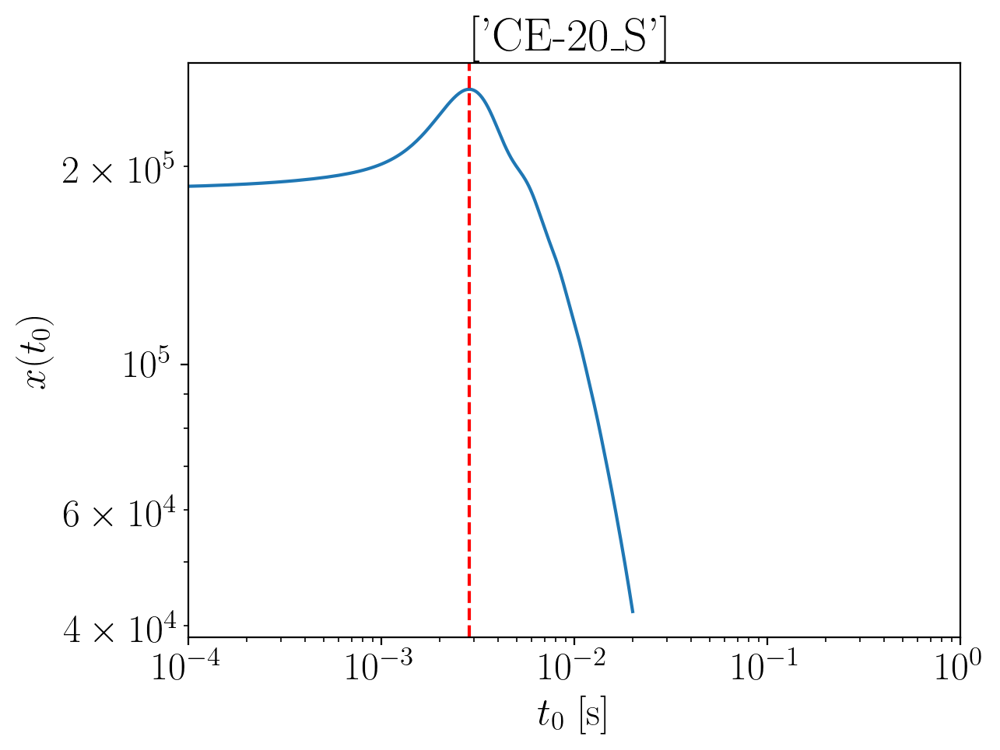

2024-01-15 16:22:17,382 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:17,392 - Network - INFO : PSDs loaded.
2024-01-15 16:22:17,396 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:17,405 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:17,419 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.215496213474416
Inner product:
0.9998446925505529


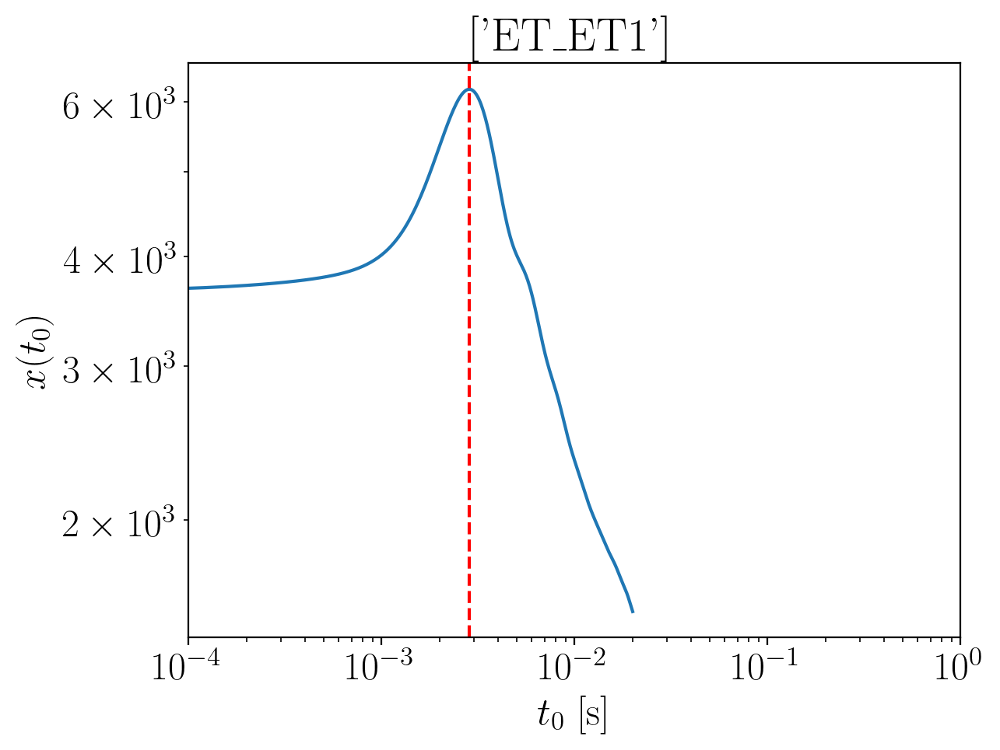

2024-01-15 16:22:19,222 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:19,237 - Network - INFO : PSDs loaded.
2024-01-15 16:22:19,239 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:19,246 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:19,253 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2087038541668518
Inner product:
0.9997026524221063


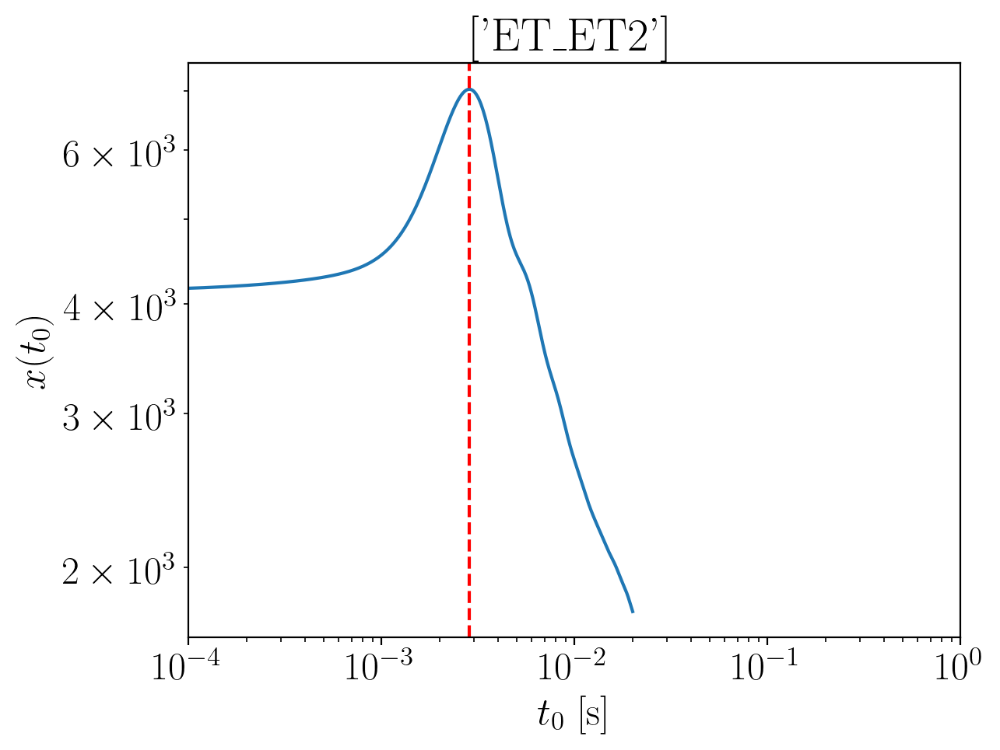

2024-01-15 16:22:21,253 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:21,269 - Network - INFO : PSDs loaded.
2024-01-15 16:22:21,271 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:21,279 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:21,305 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.2087038541668518
Inner product:
0.9997026524221063


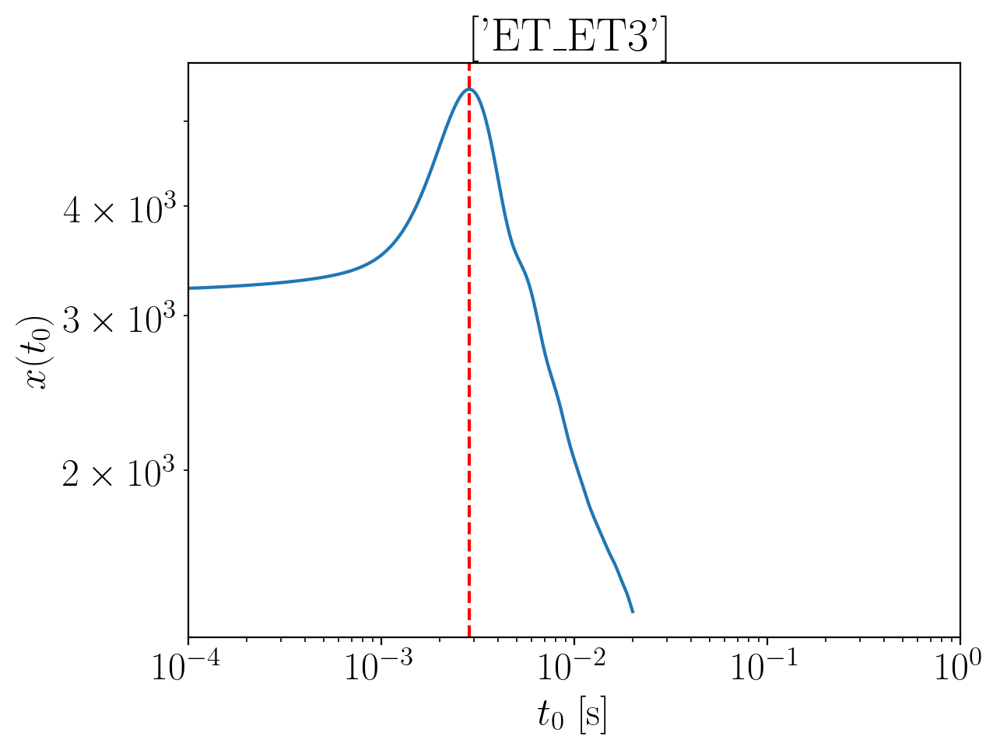

2024-01-15 16:22:23,414 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:23,426 - Network - INFO : PSDs loaded.
2024-01-15 16:22:23,428 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:23,435 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:23,441 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:23,481 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:23,482 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:22:23,495 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.208703854166852
Inner product:
0.999702652422106


2024-01-15 16:22:29,420 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:22:29,469 - Network - INFO : PSDs loaded.
2024-01-15 16:22:29,485 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:29,534 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:29,535 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:22:29,536 - Network - INFO :    CE-40_C
2024-01-15 16:22:34,788 - Network - INFO :    CE-20_S
2024-01-15 16:22:39,256 - Network - INFO :    ET_ET1
2024-01-15 16:22:43,258 - Network - INFO :    ET_ET2
2024-01-15 16:22:47,043 - Network - INFO :    ET_ET3
2024-01-15 16:22:50,980 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:22:50,990 - Network - INFO : SNRs calculated.
2024-01-15 16:22:50,991 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:22:50,992 - Network - INFO :    CE-40_C
2024-01-15 16:22:51,103 - Network - INFO :

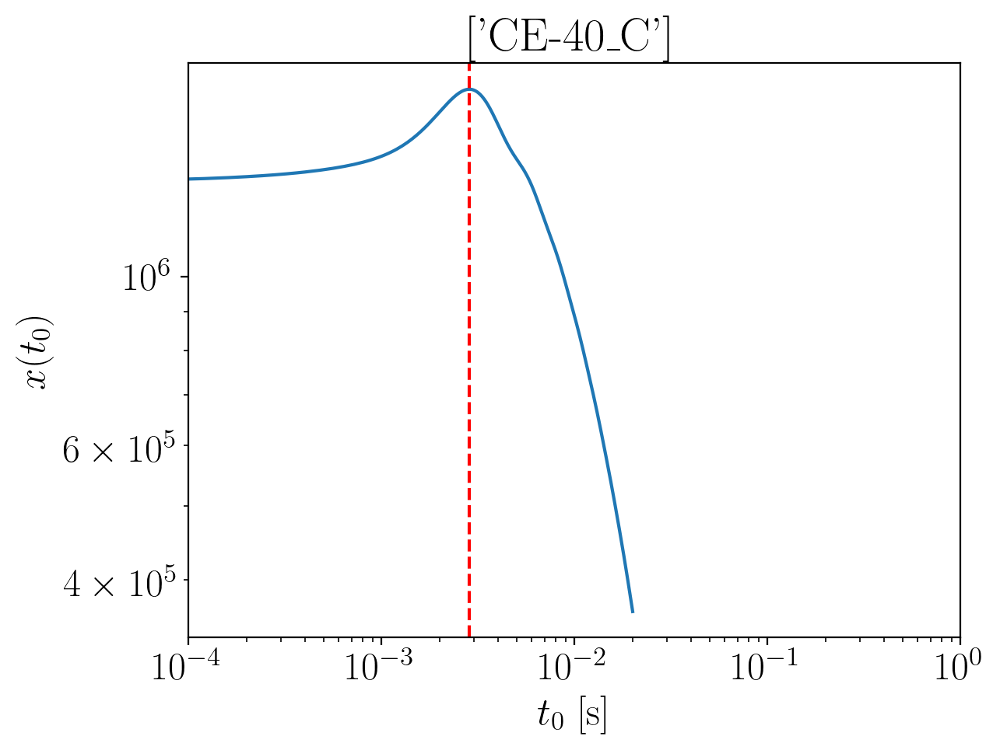

2024-01-15 16:22:54,689 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:54,698 - Network - INFO : PSDs loaded.
2024-01-15 16:22:54,701 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:54,711 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:54,721 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.1931816478729416
Inner product:
0.9998717722242981


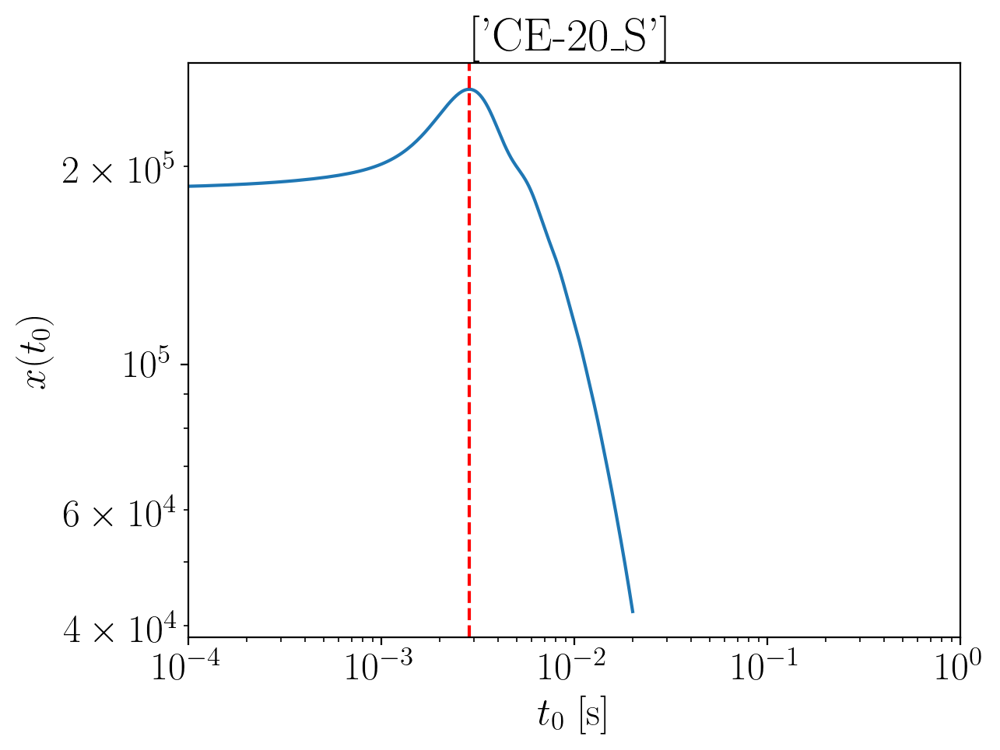

2024-01-15 16:22:57,451 - Network - INFO : Polarizations calculated.
2024-01-15 16:22:57,465 - Network - INFO : PSDs loaded.
2024-01-15 16:22:57,472 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:22:57,525 - Network - INFO : Detector responses calculated.
2024-01-15 16:22:57,592 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.194732366147755
Inner product:
0.9998446925505527


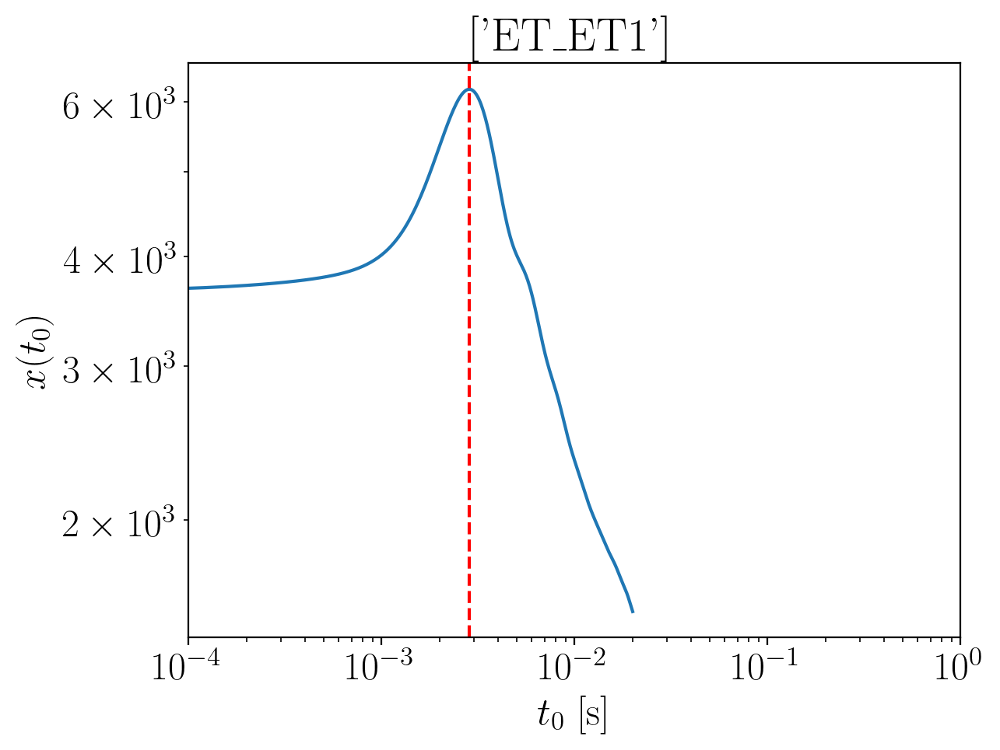

2024-01-15 16:23:00,262 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:00,287 - Network - INFO : PSDs loaded.
2024-01-15 16:23:00,290 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:00,305 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:00,338 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.1879400068401904
Inner product:
0.9997026524221062


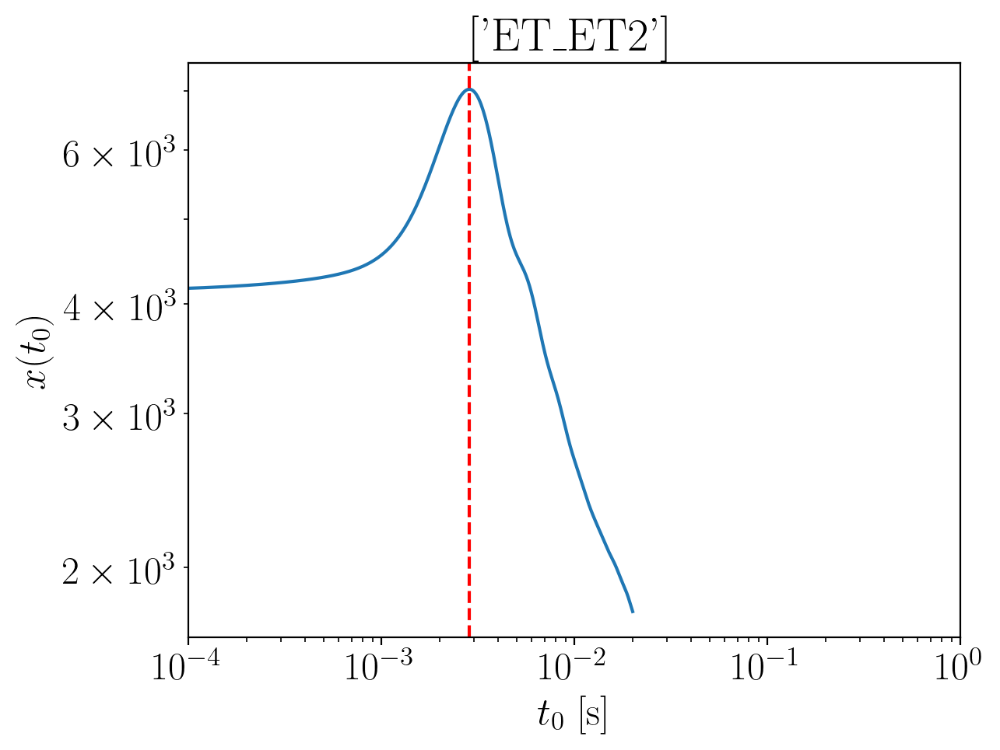

2024-01-15 16:23:03,792 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:03,809 - Network - INFO : PSDs loaded.
2024-01-15 16:23:03,811 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:03,821 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:03,835 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.1879400068401904
Inner product:
0.9997026524221062


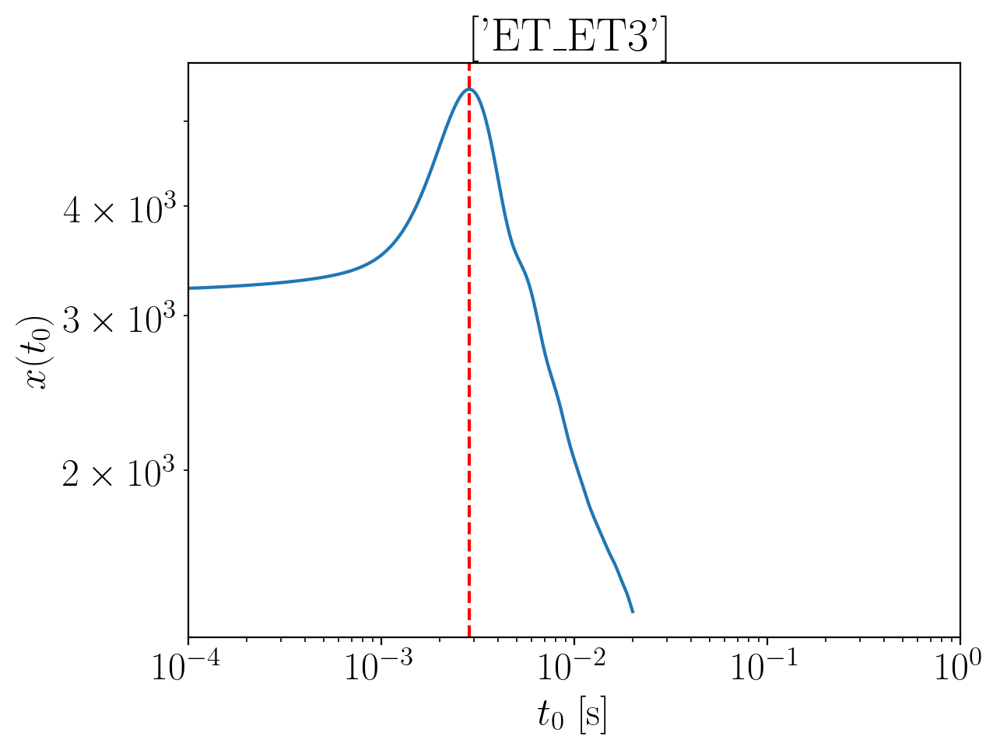

2024-01-15 16:23:06,679 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:06,711 - Network - INFO : PSDs loaded.
2024-01-15 16:23:06,717 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:06,763 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:06,812 - Network - INFO : Polarizations calculated.


time shift: 0.00284
phase shift: -2.18794000684019
Inner product:
0.9997026524221062


2024-01-15 16:23:06,887 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:06,888 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:23:06,900 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:14,935 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:23:14,978 - Network - INFO : PSDs loaded.
2024-01-15 16:23:14,984 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:15,006 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:15,007 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:23:15,007 - Network - INFO :    CE-40_C
2024-01-15 16:23:20,546 - Network - INFO :    CE-20_S
2024-01-15 16:23:26,644 - Network - INFO :    ET_ET1
2024-01-15 16:23:32,814 - Network - INFO :    ET_ET2
2024-01-15 16:23:37,902 - Network - INFO :    ET_ET3
2024-01-15 16:23:42,594 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

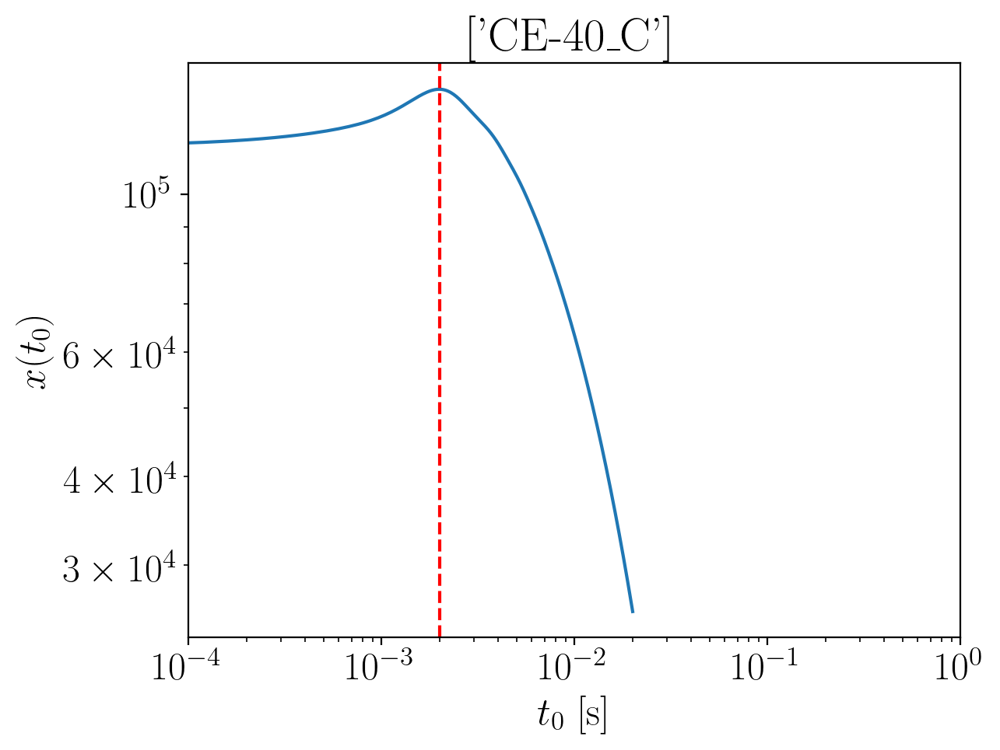

2024-01-15 16:23:45,929 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:45,939 - Network - INFO : PSDs loaded.
2024-01-15 16:23:45,941 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:45,949 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:45,958 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3292400749479767
Inner product:
0.9998671380587916


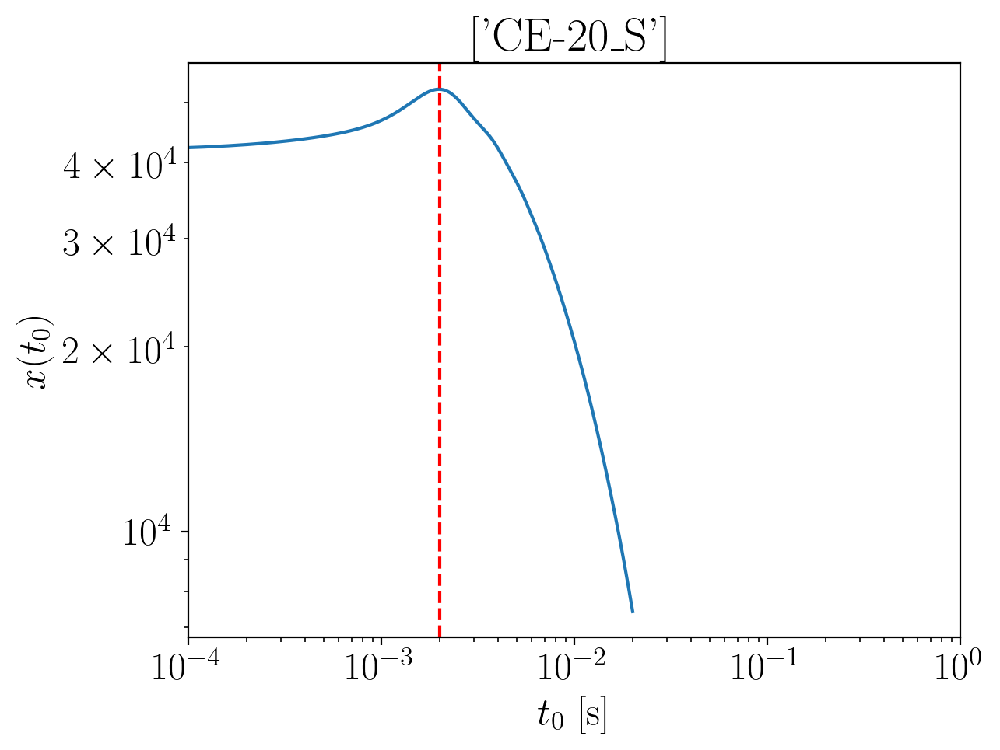

2024-01-15 16:23:47,328 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:47,337 - Network - INFO : PSDs loaded.
2024-01-15 16:23:47,339 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:47,346 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:47,355 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3303778549475345
Inner product:
0.9998288177041239


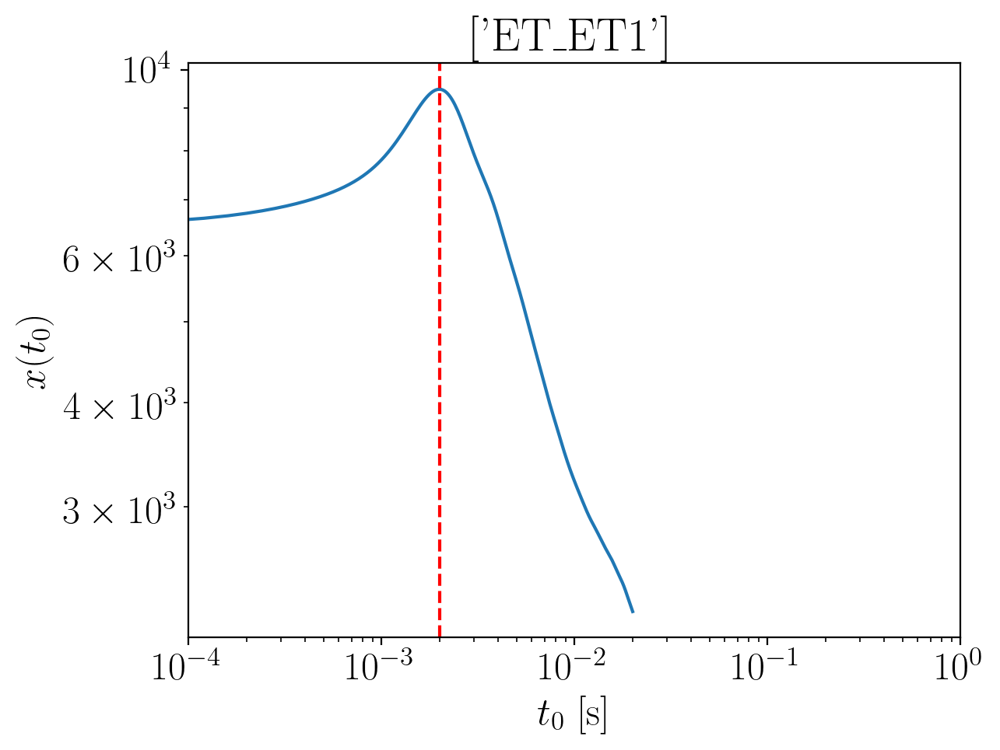

2024-01-15 16:23:49,602 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:49,617 - Network - INFO : PSDs loaded.
2024-01-15 16:23:49,620 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:49,634 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:49,701 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3225129512413063
Inner product:
0.9996945012126618


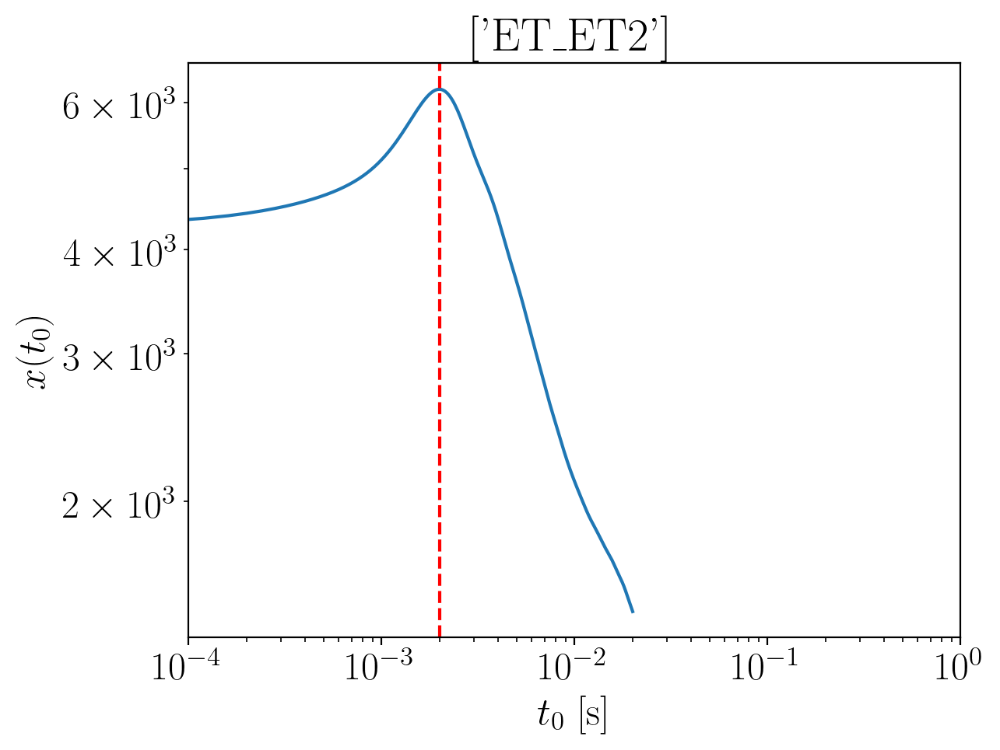

2024-01-15 16:23:51,723 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:51,742 - Network - INFO : PSDs loaded.
2024-01-15 16:23:51,744 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:51,754 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:51,785 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3225129512413063
Inner product:
0.9996945012126618


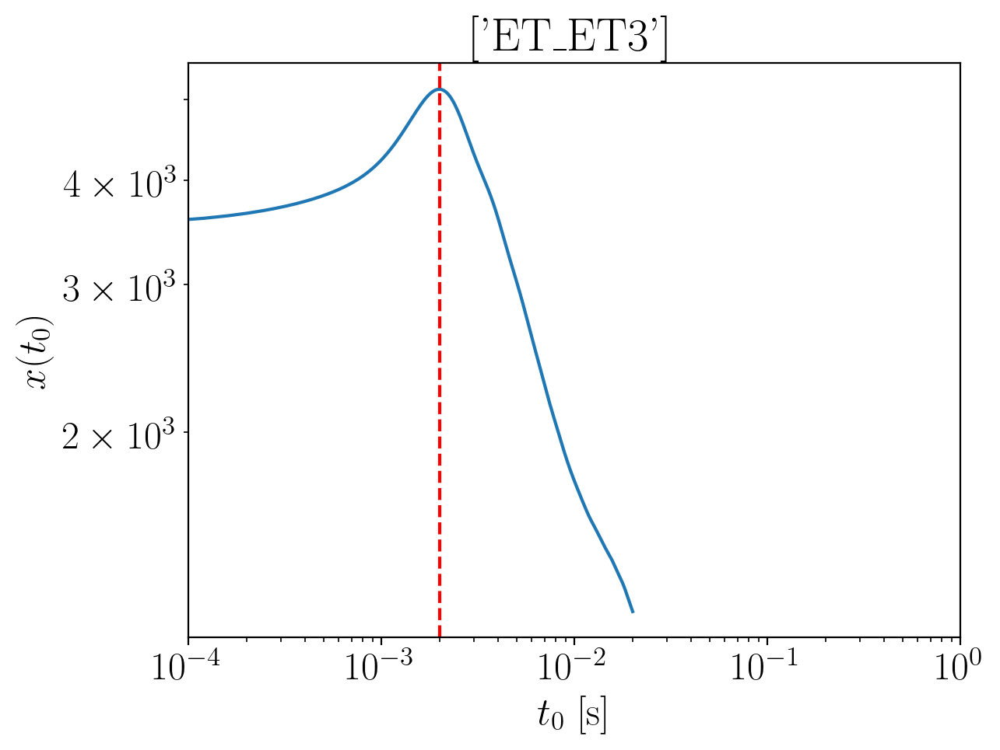

2024-01-15 16:23:53,814 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:53,836 - Network - INFO : PSDs loaded.
2024-01-15 16:23:53,840 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:23:53,852 - Network - INFO : Detector responses calculated.
2024-01-15 16:23:53,866 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:53,919 - Network - INFO : Polarizations calculated.
2024-01-15 16:23:53,920 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:23:53,928 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3225129512413067
Inner product:
0.9996945012126617


2024-01-15 16:24:00,501 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:24:00,548 - Network - INFO : PSDs loaded.
2024-01-15 16:24:00,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:00,627 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:00,628 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:24:00,629 - Network - INFO :    CE-40_C
2024-01-15 16:24:05,229 - Network - INFO :    CE-20_S
2024-01-15 16:24:09,309 - Network - INFO :    ET_ET1
2024-01-15 16:24:13,088 - Network - INFO :    ET_ET2
2024-01-15 16:24:16,786 - Network - INFO :    ET_ET3
2024-01-15 16:24:20,462 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:24:20,470 - Network - INFO : SNRs calculated.
2024-01-15 16:24:20,470 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:24:20,470 - Network - INFO :    CE-40_C
2024-01-15 16:24:20,565 - Network - INFO :

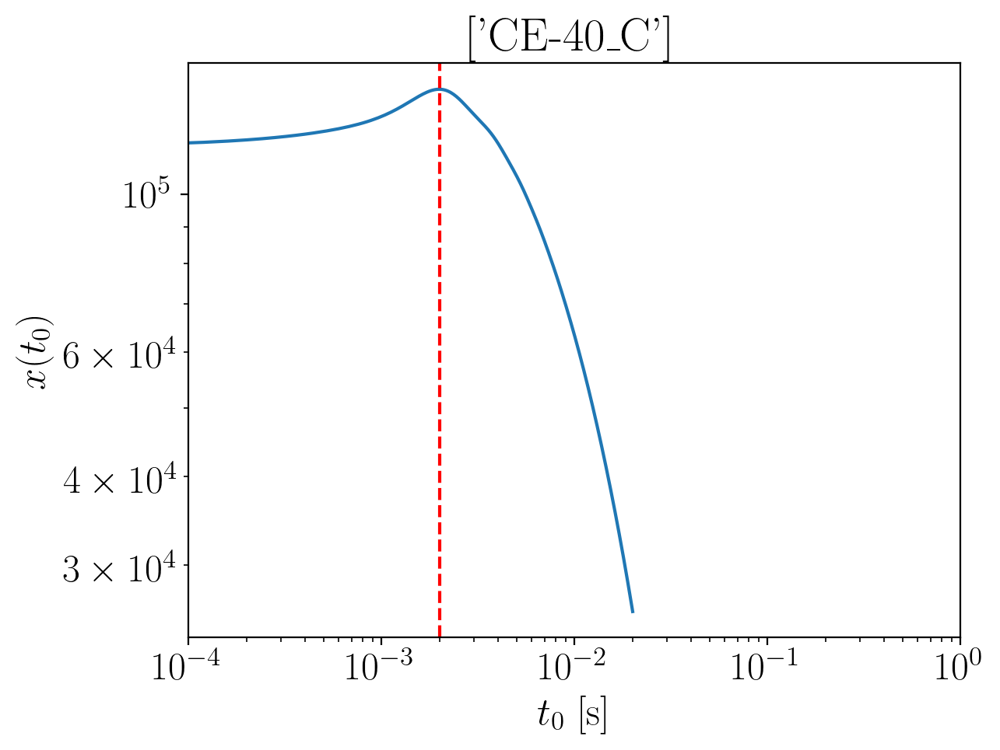

2024-01-15 16:24:22,546 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:22,566 - Network - INFO : PSDs loaded.
2024-01-15 16:24:22,573 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:22,587 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:22,597 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.4172037431707025
Inner product:
0.9998671380587907


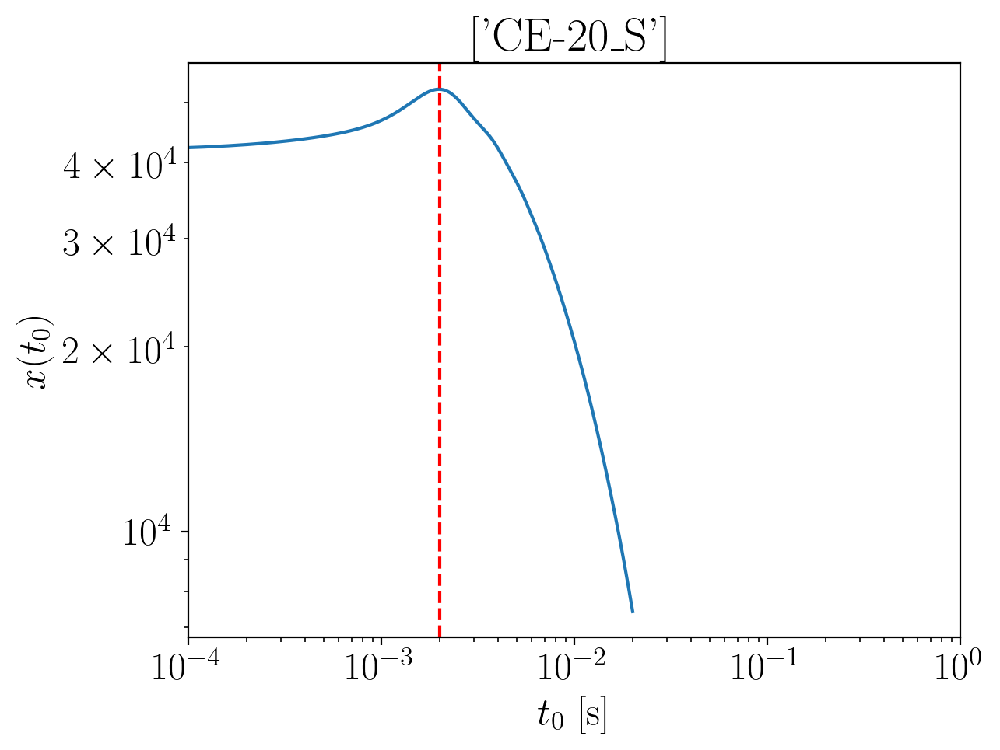

2024-01-15 16:24:23,895 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:23,902 - Network - INFO : PSDs loaded.
2024-01-15 16:24:23,904 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:23,911 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:23,919 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.4183415231702843
Inner product:
0.9998288177041226


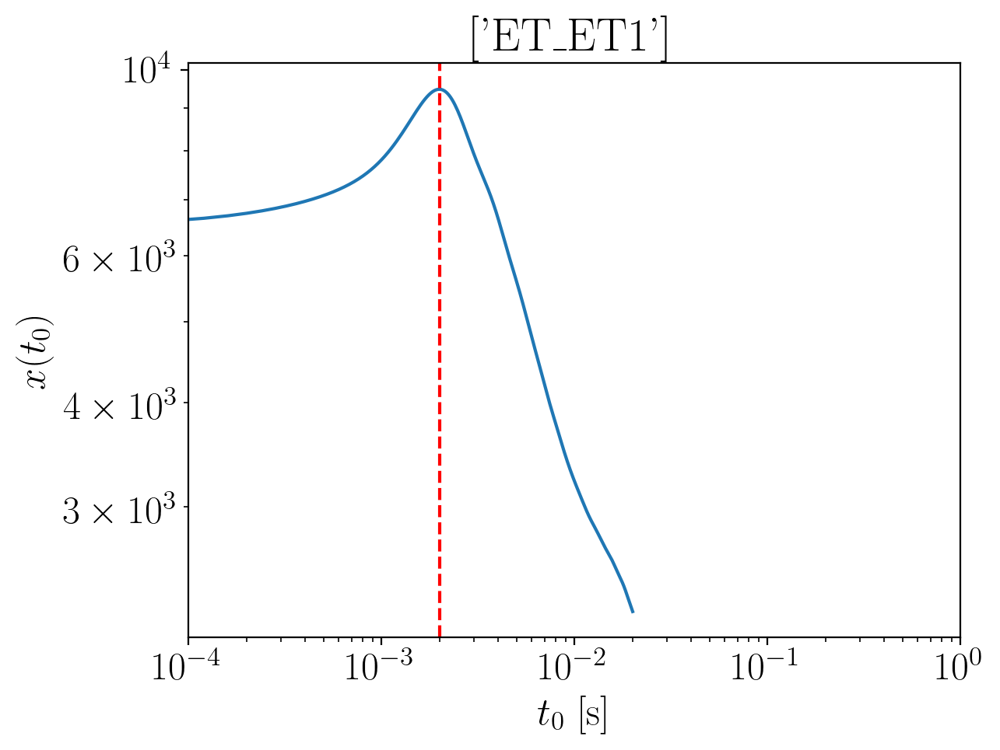

2024-01-15 16:24:26,499 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:26,521 - Network - INFO : PSDs loaded.
2024-01-15 16:24:26,524 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:26,538 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:26,554 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.409338863820802
Inner product:
0.9996945012126607


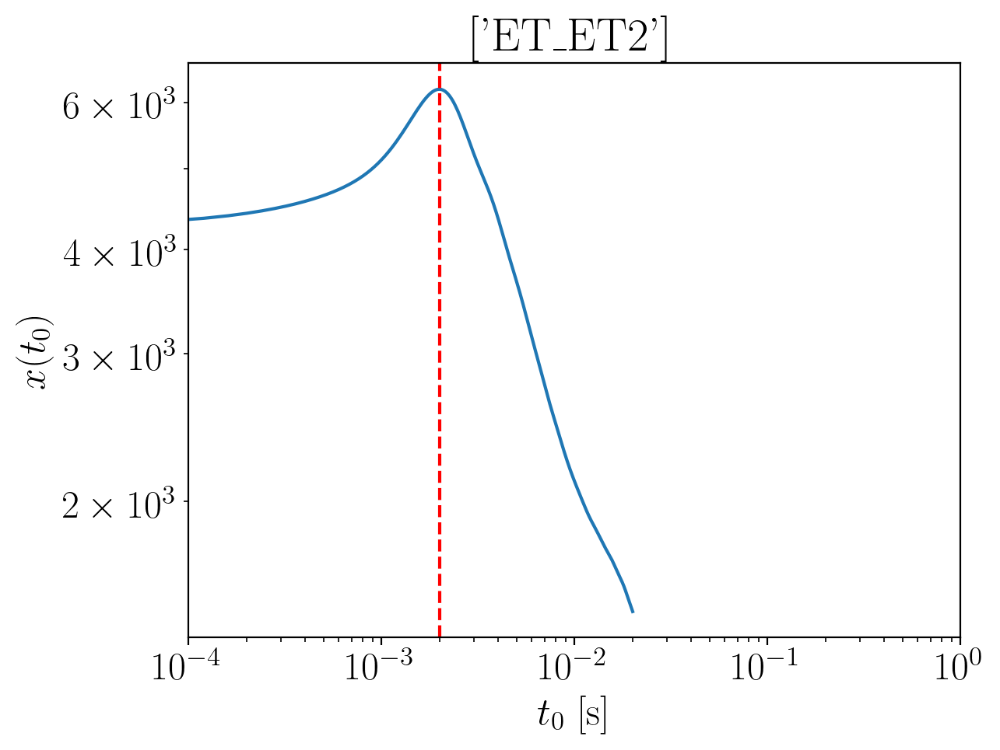

2024-01-15 16:24:28,303 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:28,325 - Network - INFO : PSDs loaded.
2024-01-15 16:24:28,328 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:28,351 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:28,485 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.409338863820802
Inner product:
0.9996945012126605


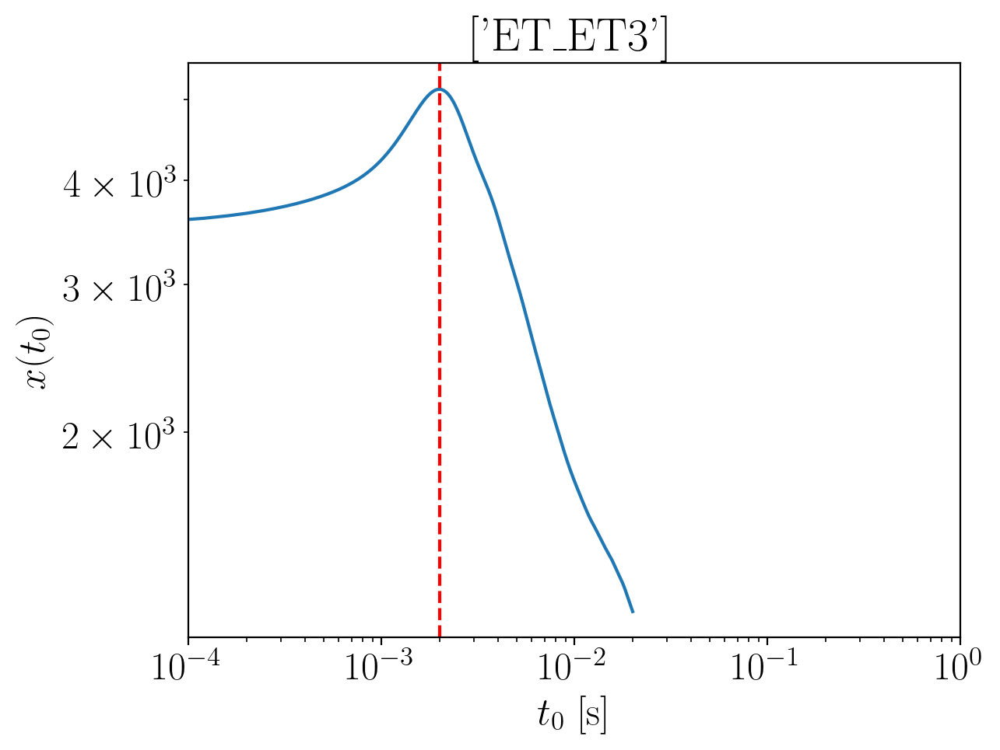

2024-01-15 16:24:30,546 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:30,567 - Network - INFO : PSDs loaded.
2024-01-15 16:24:30,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:30,580 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:30,595 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:30,656 - Network - INFO : Polarizations calculated.
2024-01-15 16:24:30,657 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:24:30,666 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.409338863820802
Inner product:
0.9996945012126603


2024-01-15 16:24:36,704 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:24:36,750 - Network - INFO : PSDs loaded.
2024-01-15 16:24:36,777 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:24:36,842 - Network - INFO : Detector responses calculated.
2024-01-15 16:24:36,843 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:24:36,844 - Network - INFO :    CE-40_C
2024-01-15 16:24:40,915 - Network - INFO :    CE-20_S
2024-01-15 16:24:45,353 - Network - INFO :    ET_ET1
2024-01-15 16:24:49,425 - Network - INFO :    ET_ET2
2024-01-15 16:24:53,991 - Network - INFO :    ET_ET3
2024-01-15 16:24:57,887 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:24:57,895 - Network - INFO : SNRs calculated.
2024-01-15 16:24:57,895 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:24:57,896 - Network - INFO :    CE-40_C
2024-01-15 16:24:57,989 - Network - INFO :

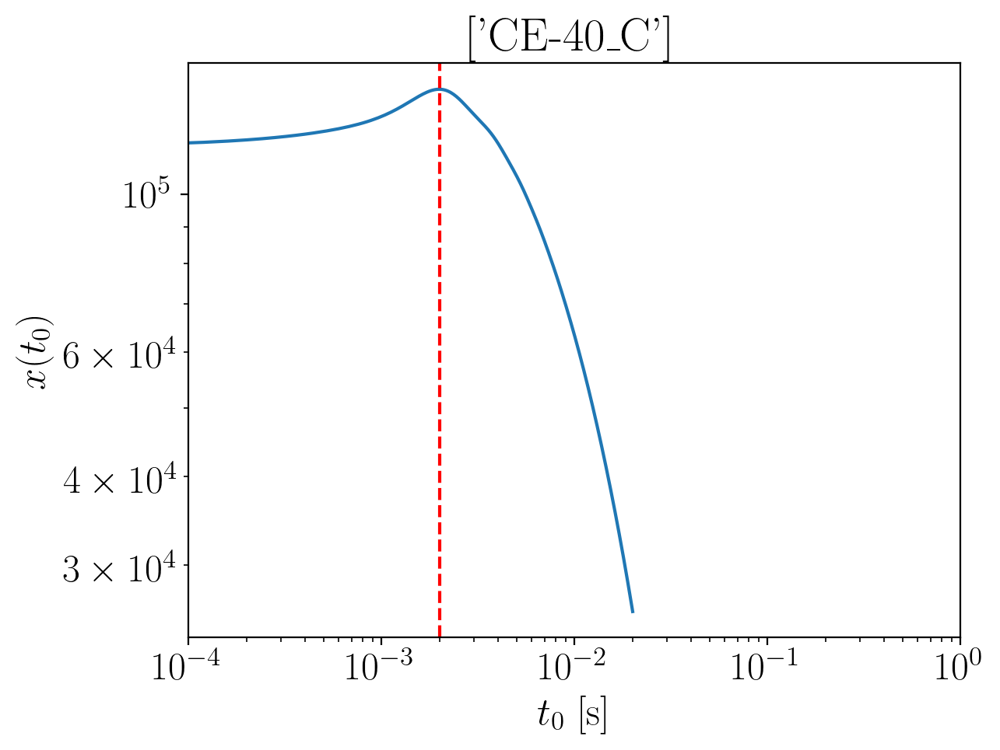

2024-01-15 16:25:00,552 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:00,570 - Network - INFO : PSDs loaded.
2024-01-15 16:25:00,574 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:00,606 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:00,616 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.39142204236791
Inner product:
0.9998671380587917


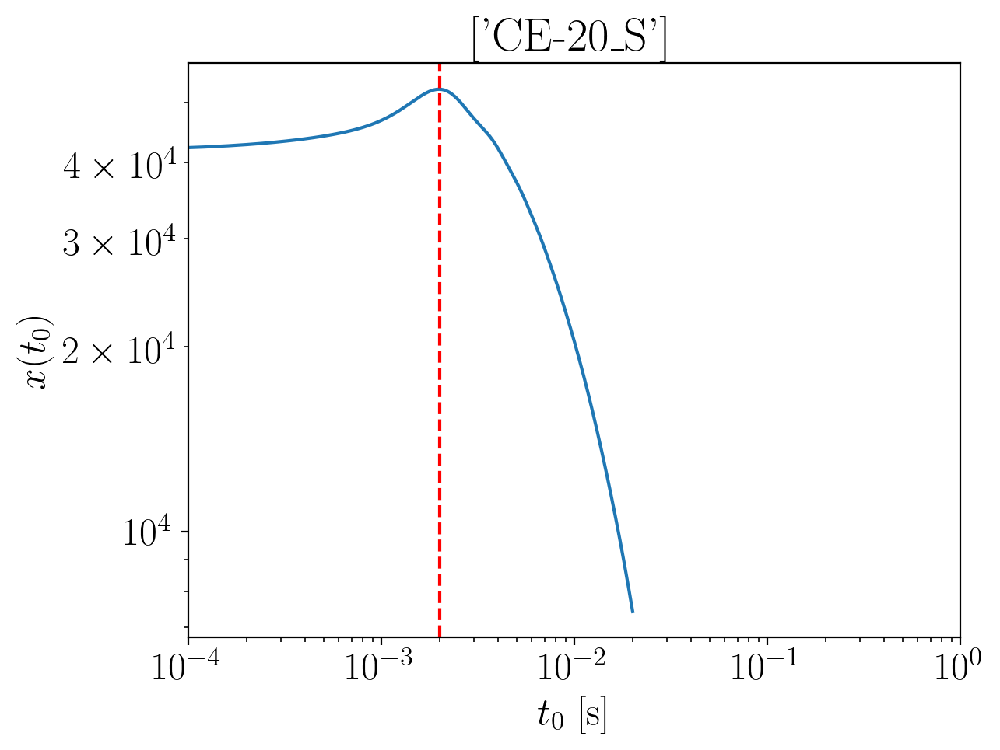

2024-01-15 16:25:03,221 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:03,232 - Network - INFO : PSDs loaded.
2024-01-15 16:25:03,236 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:03,247 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:03,295 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.392559822367466
Inner product:
0.9998288177041237


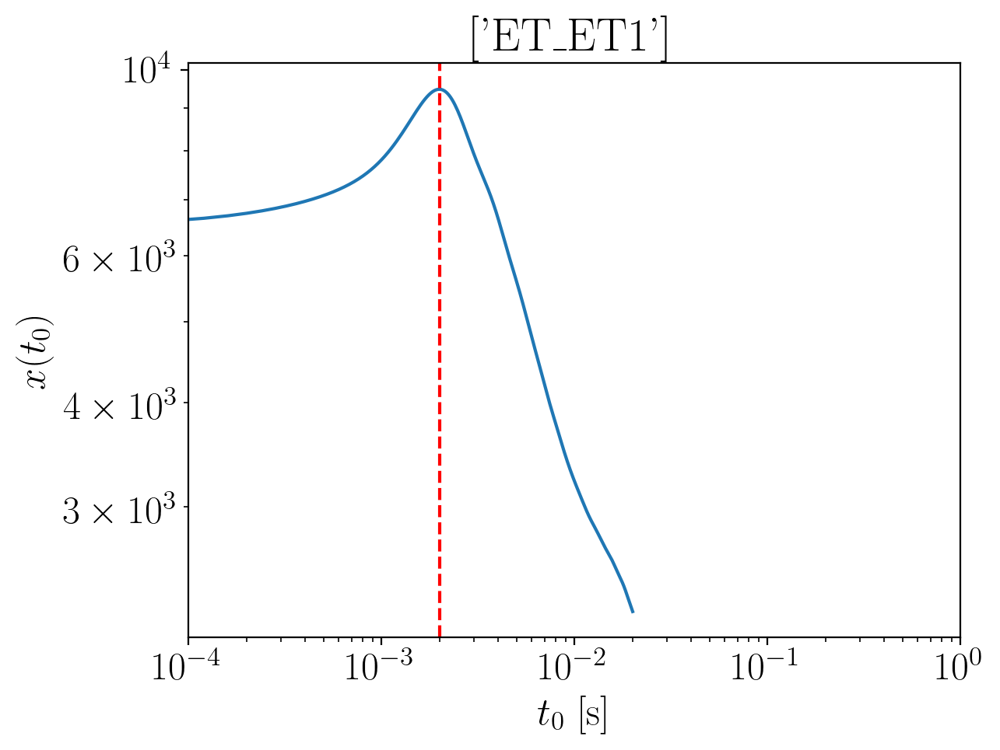

2024-01-15 16:25:05,131 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:05,156 - Network - INFO : PSDs loaded.
2024-01-15 16:25:05,176 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:05,286 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:05,302 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.38355716301801
Inner product:
0.9996945012126618


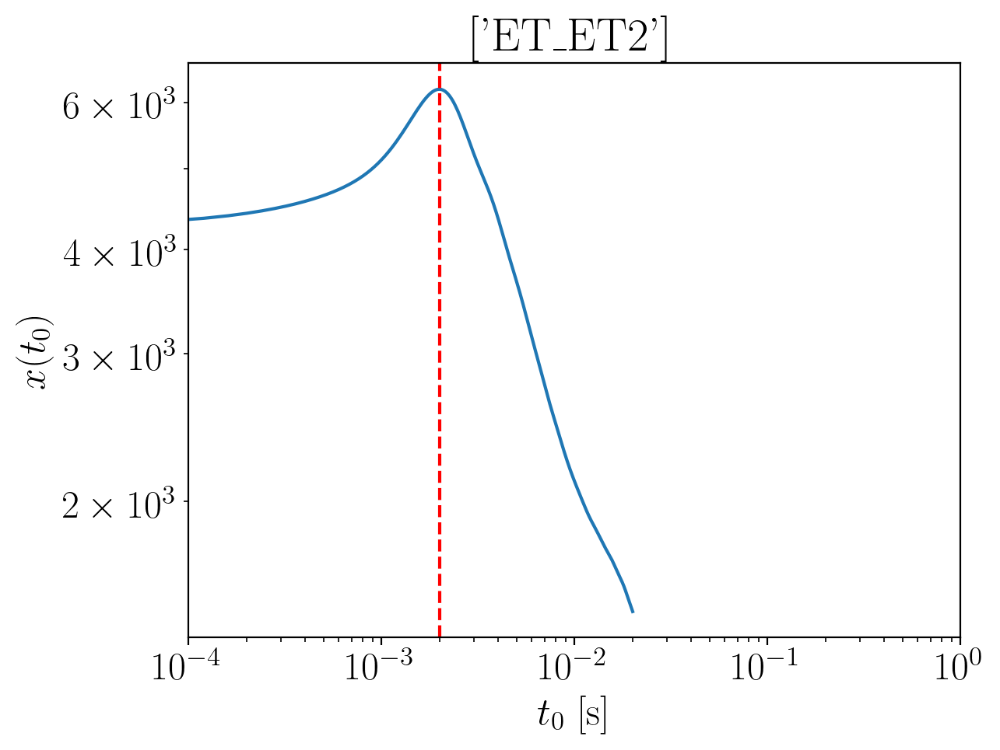

2024-01-15 16:25:07,480 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:07,499 - Network - INFO : PSDs loaded.
2024-01-15 16:25:07,502 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:07,512 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:07,537 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.38355716301801
Inner product:
0.9996945012126618


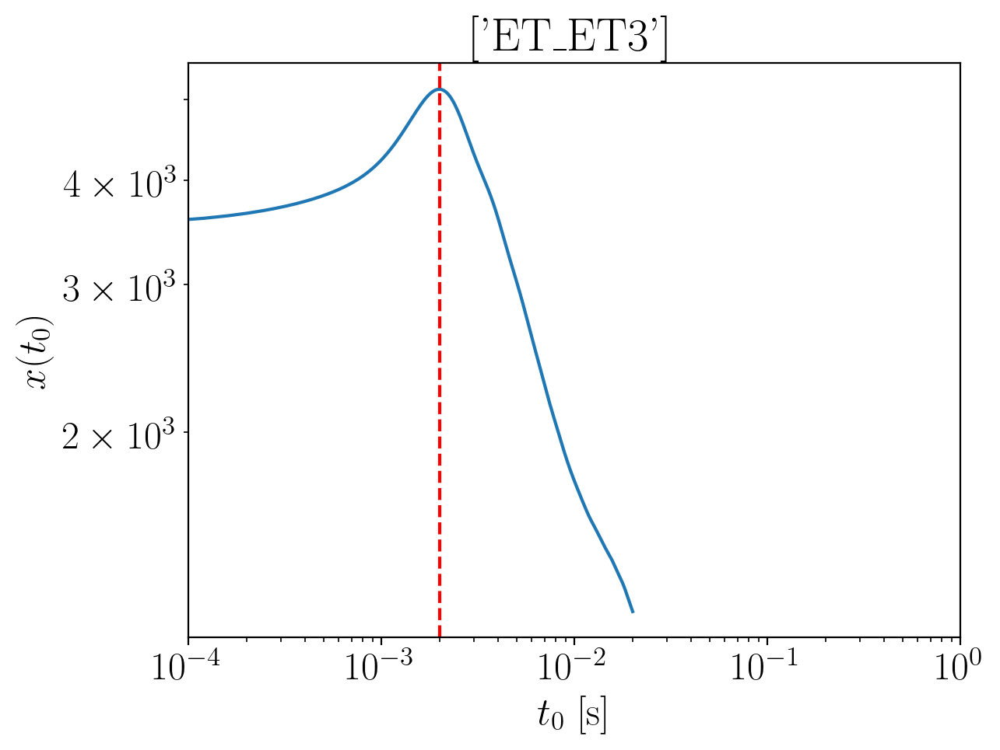

2024-01-15 16:25:09,960 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:09,976 - Network - INFO : PSDs loaded.
2024-01-15 16:25:09,978 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:09,987 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:09,995 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:10,058 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:10,059 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:25:10,082 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.38355716301801
Inner product:
0.9996945012126619


2024-01-15 16:25:16,769 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:25:16,825 - Network - INFO : PSDs loaded.
2024-01-15 16:25:16,852 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:16,898 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:16,911 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:25:16,921 - Network - INFO :    CE-40_C
2024-01-15 16:25:21,465 - Network - INFO :    CE-20_S
2024-01-15 16:25:27,070 - Network - INFO :    ET_ET1
2024-01-15 16:25:31,110 - Network - INFO :    ET_ET2
2024-01-15 16:25:34,906 - Network - INFO :    ET_ET3
2024-01-15 16:25:38,734 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:25:38,742 - Network - INFO : SNRs calculated.
2024-01-15 16:25:38,742 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:25:38,743 - Network - INFO :    CE-40_C
2024-01-15 16:25:38,837 - Network - INFO :

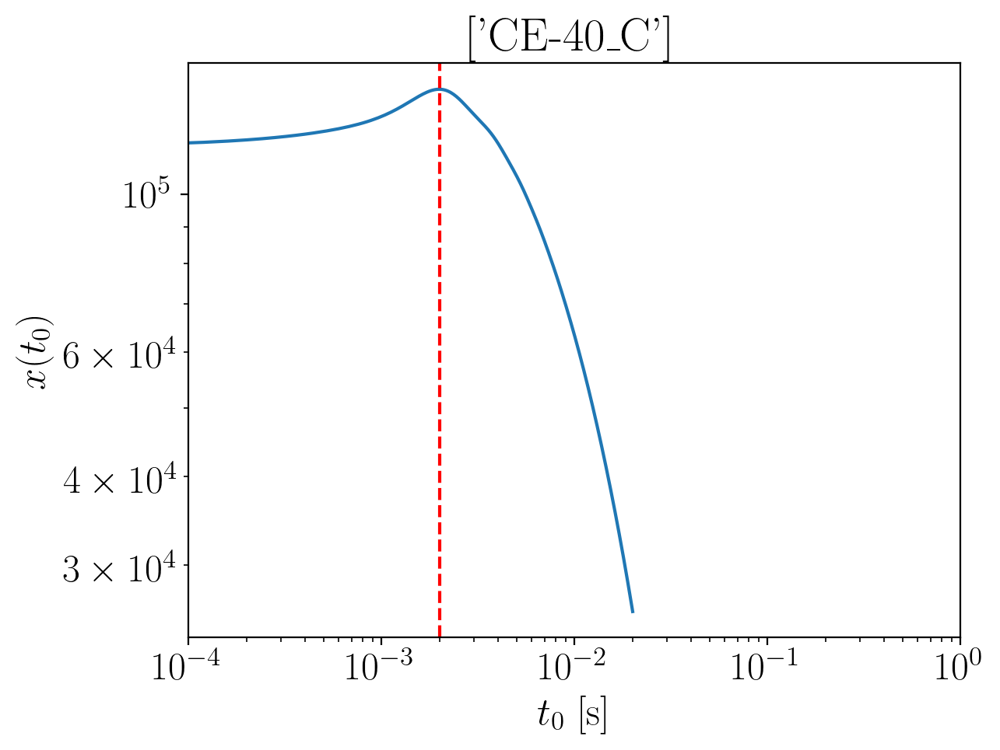

2024-01-15 16:25:40,561 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:40,568 - Network - INFO : PSDs loaded.
2024-01-15 16:25:40,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:40,579 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:40,588 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3692694827509637
Inner product:
0.9998671380587916


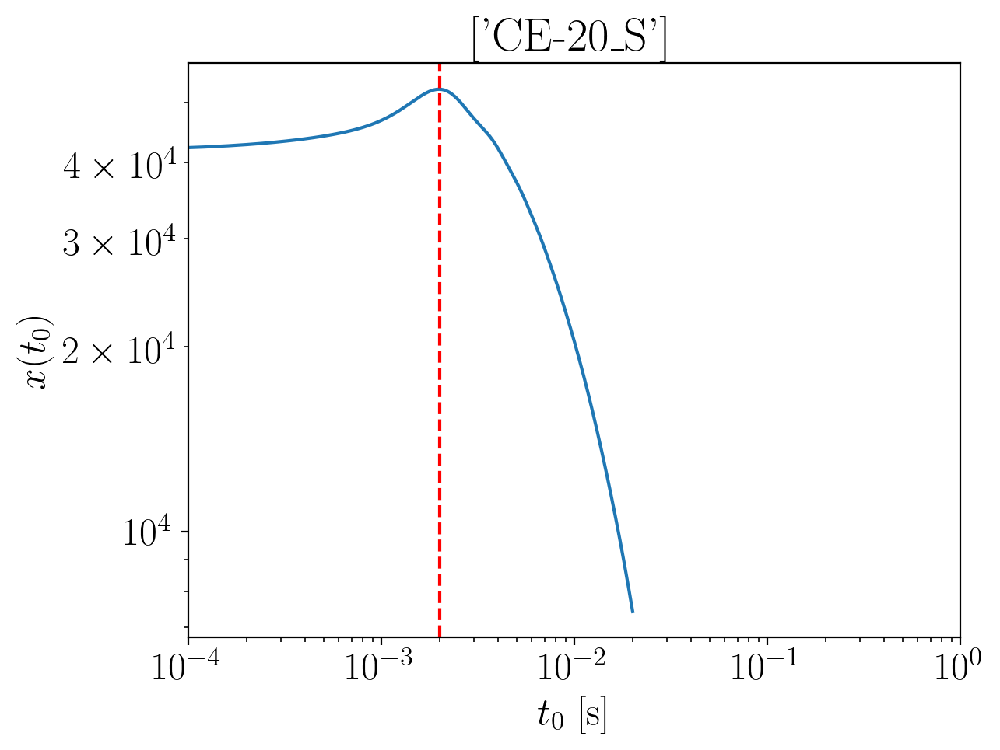

2024-01-15 16:25:41,859 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:41,866 - Network - INFO : PSDs loaded.
2024-01-15 16:25:41,868 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:41,876 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:41,883 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.370407262750521
Inner product:
0.9998288177041238


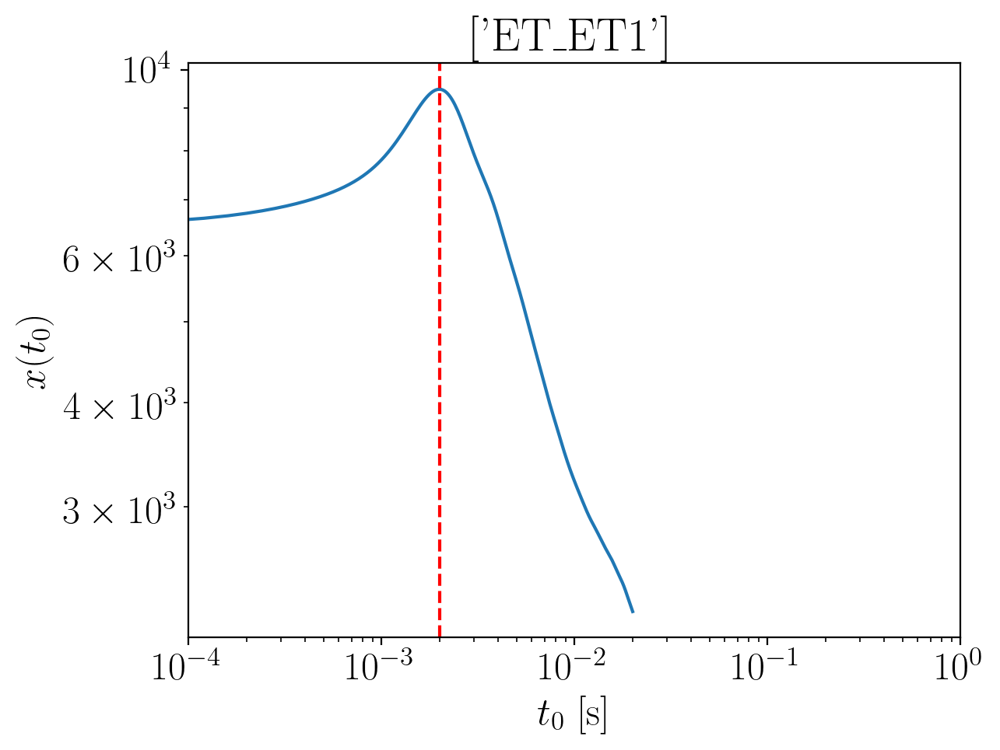

2024-01-15 16:25:43,574 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:43,596 - Network - INFO : PSDs loaded.
2024-01-15 16:25:43,602 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:43,610 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:43,618 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3614046034010774
Inner product:
0.9996945012126622


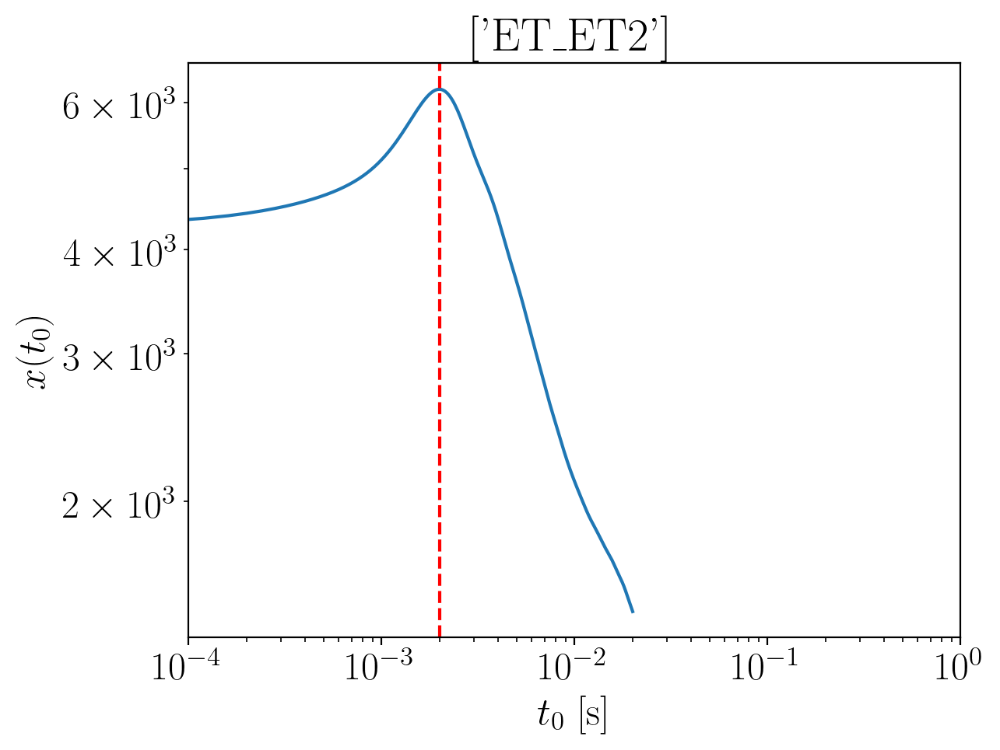

2024-01-15 16:25:45,660 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:45,675 - Network - INFO : PSDs loaded.
2024-01-15 16:25:45,677 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:45,684 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:45,714 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3614046034010774
Inner product:
0.9996945012126619


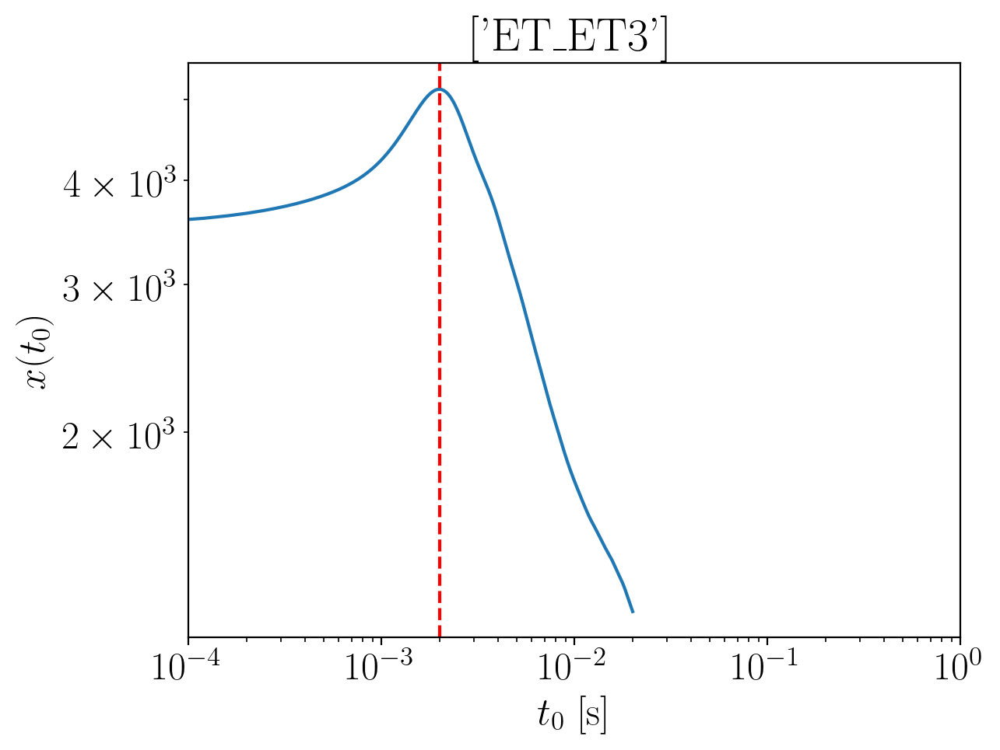

2024-01-15 16:25:47,620 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:47,635 - Network - INFO : PSDs loaded.
2024-01-15 16:25:47,637 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:47,646 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:47,679 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:47,747 - Network - INFO : Polarizations calculated.
2024-01-15 16:25:47,748 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:25:47,755 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3614046034010774
Inner product:
0.9996945012126619


2024-01-15 16:25:53,553 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:25:53,609 - Network - INFO : PSDs loaded.
2024-01-15 16:25:53,623 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:25:53,665 - Network - INFO : Detector responses calculated.
2024-01-15 16:25:53,666 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:25:53,669 - Network - INFO :    CE-40_C
2024-01-15 16:25:57,371 - Network - INFO :    CE-20_S
2024-01-15 16:26:01,573 - Network - INFO :    ET_ET1
2024-01-15 16:26:05,562 - Network - INFO :    ET_ET2
2024-01-15 16:26:09,418 - Network - INFO :    ET_ET3
2024-01-15 16:26:13,021 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:26:13,029 - Network - INFO : SNRs calculated.
2024-01-15 16:26:13,029 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:26:13,029 - Network - INFO :    CE-40_C
2024-01-15 16:26:13,123 - Network - INFO :

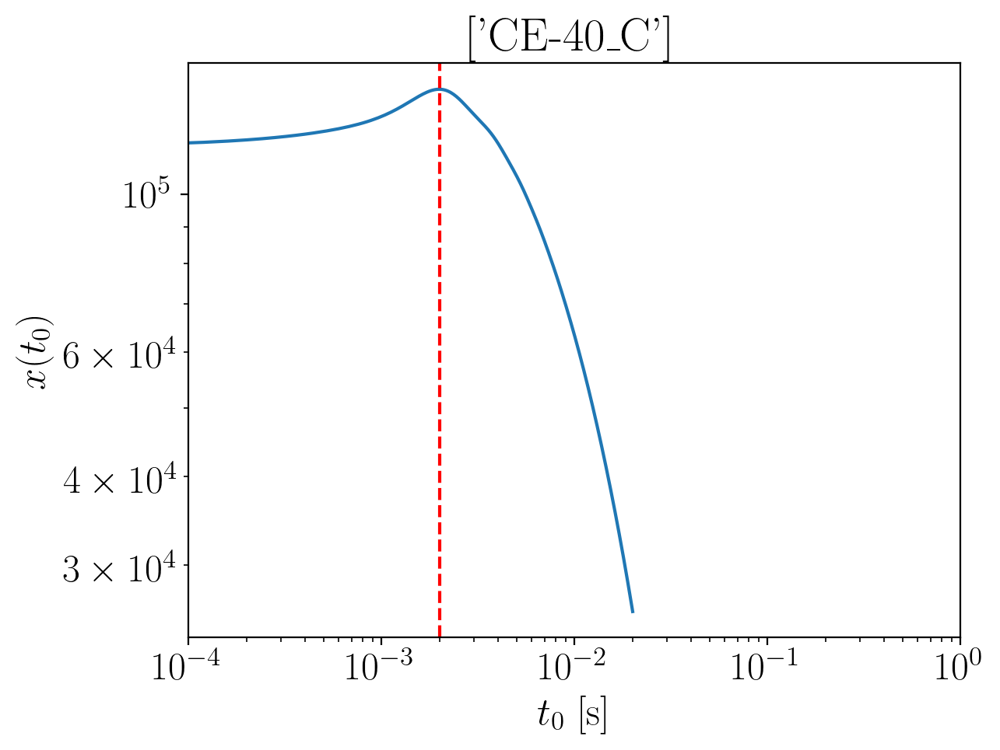

2024-01-15 16:26:14,838 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:14,845 - Network - INFO : PSDs loaded.
2024-01-15 16:26:14,846 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:14,853 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:14,860 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3491484873627266
Inner product:
0.9998671380587919


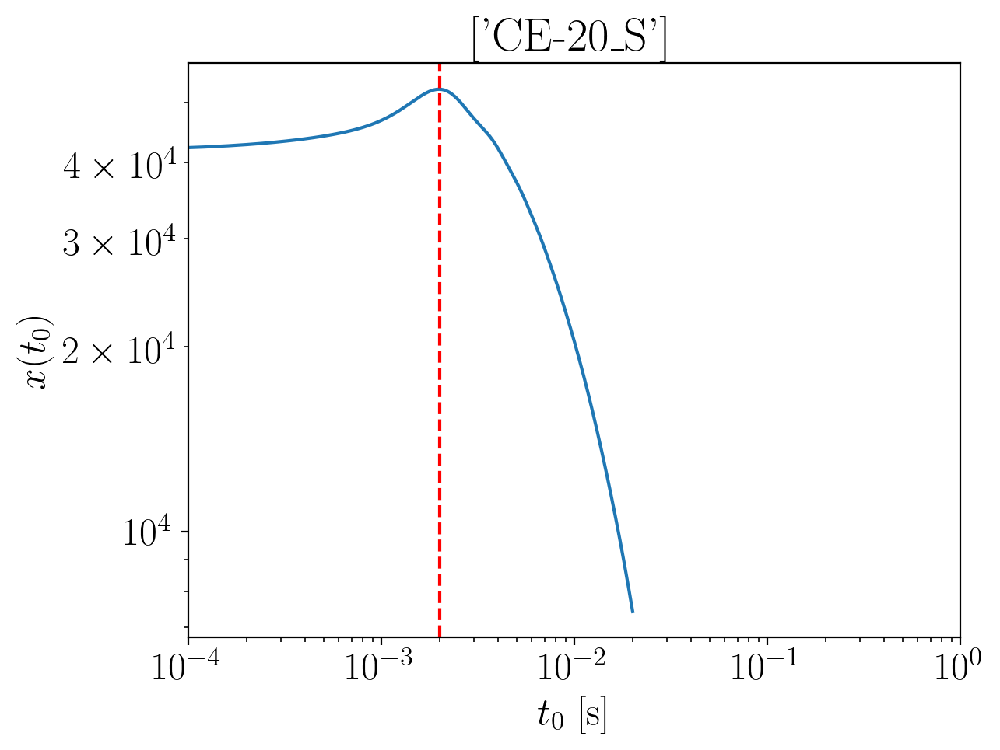

2024-01-15 16:26:16,040 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:16,050 - Network - INFO : PSDs loaded.
2024-01-15 16:26:16,055 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:16,091 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:16,115 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3502862673622826
Inner product:
0.9998288177041241


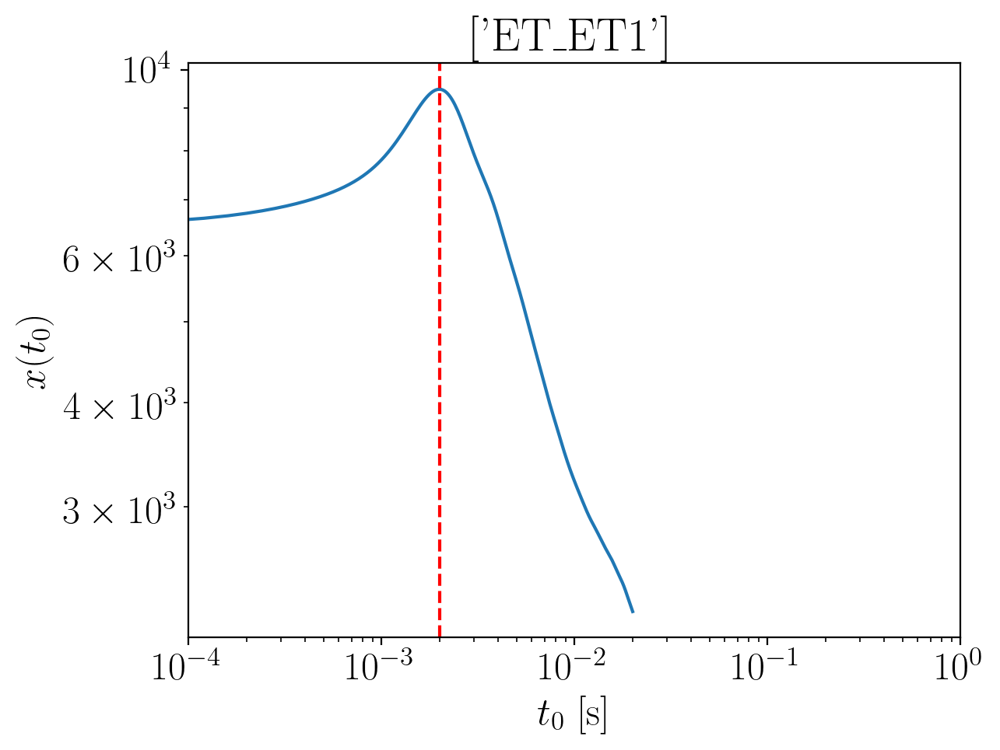

2024-01-15 16:26:17,547 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:17,560 - Network - INFO : PSDs loaded.
2024-01-15 16:26:17,562 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:17,569 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:17,576 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3412836080128403
Inner product:
0.9996945012126621


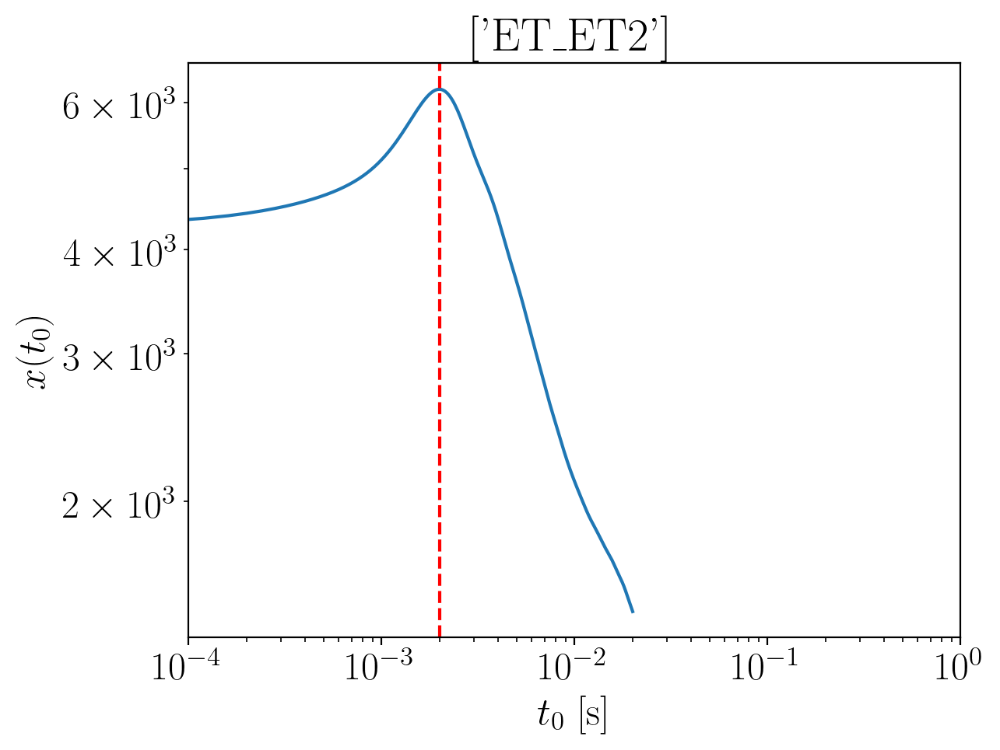

2024-01-15 16:26:19,039 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:19,054 - Network - INFO : PSDs loaded.
2024-01-15 16:26:19,070 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:19,098 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:19,114 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3412836080128403
Inner product:
0.9996945012126619


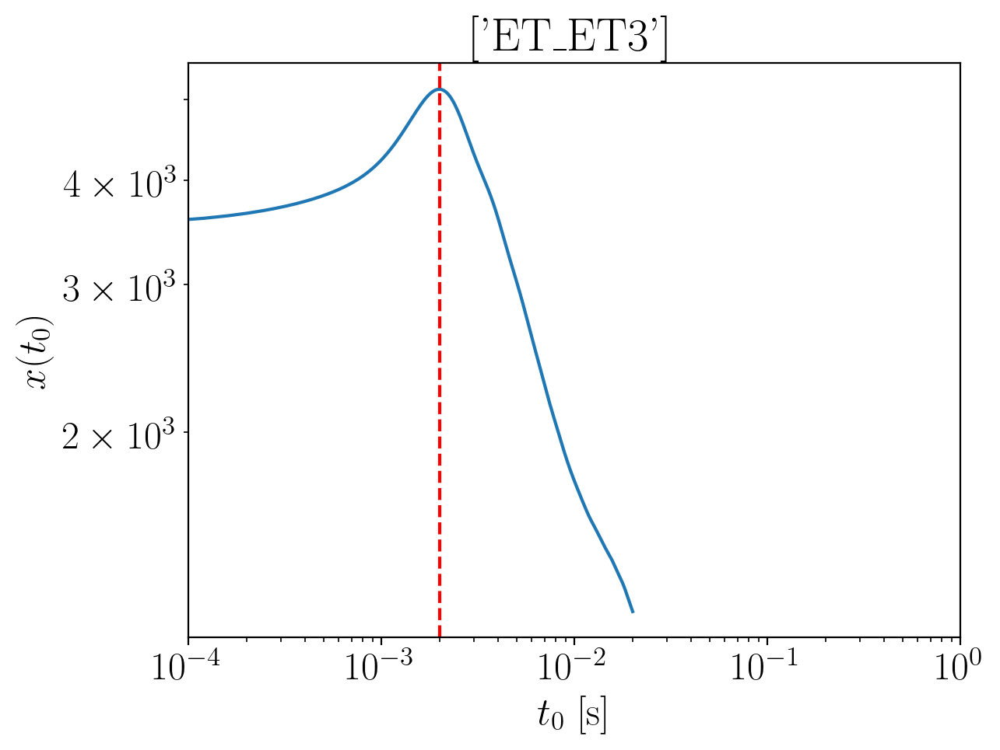

2024-01-15 16:26:20,589 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:20,602 - Network - INFO : PSDs loaded.
2024-01-15 16:26:20,604 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:20,611 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:20,618 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:20,643 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:20,644 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:26:20,653 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3412836080128403
Inner product:
0.9996945012126621


2024-01-15 16:26:26,885 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:26:26,933 - Network - INFO : PSDs loaded.
2024-01-15 16:26:26,952 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:26,999 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:27,000 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:26:27,001 - Network - INFO :    CE-40_C
2024-01-15 16:26:31,115 - Network - INFO :    CE-20_S
2024-01-15 16:26:34,740 - Network - INFO :    ET_ET1
2024-01-15 16:26:38,368 - Network - INFO :    ET_ET2
2024-01-15 16:26:42,069 - Network - INFO :    ET_ET3
2024-01-15 16:26:45,788 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:26:45,796 - Network - INFO : SNRs calculated.
2024-01-15 16:26:45,797 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:26:45,797 - Network - INFO :    CE-40_C
2024-01-15 16:26:45,894 - Network - INFO :

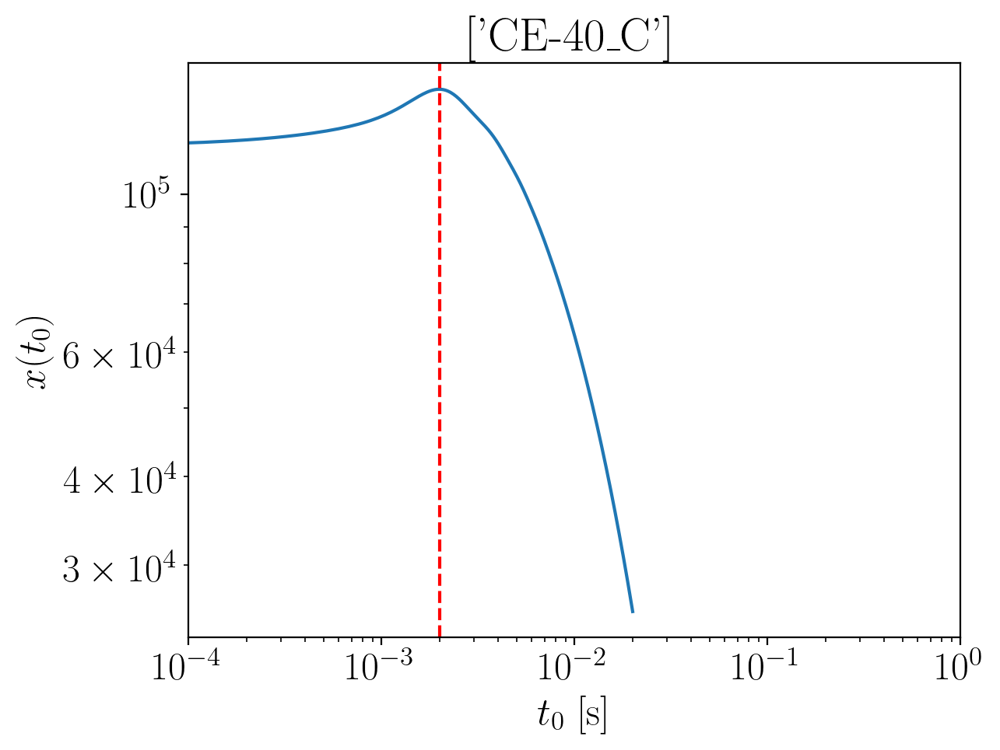

2024-01-15 16:26:47,879 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:47,888 - Network - INFO : PSDs loaded.
2024-01-15 16:26:47,890 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:47,900 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:47,908 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3303778305912064
Inner product:
0.9998671380587912


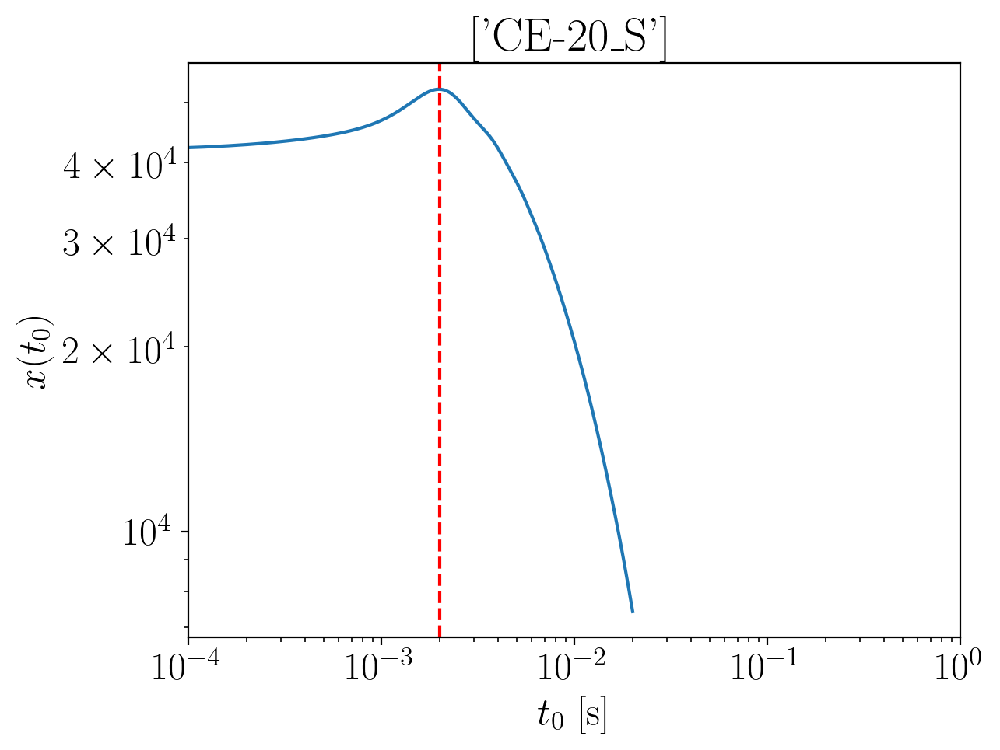

2024-01-15 16:26:49,617 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:49,628 - Network - INFO : PSDs loaded.
2024-01-15 16:26:49,631 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:49,641 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:49,655 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.331515610590765
Inner product:
0.9998288177041237


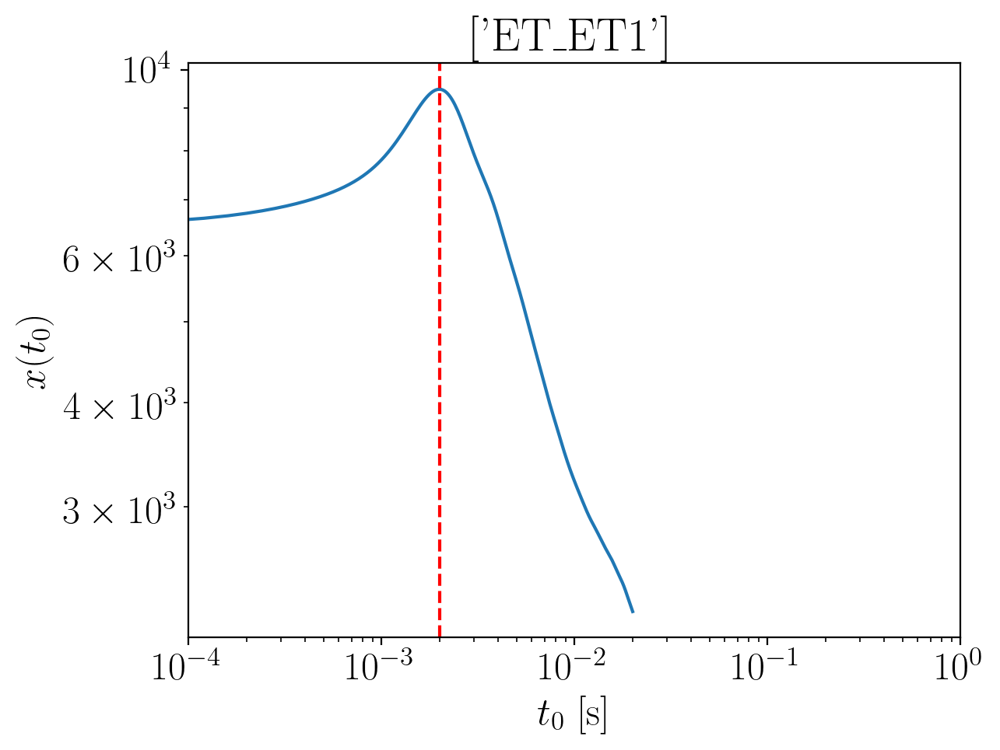

2024-01-15 16:26:52,318 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:52,335 - Network - INFO : PSDs loaded.
2024-01-15 16:26:52,338 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:52,347 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:52,384 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3225129512413063
Inner product:
0.9996945012126618


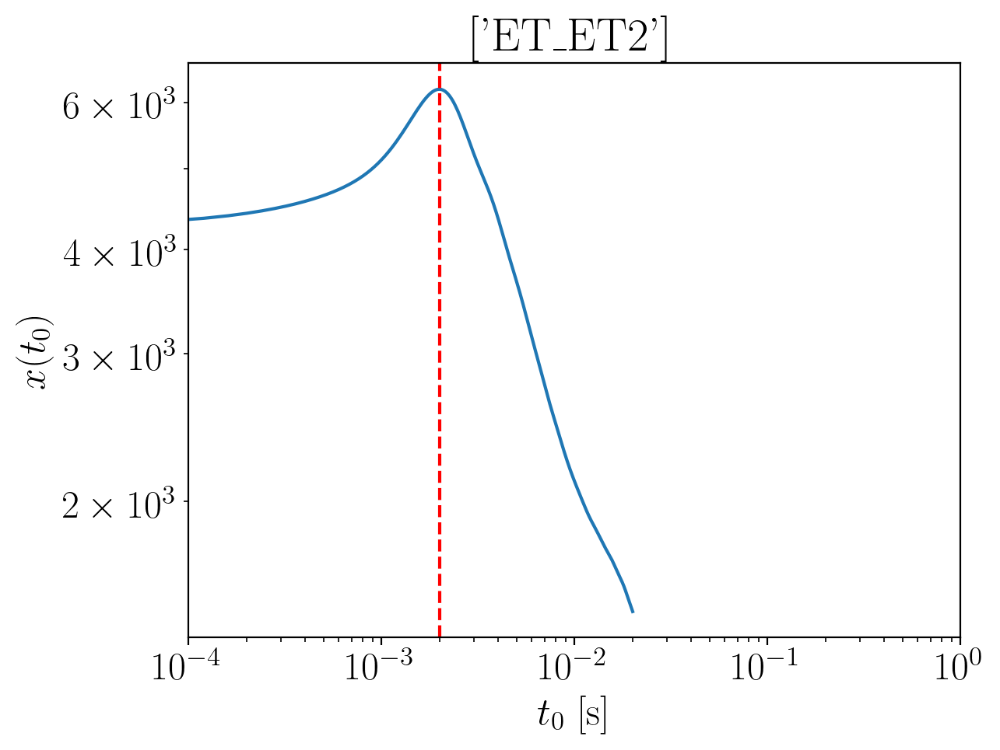

2024-01-15 16:26:54,892 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:54,913 - Network - INFO : PSDs loaded.
2024-01-15 16:26:54,916 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:54,928 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:54,949 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3225129512413063
Inner product:
0.9996945012126618


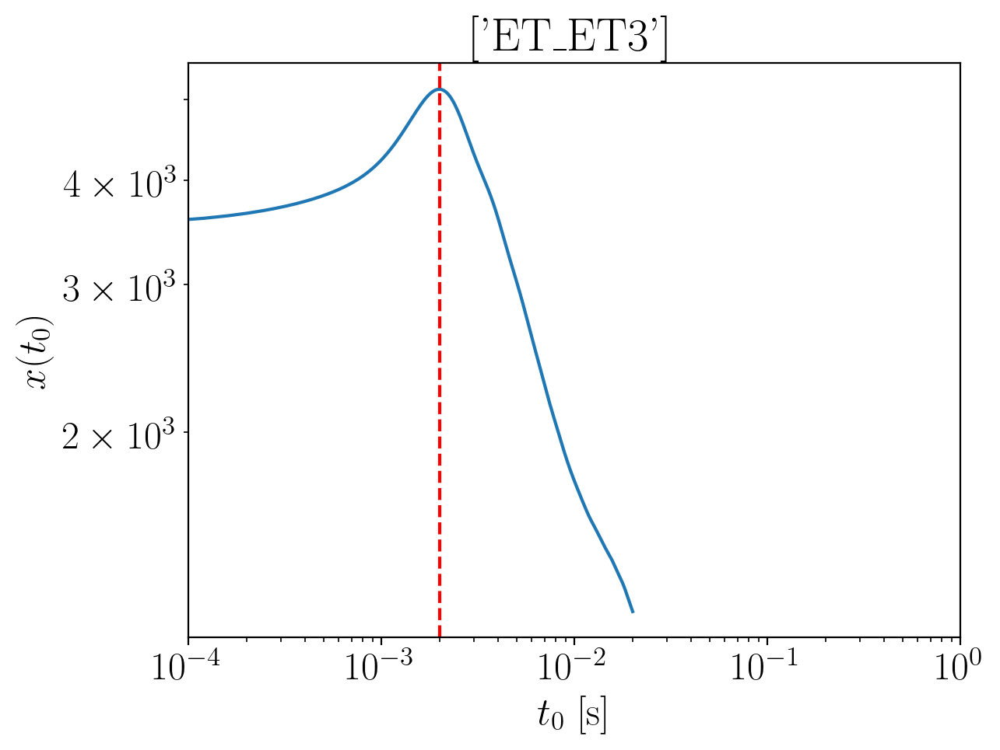

2024-01-15 16:26:56,854 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:56,870 - Network - INFO : PSDs loaded.
2024-01-15 16:26:56,872 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:26:56,880 - Network - INFO : Detector responses calculated.
2024-01-15 16:26:56,889 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:56,961 - Network - INFO : Polarizations calculated.
2024-01-15 16:26:56,964 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:26:56,973 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3225129512413067
Inner product:
0.9996945012126617


2024-01-15 16:27:02,911 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:27:02,966 - Network - INFO : PSDs loaded.
2024-01-15 16:27:02,982 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:03,057 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:03,058 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:27:03,059 - Network - INFO :    CE-40_C
2024-01-15 16:27:07,009 - Network - INFO :    CE-20_S
2024-01-15 16:27:12,248 - Network - INFO :    ET_ET1
2024-01-15 16:27:15,949 - Network - INFO :    ET_ET2
2024-01-15 16:27:19,589 - Network - INFO :    ET_ET3
2024-01-15 16:27:23,366 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:27:23,374 - Network - INFO : SNRs calculated.
2024-01-15 16:27:23,375 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:27:23,375 - Network - INFO :    CE-40_C
2024-01-15 16:27:23,470 - Network - INFO :

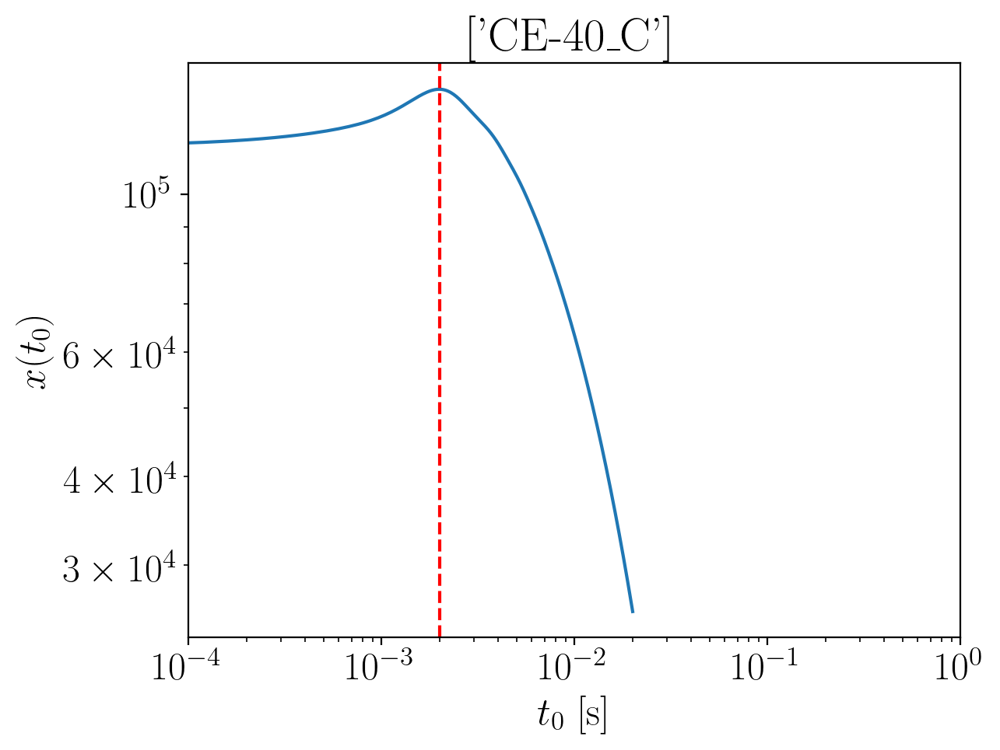

2024-01-15 16:27:25,242 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:25,248 - Network - INFO : PSDs loaded.
2024-01-15 16:27:25,250 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:25,257 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:25,264 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3125860677115755
Inner product:
0.9998671380587916


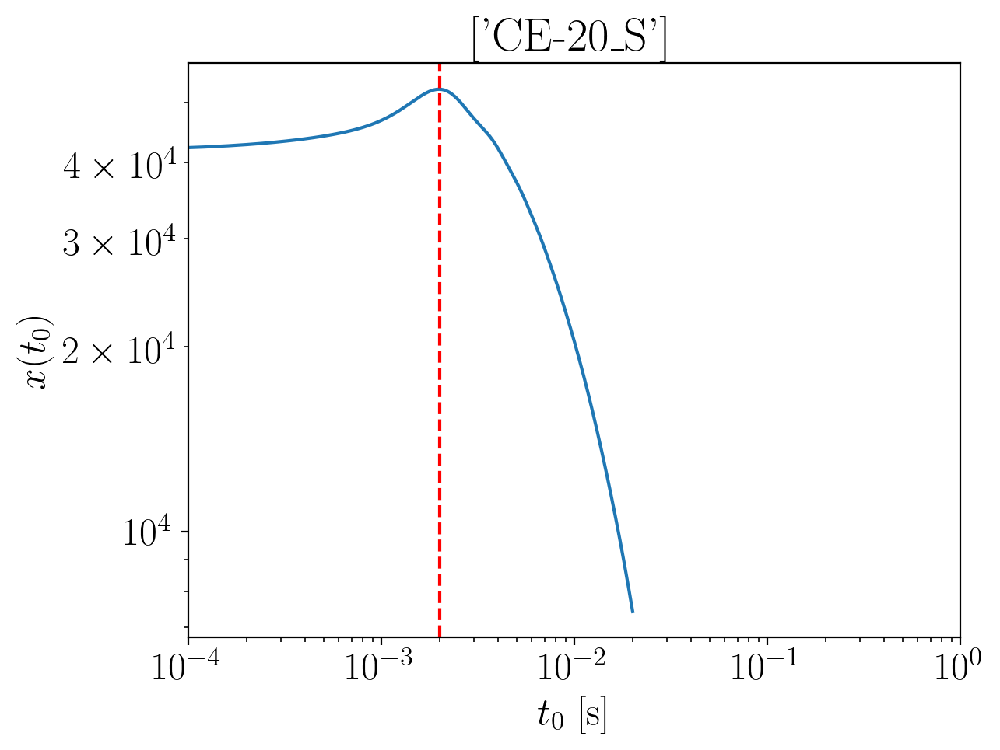

2024-01-15 16:27:26,705 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:26,711 - Network - INFO : PSDs loaded.
2024-01-15 16:27:26,713 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:26,720 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:26,727 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.3137238477111337
Inner product:
0.999828817704124


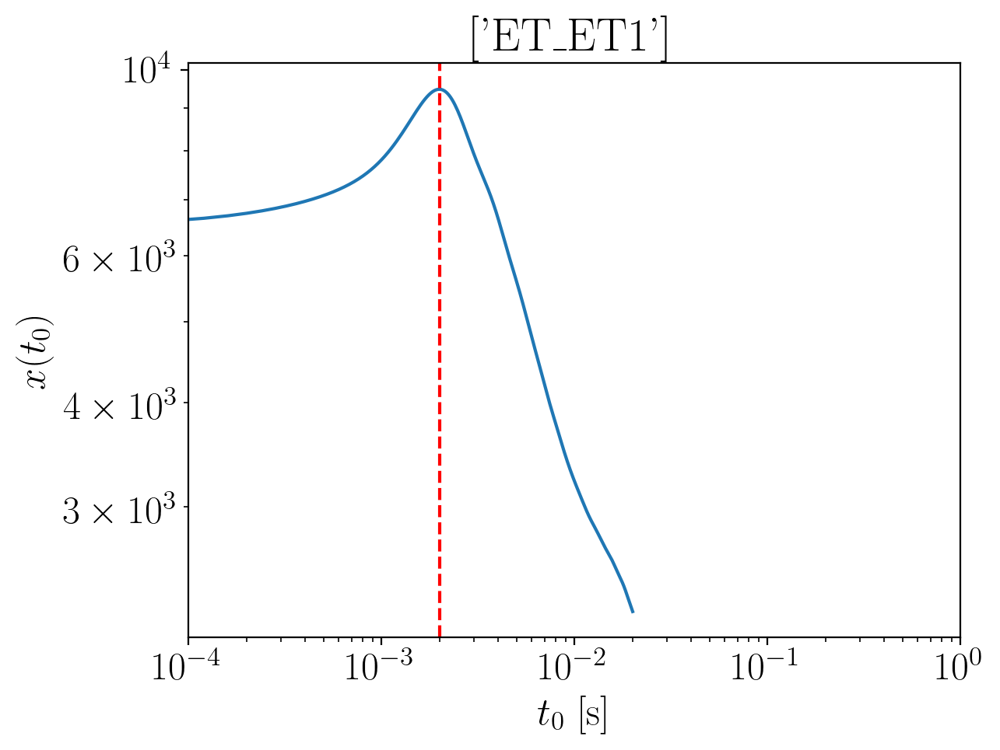

2024-01-15 16:27:29,009 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:29,024 - Network - INFO : PSDs loaded.
2024-01-15 16:27:29,027 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:29,063 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:29,097 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.304721188361675
Inner product:
0.999694501212662


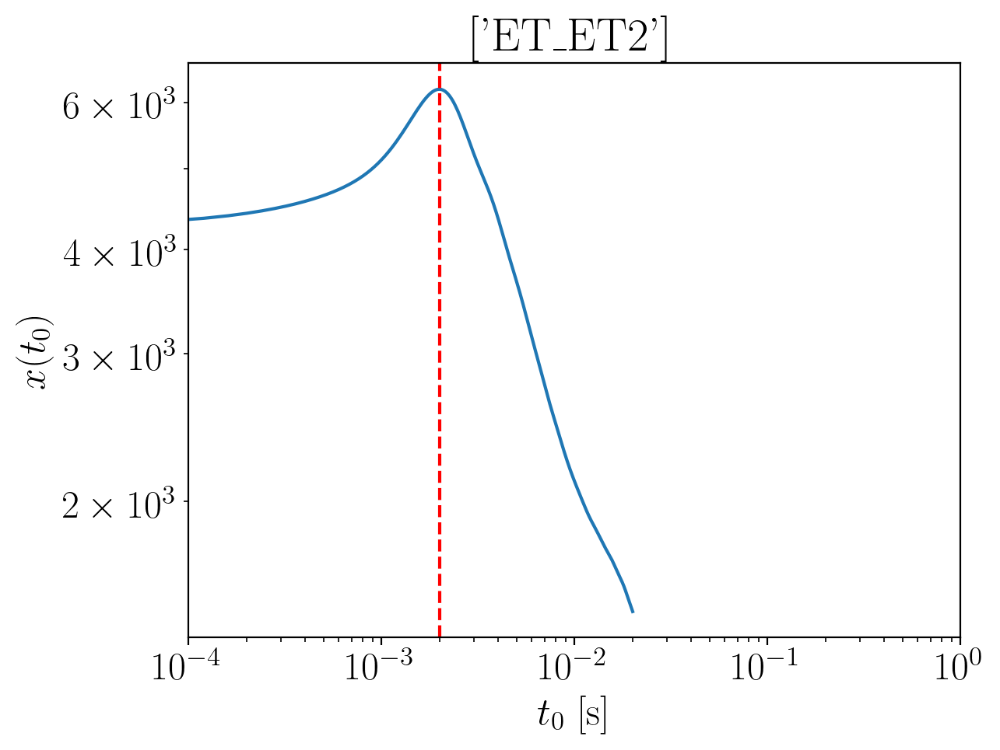

2024-01-15 16:27:31,064 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:31,085 - Network - INFO : PSDs loaded.
2024-01-15 16:27:31,088 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:31,097 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:31,225 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.304721188361675
Inner product:
0.9996945012126619


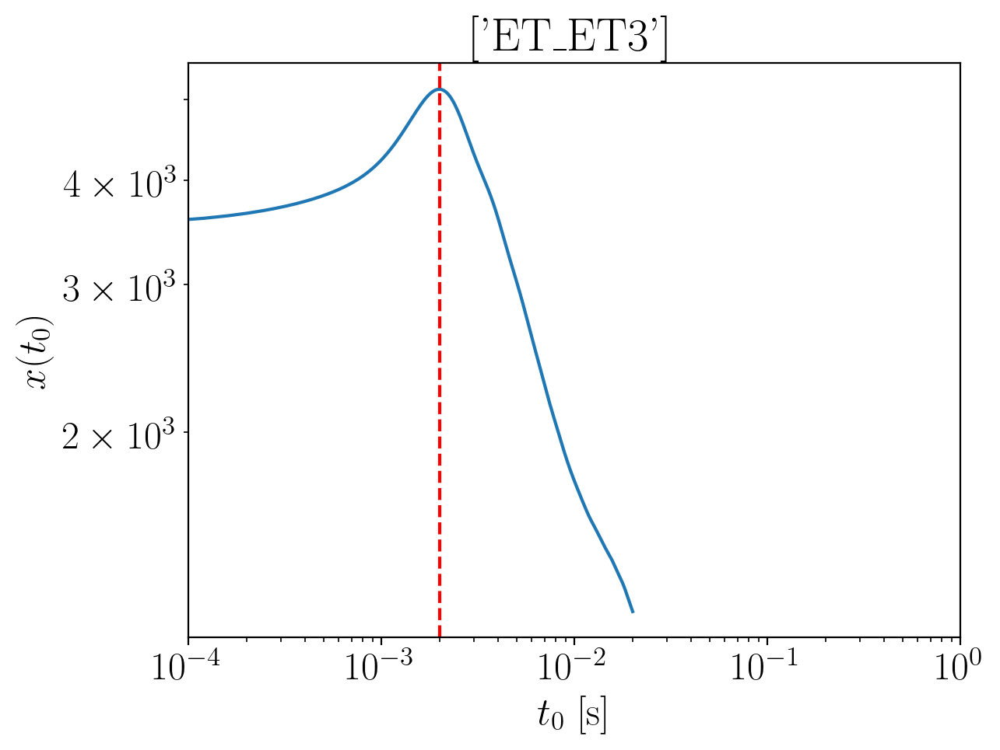

2024-01-15 16:27:33,223 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:33,237 - Network - INFO : PSDs loaded.
2024-01-15 16:27:33,240 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:33,265 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:33,292 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:33,335 - Network - INFO : Polarizations calculated.
2024-01-15 16:27:33,336 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:27:33,358 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.304721188361675
Inner product:
0.9996945012126615


2024-01-15 16:27:39,648 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:27:39,694 - Network - INFO : PSDs loaded.
2024-01-15 16:27:39,713 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:27:39,769 - Network - INFO : Detector responses calculated.
2024-01-15 16:27:39,770 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:27:39,771 - Network - INFO :    CE-40_C
2024-01-15 16:27:43,466 - Network - INFO :    CE-20_S
2024-01-15 16:27:47,073 - Network - INFO :    ET_ET1
2024-01-15 16:27:50,844 - Network - INFO :    ET_ET2
2024-01-15 16:27:54,510 - Network - INFO :    ET_ET3
2024-01-15 16:27:58,155 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:27:58,163 - Network - INFO : SNRs calculated.
2024-01-15 16:27:58,163 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:27:58,164 - Network - INFO :    CE-40_C
2024-01-15 16:27:58,260 - Network - INFO :

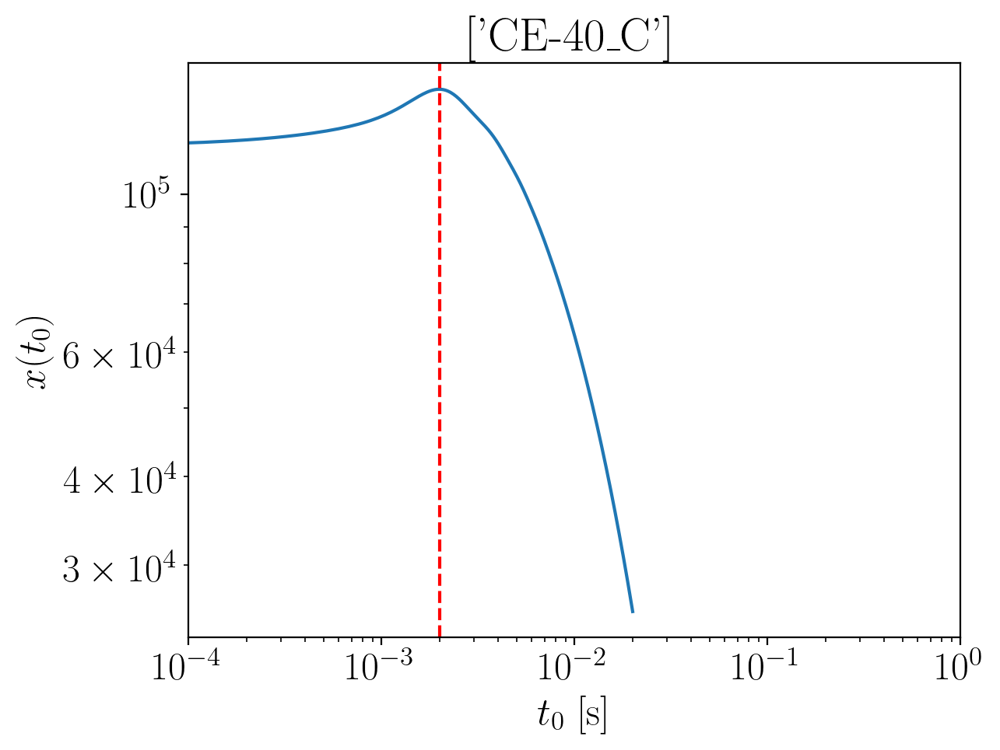

2024-01-15 16:28:00,018 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:00,025 - Network - INFO : PSDs loaded.
2024-01-15 16:28:00,027 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:00,035 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:00,041 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2955427287739587
Inner product:
0.9998671380587916


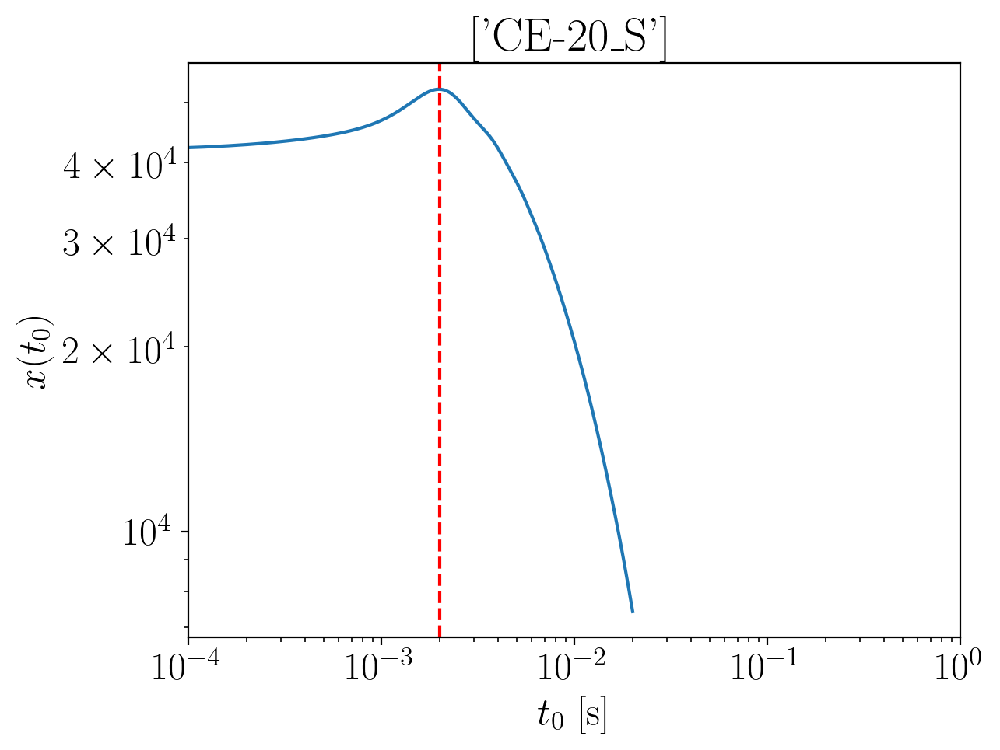

2024-01-15 16:28:01,977 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:02,025 - Network - INFO : PSDs loaded.
2024-01-15 16:28:02,043 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:02,093 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:02,109 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2966805087735183
Inner product:
0.9998288177041238


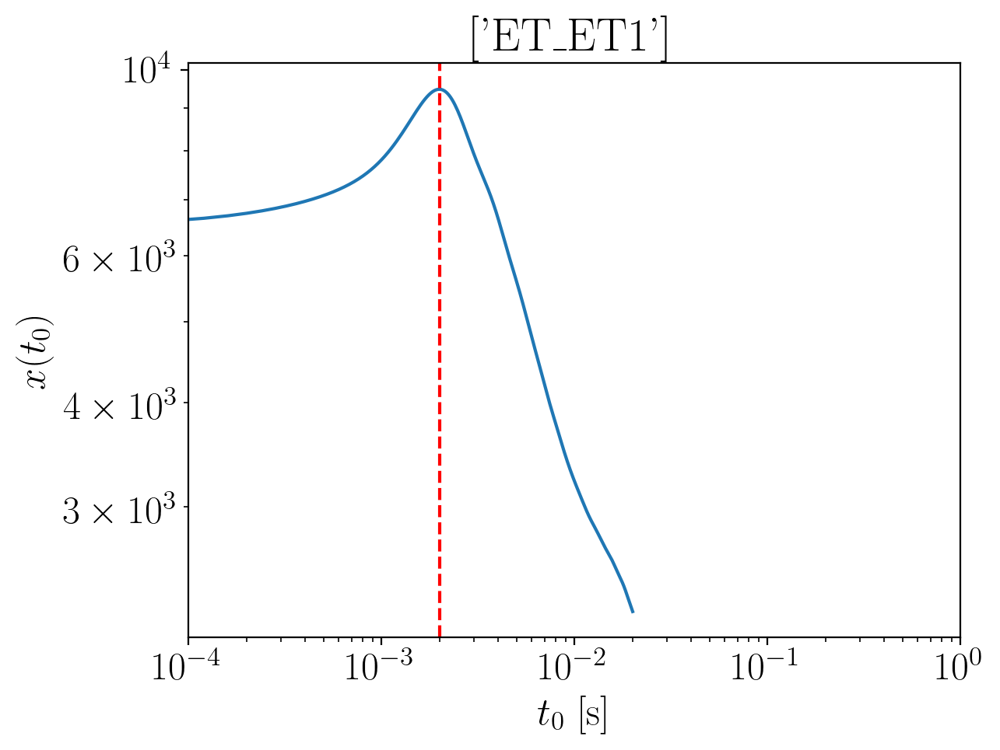

2024-01-15 16:28:04,647 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.287677849424051


2024-01-15 16:28:04,990 - Network - INFO : PSDs loaded.
2024-01-15 16:28:04,993 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:05,002 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:05,009 - Network - INFO : Polarizations calculated.


Inner product:
0.9996945012126618


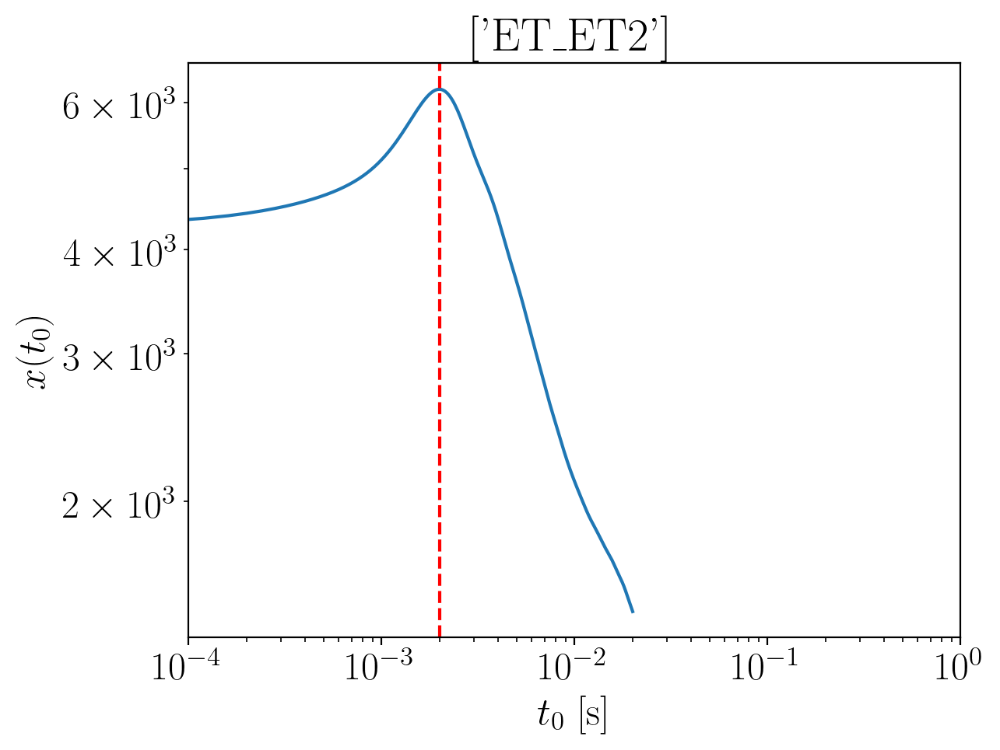

2024-01-15 16:28:07,104 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:07,127 - Network - INFO : PSDs loaded.
2024-01-15 16:28:07,154 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:07,256 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:07,267 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.287677849424051
Inner product:
0.9996945012126616


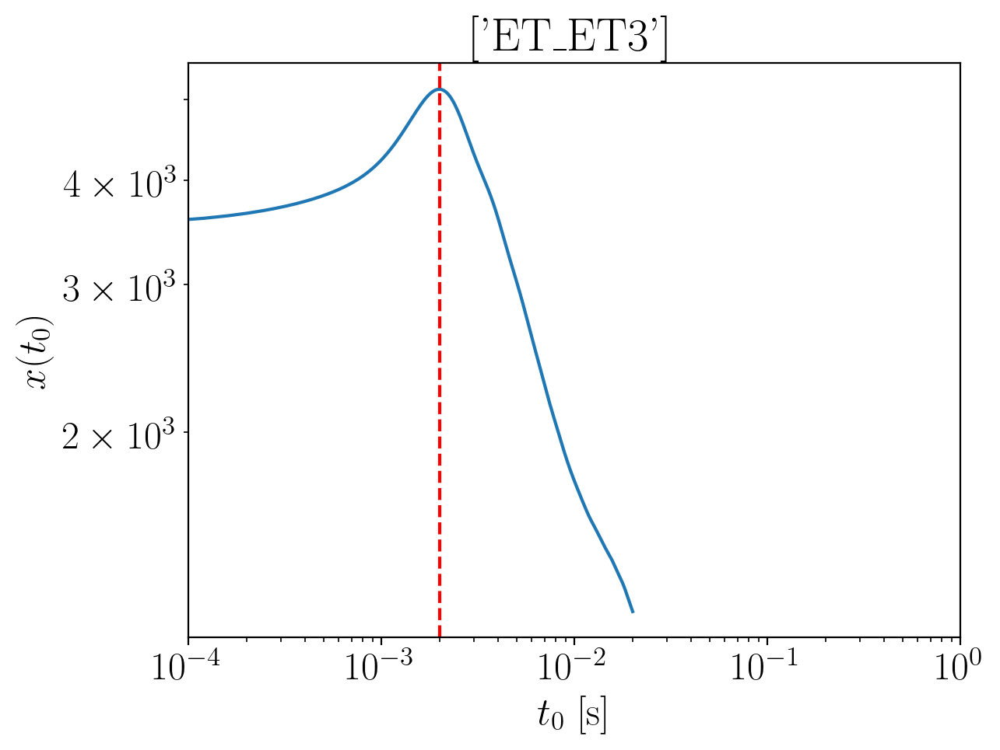

2024-01-15 16:28:09,089 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:09,104 - Network - INFO : PSDs loaded.
2024-01-15 16:28:09,106 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:09,149 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:09,166 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:09,197 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:09,198 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:28:09,202 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.287677849424051
Inner product:
0.9996945012126615


2024-01-15 16:28:14,831 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:28:14,881 - Network - INFO : PSDs loaded.
2024-01-15 16:28:14,897 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:14,941 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:14,943 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:28:14,944 - Network - INFO :    CE-40_C
2024-01-15 16:28:18,563 - Network - INFO :    CE-20_S
2024-01-15 16:28:22,163 - Network - INFO :    ET_ET1
2024-01-15 16:28:25,761 - Network - INFO :    ET_ET2
2024-01-15 16:28:29,485 - Network - INFO :    ET_ET3
2024-01-15 16:28:33,199 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:28:33,210 - Network - INFO : SNRs calculated.
2024-01-15 16:28:33,211 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:28:33,212 - Network - INFO :    CE-40_C
2024-01-15 16:28:33,316 - Network - INFO :

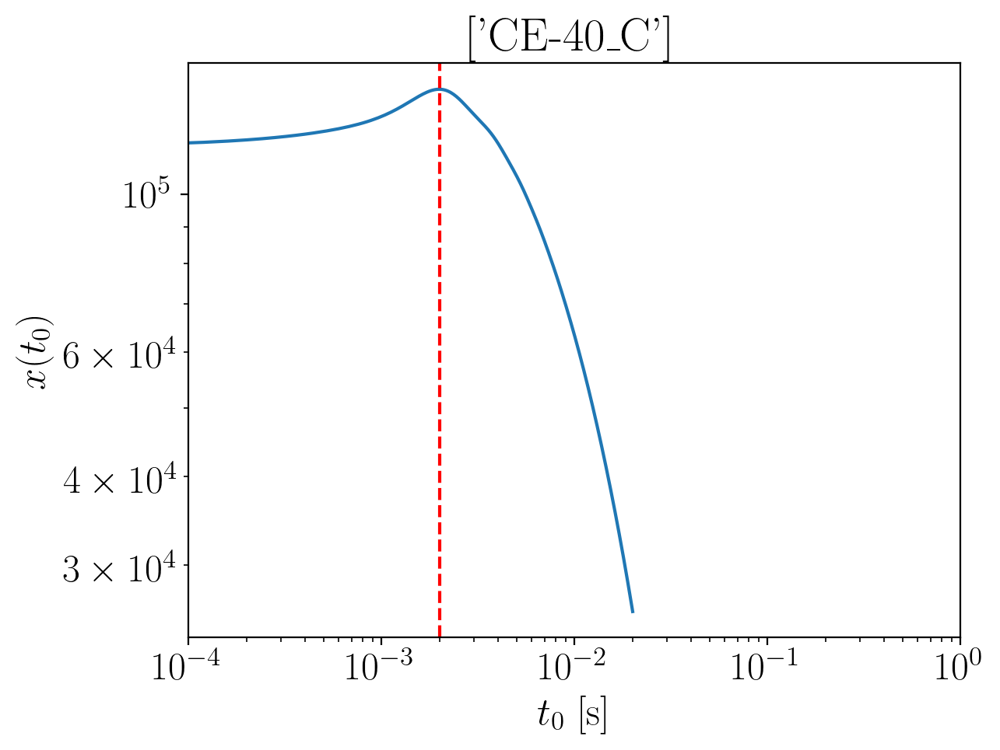

2024-01-15 16:28:35,067 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:35,074 - Network - INFO : PSDs loaded.
2024-01-15 16:28:35,076 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:35,083 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:35,089 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2790926960238505
Inner product:
0.9998671380587913


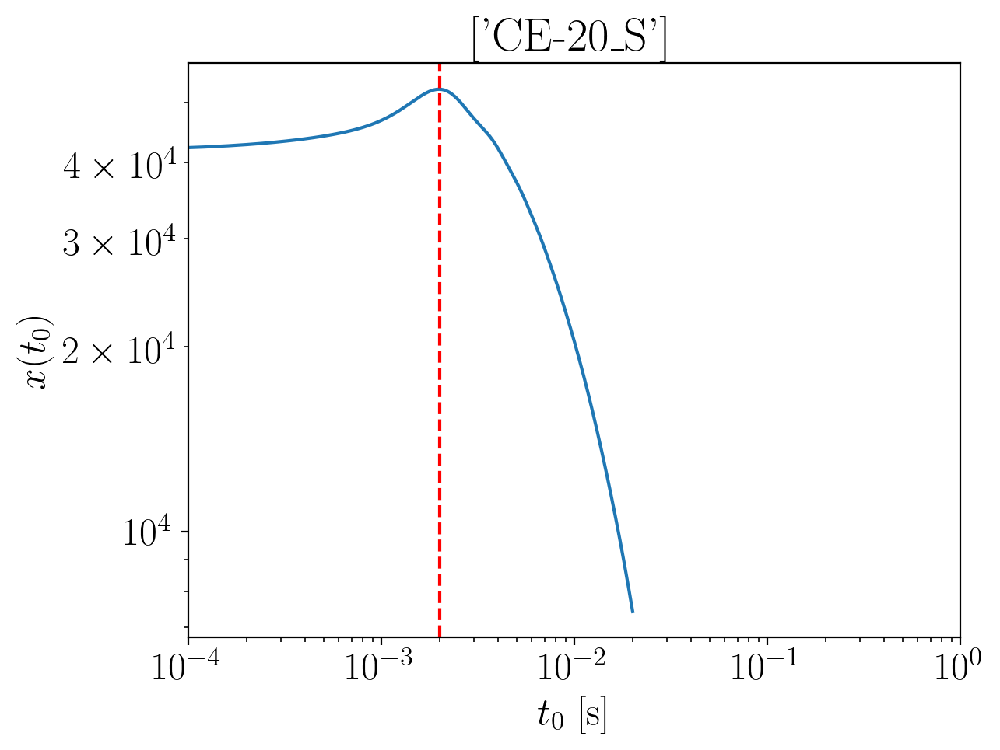

2024-01-15 16:28:36,454 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:36,463 - Network - INFO : PSDs loaded.
2024-01-15 16:28:36,466 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:36,475 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:36,483 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.28023047602341
Inner product:
0.9998288177041236


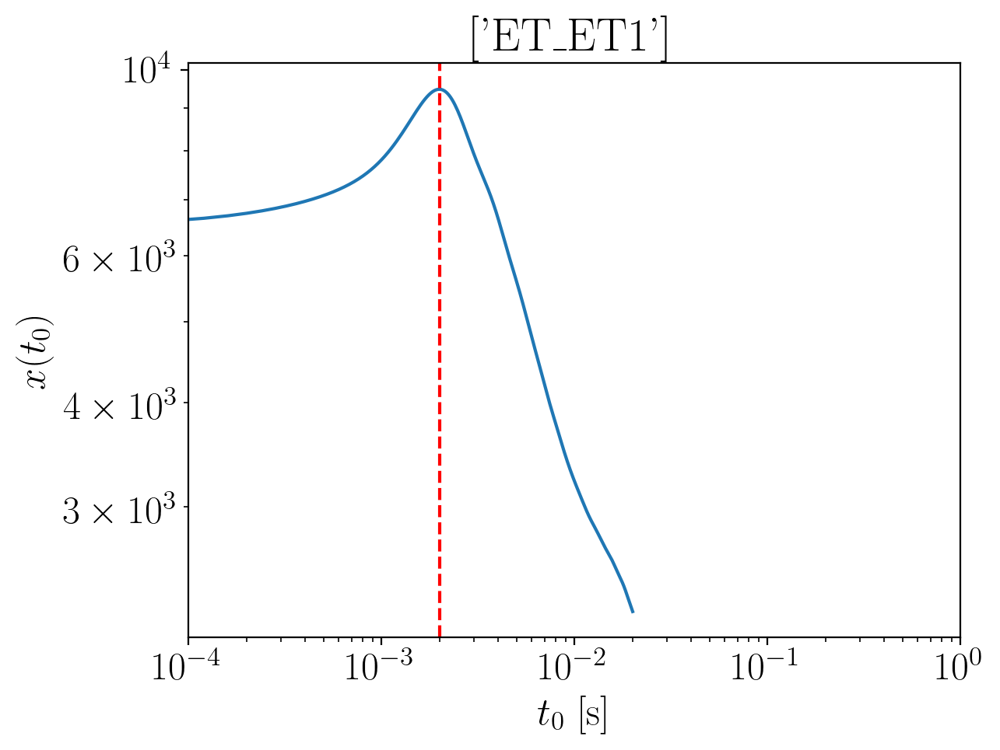

2024-01-15 16:28:37,956 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:37,969 - Network - INFO : PSDs loaded.
2024-01-15 16:28:37,971 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:37,978 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:37,985 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.271227816673943
Inner product:
0.9996945012126618


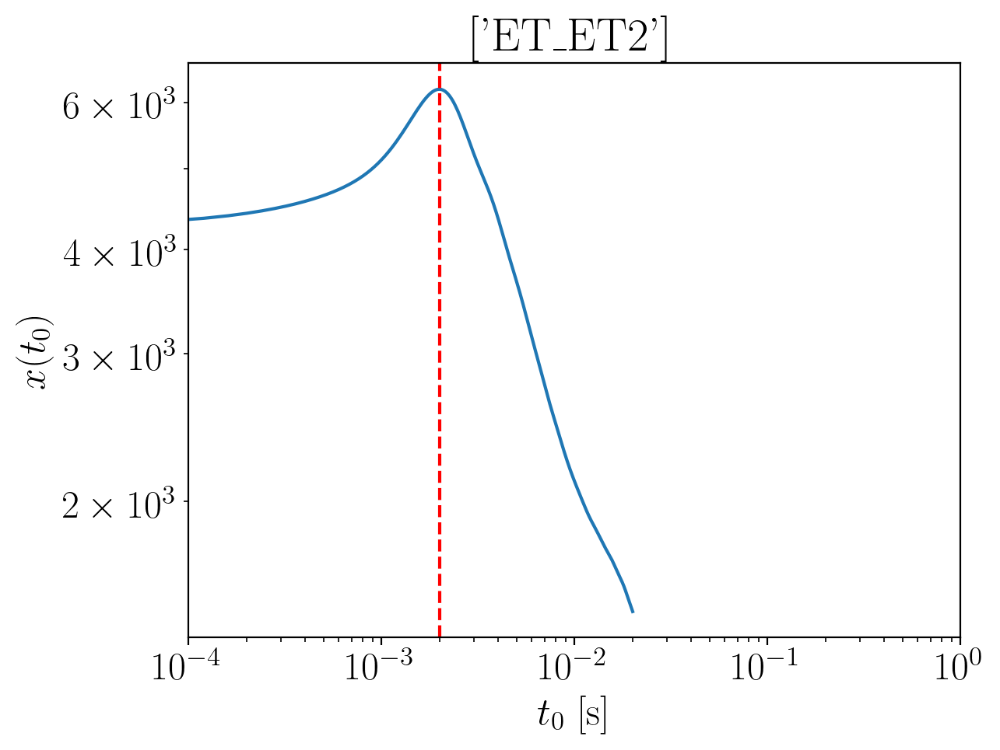

2024-01-15 16:28:39,544 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:39,570 - Network - INFO : PSDs loaded.
2024-01-15 16:28:39,573 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:39,586 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:39,594 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.271227816673943
Inner product:
0.9996945012126616


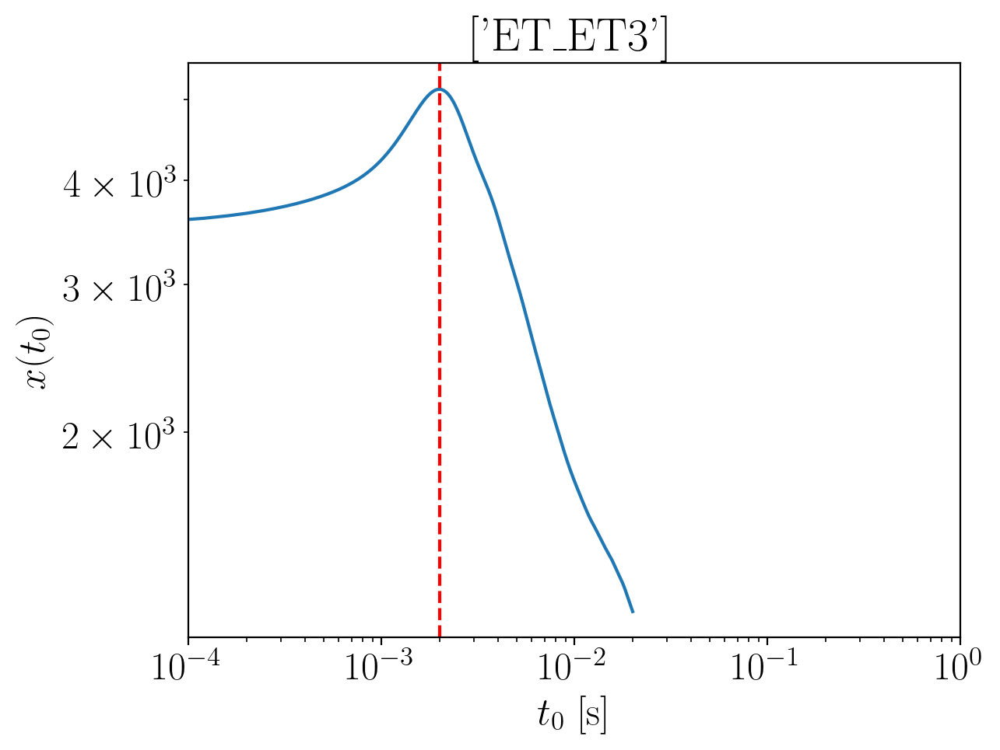

2024-01-15 16:28:41,054 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:41,067 - Network - INFO : PSDs loaded.
2024-01-15 16:28:41,068 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:41,076 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:41,082 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:41,109 - Network - INFO : Polarizations calculated.
2024-01-15 16:28:41,110 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:28:41,117 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.271227816673943
Inner product:
0.9996945012126617


2024-01-15 16:28:47,448 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:28:47,662 - Network - INFO : PSDs loaded.
2024-01-15 16:28:47,668 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:28:47,690 - Network - INFO : Detector responses calculated.
2024-01-15 16:28:47,691 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:28:47,691 - Network - INFO :    CE-40_C
2024-01-15 16:28:51,365 - Network - INFO :    CE-20_S
2024-01-15 16:28:55,126 - Network - INFO :    ET_ET1
2024-01-15 16:28:58,761 - Network - INFO :    ET_ET2
2024-01-15 16:29:02,363 - Network - INFO :    ET_ET3
2024-01-15 16:29:06,036 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:29:06,044 - Network - INFO : SNRs calculated.
2024-01-15 16:29:06,045 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:29:06,045 - Network - INFO :    CE-40_C
2024-01-15 16:29:06,140 - Network - INFO :

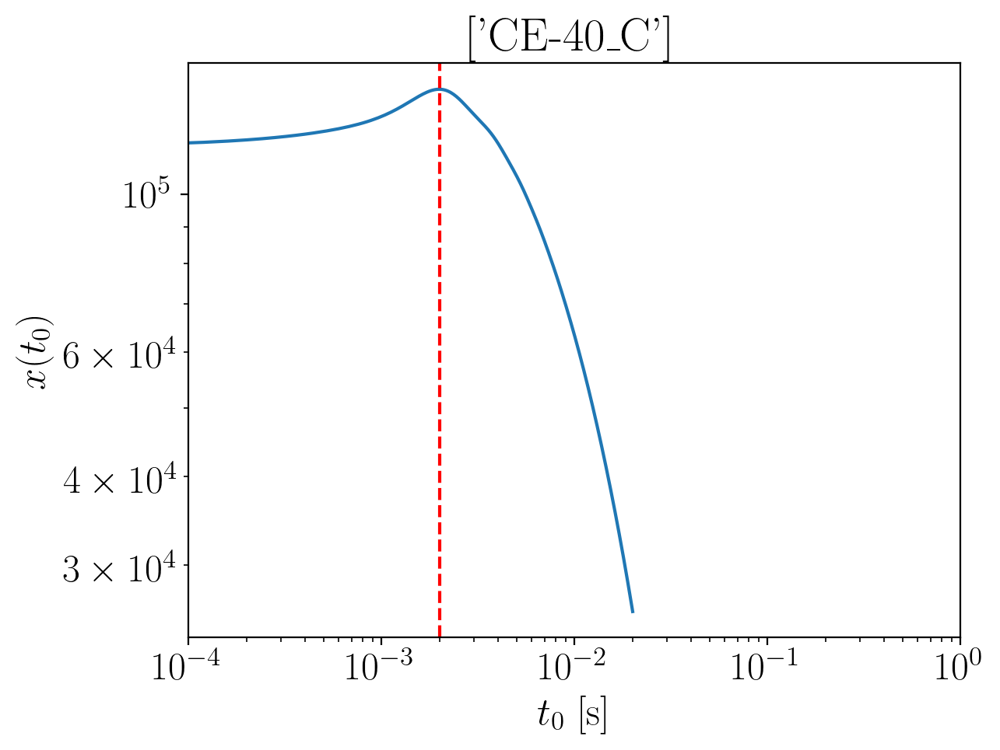

2024-01-15 16:29:07,932 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:07,939 - Network - INFO : PSDs loaded.
2024-01-15 16:29:07,941 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:07,948 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:07,955 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2631255163678707
Inner product:
0.9998671380587916


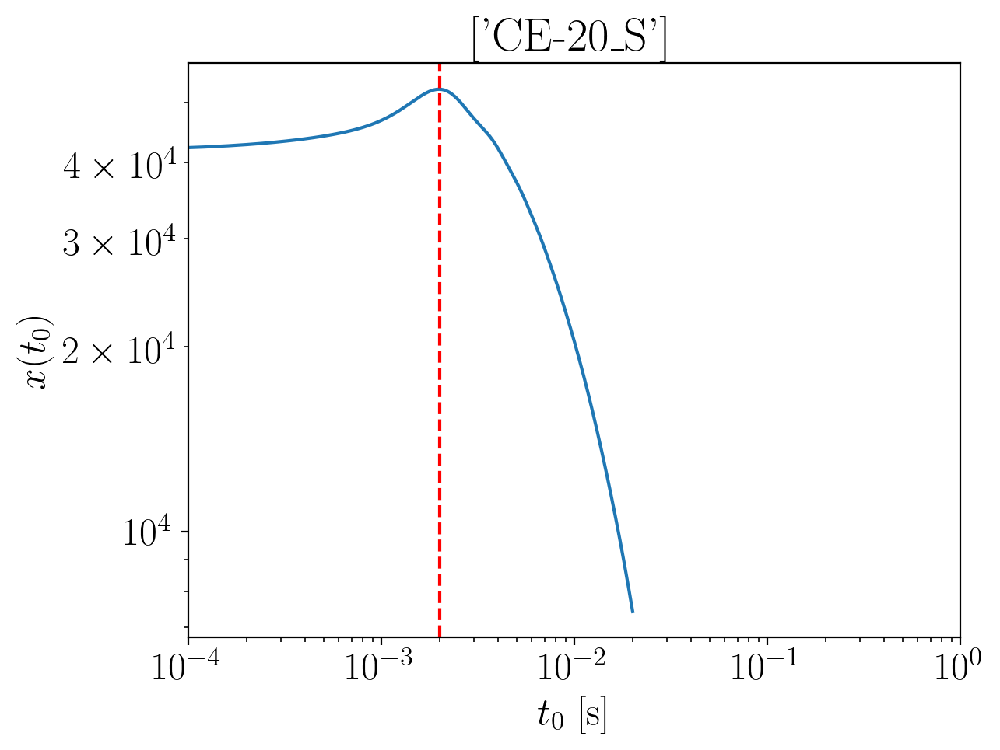

2024-01-15 16:29:09,211 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:09,218 - Network - INFO : PSDs loaded.
2024-01-15 16:29:09,220 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:09,227 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:09,233 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.26426329636743
Inner product:
0.9998288177041238


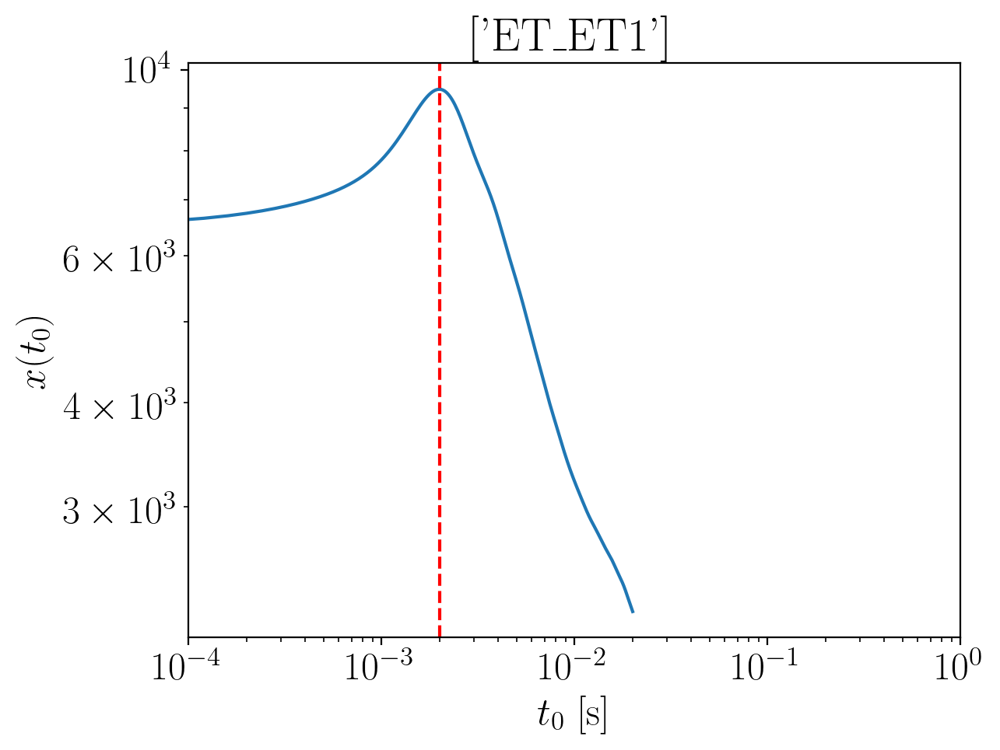

2024-01-15 16:29:10,700 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:10,713 - Network - INFO : PSDs loaded.
2024-01-15 16:29:10,715 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:10,722 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:10,729 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.255260637017962
Inner product:
0.999694501212662


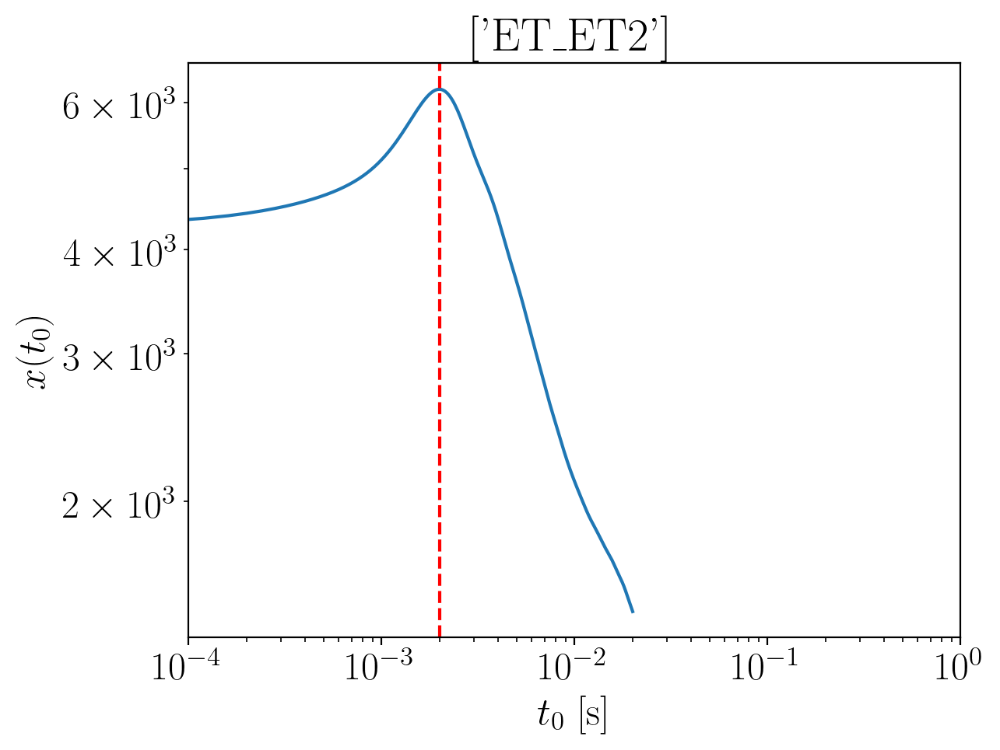

2024-01-15 16:29:12,240 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:12,255 - Network - INFO : PSDs loaded.
2024-01-15 16:29:12,257 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:12,264 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:12,274 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.255260637017962
Inner product:
0.9996945012126616


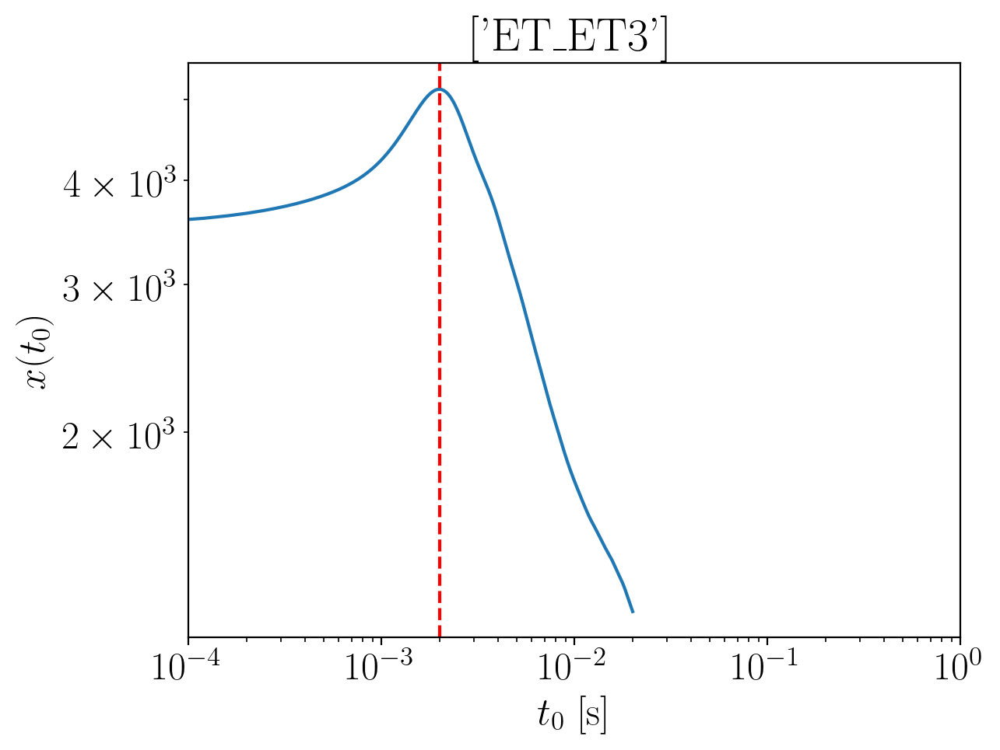

2024-01-15 16:29:14,075 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:14,098 - Network - INFO : PSDs loaded.
2024-01-15 16:29:14,107 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:14,243 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:14,267 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.255260637017962
Inner product:


2024-01-15 16:29:14,410 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:14,411 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:29:14,426 - Network - INFO : Polarizations calculated.


0.9996945012126617


2024-01-15 16:29:21,384 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:29:21,499 - Network - INFO : PSDs loaded.
2024-01-15 16:29:21,524 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:21,550 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:21,551 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:29:21,552 - Network - INFO :    CE-40_C
2024-01-15 16:29:26,191 - Network - INFO :    CE-20_S
2024-01-15 16:29:30,745 - Network - INFO :    ET_ET1
2024-01-15 16:29:34,558 - Network - INFO :    ET_ET2
2024-01-15 16:29:38,822 - Network - INFO :    ET_ET3
2024-01-15 16:29:42,480 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:29:42,488 - Network - INFO : SNRs calculated.
2024-01-15 16:29:42,489 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:29:42,489 - Network - INFO :    CE-40_C
2024-01-15 16:29:42,584 - Network - INFO :

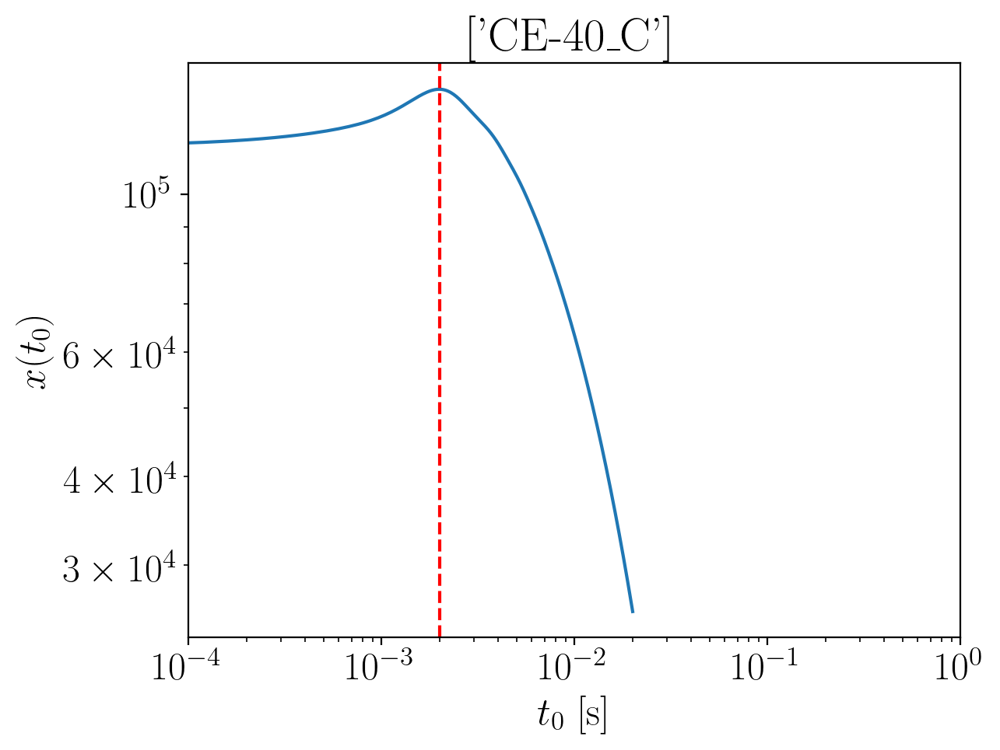

2024-01-15 16:29:44,333 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:44,340 - Network - INFO : PSDs loaded.
2024-01-15 16:29:44,342 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:44,349 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:44,356 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2475592098651247
Inner product:
0.9998671380587913


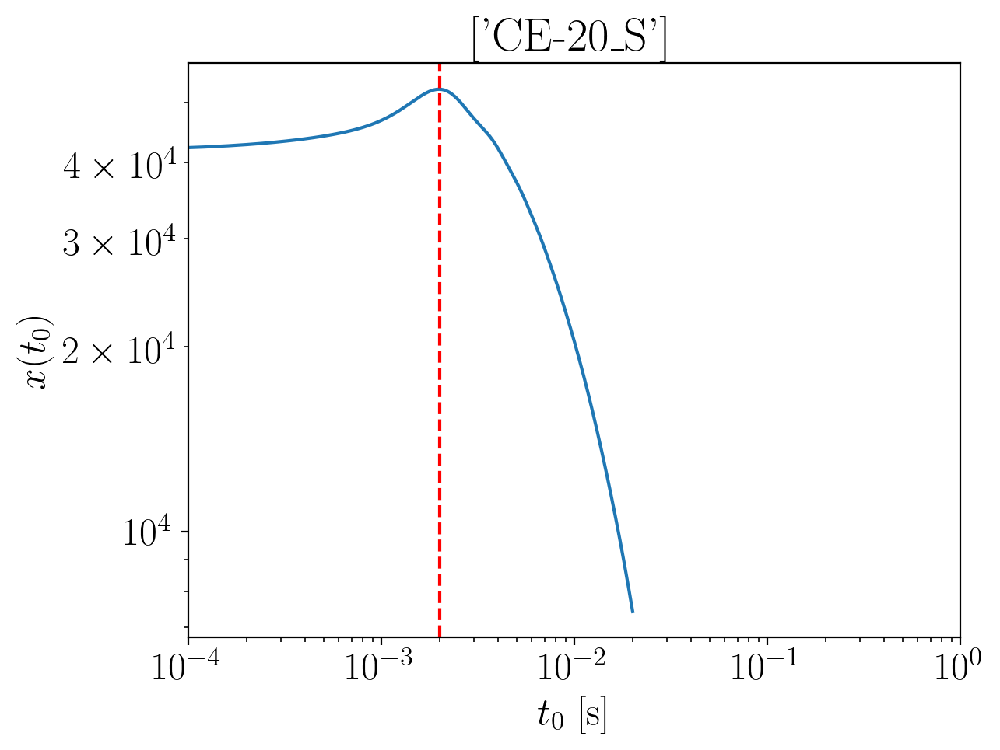

2024-01-15 16:29:45,759 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:45,766 - Network - INFO : PSDs loaded.
2024-01-15 16:29:45,767 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:45,774 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:45,782 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.248696989864684
Inner product:
0.9998288177041239


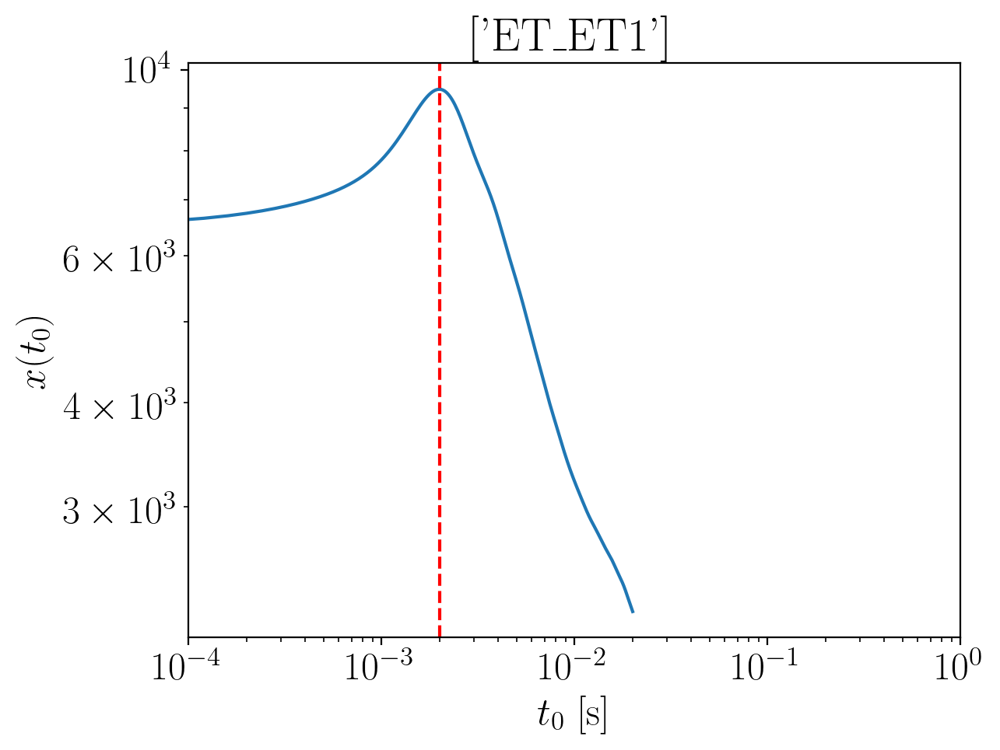

2024-01-15 16:29:47,169 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:47,183 - Network - INFO : PSDs loaded.
2024-01-15 16:29:47,185 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:47,193 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:47,200 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.239694330515216
Inner product:
0.9996945012126618


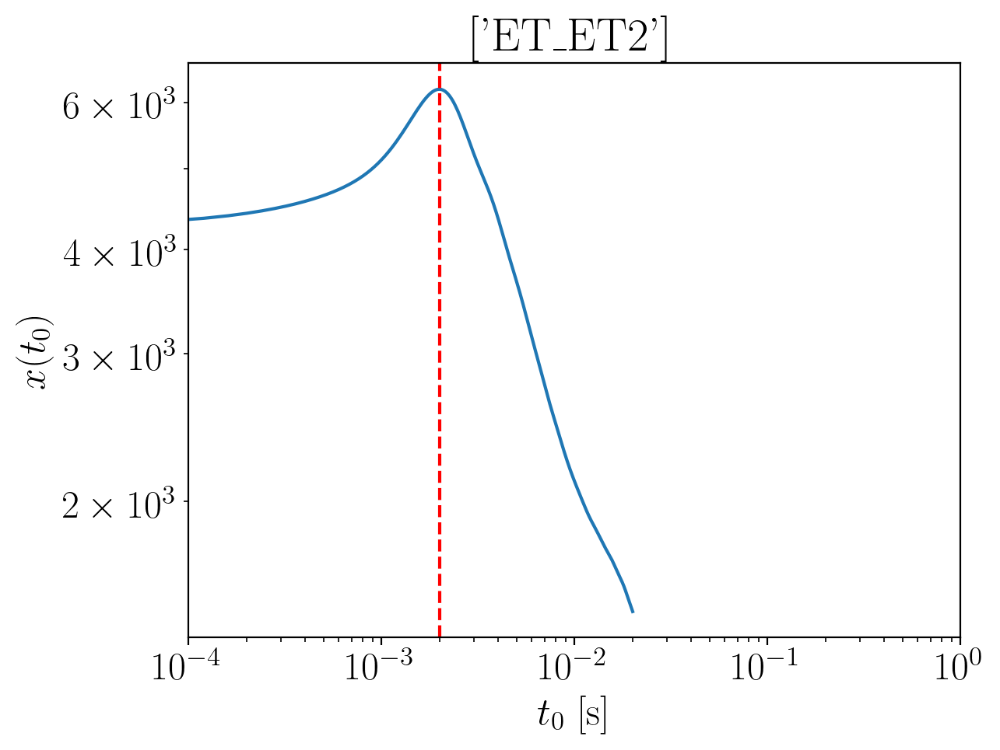

2024-01-15 16:29:50,622 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:50,664 - Network - INFO : PSDs loaded.
2024-01-15 16:29:50,674 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:50,718 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:50,764 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.239694330515216
Inner product:
0.9996945012126616


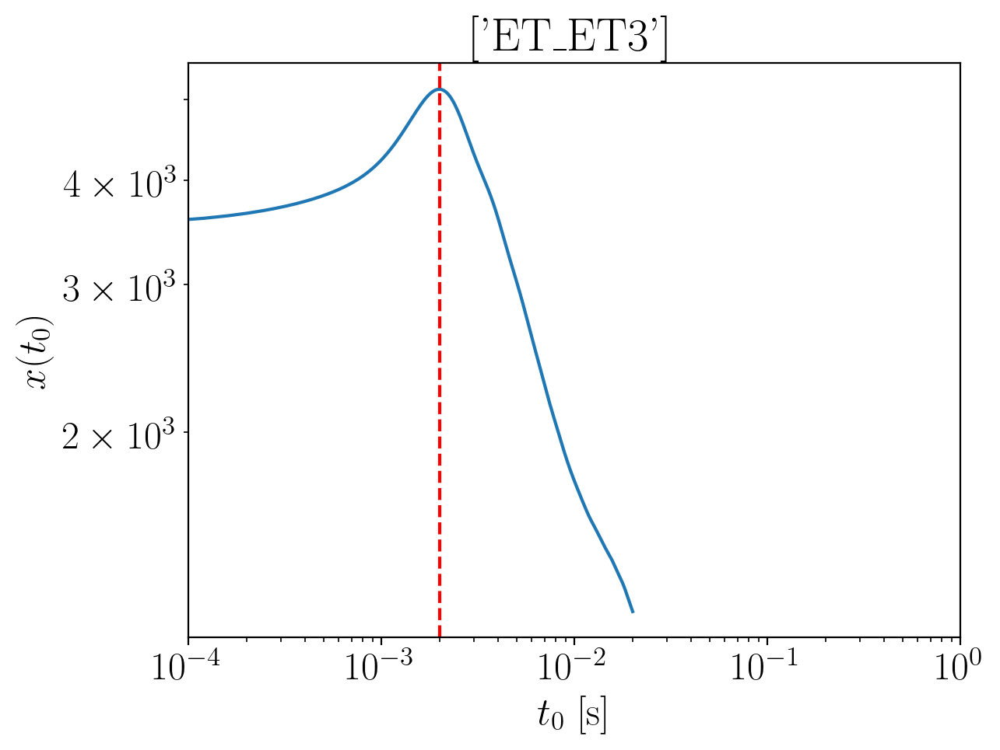

2024-01-15 16:29:53,831 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:53,857 - Network - INFO : PSDs loaded.
2024-01-15 16:29:53,862 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:29:53,943 - Network - INFO : Detector responses calculated.
2024-01-15 16:29:54,013 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.239694330515216
Inner product:
0.9996945012126615


2024-01-15 16:29:54,158 - Network - INFO : Polarizations calculated.
2024-01-15 16:29:54,159 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:29:54,185 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:07,744 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:30:07,841 - Network - INFO : PSDs loaded.
2024-01-15 16:30:07,908 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:30:08,040 - Network - INFO : Detector responses calculated.
2024-01-15 16:30:08,041 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:30:08,042 - Network - INFO :    CE-40_C
2024-01-15 16:30:15,250 - Network - INFO :    CE-20_S
2024-01-15 16:30:20,281 - Network - INFO :    ET_ET1
2024-01-15 16:30:25,276 - Network - INFO :    ET_ET2
2024-01-15 16:30:30,014 - Network - INFO :    ET_ET3
2024-01-15 16:30:36,444 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

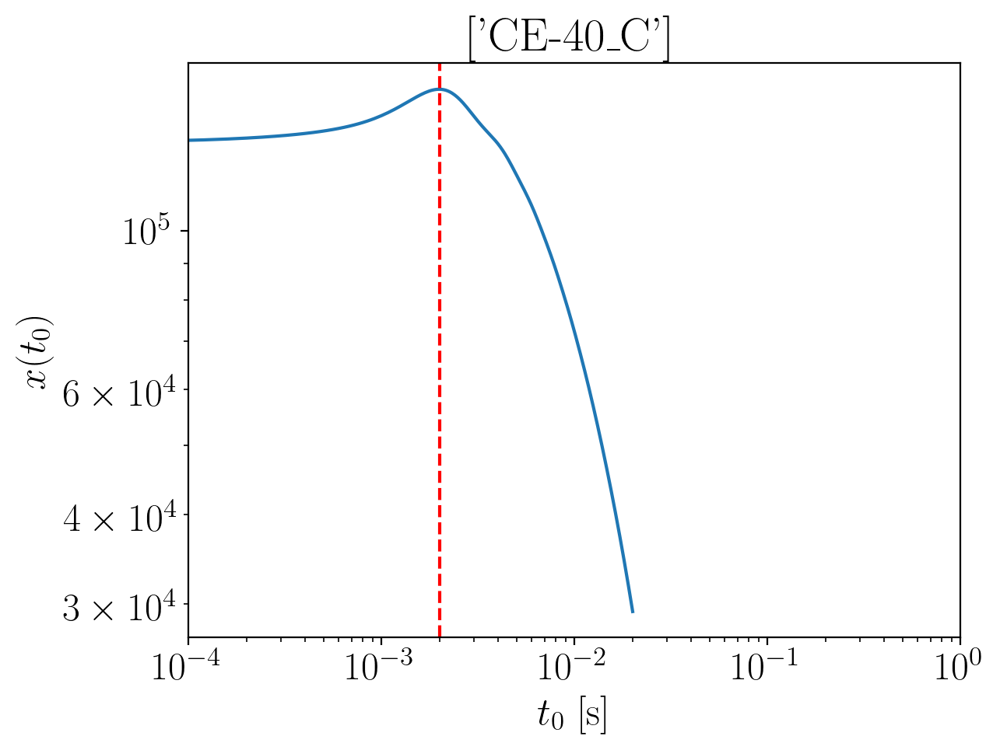

2024-01-15 16:30:39,661 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:39,682 - Network - INFO : PSDs loaded.
2024-01-15 16:30:39,686 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:30:39,750 - Network - INFO : Detector responses calculated.


time shift: 0.002
phase shift: -2.2511845921692477


2024-01-15 16:30:39,855 - Network - INFO : Polarizations calculated.


Inner product:
0.9999236178172557


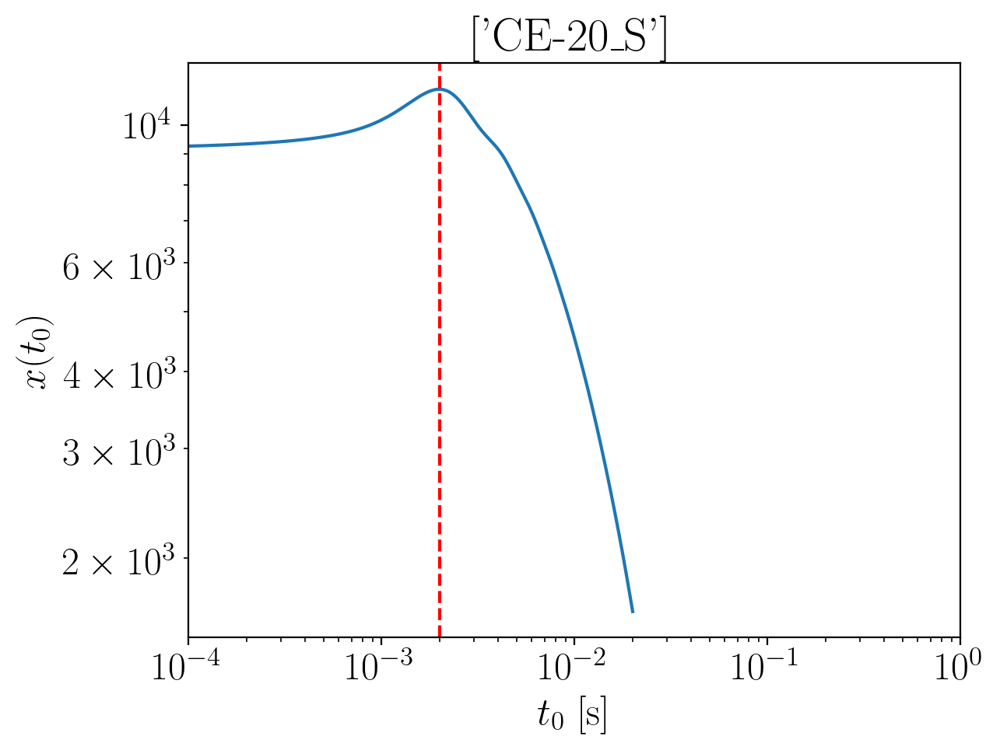

2024-01-15 16:30:43,275 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:43,282 - Network - INFO : PSDs loaded.
2024-01-15 16:30:43,284 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:30:43,296 - Network - INFO : Detector responses calculated.
2024-01-15 16:30:43,330 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.249980518312916
Inner product:
0.9999153426244873


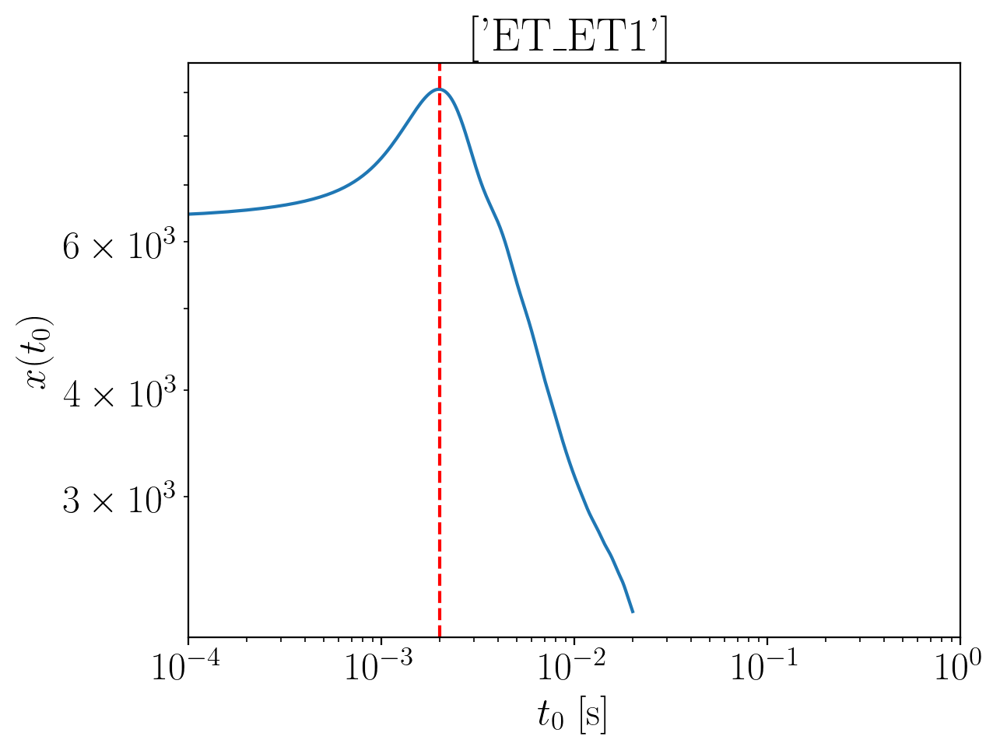

2024-01-15 16:30:46,911 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:46,929 - Network - INFO : PSDs loaded.
2024-01-15 16:30:46,932 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:30:46,972 - Network - INFO : Detector responses calculated.
2024-01-15 16:30:47,050 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.999812336166484


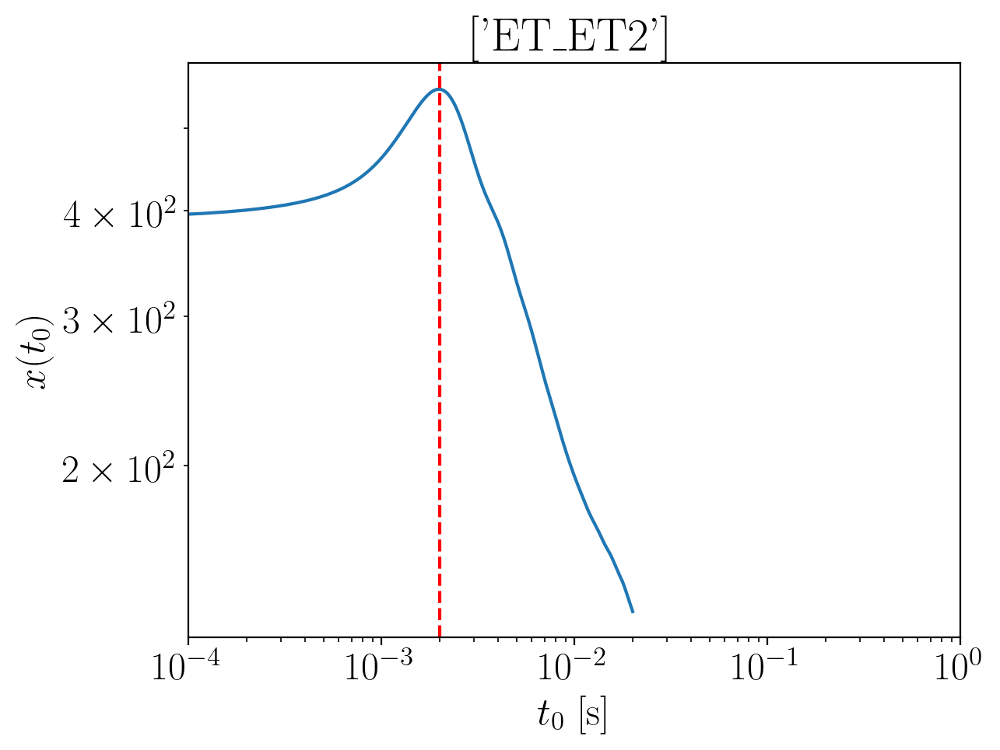

2024-01-15 16:30:49,367 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547


2024-01-15 16:30:49,706 - Network - INFO : PSDs loaded.
2024-01-15 16:30:49,708 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:30:49,716 - Network - INFO : Detector responses calculated.
2024-01-15 16:30:49,725 - Network - INFO : Polarizations calculated.


Inner product:
0.9998123361664837


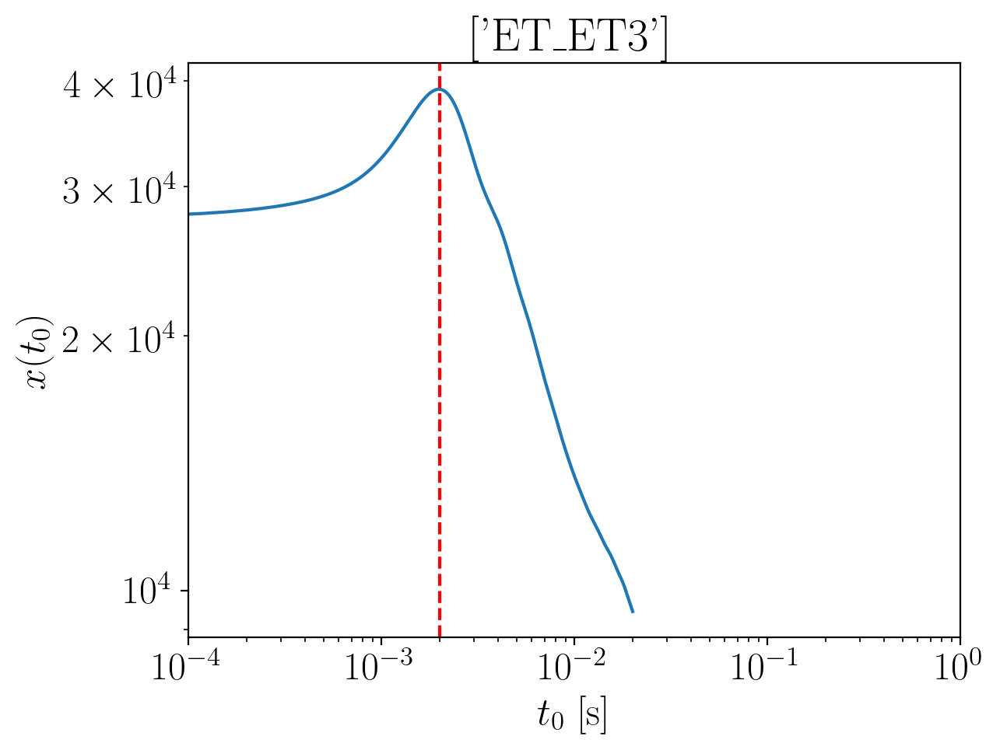

2024-01-15 16:30:52,328 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:52,345 - Network - INFO : PSDs loaded.
2024-01-15 16:30:52,349 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:30:52,513 - Network - INFO : Detector responses calculated.


time shift: 0.002
phase shift: -2.2607565361484547


2024-01-15 16:30:52,544 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:52,674 - Network - INFO : Polarizations calculated.
2024-01-15 16:30:52,675 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:30:52,701 - Network - INFO : Polarizations calculated.


Inner product:
0.9998123361664836


2024-01-15 16:31:03,190 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:31:03,332 - Network - INFO : PSDs loaded.
2024-01-15 16:31:03,397 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:03,509 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:03,510 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:31:03,511 - Network - INFO :    CE-40_C
2024-01-15 16:31:08,659 - Network - INFO :    CE-20_S
2024-01-15 16:31:12,260 - Network - INFO :    ET_ET1
2024-01-15 16:31:15,855 - Network - INFO :    ET_ET2
2024-01-15 16:31:19,534 - Network - INFO :    ET_ET3
2024-01-15 16:31:23,130 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:31:23,138 - Network - INFO : SNRs calculated.
2024-01-15 16:31:23,138 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:31:23,139 - Network - INFO :    CE-40_C
2024-01-15 16:31:23,235 - Network - INFO :

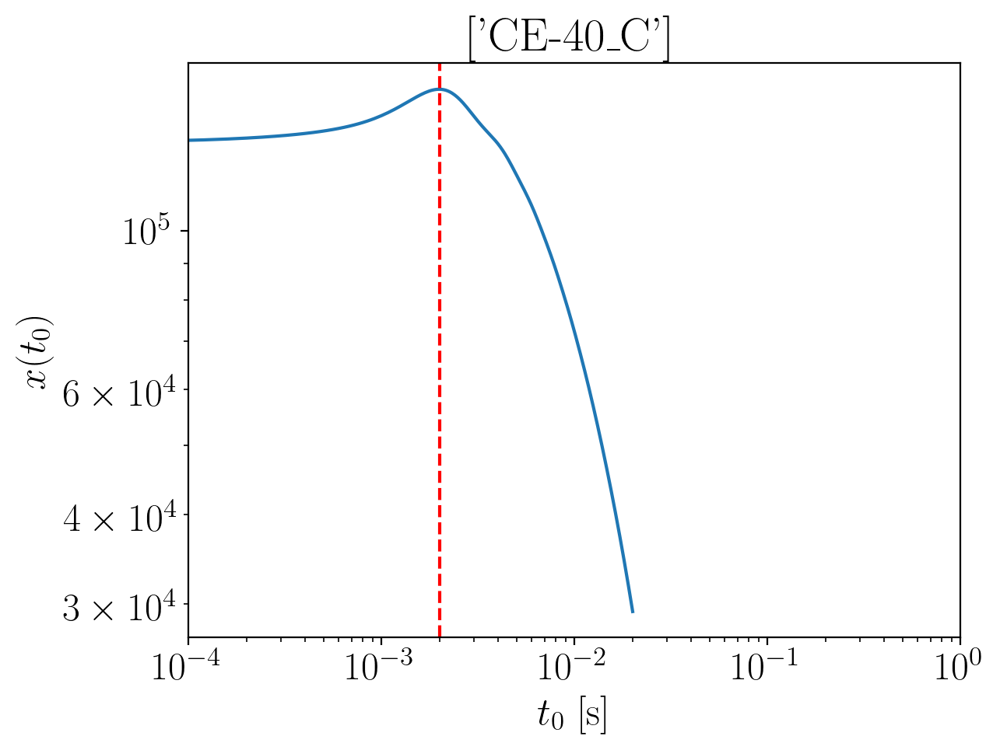

2024-01-15 16:31:24,976 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:24,982 - Network - INFO : PSDs loaded.
2024-01-15 16:31:24,984 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:24,991 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:24,998 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2552003583535853
Inner product:
0.9999236178172561


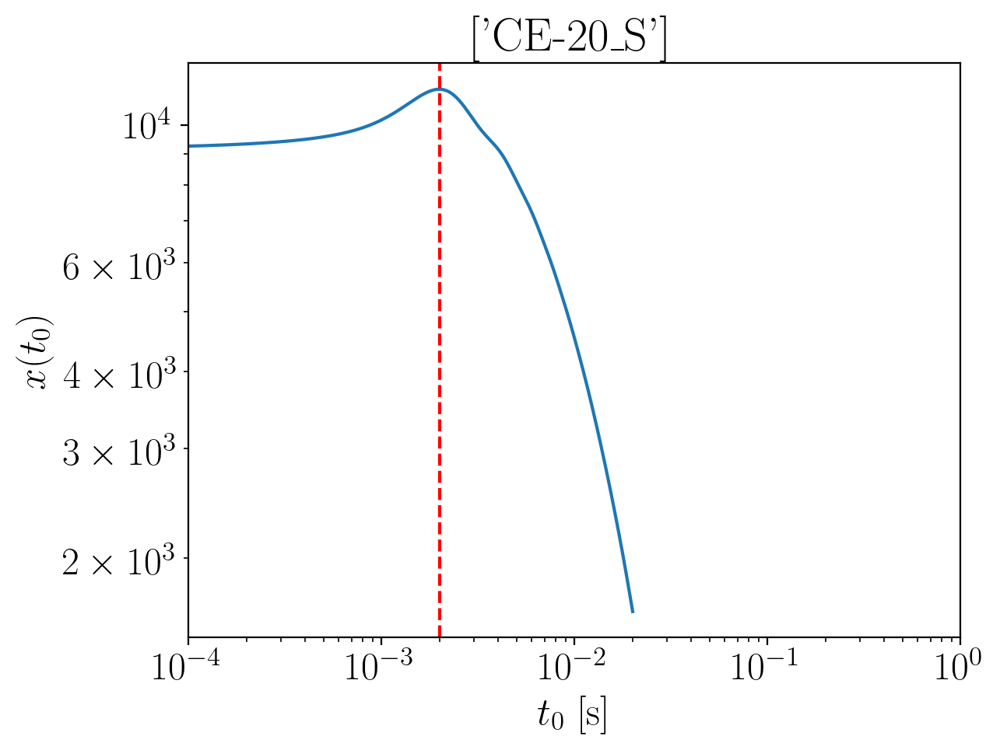

2024-01-15 16:31:26,189 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:26,196 - Network - INFO : PSDs loaded.
2024-01-15 16:31:26,198 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:26,205 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:26,212 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2539962844972523
Inner product:
0.9999153426244878


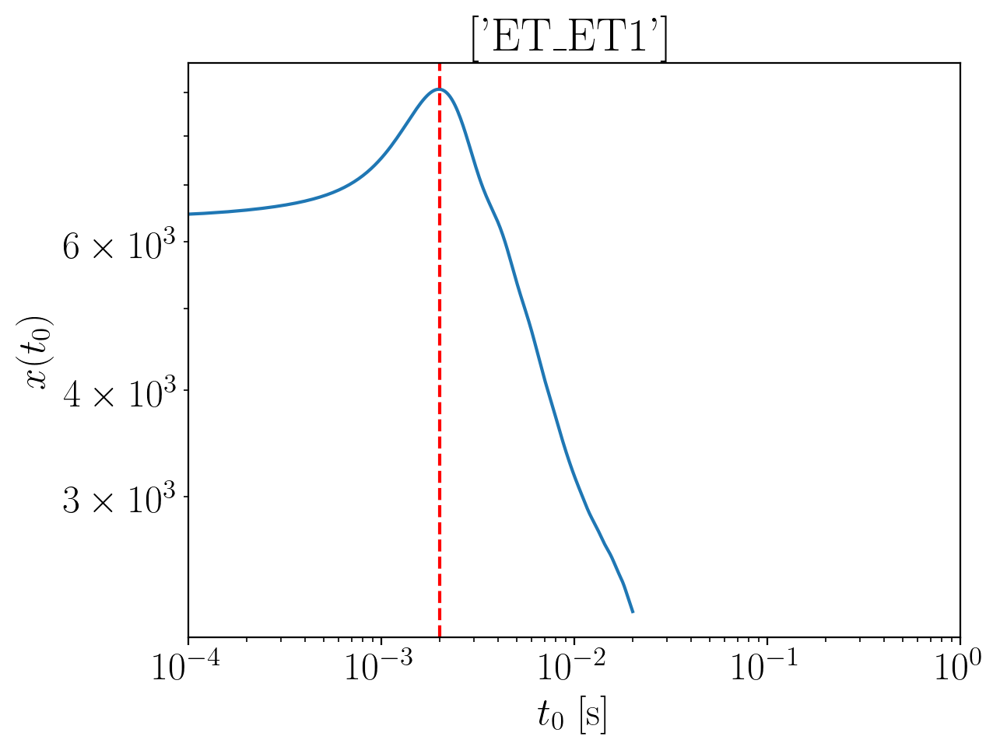

2024-01-15 16:31:27,563 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:27,577 - Network - INFO : PSDs loaded.
2024-01-15 16:31:27,579 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:27,586 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:27,592 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2644274518594503
Inner product:
0.9998123361664809


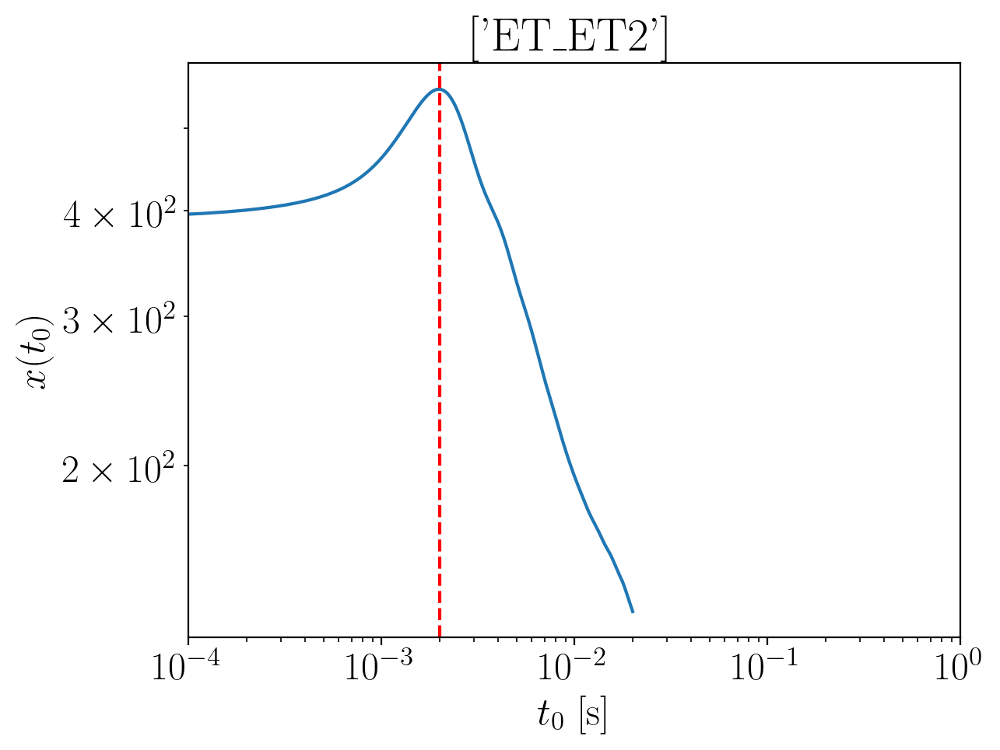

2024-01-15 16:31:29,016 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:29,029 - Network - INFO : PSDs loaded.
2024-01-15 16:31:29,031 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:29,038 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:29,045 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2644274518594503
Inner product:
0.9998123361664807


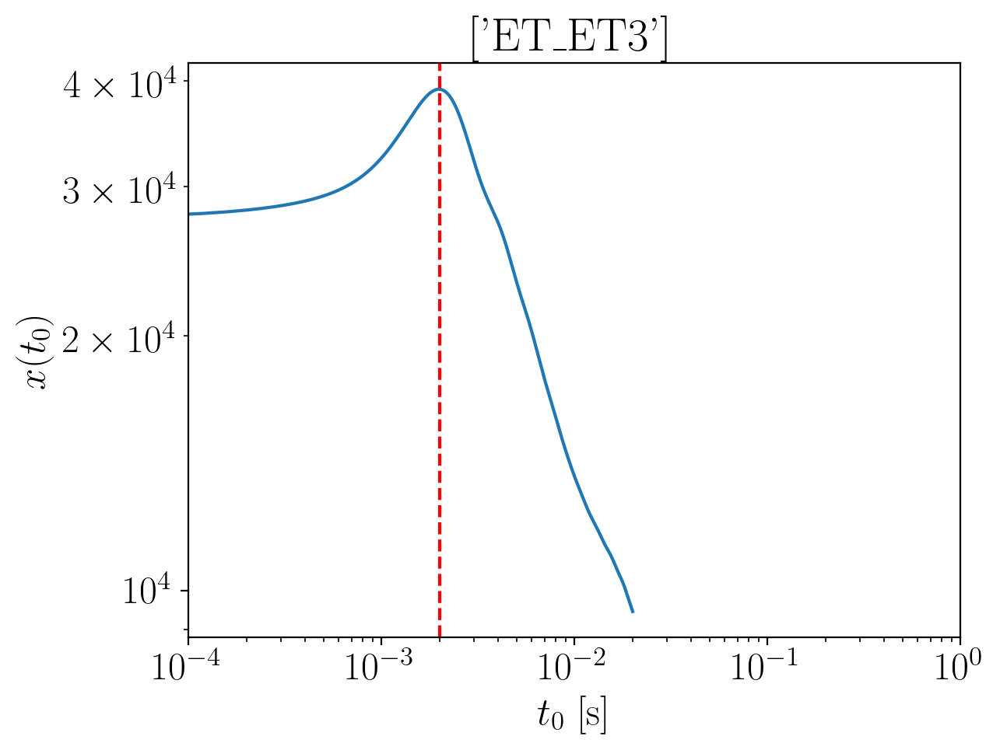

2024-01-15 16:31:30,538 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:30,550 - Network - INFO : PSDs loaded.
2024-01-15 16:31:30,569 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:30,603 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:30,610 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:30,643 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:30,644 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:31:30,649 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2644274518594503
Inner product:
0.9998123361664807


2024-01-15 16:31:36,357 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:31:36,404 - Network - INFO : PSDs loaded.
2024-01-15 16:31:36,410 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:36,494 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:36,503 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:31:36,504 - Network - INFO :    CE-40_C
2024-01-15 16:31:40,273 - Network - INFO :    CE-20_S
2024-01-15 16:31:43,885 - Network - INFO :    ET_ET1
2024-01-15 16:31:47,493 - Network - INFO :    ET_ET2
2024-01-15 16:31:51,198 - Network - INFO :    ET_ET3
2024-01-15 16:31:54,904 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:31:54,911 - Network - INFO : SNRs calculated.
2024-01-15 16:31:54,912 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:31:54,912 - Network - INFO :    CE-40_C
2024-01-15 16:31:55,008 - Network - INFO :

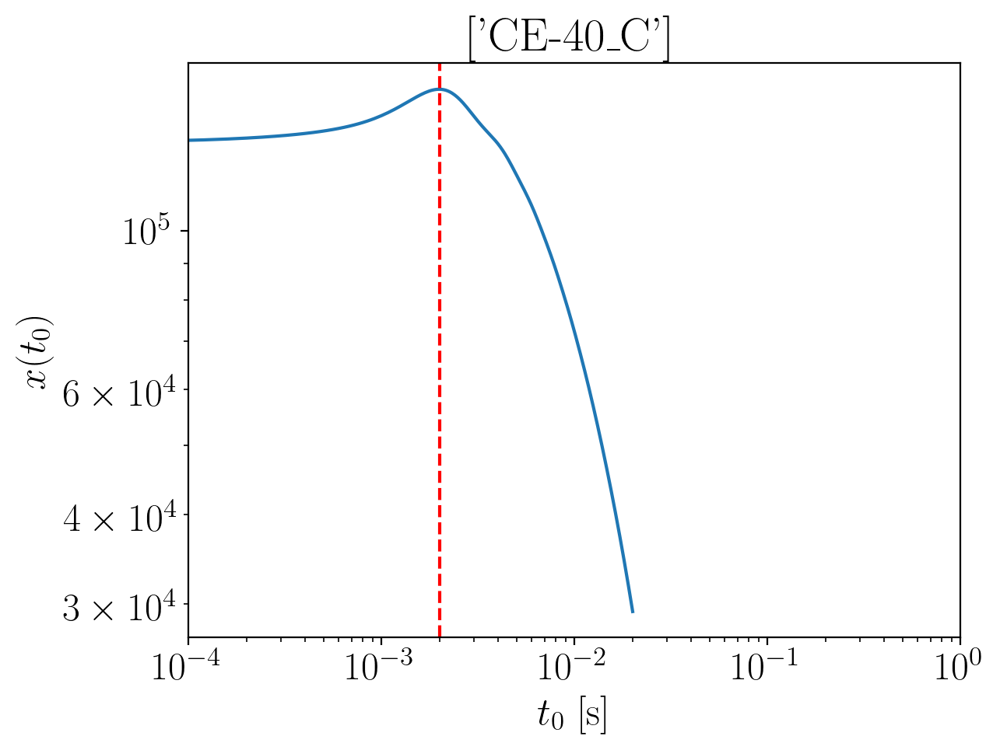

2024-01-15 16:31:56,930 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:56,936 - Network - INFO : PSDs loaded.
2024-01-15 16:31:56,938 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:56,945 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:56,951 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2595561735927685
Inner product:
0.9999236178172556


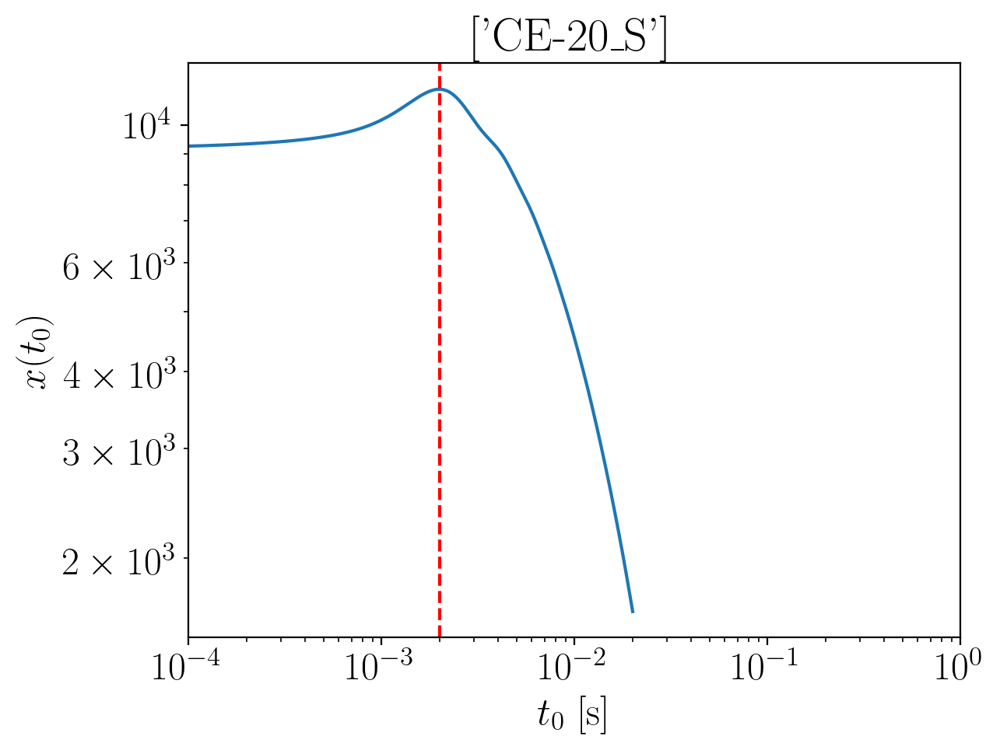

2024-01-15 16:31:58,161 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:58,167 - Network - INFO : PSDs loaded.
2024-01-15 16:31:58,169 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:58,176 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:58,183 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2583520997364386
Inner product:
0.9999153426244872


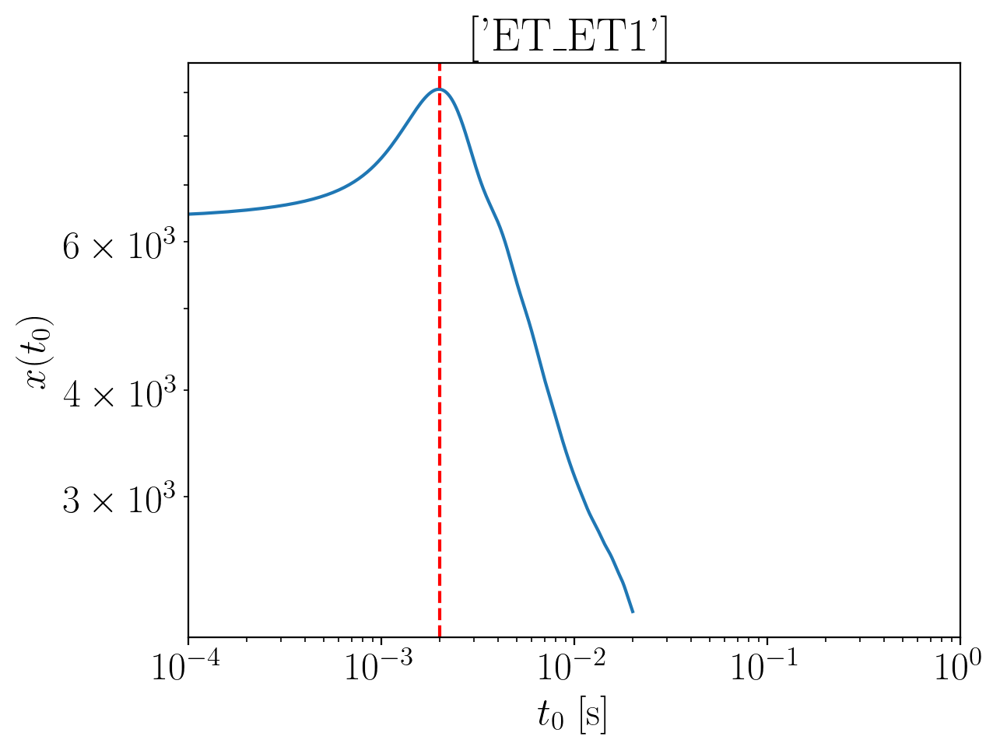

2024-01-15 16:31:59,554 - Network - INFO : Polarizations calculated.
2024-01-15 16:31:59,569 - Network - INFO : PSDs loaded.
2024-01-15 16:31:59,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:31:59,580 - Network - INFO : Detector responses calculated.
2024-01-15 16:31:59,587 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2687832670985455
Inner product:
0.9998123361664845


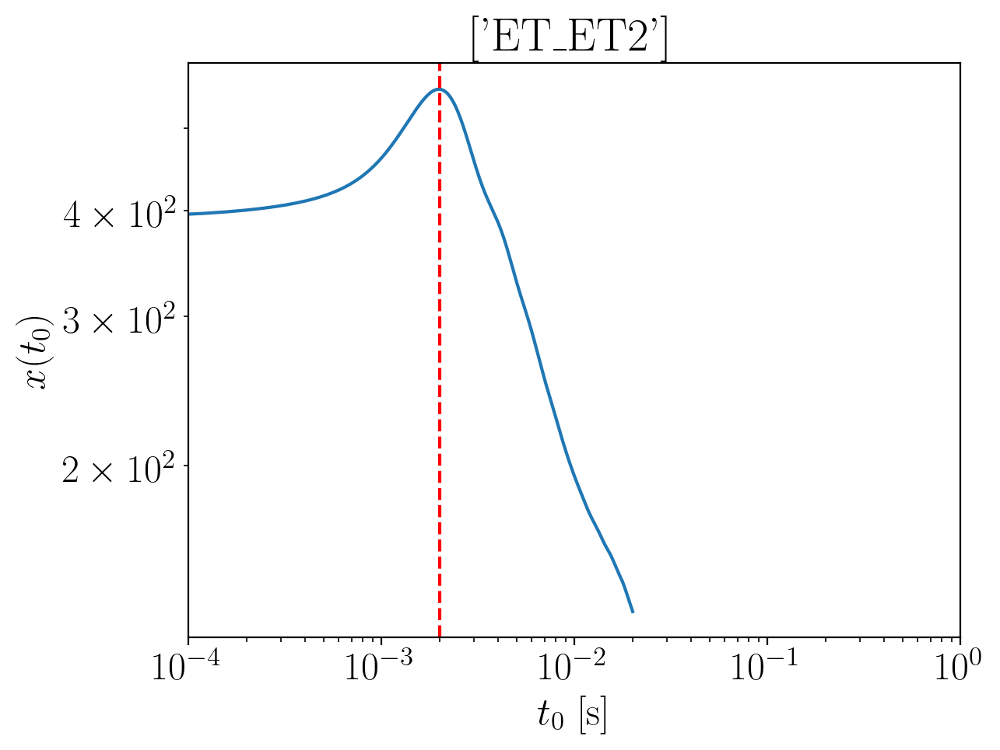

2024-01-15 16:32:01,216 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:01,235 - Network - INFO : PSDs loaded.
2024-01-15 16:32:01,237 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:01,246 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:01,255 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2687832670985455
Inner product:
0.9998123361664845


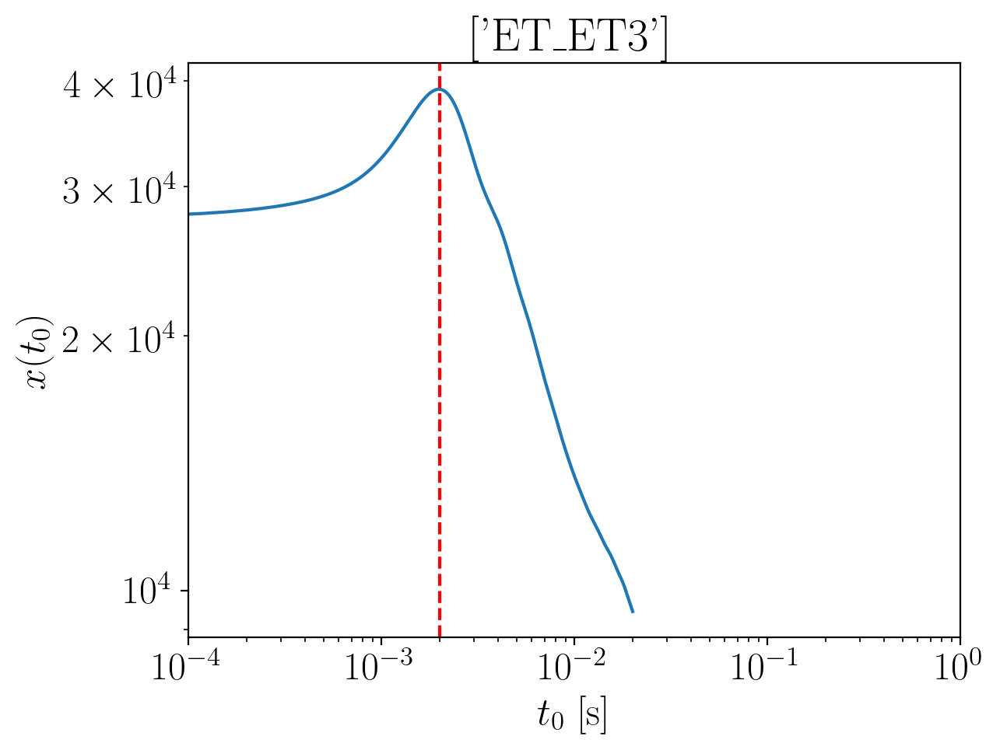

2024-01-15 16:32:03,201 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:03,217 - Network - INFO : PSDs loaded.
2024-01-15 16:32:03,220 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:03,228 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:03,236 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:03,284 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:03,294 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:32:03,314 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2687832670985455
Inner product:
0.9998123361664845


2024-01-15 16:32:09,761 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:32:09,809 - Network - INFO : PSDs loaded.
2024-01-15 16:32:09,827 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:09,889 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:09,889 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:32:09,890 - Network - INFO :    CE-40_C
2024-01-15 16:32:14,734 - Network - INFO :    CE-20_S
2024-01-15 16:32:20,852 - Network - INFO :    ET_ET1
2024-01-15 16:32:25,674 - Network - INFO :    ET_ET2
2024-01-15 16:32:30,580 - Network - INFO :    ET_ET3
2024-01-15 16:32:35,952 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:32:35,961 - Network - INFO : SNRs calculated.
2024-01-15 16:32:35,962 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:32:35,962 - Network - INFO :    CE-40_C
2024-01-15 16:32:36,059 - Network - INFO :

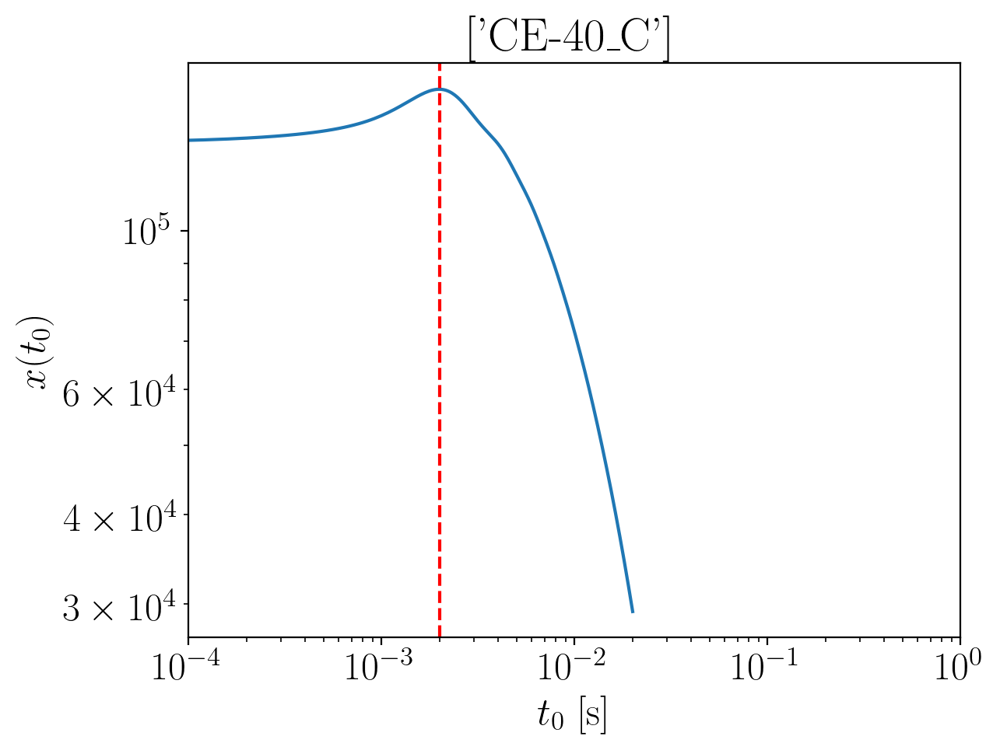

2024-01-15 16:32:37,862 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:37,869 - Network - INFO : PSDs loaded.
2024-01-15 16:32:37,871 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:37,878 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:37,885 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.259264397497123
Inner product:
0.9999236178172557


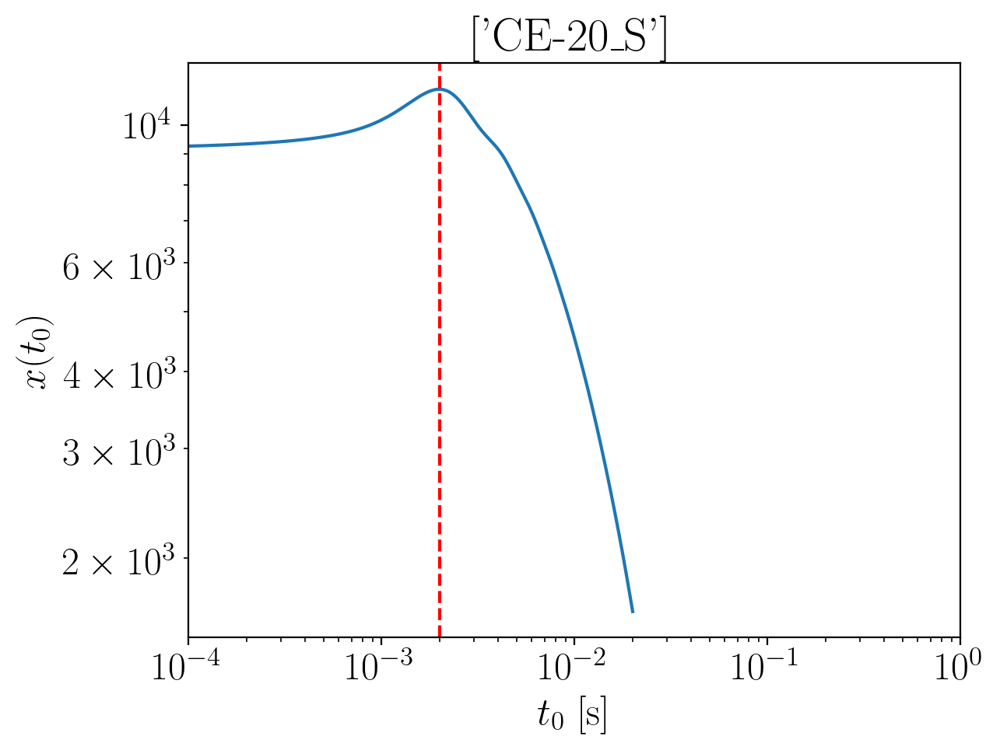

2024-01-15 16:32:39,373 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2580603236407892


2024-01-15 16:32:39,605 - Network - INFO : PSDs loaded.
2024-01-15 16:32:39,608 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:39,617 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:39,626 - Network - INFO : Polarizations calculated.


Inner product:
0.9999153426244871


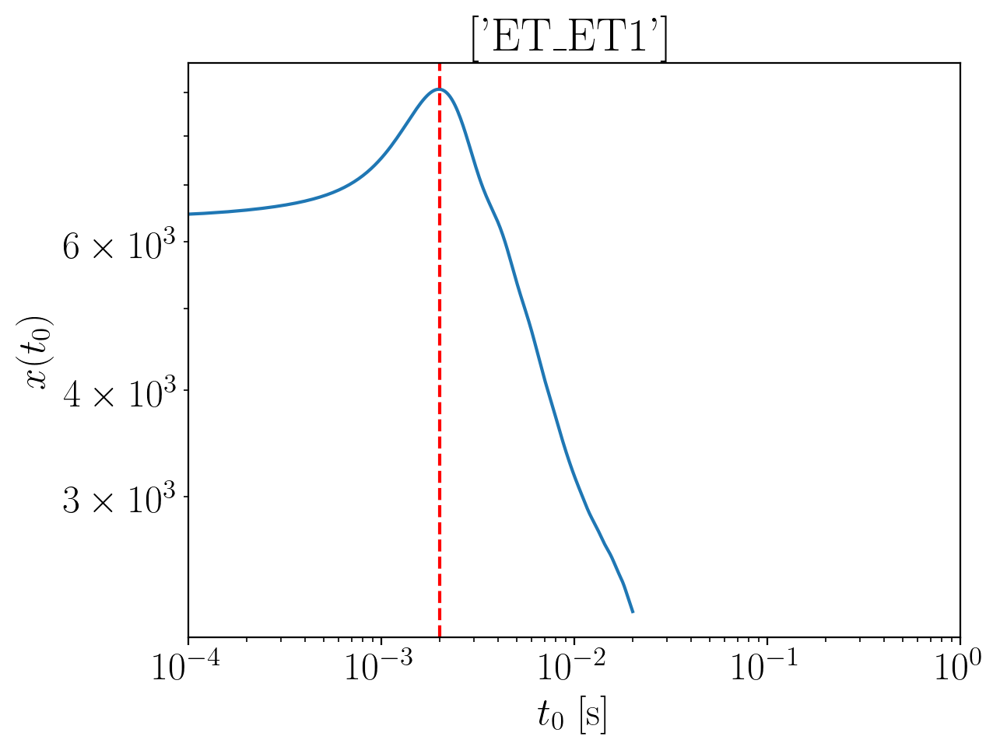

2024-01-15 16:32:41,392 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:41,408 - Network - INFO : PSDs loaded.
2024-01-15 16:32:41,411 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:41,423 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:41,435 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2684914910029677
Inner product:
0.9998123361664829


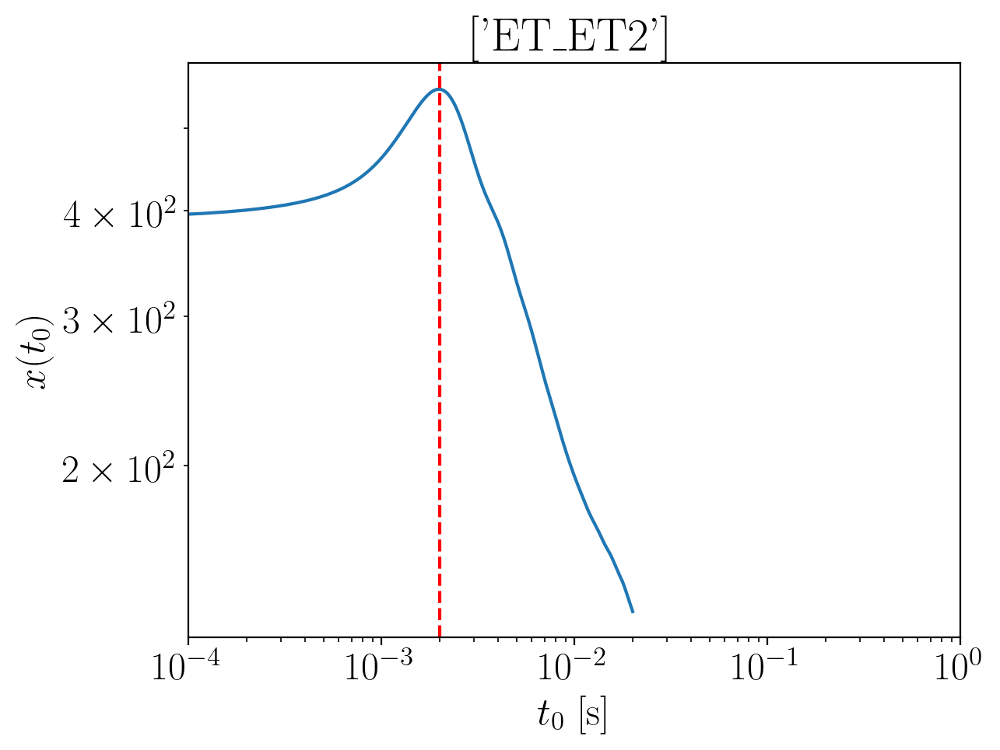

2024-01-15 16:32:43,045 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:43,061 - Network - INFO : PSDs loaded.
2024-01-15 16:32:43,065 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:43,093 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:43,110 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.268491491002967
Inner product:
0.9998123361664828


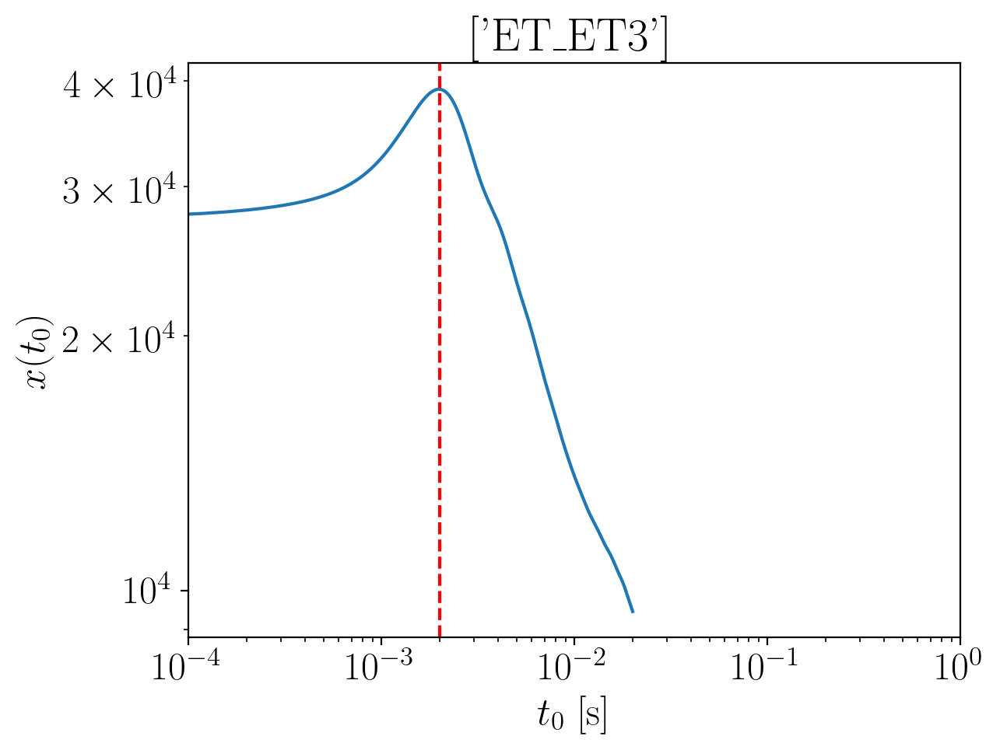

2024-01-15 16:32:45,282 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:45,308 - Network - INFO : PSDs loaded.
2024-01-15 16:32:45,311 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:45,366 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:45,384 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:45,477 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:45,478 - Network - INFO : Calculate numeric derivatives of polarizations.


time shift: 0.002
phase shift: -2.268491491002967
Inner product:
0.9998123361664831


2024-01-15 16:32:45,509 - Network - INFO : Polarizations calculated.
2024-01-15 16:32:51,446 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:32:51,489 - Network - INFO : PSDs loaded.
2024-01-15 16:32:51,494 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:32:51,514 - Network - INFO : Detector responses calculated.
2024-01-15 16:32:51,514 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:32:51,515 - Network - INFO :    CE-40_C
2024-01-15 16:32:55,143 - Network - INFO :    CE-20_S
2024-01-15 16:32:58,804 - Network - INFO :    ET_ET1
2024-01-15 16:33:02,578 - Network - INFO :    ET_ET2
2024-01-15 16:33:06,375 - Network - INFO :    ET_ET3
2024-01-15 16:33:10,316 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:33:10,325 - Network - INFO : SNRs calculated.
2024-01-15 16:33:10,325 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:33:10,326 - N

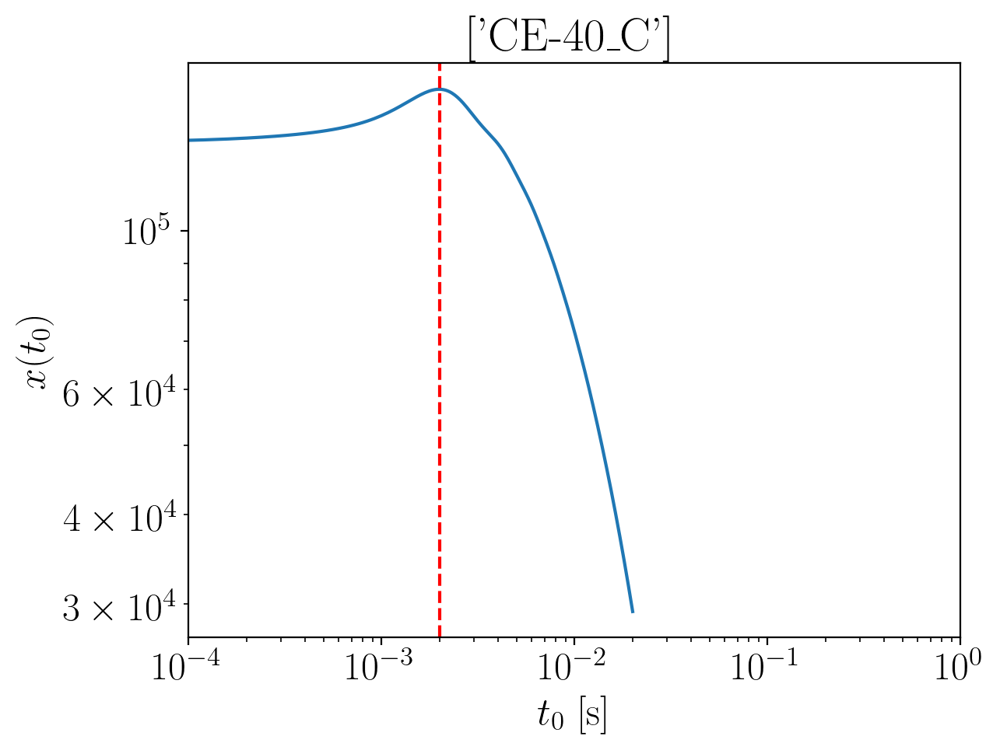

2024-01-15 16:33:12,974 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:12,987 - Network - INFO : PSDs loaded.
2024-01-15 16:33:12,991 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:13,006 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:13,023 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2562938520732407
Inner product:
0.9999236178172557


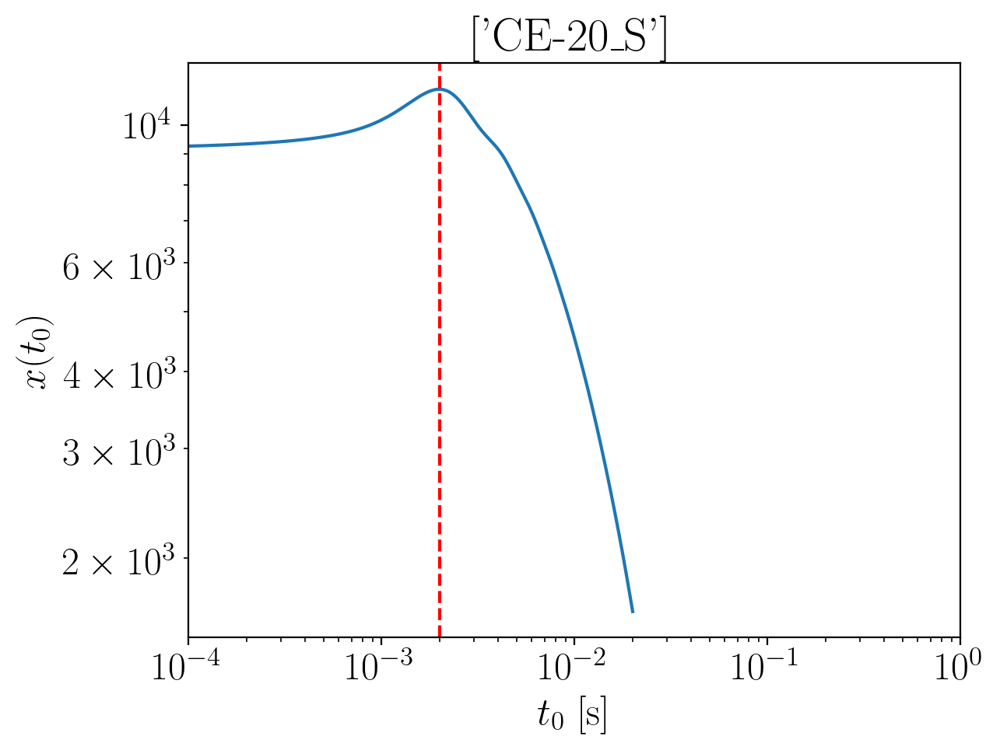

2024-01-15 16:33:14,692 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:14,702 - Network - INFO : PSDs loaded.
2024-01-15 16:33:14,704 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:14,715 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:14,724 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2550897782169095
Inner product:
0.9999153426244873


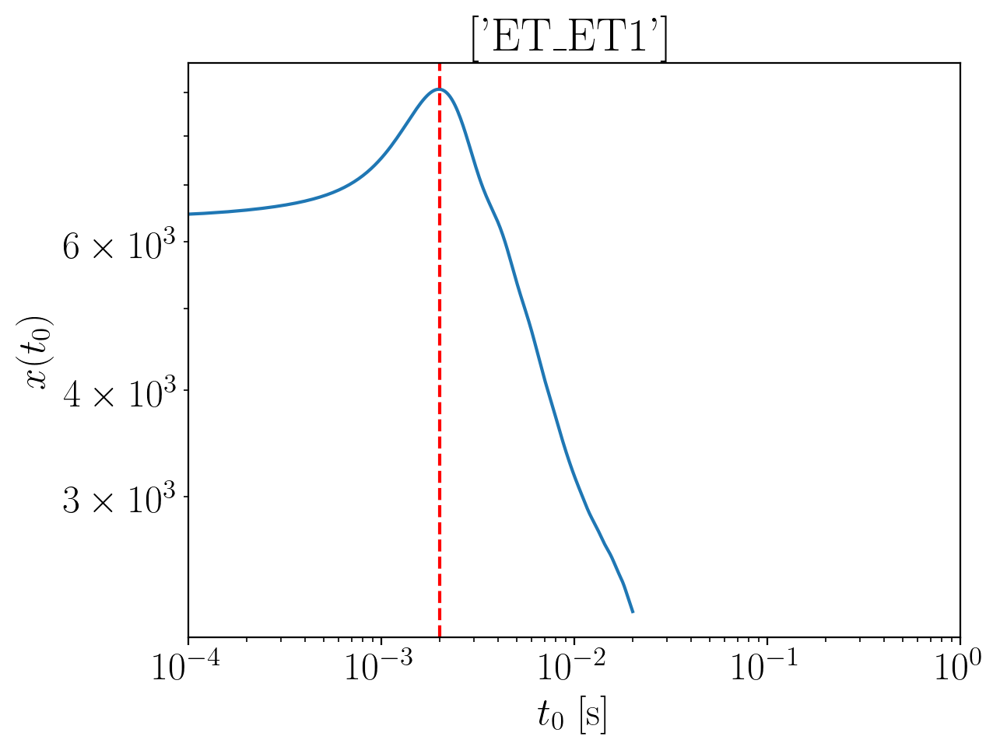

2024-01-15 16:33:17,830 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:17,851 - Network - INFO : PSDs loaded.
2024-01-15 16:33:17,855 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:17,867 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:17,903 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.265520945579034
Inner product:
0.999812336166484


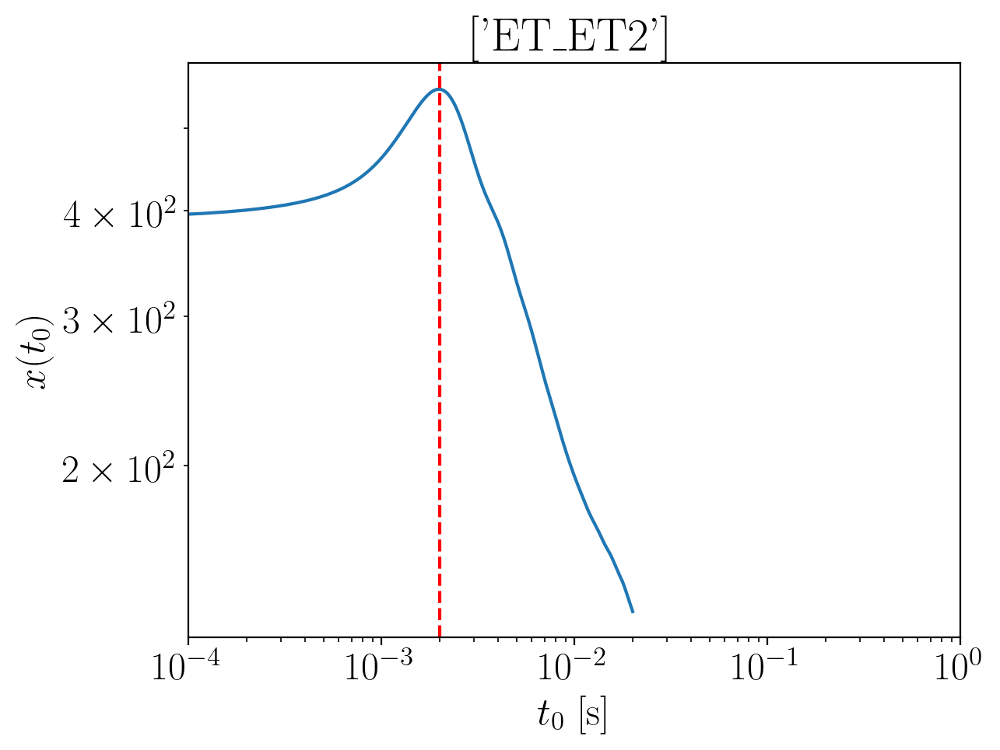

2024-01-15 16:33:20,238 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:20,250 - Network - INFO : PSDs loaded.
2024-01-15 16:33:20,252 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:20,259 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:20,266 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.265520945579034
Inner product:
0.9998123361664839


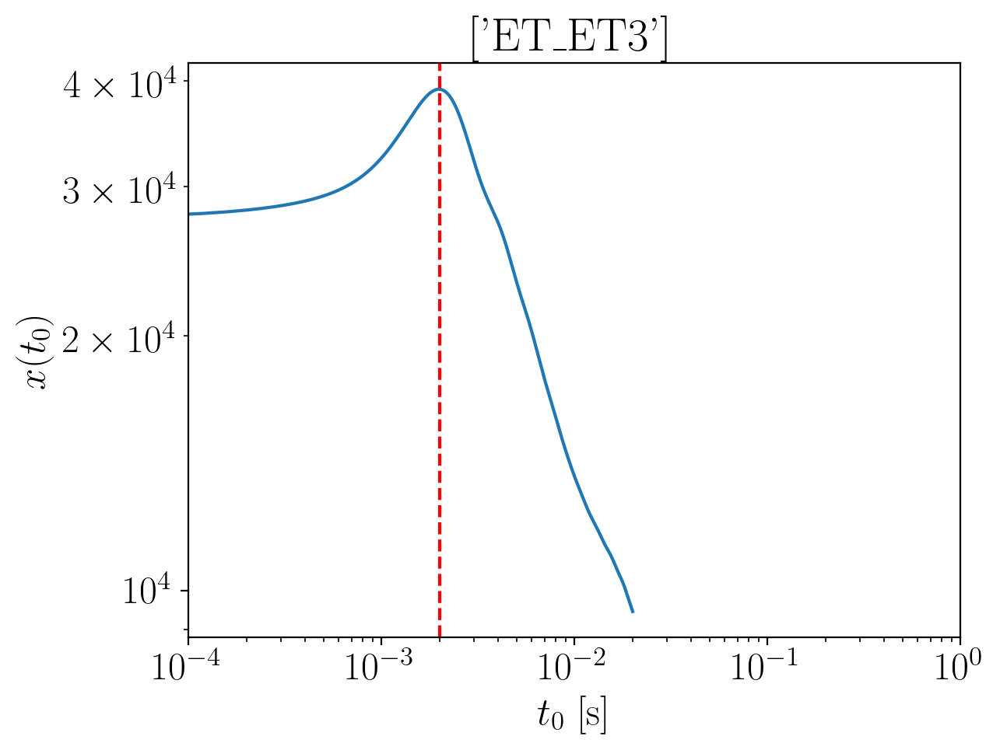

2024-01-15 16:33:22,744 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:22,761 - Network - INFO : PSDs loaded.
2024-01-15 16:33:22,764 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:22,775 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:22,784 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:22,857 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:22,877 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:33:22,939 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.265520945579034
Inner product:
0.9998123361664837


2024-01-15 16:33:29,532 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:33:29,579 - Network - INFO : PSDs loaded.
2024-01-15 16:33:29,604 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:29,655 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:29,656 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:33:29,656 - Network - INFO :    CE-40_C
2024-01-15 16:33:33,391 - Network - INFO :    CE-20_S
2024-01-15 16:33:37,892 - Network - INFO :    ET_ET1
2024-01-15 16:33:42,241 - Network - INFO :    ET_ET2
2024-01-15 16:33:46,404 - Network - INFO :    ET_ET3
2024-01-15 16:33:50,275 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:33:50,284 - Network - INFO : SNRs calculated.
2024-01-15 16:33:50,284 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:33:50,285 - Network - INFO :    CE-40_C
2024-01-15 16:33:50,385 - Network - INFO :

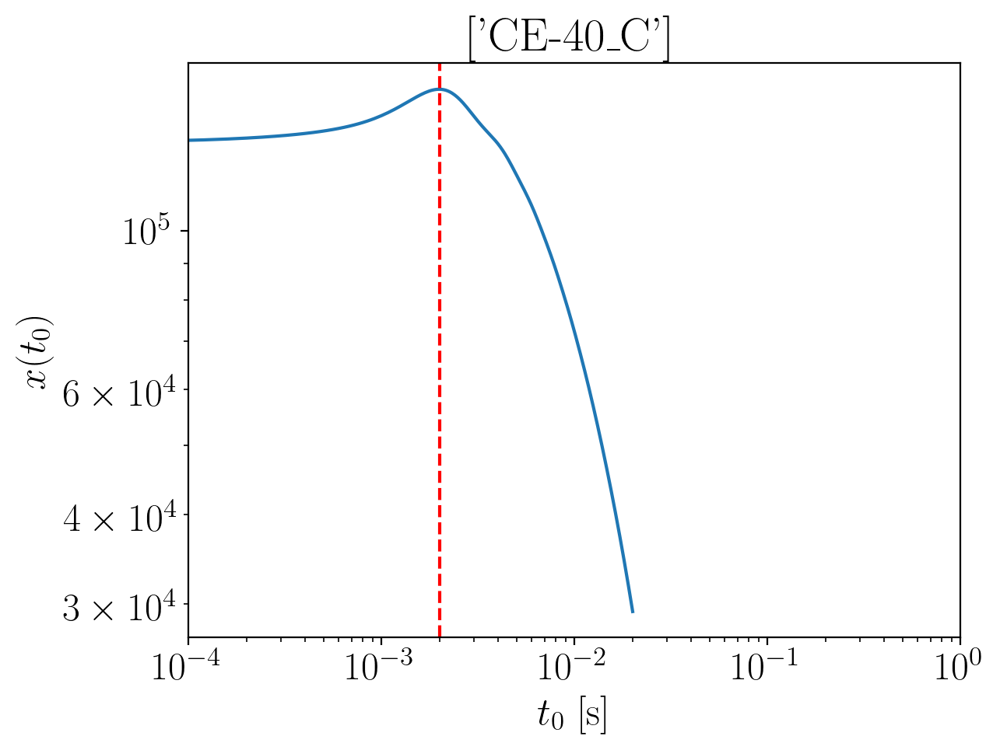

2024-01-15 16:33:53,564 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:53,578 - Network - INFO : PSDs loaded.
2024-01-15 16:33:53,582 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:53,711 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:53,743 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.251529442642667
Inner product:
0.9999236178172557


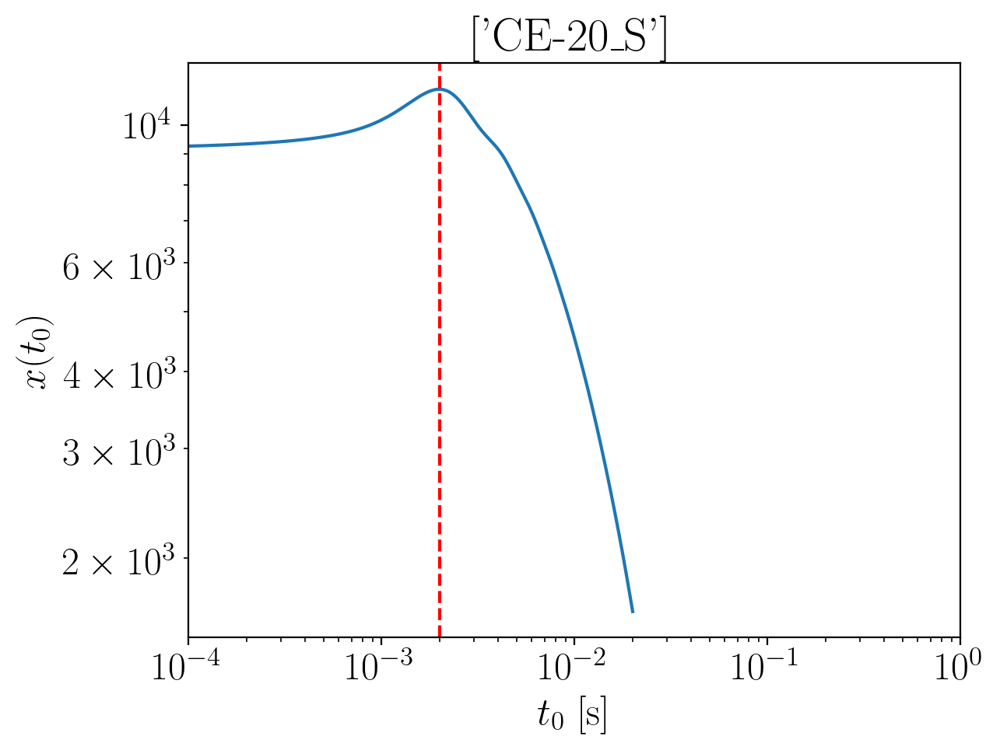

2024-01-15 16:33:56,119 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:56,126 - Network - INFO : PSDs loaded.
2024-01-15 16:33:56,128 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:56,137 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:56,144 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.250325368786336
Inner product:
0.9999153426244873


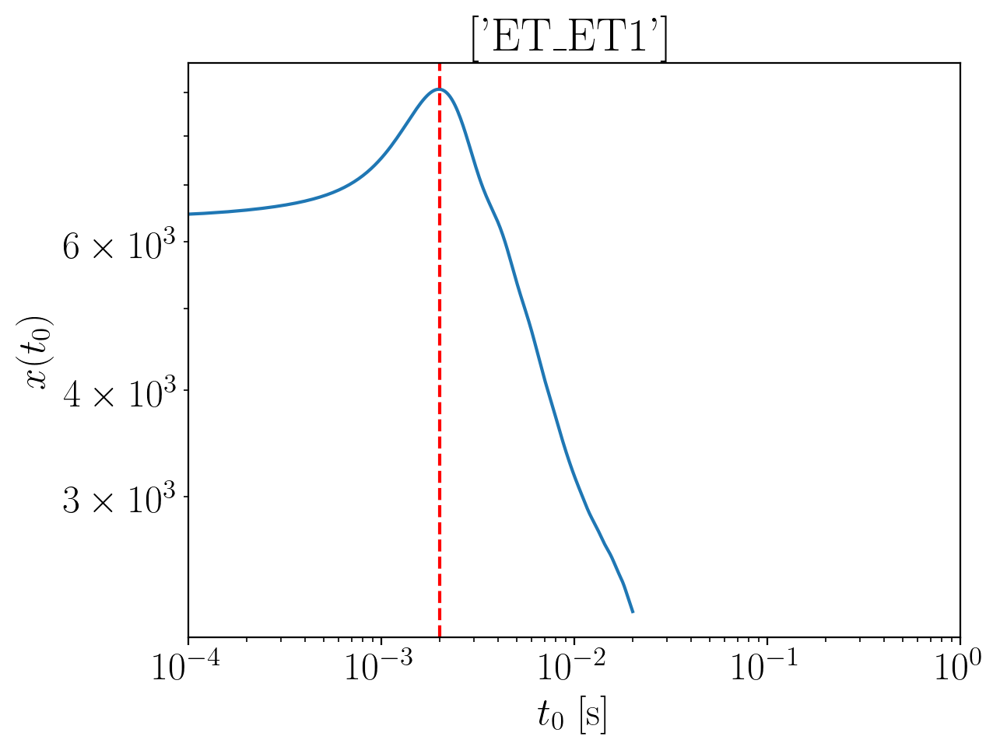

2024-01-15 16:33:58,291 - Network - INFO : Polarizations calculated.
2024-01-15 16:33:58,307 - Network - INFO : PSDs loaded.
2024-01-15 16:33:58,310 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:33:58,318 - Network - INFO : Detector responses calculated.
2024-01-15 16:33:58,361 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.999812336166484


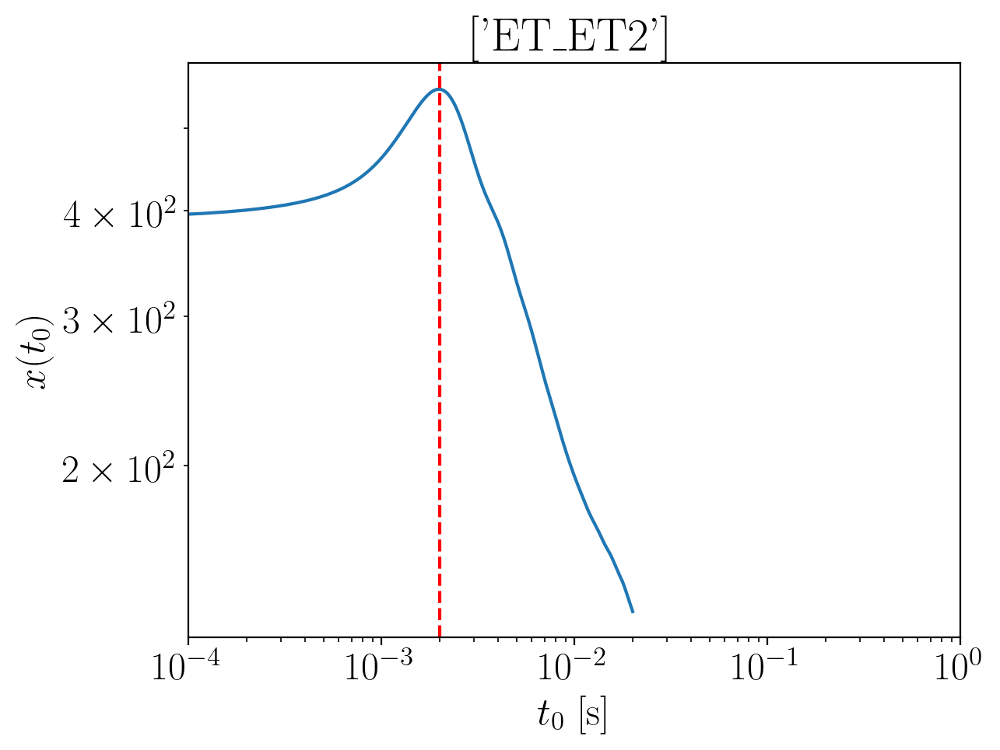

2024-01-15 16:34:00,477 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:00,493 - Network - INFO : PSDs loaded.
2024-01-15 16:34:00,495 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:00,547 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:00,624 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.9998123361664837


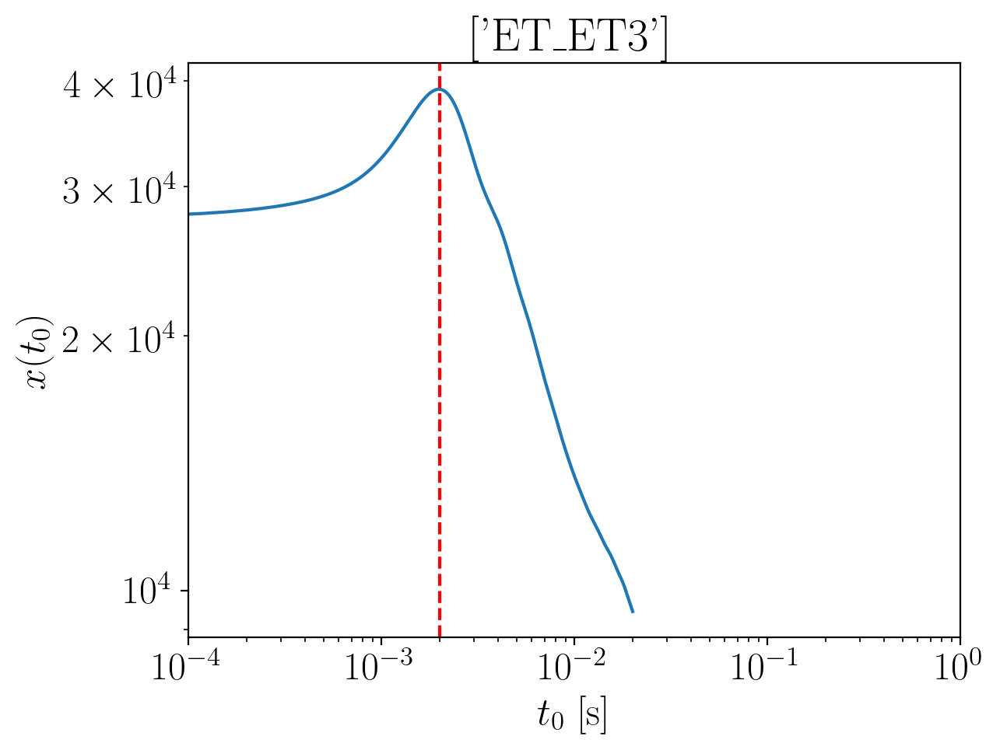

2024-01-15 16:34:02,431 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:02,447 - Network - INFO : PSDs loaded.
2024-01-15 16:34:02,449 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:02,482 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:02,493 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:02,543 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:02,544 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:34:02,550 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.9998123361664836


2024-01-15 16:34:08,274 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:34:08,324 - Network - INFO : PSDs loaded.
2024-01-15 16:34:08,346 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:08,385 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:08,386 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:34:08,387 - Network - INFO :    CE-40_C
2024-01-15 16:34:12,048 - Network - INFO :    CE-20_S
2024-01-15 16:34:15,663 - Network - INFO :    ET_ET1
2024-01-15 16:34:19,295 - Network - INFO :    ET_ET2
2024-01-15 16:34:22,913 - Network - INFO :    ET_ET3
2024-01-15 16:34:26,558 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:34:26,566 - Network - INFO : SNRs calculated.
2024-01-15 16:34:26,566 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:34:26,567 - Network - INFO :    CE-40_C
2024-01-15 16:34:26,659 - Network - INFO :

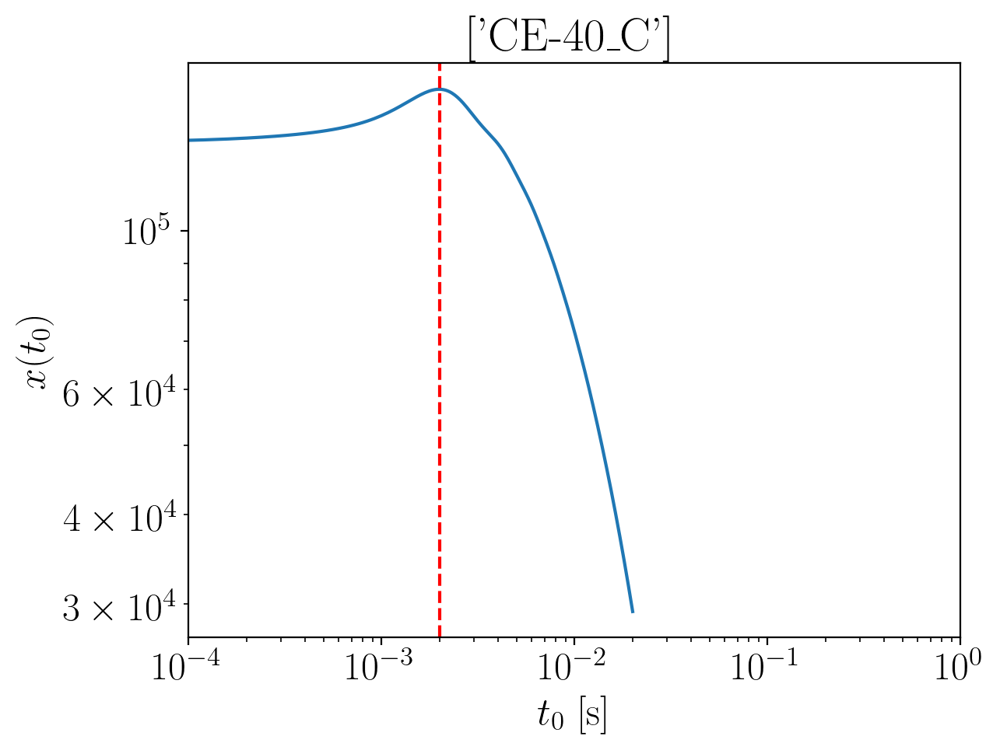

2024-01-15 16:34:28,561 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:28,568 - Network - INFO : PSDs loaded.
2024-01-15 16:34:28,570 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:28,604 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:28,628 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2454644494743685
Inner product:
0.9999236178172556


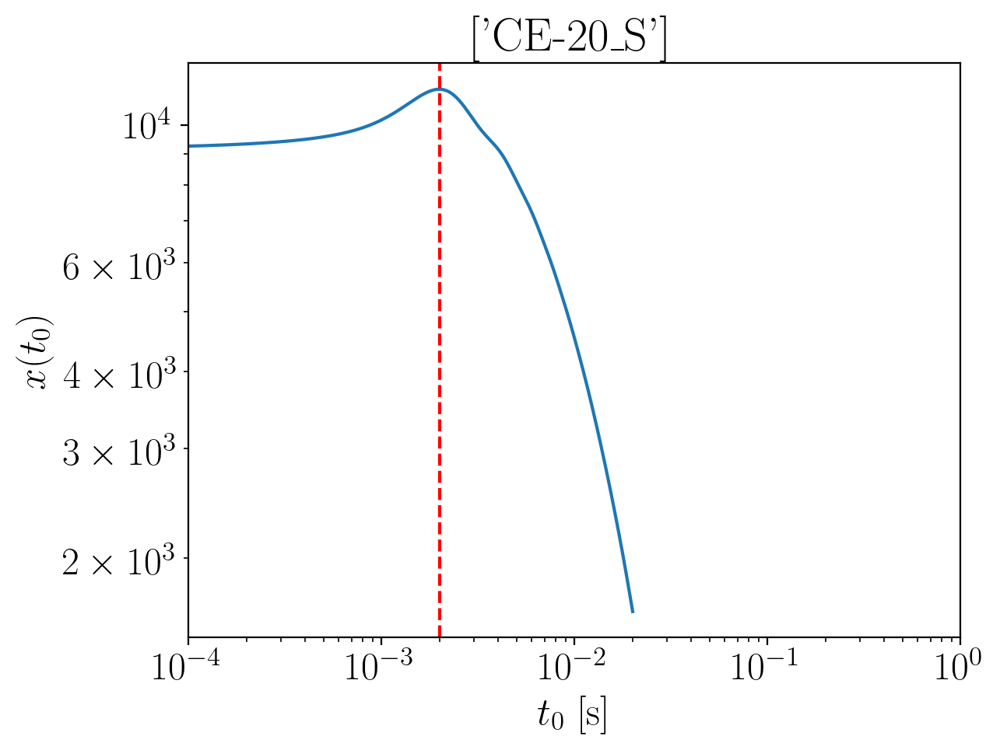

2024-01-15 16:34:29,831 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:29,837 - Network - INFO : PSDs loaded.
2024-01-15 16:34:29,839 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:29,845 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:29,852 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.244260375618037
Inner product:
0.9999153426244873


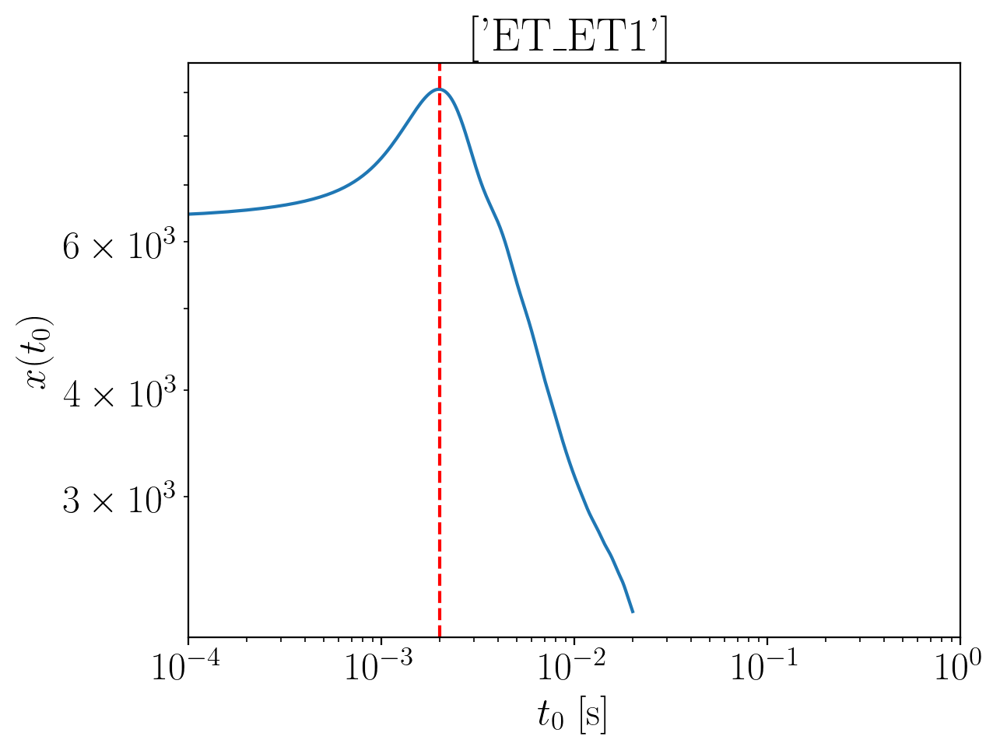

2024-01-15 16:34:31,204 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:31,217 - Network - INFO : PSDs loaded.
2024-01-15 16:34:31,218 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:31,228 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:31,236 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2546915429801664
Inner product:
0.9998123361664838


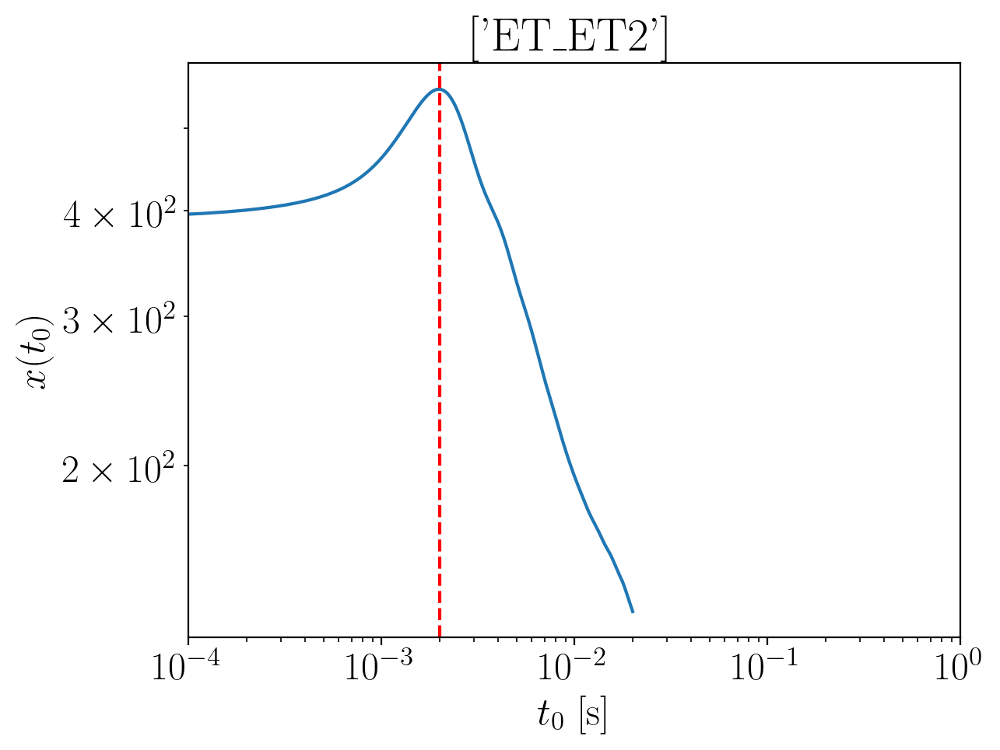

2024-01-15 16:34:32,623 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:32,637 - Network - INFO : PSDs loaded.
2024-01-15 16:34:32,638 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:32,645 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:32,652 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2546915429801664
Inner product:
0.9998123361664837


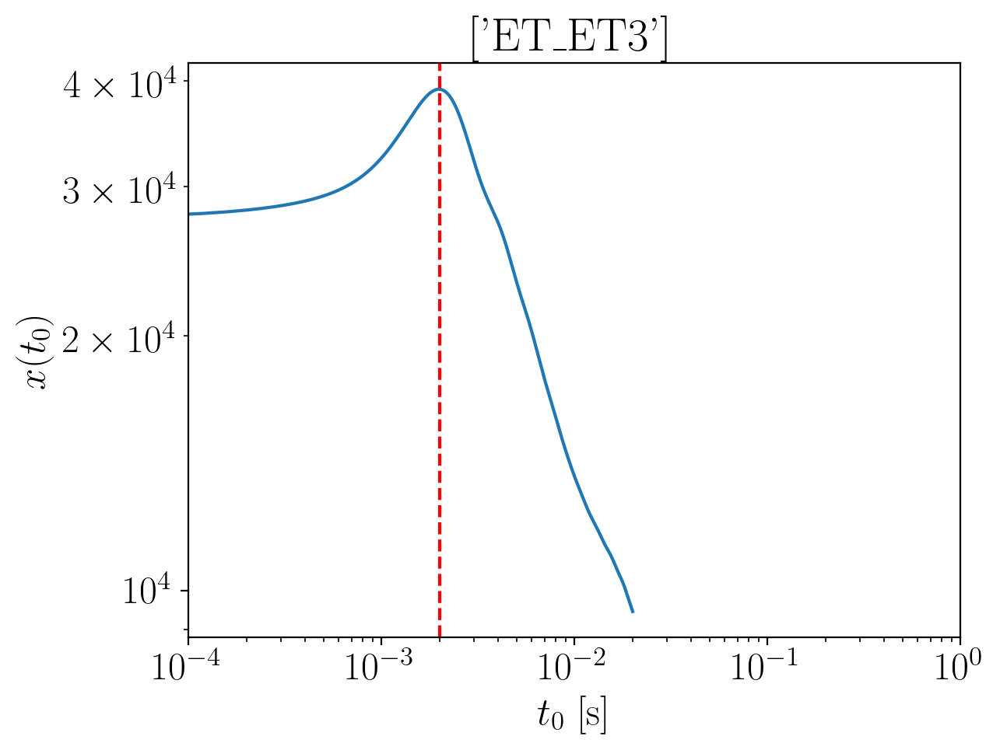

2024-01-15 16:34:34,103 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:34,115 - Network - INFO : PSDs loaded.
2024-01-15 16:34:34,117 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:34,124 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:34,131 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:34,154 - Network - INFO : Polarizations calculated.
2024-01-15 16:34:34,155 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:34:34,159 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2546915429801664
Inner product:
0.9998123361664835


2024-01-15 16:34:39,621 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:34:39,714 - Network - INFO : PSDs loaded.
2024-01-15 16:34:39,780 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:34:39,860 - Network - INFO : Detector responses calculated.
2024-01-15 16:34:39,877 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:34:39,886 - Network - INFO :    CE-40_C
2024-01-15 16:34:43,642 - Network - INFO :    CE-20_S
2024-01-15 16:34:47,324 - Network - INFO :    ET_ET1
2024-01-15 16:34:51,110 - Network - INFO :    ET_ET2
2024-01-15 16:34:54,788 - Network - INFO :    ET_ET3
2024-01-15 16:34:58,434 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:34:58,443 - Network - INFO : SNRs calculated.
2024-01-15 16:34:58,443 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:34:58,444 - Network - INFO :    CE-40_C
2024-01-15 16:34:58,541 - Network - INFO :

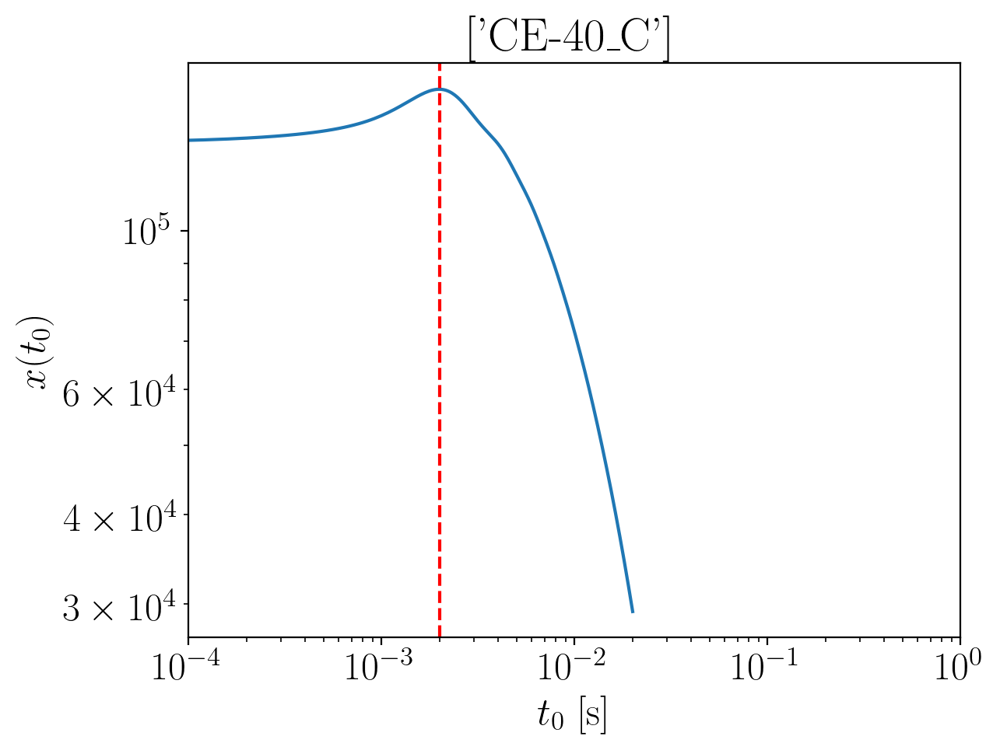

2024-01-15 16:35:00,470 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:00,477 - Network - INFO : PSDs loaded.
2024-01-15 16:35:00,479 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:00,486 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:00,493 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2384082183244045
Inner product:
0.9999236178172555


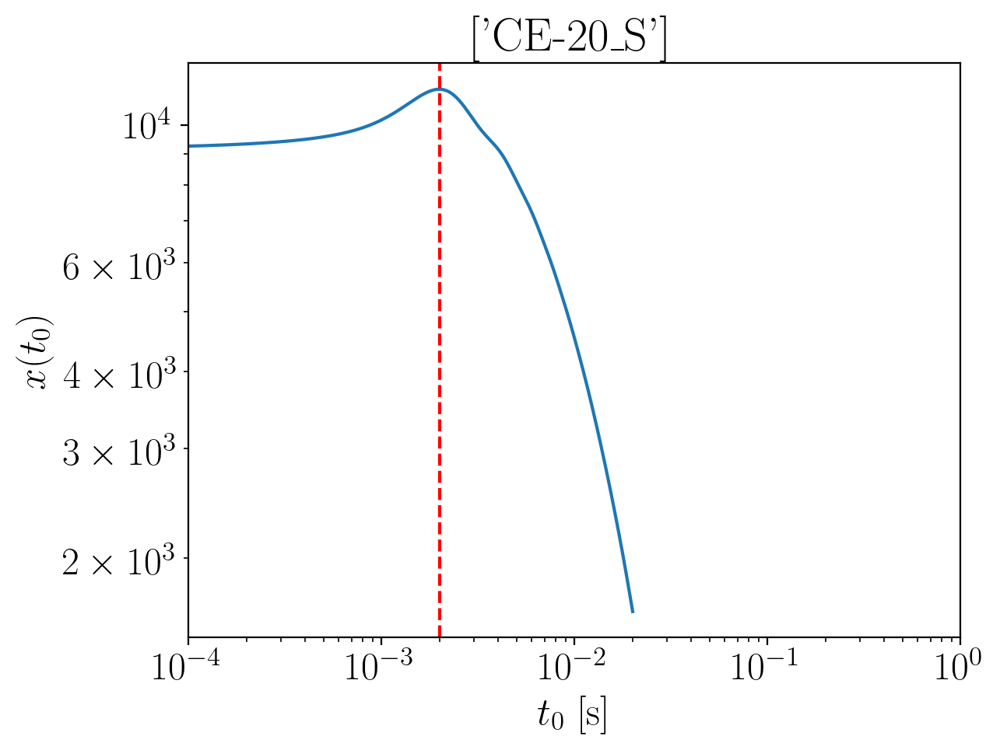

2024-01-15 16:35:02,218 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:02,237 - Network - INFO : PSDs loaded.
2024-01-15 16:35:02,240 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:02,261 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:02,274 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2372041444680733
Inner product:
0.9999153426244873


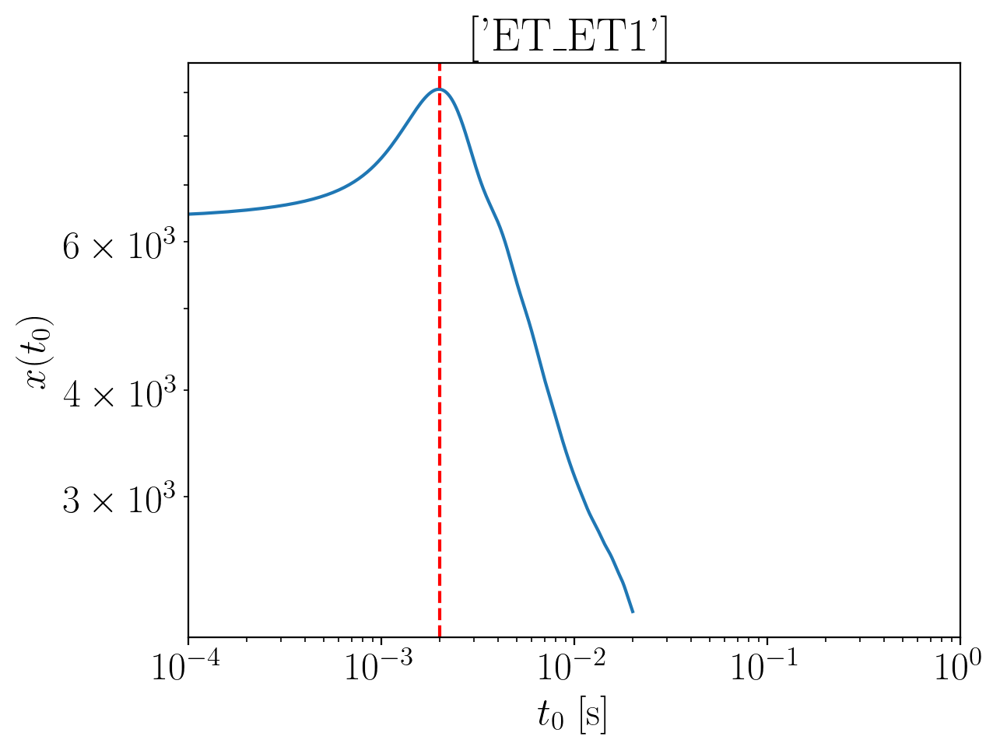

2024-01-15 16:35:04,818 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:04,832 - Network - INFO : PSDs loaded.
2024-01-15 16:35:04,834 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:04,841 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:04,878 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2476353118302064
Inner product:
0.9998123361664838


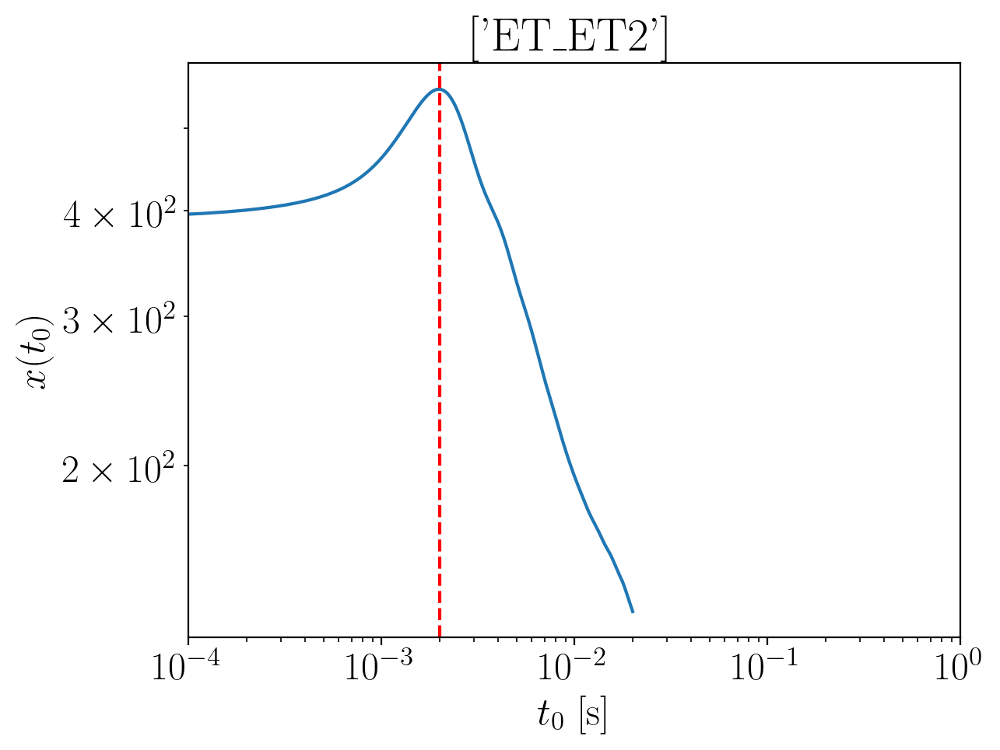

2024-01-15 16:35:06,468 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:06,481 - Network - INFO : PSDs loaded.
2024-01-15 16:35:06,488 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:06,499 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:06,515 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2476353118302064
Inner product:
0.9998123361664837


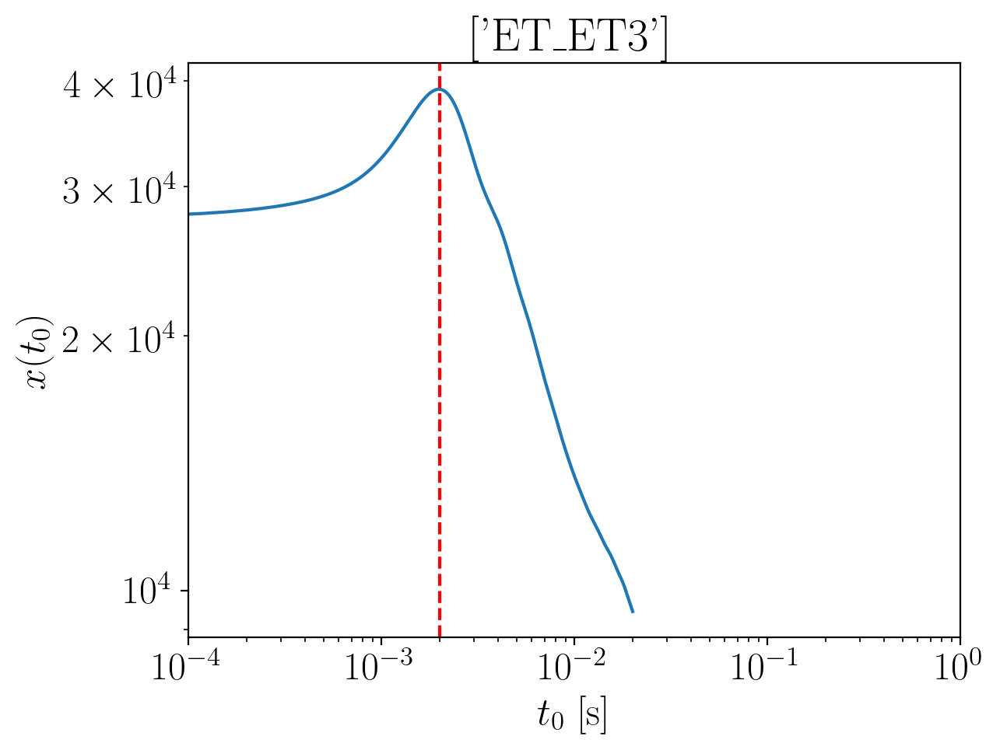

2024-01-15 16:35:08,124 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:08,142 - Network - INFO : PSDs loaded.
2024-01-15 16:35:08,145 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:08,152 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:08,159 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:08,184 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:08,185 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:35:08,190 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2476353118302064
Inner product:
0.9998123361664836


2024-01-15 16:35:13,896 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:35:13,945 - Network - INFO : PSDs loaded.
2024-01-15 16:35:13,964 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:14,005 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:14,006 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:35:14,007 - Network - INFO :    CE-40_C
2024-01-15 16:35:17,653 - Network - INFO :    CE-20_S
2024-01-15 16:35:21,256 - Network - INFO :    ET_ET1
2024-01-15 16:35:24,877 - Network - INFO :    ET_ET2
2024-01-15 16:35:28,487 - Network - INFO :    ET_ET3
2024-01-15 16:35:32,073 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:35:32,080 - Network - INFO : SNRs calculated.
2024-01-15 16:35:32,081 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:35:32,081 - Network - INFO :    CE-40_C
2024-01-15 16:35:32,175 - Network - INFO :

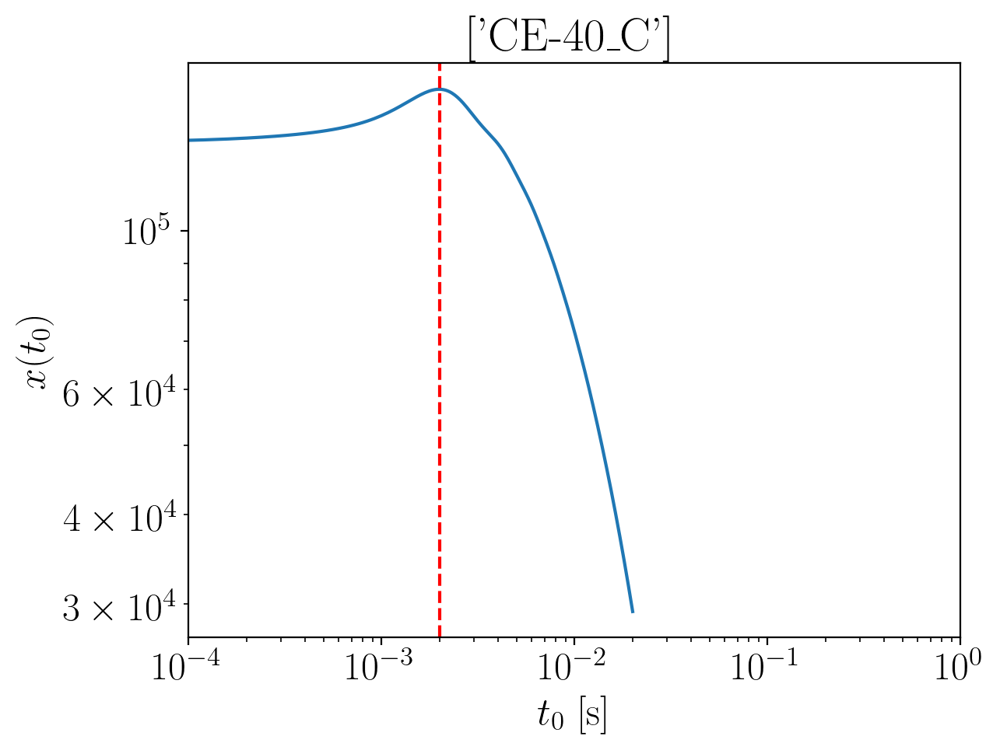

2024-01-15 16:35:33,900 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:33,907 - Network - INFO : PSDs loaded.
2024-01-15 16:35:33,910 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:33,919 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:33,926 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2305699902302814
Inner product:
0.9999236178172555


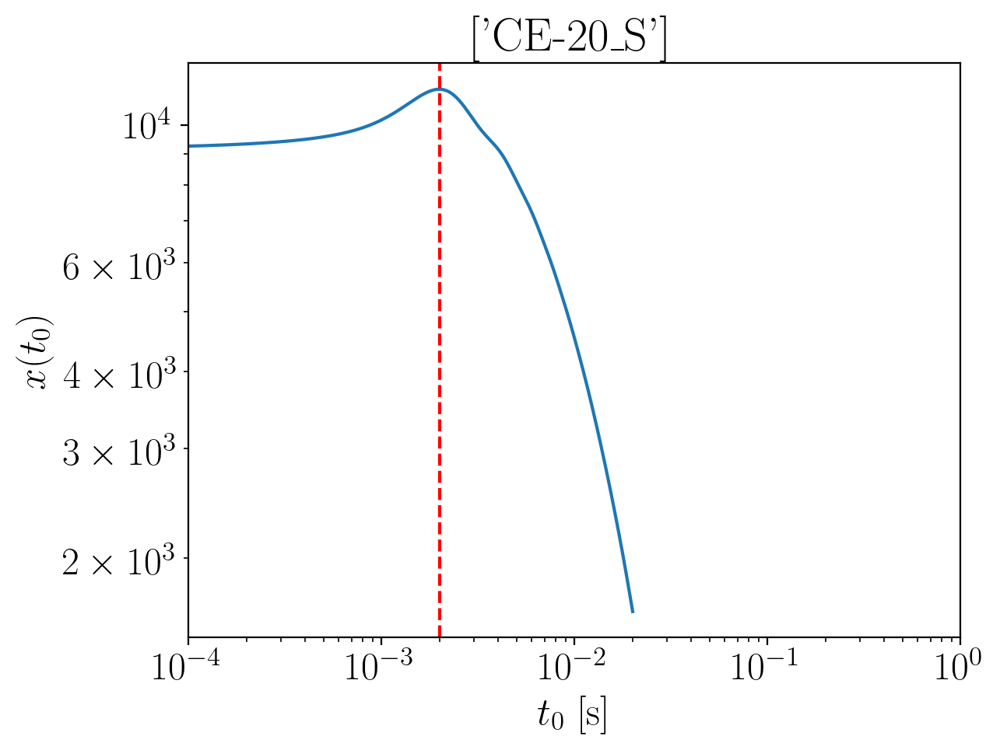

2024-01-15 16:35:35,123 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:35,129 - Network - INFO : PSDs loaded.
2024-01-15 16:35:35,131 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:35,138 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:35,145 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.22936591637395
Inner product:
0.9999153426244873


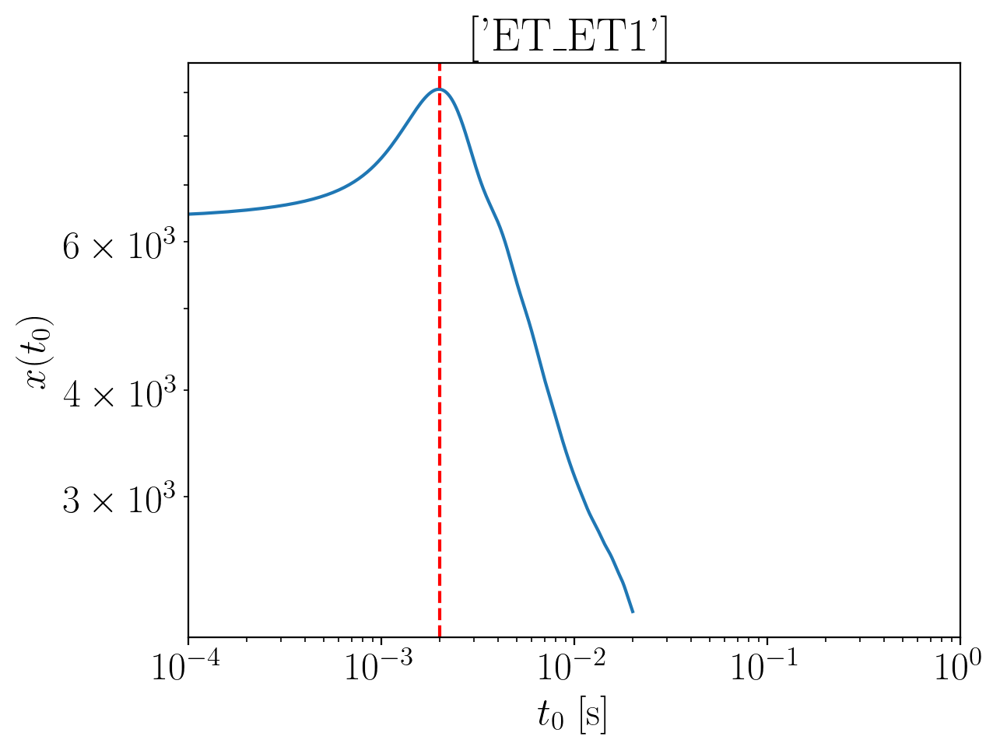

2024-01-15 16:35:36,500 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:36,514 - Network - INFO : PSDs loaded.
2024-01-15 16:35:36,517 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:36,526 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:36,533 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2397970837360823
Inner product:
0.9998123361664838


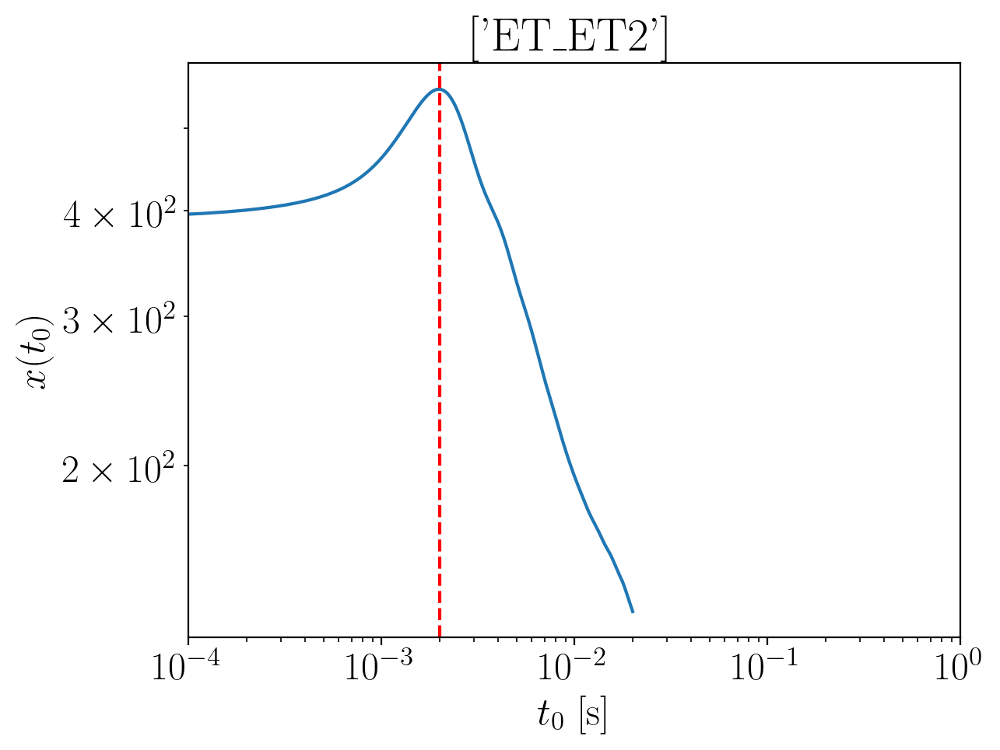

2024-01-15 16:35:37,915 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:37,928 - Network - INFO : PSDs loaded.
2024-01-15 16:35:37,930 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:37,937 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:37,944 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2397970837360823
Inner product:
0.9998123361664837


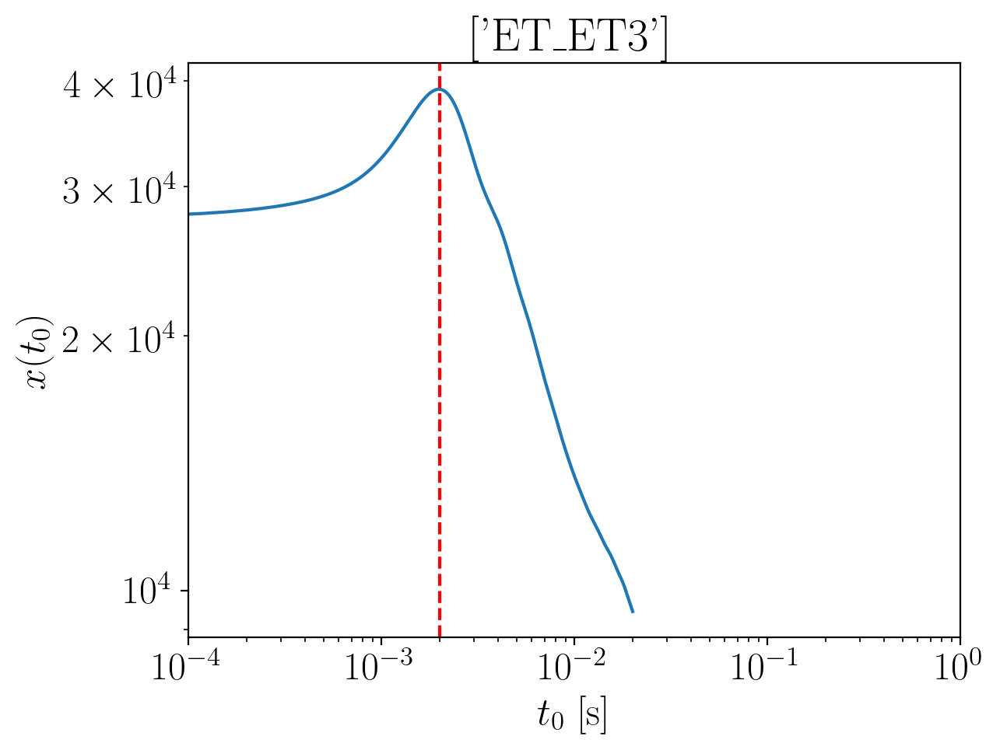

2024-01-15 16:35:39,473 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:39,486 - Network - INFO : PSDs loaded.
2024-01-15 16:35:39,487 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:39,494 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:39,506 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:39,529 - Network - INFO : Polarizations calculated.
2024-01-15 16:35:39,530 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:35:39,535 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2397970837360823
Inner product:
0.9998123361664834


2024-01-15 16:35:44,949 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:35:44,995 - Network - INFO : PSDs loaded.
2024-01-15 16:35:45,023 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:35:45,056 - Network - INFO : Detector responses calculated.
2024-01-15 16:35:45,057 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:35:45,058 - Network - INFO :    CE-40_C
2024-01-15 16:35:48,769 - Network - INFO :    CE-20_S
2024-01-15 16:35:52,399 - Network - INFO :    ET_ET1
2024-01-15 16:35:56,014 - Network - INFO :    ET_ET2
2024-01-15 16:35:59,642 - Network - INFO :    ET_ET3
2024-01-15 16:36:03,239 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:36:03,246 - Network - INFO : SNRs calculated.
2024-01-15 16:36:03,247 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:36:03,247 - Network - INFO :    CE-40_C
2024-01-15 16:36:03,340 - Network - INFO :

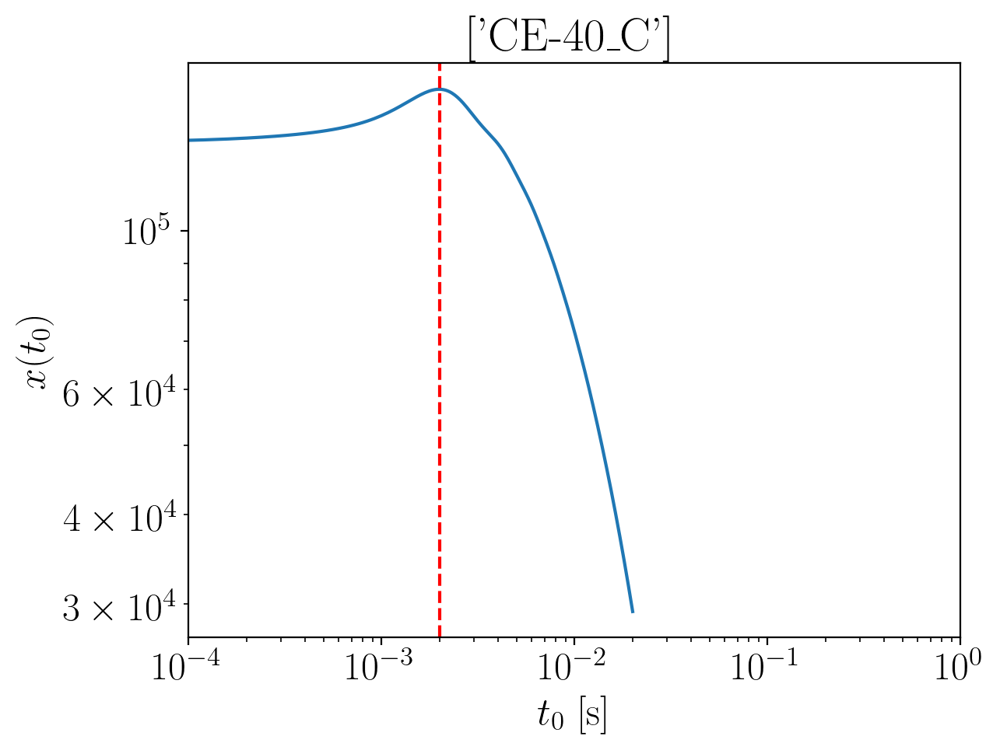

2024-01-15 16:36:05,060 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:05,066 - Network - INFO : PSDs loaded.
2024-01-15 16:36:05,067 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:05,074 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:05,082 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2220990075007756
Inner product:
0.9999236178172557


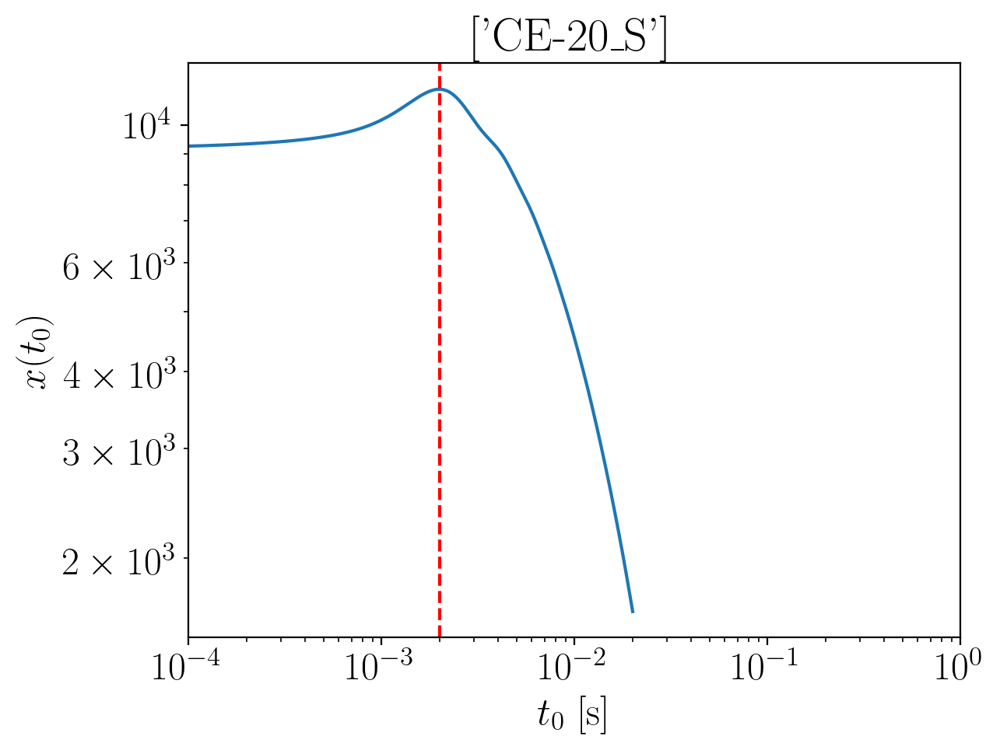

2024-01-15 16:36:06,307 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:06,313 - Network - INFO : PSDs loaded.
2024-01-15 16:36:06,315 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:06,322 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:06,329 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.220894933644445
Inner product:
0.9999153426244873


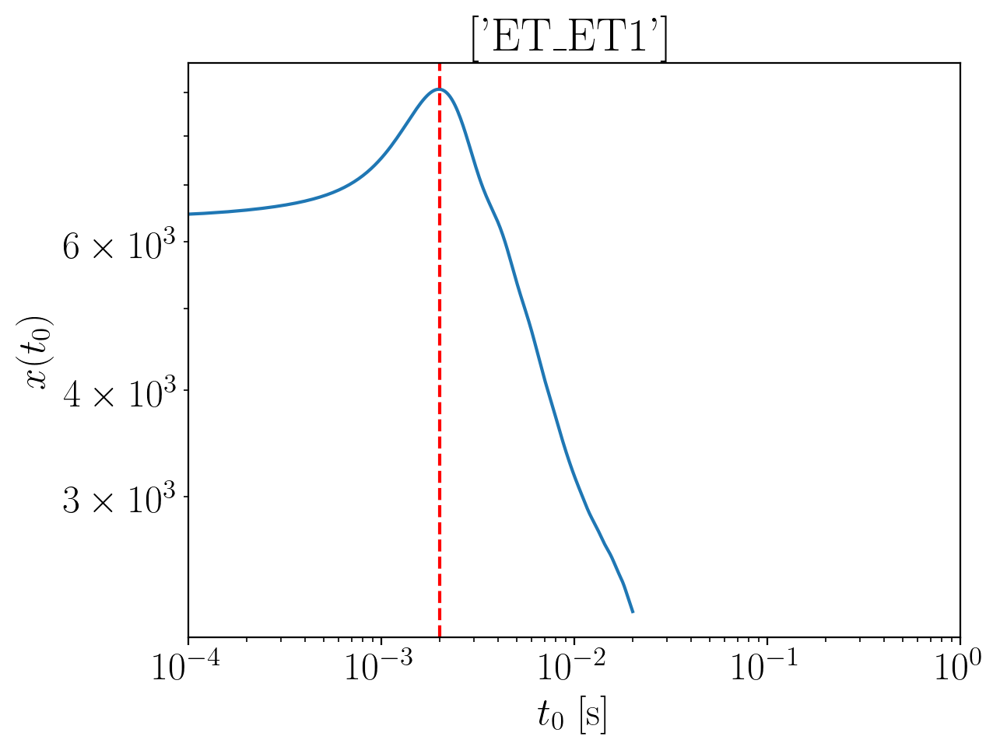

2024-01-15 16:36:07,711 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:07,724 - Network - INFO : PSDs loaded.
2024-01-15 16:36:07,726 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:07,733 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:07,739 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2313261010065775
Inner product:
0.9998123361664836


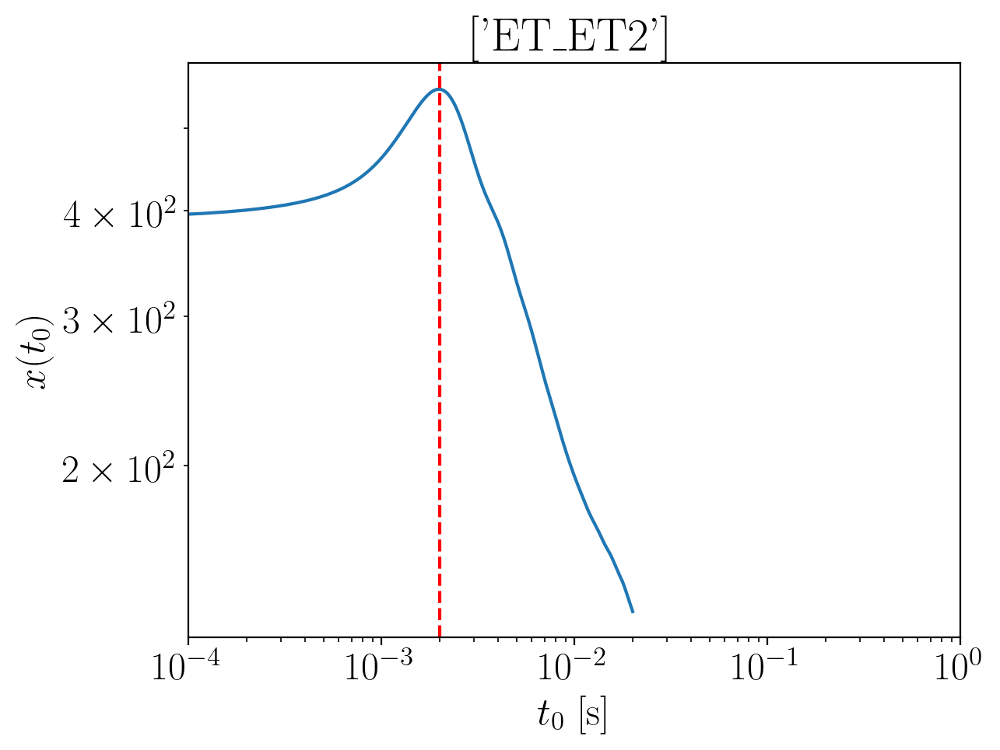

2024-01-15 16:36:09,141 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:09,158 - Network - INFO : PSDs loaded.
2024-01-15 16:36:09,159 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:09,166 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:09,173 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2313261010065775
Inner product:
0.9998123361664837


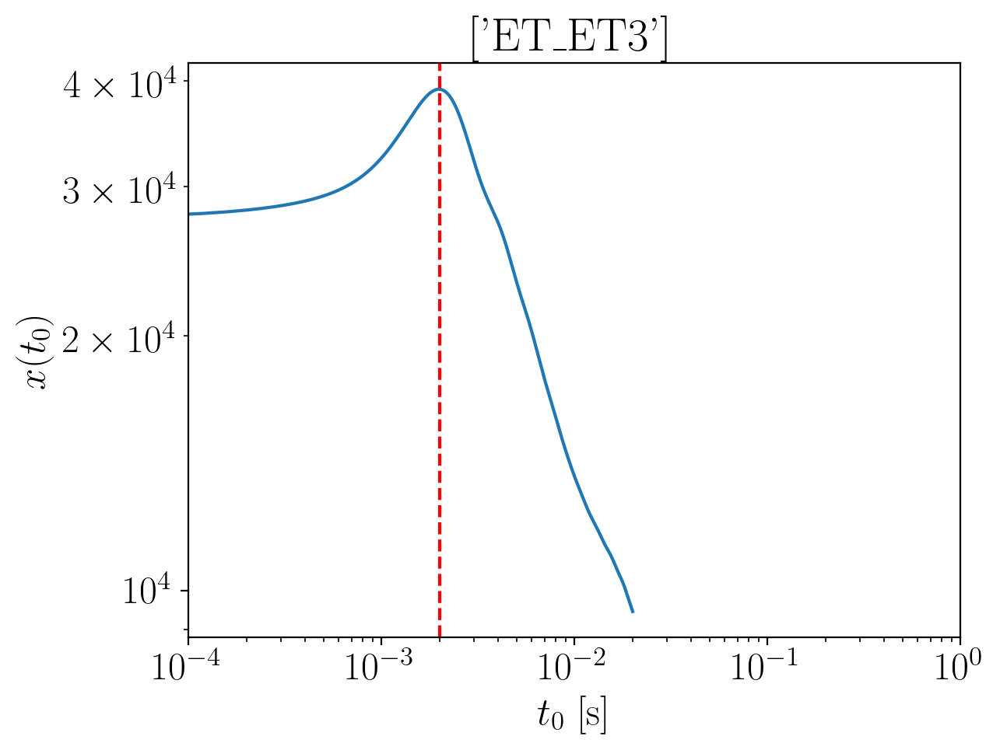

2024-01-15 16:36:10,564 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:10,578 - Network - INFO : PSDs loaded.
2024-01-15 16:36:10,596 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:10,630 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:10,650 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:10,679 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:10,679 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:36:10,684 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2313261010065775
Inner product:
0.9998123361664835


2024-01-15 16:36:16,150 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:36:16,195 - Network - INFO : PSDs loaded.
2024-01-15 16:36:16,215 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:16,265 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:16,266 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:36:16,267 - Network - INFO :    CE-40_C
2024-01-15 16:36:19,877 - Network - INFO :    CE-20_S
2024-01-15 16:36:23,534 - Network - INFO :    ET_ET1
2024-01-15 16:36:27,424 - Network - INFO :    ET_ET2
2024-01-15 16:36:31,031 - Network - INFO :    ET_ET3
2024-01-15 16:36:34,629 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:36:34,636 - Network - INFO : SNRs calculated.
2024-01-15 16:36:34,637 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:36:34,637 - Network - INFO :    CE-40_C
2024-01-15 16:36:34,731 - Network - INFO :

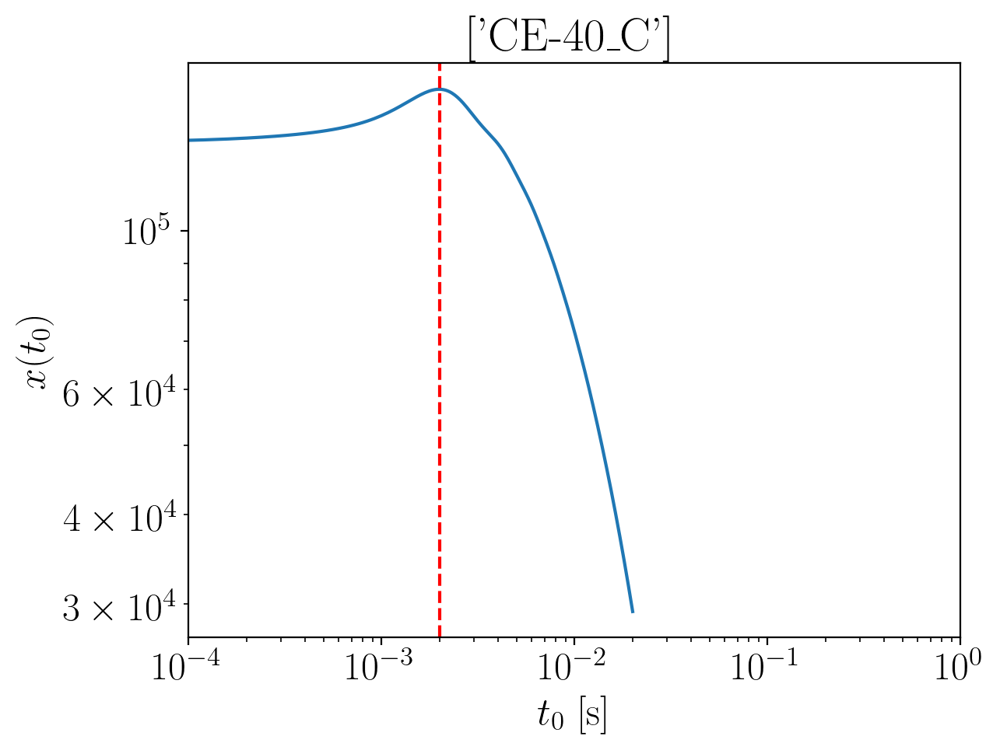

2024-01-15 16:36:36,461 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:36,467 - Network - INFO : PSDs loaded.
2024-01-15 16:36:36,469 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:36,476 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:36,483 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2131059959292148
Inner product:
0.9999236178172557


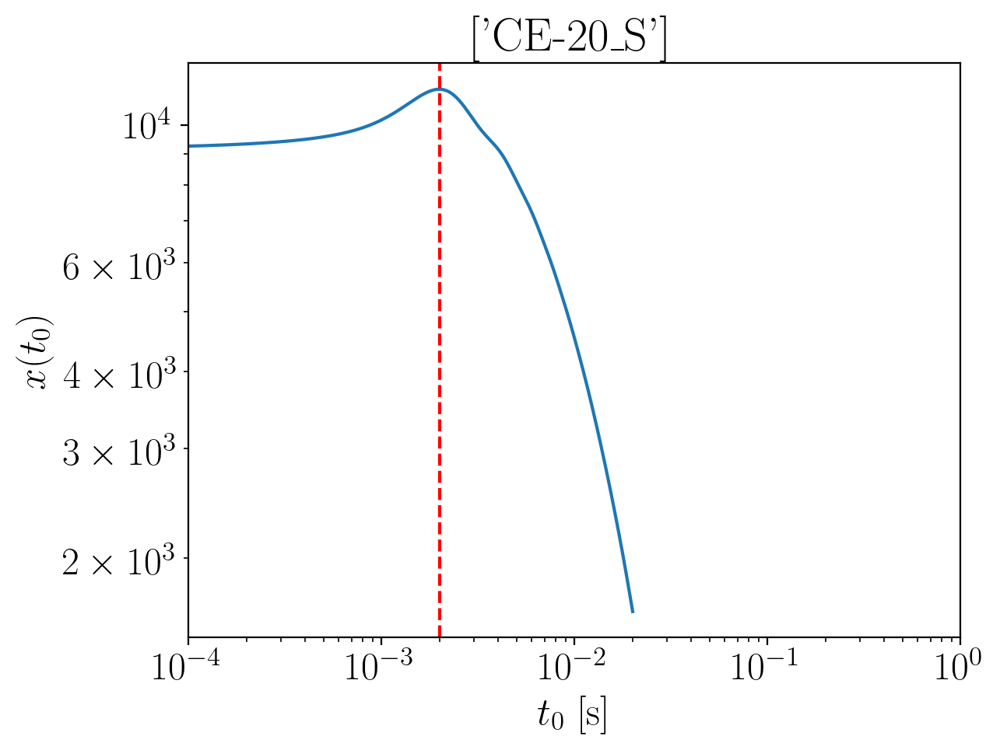

2024-01-15 16:36:37,793 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:37,800 - Network - INFO : PSDs loaded.
2024-01-15 16:36:37,801 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:37,808 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:37,815 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2119019220728835
Inner product:
0.9999153426244873


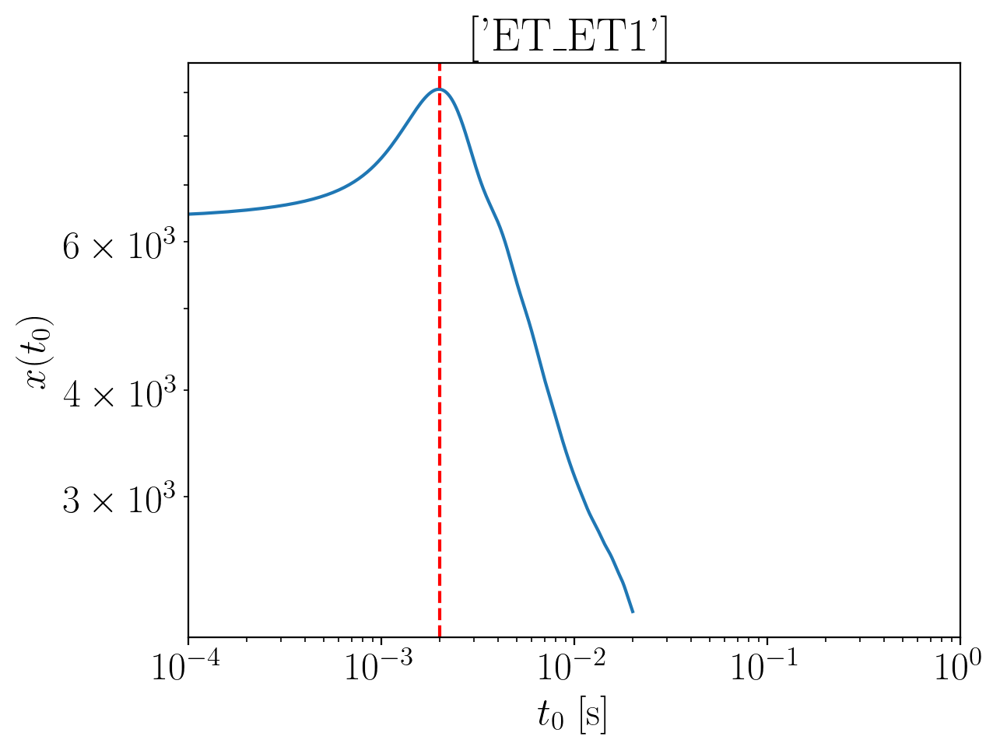

2024-01-15 16:36:39,171 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:39,184 - Network - INFO : PSDs loaded.
2024-01-15 16:36:39,186 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:39,194 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:39,238 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.222333089435015
Inner product:
0.9998123361664838


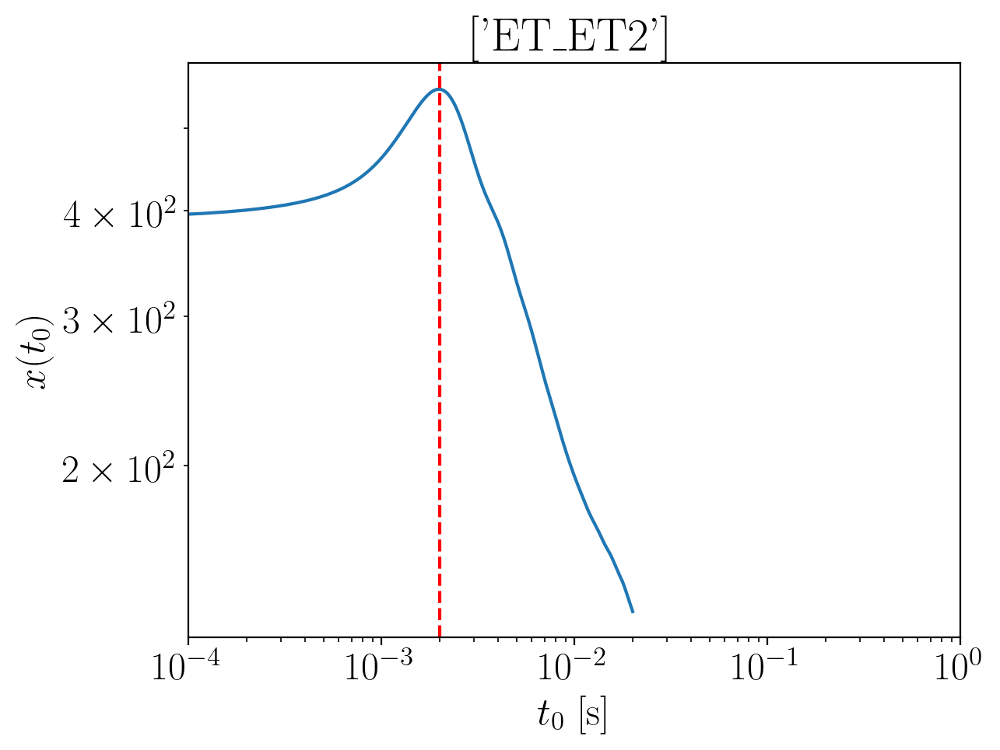

2024-01-15 16:36:40,611 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:40,624 - Network - INFO : PSDs loaded.
2024-01-15 16:36:40,626 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:40,632 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:40,639 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2223330894350153
Inner product:
0.9998123361664837


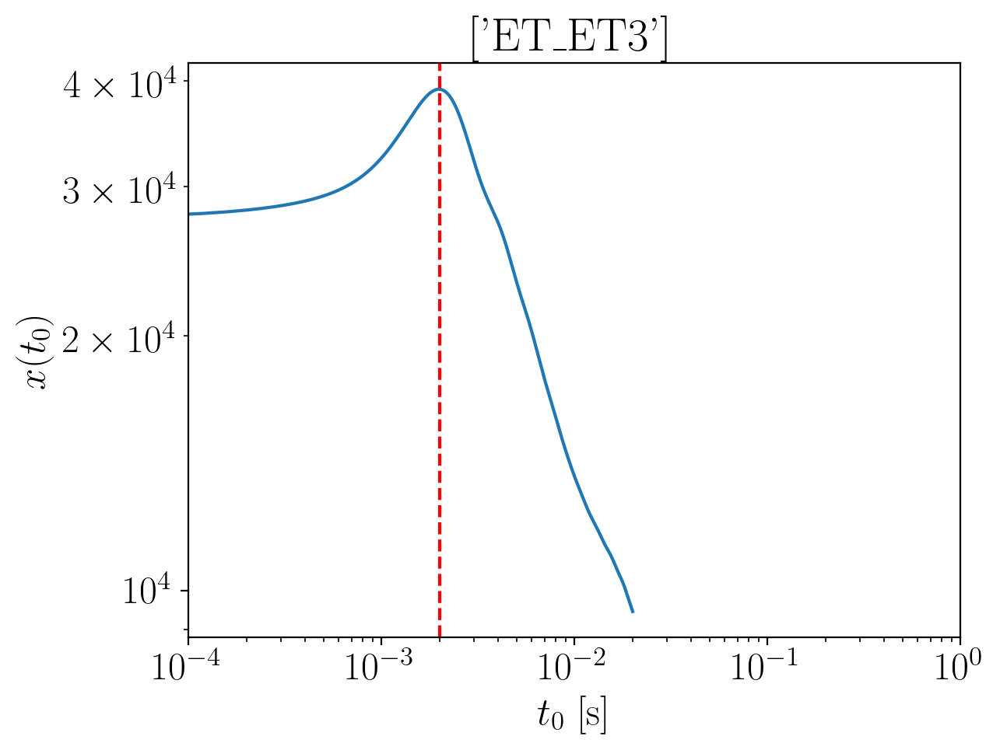

2024-01-15 16:36:42,162 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:42,176 - Network - INFO : PSDs loaded.
2024-01-15 16:36:42,178 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:42,185 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:42,192 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:42,216 - Network - INFO : Polarizations calculated.
2024-01-15 16:36:42,216 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:36:42,221 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.222333089435015
Inner product:
0.9998123361664834


2024-01-15 16:36:47,725 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:36:47,772 - Network - INFO : PSDs loaded.
2024-01-15 16:36:47,791 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:36:47,854 - Network - INFO : Detector responses calculated.
2024-01-15 16:36:47,855 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:36:47,856 - Network - INFO :    CE-40_C
2024-01-15 16:36:51,504 - Network - INFO :    CE-20_S
2024-01-15 16:36:55,118 - Network - INFO :    ET_ET1
2024-01-15 16:36:58,710 - Network - INFO :    ET_ET2
2024-01-15 16:37:02,318 - Network - INFO :    ET_ET3
2024-01-15 16:37:06,104 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:37:06,112 - Network - INFO : SNRs calculated.
2024-01-15 16:37:06,112 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:37:06,113 - Network - INFO :    CE-40_C
2024-01-15 16:37:06,206 - Network - INFO :

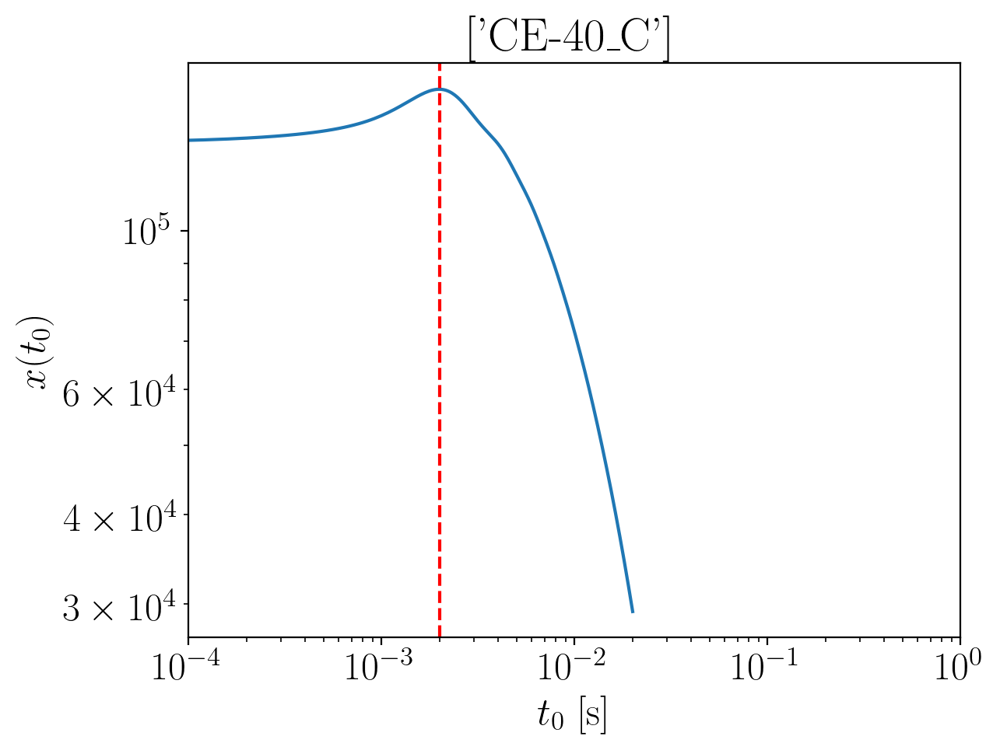

2024-01-15 16:37:07,933 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:07,941 - Network - INFO : PSDs loaded.
2024-01-15 16:37:07,943 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:07,950 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:07,957 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2511845921692477
Inner product:
0.9999236178172557


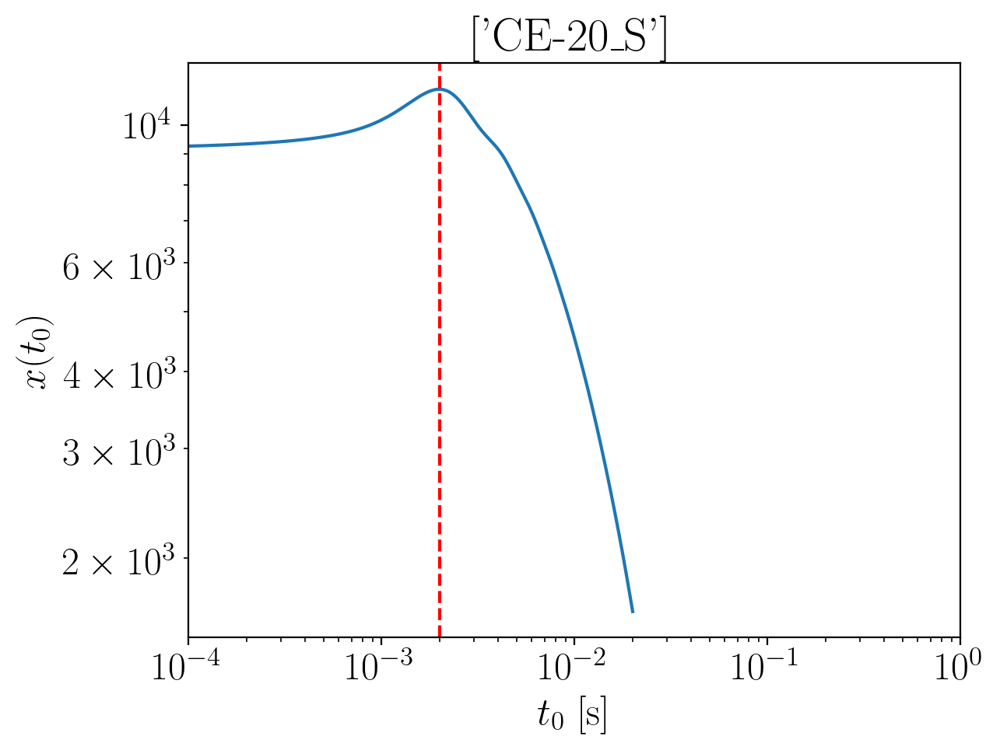

2024-01-15 16:37:09,147 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:09,154 - Network - INFO : PSDs loaded.
2024-01-15 16:37:09,156 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:09,163 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:09,170 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.249980518312916
Inner product:
0.9999153426244873


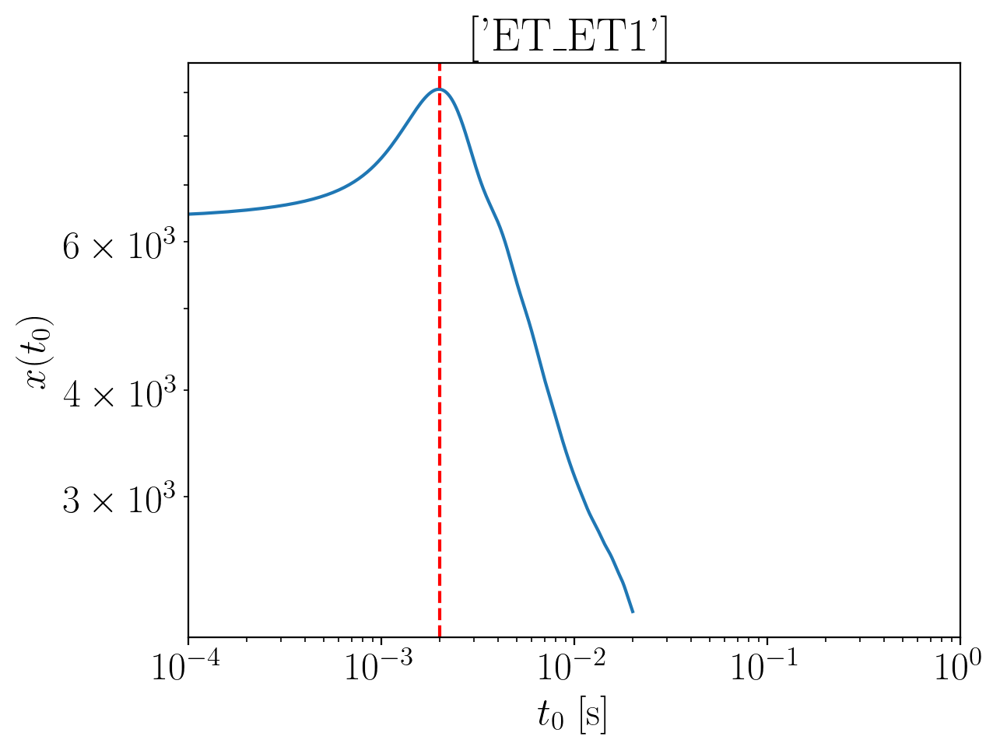

2024-01-15 16:37:10,512 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:10,525 - Network - INFO : PSDs loaded.
2024-01-15 16:37:10,527 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:10,534 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:10,541 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.999812336166484


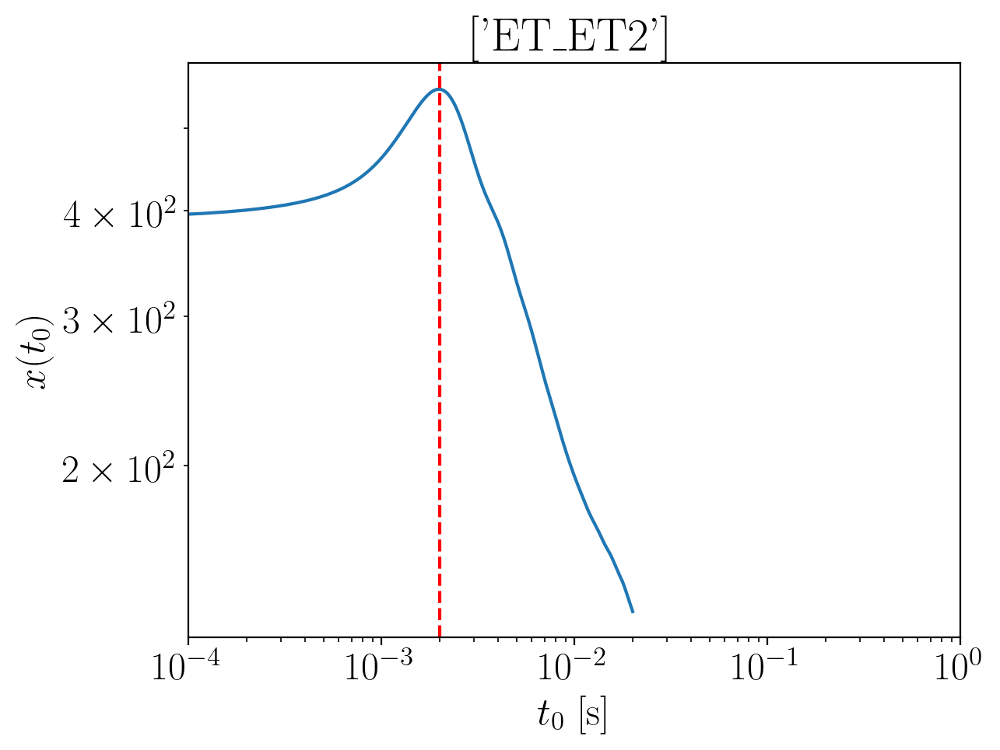

2024-01-15 16:37:12,101 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:12,114 - Network - INFO : PSDs loaded.
2024-01-15 16:37:12,116 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:12,123 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:12,131 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.9998123361664837


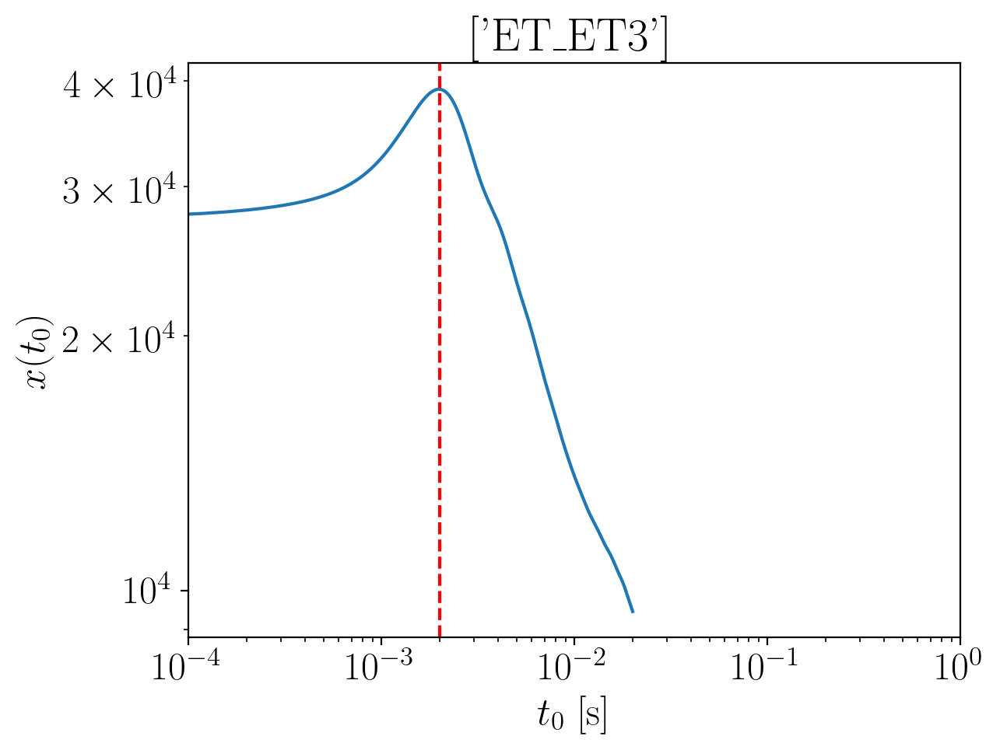

2024-01-15 16:37:13,693 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:13,706 - Network - INFO : PSDs loaded.
2024-01-15 16:37:13,708 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:13,715 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:13,722 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:13,745 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:13,745 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:37:13,750 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.9998123361664836


2024-01-15 16:37:19,420 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:37:19,470 - Network - INFO : PSDs loaded.
2024-01-15 16:37:19,492 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:19,535 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:19,536 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:37:19,537 - Network - INFO :    CE-40_C
2024-01-15 16:37:23,216 - Network - INFO :    CE-20_S
2024-01-15 16:37:26,829 - Network - INFO :    ET_ET1
2024-01-15 16:37:30,451 - Network - INFO :    ET_ET2
2024-01-15 16:37:34,066 - Network - INFO :    ET_ET3
2024-01-15 16:37:37,699 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:37:37,706 - Network - INFO : SNRs calculated.
2024-01-15 16:37:37,707 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:37:37,707 - Network - INFO :    CE-40_C
2024-01-15 16:37:37,801 - Network - INFO :

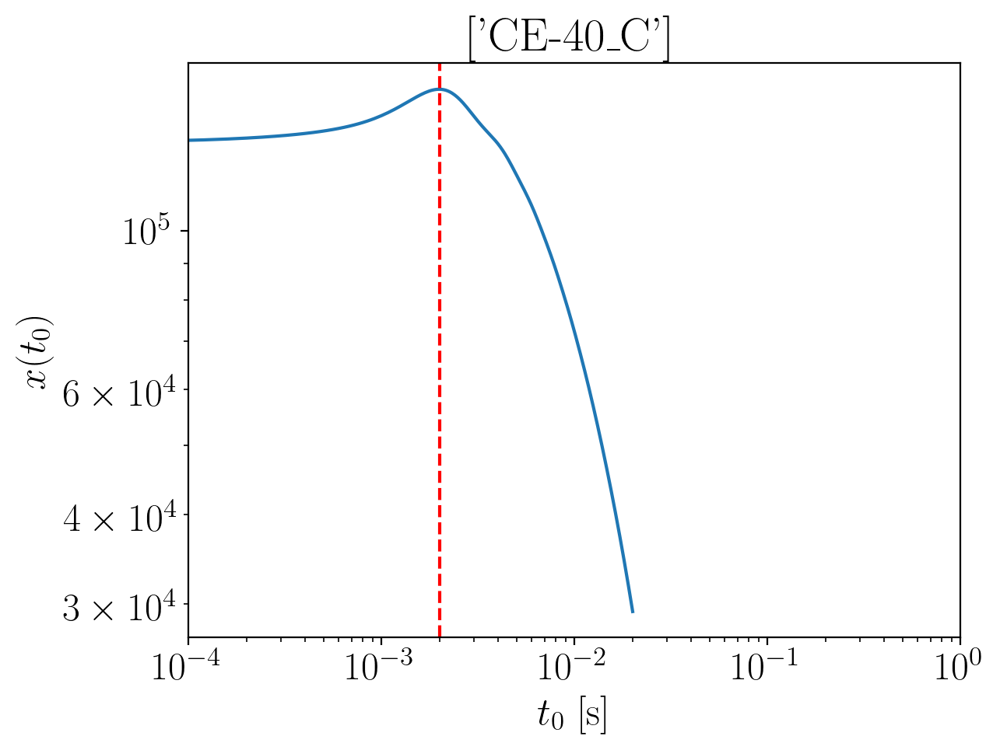

2024-01-15 16:37:39,531 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:39,537 - Network - INFO : PSDs loaded.
2024-01-15 16:37:39,539 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:39,547 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:39,554 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2552003583535853
Inner product:
0.9999236178172561


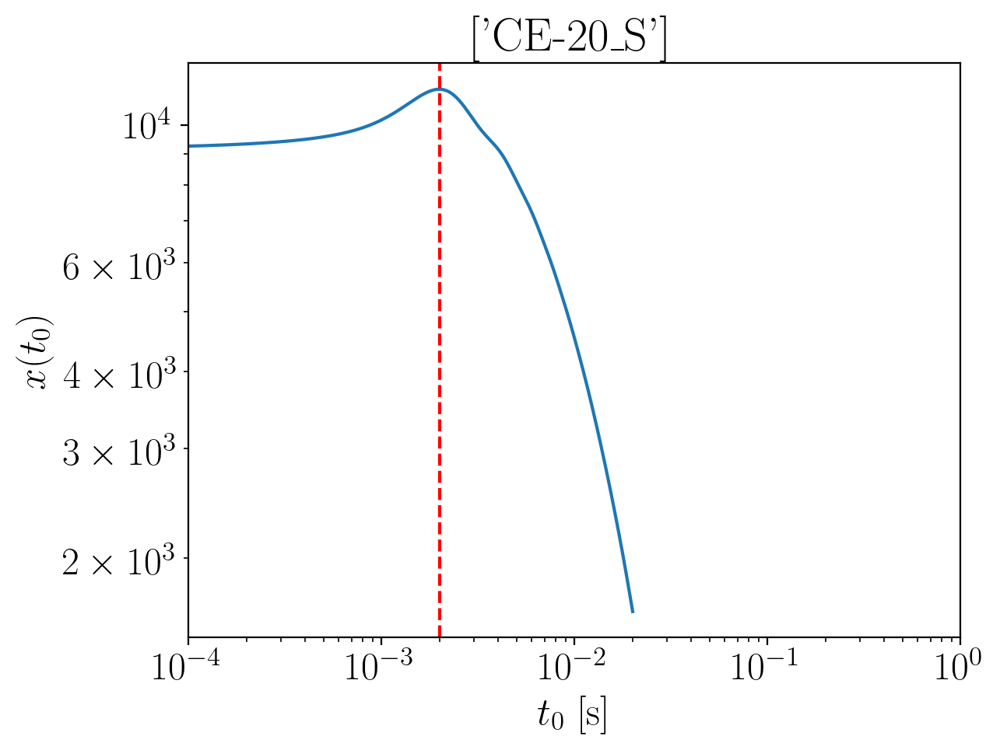

2024-01-15 16:37:40,811 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:40,821 - Network - INFO : PSDs loaded.
2024-01-15 16:37:40,824 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:40,833 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:40,840 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2539962844972523
Inner product:
0.9999153426244878


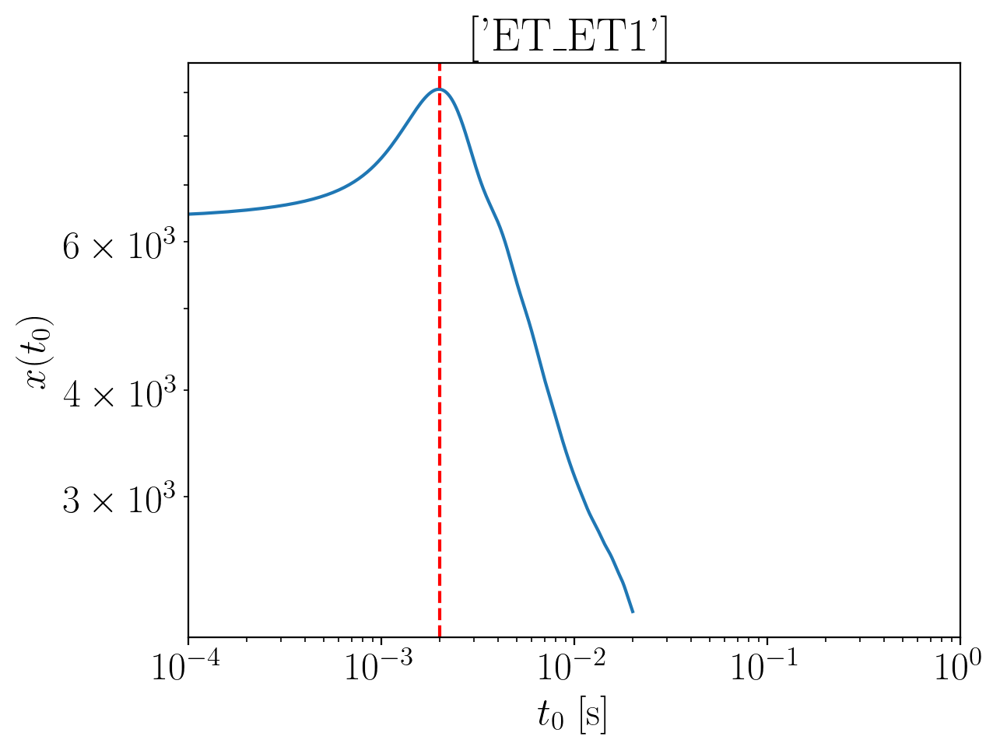

2024-01-15 16:37:42,248 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:42,261 - Network - INFO : PSDs loaded.
2024-01-15 16:37:42,263 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:42,269 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:42,276 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2644274518594503
Inner product:
0.9998123361664809


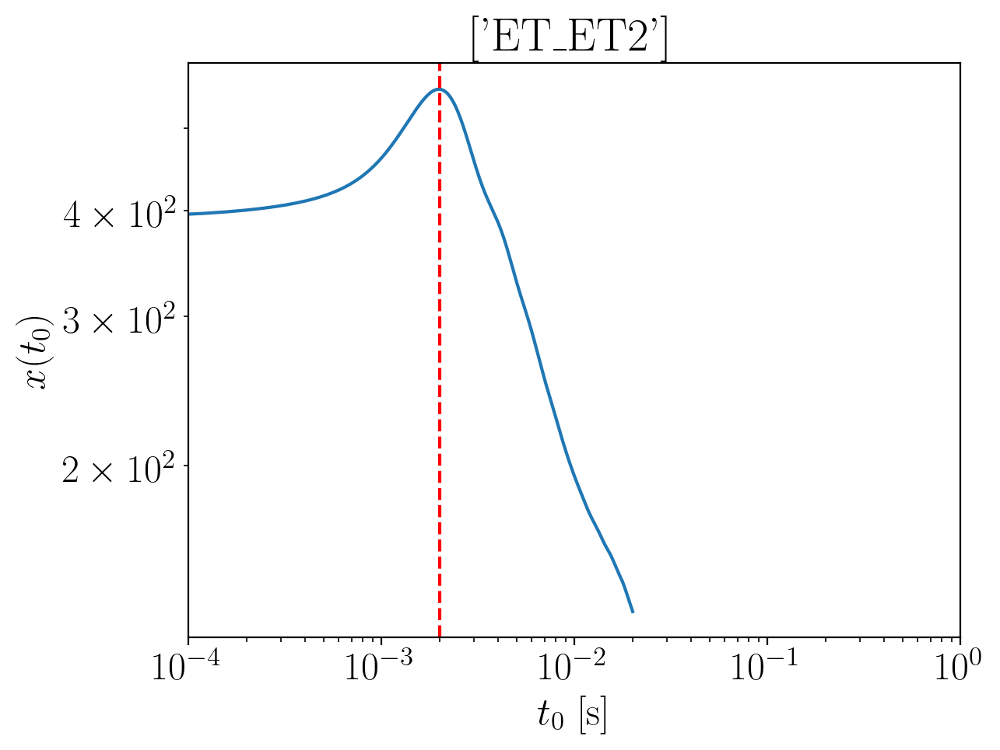

2024-01-15 16:37:43,687 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:43,701 - Network - INFO : PSDs loaded.
2024-01-15 16:37:43,703 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:43,710 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:43,717 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2644274518594503
Inner product:
0.9998123361664807


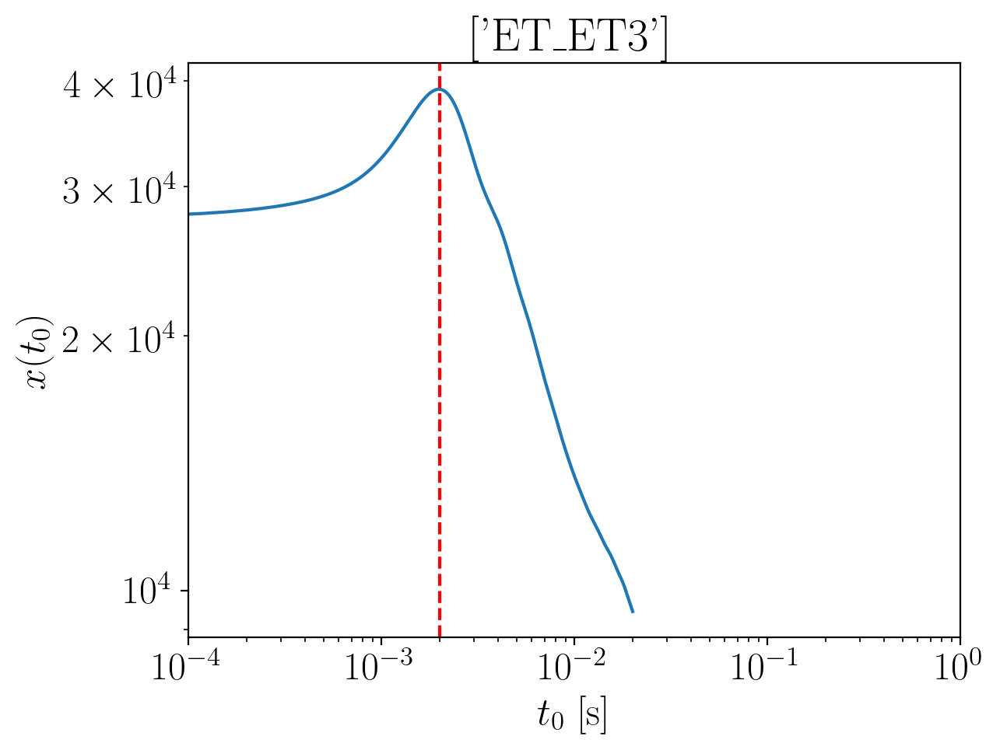

2024-01-15 16:37:45,138 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:45,152 - Network - INFO : PSDs loaded.
2024-01-15 16:37:45,155 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:45,162 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:45,169 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:45,192 - Network - INFO : Polarizations calculated.
2024-01-15 16:37:45,193 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:37:45,198 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2644274518594503
Inner product:
0.9998123361664807


2024-01-15 16:37:50,726 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:37:50,948 - Network - INFO : PSDs loaded.
2024-01-15 16:37:50,955 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:37:50,976 - Network - INFO : Detector responses calculated.
2024-01-15 16:37:50,977 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:37:50,977 - Network - INFO :    CE-40_C
2024-01-15 16:37:54,675 - Network - INFO :    CE-20_S
2024-01-15 16:37:58,667 - Network - INFO :    ET_ET1
2024-01-15 16:38:05,166 - Network - INFO :    ET_ET2
2024-01-15 16:38:09,779 - Network - INFO :    ET_ET3
2024-01-15 16:38:13,504 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:38:13,513 - Network - INFO : SNRs calculated.
2024-01-15 16:38:13,513 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:38:13,514 - Network - INFO :    CE-40_C
2024-01-15 16:38:13,609 - Network - INFO :

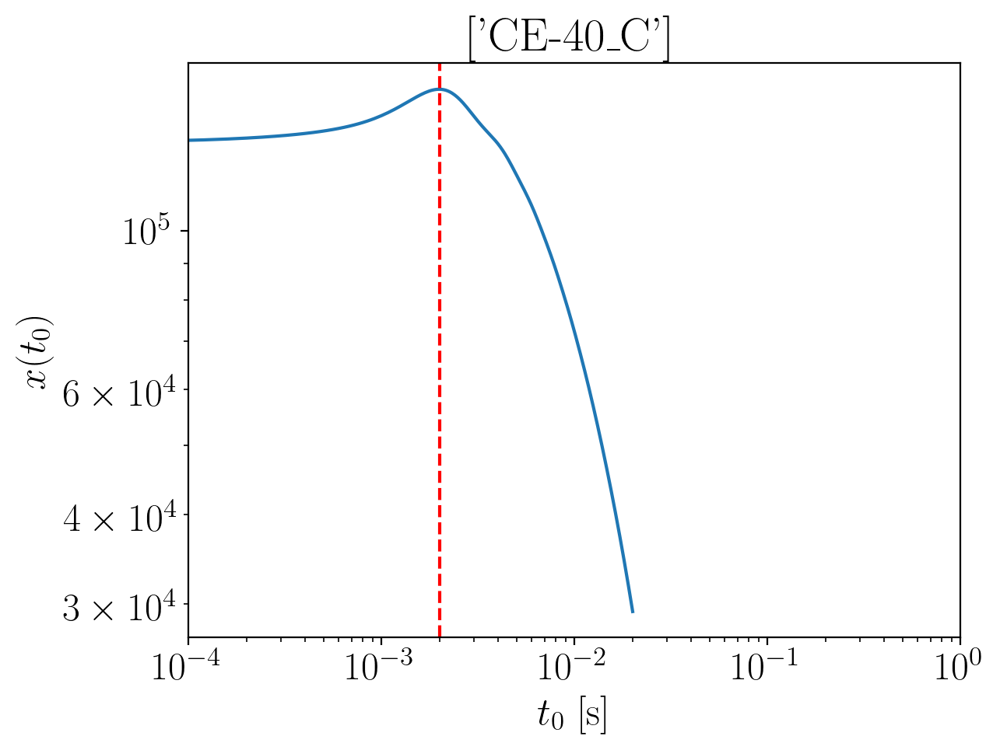

2024-01-15 16:38:15,494 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:15,502 - Network - INFO : PSDs loaded.
2024-01-15 16:38:15,505 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:15,512 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:15,521 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2595561735927685
Inner product:
0.9999236178172556


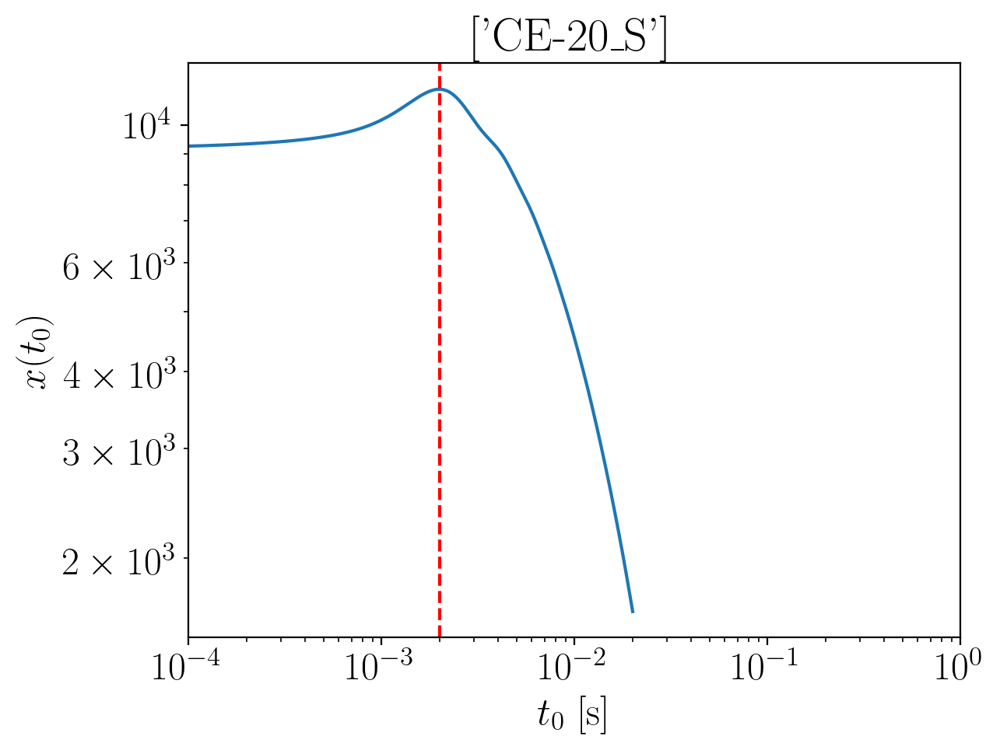

2024-01-15 16:38:17,225 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:17,232 - Network - INFO : PSDs loaded.
2024-01-15 16:38:17,234 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:17,242 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:17,250 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2583520997364386
Inner product:
0.9999153426244872


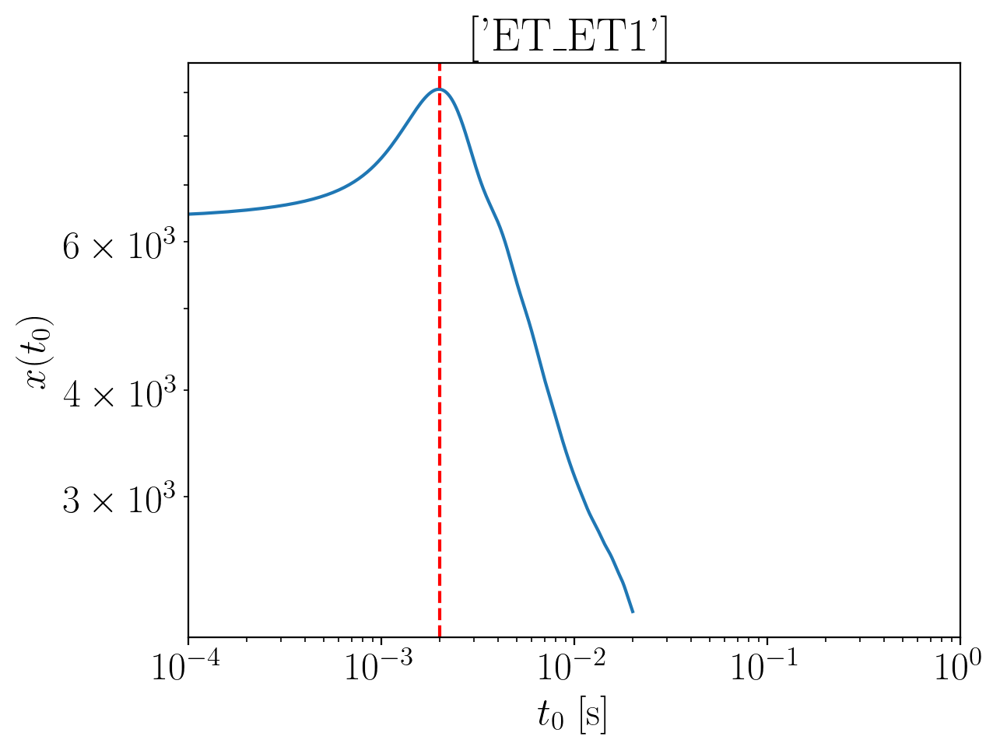

2024-01-15 16:38:19,771 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:19,798 - Network - INFO : PSDs loaded.
2024-01-15 16:38:19,802 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:19,831 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:19,842 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2687832670985455
Inner product:
0.9998123361664845


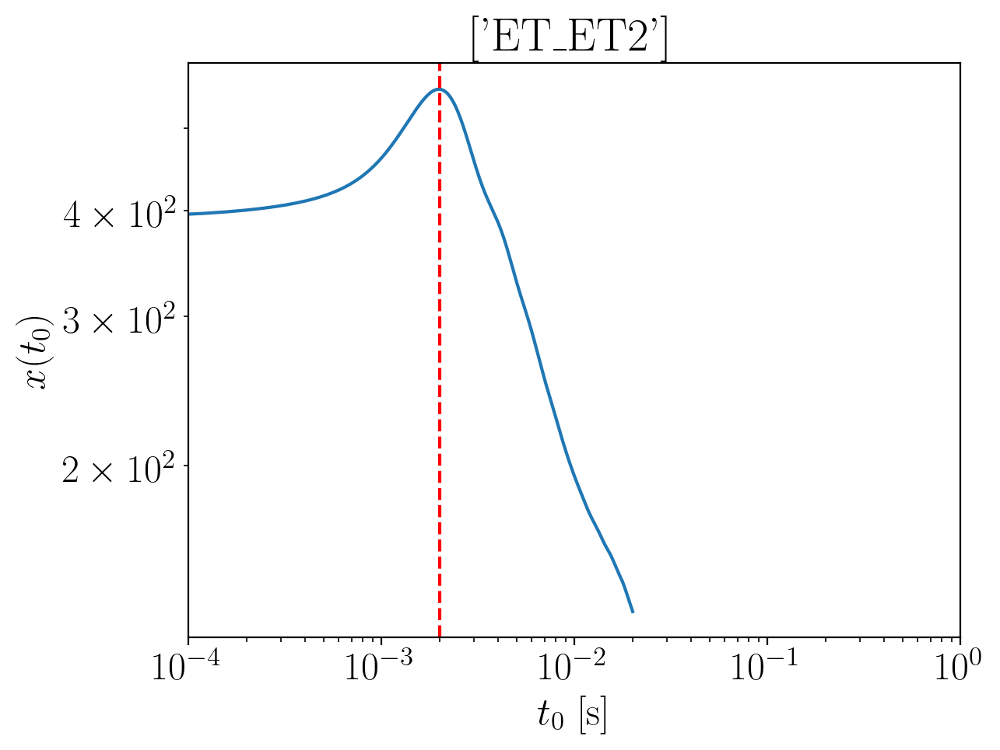

2024-01-15 16:38:22,136 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:22,152 - Network - INFO : PSDs loaded.
2024-01-15 16:38:22,154 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:22,162 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:22,170 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2687832670985455
Inner product:
0.9998123361664845


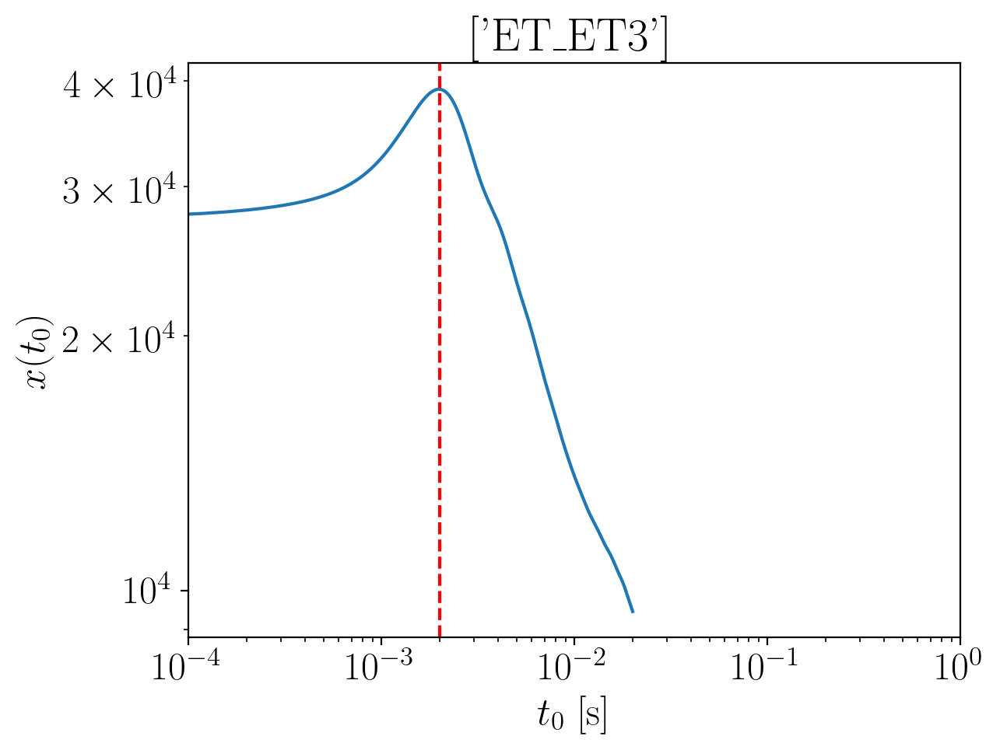

2024-01-15 16:38:24,213 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:24,236 - Network - INFO : PSDs loaded.
2024-01-15 16:38:24,240 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:24,251 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:24,259 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:24,390 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:24,391 - Network - INFO : Calculate numeric derivatives of polarizations.


time shift: 0.002
phase shift: -2.2687832670985455
Inner product:
0.9998123361664845


2024-01-15 16:38:24,433 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:30,509 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:38:30,554 - Network - INFO : PSDs loaded.
2024-01-15 16:38:30,559 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:30,577 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:30,578 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:38:30,579 - Network - INFO :    CE-40_C
2024-01-15 16:38:34,295 - Network - INFO :    CE-20_S
2024-01-15 16:38:38,027 - Network - INFO :    ET_ET1
2024-01-15 16:38:42,621 - Network - INFO :    ET_ET2
2024-01-15 16:38:47,744 - Network - INFO :    ET_ET3
2024-01-15 16:38:52,163 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:38:52,171 - Network - INFO : SNRs calculated.
2024-01-15 16:38:52,171 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:38:52,171 - N

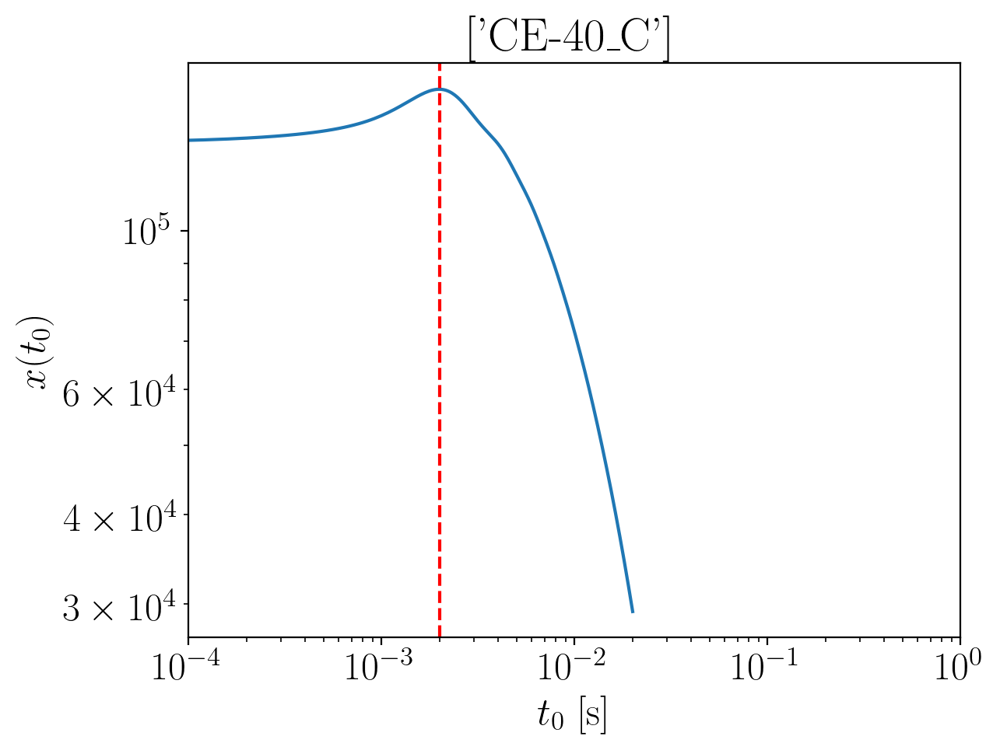

2024-01-15 16:38:54,503 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:54,511 - Network - INFO : PSDs loaded.
2024-01-15 16:38:54,513 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:54,522 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:54,531 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.259264397497123
Inner product:
0.9999236178172557


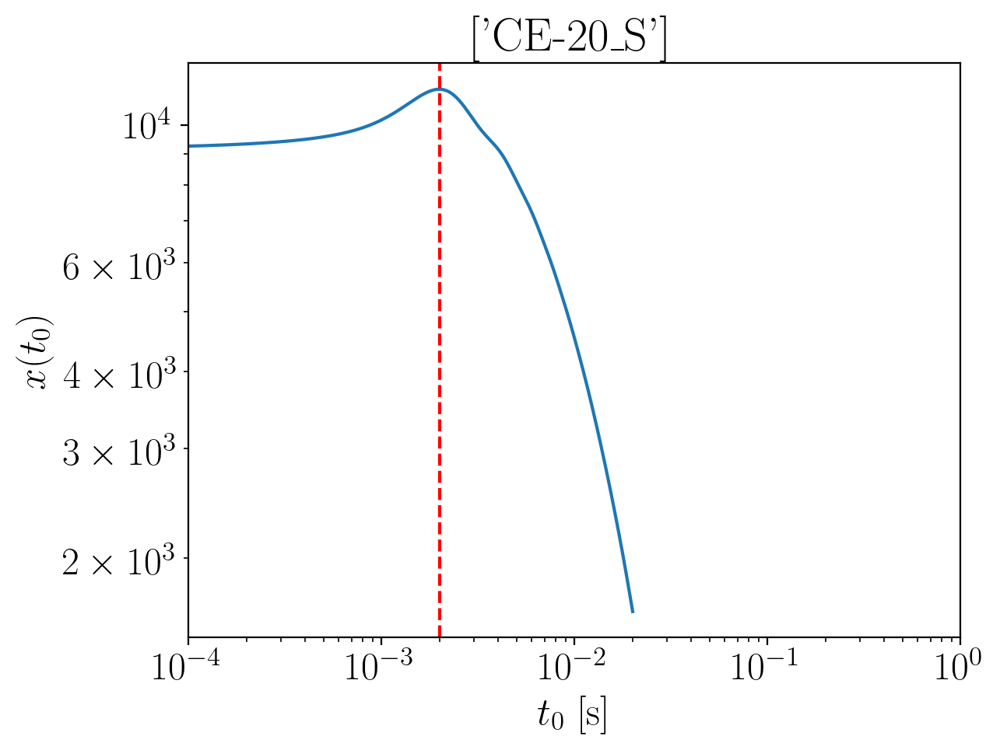

2024-01-15 16:38:57,157 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:57,170 - Network - INFO : PSDs loaded.
2024-01-15 16:38:57,174 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:57,190 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:57,205 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2580603236407892
Inner product:
0.9999153426244871


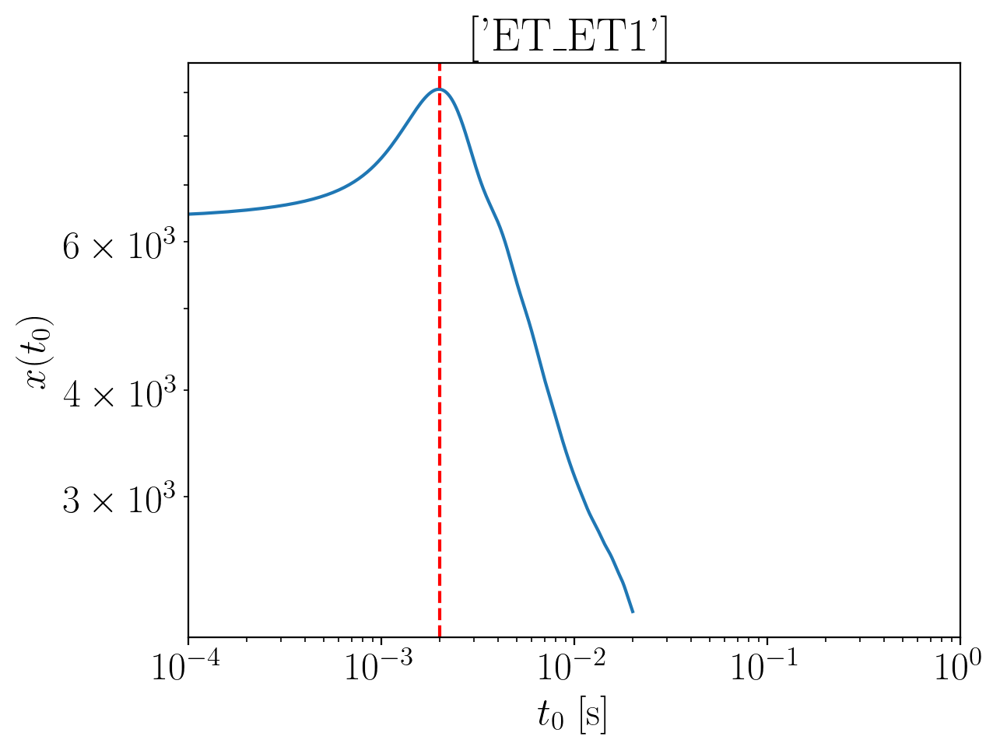

2024-01-15 16:38:59,803 - Network - INFO : Polarizations calculated.
2024-01-15 16:38:59,819 - Network - INFO : PSDs loaded.
2024-01-15 16:38:59,822 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:38:59,830 - Network - INFO : Detector responses calculated.
2024-01-15 16:38:59,872 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2684914910029677
Inner product:
0.9998123361664829


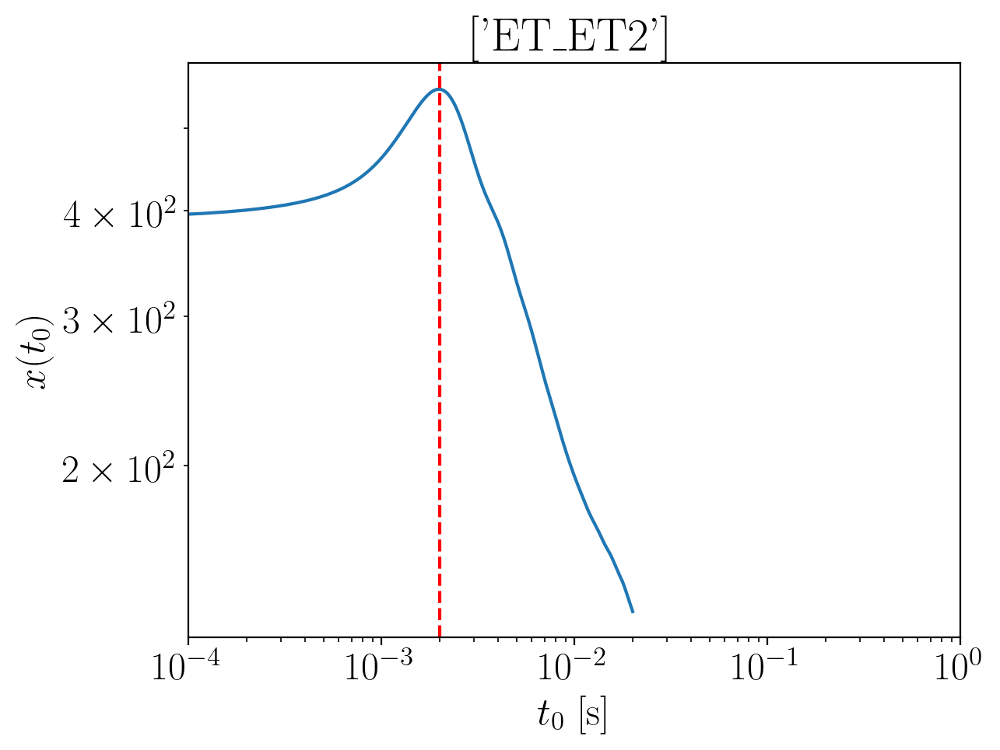

2024-01-15 16:39:02,242 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:02,258 - Network - INFO : PSDs loaded.
2024-01-15 16:39:02,260 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:02,270 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:02,322 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.268491491002967
Inner product:
0.9998123361664828


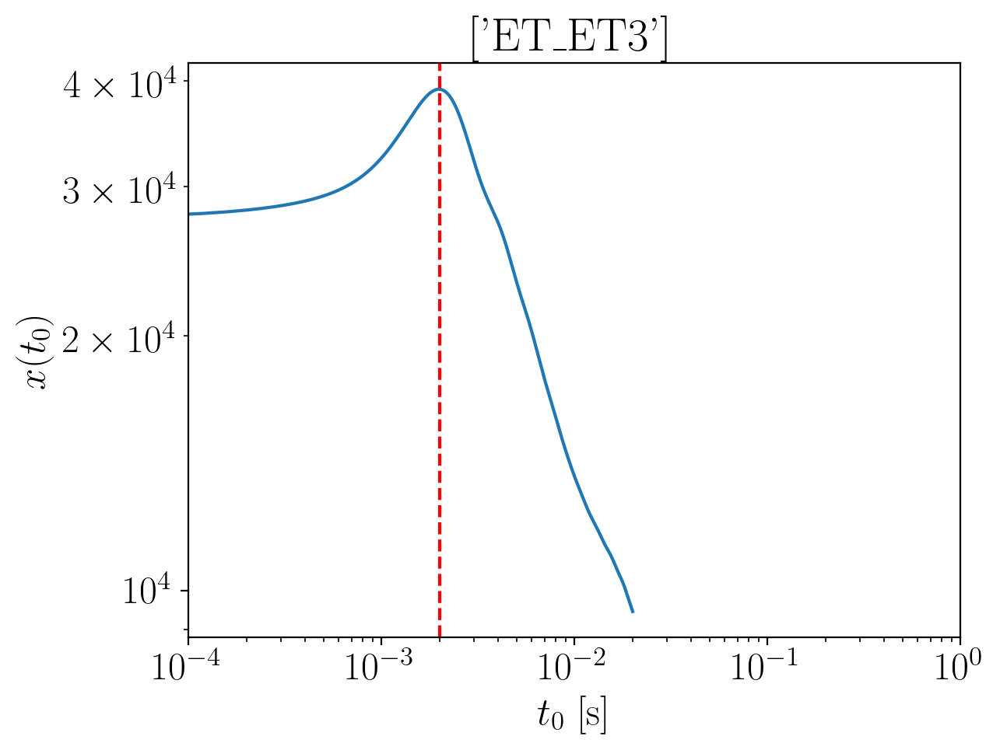

2024-01-15 16:39:04,510 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:04,530 - Network - INFO : PSDs loaded.
2024-01-15 16:39:04,534 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:04,585 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:04,689 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.268491491002967
Inner product:
0.9998123361664831


2024-01-15 16:39:04,750 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:04,752 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:39:04,759 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:11,217 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:39:11,262 - Network - INFO : PSDs loaded.
2024-01-15 16:39:11,267 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:11,293 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:11,294 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:39:11,295 - Network - INFO :    CE-40_C
2024-01-15 16:39:15,025 - Network - INFO :    CE-20_S
2024-01-15 16:39:19,650 - Network - INFO :    ET_ET1
2024-01-15 16:39:24,472 - Network - INFO :    ET_ET2
2024-01-15 16:39:28,604 - Network - INFO :    ET_ET3
2024-01-15 16:39:32,553 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

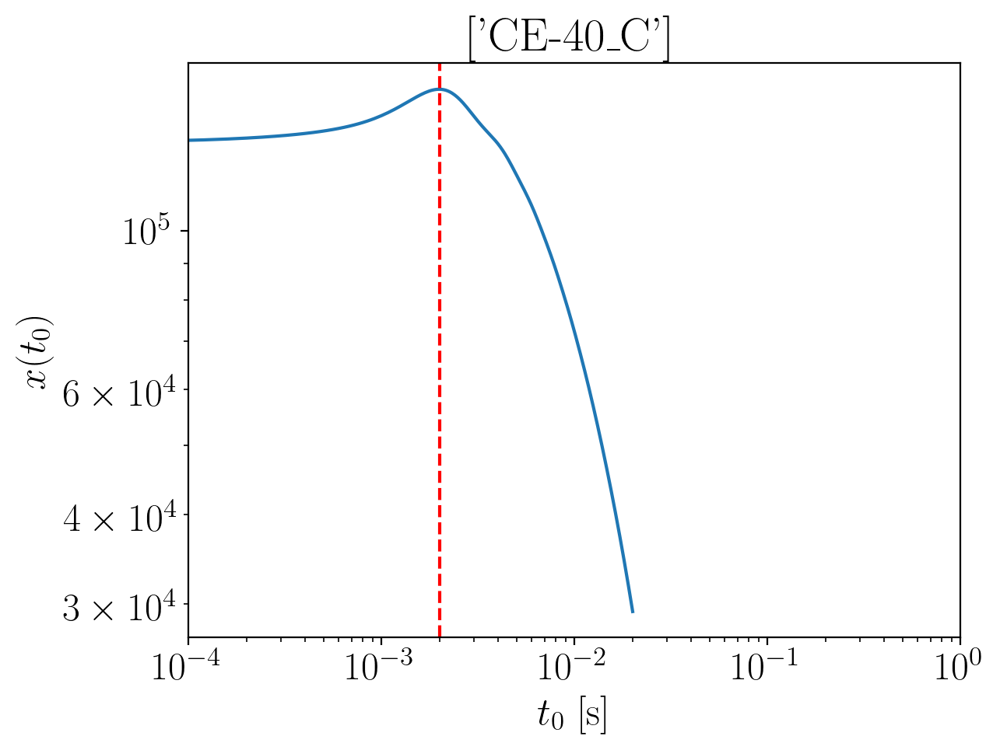

2024-01-15 16:39:34,654 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:34,663 - Network - INFO : PSDs loaded.
2024-01-15 16:39:34,666 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:34,675 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:34,685 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2562938520732407
Inner product:
0.9999236178172557


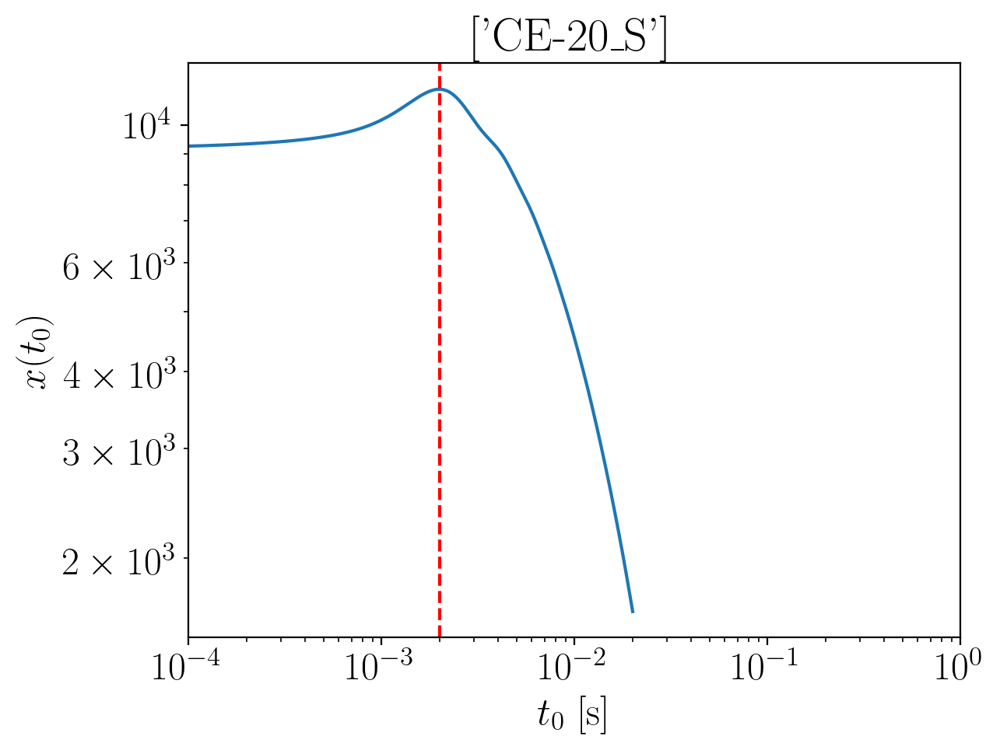

2024-01-15 16:39:37,701 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:37,716 - Network - INFO : PSDs loaded.
2024-01-15 16:39:37,720 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:37,735 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:37,754 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2550897782169095
Inner product:
0.9999153426244873


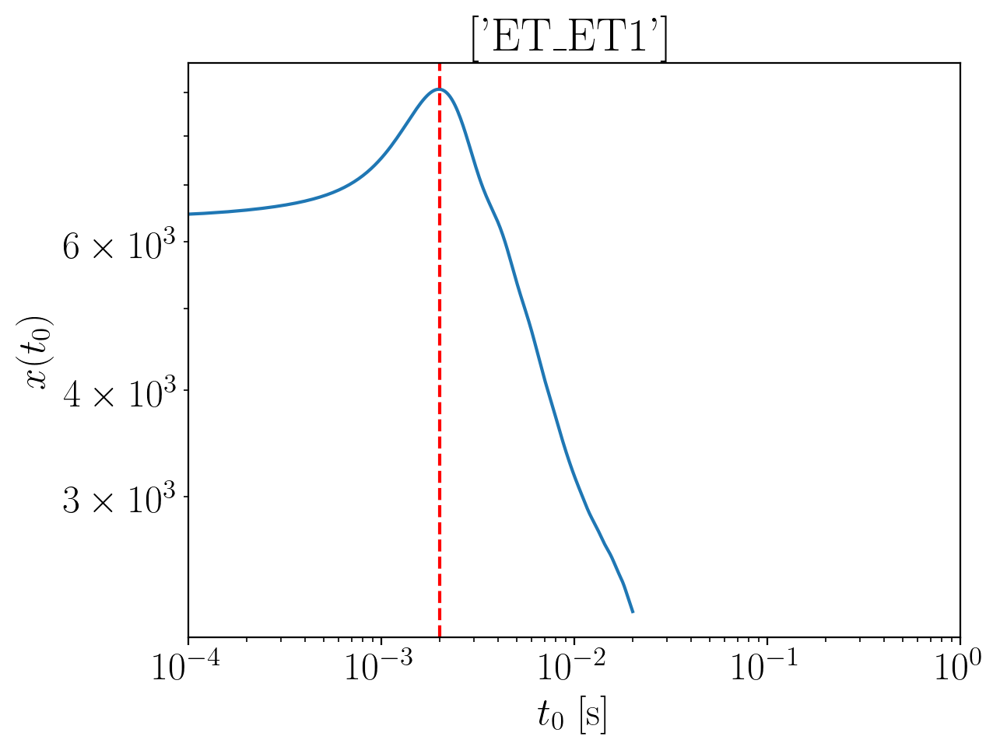

2024-01-15 16:39:40,800 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:40,820 - Network - INFO : PSDs loaded.
2024-01-15 16:39:40,823 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:40,857 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:40,927 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.265520945579034
Inner product:
0.999812336166484


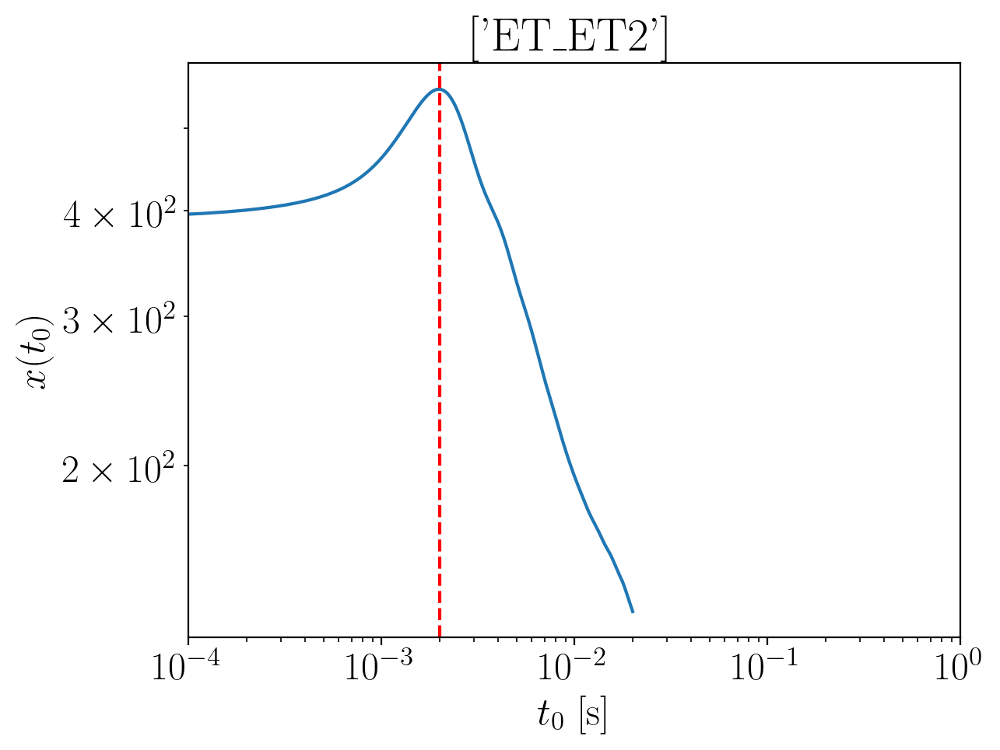

2024-01-15 16:39:43,479 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.265520945579034


2024-01-15 16:39:43,713 - Network - INFO : PSDs loaded.
2024-01-15 16:39:43,716 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:43,724 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:43,732 - Network - INFO : Polarizations calculated.


Inner product:
0.9998123361664839


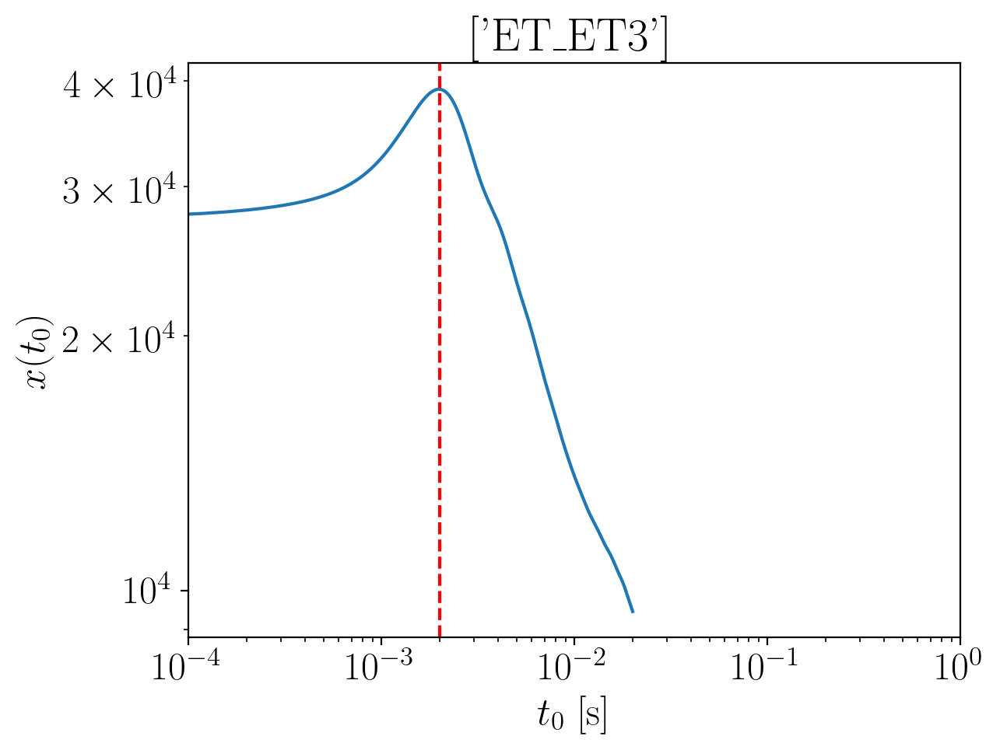

2024-01-15 16:39:45,856 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:45,871 - Network - INFO : PSDs loaded.
2024-01-15 16:39:45,874 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:45,882 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:45,908 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.265520945579034
Inner product:
0.9998123361664837


2024-01-15 16:39:46,111 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:46,112 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:39:46,140 - Network - INFO : Polarizations calculated.
2024-01-15 16:39:52,853 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:39:52,935 - Network - INFO : PSDs loaded.
2024-01-15 16:39:52,944 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:39:52,983 - Network - INFO : Detector responses calculated.
2024-01-15 16:39:52,984 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:39:52,985 - Network - INFO :    CE-40_C
2024-01-15 16:39:58,722 - Network - INFO :    CE-20_S
2024-01-15 16:40:03,106 - Network - INFO :    ET_ET1
2024-01-15 16:40:06,772 - Network - INFO :    ET_ET2
2024-01-15 16:40:10,377 - Network - INFO :    ET_ET3
2024-01-15 16:40:14,060 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

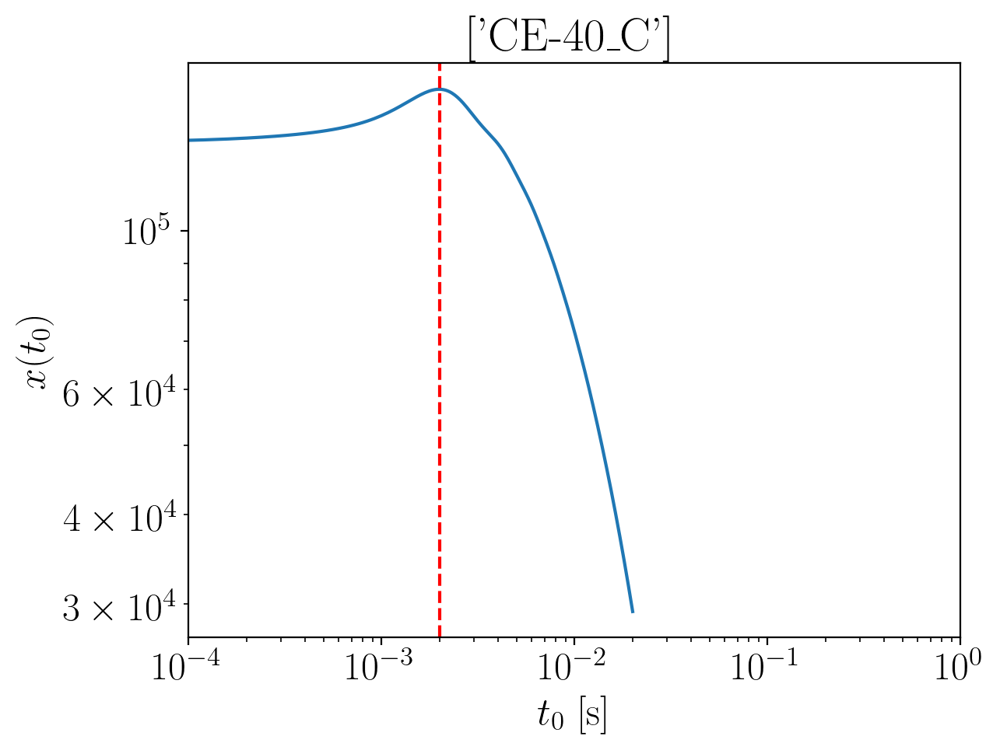

2024-01-15 16:40:15,926 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:15,932 - Network - INFO : PSDs loaded.
2024-01-15 16:40:15,934 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:15,942 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:15,949 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.251529442642667
Inner product:
0.9999236178172557


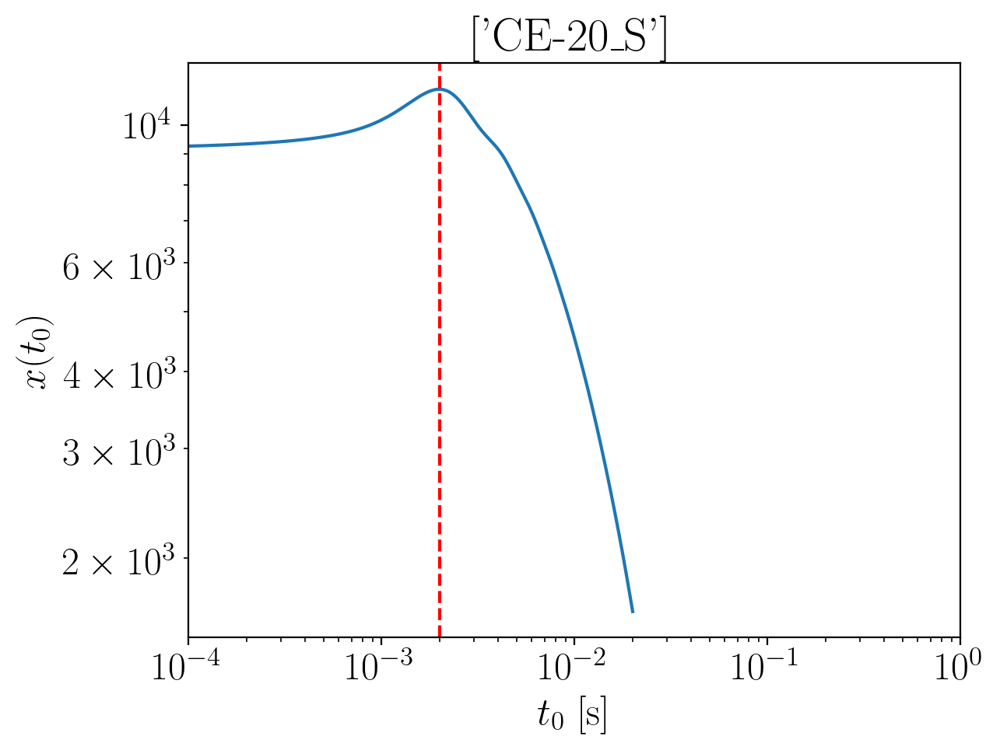

2024-01-15 16:40:17,220 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:17,227 - Network - INFO : PSDs loaded.
2024-01-15 16:40:17,229 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:17,235 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:17,243 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.250325368786336
Inner product:
0.9999153426244873


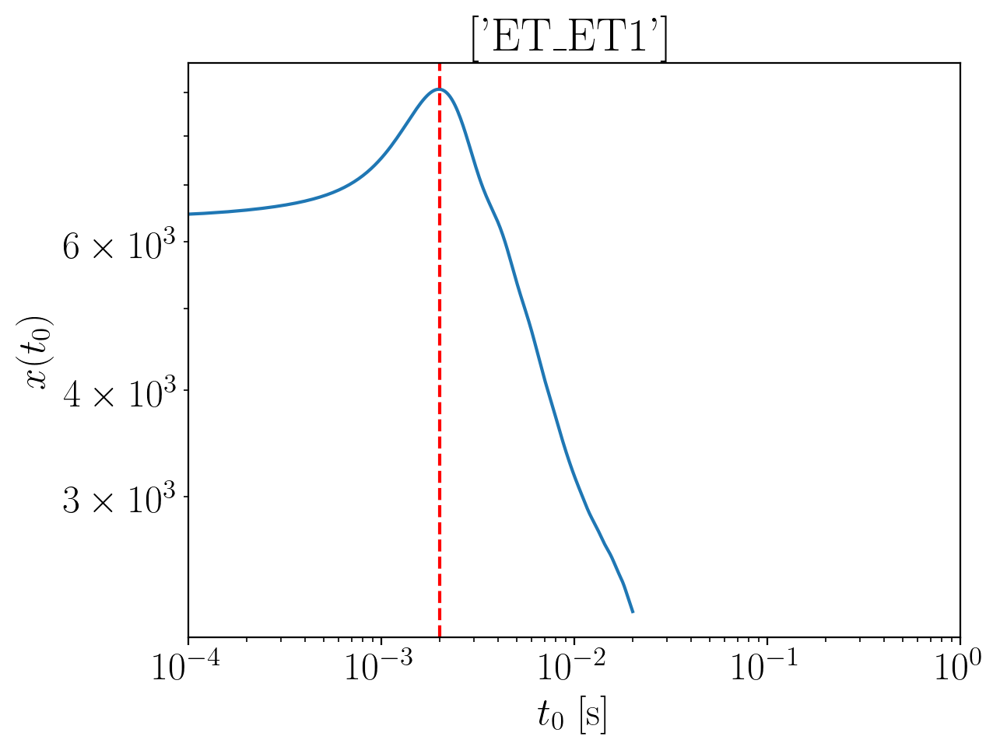

2024-01-15 16:40:18,668 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:18,682 - Network - INFO : PSDs loaded.
2024-01-15 16:40:18,684 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:18,691 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:18,698 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.999812336166484


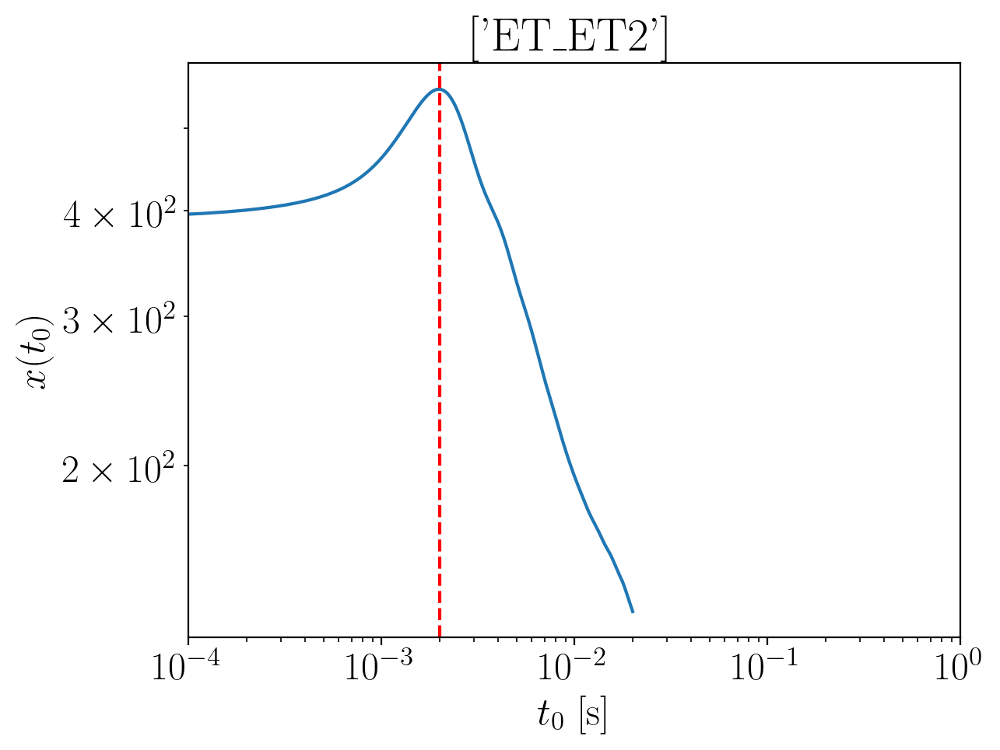

2024-01-15 16:40:20,125 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:20,138 - Network - INFO : PSDs loaded.
2024-01-15 16:40:20,140 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:20,147 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:20,154 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.9998123361664837


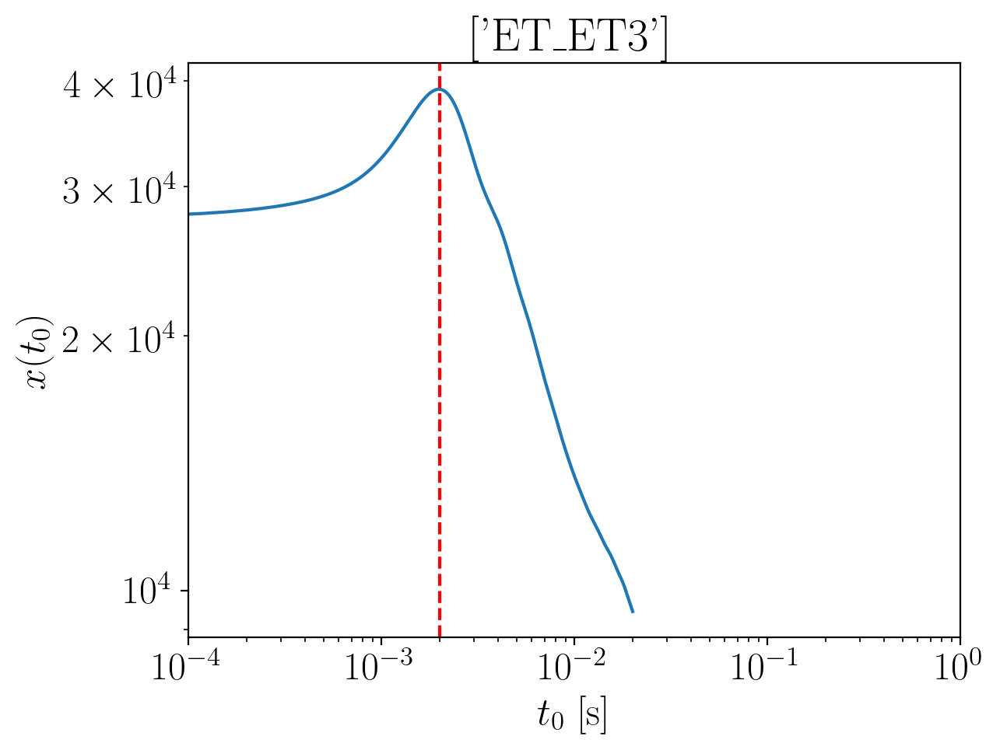

2024-01-15 16:40:21,690 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:21,704 - Network - INFO : PSDs loaded.
2024-01-15 16:40:21,706 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:21,713 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:21,720 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:21,744 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:21,745 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:40:21,750 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2607565361484547
Inner product:
0.9998123361664836


2024-01-15 16:40:27,826 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:40:27,873 - Network - INFO : PSDs loaded.
2024-01-15 16:40:27,903 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:27,942 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:27,943 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:40:27,943 - Network - INFO :    CE-40_C
2024-01-15 16:40:31,910 - Network - INFO :    CE-20_S
2024-01-15 16:40:36,383 - Network - INFO :    ET_ET1
2024-01-15 16:40:40,055 - Network - INFO :    ET_ET2
2024-01-15 16:40:43,766 - Network - INFO :    ET_ET3
2024-01-15 16:40:49,764 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:40:49,774 - Network - INFO : SNRs calculated.
2024-01-15 16:40:49,775 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:40:49,775 - Network - INFO :    CE-40_C
2024-01-15 16:40:49,870 - Network - INFO :

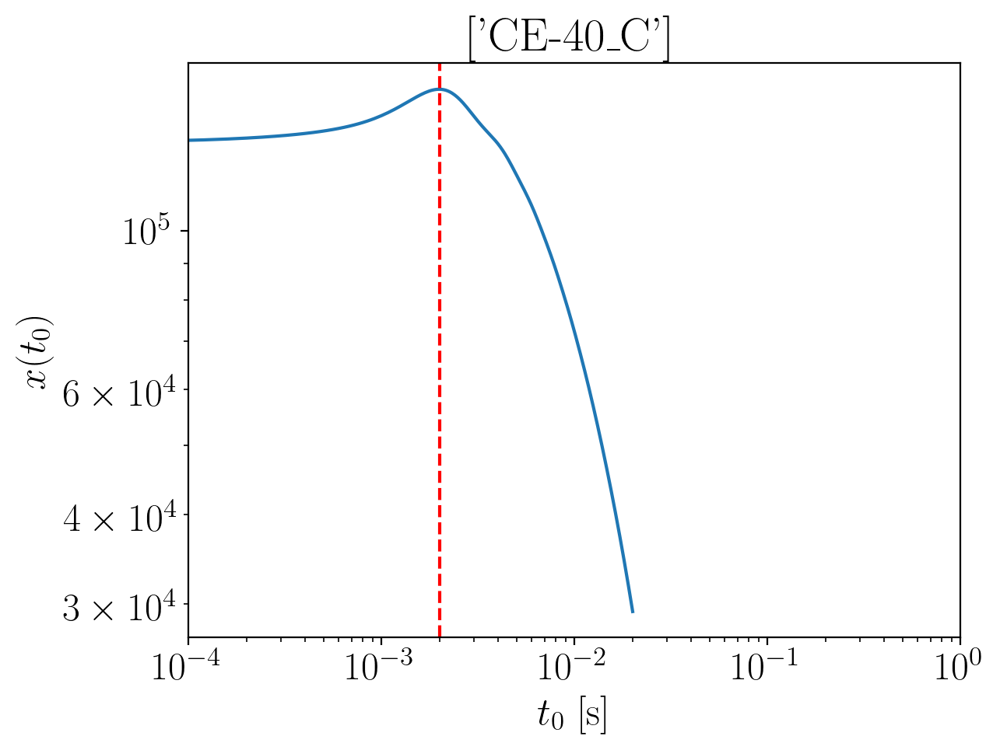

2024-01-15 16:40:52,630 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:52,638 - Network - INFO : PSDs loaded.
2024-01-15 16:40:52,641 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:52,651 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:52,661 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2454644494743685
Inner product:
0.9999236178172556


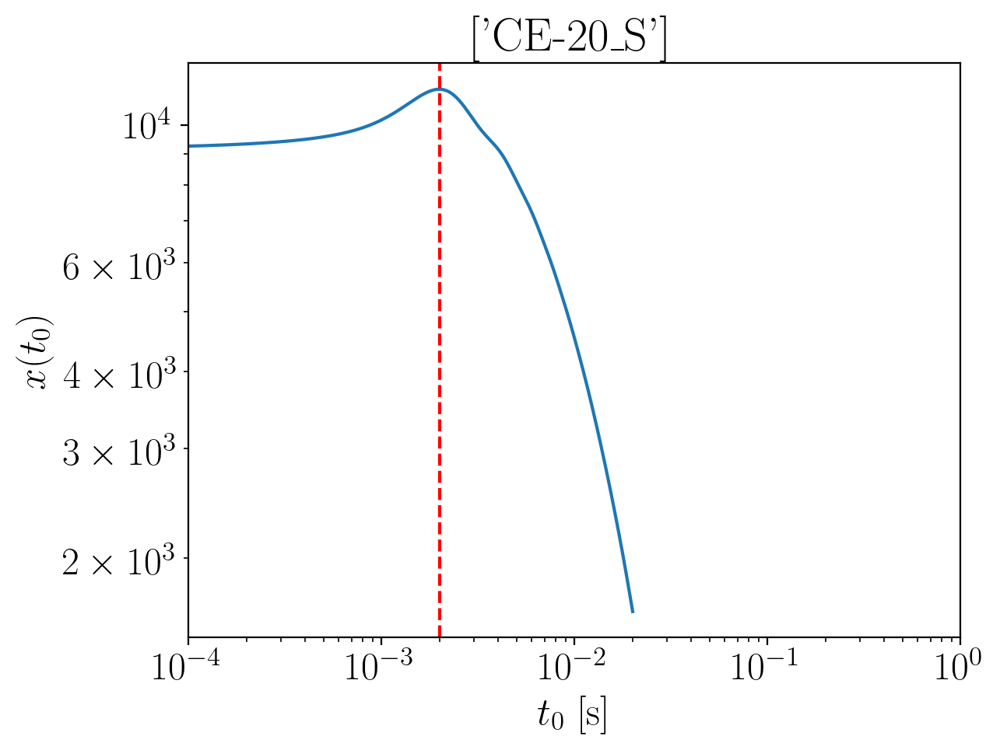

2024-01-15 16:40:54,220 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:54,228 - Network - INFO : PSDs loaded.
2024-01-15 16:40:54,230 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:54,238 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:54,245 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.244260375618037
Inner product:
0.9999153426244873


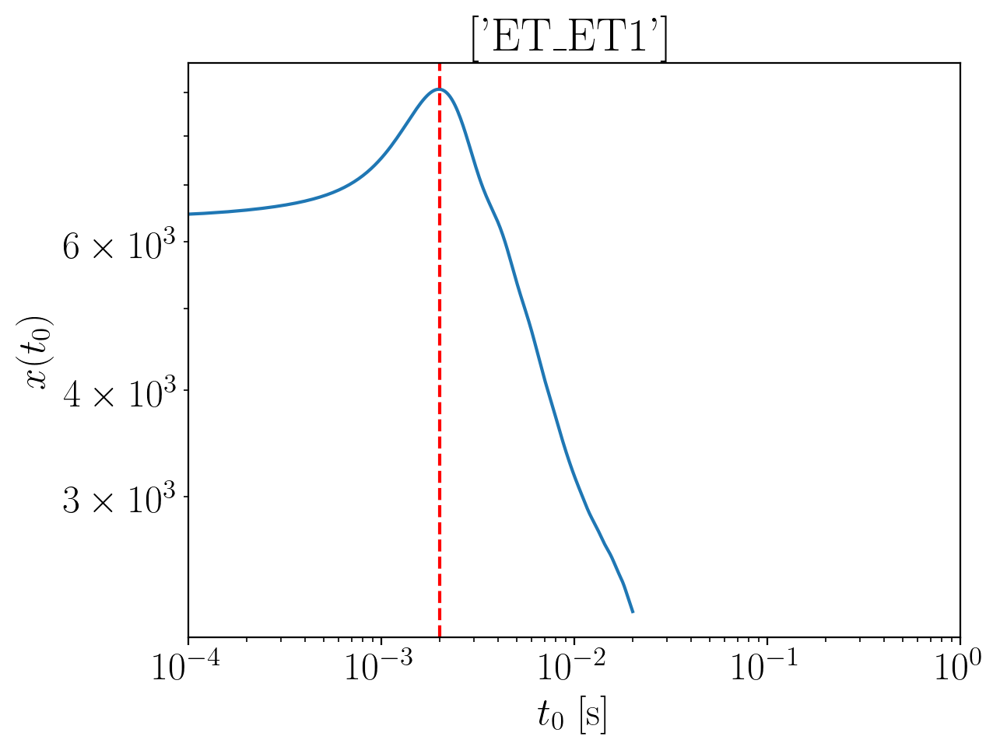

2024-01-15 16:40:56,152 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:56,166 - Network - INFO : PSDs loaded.
2024-01-15 16:40:56,168 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:56,175 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:56,183 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2546915429801664
Inner product:
0.9998123361664838


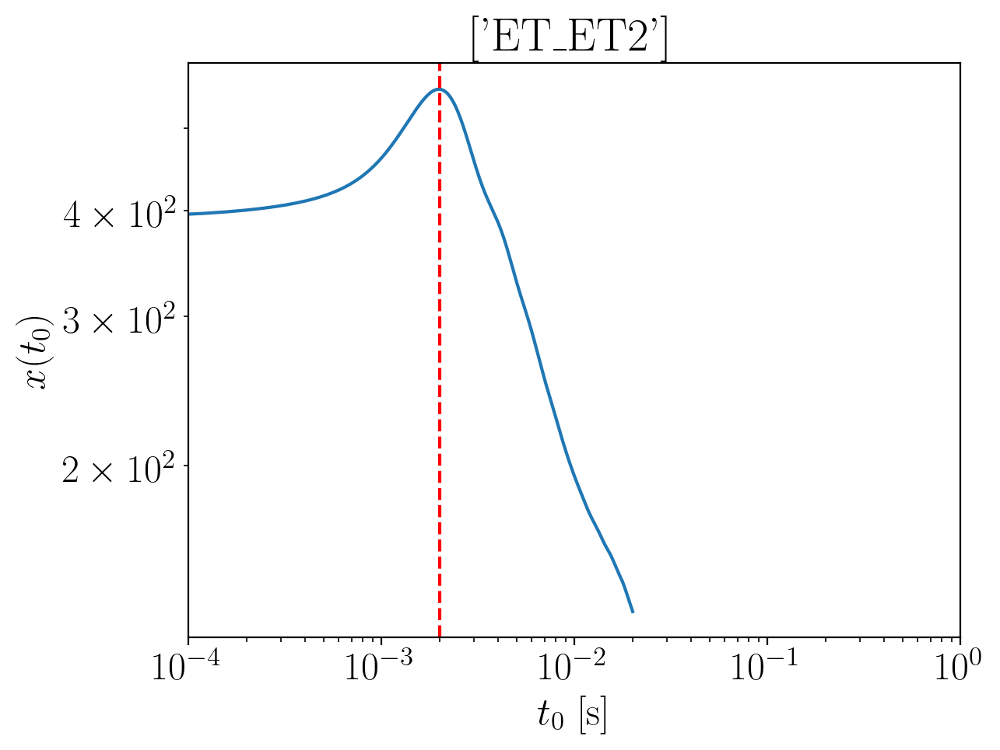

2024-01-15 16:40:57,844 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:57,857 - Network - INFO : PSDs loaded.
2024-01-15 16:40:57,859 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:57,866 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:57,872 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2546915429801664
Inner product:
0.9998123361664837


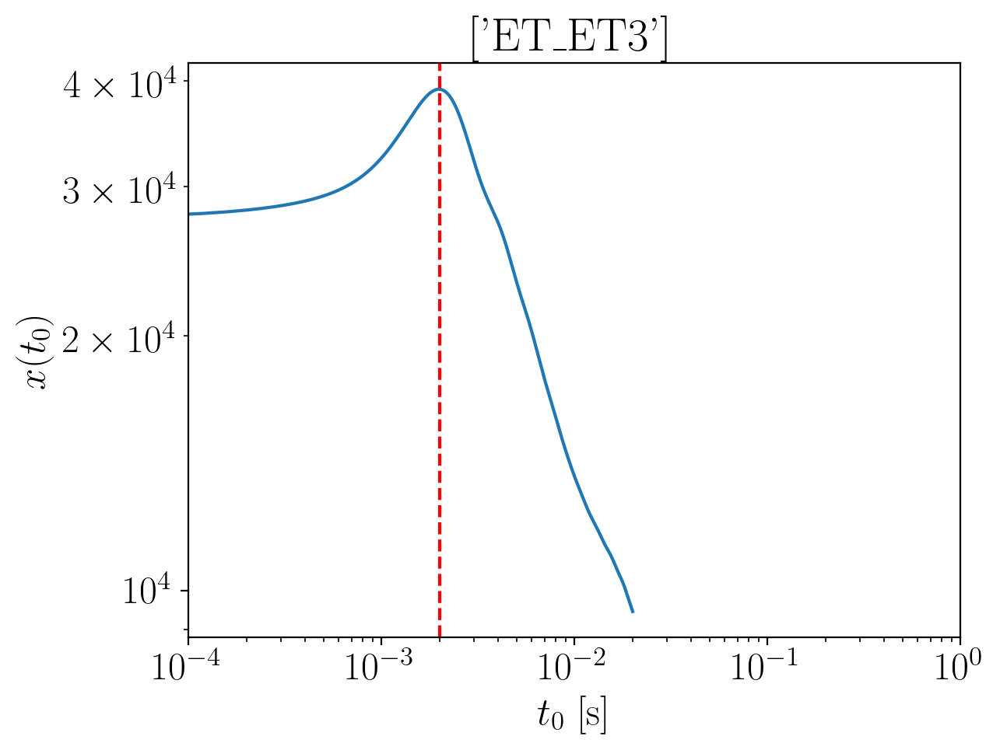

2024-01-15 16:40:59,426 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:59,440 - Network - INFO : PSDs loaded.
2024-01-15 16:40:59,442 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:40:59,449 - Network - INFO : Detector responses calculated.
2024-01-15 16:40:59,456 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:59,481 - Network - INFO : Polarizations calculated.
2024-01-15 16:40:59,482 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:40:59,487 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2546915429801664
Inner product:
0.9998123361664835


2024-01-15 16:41:05,526 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:41:05,597 - Network - INFO : PSDs loaded.
2024-01-15 16:41:05,628 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:05,674 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:05,675 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:41:05,676 - Network - INFO :    CE-40_C
2024-01-15 16:41:09,761 - Network - INFO :    CE-20_S
2024-01-15 16:41:13,905 - Network - INFO :    ET_ET1
2024-01-15 16:41:18,452 - Network - INFO :    ET_ET2
2024-01-15 16:41:22,581 - Network - INFO :    ET_ET3
2024-01-15 16:41:27,221 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:41:27,231 - Network - INFO : SNRs calculated.
2024-01-15 16:41:27,232 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:41:27,232 - Network - INFO :    CE-40_C
2024-01-15 16:41:27,341 - Network - INFO :

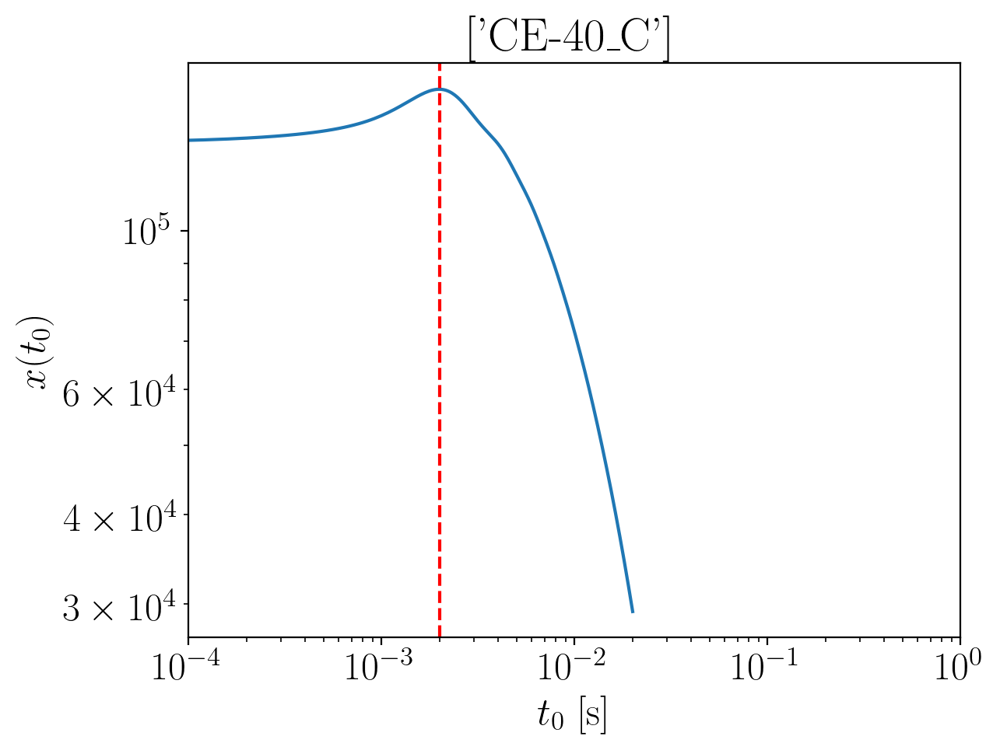

2024-01-15 16:41:29,704 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:29,710 - Network - INFO : PSDs loaded.
2024-01-15 16:41:29,712 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:29,719 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:29,726 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2384082183244045
Inner product:
0.9999236178172555


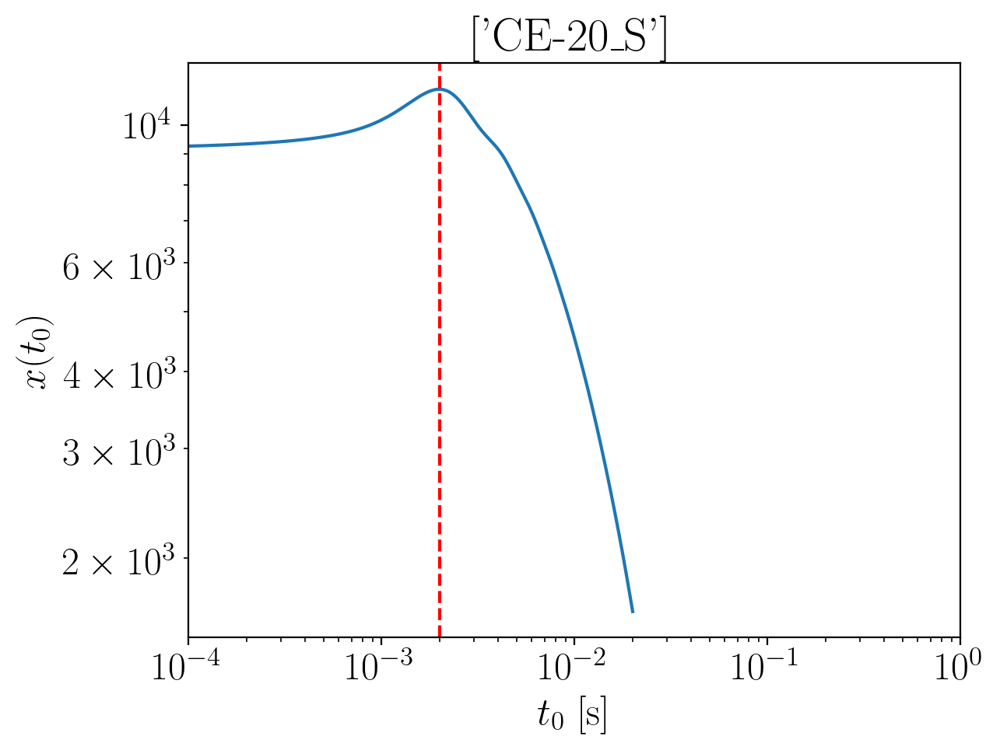

2024-01-15 16:41:33,046 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:33,072 - Network - INFO : PSDs loaded.
2024-01-15 16:41:33,080 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:33,104 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:33,123 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2372041444680733
Inner product:
0.9999153426244873


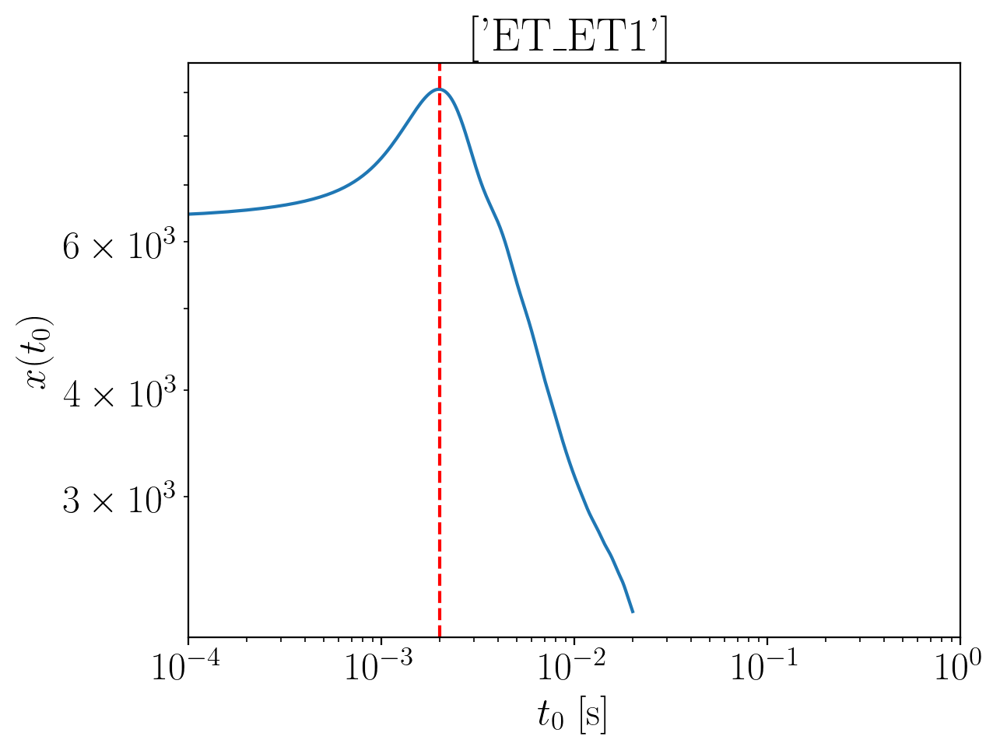

2024-01-15 16:41:36,758 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:36,772 - Network - INFO : PSDs loaded.
2024-01-15 16:41:36,774 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:36,782 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:36,790 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2476353118302064
Inner product:
0.9998123361664838


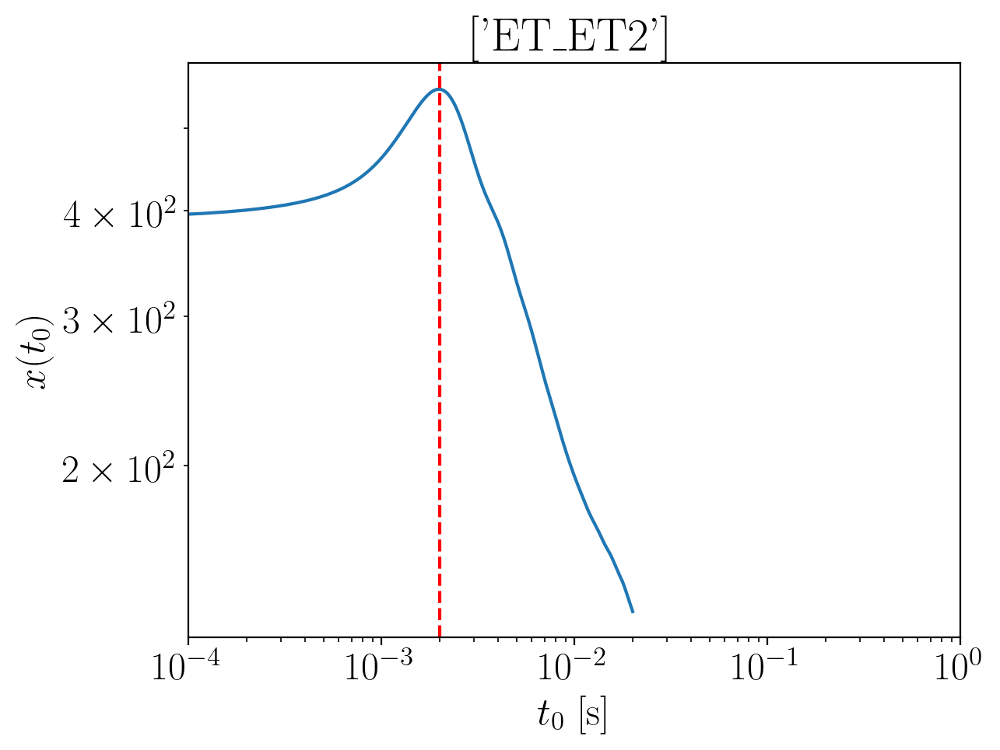

2024-01-15 16:41:39,429 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:39,444 - Network - INFO : PSDs loaded.
2024-01-15 16:41:39,446 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:39,455 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:39,505 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2476353118302064
Inner product:
0.9998123361664837


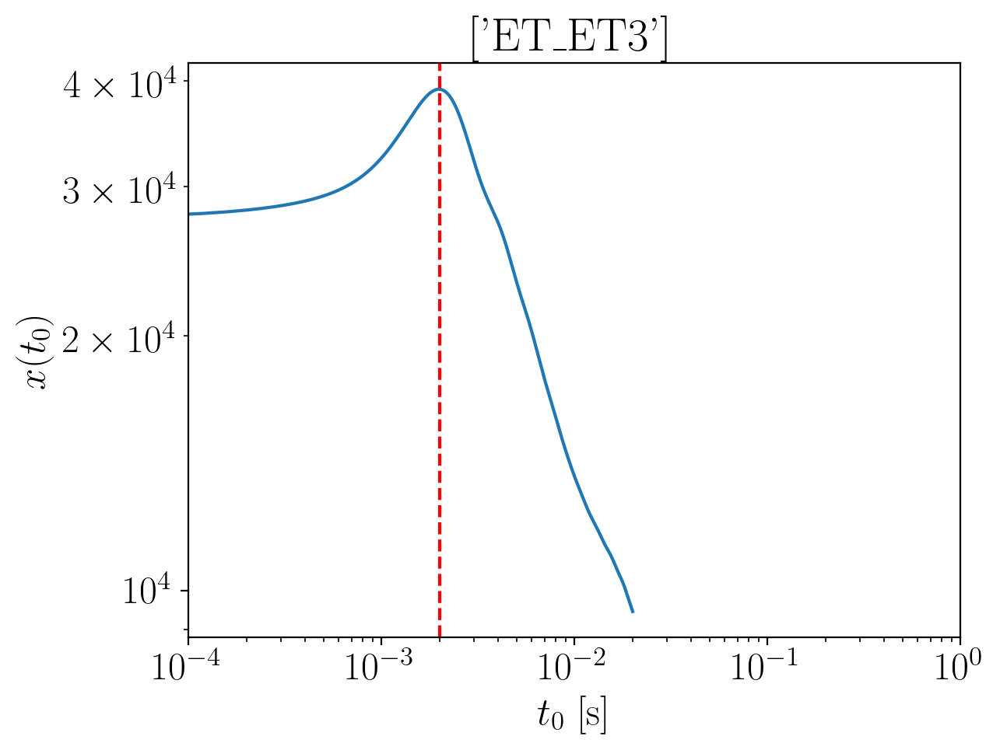

2024-01-15 16:41:42,269 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:42,286 - Network - INFO : PSDs loaded.
2024-01-15 16:41:42,289 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:42,299 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:42,317 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2476353118302064
Inner product:
0.9998123361664836


2024-01-15 16:41:42,467 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:42,478 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:41:42,491 - Network - INFO : Polarizations calculated.
2024-01-15 16:41:48,779 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:41:48,823 - Network - INFO : PSDs loaded.
2024-01-15 16:41:48,829 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:41:48,847 - Network - INFO : Detector responses calculated.
2024-01-15 16:41:48,848 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:41:48,848 - Network - INFO :    CE-40_C
2024-01-15 16:41:52,573 - Network - INFO :    CE-20_S
2024-01-15 16:41:56,257 - Network - INFO :    ET_ET1
2024-01-15 16:41:59,942 - Network - INFO :    ET_ET2
2024-01-15 16:42:03,602 - Network - INFO :    ET_ET3
2024-01-15 16:42:07,302 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 1

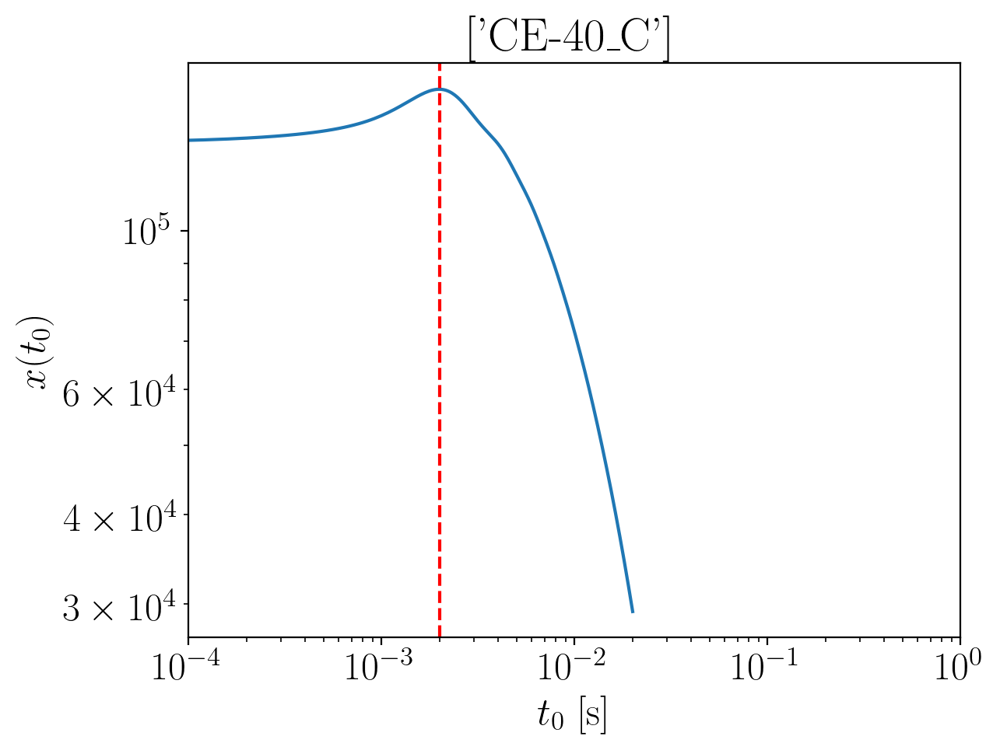

2024-01-15 16:42:09,137 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:09,144 - Network - INFO : PSDs loaded.
2024-01-15 16:42:09,146 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:09,153 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:09,160 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2305699902302814
Inner product:
0.9999236178172555


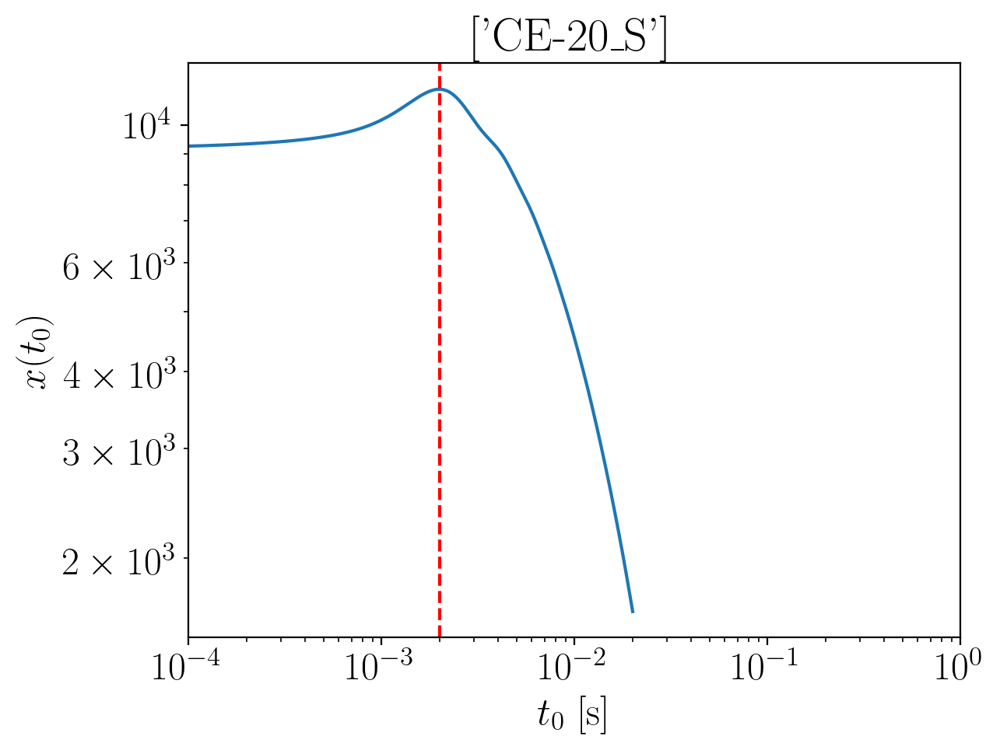

2024-01-15 16:42:10,430 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:10,437 - Network - INFO : PSDs loaded.
2024-01-15 16:42:10,439 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:10,446 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:10,453 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.22936591637395
Inner product:
0.9999153426244873


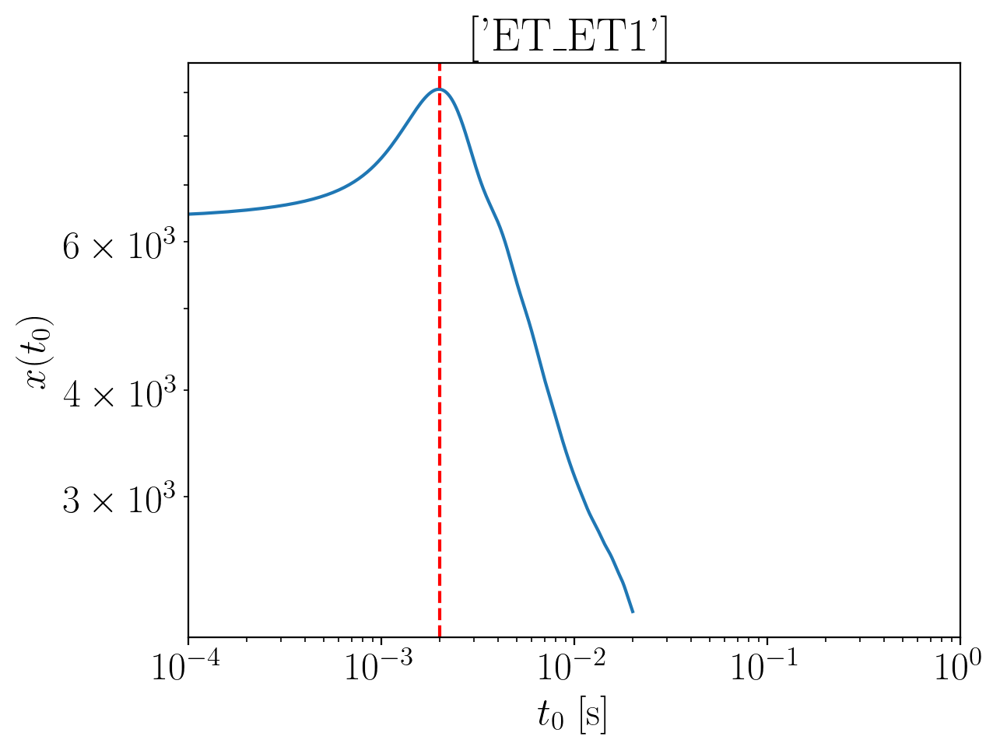

2024-01-15 16:42:11,923 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:11,939 - Network - INFO : PSDs loaded.
2024-01-15 16:42:11,941 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:11,949 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:11,958 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2397970837360823
Inner product:
0.9998123361664838


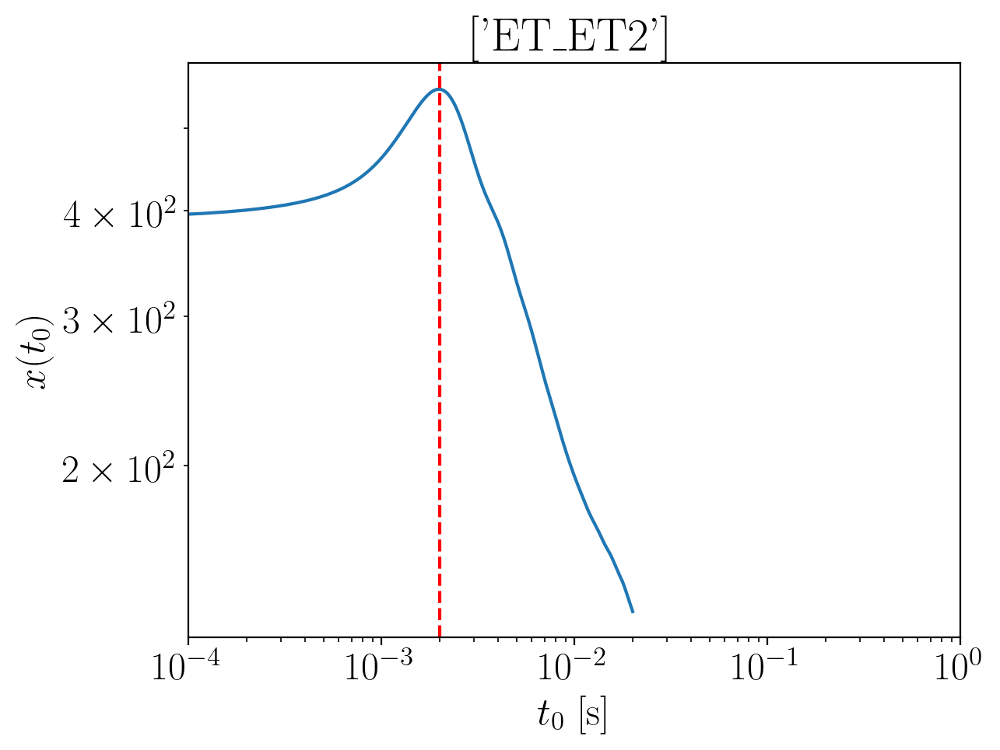

2024-01-15 16:42:13,863 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:13,884 - Network - INFO : PSDs loaded.
2024-01-15 16:42:13,887 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:13,898 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:13,909 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2397970837360823
Inner product:
0.9998123361664837


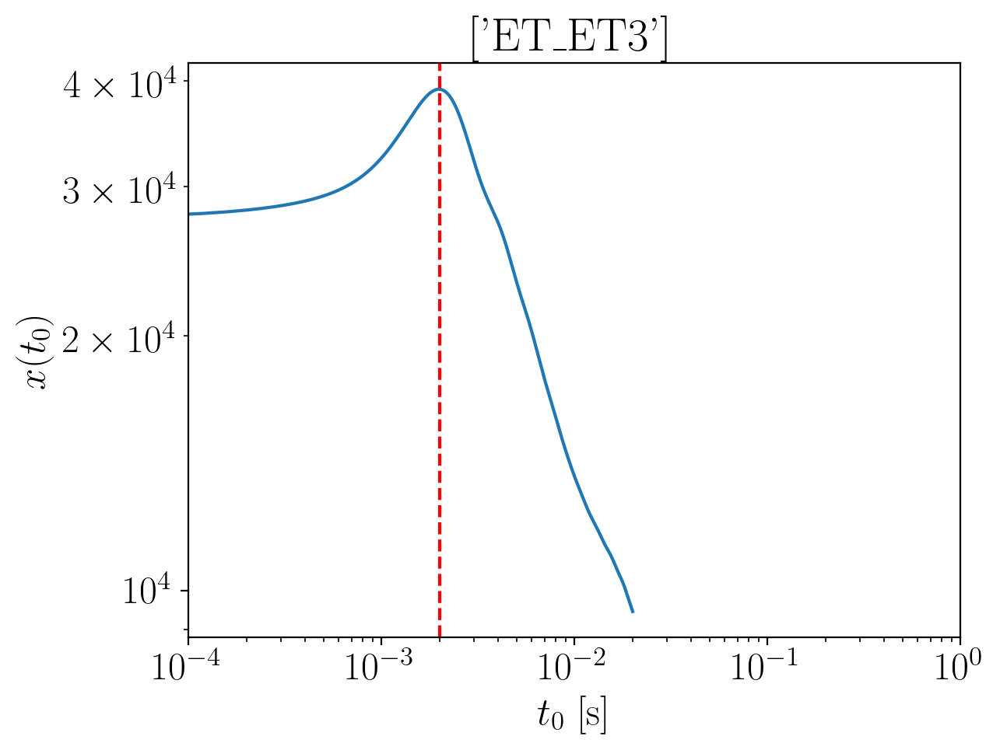

2024-01-15 16:42:15,946 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:15,968 - Network - INFO : PSDs loaded.
2024-01-15 16:42:15,975 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:15,987 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:15,998 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:16,098 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:16,100 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:42:16,144 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2397970837360823
Inner product:
0.9998123361664834


2024-01-15 16:42:22,364 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:42:22,418 - Network - INFO : PSDs loaded.
2024-01-15 16:42:22,457 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:22,510 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:22,512 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:42:22,514 - Network - INFO :    CE-40_C
2024-01-15 16:42:26,670 - Network - INFO :    CE-20_S
2024-01-15 16:42:31,550 - Network - INFO :    ET_ET1
2024-01-15 16:42:36,344 - Network - INFO :    ET_ET2
2024-01-15 16:42:40,092 - Network - INFO :    ET_ET3
2024-01-15 16:42:43,819 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:42:43,829 - Network - INFO : SNRs calculated.
2024-01-15 16:42:43,830 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:42:43,831 - Network - INFO :    CE-40_C
2024-01-15 16:42:43,935 - Network - INFO :

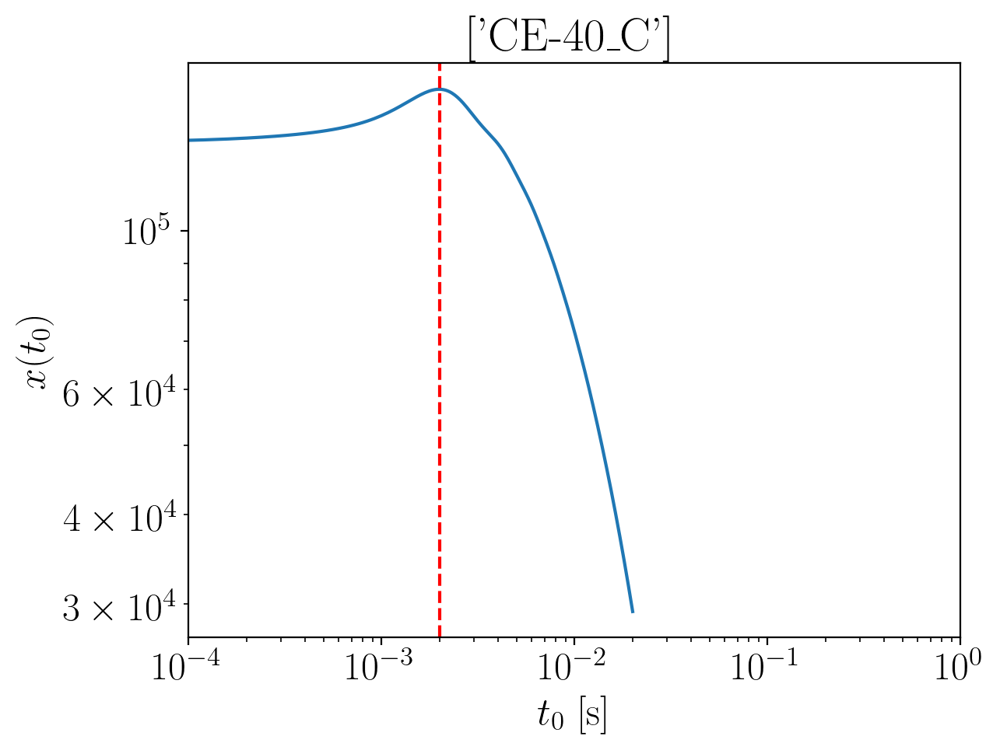

2024-01-15 16:42:47,274 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:47,281 - Network - INFO : PSDs loaded.
2024-01-15 16:42:47,283 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:47,290 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:47,297 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2220990075007756
Inner product:
0.9999236178172557


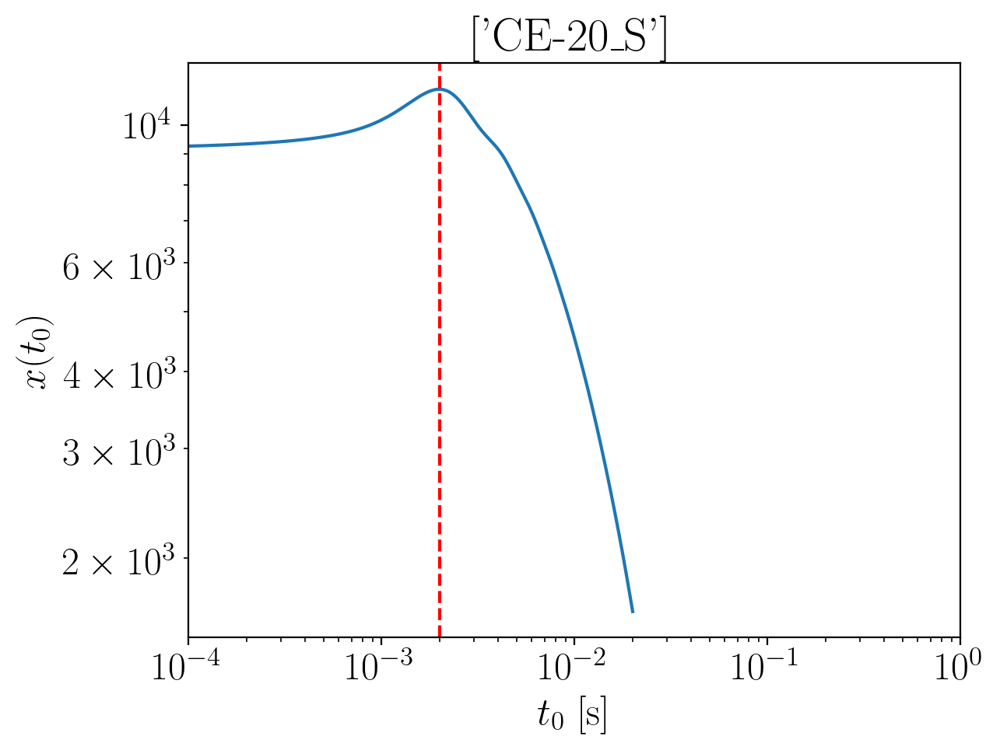

2024-01-15 16:42:49,040 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:49,048 - Network - INFO : PSDs loaded.
2024-01-15 16:42:49,050 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:49,058 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:49,067 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.220894933644445
Inner product:
0.9999153426244873


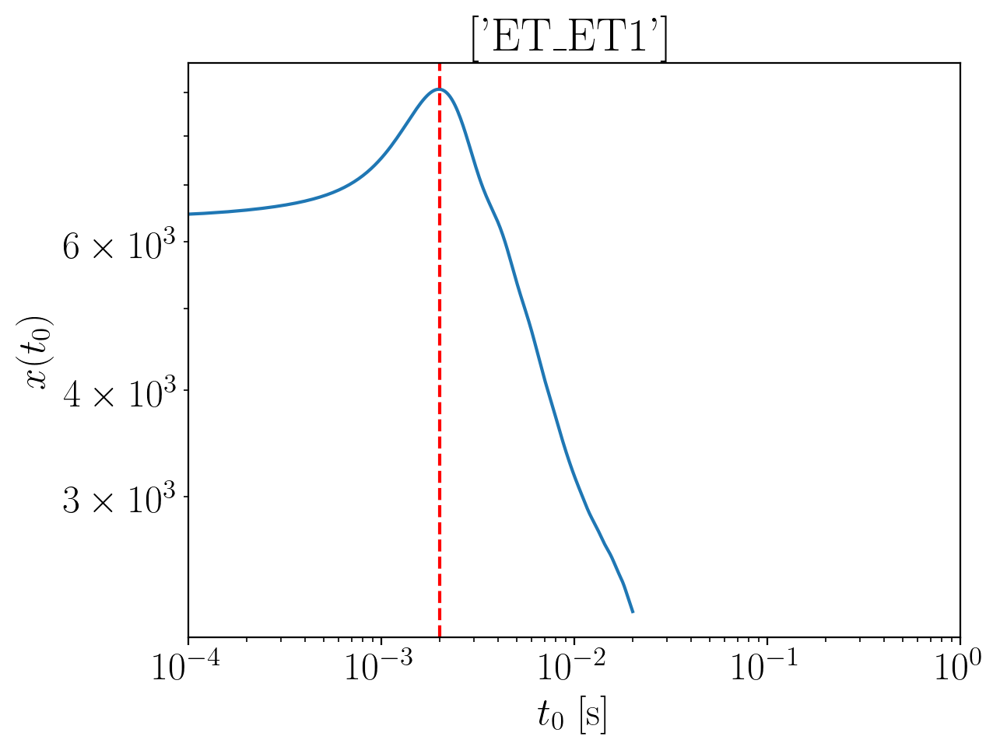

2024-01-15 16:42:51,660 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:51,673 - Network - INFO : PSDs loaded.
2024-01-15 16:42:51,675 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:51,682 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:51,725 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2313261010065775
Inner product:
0.9998123361664836


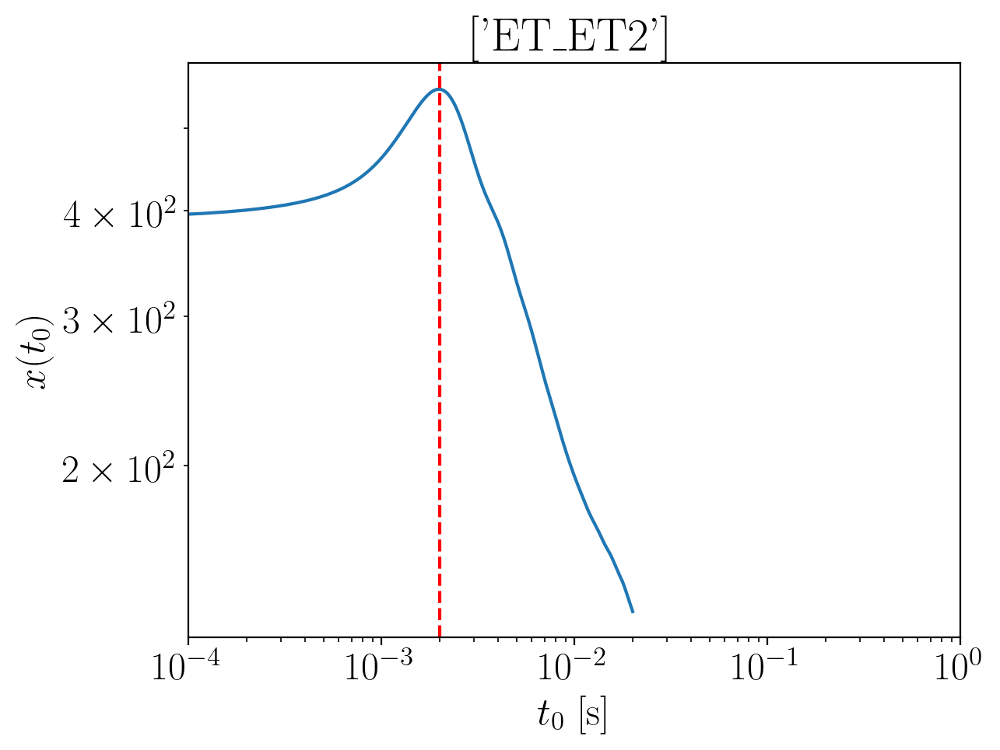

2024-01-15 16:42:53,869 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:53,887 - Network - INFO : PSDs loaded.
2024-01-15 16:42:53,889 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:53,924 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:53,956 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2313261010065775
Inner product:
0.9998123361664837


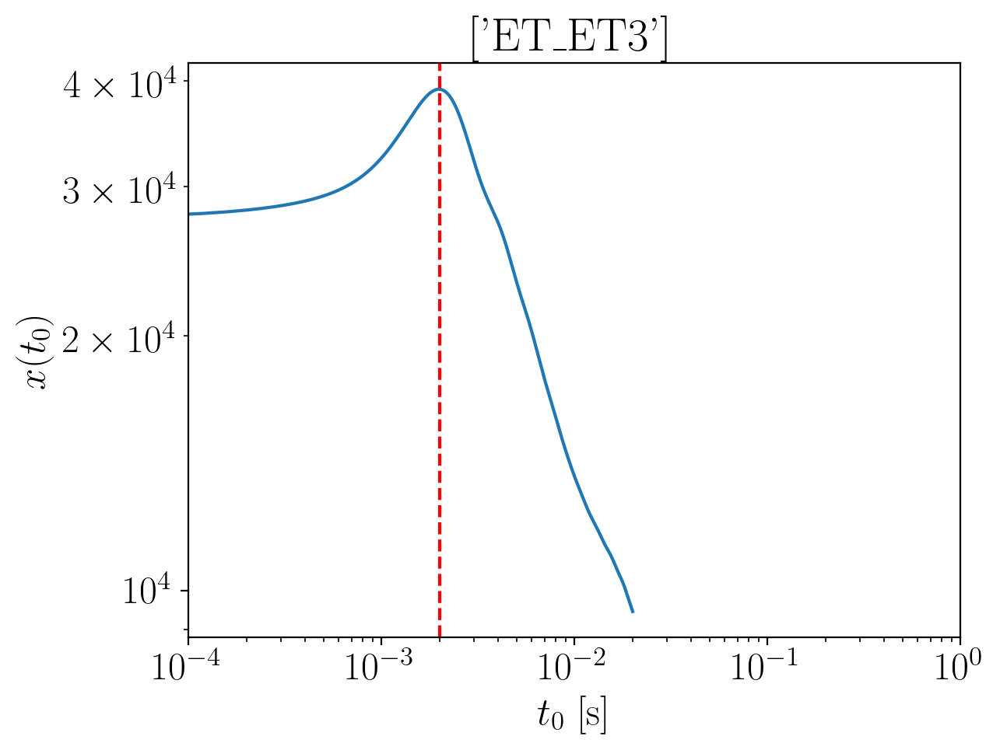

2024-01-15 16:42:56,335 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:56,350 - Network - INFO : PSDs loaded.
2024-01-15 16:42:56,352 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:42:56,361 - Network - INFO : Detector responses calculated.
2024-01-15 16:42:56,370 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:56,462 - Network - INFO : Polarizations calculated.
2024-01-15 16:42:56,480 - Network - INFO : Calculate numeric derivatives of polarizations.
2024-01-15 16:42:56,518 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2313261010065775
Inner product:
0.9998123361664835


2024-01-15 16:43:02,884 - Network - INFO : Numeric derivatives of polarizations calculated.
2024-01-15 16:43:02,940 - Network - INFO : PSDs loaded.
2024-01-15 16:43:02,962 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:43:03,017 - Network - INFO : Detector responses calculated.
2024-01-15 16:43:03,018 - Network - INFO : Calculate numeric derivatives of detector responses.
2024-01-15 16:43:03,019 - Network - INFO :    CE-40_C
2024-01-15 16:43:08,152 - Network - INFO :    CE-20_S
2024-01-15 16:43:13,793 - Network - INFO :    ET_ET1
2024-01-15 16:43:17,740 - Network - INFO :    ET_ET2
2024-01-15 16:43:21,693 - Network - INFO :    ET_ET3
2024-01-15 16:43:25,489 - Network - INFO : Numeric derivatives of detector responses calculated.
2024-01-15 16:43:25,497 - Network - INFO : SNRs calculated.
2024-01-15 16:43:25,498 - Network - INFO : Calculate errors (Fisher & cov matrices).
2024-01-15 16:43:25,498 - Network - INFO :    CE-40_C
2024-01-15 16:43:25,594 - Network - INFO :

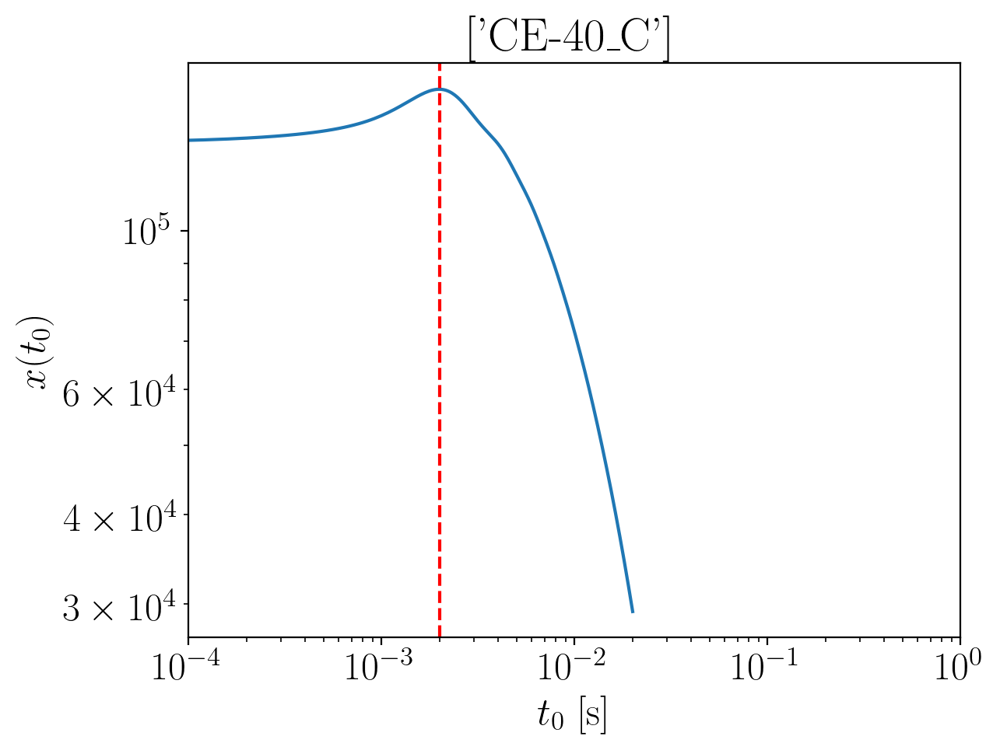

2024-01-15 16:43:27,729 - Network - INFO : Polarizations calculated.
2024-01-15 16:43:27,751 - Network - INFO : PSDs loaded.
2024-01-15 16:43:27,757 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:43:27,779 - Network - INFO : Detector responses calculated.
2024-01-15 16:43:27,801 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2131059959292148
Inner product:
0.9999236178172557


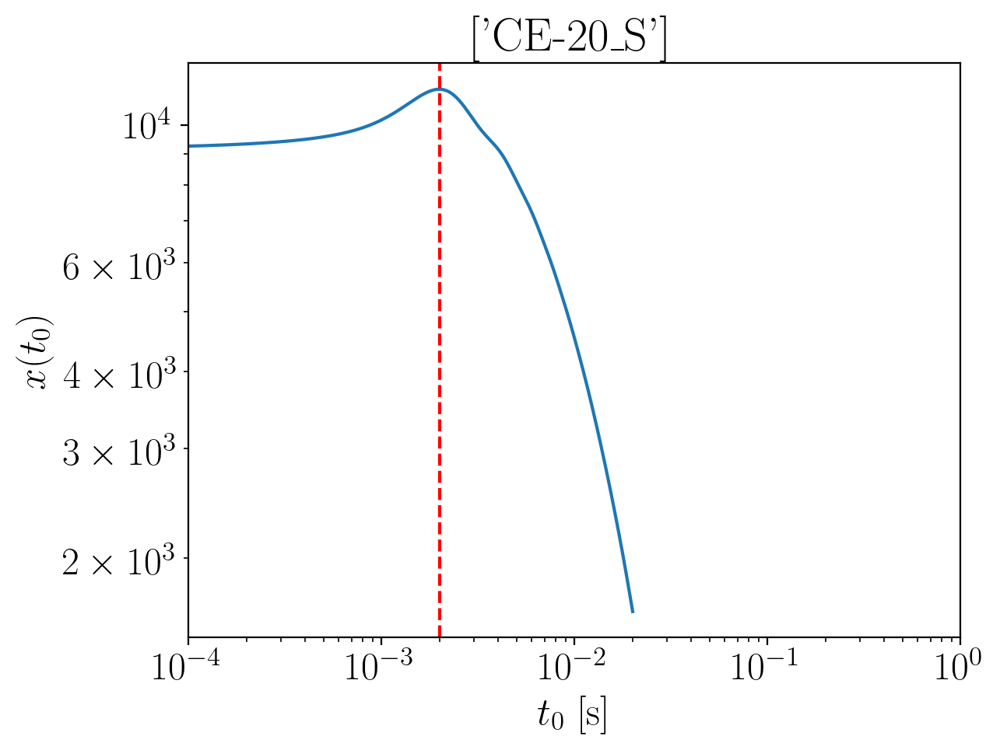

2024-01-15 16:43:29,515 - Network - INFO : Polarizations calculated.
2024-01-15 16:43:29,523 - Network - INFO : PSDs loaded.
2024-01-15 16:43:29,525 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:43:29,533 - Network - INFO : Detector responses calculated.
2024-01-15 16:43:29,541 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2119019220728835
Inner product:
0.9999153426244873


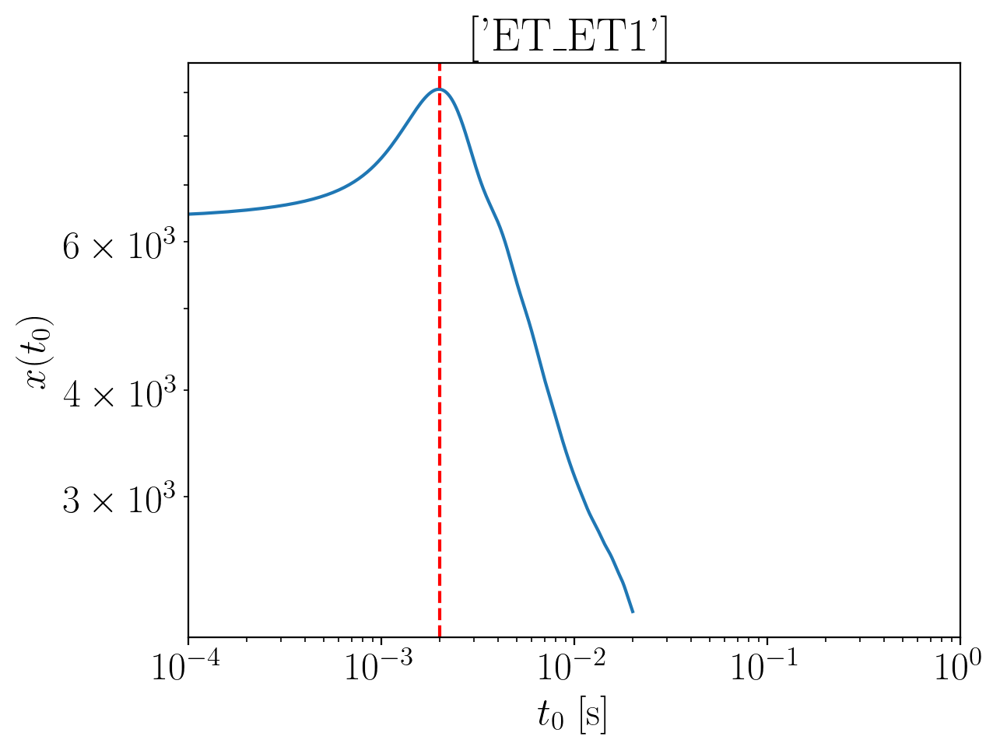

2024-01-15 16:43:31,794 - Network - INFO : Polarizations calculated.
2024-01-15 16:43:31,827 - Network - INFO : PSDs loaded.
2024-01-15 16:43:31,831 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:43:31,860 - Network - INFO : Detector responses calculated.
2024-01-15 16:43:31,888 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.222333089435015
Inner product:
0.9998123361664838


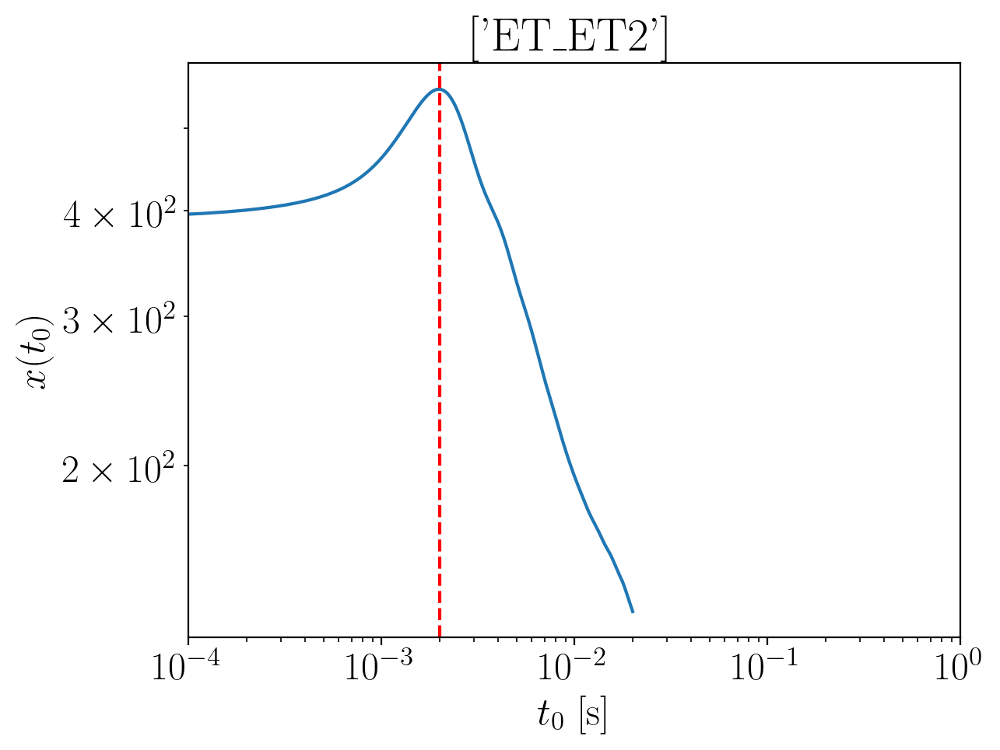

2024-01-15 16:43:34,386 - Network - INFO : Polarizations calculated.
2024-01-15 16:43:34,402 - Network - INFO : PSDs loaded.
2024-01-15 16:43:34,405 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:43:34,414 - Network - INFO : Detector responses calculated.
2024-01-15 16:43:34,451 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.2223330894350153
Inner product:
0.9998123361664837


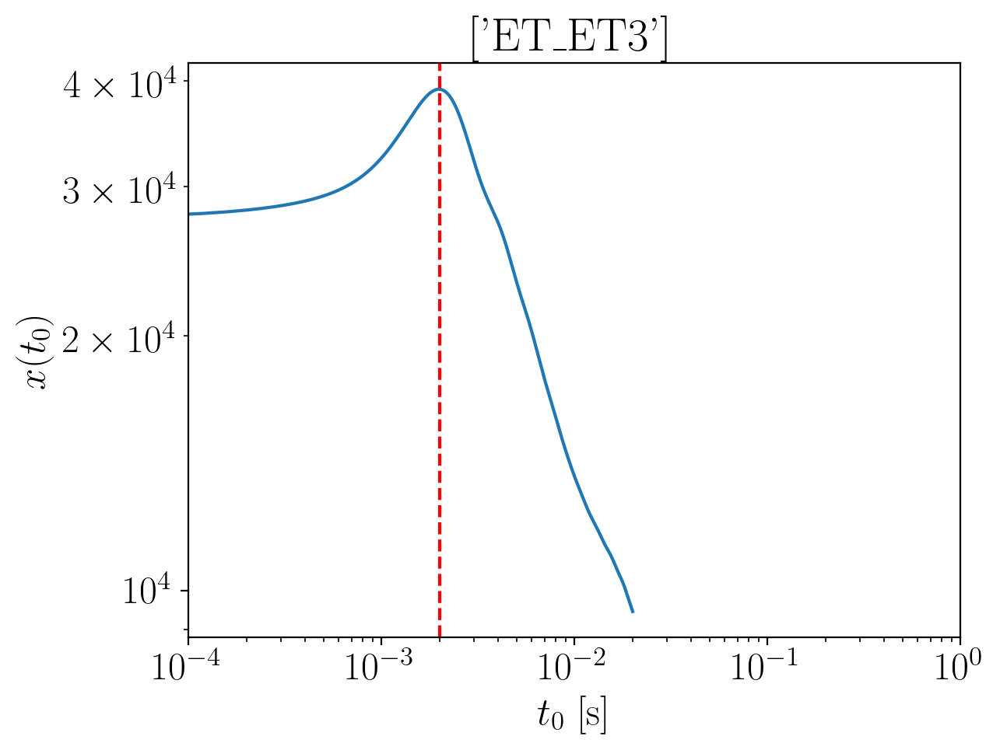

2024-01-15 16:43:37,399 - Network - INFO : Polarizations calculated.
2024-01-15 16:43:37,414 - Network - INFO : PSDs loaded.
2024-01-15 16:43:37,416 - Network - INFO : Antenna patterns and LPFs loaded.
2024-01-15 16:43:37,423 - Network - INFO : Detector responses calculated.
2024-01-15 16:43:37,457 - Network - INFO : Polarizations calculated.


time shift: 0.002
phase shift: -2.222333089435015
Inner product:
0.9998123361664834


In [95]:
np.random.seed(42)
index_range = np.random.randint(1, 100, size=10)
print(index_range)

Ref_range = np.linspace(3., 10.0, 8)

cv_bias_dicts = []
err_dicts = []


network_spec = ['CE-40_C', 'CE-20_S', 'ET_ET1', 'ET_ET2', 'ET_ET3']

approx1 = 'IMRPhenomXAS'
approx2 = 'IMRPhenomD'

for index in index_range:
    inj_params = {
        'Mc':    Mcs[index],
        'eta':   etas[index],
        'chi1x': 0.,
        'chi2x': 0.,
        'chi1y': 0.,
        'chi2y': 0.,
        'chi1z': chi1z[index],
        'chi2z': chi2z[index],
        'DL':    DLs[index],
        'tc':    0.,
        'phic':  0.,
        'iota':  iotas[index],
        'ra':    ras[index],
        'dec':   decs[index],
        'psi':   psis[index],
        # 'gmst0': bilby.gw.utils.greenwich_mean_sidereal_time(0.),
        'gmst0': 0.
    } 

    d_f = 2**-4
    f_low = 5.
    f_high = 2048.
    f = np.arange(f_low, f_high, d_f)
 
    deriv_symbs_string = 'Mc eta DL chi1z chi2z tc phic iota ra dec psi'
    deriv_variables = ['Mc', 'eta', 'DL', 'chi1z', 'chi2z', 'tc', 'phic', 'iota', 'ra', 'dec', 'psi']

    cv_bias_dicts_i = []
    err_dicts_i = []

    for fRef in fRef_range:
        inj_params_fRef = inj_params.copy()
        inj_params_fRef['fRef'] = fRef
        
        net_ap = network.Network(network_spec=network_spec)

        approximant = 'IMRPhenomD'
        wf_model_name = 'lal_bbh'
        # pass the chosen waveform to the network for initialization
        net_ap.set_wf_vars(wf_model_name=wf_model_name, wf_other_var_dic = {'approximant': approximant, 'fRef': fRef})


        use_rot = 0

        net_ap.set_net_vars(
            f=f, inj_params=inj_params_fRef,
            deriv_symbs_string=deriv_symbs_string,
            use_rot=use_rot
            )
        net_ap.calc_wf_polarizations()
        net_ap.calc_wf_polarizations_derivs_num(step=1e-9, method='central', order=2, n=1)
        net_ap.setup_ant_pat_lpf_psds()
        net_ap.calc_det_responses()
        net_ap.calc_det_responses_derivs_num(step=1e-9, method='central', order=2, n=1)
        net_ap.calc_snrs()
        net_ap.calc_errors()


        net_tr = network.Network(network_spec=network_spec)

        approximant = 'IMRPhenomXAS'
        wf_model_name = 'lal_bbh'
        # pass the chosen waveform to the network for initialization
        net_tr.set_wf_vars(wf_model_name=wf_model_name, wf_other_var_dic = {'approximant': approximant, 'fRef':fRef})

        net_tr.set_net_vars(
            f=f, inj_params=inj_params_fRef,
            deriv_symbs_string=deriv_symbs_string,
            use_rot=use_rot
            )
        net_tr.calc_wf_polarizations()
        net_tr.setup_ant_pat_lpf_psds()
        net_tr.calc_det_responses()
        net_tr.calc_snrs()


        overlap_vecs_network = np.zeros((len(net_ap.detectors), len(net_ap.deriv_variables)))

        time_arr_d = np.linspace(0.0, 0.02, 501)

        for d in range(len(net_ap.detectors)):

            ## set up initial waveforms
            h1 = net_tr.detectors[d].hf
            h2 = net_ap.detectors[d].hf
            f = net_ap.detectors[d].f
            Sn = net_ap.detectors[d].psd
            network_spec_d = [net_ap.detectors[d].det_key]

            x_t0_re_d = np.zeros(len(time_arr_d))
            x_t0_im_d = np.zeros(len(time_arr_d))

            for i in range(len(time_arr_d)):
                t0 = time_arr_d[i]
                x_t0_d = 4*(integrate.simpson(h1 * np.conjugate(h2) * np.exp(2*np.pi*1j*f*t0)/ Sn, x=f))
                x_t0_re_d[i] = np.real(x_t0_d)
                x_t0_im_d[i] = np.imag(x_t0_d)

            max_idx = np.argmax(x_t0_re_d**2 + x_t0_im_d**2)
            time_shift_d = time_arr_d[max_idx]
            phase_shift_d = (np.angle(x_t0_re_d + 1j*x_t0_im_d))[max_idx]

    
            inj_params_opt_d = inj_params_fRef.copy()
            inj_params_opt_d['tc'] = time_shift_d # should be positive when shifting XAS to maximize overlap
            inj_params_opt_d['phic'] = phase_shift_d  # should be positive when shifting XAS to maximize overlap

            plt.title(network_spec_d)
            plt.plot(time_arr_d, x_t0_re_d**2 + x_t0_im_d**2)
            plt.axvline(x=time_shift_d, ls='--', c='r')
            plt.xlabel('$t_0$ [s]')
            plt.ylabel("$x(t_0)$")
            plt.loglog()
            plt.xlim(1e-4, 1e0)
            plt.show()
            print("time shift:", time_shift_d)
            print("phase shift:", phase_shift_d)

            net_tr_opt_d = network.Network(network_spec=network_spec_d)
            net_tr_opt_d.set_wf_vars(wf_model_name='lal_bbh', wf_other_var_dic = {'approximant': 'IMRPhenomXAS', 'fRef':fRef})
            net_tr_opt_d.set_net_vars(
                f=f, inj_params=inj_params_opt_d,
                deriv_symbs_string=deriv_symbs_string,
                use_rot=use_rot
                )
            net_tr_opt_d.calc_wf_polarizations()
            net_tr_opt_d.setup_ant_pat_lpf_psds()
            net_tr_opt_d.calc_det_responses()
            net_tr_opt_d.calc_wf_polarizations()

            print("Inner product:")
            print(inner_prod_simps_normed(net_ap.detectors[d].hf, net_tr_opt_d.detectors[0].hf, net_ap.detectors[d].psd, net_ap.detectors[d].f))
        
            ## Compute CV overlap vector for this detector
            delta_hf = net_tr_opt_d.detectors[0].hf - net_ap.detectors[d].hf
            overlap_vecs_network[d] = cutler_vallisneri_overlap_vec(net_ap.detectors[d].del_hf, delta_hf, net_ap.detectors[d].psd, net_ap.detectors[d].f)

        cv_bias_opt = np.matmul(net_ap.cov, np.sum(overlap_vecs_network, axis=0))
        cv_bias_opt = np.array(cv_bias_opt.tolist()[0])

        cv_bias_opt_dict = {}

        for i, param in enumerate(net_ap.deriv_variables):
            cv_bias_opt_dict[param] = cv_bias_opt[i]

        cv_bias_dicts_i.append(cv_bias_opt_dict)
        err_dicts_i.append(net_ap.errs)
    
    cv_bias_dicts.append(cv_bias_dicts_i)
    err_dicts.append(err_dicts_i)


In [97]:
f_low_index = np.where(fRef_range==f_low)[0][0]

In [104]:
cv_bias_dicts[0][0]['Mc']

-0.009097512948001096

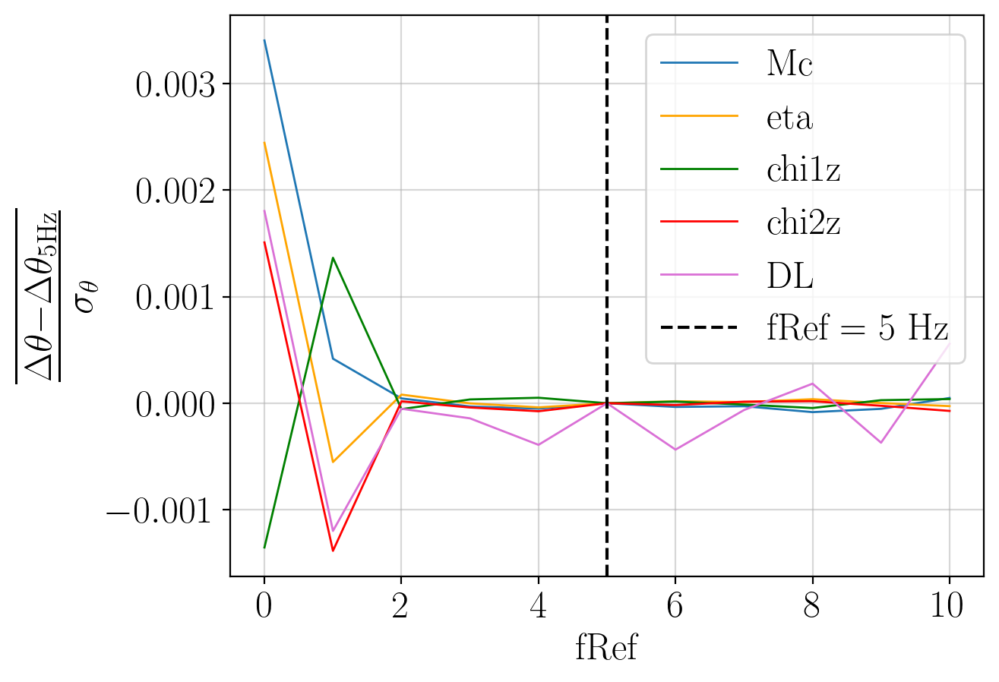

In [130]:
params = ['Mc', 'eta', 'chi1z', 'chi2z', 'DL']
# params = ['Mc', 'eta']

cs = ["C0", "orange", "g", "red", "orchid"]

for pp, param in enumerate(params):
    avg_param_biases = np.zeros(len(fRef_range))
    # cv_bias_perc = np.zeros(len(fRef_range))
    for k in range(len(fRef_range)):
        cv_bias_param = 0
        for ii in range(len(index_range)):
            cv_bias_param += (cv_bias_dicts[ii][k][param]- cv_bias_dicts[ii][f_low_index][param])/err_dicts[ii][k][param]
        avg_param_biases[k] = cv_bias_param/len(index_range)
        #     cv_bias_perc[k] = (cv_bias_dicts[ii][k][param] - cv_bias_dicts[ii][f_low_index][param])/ cv_bias_dicts[ii][f_low_index][param]
        #     err = err_dicts[ii][k][param]
        #     param_biases[k] = cv_bias/err
            
        # if ii==0:
        #     label=param
        # else: label=None
    plt.plot(fRef_range, avg_param_biases, label=param, lw=1.0, color=cs[pp])

plt.axvline(x=5, c='k', ls='--', label='fRef = 5 Hz')
plt.grid(alpha=0.5)
# plt.xlim(3, 10)
# plt.ylim(-0.5, 0.5)
plt.xlabel('fRef')
plt.ylabel('$\overline{{\\frac{\Delta \\theta  - \Delta \\theta_{\\rm 5 Hz}}{\sigma_\\theta}}}$', fontsize=26)
plt.legend(loc='upper right')

# plt.savefig('1D_bias_plots/fRef_dep.pdf', dpi=300, bbox_inches='tight')
plt.show()


In [135]:
import pickle


In [132]:

with open('fRef_bias_dicts', 'wb') as fp:
    pickle.dump(cv_bias_dicts, fp)
    print('Done writing list into a binary file')

with open('fRef_err_dicts', 'wb') as fp:
    pickle.dump(err_dicts, fp)
    print('Done writing list into a binary file')

Done writing list into a binary file
Done writing list into a binary file


In [133]:
with open('fRef_bias_dicts', 'rb') as fp:
    cv_bias_dicts_test = pickle.load(fp)

with open('fRef_err_dicts', 'rb') as fp:
    err_dicts_test = pickle.load(fp)


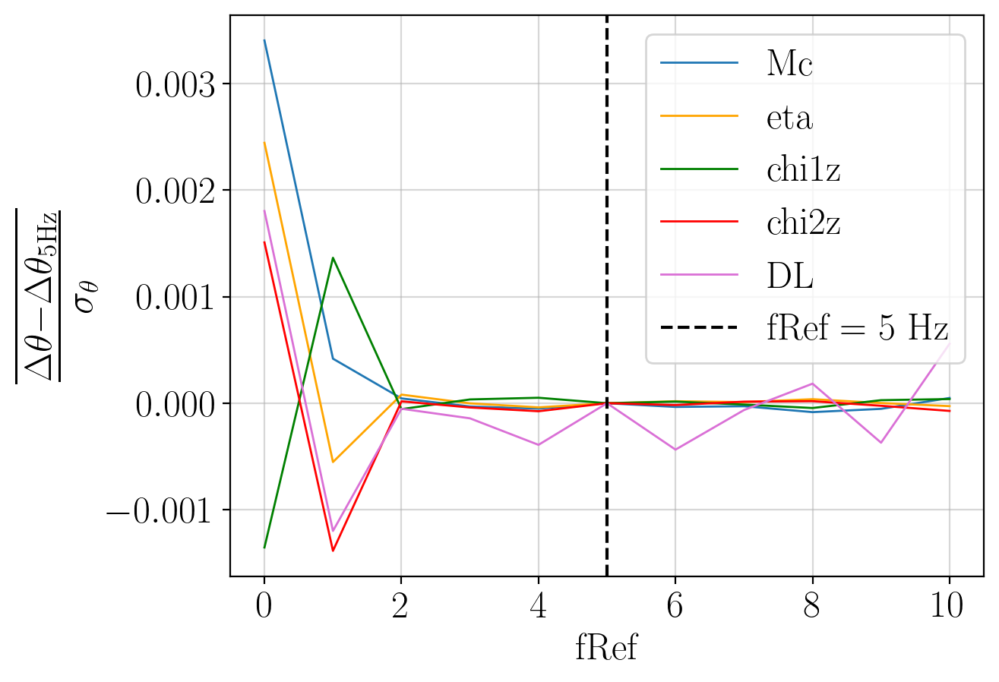

In [134]:
params = ['Mc', 'eta', 'chi1z', 'chi2z', 'DL']
# params = ['Mc', 'eta']

cs = ["C0", "orange", "g", "red", "orchid"]

for pp, param in enumerate(params):
    avg_param_biases = np.zeros(len(fRef_range))
    # cv_bias_perc = np.zeros(len(fRef_range))
    for k in range(len(fRef_range)):
        cv_bias_param = 0
        for ii in range(len(index_range)):
            cv_bias_param += (cv_bias_dicts_test[ii][k][param]- cv_bias_dicts_test[ii][f_low_index][param])/err_dicts_test[ii][k][param]
        avg_param_biases[k] = cv_bias_param/len(index_range)

    plt.plot(fRef_range, avg_param_biases, label=param, lw=1.0, color=cs[pp])

plt.axvline(x=5, c='k', ls='--', label='fRef = 5 Hz')
plt.grid(alpha=0.5)
# plt.xlim(3, 10)
# plt.ylim(-0.5, 0.5)
plt.xlabel('fRef')
plt.ylabel('$\overline{{\\frac{\Delta \\theta  - \Delta \\theta_{\\rm 5 Hz}}{\sigma_\\theta}}}$', fontsize=26)
plt.legend(loc='upper right')

plt.show()
